## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed

In [10]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [11]:
country = 'DE'
buses = '20'
le = '1.0'

In [12]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_3h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [13]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [14]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [15]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [16]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [17]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [18]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:05<00:00,  1.84it/s]
INFO:linopy.io: Writing time: 36.77s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ps02q24m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ps02q24m.lp


Reading time = 11.28 seconds


INFO:gurobipy:Reading time = 11.28 seconds


obj: 3264752 rows, 1521447 columns, 5914589 nonzeros


INFO:gurobipy:obj: 3264752 rows, 1521447 columns, 5914589 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264752 rows, 1521447 columns and 5914589 nonzeros


INFO:gurobipy:Optimize a model with 3264752 rows, 1521447 columns and 5914589 nonzeros


Model fingerprint: 0xcc7eab63


INFO:gurobipy:Model fingerprint: 0xcc7eab63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 2e+02]


INFO:gurobipy:  Matrix range     [1e-02, 2e+02]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2419475 rows and 395724 columns


INFO:gurobipy:Presolve removed 2419475 rows and 395724 columns


Presolve time: 4.23s


INFO:gurobipy:Presolve time: 4.23s


Presolved: 845277 rows, 1125723 columns, 3052671 nonzeros


INFO:gurobipy:Presolved: 845277 rows, 1125723 columns, 3052671 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 5s


INFO:gurobipy:Elapsed ordering time = 5s


Ordering time: 8.47s


INFO:gurobipy:Ordering time: 8.47s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 126


INFO:gurobipy: Dense cols : 126


 AA' NZ     : 2.181e+06


INFO:gurobipy: AA' NZ     : 2.181e+06


 Factor NZ  : 2.319e+07 (roughly 1.0 GB of memory)


INFO:gurobipy: Factor NZ  : 2.319e+07 (roughly 1.0 GB of memory)


 Factor Ops : 4.264e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.264e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.89771539e+17 -7.42161791e+18  7.69e+09 1.67e+03  6.83e+13    16s


INFO:gurobipy:   0   5.89771539e+17 -7.42161791e+18  7.69e+09 1.67e+03  6.83e+13    16s


   1   4.88405133e+17 -2.51304409e+18  6.05e+09 1.94e+04  4.08e+13    17s


INFO:gurobipy:   1   4.88405133e+17 -2.51304409e+18  6.05e+09 1.94e+04  4.08e+13    17s


   2   3.91918077e+17 -1.07866382e+18  4.52e+09 5.73e+03  2.66e+13    19s


INFO:gurobipy:   2   3.91918077e+17 -1.07866382e+18  4.52e+09 5.73e+03  2.66e+13    19s


   3   2.68815067e+17 -6.46504925e+17  1.13e+09 2.16e+03  7.58e+12    21s


INFO:gurobipy:   3   2.68815067e+17 -6.46504925e+17  1.13e+09 2.16e+03  7.58e+12    21s


   4   2.22294758e+17 -1.31924224e+17  4.33e+08 2.96e+02  2.56e+12    22s


INFO:gurobipy:   4   2.22294758e+17 -1.31924224e+17  4.33e+08 2.96e+02  2.56e+12    22s


   5   7.94797962e+16 -2.35340061e+16  7.31e+07 5.63e+01  4.52e+11    24s


INFO:gurobipy:   5   7.94797962e+16 -2.35340061e+16  7.31e+07 5.63e+01  4.52e+11    24s


   6   1.27442925e+16 -4.89602596e+15  4.90e+05 2.78e+00  1.09e+10    25s


INFO:gurobipy:   6   1.27442925e+16 -4.89602596e+15  4.90e+05 2.78e+00  1.09e+10    25s


   7   1.16385028e+15 -4.12265421e+14  2.05e+04 4.02e-02  7.46e+08    27s


INFO:gurobipy:   7   1.16385028e+15 -4.12265421e+14  2.05e+04 4.02e-02  7.46e+08    27s


   8   4.30336994e+13 -3.86085801e+13  7.22e+02 2.30e-05  3.53e+07    28s


INFO:gurobipy:   8   4.30336994e+13 -3.86085801e+13  7.22e+02 2.30e-05  3.53e+07    28s


   9   9.64397923e+12 -9.58915652e+12  1.45e+02 1.04e-05  8.11e+06    30s


INFO:gurobipy:   9   9.64397923e+12 -9.58915652e+12  1.45e+02 1.04e-05  8.11e+06    30s


  10   6.42501807e+12 -8.12234465e+12  9.38e+01 8.56e-06  6.11e+06    31s


INFO:gurobipy:  10   6.42501807e+12 -8.12234465e+12  9.38e+01 8.56e-06  6.11e+06    31s


  11   5.53626206e+12 -7.42290364e+12  7.96e+01 7.82e-06  5.44e+06    32s


INFO:gurobipy:  11   5.53626206e+12 -7.42290364e+12  7.96e+01 7.82e-06  5.44e+06    32s


  12   2.42837006e+12 -4.72427036e+12  2.94e+01 4.90e-06  2.99e+06    34s


INFO:gurobipy:  12   2.42837006e+12 -4.72427036e+12  2.94e+01 4.90e-06  2.99e+06    34s


  13   1.44510545e+12 -3.80563470e+12  1.53e+01 3.96e-06  2.19e+06    35s


INFO:gurobipy:  13   1.44510545e+12 -3.80563470e+12  1.53e+01 3.96e-06  2.19e+06    35s


  14   9.69147786e+11 -2.53627091e+12  8.72e+00 2.60e-06  1.46e+06    37s


INFO:gurobipy:  14   9.69147786e+11 -2.53627091e+12  8.72e+00 2.60e-06  1.46e+06    37s


  15   6.88604288e+11 -1.72933560e+12  5.59e+00 1.77e-06  1.01e+06    38s


INFO:gurobipy:  15   6.88604288e+11 -1.72933560e+12  5.59e+00 1.77e-06  1.01e+06    38s


  16   4.39246049e+11 -1.08869820e+12  3.06e+00 1.15e-06  6.35e+05    40s


INFO:gurobipy:  16   4.39246049e+11 -1.08869820e+12  3.06e+00 1.15e-06  6.35e+05    40s


  17   3.25487716e+11 -8.23866862e+11  1.98e+00 8.77e-07  4.78e+05    41s


INFO:gurobipy:  17   3.25487716e+11 -8.23866862e+11  1.98e+00 8.77e-07  4.78e+05    41s


  18   2.69333260e+11 -6.79397610e+11  1.47e+00 7.41e-07  3.94e+05    42s


INFO:gurobipy:  18   2.69333260e+11 -6.79397610e+11  1.47e+00 7.41e-07  3.94e+05    42s


  19   1.95936039e+11 -3.67049536e+11  8.26e-01 4.26e-07  2.34e+05    44s


INFO:gurobipy:  19   1.95936039e+11 -3.67049536e+11  8.26e-01 4.26e-07  2.34e+05    44s


  20   1.47413613e+11 -1.72983333e+11  4.49e-01 2.37e-07  1.33e+05    46s


INFO:gurobipy:  20   1.47413613e+11 -1.72983333e+11  4.49e-01 2.37e-07  1.33e+05    46s


  21   1.15684383e+11 -1.07462778e+11  2.53e-01 1.71e-07  9.27e+04    47s


INFO:gurobipy:  21   1.15684383e+11 -1.07462778e+11  2.53e-01 1.71e-07  9.27e+04    47s


  22   1.05783497e+11 -7.79114478e+10  1.95e-01 1.41e-07  7.63e+04    49s


INFO:gurobipy:  22   1.05783497e+11 -7.79114478e+10  1.95e-01 1.41e-07  7.63e+04    49s


  23   9.73938209e+10 -4.06771062e+10  1.49e-01 1.05e-07  5.74e+04    50s


INFO:gurobipy:  23   9.73938209e+10 -4.06771062e+10  1.49e-01 1.05e-07  5.74e+04    50s


  24   9.34722254e+10 -2.19473405e+10  1.30e-01 8.58e-08  4.79e+04    51s


INFO:gurobipy:  24   9.34722254e+10 -2.19473405e+10  1.30e-01 8.58e-08  4.79e+04    51s


  25   8.71179436e+10 -2.32454748e+08  1.01e-01 6.30e-08  3.63e+04    53s


INFO:gurobipy:  25   8.71179436e+10 -2.32454748e+08  1.01e-01 6.30e-08  3.63e+04    53s


  26   7.90390442e+10  1.96367306e+10  6.61e-02 4.22e-08  2.47e+04    54s


INFO:gurobipy:  26   7.90390442e+10  1.96367306e+10  6.61e-02 4.22e-08  2.47e+04    54s


  27   7.32171451e+10  3.59837482e+10  4.27e-02 2.49e-08  1.55e+04    57s


INFO:gurobipy:  27   7.32171451e+10  3.59837482e+10  4.27e-02 2.49e-08  1.55e+04    57s


  28   6.95141572e+10  4.26705614e+10  2.92e-02 1.88e-08  1.11e+04    59s


INFO:gurobipy:  28   6.95141572e+10  4.26705614e+10  2.92e-02 1.88e-08  1.11e+04    59s


  29   6.76468612e+10  4.70183396e+10  2.26e-02 1.50e-08  8.57e+03    61s


INFO:gurobipy:  29   6.76468612e+10  4.70183396e+10  2.26e-02 1.50e-08  8.57e+03    61s


  30   6.60086676e+10  5.01190988e+10  1.70e-02 1.19e-08  6.60e+03    63s


INFO:gurobipy:  30   6.60086676e+10  5.01190988e+10  1.70e-02 1.19e-08  6.60e+03    63s


  31   6.45894970e+10  5.22432697e+10  1.24e-02 7.85e-09  5.13e+03    65s


INFO:gurobipy:  31   6.45894970e+10  5.22432697e+10  1.24e-02 7.85e-09  5.13e+03    65s


  32   6.35998658e+10  5.40812140e+10  9.34e-03 6.57e-09  3.95e+03    67s


INFO:gurobipy:  32   6.35998658e+10  5.40812140e+10  9.34e-03 6.57e-09  3.95e+03    67s


  33   6.25932165e+10  5.56098423e+10  6.34e-03 5.33e-09  2.90e+03    69s


INFO:gurobipy:  33   6.25932165e+10  5.56098423e+10  6.34e-03 5.33e-09  2.90e+03    69s


  34   6.20491743e+10  5.68981125e+10  4.73e-03 4.58e-09  2.14e+03    71s


INFO:gurobipy:  34   6.20491743e+10  5.68981125e+10  4.73e-03 4.58e-09  2.14e+03    71s


  35   6.15236594e+10  5.75484501e+10  3.25e-03 4.50e-09  1.65e+03    74s


INFO:gurobipy:  35   6.15236594e+10  5.75484501e+10  3.25e-03 4.50e-09  1.65e+03    74s


  36   6.12513389e+10  5.82497201e+10  2.46e-03 2.76e-09  1.25e+03    76s


INFO:gurobipy:  36   6.12513389e+10  5.82497201e+10  2.46e-03 2.76e-09  1.25e+03    76s


  37   6.09252940e+10  5.86765637e+10  1.56e-03 2.32e-09  9.34e+02    78s


INFO:gurobipy:  37   6.09252940e+10  5.86765637e+10  1.56e-03 2.32e-09  9.34e+02    78s


  38   6.08214288e+10  5.90763893e+10  1.29e-03 1.64e-09  7.25e+02    81s


INFO:gurobipy:  38   6.08214288e+10  5.90763893e+10  1.29e-03 1.64e-09  7.25e+02    81s


  39   6.07008779e+10  5.92996519e+10  9.74e-04 1.90e-09  5.82e+02    83s


INFO:gurobipy:  39   6.07008779e+10  5.92996519e+10  9.74e-04 1.90e-09  5.82e+02    83s


  40   6.06200632e+10  5.95266346e+10  7.70e-04 1.22e-09  4.54e+02    85s


INFO:gurobipy:  40   6.06200632e+10  5.95266346e+10  7.70e-04 1.22e-09  4.54e+02    85s


  41   6.05126512e+10  5.96253749e+10  5.03e-04 2.65e-09  3.69e+02    87s


INFO:gurobipy:  41   6.05126512e+10  5.96253749e+10  5.03e-04 2.65e-09  3.69e+02    87s


  42   6.04589793e+10  5.98046463e+10  3.73e-04 1.21e-09  2.72e+02    90s


INFO:gurobipy:  42   6.04589793e+10  5.98046463e+10  3.73e-04 1.21e-09  2.72e+02    90s


  43   6.04255062e+10  5.99151184e+10  2.95e-04 1.78e-09  2.12e+02    92s


INFO:gurobipy:  43   6.04255062e+10  5.99151184e+10  2.95e-04 1.78e-09  2.12e+02    92s


  44   6.03955262e+10  5.99721976e+10  2.26e-04 2.27e-09  1.76e+02    94s


INFO:gurobipy:  44   6.03955262e+10  5.99721976e+10  2.26e-04 2.27e-09  1.76e+02    94s


  45   6.03698766e+10  6.00378556e+10  1.68e-04 3.34e-09  1.38e+02    97s


INFO:gurobipy:  45   6.03698766e+10  6.00378556e+10  1.68e-04 3.34e-09  1.38e+02    97s


  46   6.03525554e+10  6.01293715e+10  1.30e-04 9.54e-09  9.27e+01    99s


INFO:gurobipy:  46   6.03525554e+10  6.01293715e+10  1.30e-04 9.54e-09  9.27e+01    99s


  47   6.03401348e+10  6.01559408e+10  1.03e-04 1.04e-08  7.65e+01   101s


INFO:gurobipy:  47   6.03401348e+10  6.01559408e+10  1.03e-04 1.04e-08  7.65e+01   101s


  48   6.03279574e+10  6.01794573e+10  7.86e-05 1.05e-08  6.17e+01   103s


INFO:gurobipy:  48   6.03279574e+10  6.01794573e+10  7.86e-05 1.05e-08  6.17e+01   103s


  49   6.03191488e+10  6.02052775e+10  6.00e-05 8.00e-09  4.73e+01   105s


INFO:gurobipy:  49   6.03191488e+10  6.02052775e+10  6.00e-05 8.00e-09  4.73e+01   105s


  50   6.03135412e+10  6.02242254e+10  4.84e-05 7.03e-09  3.71e+01   107s


INFO:gurobipy:  50   6.03135412e+10  6.02242254e+10  4.84e-05 7.03e-09  3.71e+01   107s


  51   6.03087291e+10  6.02327306e+10  3.85e-05 8.61e-09  3.16e+01   109s


INFO:gurobipy:  51   6.03087291e+10  6.02327306e+10  3.85e-05 8.61e-09  3.16e+01   109s


  52   6.03078130e+10  6.02386031e+10  3.67e-05 7.53e-09  2.87e+01   111s


INFO:gurobipy:  52   6.03078130e+10  6.02386031e+10  3.67e-05 7.53e-09  2.87e+01   111s


  53   6.03037005e+10  6.02471922e+10  2.88e-05 6.25e-09  2.35e+01   114s


INFO:gurobipy:  53   6.03037005e+10  6.02471922e+10  2.88e-05 6.25e-09  2.35e+01   114s


  54   6.03019854e+10  6.02592958e+10  2.53e-05 1.03e-08  1.77e+01   116s


INFO:gurobipy:  54   6.03019854e+10  6.02592958e+10  2.53e-05 1.03e-08  1.77e+01   116s


  55   6.02979696e+10  6.02641845e+10  1.76e-05 8.48e-09  1.40e+01   118s


INFO:gurobipy:  55   6.02979696e+10  6.02641845e+10  1.76e-05 8.48e-09  1.40e+01   118s


  56   6.02958929e+10  6.02690584e+10  1.37e-05 1.02e-08  1.11e+01   120s


INFO:gurobipy:  56   6.02958929e+10  6.02690584e+10  1.37e-05 1.02e-08  1.11e+01   120s


  57   6.02947706e+10  6.02699309e+10  1.15e-05 1.06e-08  1.03e+01   123s


INFO:gurobipy:  57   6.02947706e+10  6.02699309e+10  1.15e-05 1.06e-08  1.03e+01   123s


  58   6.02936980e+10  6.02740979e+10  9.39e-06 1.19e-08  8.14e+00   125s


INFO:gurobipy:  58   6.02936980e+10  6.02740979e+10  9.39e-06 1.19e-08  8.14e+00   125s


  59   6.02929838e+10  6.02769734e+10  8.00e-06 1.16e-08  6.65e+00   128s


INFO:gurobipy:  59   6.02929838e+10  6.02769734e+10  8.00e-06 1.16e-08  6.65e+00   128s


  60   6.02925019e+10  6.02780260e+10  7.11e-06 1.25e-08  6.01e+00   130s


INFO:gurobipy:  60   6.02925019e+10  6.02780260e+10  7.11e-06 1.25e-08  6.01e+00   130s


  61   6.02920054e+10  6.02803243e+10  6.19e-06 9.51e-09  4.85e+00   132s


INFO:gurobipy:  61   6.02920054e+10  6.02803243e+10  6.19e-06 9.51e-09  4.85e+00   132s


  62   6.02915645e+10  6.02809612e+10  5.37e-06 9.71e-09  4.40e+00   135s


INFO:gurobipy:  62   6.02915645e+10  6.02809612e+10  5.37e-06 9.71e-09  4.40e+00   135s


  63   6.02912196e+10  6.02812217e+10  4.74e-06 9.37e-09  4.15e+00   137s


INFO:gurobipy:  63   6.02912196e+10  6.02812217e+10  4.74e-06 9.37e-09  4.15e+00   137s


  64   6.02908027e+10  6.02837679e+10  3.94e-06 8.08e-09  2.92e+00   139s


INFO:gurobipy:  64   6.02908027e+10  6.02837679e+10  3.94e-06 8.08e-09  2.92e+00   139s


  65   6.02907232e+10  6.02838853e+10  3.79e-06 7.86e-09  2.84e+00   141s


INFO:gurobipy:  65   6.02907232e+10  6.02838853e+10  3.79e-06 7.86e-09  2.84e+00   141s


  66   6.02904558e+10  6.02849733e+10  3.29e-06 7.36e-09  2.28e+00   144s


INFO:gurobipy:  66   6.02904558e+10  6.02849733e+10  3.29e-06 7.36e-09  2.28e+00   144s


  67   6.02902542e+10  6.02855999e+10  2.91e-06 6.03e-09  1.93e+00   146s


INFO:gurobipy:  67   6.02902542e+10  6.02855999e+10  2.91e-06 6.03e-09  1.93e+00   146s


  68   6.02899125e+10  6.02858725e+10  2.35e-06 6.62e-09  1.68e+00   149s


INFO:gurobipy:  68   6.02899125e+10  6.02858725e+10  2.35e-06 6.62e-09  1.68e+00   149s


  69   6.02895307e+10  6.02870638e+10  1.59e-06 5.22e-09  1.02e+00   151s


INFO:gurobipy:  69   6.02895307e+10  6.02870638e+10  1.59e-06 5.22e-09  1.02e+00   151s


  70   6.02893969e+10  6.02872807e+10  1.34e-06 4.25e-09  8.79e-01   154s


INFO:gurobipy:  70   6.02893969e+10  6.02872807e+10  1.34e-06 4.25e-09  8.79e-01   154s


  71   6.02893722e+10  6.02873365e+10  1.30e-06 4.04e-09  8.46e-01   156s


INFO:gurobipy:  71   6.02893722e+10  6.02873365e+10  1.30e-06 4.04e-09  8.46e-01   156s


  72   6.02892850e+10  6.02876009e+10  1.25e-06 2.89e-09  7.00e-01   159s


INFO:gurobipy:  72   6.02892850e+10  6.02876009e+10  1.25e-06 2.89e-09  7.00e-01   159s


  73   6.02891577e+10  6.02876949e+10  1.86e-06 2.76e-09  6.08e-01   161s


INFO:gurobipy:  73   6.02891577e+10  6.02876949e+10  1.86e-06 2.76e-09  6.08e-01   161s


  74   6.02890917e+10  6.02877741e+10  1.33e-06 2.50e-09  5.47e-01   164s


INFO:gurobipy:  74   6.02890917e+10  6.02877741e+10  1.33e-06 2.50e-09  5.47e-01   164s


  75   6.02890721e+10  6.02878976e+10  1.27e-06 2.15e-09  4.88e-01   166s


INFO:gurobipy:  75   6.02890721e+10  6.02878976e+10  1.27e-06 2.15e-09  4.88e-01   166s


  76   6.02890268e+10  6.02879589e+10  1.14e-06 2.09e-09  4.44e-01   169s


INFO:gurobipy:  76   6.02890268e+10  6.02879589e+10  1.14e-06 2.09e-09  4.44e-01   169s


  77   6.02889529e+10  6.02881499e+10  3.07e-06 1.87e-09  3.34e-01   172s


INFO:gurobipy:  77   6.02889529e+10  6.02881499e+10  3.07e-06 1.87e-09  3.34e-01   172s


  78   6.02888616e+10  6.02882839e+10  2.24e-06 1.64e-09  2.40e-01   174s


INFO:gurobipy:  78   6.02888616e+10  6.02882839e+10  2.24e-06 1.64e-09  2.40e-01   174s


  79   6.02888529e+10  6.02883484e+10  2.16e-06 1.82e-09  2.10e-01   177s


INFO:gurobipy:  79   6.02888529e+10  6.02883484e+10  2.16e-06 1.82e-09  2.10e-01   177s


  80   6.02888041e+10  6.02883660e+10  1.71e-06 1.79e-09  1.82e-01   180s


INFO:gurobipy:  80   6.02888041e+10  6.02883660e+10  1.71e-06 1.79e-09  1.82e-01   180s


  81   6.02887846e+10  6.02884088e+10  1.53e-06 1.77e-09  1.56e-01   183s


INFO:gurobipy:  81   6.02887846e+10  6.02884088e+10  1.53e-06 1.77e-09  1.56e-01   183s


  82   6.02887651e+10  6.02884222e+10  1.35e-06 1.44e-09  1.42e-01   186s


INFO:gurobipy:  82   6.02887651e+10  6.02884222e+10  1.35e-06 1.44e-09  1.42e-01   186s


  83   6.02887465e+10  6.02884485e+10  1.17e-06 1.57e-09  1.24e-01   189s


INFO:gurobipy:  83   6.02887465e+10  6.02884485e+10  1.17e-06 1.57e-09  1.24e-01   189s


  84   6.02887339e+10  6.02884815e+10  1.06e-06 1.12e-09  1.05e-01   192s


INFO:gurobipy:  84   6.02887339e+10  6.02884815e+10  1.06e-06 1.12e-09  1.05e-01   192s


  85   6.02886998e+10  6.02885316e+10  7.54e-07 2.33e-09  6.98e-02   195s


INFO:gurobipy:  85   6.02886998e+10  6.02885316e+10  7.54e-07 2.33e-09  6.98e-02   195s


  86   6.02886467e+10  6.02885977e+10  2.59e-07 1.99e-09  2.04e-02   198s


INFO:gurobipy:  86   6.02886467e+10  6.02885977e+10  2.59e-07 1.99e-09  2.04e-02   198s


  87   6.02886388e+10  6.02886064e+10  1.93e-07 1.94e-09  1.34e-02   202s


INFO:gurobipy:  87   6.02886388e+10  6.02886064e+10  1.93e-07 1.94e-09  1.34e-02   202s


  88   6.02886288e+10  6.02886067e+10  1.08e-07 1.50e-09  9.18e-03   204s


INFO:gurobipy:  88   6.02886288e+10  6.02886067e+10  1.08e-07 1.50e-09  9.18e-03   204s


  89   6.02886210e+10  6.02886121e+10  4.32e-08 1.36e-09  3.70e-03   206s


INFO:gurobipy:  89   6.02886210e+10  6.02886121e+10  4.32e-08 1.36e-09  3.70e-03   206s


  90   6.02886188e+10  6.02886124e+10  2.58e-08 1.52e-09  2.68e-03   208s


INFO:gurobipy:  90   6.02886188e+10  6.02886124e+10  2.58e-08 1.52e-09  2.68e-03   208s


  91   6.02886181e+10  6.02886134e+10  2.40e-08 1.41e-09  1.94e-03   210s


INFO:gurobipy:  91   6.02886181e+10  6.02886134e+10  2.40e-08 1.41e-09  1.94e-03   210s


  92   6.02886171e+10  6.02886143e+10  1.53e-08 1.88e-09  1.15e-03   212s


INFO:gurobipy:  92   6.02886171e+10  6.02886143e+10  1.53e-08 1.88e-09  1.15e-03   212s


  93   6.02886164e+10  6.02886144e+10  9.76e-09 1.81e-09  8.65e-04   215s


INFO:gurobipy:  93   6.02886164e+10  6.02886144e+10  9.76e-09 1.81e-09  8.65e-04   215s


  94   6.02886163e+10  6.02886145e+10  5.75e-07 9.12e-10  7.15e-04   216s


INFO:gurobipy:  94   6.02886163e+10  6.02886145e+10  5.75e-07 9.12e-10  7.15e-04   216s


  95   6.02886162e+10  6.02886146e+10  5.55e-07 1.34e-09  6.71e-04   218s


INFO:gurobipy:  95   6.02886162e+10  6.02886146e+10  5.55e-07 1.34e-09  6.71e-04   218s


  96   6.02886161e+10  6.02886150e+10  5.00e-07 1.40e-09  4.55e-04   220s


INFO:gurobipy:  96   6.02886161e+10  6.02886150e+10  5.00e-07 1.40e-09  4.55e-04   220s


  97   6.02886159e+10  6.02886151e+10  3.07e-06 1.58e-09  3.67e-04   222s


INFO:gurobipy:  97   6.02886159e+10  6.02886151e+10  3.07e-06 1.58e-09  3.67e-04   222s


  98   6.02886158e+10  6.02886151e+10  6.12e-06 1.82e-09  2.78e-04   223s


INFO:gurobipy:  98   6.02886158e+10  6.02886151e+10  6.12e-06 1.82e-09  2.78e-04   223s


INFO:gurobipy:


Barrier solved model in 98 iterations and 223.47 seconds (83.47 work units)


INFO:gurobipy:Barrier solved model in 98 iterations and 223.47 seconds (83.47 work units)


Optimal objective 6.02886158e+10


INFO:gurobipy:Optimal objective 6.02886158e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  245094 variables added to crossover basis                      226s


INFO:gurobipy:  245094 variables added to crossover basis                      226s


  365322 variables added to crossover basis                      230s


INFO:gurobipy:  365322 variables added to crossover basis                      230s


  371481 variables added to crossover basis                      235s


INFO:gurobipy:  371481 variables added to crossover basis                      235s


INFO:gurobipy:


  471780 DPushes remaining with DInf 0.0000000e+00               237s


INFO:gurobipy:  471780 DPushes remaining with DInf 0.0000000e+00               237s


   86797 DPushes remaining with DInf 0.0000000e+00               307s


INFO:gurobipy:   86797 DPushes remaining with DInf 0.0000000e+00               307s


   33417 DPushes remaining with DInf 0.0000000e+00               331s


INFO:gurobipy:   33417 DPushes remaining with DInf 0.0000000e+00               331s


   13838 DPushes remaining with DInf 0.0000000e+00               340s


INFO:gurobipy:   13838 DPushes remaining with DInf 0.0000000e+00               340s


   11612 DPushes remaining with DInf 0.0000000e+00               343s


INFO:gurobipy:   11612 DPushes remaining with DInf 0.0000000e+00               343s


   10223 DPushes remaining with DInf 0.0000000e+00               345s


INFO:gurobipy:   10223 DPushes remaining with DInf 0.0000000e+00               345s


    9291 DPushes remaining with DInf 0.0000000e+00               350s


INFO:gurobipy:    9291 DPushes remaining with DInf 0.0000000e+00               350s


    7896 DPushes remaining with DInf 0.0000000e+00               356s


INFO:gurobipy:    7896 DPushes remaining with DInf 0.0000000e+00               356s


    6501 DPushes remaining with DInf 0.0000000e+00               361s


INFO:gurobipy:    6501 DPushes remaining with DInf 0.0000000e+00               361s


    5571 DPushes remaining with DInf 0.0000000e+00               366s


INFO:gurobipy:    5571 DPushes remaining with DInf 0.0000000e+00               366s


    4176 DPushes remaining with DInf 0.0000000e+00               372s


INFO:gurobipy:    4176 DPushes remaining with DInf 0.0000000e+00               372s


    3246 DPushes remaining with DInf 0.0000000e+00               376s


INFO:gurobipy:    3246 DPushes remaining with DInf 0.0000000e+00               376s


    1851 DPushes remaining with DInf 0.0000000e+00               382s


INFO:gurobipy:    1851 DPushes remaining with DInf 0.0000000e+00               382s


     921 DPushes remaining with DInf 0.0000000e+00               386s


INFO:gurobipy:     921 DPushes remaining with DInf 0.0000000e+00               386s


       0 DPushes remaining with DInf 0.0000000e+00               390s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               390s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


  741767 PPushes remaining with PInf 7.3897646e-03               390s


INFO:gurobipy:  741767 PPushes remaining with PInf 7.3897646e-03               390s


  284464 PPushes remaining with PInf 2.0566414e+00               738s


INFO:gurobipy:  284464 PPushes remaining with PInf 2.0566414e+00               738s


  190701 PPushes remaining with PInf 2.0860950e+00               835s


INFO:gurobipy:  190701 PPushes remaining with PInf 2.0860950e+00               835s


  170282 PPushes remaining with PInf 2.0366373e+00               843s


INFO:gurobipy:  170282 PPushes remaining with PInf 2.0366373e+00               843s


  164600 PPushes remaining with PInf 1.9952878e+00               845s


INFO:gurobipy:  164600 PPushes remaining with PInf 1.9952878e+00               845s


  155053 PPushes remaining with PInf 1.8601919e+00               851s


INFO:gurobipy:  155053 PPushes remaining with PInf 1.8601919e+00               851s


  150856 PPushes remaining with PInf 1.8387245e+00               855s


INFO:gurobipy:  150856 PPushes remaining with PInf 1.8387245e+00               855s


  131272 PPushes remaining with PInf 1.6132166e+00               924s


INFO:gurobipy:  131272 PPushes remaining with PInf 1.6132166e+00               924s


  128920 PPushes remaining with PInf 1.6125992e+00               927s


INFO:gurobipy:  128920 PPushes remaining with PInf 1.6125992e+00               927s


  125592 PPushes remaining with PInf 1.6125988e+00               930s


INFO:gurobipy:  125592 PPushes remaining with PInf 1.6125988e+00               930s


   66053 PPushes remaining with PInf 4.2022068e+00              1053s


INFO:gurobipy:   66053 PPushes remaining with PInf 4.2022068e+00              1053s


   37837 PPushes remaining with PInf 2.3782104e+00              1112s


INFO:gurobipy:   37837 PPushes remaining with PInf 2.3782104e+00              1112s


   28792 PPushes remaining with PInf 4.2273475e+00              1125s


INFO:gurobipy:   28792 PPushes remaining with PInf 4.2273475e+00              1125s


   22048 PPushes remaining with PInf 2.5536250e+00              1135s


INFO:gurobipy:   22048 PPushes remaining with PInf 2.5536250e+00              1135s


   15648 PPushes remaining with PInf 2.5931853e+00              1145s


INFO:gurobipy:   15648 PPushes remaining with PInf 2.5931853e+00              1145s


   13247 PPushes remaining with PInf 2.4848027e+00              1151s


INFO:gurobipy:   13247 PPushes remaining with PInf 2.4848027e+00              1151s


   10988 PPushes remaining with PInf 2.4268881e+00              1157s


INFO:gurobipy:   10988 PPushes remaining with PInf 2.4268881e+00              1157s


    9029 PPushes remaining with PInf 2.3442472e+00              1162s


INFO:gurobipy:    9029 PPushes remaining with PInf 2.3442472e+00              1162s


    7466 PPushes remaining with PInf 2.2706035e+00              1167s


INFO:gurobipy:    7466 PPushes remaining with PInf 2.2706035e+00              1167s


    6140 PPushes remaining with PInf 2.1504328e+00              1171s


INFO:gurobipy:    6140 PPushes remaining with PInf 2.1504328e+00              1171s


    4867 PPushes remaining with PInf 1.7718953e+00              1176s


INFO:gurobipy:    4867 PPushes remaining with PInf 1.7718953e+00              1176s


    1904 PPushes remaining with PInf 9.9673638e-01              1183s


INFO:gurobipy:    1904 PPushes remaining with PInf 9.9673638e-01              1183s


       0 PPushes remaining with PInf 0.0000000e+00              1188s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00              1188s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2692961e+06   1188s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2692961e+06   1188s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  988071    6.0288615e+10   0.000000e+00   1.269296e+06   1189s


INFO:gurobipy:  988071    6.0288615e+10   0.000000e+00   1.269296e+06   1189s


  988536    6.0288615e+10   0.000000e+00   6.429927e+05   1192s


INFO:gurobipy:  988536    6.0288615e+10   0.000000e+00   6.429927e+05   1192s


  989466    6.0288615e+10   0.000000e+00   2.643839e+05   1198s


INFO:gurobipy:  989466    6.0288615e+10   0.000000e+00   2.643839e+05   1198s


  989931    6.0288615e+10   0.000000e+00   1.836899e+05   1201s


INFO:gurobipy:  989931    6.0288615e+10   0.000000e+00   1.836899e+05   1201s


  991326    6.0288615e+10   0.000000e+00   9.721098e+04   1207s


INFO:gurobipy:  991326    6.0288615e+10   0.000000e+00   9.721098e+04   1207s


  992256    6.0288615e+10   0.000000e+00   6.252428e+04   1211s


INFO:gurobipy:  992256    6.0288615e+10   0.000000e+00   6.252428e+04   1211s


  993186    6.0288615e+10   0.000000e+00   4.607797e+04   1216s


INFO:gurobipy:  993186    6.0288615e+10   0.000000e+00   4.607797e+04   1216s


  994116    6.0288615e+10   0.000000e+00   2.345790e+04   1221s


INFO:gurobipy:  994116    6.0288615e+10   0.000000e+00   2.345790e+04   1221s


  995046    6.0288615e+10   0.000000e+00   1.403119e+04   1225s


INFO:gurobipy:  995046    6.0288615e+10   0.000000e+00   1.403119e+04   1225s


  996441    6.0288615e+10   0.000000e+00   1.645043e+03   1231s


INFO:gurobipy:  996441    6.0288615e+10   0.000000e+00   1.645043e+03   1231s


  997836    6.0288615e+10   0.000000e+00   8.917853e+01   1236s


INFO:gurobipy:  997836    6.0288615e+10   0.000000e+00   8.917853e+01   1236s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 3


INFO:gurobipy:Extra simplex iterations after uncrush: 3


  999342    6.0288615e+10   0.000000e+00   0.000000e+00   1247s


INFO:gurobipy:  999342    6.0288615e+10   0.000000e+00   0.000000e+00   1247s


INFO:gurobipy:


Solved in 999342 iterations and 1246.61 seconds (528.23 work units)


INFO:gurobipy:Solved in 999342 iterations and 1246.61 seconds (528.23 work units)


Optimal objective  6.028861530e+10


INFO:gurobipy:Optimal objective  6.028861530e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521447 primals, 3264752 duals
Objective: 6.03e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

### Export model for later use

In [19]:
file = "base_DE_20nodes_1.0_solved.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network base_DE_20nodes_1.0_solved.nc has buses, links, generators, loads, lines, storage_units, global_constraints, carriers


<xarray.Dataset> Size: 14MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           links_i: 28, links_t_p0_i: 12,
                                           ...
                                           storage_units_t_p_i: 36,
                                           storage_units_t_p_dispatch_i: 36,
                                           storage_units_t_p_store_i: 26,
                                           storage_units_t_state_of_charge_i: 65,
                                           global_constraints_i: 1,
                                           carriers_i: 21)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
    ...                                    ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 288B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 288B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 208B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    global_constraints_carrier_attribute  (global_constraints_i) object 8B 'A...
    global_constraints_sense              (global_constraints_i) object 8B '<='
    global_constraints_constant           (global_constraints_i) float64 8B 1...
    carriers_co2_emissions                (carriers_i) float64 168B 0.0 ... 0.0
    carriers_color                        (carriers_i) object 168B '#70af1d' ...
    carriers_nice_name                    (carriers_i) object 168B 'AC' ... '...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           60288615295.869415
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [20]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [21]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


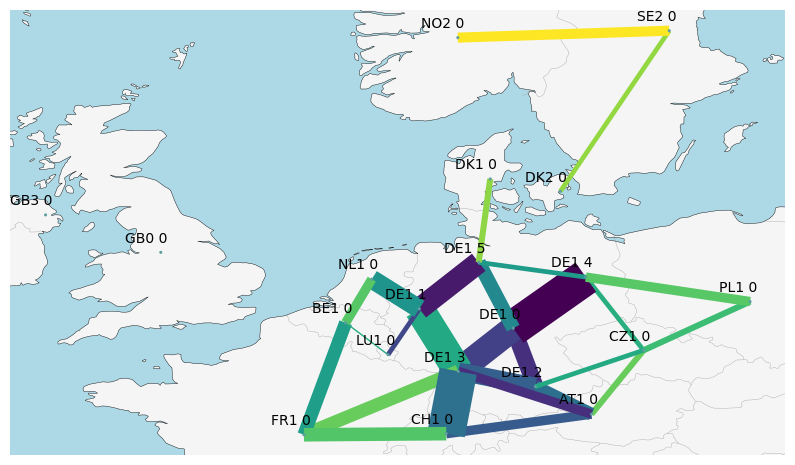

In [22]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [23]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


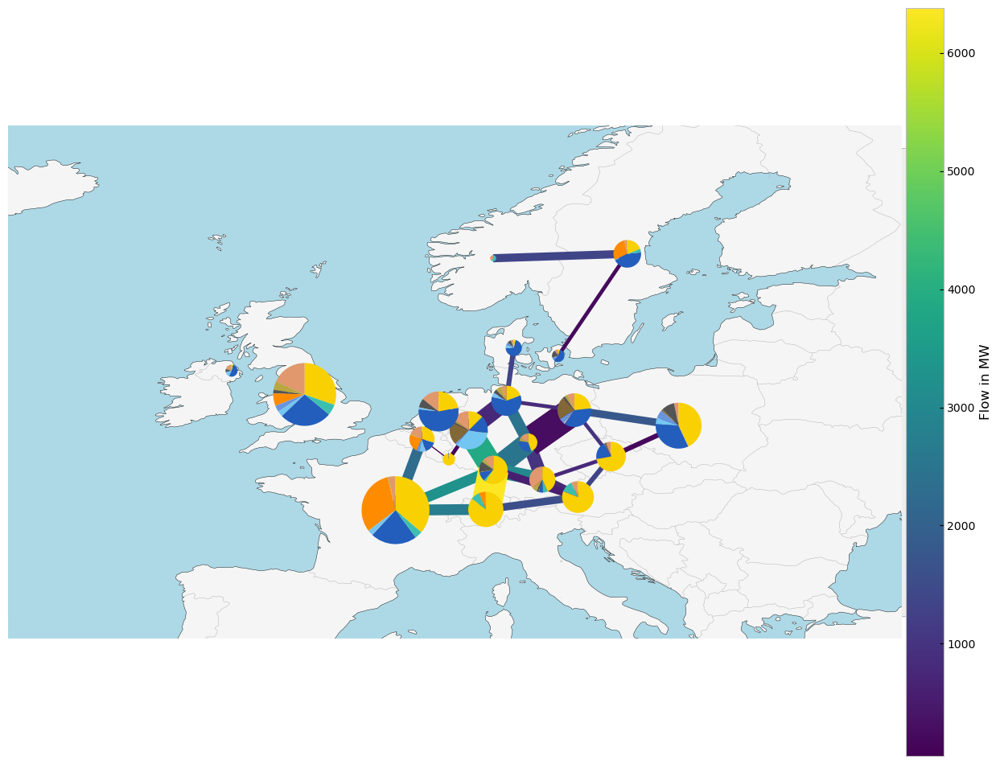

In [24]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [25]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


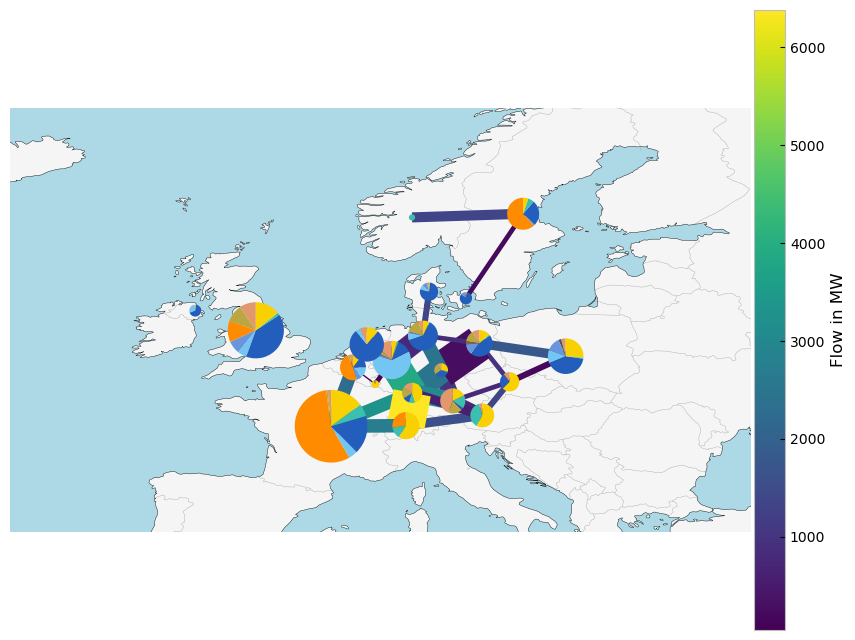

In [26]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

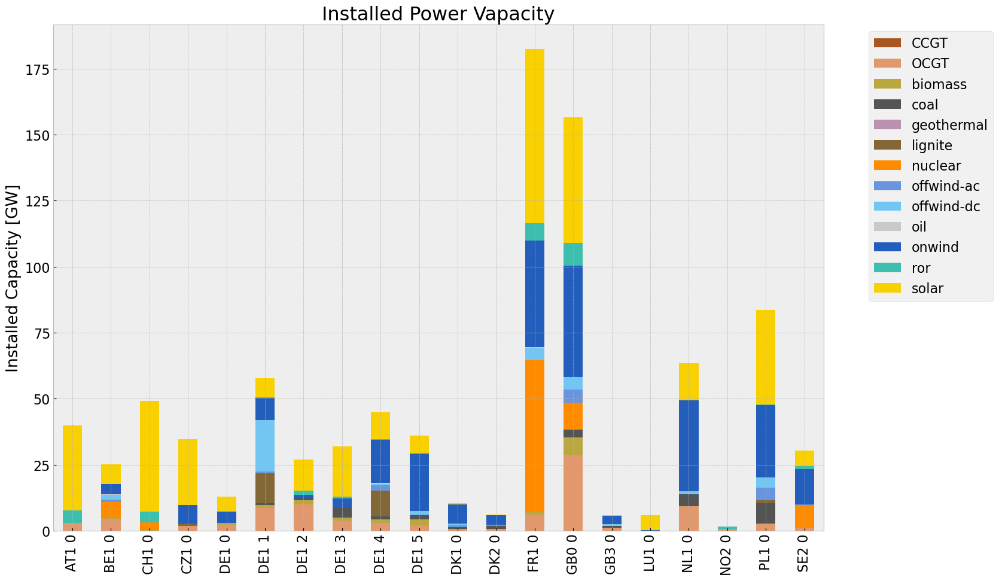

In [27]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

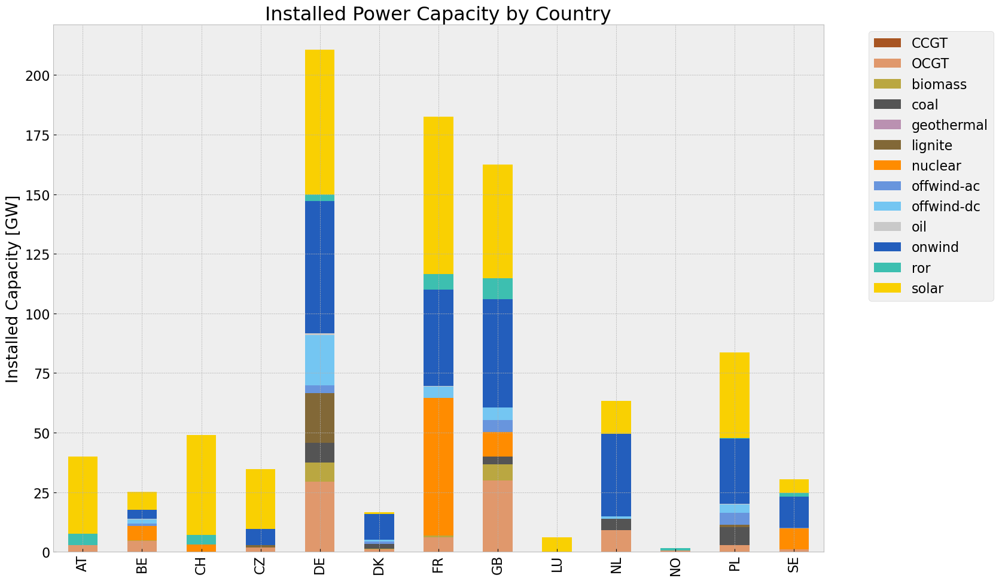

In [28]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

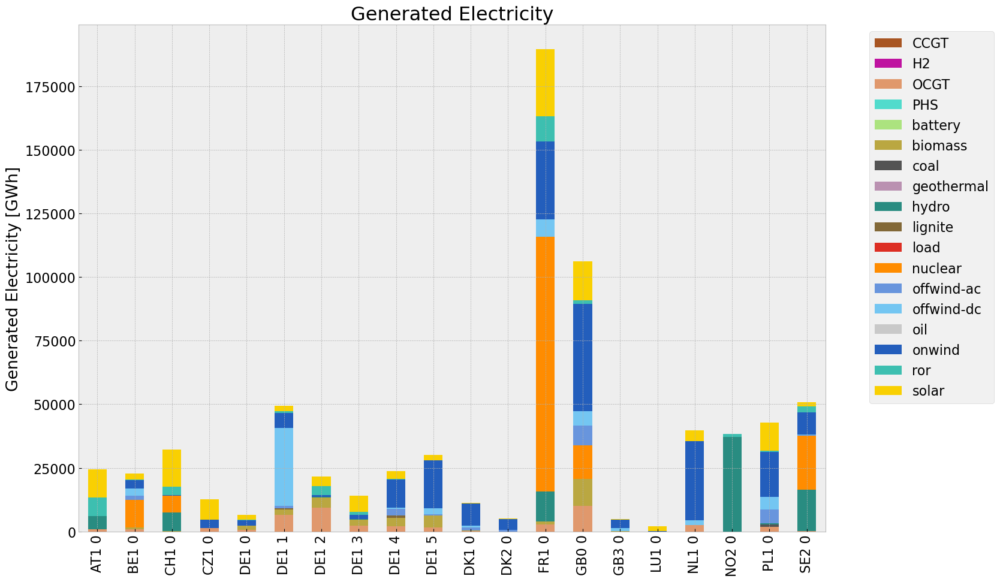

In [29]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

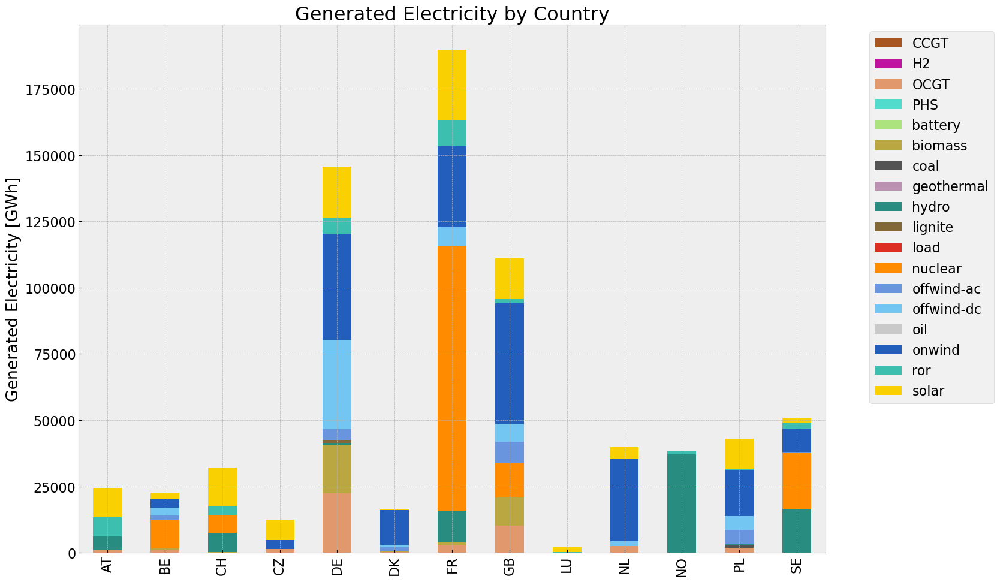

In [30]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [31]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [32]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [33]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [34]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [35]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [36]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [37]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

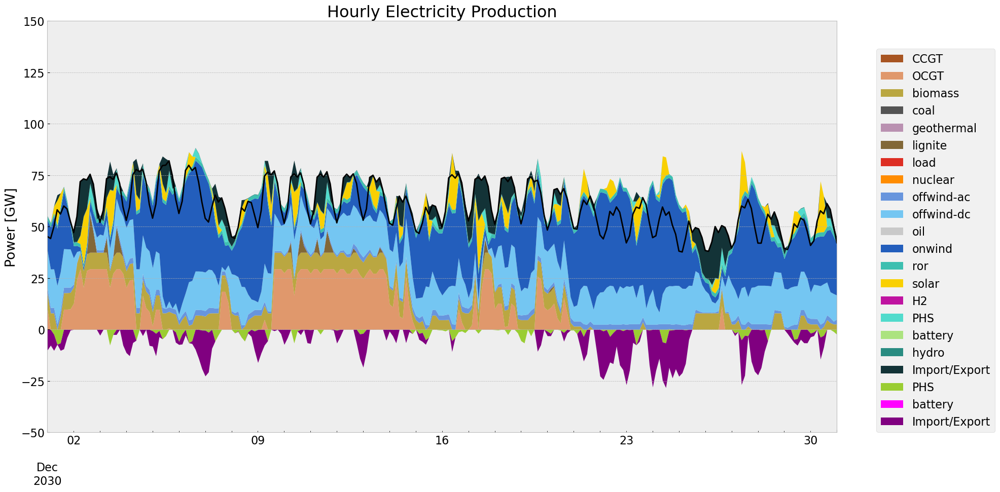

In [38]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

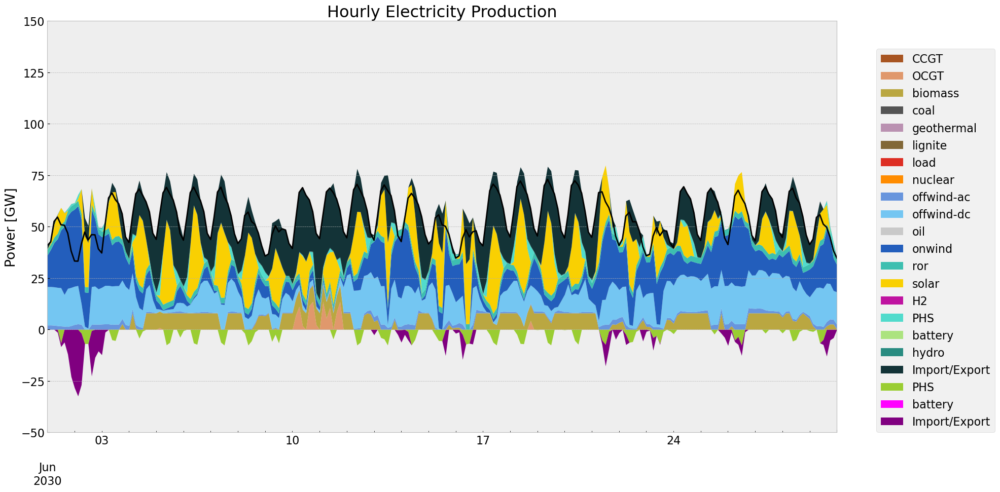

In [39]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [40]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

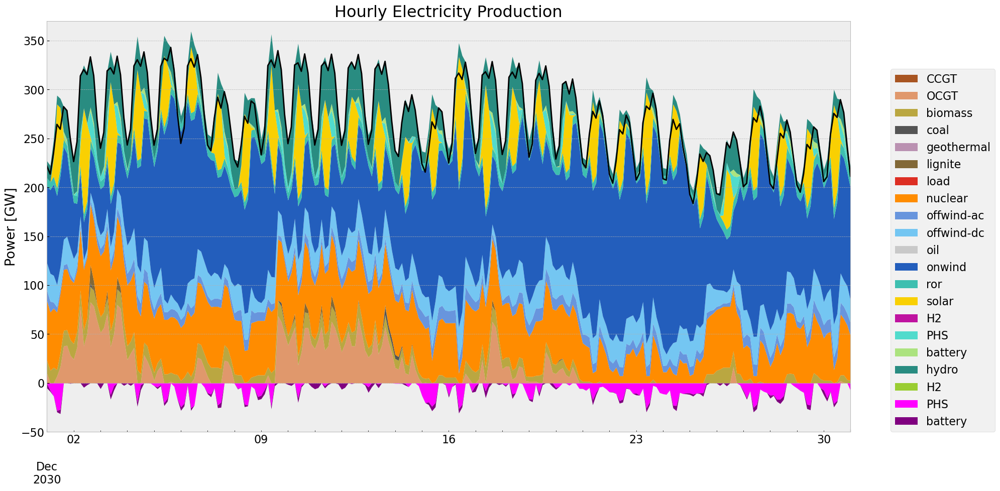

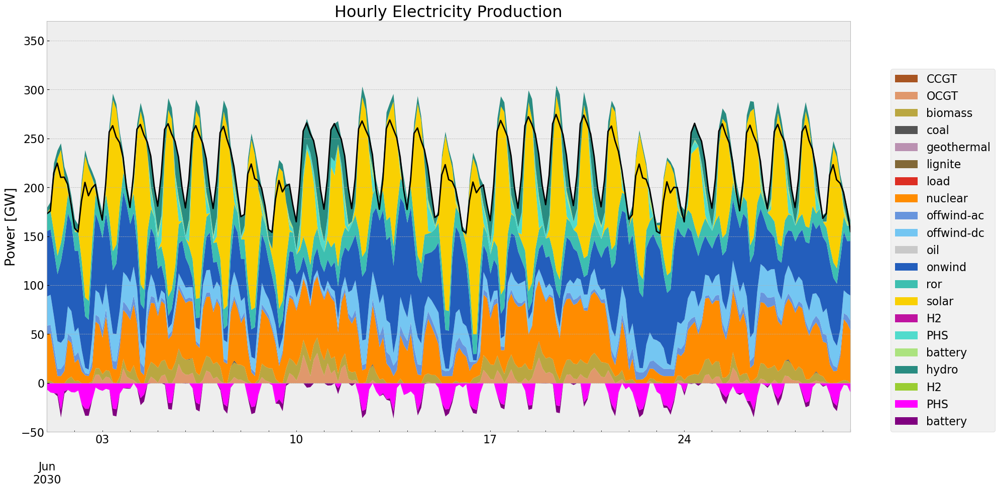

In [41]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [42]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

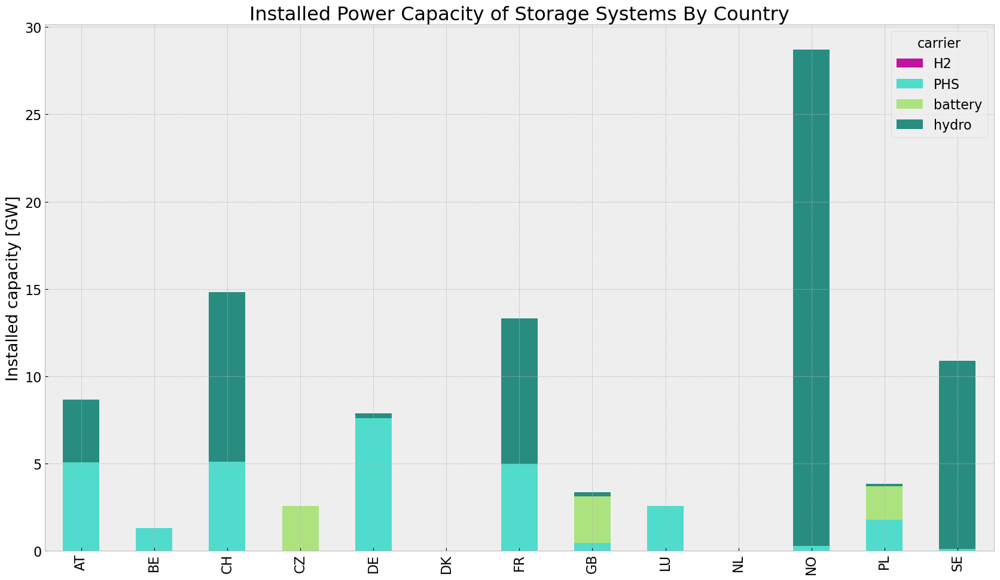

In [43]:
store_base = inst_store_table(n)

In [44]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='3H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')


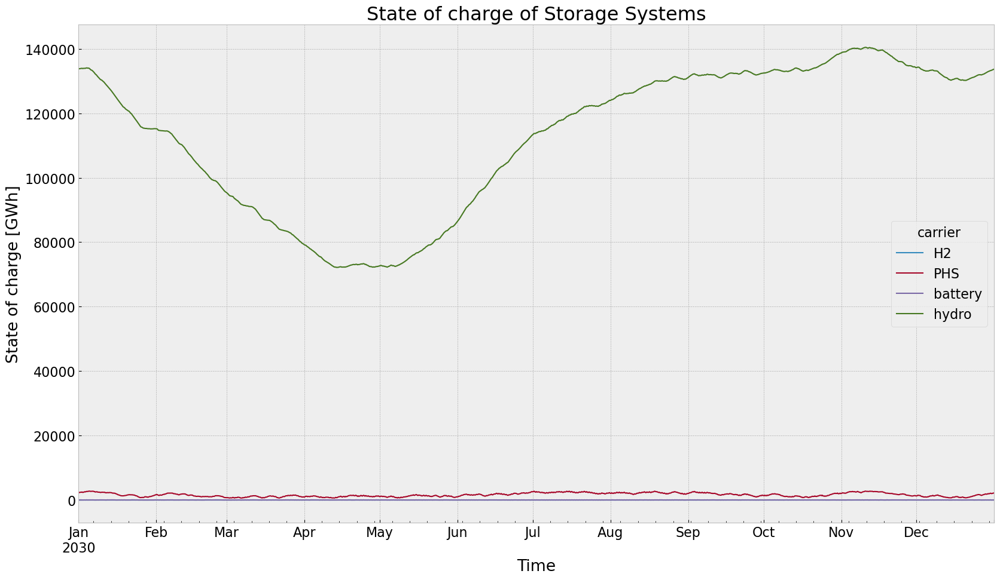

In [45]:
state_of_charge_plot(n, '2030-01-01 00:00', '2030-12-31 21:00')

## Electricity Price

In [46]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [47]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


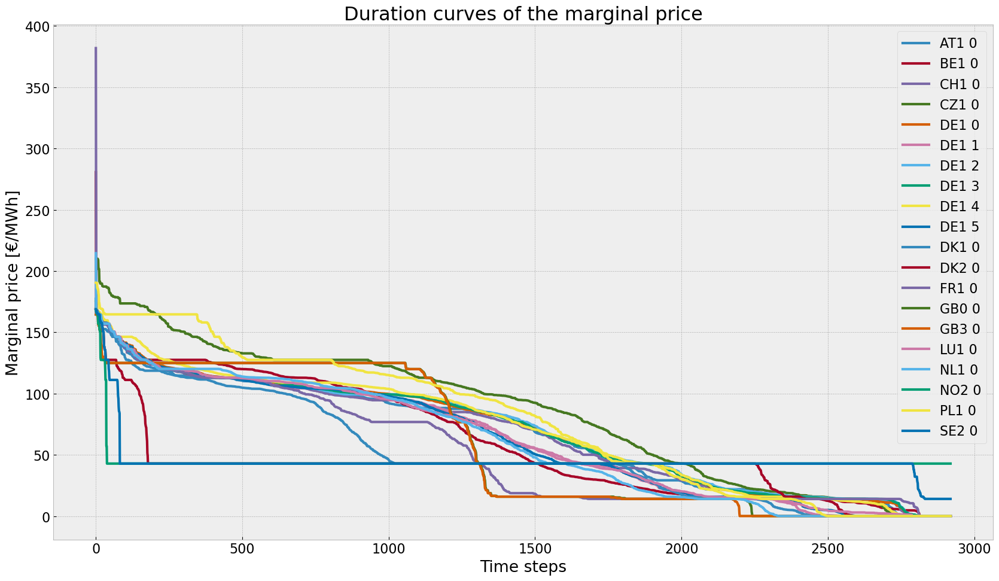

In [48]:
price_dur_curve_plot(n)

In [49]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


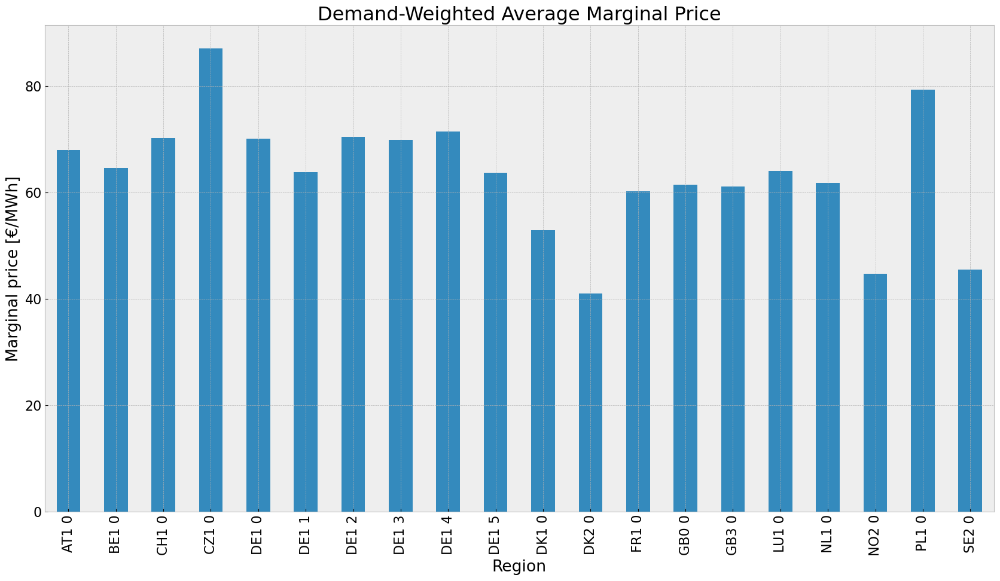

In [50]:
price_regions_table(n)

In [51]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


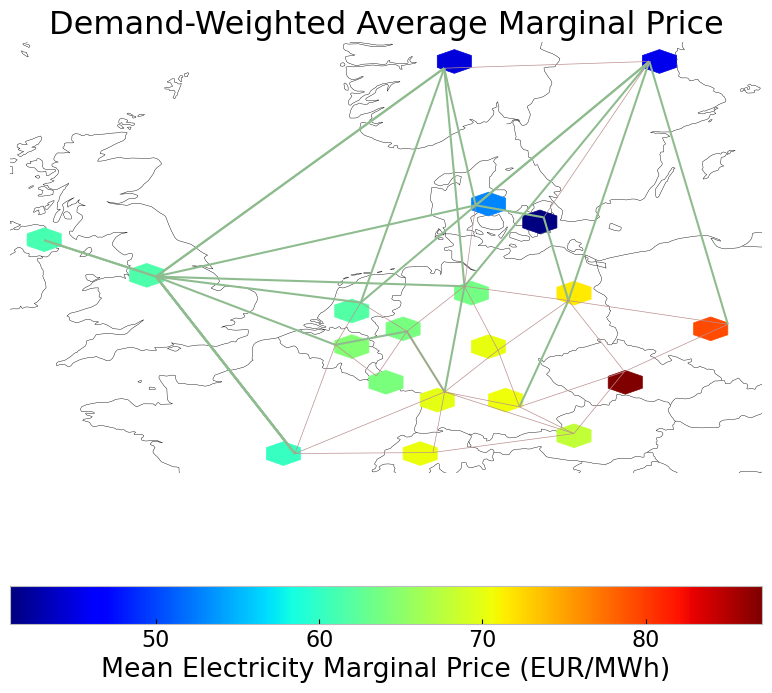

In [52]:
price_regions(n)

## Emission

In [53]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,4.314198e+07,0.451621,0.1980,1.891434e+07
biomass,3.094121e+07,0.468000,0.0000,0.000000e+00
coal,1.288390e+06,0.329908,0.3361,1.312572e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.347177e+06,0.337285,0.4069,1.625233e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.518514e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.084077e+07,1.000000,0.0000,0.000000e+00


# PV Cut Scenario



In [71]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = pvscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}'          

## 1. Model: perfect foresight with allowed additional investment

### Allow investment

In [72]:
def allow_inv(n1,n):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendbale'] = True

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        n1.lines.at[index, 's_nom_extendable'] = True
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        n1.links.at[index, 'p_nom_extendable'] = True
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 
            

allow_inv(n1,n)

In [73]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.17it/s]
INFO:linopy.io: Writing time: 38.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m33ayzun.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m33ayzun.lp


Reading time = 11.36 seconds


INFO:gurobipy:Reading time = 11.36 seconds


obj: 3264862 rows, 1521502 columns, 6235899 nonzeros


INFO:gurobipy:obj: 3264862 rows, 1521502 columns, 6235899 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264862 rows, 1521502 columns and 6235899 nonzeros


INFO:gurobipy:Optimize a model with 3264862 rows, 1521502 columns and 6235899 nonzeros


Model fingerprint: 0x2fef9140


INFO:gurobipy:Model fingerprint: 0x2fef9140


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [3e-03, 2e+02]


INFO:gurobipy:  Matrix range     [3e-03, 2e+02]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2147233 rows and 372373 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2147233 rows and 372373 columns (presolve time = 5s) ...


Presolve removed 2147233 rows and 372373 columns


INFO:gurobipy:Presolve removed 2147233 rows and 372373 columns


Presolve time: 6.25s


INFO:gurobipy:Presolve time: 6.25s


Presolved: 1117629 rows, 1149129 columns, 3743375 nonzeros


INFO:gurobipy:Presolved: 1117629 rows, 1149129 columns, 3743375 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 13.95s


INFO:gurobipy:Ordering time: 13.95s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.984e+06


INFO:gurobipy: AA' NZ     : 3.984e+06


 Factor NZ  : 2.902e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.902e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.154e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.154e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.27308042e+17 -6.41783486e+18  5.33e+09 6.60e+04  6.61e+13    25s


INFO:gurobipy:   0   6.27308042e+17 -6.41783486e+18  5.33e+09 6.60e+04  6.61e+13    25s


   1   5.31885214e+17 -2.40784833e+18  4.34e+09 2.22e+04  3.77e+13    26s


INFO:gurobipy:   1   5.31885214e+17 -2.40784833e+18  4.34e+09 2.22e+04  3.77e+13    26s


   2   4.72738846e+17 -1.22404115e+18  3.77e+09 9.26e+03  2.77e+13    28s


INFO:gurobipy:   2   4.72738846e+17 -1.22404115e+18  3.77e+09 9.26e+03  2.77e+13    28s


   3   3.42171876e+17 -8.86560876e+17  1.93e+09 5.88e+03  1.58e+13    31s


INFO:gurobipy:   3   3.42171876e+17 -8.86560876e+17  1.93e+09 5.88e+03  1.58e+13    31s


   4   2.85550697e+17 -4.08235182e+17  1.00e+09 1.76e+03  7.36e+12    33s


INFO:gurobipy:   4   2.85550697e+17 -4.08235182e+17  1.00e+09 1.76e+03  7.36e+12    33s


   5   2.24593743e+17 -1.31945586e+17  5.03e+08 4.89e+02  3.44e+12    35s


INFO:gurobipy:   5   2.24593743e+17 -1.31945586e+17  5.03e+08 4.89e+02  3.44e+12    35s


   6   1.04128957e+17 -3.80750060e+16  1.25e+08 1.01e+02  8.68e+11    37s


INFO:gurobipy:   6   1.04128957e+17 -3.80750060e+16  1.25e+08 1.01e+02  8.68e+11    37s


   7   2.05305280e+16 -7.68051422e+15  2.36e+06 4.76e+00  2.78e+10    38s


INFO:gurobipy:   7   2.05305280e+16 -7.68051422e+15  2.36e+06 4.76e+00  2.78e+10    38s


   8   3.26624744e+15 -1.00375940e+15  2.42e+05 1.30e-01  3.11e+09    40s


INFO:gurobipy:   8   3.26624744e+15 -1.00375940e+15  2.42e+05 1.30e-01  3.11e+09    40s


   9   3.55476716e+13 -2.28620179e+14  1.88e+03 1.37e-03  1.15e+08    43s


INFO:gurobipy:   9   3.55476716e+13 -2.28620179e+14  1.88e+03 1.37e-03  1.15e+08    43s


  10   1.14778672e+13 -2.28525240e+13  5.13e+02 1.08e-04  1.47e+07    45s


INFO:gurobipy:  10   1.14778672e+13 -2.28525240e+13  5.13e+02 1.08e-04  1.47e+07    45s


  11   5.90094547e+12 -1.32429926e+13  2.39e+02 6.05e-05  8.00e+06    46s


INFO:gurobipy:  11   5.90094547e+12 -1.32429926e+13  2.39e+02 6.05e-05  8.00e+06    46s


  12   2.71366913e+12 -7.91130645e+12  9.40e+01 3.58e-05  4.37e+06    48s


INFO:gurobipy:  12   2.71366913e+12 -7.91130645e+12  9.40e+01 3.58e-05  4.37e+06    48s


  13   1.38469541e+12 -3.77351192e+12  3.72e+01 1.73e-05  2.10e+06    50s


INFO:gurobipy:  13   1.38469541e+12 -3.77351192e+12  3.72e+01 1.73e-05  2.10e+06    50s


  14   8.97345278e+11 -2.11728242e+12  2.07e+01 9.87e-06  1.22e+06    53s


INFO:gurobipy:  14   8.97345278e+11 -2.11728242e+12  2.07e+01 9.87e-06  1.22e+06    53s


  15   8.13519202e+11 -1.99128039e+12  1.84e+01 9.30e-06  1.14e+06    55s


INFO:gurobipy:  15   8.13519202e+11 -1.99128039e+12  1.84e+01 9.30e-06  1.14e+06    55s


  16   5.27575736e+11 -1.21040058e+12  1.01e+01 5.82e-06  7.04e+05    56s


INFO:gurobipy:  16   5.27575736e+11 -1.21040058e+12  1.01e+01 5.82e-06  7.04e+05    56s


  17   4.66413703e+11 -5.06541579e+11  8.44e+00 2.64e-06  3.94e+05    58s


INFO:gurobipy:  17   4.66413703e+11 -5.06541579e+11  8.44e+00 2.64e-06  3.94e+05    58s


  18   3.72023920e+11 -2.75316664e+11  6.22e+00 1.57e-06  2.62e+05    60s


INFO:gurobipy:  18   3.72023920e+11 -2.75316664e+11  6.22e+00 1.57e-06  2.62e+05    60s


  19   2.77685274e+11 -1.30700742e+11  4.17e+00 8.65e-07  1.65e+05    63s


INFO:gurobipy:  19   2.77685274e+11 -1.30700742e+11  4.17e+00 8.65e-07  1.65e+05    63s


  20   2.18291728e+11 -7.77943043e+10  2.96e+00 6.08e-07  1.20e+05    64s


INFO:gurobipy:  20   2.18291728e+11 -7.77943043e+10  2.96e+00 6.08e-07  1.20e+05    64s


  21   1.98404036e+11 -3.92649434e+10  2.56e+00 4.35e-07  9.61e+04    66s


INFO:gurobipy:  21   1.98404036e+11 -3.92649434e+10  2.56e+00 4.35e-07  9.61e+04    66s


  22   1.83175752e+11 -1.93531433e+10  2.27e+00 3.36e-07  8.19e+04    67s


INFO:gurobipy:  22   1.83175752e+11 -1.93531433e+10  2.27e+00 3.36e-07  8.19e+04    67s


  23   1.39396125e+11 -2.14452602e+09  1.45e+00 2.61e-07  5.72e+04    69s


INFO:gurobipy:  23   1.39396125e+11 -2.14452602e+09  1.45e+00 2.61e-07  5.72e+04    69s


  24   1.17680109e+11  1.46368973e+10  1.04e+00 1.87e-07  4.16e+04    72s


INFO:gurobipy:  24   1.17680109e+11  1.46368973e+10  1.04e+00 1.87e-07  4.16e+04    72s


  25   1.04377905e+11  2.43489279e+10  7.94e-01 1.45e-07  3.23e+04    75s


INFO:gurobipy:  25   1.04377905e+11  2.43489279e+10  7.94e-01 1.45e-07  3.23e+04    75s


  26   9.32023667e+10  3.20762702e+10  5.90e-01 1.14e-07  2.47e+04    78s


INFO:gurobipy:  26   9.32023667e+10  3.20762702e+10  5.90e-01 1.14e-07  2.47e+04    78s


  27   8.77337816e+10  4.09645296e+10  4.89e-01 7.88e-08  1.89e+04    80s


INFO:gurobipy:  27   8.77337816e+10  4.09645296e+10  4.89e-01 7.88e-08  1.89e+04    80s


  28   8.06070373e+10  4.48076718e+10  3.58e-01 6.44e-08  1.45e+04    84s


INFO:gurobipy:  28   8.06070373e+10  4.48076718e+10  3.58e-01 6.44e-08  1.45e+04    84s


  29   7.78381436e+10  4.85105293e+10  3.07e-01 4.99e-08  1.18e+04    87s


INFO:gurobipy:  29   7.78381436e+10  4.85105293e+10  3.07e-01 4.99e-08  1.18e+04    87s


  30   7.59388182e+10  5.09672054e+10  2.70e-01 4.04e-08  1.01e+04    89s


INFO:gurobipy:  30   7.59388182e+10  5.09672054e+10  2.70e-01 4.04e-08  1.01e+04    89s


  31   7.33455730e+10  5.37486356e+10  2.21e-01 2.98e-08  7.92e+03    92s


INFO:gurobipy:  31   7.33455730e+10  5.37486356e+10  2.21e-01 2.98e-08  7.92e+03    92s


  32   7.16201244e+10  5.55241774e+10  1.88e-01 2.30e-08  6.50e+03    96s


INFO:gurobipy:  32   7.16201244e+10  5.55241774e+10  1.88e-01 2.30e-08  6.50e+03    96s


  33   6.99774924e+10  5.67954413e+10  1.56e-01 1.82e-08  5.33e+03    99s


INFO:gurobipy:  33   6.99774924e+10  5.67954413e+10  1.56e-01 1.82e-08  5.33e+03    99s


  34   6.79441864e+10  5.75777231e+10  1.18e-01 1.55e-08  4.19e+03   102s


INFO:gurobipy:  34   6.79441864e+10  5.75777231e+10  1.18e-01 1.55e-08  4.19e+03   102s


  35   6.66987244e+10  5.84206660e+10  9.36e-02 1.23e-08  3.34e+03   105s


INFO:gurobipy:  35   6.66987244e+10  5.84206660e+10  9.36e-02 1.23e-08  3.34e+03   105s


  36   6.57791373e+10  5.89526125e+10  7.53e-02 1.04e-08  2.76e+03   108s


INFO:gurobipy:  36   6.57791373e+10  5.89526125e+10  7.53e-02 1.04e-08  2.76e+03   108s


  37   6.50744905e+10  5.97231767e+10  6.13e-02 7.59e-09  2.16e+03   111s


INFO:gurobipy:  37   6.50744905e+10  5.97231767e+10  6.13e-02 7.59e-09  2.16e+03   111s


  38   6.42308178e+10  6.01998482e+10  4.48e-02 5.96e-09  1.63e+03   114s


INFO:gurobipy:  38   6.42308178e+10  6.01998482e+10  4.48e-02 5.96e-09  1.63e+03   114s


  39   6.37276631e+10  6.04177092e+10  3.49e-02 5.11e-09  1.34e+03   117s


INFO:gurobipy:  39   6.37276631e+10  6.04177092e+10  3.49e-02 5.11e-09  1.34e+03   117s


  40   6.34459128e+10  6.06129144e+10  2.94e-02 4.45e-09  1.14e+03   120s


INFO:gurobipy:  40   6.34459128e+10  6.06129144e+10  2.94e-02 4.45e-09  1.14e+03   120s


  41   6.31100671e+10  6.06774241e+10  2.28e-02 1.03e-08  9.83e+02   124s


INFO:gurobipy:  41   6.31100671e+10  6.06774241e+10  2.28e-02 1.03e-08  9.83e+02   124s


  42   6.29008108e+10  6.10394054e+10  1.87e-02 3.01e-08  7.52e+02   127s


INFO:gurobipy:  42   6.29008108e+10  6.10394054e+10  1.87e-02 3.01e-08  7.52e+02   127s


  43   6.27180838e+10  6.12776843e+10  1.51e-02 4.38e-08  5.82e+02   130s


INFO:gurobipy:  43   6.27180838e+10  6.12776843e+10  1.51e-02 4.38e-08  5.82e+02   130s


  44   6.25588970e+10  6.13830508e+10  1.19e-02 3.56e-08  4.75e+02   133s


INFO:gurobipy:  44   6.25588970e+10  6.13830508e+10  1.19e-02 3.56e-08  4.75e+02   133s


  45   6.23925606e+10  6.14942986e+10  8.68e-03 3.16e-08  3.63e+02   137s


INFO:gurobipy:  45   6.23925606e+10  6.14942986e+10  8.68e-03 3.16e-08  3.63e+02   137s


  46   6.23085194e+10  6.15890069e+10  7.07e-03 2.68e-08  2.91e+02   140s


INFO:gurobipy:  46   6.23085194e+10  6.15890069e+10  7.07e-03 2.68e-08  2.91e+02   140s


  47   6.22392983e+10  6.16791386e+10  5.76e-03 2.32e-08  2.26e+02   143s


INFO:gurobipy:  47   6.22392983e+10  6.16791386e+10  5.76e-03 2.32e-08  2.26e+02   143s


  48   6.21643121e+10  6.17155561e+10  4.34e-03 2.30e-08  1.81e+02   146s


INFO:gurobipy:  48   6.21643121e+10  6.17155561e+10  4.34e-03 2.30e-08  1.81e+02   146s


  49   6.21163709e+10  6.17516668e+10  3.44e-03 2.36e-08  1.47e+02   149s


INFO:gurobipy:  49   6.21163709e+10  6.17516668e+10  3.44e-03 2.36e-08  1.47e+02   149s


  50   6.20707097e+10  6.17927972e+10  2.60e-03 2.51e-08  1.12e+02   153s


INFO:gurobipy:  50   6.20707097e+10  6.17927972e+10  2.60e-03 2.51e-08  1.12e+02   153s


  51   6.20389426e+10  6.18292444e+10  2.01e-03 2.41e-08  8.47e+01   156s


INFO:gurobipy:  51   6.20389426e+10  6.18292444e+10  2.01e-03 2.41e-08  8.47e+01   156s


  52   6.20141806e+10  6.18503360e+10  1.57e-03 2.23e-08  6.62e+01   159s


INFO:gurobipy:  52   6.20141806e+10  6.18503360e+10  1.57e-03 2.23e-08  6.62e+01   159s


  53   6.19931186e+10  6.18610385e+10  1.20e-03 4.13e-08  5.34e+01   162s


INFO:gurobipy:  53   6.19931186e+10  6.18610385e+10  1.20e-03 4.13e-08  5.34e+01   162s


  54   6.19776744e+10  6.18724717e+10  9.24e-04 3.54e-08  4.25e+01   166s


INFO:gurobipy:  54   6.19776744e+10  6.18724717e+10  9.24e-04 3.54e-08  4.25e+01   166s


  55   6.19609229e+10  6.18842633e+10  6.27e-04 2.89e-08  3.10e+01   169s


INFO:gurobipy:  55   6.19609229e+10  6.18842633e+10  6.27e-04 2.89e-08  3.10e+01   169s


  56   6.19524319e+10  6.18947326e+10  4.75e-04 3.38e-08  2.33e+01   172s


INFO:gurobipy:  56   6.19524319e+10  6.18947326e+10  4.75e-04 3.38e-08  2.33e+01   172s


  57   6.19475696e+10  6.19023676e+10  3.88e-04 2.81e-08  1.83e+01   175s


INFO:gurobipy:  57   6.19475696e+10  6.19023676e+10  3.88e-04 2.81e-08  1.83e+01   175s


  58   6.19436243e+10  6.19094311e+10  3.19e-04 2.89e-08  1.38e+01   179s


INFO:gurobipy:  58   6.19436243e+10  6.19094311e+10  3.19e-04 2.89e-08  1.38e+01   179s


  59   6.19395728e+10  6.19128455e+10  2.49e-04 3.54e-08  1.08e+01   182s


INFO:gurobipy:  59   6.19395728e+10  6.19128455e+10  2.49e-04 3.54e-08  1.08e+01   182s


  60   6.19364982e+10  6.19162400e+10  1.96e-04 4.03e-08  8.18e+00   185s


INFO:gurobipy:  60   6.19364982e+10  6.19162400e+10  1.96e-04 4.03e-08  8.18e+00   185s


  61   6.19350592e+10  6.19180371e+10  1.72e-04 4.14e-08  6.88e+00   188s


INFO:gurobipy:  61   6.19350592e+10  6.19180371e+10  1.72e-04 4.14e-08  6.88e+00   188s


  62   6.19316477e+10  6.19190840e+10  1.15e-04 4.13e-08  5.08e+00   191s


INFO:gurobipy:  62   6.19316477e+10  6.19190840e+10  1.15e-04 4.13e-08  5.08e+00   191s


  63   6.19294574e+10  6.19202656e+10  7.93e-05 3.88e-08  3.71e+00   194s


INFO:gurobipy:  63   6.19294574e+10  6.19202656e+10  7.93e-05 3.88e-08  3.71e+00   194s


  64   6.19278773e+10  6.19215231e+10  5.56e-05 3.43e-08  2.57e+00   197s


INFO:gurobipy:  64   6.19278773e+10  6.19215231e+10  5.56e-05 3.43e-08  2.57e+00   197s


  65   6.19269798e+10  6.19227445e+10  3.79e-05 2.78e-08  1.71e+00   201s


INFO:gurobipy:  65   6.19269798e+10  6.19227445e+10  3.79e-05 2.78e-08  1.71e+00   201s


  66   6.19259776e+10  6.19234187e+10  4.71e-05 2.94e-08  1.03e+00   204s


INFO:gurobipy:  66   6.19259776e+10  6.19234187e+10  4.71e-05 2.94e-08  1.03e+00   204s


  67   6.19254360e+10  6.19238624e+10  2.72e-05 3.12e-08  6.36e-01   207s


INFO:gurobipy:  67   6.19254360e+10  6.19238624e+10  2.72e-05 3.12e-08  6.36e-01   207s


  68   6.19251420e+10  6.19241750e+10  1.59e-05 3.36e-08  3.91e-01   210s


INFO:gurobipy:  68   6.19251420e+10  6.19241750e+10  1.59e-05 3.36e-08  3.91e-01   210s


  69   6.19250075e+10  6.19243395e+10  1.05e-05 2.54e-08  2.70e-01   212s


INFO:gurobipy:  69   6.19250075e+10  6.19243395e+10  1.05e-05 2.54e-08  2.70e-01   212s


  70   6.19249230e+10  6.19244738e+10  8.20e-06 1.81e-08  1.81e-01   214s


INFO:gurobipy:  70   6.19249230e+10  6.19244738e+10  8.20e-06 1.81e-08  1.81e-01   214s


  71   6.19249044e+10  6.19245440e+10  7.20e-06 1.40e-08  1.46e-01   216s


INFO:gurobipy:  71   6.19249044e+10  6.19245440e+10  7.20e-06 1.40e-08  1.46e-01   216s


  72   6.19248811e+10  6.19246161e+10  6.15e-06 1.03e-08  1.07e-01   219s


INFO:gurobipy:  72   6.19248811e+10  6.19246161e+10  6.15e-06 1.03e-08  1.07e-01   219s


  73   6.19248588e+10  6.19246388e+10  5.10e-06 9.29e-09  8.89e-02   221s


INFO:gurobipy:  73   6.19248588e+10  6.19246388e+10  5.10e-06 9.29e-09  8.89e-02   221s


  74   6.19248438e+10  6.19246676e+10  4.40e-06 7.98e-09  7.12e-02   223s


INFO:gurobipy:  74   6.19248438e+10  6.19246676e+10  4.40e-06 7.98e-09  7.12e-02   223s


  75   6.19248351e+10  6.19246726e+10  4.01e-06 7.78e-09  6.56e-02   226s


INFO:gurobipy:  75   6.19248351e+10  6.19246726e+10  4.01e-06 7.78e-09  6.56e-02   226s


  76   6.19247915e+10  6.19247000e+10  2.00e-06 6.58e-09  3.70e-02   228s


INFO:gurobipy:  76   6.19247915e+10  6.19247000e+10  2.00e-06 6.58e-09  3.70e-02   228s


  77   6.19247869e+10  6.19247049e+10  1.81e-06 6.20e-09  3.31e-02   230s


INFO:gurobipy:  77   6.19247869e+10  6.19247049e+10  1.81e-06 6.20e-09  3.31e-02   230s


  78   6.19247706e+10  6.19247157e+10  1.08e-06 5.26e-09  2.22e-02   233s


INFO:gurobipy:  78   6.19247706e+10  6.19247157e+10  1.08e-06 5.26e-09  2.22e-02   233s


  79   6.19247669e+10  6.19247237e+10  9.18e-07 4.41e-09  1.75e-02   235s


INFO:gurobipy:  79   6.19247669e+10  6.19247237e+10  9.18e-07 4.41e-09  1.75e-02   235s


  80   6.19247614e+10  6.19247272e+10  6.88e-07 3.92e-09  1.38e-02   238s


INFO:gurobipy:  80   6.19247614e+10  6.19247272e+10  6.88e-07 3.92e-09  1.38e-02   238s


  81   6.19247554e+10  6.19247348e+10  4.37e-07 3.22e-09  8.30e-03   240s


INFO:gurobipy:  81   6.19247554e+10  6.19247348e+10  4.37e-07 3.22e-09  8.30e-03   240s


  82   6.19247532e+10  6.19247364e+10  3.50e-07 3.20e-09  6.78e-03   242s


INFO:gurobipy:  82   6.19247532e+10  6.19247364e+10  3.50e-07 3.20e-09  6.78e-03   242s


  83   6.19247508e+10  6.19247380e+10  2.52e-07 2.89e-09  5.19e-03   245s


INFO:gurobipy:  83   6.19247508e+10  6.19247380e+10  2.52e-07 2.89e-09  5.19e-03   245s


  84   6.19247502e+10  6.19247387e+10  2.38e-07 2.84e-09  4.66e-03   247s


INFO:gurobipy:  84   6.19247502e+10  6.19247387e+10  2.38e-07 2.84e-09  4.66e-03   247s


  85   6.19247498e+10  6.19247390e+10  2.18e-07 2.76e-09  4.35e-03   250s


INFO:gurobipy:  85   6.19247498e+10  6.19247390e+10  2.18e-07 2.76e-09  4.35e-03   250s


  86   6.19247494e+10  6.19247396e+10  2.01e-07 2.59e-09  3.96e-03   253s


INFO:gurobipy:  86   6.19247494e+10  6.19247396e+10  2.01e-07 2.59e-09  3.96e-03   253s


  87   6.19247487e+10  6.19247417e+10  1.76e-07 1.73e-09  2.85e-03   256s


INFO:gurobipy:  87   6.19247487e+10  6.19247417e+10  1.76e-07 1.73e-09  2.85e-03   256s


  88   6.19247462e+10  6.19247422e+10  7.12e-08 1.76e-09  1.65e-03   259s


INFO:gurobipy:  88   6.19247462e+10  6.19247422e+10  7.12e-08 1.76e-09  1.65e-03   259s


  89   6.19247460e+10  6.19247433e+10  6.08e-08 1.48e-09  1.10e-03   262s


INFO:gurobipy:  89   6.19247460e+10  6.19247433e+10  6.08e-08 1.48e-09  1.10e-03   262s


  90   6.19247456e+10  6.19247436e+10  5.74e-06 1.59e-09  7.73e-04   265s


INFO:gurobipy:  90   6.19247456e+10  6.19247436e+10  5.74e-06 1.59e-09  7.73e-04   265s


  91   6.19247454e+10  6.19247437e+10  5.12e-06 1.51e-09  7.04e-04   267s


INFO:gurobipy:  91   6.19247454e+10  6.19247437e+10  5.12e-06 1.51e-09  7.04e-04   267s


  92   6.19247451e+10  6.19247441e+10  3.63e-06 1.01e-09  4.15e-04   269s


INFO:gurobipy:  92   6.19247451e+10  6.19247441e+10  3.63e-06 1.01e-09  4.15e-04   269s


  93   6.19247449e+10  6.19247443e+10  4.68e-06 1.69e-09  2.45e-04   272s


INFO:gurobipy:  93   6.19247449e+10  6.19247443e+10  4.68e-06 1.69e-09  2.45e-04   272s


INFO:gurobipy:


Barrier solved model in 93 iterations and 271.87 seconds (86.69 work units)


INFO:gurobipy:Barrier solved model in 93 iterations and 271.87 seconds (86.69 work units)


Optimal objective 6.19247449e+10


INFO:gurobipy:Optimal objective 6.19247449e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  486514 variables added to crossover basis                      276s


INFO:gurobipy:  486514 variables added to crossover basis                      276s


  590388 variables added to crossover basis                      280s


INFO:gurobipy:  590388 variables added to crossover basis                      280s


  593126 variables added to crossover basis                      285s


INFO:gurobipy:  593126 variables added to crossover basis                      285s


  595272 variables added to crossover basis                      290s


INFO:gurobipy:  595272 variables added to crossover basis                      290s


  596701 variables added to crossover basis                      295s


INFO:gurobipy:  596701 variables added to crossover basis                      295s


  597838 variables added to crossover basis                      300s


INFO:gurobipy:  597838 variables added to crossover basis                      300s


  598884 variables added to crossover basis                      305s


INFO:gurobipy:  598884 variables added to crossover basis                      305s


  599872 variables added to crossover basis                      310s


INFO:gurobipy:  599872 variables added to crossover basis                      310s


  600802 variables added to crossover basis                      315s


INFO:gurobipy:  600802 variables added to crossover basis                      315s


  601724 variables added to crossover basis                      320s


INFO:gurobipy:  601724 variables added to crossover basis                      320s


  602682 variables added to crossover basis                      325s


INFO:gurobipy:  602682 variables added to crossover basis                      325s


  603580 variables added to crossover basis                      330s


INFO:gurobipy:  603580 variables added to crossover basis                      330s


  604478 variables added to crossover basis                      335s


INFO:gurobipy:  604478 variables added to crossover basis                      335s


  605375 variables added to crossover basis                      340s


INFO:gurobipy:  605375 variables added to crossover basis                      340s


  606153 variables added to crossover basis                      345s


INFO:gurobipy:  606153 variables added to crossover basis                      345s


  606838 variables added to crossover basis                      350s


INFO:gurobipy:  606838 variables added to crossover basis                      350s


  607523 variables added to crossover basis                      355s


INFO:gurobipy:  607523 variables added to crossover basis                      355s


  608177 variables added to crossover basis                      360s


INFO:gurobipy:  608177 variables added to crossover basis                      360s


  608835 variables added to crossover basis                      365s


INFO:gurobipy:  608835 variables added to crossover basis                      365s


  609459 variables added to crossover basis                      370s


INFO:gurobipy:  609459 variables added to crossover basis                      370s


  610084 variables added to crossover basis                      375s


INFO:gurobipy:  610084 variables added to crossover basis                      375s


  610711 variables added to crossover basis                      380s


INFO:gurobipy:  610711 variables added to crossover basis                      380s


  611329 variables added to crossover basis                      385s


INFO:gurobipy:  611329 variables added to crossover basis                      385s


  611888 variables added to crossover basis                      390s


INFO:gurobipy:  611888 variables added to crossover basis                      390s


  612450 variables added to crossover basis                      395s


INFO:gurobipy:  612450 variables added to crossover basis                      395s


INFO:gurobipy:


  504716 DPushes remaining with DInf 0.0000000e+00               400s


INFO:gurobipy:  504716 DPushes remaining with DInf 0.0000000e+00               400s


   89256 DPushes remaining with DInf 0.0000000e+00               518s


INFO:gurobipy:   89256 DPushes remaining with DInf 0.0000000e+00               518s


   26215 DPushes remaining with DInf 0.0000000e+00               560s


INFO:gurobipy:   26215 DPushes remaining with DInf 0.0000000e+00               560s


    4015 DPushes remaining with DInf 0.0000000e+00               578s


INFO:gurobipy:    4015 DPushes remaining with DInf 0.0000000e+00               578s


    1598 DPushes remaining with DInf 0.0000000e+00               582s


INFO:gurobipy:    1598 DPushes remaining with DInf 0.0000000e+00               582s


     818 DPushes remaining with DInf 0.0000000e+00               593s


INFO:gurobipy:     818 DPushes remaining with DInf 0.0000000e+00               593s


     291 DPushes remaining with DInf 0.0000000e+00               597s


INFO:gurobipy:     291 DPushes remaining with DInf 0.0000000e+00               597s


       0 DPushes remaining with DInf 0.0000000e+00               599s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               599s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


  773994 PPushes remaining with PInf 2.3280465e-02               600s


INFO:gurobipy:  773994 PPushes remaining with PInf 2.3280465e-02               600s


  278465 PPushes remaining with PInf 2.5795519e+00              3360s


INFO:gurobipy:  278465 PPushes remaining with PInf 2.5795519e+00              3360s


  264464 PPushes remaining with PInf 2.6838285e+00              3380s


INFO:gurobipy:  264464 PPushes remaining with PInf 2.6838285e+00              3380s


  254893 PPushes remaining with PInf 2.7118395e+00              3393s


INFO:gurobipy:  254893 PPushes remaining with PInf 2.7118395e+00              3393s


  249232 PPushes remaining with PInf 2.5948166e+00              3402s


INFO:gurobipy:  249232 PPushes remaining with PInf 2.5948166e+00              3402s


  244263 PPushes remaining with PInf 2.5807391e+00              3405s


INFO:gurobipy:  244263 PPushes remaining with PInf 2.5807391e+00              3405s


  235394 PPushes remaining with PInf 2.5890713e+00              3411s


INFO:gurobipy:  235394 PPushes remaining with PInf 2.5890713e+00              3411s


  140441 PPushes remaining with PInf 2.5293020e+00              4504s


INFO:gurobipy:  140441 PPushes remaining with PInf 2.5293020e+00              4504s


  129667 PPushes remaining with PInf 2.5203230e+00              4589s


INFO:gurobipy:  129667 PPushes remaining with PInf 2.5203230e+00              4589s


  120107 PPushes remaining with PInf 2.5711866e+00              4601s


INFO:gurobipy:  120107 PPushes remaining with PInf 2.5711866e+00              4601s


   16021 PPushes remaining with PInf 3.8311106e+00              4929s


INFO:gurobipy:   16021 PPushes remaining with PInf 3.8311106e+00              4929s


    8512 PPushes remaining with PInf 3.9237500e+00              5011s


INFO:gurobipy:    8512 PPushes remaining with PInf 3.9237500e+00              5011s


    6309 PPushes remaining with PInf 3.8306064e+00              5015s


INFO:gurobipy:    6309 PPushes remaining with PInf 3.8306064e+00              5015s


    2733 PPushes remaining with PInf 3.5387223e+00              5022s


INFO:gurobipy:    2733 PPushes remaining with PInf 3.5387223e+00              5022s


     504 PPushes remaining with PInf 2.9176930e+00              5026s


INFO:gurobipy:     504 PPushes remaining with PInf 2.9176930e+00              5026s


       0 PPushes remaining with PInf 0.0000000e+00              5028s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00              5028s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 4.1374993e+05   5029s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 4.1374993e+05   5029s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


 1048913    6.1924744e+10   0.000000e+00   4.137499e+05   5030s


INFO:gurobipy: 1048913    6.1924744e+10   0.000000e+00   4.137499e+05   5030s


 1049440    6.1924744e+10   0.000000e+00   3.149181e+05   5037s


INFO:gurobipy: 1049440    6.1924744e+10   0.000000e+00   3.149181e+05   5037s


 1049967    6.1924744e+10   0.000000e+00   1.909095e+05   5045s


INFO:gurobipy: 1049967    6.1924744e+10   0.000000e+00   1.909095e+05   5045s


 1050494    6.1924744e+10   0.000000e+00   1.028848e+05   5052s


INFO:gurobipy: 1050494    6.1924744e+10   0.000000e+00   1.028848e+05   5052s


 1051021    6.1924744e+10   0.000000e+00   9.776380e+04   5057s


INFO:gurobipy: 1051021    6.1924744e+10   0.000000e+00   9.776380e+04   5057s


 1051548    6.1924744e+10   0.000000e+00   6.008516e+04   5063s


INFO:gurobipy: 1051548    6.1924744e+10   0.000000e+00   6.008516e+04   5063s


 1052075    6.1924744e+10   0.000000e+00   3.220246e+04   5069s


INFO:gurobipy: 1052075    6.1924744e+10   0.000000e+00   3.220246e+04   5069s


 1052602    6.1924744e+10   0.000000e+00   1.522903e+04   5077s


INFO:gurobipy: 1052602    6.1924744e+10   0.000000e+00   1.522903e+04   5077s


 1053129    6.1924744e+10   0.000000e+00   8.905186e+03   5085s


INFO:gurobipy: 1053129    6.1924744e+10   0.000000e+00   8.905186e+03   5085s


 1053656    6.1924744e+10   0.000000e+00   5.298920e+03   5093s


INFO:gurobipy: 1053656    6.1924744e+10   0.000000e+00   5.298920e+03   5093s


 1054183    6.1924744e+10   0.000000e+00   2.492075e+03   5100s


INFO:gurobipy: 1054183    6.1924744e+10   0.000000e+00   2.492075e+03   5100s


 1054711    6.1924744e+10   0.000000e+00   1.409356e+03   5107s


INFO:gurobipy: 1054711    6.1924744e+10   0.000000e+00   1.409356e+03   5107s


 1055238    6.1924744e+10   0.000000e+00   3.434425e+02   5115s


INFO:gurobipy: 1055238    6.1924744e+10   0.000000e+00   3.434425e+02   5115s


 1055765    6.1924744e+10   0.000000e+00   5.780643e+01   5121s


INFO:gurobipy: 1055765    6.1924744e+10   0.000000e+00   5.780643e+01   5121s


 1056819    6.1924744e+10   0.000000e+00   2.147930e+00   5126s


INFO:gurobipy: 1056819    6.1924744e+10   0.000000e+00   2.147930e+00   5126s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


 1057627    6.1924744e+10   0.000000e+00   0.000000e+00   5135s


INFO:gurobipy: 1057627    6.1924744e+10   0.000000e+00   0.000000e+00   5135s


INFO:gurobipy:


Solved in 1057627 iterations and 5134.70 seconds (3118.07 work units)


INFO:gurobipy:Solved in 1057627 iterations and 5134.70 seconds (3118.07 work units)


Optimal objective  6.192474439e+10


INFO:gurobipy:Optimal objective  6.192474439e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264862 duals
Objective: 6.19e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

### Export model for later use

In [74]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has buses, links, generators, loads, lines, storage_units, carriers


<xarray.Dataset> Size: 14MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           links_i: 28, links_t_p0_i: 18,
                                           ...
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 31,
                                           storage_units_t_p_dispatch_i: 31,
                                           storage_units_t_p_store_i: 21,
                                           storage_units_t_state_of_charge_i: 65,
                                           carriers_i: 21)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
    ...                                    ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 248B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 248B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 168B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 724kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 491kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 2MB ...
    carriers_co2_emissions                (carriers_i) float64 168B 0.0 ... 0.0
    carriers_color                        (carriers_i) object 168B '#70af1d' ...
    carriers_nice_name                    (carriers_i) object 168B 'AC' ... '...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           61924744392.05688
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [75]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

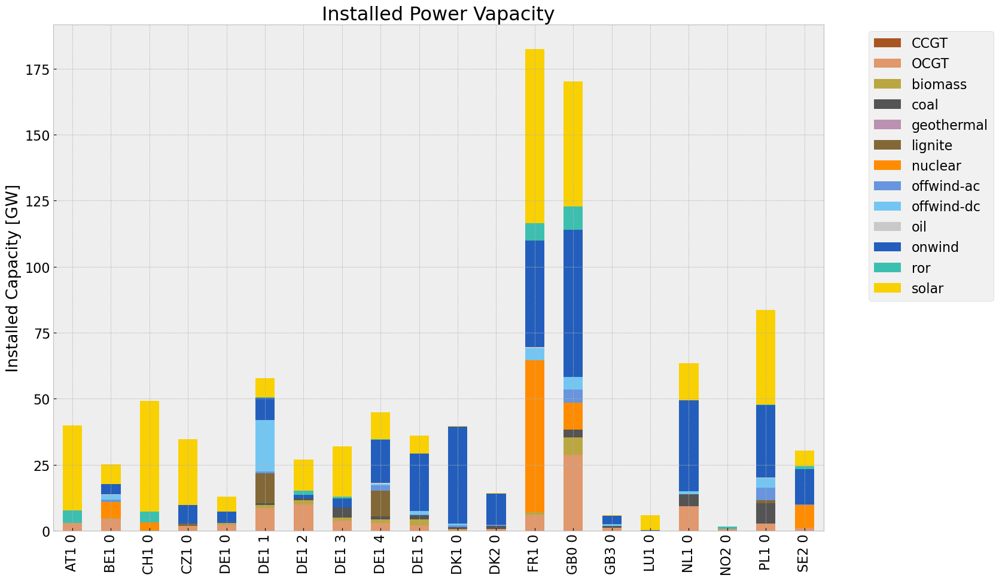

<Figure size 640x480 with 0 Axes>

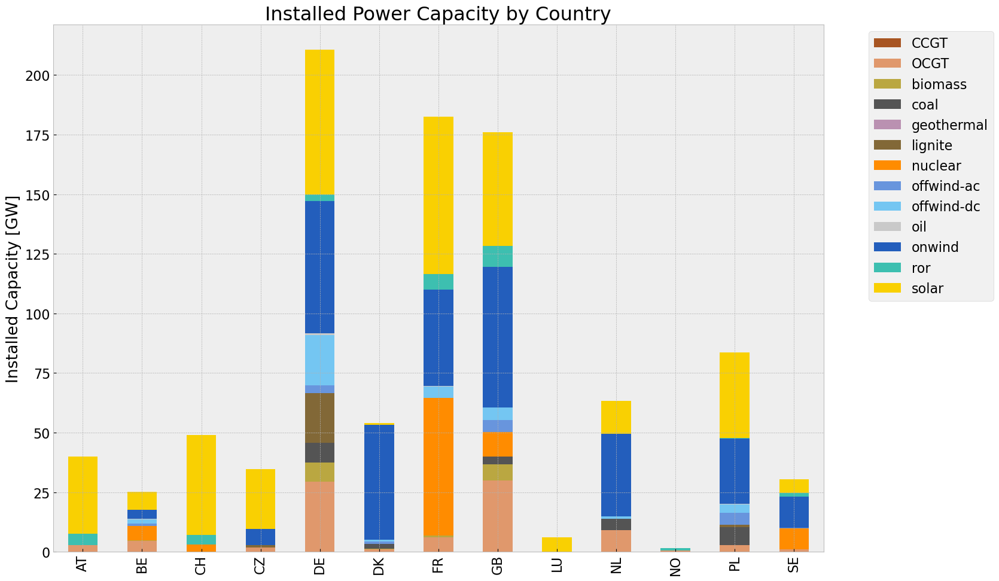

In [76]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

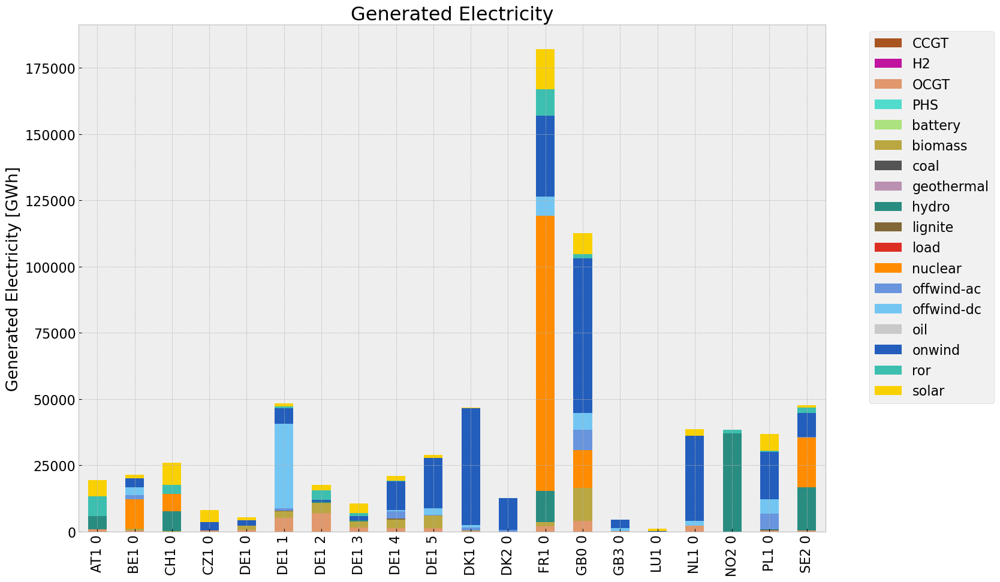

<Figure size 640x480 with 0 Axes>

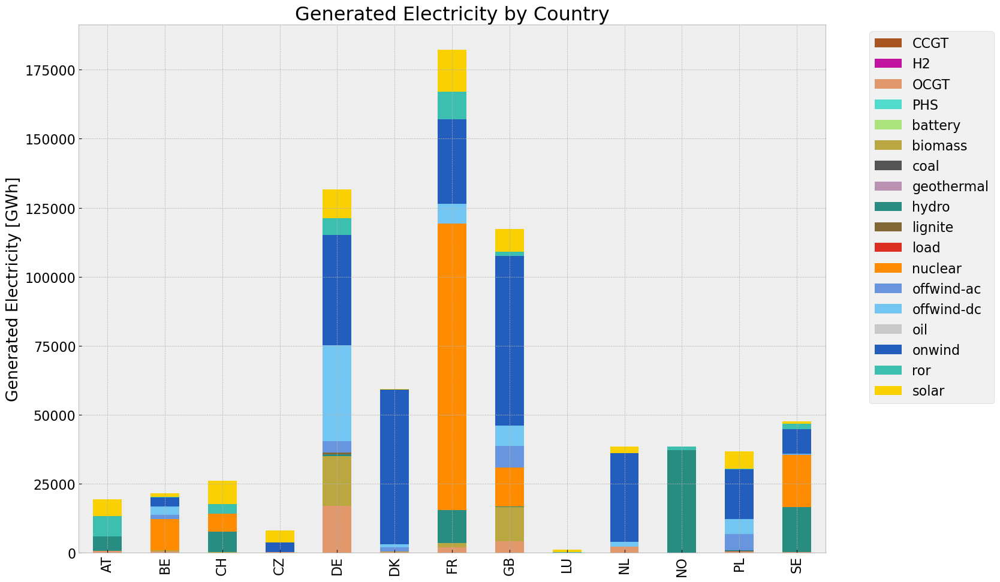

In [77]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

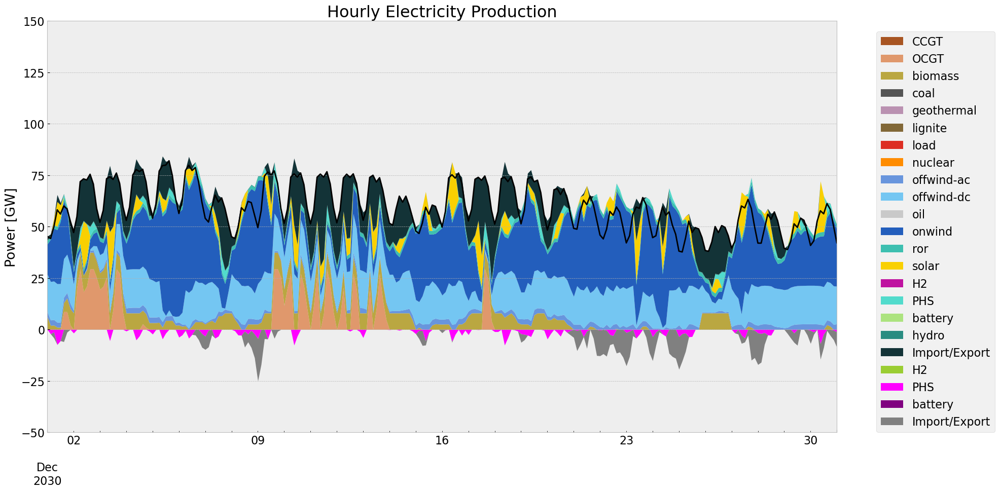

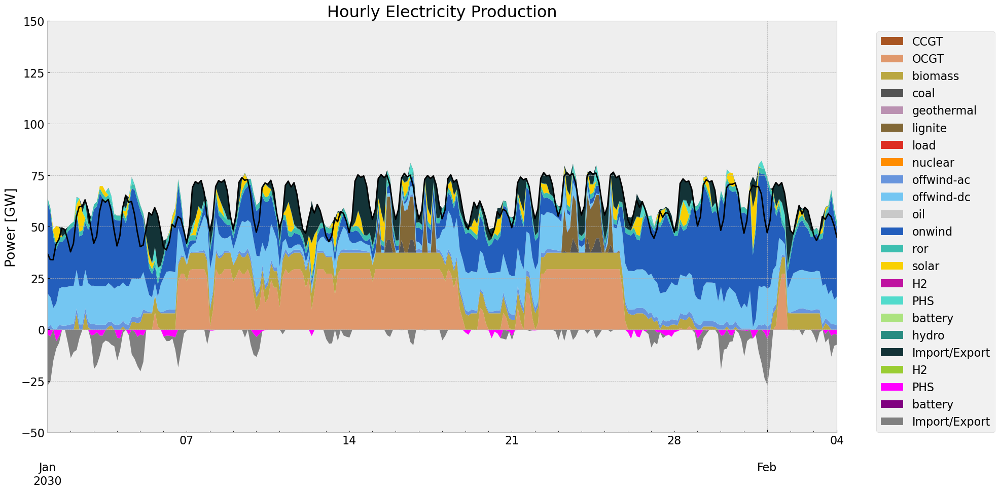

In [78]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-1', '2030-02-04', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

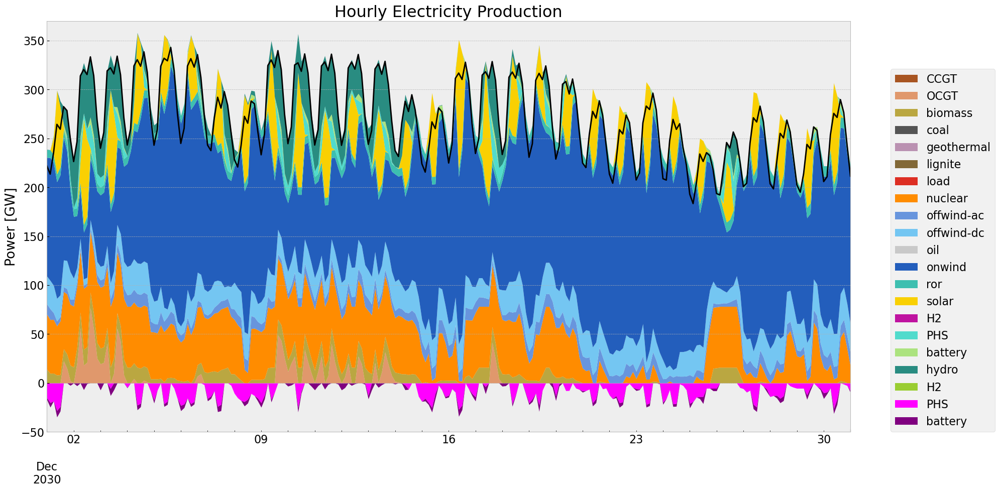

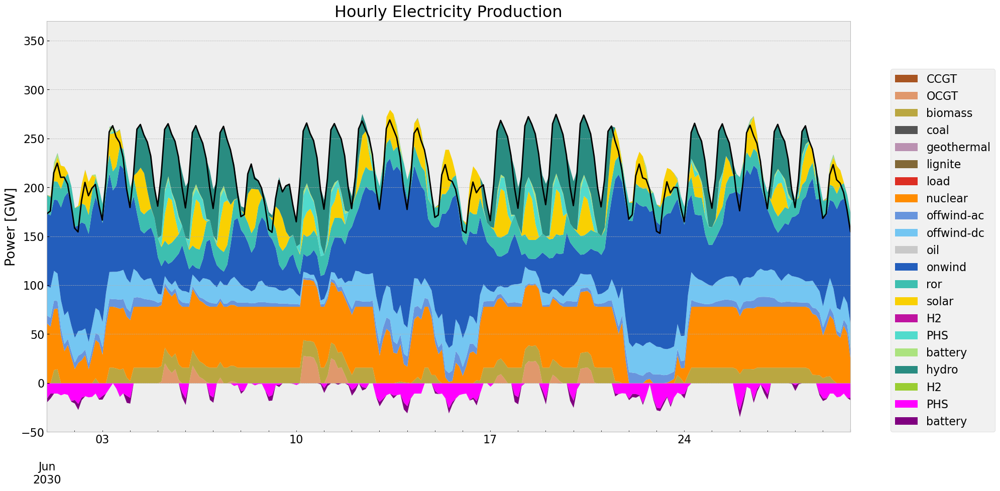

In [79]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

### Storage

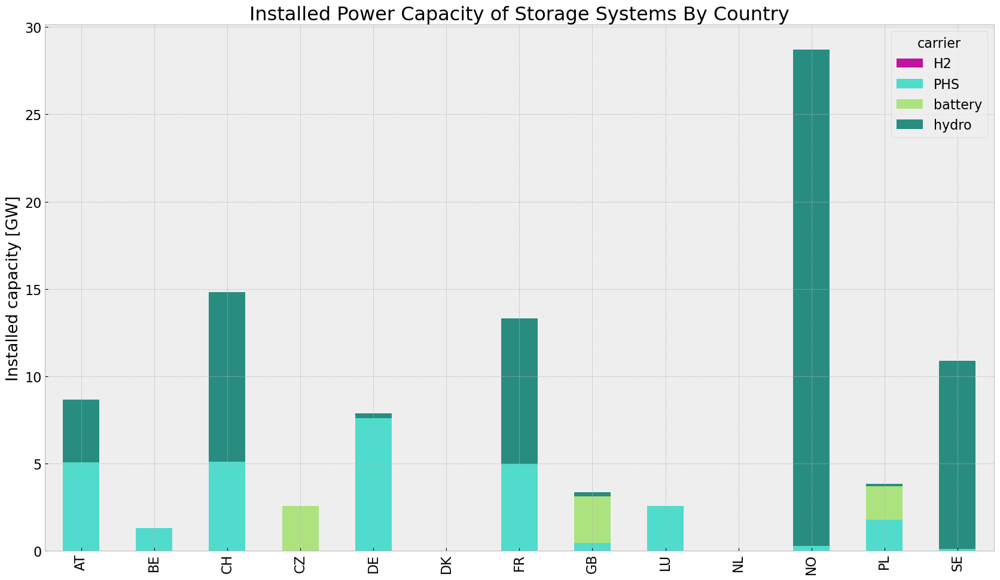

In [80]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')


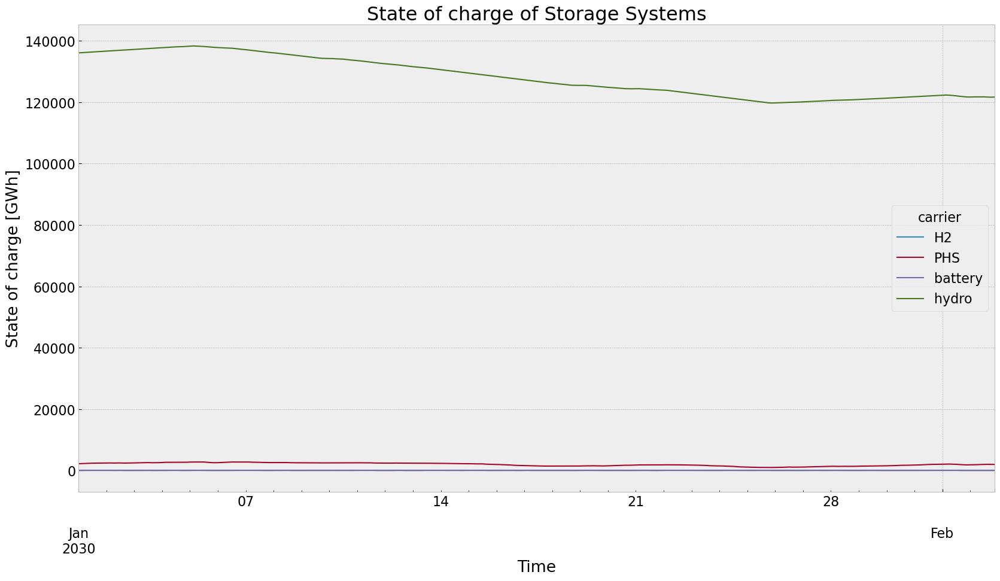

In [81]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


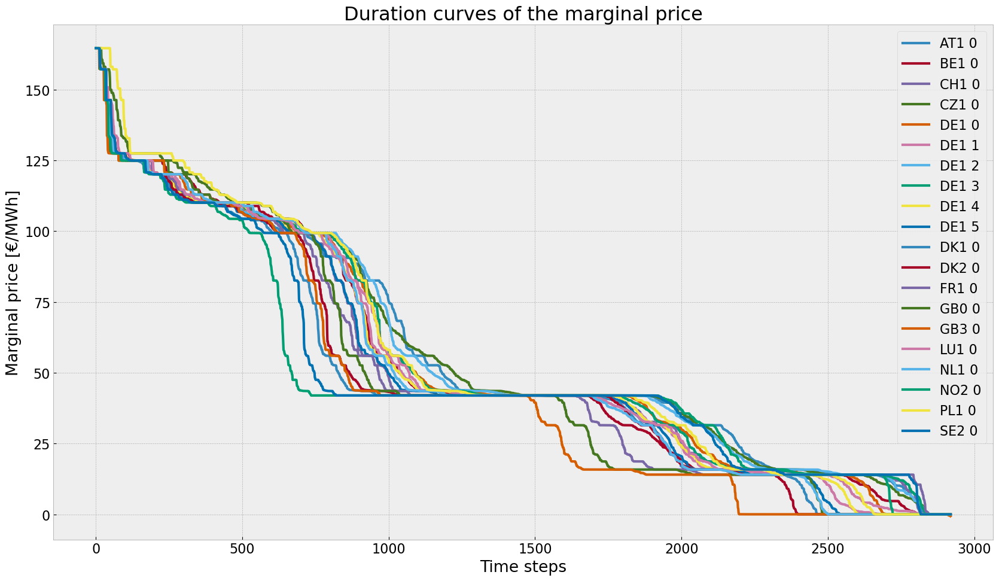

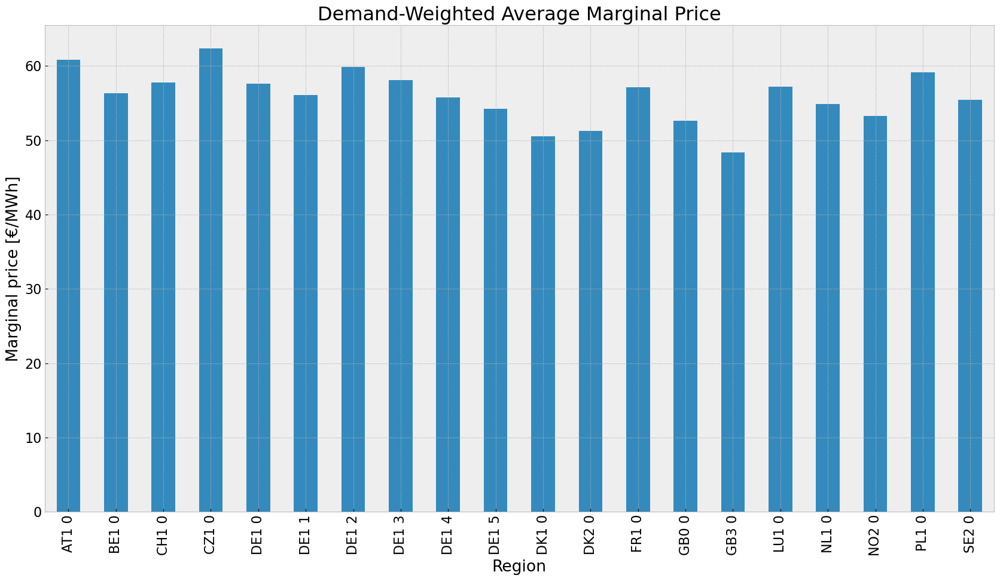

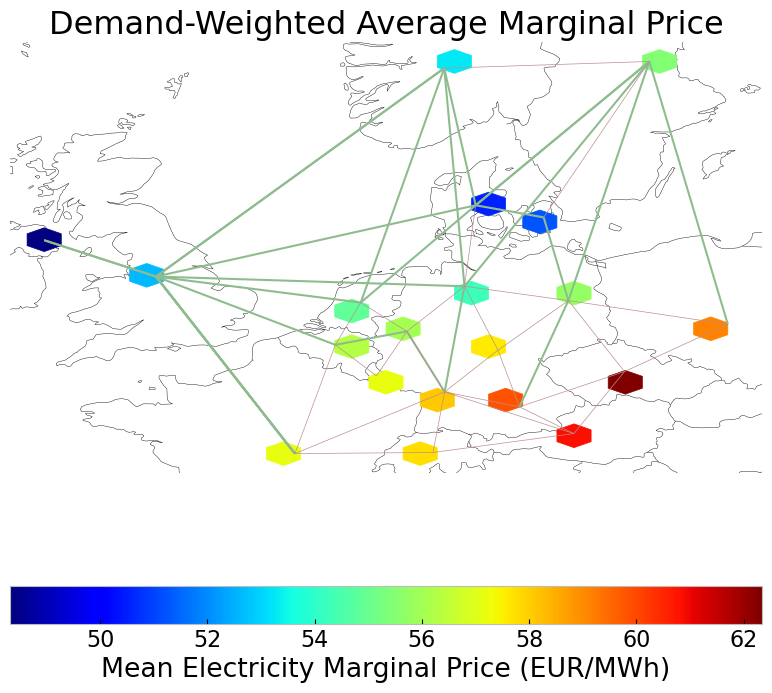

In [82]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [83]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.784434e+07,0.451621,0.1980,1.220754e+07
biomass,3.291765e+07,0.468000,0.0000,0.000000e+00
coal,2.203368e+05,0.329908,0.3361,2.244722e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.702127e+05,0.337285,0.4069,8.085439e+05
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.545418e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.126170e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [84]:
n2 = pvscenario(n, cut_start, duration, reductionto)

### No Investment

In [85]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [86]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.26it/s]
INFO:linopy.io: Writing time: 34.65s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-452oudmh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-452oudmh.lp


Reading time = 11.06 seconds


INFO:gurobipy:Reading time = 11.06 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0x79e6f265


INFO:gurobipy:Model fingerprint: 0x79e6f265


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3092336 rows and 792851 columns


INFO:gurobipy:Presolve removed 3092336 rows and 792851 columns


Presolve time: 3.56s


INFO:gurobipy:Presolve time: 3.56s


Presolved: 172224 rows, 728469 columns, 1201109 nonzeros


INFO:gurobipy:Presolved: 172224 rows, 728469 columns, 1201109 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 1.47s


INFO:gurobipy:Ordering time: 1.47s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.844e+05


INFO:gurobipy: AA' NZ     : 4.844e+05


 Factor NZ  : 6.149e+06 (roughly 400 MB of memory)


INFO:gurobipy: Factor NZ  : 6.149e+06 (roughly 400 MB of memory)


 Factor Ops : 4.487e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.487e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.27273571e+13 -1.88644936e+15  6.68e+05 9.55e+02  2.14e+09     6s


INFO:gurobipy:   0   3.27273571e+13 -1.88644936e+15  6.68e+05 9.55e+02  2.14e+09     6s


   1   9.85238524e+12 -5.40733868e+13  6.76e+04 1.18e-11  1.17e+08     6s


INFO:gurobipy:   1   9.85238524e+12 -5.40733868e+13  6.76e+04 1.18e-11  1.17e+08     6s


   2   1.66520663e+12 -1.40151734e+13  2.96e+03 1.09e-11  1.30e+07     7s


INFO:gurobipy:   2   1.66520663e+12 -1.40151734e+13  2.96e+03 1.09e-11  1.30e+07     7s


   3   4.15644585e+11 -3.56255628e+12  2.54e+02 4.37e-11  2.83e+06     7s


INFO:gurobipy:   3   4.15644585e+11 -3.56255628e+12  2.54e+02 4.37e-11  2.83e+06     7s


   4   1.76633917e+11 -1.65119404e+12  9.45e+01 1.82e-11  1.28e+06     8s


INFO:gurobipy:   4   1.76633917e+11 -1.65119404e+12  9.45e+01 1.82e-11  1.28e+06     8s


   5   1.25406015e+11 -6.14300579e+11  4.67e+01 1.27e-11  5.14e+05     8s


INFO:gurobipy:   5   1.25406015e+11 -6.14300579e+11  4.67e+01 1.27e-11  5.14e+05     8s


   6   9.21902236e+10 -2.17886052e+11  1.99e+01 9.09e-12  2.14e+05     8s


INFO:gurobipy:   6   9.21902236e+10 -2.17886052e+11  1.99e+01 9.09e-12  2.14e+05     8s


   7   7.30904386e+10 -6.05405833e+10  1.05e+01 7.28e-12  9.21e+04     9s


INFO:gurobipy:   7   7.30904386e+10 -6.05405833e+10  1.05e+01 7.28e-12  9.21e+04     9s


   8   5.94373744e+10 -9.27268496e+09  6.10e+00 7.28e-12  4.73e+04     9s


INFO:gurobipy:   8   5.94373744e+10 -9.27268496e+09  6.10e+00 7.28e-12  4.73e+04     9s


   9   5.12831264e+10  6.80404840e+09  3.80e+00 7.28e-12  3.06e+04     9s


INFO:gurobipy:   9   5.12831264e+10  6.80404840e+09  3.80e+00 7.28e-12  3.06e+04     9s


  10   4.18424042e+10  1.99141284e+10  1.40e+00 5.46e-12  1.51e+04    10s


INFO:gurobipy:  10   4.18424042e+10  1.99141284e+10  1.40e+00 5.46e-12  1.51e+04    10s


  11   3.94873456e+10  2.51415008e+10  9.18e-01 3.64e-12  9.85e+03    10s


INFO:gurobipy:  11   3.94873456e+10  2.51415008e+10  9.18e-01 3.64e-12  9.85e+03    10s


  12   3.78313210e+10  3.00805870e+10  6.03e-01 2.73e-12  5.32e+03    11s


INFO:gurobipy:  12   3.78313210e+10  3.00805870e+10  6.03e-01 2.73e-12  5.32e+03    11s


  13   3.58140820e+10  3.21033381e+10  2.34e-01 2.21e-12  2.55e+03    11s


INFO:gurobipy:  13   3.58140820e+10  3.21033381e+10  2.34e-01 2.21e-12  2.55e+03    11s


  14   3.53088586e+10  3.24288655e+10  1.49e-01 2.84e-12  1.98e+03    12s


INFO:gurobipy:  14   3.53088586e+10  3.24288655e+10  1.49e-01 2.84e-12  1.98e+03    12s


  15   3.50824924e+10  3.30833267e+10  1.12e-01 2.77e-12  1.37e+03    12s


INFO:gurobipy:  15   3.50824924e+10  3.30833267e+10  1.12e-01 2.77e-12  1.37e+03    12s


  16   3.49365520e+10  3.33933166e+10  8.81e-02 2.24e-12  1.06e+03    12s


INFO:gurobipy:  16   3.49365520e+10  3.33933166e+10  8.81e-02 2.24e-12  1.06e+03    12s


  17   3.48245285e+10  3.36128754e+10  7.06e-02 3.30e-12  8.32e+02    13s


INFO:gurobipy:  17   3.48245285e+10  3.36128754e+10  7.06e-02 3.30e-12  8.32e+02    13s


  18   3.47481203e+10  3.37958056e+10  5.88e-02 2.04e-12  6.54e+02    13s


INFO:gurobipy:  18   3.47481203e+10  3.37958056e+10  5.88e-02 2.04e-12  6.54e+02    13s


  19   3.45858417e+10  3.39487135e+10  3.40e-02 2.57e-12  4.37e+02    13s


INFO:gurobipy:  19   3.45858417e+10  3.39487135e+10  3.40e-02 2.57e-12  4.37e+02    13s


  20   3.45029419e+10  3.40661237e+10  2.11e-02 2.29e-12  3.00e+02    14s


INFO:gurobipy:  20   3.45029419e+10  3.40661237e+10  2.11e-02 2.29e-12  3.00e+02    14s


  21   3.44695662e+10  3.41394412e+10  1.61e-02 2.45e-12  2.27e+02    14s


INFO:gurobipy:  21   3.44695662e+10  3.41394412e+10  1.61e-02 2.45e-12  2.27e+02    14s


  22   3.44407145e+10  3.41920375e+10  1.20e-02 2.87e-12  1.71e+02    15s


INFO:gurobipy:  22   3.44407145e+10  3.41920375e+10  1.20e-02 2.87e-12  1.71e+02    15s


  23   3.44227469e+10  3.42191197e+10  9.33e-03 2.91e-12  1.40e+02    15s


INFO:gurobipy:  23   3.44227469e+10  3.42191197e+10  9.33e-03 2.91e-12  1.40e+02    15s


  24   3.44068537e+10  3.42454528e+10  7.02e-03 2.82e-12  1.11e+02    16s


INFO:gurobipy:  24   3.44068537e+10  3.42454528e+10  7.02e-03 2.82e-12  1.11e+02    16s


  25   3.43936506e+10  3.42592783e+10  5.10e-03 1.87e-09  9.22e+01    16s


INFO:gurobipy:  25   3.43936506e+10  3.42592783e+10  5.10e-03 1.87e-09  9.22e+01    16s


  26   3.43849607e+10  3.42905153e+10  3.80e-03 8.32e-09  6.48e+01    17s


INFO:gurobipy:  26   3.43849607e+10  3.42905153e+10  3.80e-03 8.32e-09  6.48e+01    17s


  27   3.43821164e+10  3.42999382e+10  3.40e-03 7.22e-09  5.64e+01    17s


INFO:gurobipy:  27   3.43821164e+10  3.42999382e+10  3.40e-03 7.22e-09  5.64e+01    17s


  28   3.43713420e+10  3.43156494e+10  1.86e-03 1.37e-08  3.82e+01    18s


INFO:gurobipy:  28   3.43713420e+10  3.43156494e+10  1.86e-03 1.37e-08  3.82e+01    18s


  29   3.43663566e+10  3.43258724e+10  1.16e-03 1.51e-08  2.78e+01    18s


INFO:gurobipy:  29   3.43663566e+10  3.43258724e+10  1.16e-03 1.51e-08  2.78e+01    18s


  30   3.43643128e+10  3.43319693e+10  8.70e-04 1.84e-08  2.22e+01    19s


INFO:gurobipy:  30   3.43643128e+10  3.43319693e+10  8.70e-04 1.84e-08  2.22e+01    19s


  31   3.43619017e+10  3.43405320e+10  5.21e-04 1.39e-08  1.47e+01    19s


INFO:gurobipy:  31   3.43619017e+10  3.43405320e+10  5.21e-04 1.39e-08  1.47e+01    19s


  32   3.43599920e+10  3.43500354e+10  2.53e-04 8.25e-09  6.83e+00    20s


INFO:gurobipy:  32   3.43599920e+10  3.43500354e+10  2.53e-04 8.25e-09  6.83e+00    20s


  33   3.43589376e+10  3.43536889e+10  1.12e-04 5.89e-09  3.60e+00    20s


INFO:gurobipy:  33   3.43589376e+10  3.43536889e+10  1.12e-04 5.89e-09  3.60e+00    20s


  34   3.43586751e+10  3.43548501e+10  8.22e-05 4.92e-09  2.63e+00    21s


INFO:gurobipy:  34   3.43586751e+10  3.43548501e+10  8.22e-05 4.92e-09  2.63e+00    21s


  35   3.43585368e+10  3.43558692e+10  6.52e-05 4.06e-09  1.83e+00    21s


INFO:gurobipy:  35   3.43585368e+10  3.43558692e+10  6.52e-05 4.06e-09  1.83e+00    21s


  36   3.43582933e+10  3.43563051e+10  3.81e-05 3.82e-09  1.36e+00    21s


INFO:gurobipy:  36   3.43582933e+10  3.43563051e+10  3.81e-05 3.82e-09  1.36e+00    21s


  37   3.43581162e+10  3.43570594e+10  1.69e-05 3.49e-09  7.25e-01    22s


INFO:gurobipy:  37   3.43581162e+10  3.43570594e+10  1.69e-05 3.49e-09  7.25e-01    22s


  38   3.43580444e+10  3.43575721e+10  8.38e-06 4.36e-09  3.24e-01    22s


INFO:gurobipy:  38   3.43580444e+10  3.43575721e+10  8.38e-06 4.36e-09  3.24e-01    22s


  39   3.43580004e+10  3.43577035e+10  4.61e-06 4.04e-09  2.04e-01    22s


INFO:gurobipy:  39   3.43580004e+10  3.43577035e+10  4.61e-06 4.04e-09  2.04e-01    22s


  40   3.43579694e+10  3.43578001e+10  1.98e-06 3.14e-09  1.16e-01    23s


INFO:gurobipy:  40   3.43579694e+10  3.43578001e+10  1.98e-06 3.14e-09  1.16e-01    23s


  41   3.43579555e+10  3.43578750e+10  9.58e-07 1.83e-09  5.53e-02    23s


INFO:gurobipy:  41   3.43579555e+10  3.43578750e+10  9.58e-07 1.83e-09  5.53e-02    23s


  42   3.43579480e+10  3.43579113e+10  4.46e-07 8.55e-10  2.52e-02    23s


INFO:gurobipy:  42   3.43579480e+10  3.43579113e+10  4.46e-07 8.55e-10  2.52e-02    23s


  43   3.43579446e+10  3.43579276e+10  2.34e-07 4.43e-10  1.17e-02    24s


INFO:gurobipy:  43   3.43579446e+10  3.43579276e+10  2.34e-07 4.43e-10  1.17e-02    24s


  44   3.43579427e+10  3.43579345e+10  1.24e-07 2.49e-10  5.65e-03    24s


INFO:gurobipy:  44   3.43579427e+10  3.43579345e+10  1.24e-07 2.49e-10  5.65e-03    24s


  45   3.43579415e+10  3.43579380e+10  6.26e-08 1.18e-10  2.38e-03    25s


INFO:gurobipy:  45   3.43579415e+10  3.43579380e+10  6.26e-08 1.18e-10  2.38e-03    25s


  46   3.43579408e+10  3.43579397e+10  9.70e-08 6.61e-11  7.46e-04    25s


INFO:gurobipy:  46   3.43579408e+10  3.43579397e+10  9.70e-08 6.61e-11  7.46e-04    25s


  47   3.43579406e+10  3.43579402e+10  2.60e-08 2.81e-11  2.27e-04    26s


INFO:gurobipy:  47   3.43579406e+10  3.43579402e+10  2.60e-08 2.81e-11  2.27e-04    26s


  48   3.43579405e+10  3.43579404e+10  1.07e-08 9.20e-12  7.66e-05    26s


INFO:gurobipy:  48   3.43579405e+10  3.43579404e+10  1.07e-08 9.20e-12  7.66e-05    26s


  49   3.43579405e+10  3.43579404e+10  2.63e-07 2.47e-10  1.81e-05    27s


INFO:gurobipy:  49   3.43579405e+10  3.43579404e+10  2.63e-07 2.47e-10  1.81e-05    27s


  50   3.43579405e+10  3.43579405e+10  1.41e-07 1.43e-10  1.03e-05    27s


INFO:gurobipy:  50   3.43579405e+10  3.43579405e+10  1.41e-07 1.43e-10  1.03e-05    27s


INFO:gurobipy:


Barrier solved model in 50 iterations and 27.31 seconds (13.01 work units)


INFO:gurobipy:Barrier solved model in 50 iterations and 27.31 seconds (13.01 work units)


Optimal objective 3.43579405e+10


INFO:gurobipy:Optimal objective 3.43579405e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   17023 DPushes remaining with DInf 0.0000000e+00                28s


INFO:gurobipy:   17023 DPushes remaining with DInf 0.0000000e+00                28s


       0 DPushes remaining with DInf 0.0000000e+00                29s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                29s


INFO:gurobipy:


  113474 PPushes remaining with PInf 8.1342411e-05                29s


INFO:gurobipy:  113474 PPushes remaining with PInf 8.1342411e-05                29s


   14924 PPushes remaining with PInf 7.2154053e-04                34s


INFO:gurobipy:   14924 PPushes remaining with PInf 7.2154053e-04                34s


    6504 PPushes remaining with PInf 3.9295004e-05                35s


INFO:gurobipy:    6504 PPushes remaining with PInf 3.9295004e-05                35s


       0 PPushes remaining with PInf 0.0000000e+00                37s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                37s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.9038342e-01     37s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.9038342e-01     37s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  130500    3.4357940e+10   0.000000e+00   8.903834e-01     37s


INFO:gurobipy:  130500    3.4357940e+10   0.000000e+00   8.903834e-01     37s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  130512    3.4357940e+10   0.000000e+00   0.000000e+00     39s


INFO:gurobipy:  130512    3.4357940e+10   0.000000e+00   0.000000e+00     39s


INFO:gurobipy:


Solved in 130512 iterations and 39.50 seconds (17.23 work units)


INFO:gurobipy:Solved in 130512 iterations and 39.50 seconds (17.23 work units)


Optimal objective  3.435794046e+10


INFO:gurobipy:Optimal objective  3.435794046e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 3.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Base Rolling Horizon

In [87]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 24
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3bhsx2cx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3bhsx2cx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x79df22cb


INFO:gurobipy:Model fingerprint: 0x79df22cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25416 rows and 6642 columns


INFO:gurobipy:Presolve removed 25416 rows and 6642 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5862 columns, 9750 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5862 columns, 9750 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.26274927e+11 -1.56297421e+13  1.40e+05 9.18e+03  2.08e+09     0s


INFO:gurobipy:   0   3.26274927e+11 -1.56297421e+13  1.40e+05 9.18e+03  2.08e+09     0s


   1   7.58508628e+10 -4.03558282e+11  1.04e+04 7.28e-11  8.68e+07     0s


INFO:gurobipy:   1   7.58508628e+10 -4.03558282e+11  1.04e+04 7.28e-11  8.68e+07     0s


   2   9.41417315e+09 -7.51285333e+10  4.45e+02 7.28e-11  8.53e+06     0s


INFO:gurobipy:   2   9.41417315e+09 -7.51285333e+10  4.45e+02 7.28e-11  8.53e+06     0s


   3   1.50523302e+09 -8.74067827e+09  2.98e+01 2.33e-10  9.06e+05     0s


INFO:gurobipy:   3   1.50523302e+09 -8.74067827e+09  2.98e+01 2.33e-10  9.06e+05     0s


   4   5.58000270e+08 -1.22923117e+09  5.50e+00 1.46e-10  1.54e+05     0s


INFO:gurobipy:   4   5.58000270e+08 -1.22923117e+09  5.50e+00 1.46e-10  1.54e+05     0s


   5   3.73709749e+08 -5.44222874e+08  2.76e+00 7.28e-11  7.88e+04     0s


INFO:gurobipy:   5   3.73709749e+08 -5.44222874e+08  2.76e+00 7.28e-11  7.88e+04     0s


   6   2.72884544e+08 -1.66105704e+08  1.49e+00 2.91e-11  3.76e+04     0s


INFO:gurobipy:   6   2.72884544e+08 -1.66105704e+08  1.49e+00 2.91e-11  3.76e+04     0s


   7   2.06013130e+08  4.21688206e+06  6.54e-01 1.46e-11  1.73e+04     0s


INFO:gurobipy:   7   2.06013130e+08  4.21688206e+06  6.54e-01 1.46e-11  1.73e+04     0s


   8   1.59213483e+08  1.12871099e+08  8.93e-02 4.37e-11  3.96e+03     0s


INFO:gurobipy:   8   1.59213483e+08  1.12871099e+08  8.93e-02 4.37e-11  3.96e+03     0s


   9   1.47585908e+08  1.30061411e+08  2.67e-02 2.16e-11  1.50e+03     0s


INFO:gurobipy:   9   1.47585908e+08  1.30061411e+08  2.67e-02 2.16e-11  1.50e+03     0s


  10   1.43715945e+08  1.35940162e+08  1.11e-02 3.12e-11  6.64e+02     0s


INFO:gurobipy:  10   1.43715945e+08  1.35940162e+08  1.11e-02 3.12e-11  6.64e+02     0s


  11   1.42223900e+08  1.38711527e+08  5.68e-03 2.53e-11  3.00e+02     0s


INFO:gurobipy:  11   1.42223900e+08  1.38711527e+08  5.68e-03 2.53e-11  3.00e+02     0s


  12   1.41177518e+08  1.39819556e+08  2.06e-03 3.20e-11  1.16e+02     0s


INFO:gurobipy:  12   1.41177518e+08  1.39819556e+08  2.06e-03 3.20e-11  1.16e+02     0s


  13   1.40753740e+08  1.40285748e+08  6.79e-04 2.49e-11  4.00e+01     0s


INFO:gurobipy:  13   1.40753740e+08  1.40285748e+08  6.79e-04 2.49e-11  4.00e+01     0s


  14   1.40676244e+08  1.40423829e+08  4.48e-04 2.91e-11  2.16e+01     0s


INFO:gurobipy:  14   1.40676244e+08  1.40423829e+08  4.48e-04 2.91e-11  2.16e+01     0s


  15   1.40613607e+08  1.40467716e+08  2.60e-04 1.60e-11  1.25e+01     0s


INFO:gurobipy:  15   1.40613607e+08  1.40467716e+08  2.60e-04 1.60e-11  1.25e+01     0s


  16   1.40555333e+08  1.40499869e+08  8.88e-05 1.91e-11  4.74e+00     0s


INFO:gurobipy:  16   1.40555333e+08  1.40499869e+08  8.88e-05 1.91e-11  4.74e+00     0s


  17   1.40531477e+08  1.40514144e+08  3.95e-05 2.42e-11  1.48e+00     0s


INFO:gurobipy:  17   1.40531477e+08  1.40514144e+08  3.95e-05 2.42e-11  1.48e+00     0s


  18   1.40524972e+08  1.40521205e+08  6.39e-06 2.91e-11  3.22e-01     0s


INFO:gurobipy:  18   1.40524972e+08  1.40521205e+08  6.39e-06 2.91e-11  3.22e-01     0s


  19   1.40523671e+08  1.40523225e+08  6.21e-07 2.91e-11  3.80e-02     0s


INFO:gurobipy:  19   1.40523671e+08  1.40523225e+08  6.21e-07 2.91e-11  3.80e-02     0s


  20   1.40523581e+08  1.40523468e+08  1.99e-07 2.94e-11  9.68e-03     0s


INFO:gurobipy:  20   1.40523581e+08  1.40523468e+08  1.99e-07 2.94e-11  9.68e-03     0s


  21   1.40523546e+08  1.40523507e+08  4.76e-08 2.91e-11  3.34e-03     0s


INFO:gurobipy:  21   1.40523546e+08  1.40523507e+08  4.76e-08 2.91e-11  3.34e-03     0s


  22   1.40523534e+08  1.40523525e+08  5.20e-09 2.91e-11  7.81e-04     0s


INFO:gurobipy:  22   1.40523534e+08  1.40523525e+08  5.20e-09 2.91e-11  7.81e-04     0s


  23   1.40523533e+08  1.40523532e+08  3.37e-08 2.91e-11  6.60e-05     0s


INFO:gurobipy:  23   1.40523533e+08  1.40523532e+08  3.37e-08 2.91e-11  6.60e-05     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.26 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1992    1.4052353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1992    1.4052353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1992 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1992 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.405235326e+08


INFO:gurobipy:Optimal objective  1.405235326e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxn5sejb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxn5sejb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe5120fda


INFO:gurobipy:Model fingerprint: 0xe5120fda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6562 columns


INFO:gurobipy:Presolve removed 25417 rows and 6562 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5942 columns, 9822 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5942 columns, 9822 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.977e+03


INFO:gurobipy: AA' NZ     : 3.977e+03


 Factor NZ  : 4.853e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.853e+04 (roughly 3 MB of memory)


 Factor Ops : 3.540e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.540e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.60040533e+11 -1.56151829e+13  1.39e+05 8.84e+03  2.06e+09     0s


INFO:gurobipy:   0   3.60040533e+11 -1.56151829e+13  1.39e+05 8.84e+03  2.06e+09     0s


   1   9.01216099e+10 -3.95963415e+11  1.30e+04 7.28e-11  9.81e+07     0s


INFO:gurobipy:   1   9.01216099e+10 -3.95963415e+11  1.30e+04 7.28e-11  9.81e+07     0s


   2   1.12522475e+10 -8.20832161e+10  5.37e+02 6.55e-11  9.53e+06     0s


INFO:gurobipy:   2   1.12522475e+10 -8.20832161e+10  5.37e+02 6.55e-11  9.53e+06     0s


   3   2.06689885e+09 -9.79157379e+09  4.02e+01 6.69e-10  1.05e+06     0s


INFO:gurobipy:   3   2.06689885e+09 -9.79157379e+09  4.02e+01 6.69e-10  1.05e+06     0s


   4   9.70513823e+08 -1.71956043e+09  6.84e+00 2.47e-10  2.30e+05     0s


INFO:gurobipy:   4   9.70513823e+08 -1.71956043e+09  6.84e+00 2.47e-10  2.30e+05     0s


   5   6.97584706e+08 -4.67040377e+08  2.70e+00 1.31e-10  9.89e+04     0s


INFO:gurobipy:   5   6.97584706e+08 -4.67040377e+08  2.70e+00 1.31e-10  9.89e+04     0s


   6   5.50693184e+08  4.86553622e+07  1.14e+00 7.28e-11  4.25e+04     0s


INFO:gurobipy:   6   5.50693184e+08  4.86553622e+07  1.14e+00 7.28e-11  4.25e+04     0s


   7   4.51547689e+08  2.73106966e+08  4.02e-01 4.37e-11  1.51e+04     0s


INFO:gurobipy:   7   4.51547689e+08  2.73106966e+08  4.02e-01 4.37e-11  1.51e+04     0s


   8   3.93839282e+08  3.42604655e+08  9.56e-02 4.37e-11  4.33e+03     0s


INFO:gurobipy:   8   3.93839282e+08  3.42604655e+08  9.56e-02 4.37e-11  4.33e+03     0s


   9   3.82595571e+08  3.60620762e+08  5.15e-02 3.64e-11  1.86e+03     0s


INFO:gurobipy:   9   3.82595571e+08  3.60620762e+08  5.15e-02 3.64e-11  1.86e+03     0s


  10   3.75451179e+08  3.65067790e+08  2.44e-02 3.14e-11  8.78e+02     0s


INFO:gurobipy:  10   3.75451179e+08  3.65067790e+08  2.44e-02 3.14e-11  8.78e+02     0s


  11   3.72517676e+08  3.67150573e+08  1.33e-02 2.91e-11  4.54e+02     0s


INFO:gurobipy:  11   3.72517676e+08  3.67150573e+08  1.33e-02 2.91e-11  4.54e+02     0s


  12   3.70457603e+08  3.68330873e+08  5.83e-03 2.91e-11  1.80e+02     0s


INFO:gurobipy:  12   3.70457603e+08  3.68330873e+08  5.83e-03 2.91e-11  1.80e+02     0s


  13   3.69144624e+08  3.68663357e+08  1.01e-03 2.91e-11  4.07e+01     0s


INFO:gurobipy:  13   3.69144624e+08  3.68663357e+08  1.01e-03 2.91e-11  4.07e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1983    3.6882283e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1983    3.6882283e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1983 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1983 iterations and 0.25 seconds (0.07 work units)


Optimal objective  3.688228301e+08


INFO:gurobipy:Optimal objective  3.688228301e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz4vmx_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz4vmx_v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x7f4fccfc


INFO:gurobipy:Model fingerprint: 0x7f4fccfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6631 columns


INFO:gurobipy:Presolve removed 25416 rows and 6631 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5873 columns, 9761 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5873 columns, 9761 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.13565738e+11 -1.39485513e+13  1.46e+05 1.31e+04  1.88e+09     0s


INFO:gurobipy:   0   4.13565738e+11 -1.39485513e+13  1.46e+05 1.31e+04  1.88e+09     0s


   1   1.02228849e+11 -3.51069619e+11  1.46e+04 5.82e-11  9.52e+07     0s


INFO:gurobipy:   1   1.02228849e+11 -3.51069619e+11  1.46e+04 5.82e-11  9.52e+07     0s


   2   1.75422601e+10 -7.18554032e+10  9.21e+02 6.55e-11  1.02e+07     0s


INFO:gurobipy:   2   1.75422601e+10 -7.18554032e+10  9.21e+02 6.55e-11  1.02e+07     0s


   3   5.25545102e+09 -1.05901491e+10  7.46e+01 1.21e-09  1.46e+06     0s


INFO:gurobipy:   3   5.25545102e+09 -1.05901491e+10  7.46e+01 1.21e-09  1.46e+06     0s


   4   2.86886627e+09 -1.78631868e+09  2.46e+01 3.78e-10  4.17e+05     0s


INFO:gurobipy:   4   2.86886627e+09 -1.78631868e+09  2.46e+01 3.78e-10  4.17e+05     0s


   5   2.39688905e+09  6.18418891e+08  1.26e+01 1.02e-10  1.57e+05     0s


INFO:gurobipy:   5   2.39688905e+09  6.18418891e+08  1.26e+01 1.02e-10  1.57e+05     0s


   6   2.12556316e+09  1.45617338e+09  4.82e+00 8.73e-11  5.85e+04     0s


INFO:gurobipy:   6   2.12556316e+09  1.45617338e+09  4.82e+00 8.73e-11  5.85e+04     0s


   7   1.96211923e+09  1.69999243e+09  9.13e-01 5.82e-11  2.25e+04     0s


INFO:gurobipy:   7   1.96211923e+09  1.69999243e+09  9.13e-01 5.82e-11  2.25e+04     0s


   8   1.90858357e+09  1.83913165e+09  2.33e-01 5.82e-11  5.96e+03     0s


INFO:gurobipy:   8   1.90858357e+09  1.83913165e+09  2.33e-01 5.82e-11  5.96e+03     0s


   9   1.88957358e+09  1.85994093e+09  8.54e-02 5.82e-11  2.54e+03     0s


INFO:gurobipy:   9   1.88957358e+09  1.85994093e+09  8.54e-02 5.82e-11  2.54e+03     0s


  10   1.88655611e+09  1.86678078e+09  6.46e-02 4.37e-11  1.70e+03     0s


INFO:gurobipy:  10   1.88655611e+09  1.86678078e+09  6.46e-02 4.37e-11  1.70e+03     0s


  11   1.88119177e+09  1.87117580e+09  2.88e-02 2.91e-11  8.58e+02     0s


INFO:gurobipy:  11   1.88119177e+09  1.87117580e+09  2.88e-02 2.91e-11  8.58e+02     0s


  12   1.87930327e+09  1.87444965e+09  1.62e-02 2.91e-11  4.16e+02     0s


INFO:gurobipy:  12   1.87930327e+09  1.87444965e+09  1.62e-02 2.91e-11  4.16e+02     0s


  13   1.87769379e+09  1.87599740e+09  5.79e-03 3.37e-11  1.45e+02     0s


INFO:gurobipy:  13   1.87769379e+09  1.87599740e+09  5.79e-03 3.37e-11  1.45e+02     0s


  14   1.87703483e+09  1.87639467e+09  1.87e-03 2.91e-11  5.48e+01     0s


INFO:gurobipy:  14   1.87703483e+09  1.87639467e+09  1.87e-03 2.91e-11  5.48e+01     0s


  15   1.87688391e+09  1.87656374e+09  9.98e-04 2.91e-11  2.74e+01     0s


INFO:gurobipy:  15   1.87688391e+09  1.87656374e+09  9.98e-04 2.91e-11  2.74e+01     0s


  16   1.87674874e+09  1.87667146e+09  2.43e-04 2.91e-11  6.62e+00     0s


INFO:gurobipy:  16   1.87674874e+09  1.87667146e+09  2.43e-04 2.91e-11  6.62e+00     0s


  17   1.87672130e+09  1.87669589e+09  9.53e-05 2.91e-11  2.18e+00     0s


INFO:gurobipy:  17   1.87672130e+09  1.87669589e+09  9.53e-05 2.91e-11  2.18e+00     0s


  18   1.87670560e+09  1.87670194e+09  1.14e-05 3.88e-11  3.13e-01     0s


INFO:gurobipy:  18   1.87670560e+09  1.87670194e+09  1.14e-05 3.88e-11  3.13e-01     0s


  19   1.87670320e+09  1.87670298e+09  4.94e-06 2.91e-11  1.81e-02     0s


INFO:gurobipy:  19   1.87670320e+09  1.87670298e+09  4.94e-06 2.91e-11  1.81e-02     0s


  20   1.87670318e+09  1.87670316e+09  2.58e-07 4.14e-11  1.66e-03     0s


INFO:gurobipy:  20   1.87670318e+09  1.87670316e+09  2.58e-07 4.14e-11  1.66e-03     0s


  21   1.87670318e+09  1.87670318e+09  2.23e-07 3.13e-11  2.54e-05     0s


INFO:gurobipy:  21   1.87670318e+09  1.87670318e+09  2.23e-07 3.13e-11  2.54e-05     0s


  22   1.87670318e+09  1.87670318e+09  9.86e-09 3.34e-11  2.62e-07     0s


INFO:gurobipy:  22   1.87670318e+09  1.87670318e+09  9.86e-09 3.34e-11  2.62e-07     0s


  23   1.87670318e+09  1.87670318e+09  5.50e-10 2.91e-11  2.62e-10     0s


INFO:gurobipy:  23   1.87670318e+09  1.87670318e+09  5.50e-10 2.91e-11  2.62e-10     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.27 seconds (0.06 work units)


Optimal objective 1.87670318e+09


INFO:gurobipy:Optimal objective 1.87670318e+09


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    1.8767032e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    1.8767032e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.876703177e+09


INFO:gurobipy:Optimal objective  1.876703177e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqroheqc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqroheqc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x480f2b8d


INFO:gurobipy:Model fingerprint: 0x480f2b8d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6564 columns


INFO:gurobipy:Presolve removed 25416 rows and 6564 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5940 columns, 9828 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5940 columns, 9828 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.04405879e+11 -1.54211025e+13  1.43e+05 1.34e+04  2.05e+09     0s


INFO:gurobipy:   0   4.04405879e+11 -1.54211025e+13  1.43e+05 1.34e+04  2.05e+09     0s


   1   1.03216403e+11 -3.94503929e+11  1.41e+04 7.28e-11  1.03e+08     0s


INFO:gurobipy:   1   1.03216403e+11 -3.94503929e+11  1.41e+04 7.28e-11  1.03e+08     0s


   2   1.59116317e+10 -7.99646321e+10  6.26e+02 6.55e-11  1.00e+07     0s


INFO:gurobipy:   2   1.59116317e+10 -7.99646321e+10  6.26e+02 6.55e-11  1.00e+07     0s


   3   4.31717793e+09 -1.37406342e+10  4.19e+01 9.75e-10  1.58e+06     0s


INFO:gurobipy:   3   4.31717793e+09 -1.37406342e+10  4.19e+01 9.75e-10  1.58e+06     0s


   4   2.75322629e+09 -3.04117987e+09  1.27e+01 2.33e-10  4.98e+05     0s


INFO:gurobipy:   4   2.75322629e+09 -3.04117987e+09  1.27e+01 2.33e-10  4.98e+05     0s


   5   2.13692497e+09  4.71458663e+08  2.66e+00 1.46e-10  1.41e+05     0s


INFO:gurobipy:   5   2.13692497e+09  4.71458663e+08  2.66e+00 1.46e-10  1.41e+05     0s


   6   1.98637733e+09  1.36498026e+09  1.12e+00 5.82e-11  5.26e+04     0s


INFO:gurobipy:   6   1.98637733e+09  1.36498026e+09  1.12e+00 5.82e-11  5.26e+04     0s


   7   1.84658835e+09  1.62533508e+09  1.68e-01 2.91e-11  1.87e+04     0s


INFO:gurobipy:   7   1.84658835e+09  1.62533508e+09  1.68e-01 2.91e-11  1.87e+04     0s


   8   1.79275984e+09  1.74020007e+09  9.91e-03 3.06e-11  4.43e+03     0s


INFO:gurobipy:   8   1.79275984e+09  1.74020007e+09  9.91e-03 3.06e-11  4.43e+03     0s


   9   1.78264139e+09  1.76448869e+09  2.20e-03 3.78e-11  1.53e+03     0s


INFO:gurobipy:   9   1.78264139e+09  1.76448869e+09  2.20e-03 3.78e-11  1.53e+03     0s


  10   1.78030711e+09  1.77353508e+09  8.97e-04 2.91e-11  5.70e+02     0s


INFO:gurobipy:  10   1.78030711e+09  1.77353508e+09  8.97e-04 2.91e-11  5.70e+02     0s


  11   1.77932029e+09  1.77650781e+09  3.95e-04 2.91e-11  2.37e+02     0s


INFO:gurobipy:  11   1.77932029e+09  1.77650781e+09  3.95e-04 2.91e-11  2.37e+02     0s


  12   1.77868419e+09  1.77794386e+09  9.89e-05 2.91e-11  6.23e+01     0s


INFO:gurobipy:  12   1.77868419e+09  1.77794386e+09  9.89e-05 2.91e-11  6.23e+01     0s


  13   1.77849585e+09  1.77836691e+09  2.22e-05 2.91e-11  1.09e+01     0s


INFO:gurobipy:  13   1.77849585e+09  1.77836691e+09  2.22e-05 2.91e-11  1.09e+01     0s


  14   1.77844394e+09  1.77841296e+09  4.37e-06 3.11e-11  2.61e+00     0s


INFO:gurobipy:  14   1.77844394e+09  1.77841296e+09  4.37e-06 3.11e-11  2.61e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1722    1.7784347e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1722    1.7784347e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1722 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1722 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.778434734e+09


INFO:gurobipy:Optimal objective  1.778434734e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dn3euw0b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dn3euw0b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xc15b31b9


INFO:gurobipy:Model fingerprint: 0xc15b31b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6610 columns


INFO:gurobipy:Presolve removed 25416 rows and 6610 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 5894 columns, 9782 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5894 columns, 9782 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.18321468e+11 -1.55977308e+13  1.46e+05 1.16e+04  2.10e+09     0s


INFO:gurobipy:   0   4.18321468e+11 -1.55977308e+13  1.46e+05 1.16e+04  2.10e+09     0s


   1   1.08257251e+11 -4.19689937e+11  1.46e+04 7.28e-11  1.09e+08     0s


INFO:gurobipy:   1   1.08257251e+11 -4.19689937e+11  1.46e+04 7.28e-11  1.09e+08     0s


   2   1.83819360e+10 -8.31495801e+10  6.82e+02 5.82e-11  1.08e+07     0s


INFO:gurobipy:   2   1.83819360e+10 -8.31495801e+10  6.82e+02 5.82e-11  1.08e+07     0s


   3   7.26693736e+09 -1.06738850e+10  4.26e+01 9.31e-10  1.59e+06     0s


INFO:gurobipy:   3   7.26693736e+09 -1.06738850e+10  4.26e+01 9.31e-10  1.59e+06     0s


   4   4.29897394e+09 -4.06587834e+08  8.65e+00 4.51e-10  4.07e+05     0s


INFO:gurobipy:   4   4.29897394e+09 -4.06587834e+08  8.65e+00 4.51e-10  4.07e+05     0s


   5   3.85751240e+09  1.74197409e+09  4.52e+00 3.93e-10  1.82e+05     0s


INFO:gurobipy:   5   3.85751240e+09  1.74197409e+09  4.52e+00 3.93e-10  1.82e+05     0s


   6   3.49586820e+09  2.85078497e+09  1.00e+00 1.89e-10  5.50e+04     0s


INFO:gurobipy:   6   3.49586820e+09  2.85078497e+09  1.00e+00 1.89e-10  5.50e+04     0s


   7   3.40021390e+09  3.16308534e+09  1.86e-01 1.02e-10  2.02e+04     0s


INFO:gurobipy:   7   3.40021390e+09  3.16308534e+09  1.86e-01 1.02e-10  2.02e+04     0s


   8   3.35715207e+09  3.26616393e+09  2.56e-02 2.91e-11  7.72e+03     0s


INFO:gurobipy:   8   3.35715207e+09  3.26616393e+09  2.56e-02 2.91e-11  7.72e+03     0s


   9   3.34412550e+09  3.30632715e+09  8.45e-03 2.91e-11  3.21e+03     0s


INFO:gurobipy:   9   3.34412550e+09  3.30632715e+09  8.45e-03 2.91e-11  3.21e+03     0s


  10   3.33960816e+09  3.32213781e+09  4.24e-03 2.91e-11  1.48e+03     0s


INFO:gurobipy:  10   3.33960816e+09  3.32213781e+09  4.24e-03 2.91e-11  1.48e+03     0s


  11   3.33674192e+09  3.32874715e+09  1.83e-03 2.91e-11  6.79e+02     0s


INFO:gurobipy:  11   3.33674192e+09  3.32874715e+09  1.83e-03 2.91e-11  6.79e+02     0s


  12   3.33467786e+09  3.33226884e+09  1.69e-04 2.91e-11  2.04e+02     0s


INFO:gurobipy:  12   3.33467786e+09  3.33226884e+09  1.69e-04 2.91e-11  2.04e+02     0s


  13   3.33443423e+09  3.33367165e+09  4.20e-05 2.91e-11  6.47e+01     0s


INFO:gurobipy:  13   3.33443423e+09  3.33367165e+09  4.20e-05 2.91e-11  6.47e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1732    3.3343255e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1732    3.3343255e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1732 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1732 iterations and 0.24 seconds (0.06 work units)


Optimal objective  3.334325500e+09


INFO:gurobipy:Optimal objective  3.334325500e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4ckowdc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4ckowdc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x0b9ad3da


INFO:gurobipy:Model fingerprint: 0x0b9ad3da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6624 columns


INFO:gurobipy:Presolve removed 25416 rows and 6624 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5880 columns, 9768 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5880 columns, 9768 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.19272070e+11 -1.46167402e+13  1.48e+05 1.30e+04  1.98e+09     0s


INFO:gurobipy:   0   4.19272070e+11 -1.46167402e+13  1.48e+05 1.30e+04  1.98e+09     0s


   1   1.07412958e+11 -3.85436444e+11  1.47e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   1.07412958e+11 -3.85436444e+11  1.47e+04 7.28e-11  1.02e+08     0s


   2   2.18822368e+10 -7.40078726e+10  1.02e+03 7.28e-11  1.12e+07     0s


INFO:gurobipy:   2   2.18822368e+10 -7.40078726e+10  1.02e+03 7.28e-11  1.12e+07     0s


   3   9.94099163e+09 -7.04371715e+09  9.31e+01 1.11e-09  1.60e+06     0s


INFO:gurobipy:   3   9.94099163e+09 -7.04371715e+09  9.31e+01 1.11e-09  1.60e+06     0s


   4   6.48871510e+09  1.89087782e+09  2.61e+01 4.07e-10  4.20e+05     0s


INFO:gurobipy:   4   6.48871510e+09  1.89087782e+09  2.61e+01 4.07e-10  4.20e+05     0s


   5   5.54782822e+09  3.49468932e+09  1.18e+01 1.60e-10  1.86e+05     0s


INFO:gurobipy:   5   5.54782822e+09  3.49468932e+09  1.18e+01 1.60e-10  1.86e+05     0s


   6   5.14992116e+09  4.21791437e+09  5.68e+00 1.16e-10  8.43e+04     0s


INFO:gurobipy:   6   5.14992116e+09  4.21791437e+09  5.68e+00 1.16e-10  8.43e+04     0s


   7   4.95244797e+09  4.58156398e+09  2.56e+00 8.73e-11  3.37e+04     0s


INFO:gurobipy:   7   4.95244797e+09  4.58156398e+09  2.56e+00 8.73e-11  3.37e+04     0s


   8   4.84934584e+09  4.71752954e+09  8.54e-01 5.82e-11  1.19e+04     0s


INFO:gurobipy:   8   4.84934584e+09  4.71752954e+09  8.54e-01 5.82e-11  1.19e+04     0s


   9   4.81053006e+09  4.77540349e+09  2.67e-01 4.37e-11  3.20e+03     0s


INFO:gurobipy:   9   4.81053006e+09  4.77540349e+09  2.67e-01 4.37e-11  3.20e+03     0s


  10   4.80302627e+09  4.78081652e+09  1.60e-01 2.91e-11  2.02e+03     0s


INFO:gurobipy:  10   4.80302627e+09  4.78081652e+09  1.60e-01 2.91e-11  2.02e+03     0s


  11   4.79518802e+09  4.78783297e+09  5.36e-02 2.91e-11  6.69e+02     0s


INFO:gurobipy:  11   4.79518802e+09  4.78783297e+09  5.36e-02 2.91e-11  6.69e+02     0s


  12   4.79134614e+09  4.79022739e+09  4.08e-03 2.91e-11  9.84e+01     0s


INFO:gurobipy:  12   4.79134614e+09  4.79022739e+09  4.08e-03 2.91e-11  9.84e+01     0s


  13   4.79099204e+09  4.79090561e+09  1.49e-04 2.91e-11  7.47e+00     0s


INFO:gurobipy:  13   4.79099204e+09  4.79090561e+09  1.49e-04 2.91e-11  7.47e+00     0s


  14   4.79098231e+09  4.79093357e+09  8.11e-05 2.91e-11  4.21e+00     0s


INFO:gurobipy:  14   4.79098231e+09  4.79093357e+09  8.11e-05 2.91e-11  4.21e+00     0s


  15   4.79097782e+09  4.79094777e+09  5.06e-05 2.91e-11  2.60e+00     0s


INFO:gurobipy:  15   4.79097782e+09  4.79094777e+09  5.06e-05 2.91e-11  2.60e+00     0s


  16   4.79097579e+09  4.79095468e+09  3.75e-05 8.47e-11  1.83e+00     0s


INFO:gurobipy:  16   4.79097579e+09  4.79095468e+09  3.75e-05 8.47e-11  1.83e+00     0s


  17   4.79097244e+09  4.79096101e+09  1.44e-05 5.59e-11  9.84e-01     0s


INFO:gurobipy:  17   4.79097244e+09  4.79096101e+09  1.44e-05 5.59e-11  9.84e-01     0s


  18   4.79097160e+09  4.79096383e+09  9.60e-06 1.86e-10  6.69e-01     0s


INFO:gurobipy:  18   4.79097160e+09  4.79096383e+09  9.60e-06 1.86e-10  6.69e-01     0s


  19   4.79097091e+09  4.79096586e+09  4.72e-06 1.21e-10  4.33e-01     0s


INFO:gurobipy:  19   4.79097091e+09  4.79096586e+09  4.72e-06 1.21e-10  4.33e-01     0s


  20   4.79097025e+09  4.79096694e+09  2.12e-06 9.28e-11  2.83e-01     0s


INFO:gurobipy:  20   4.79097025e+09  4.79096694e+09  2.12e-06 9.28e-11  2.83e-01     0s


  21   4.79097014e+09  4.79096819e+09  1.57e-06 5.20e-11  1.67e-01     0s


INFO:gurobipy:  21   4.79097014e+09  4.79096819e+09  1.57e-06 5.20e-11  1.67e-01     0s


  22   4.79097005e+09  4.79096952e+09  9.34e-07 2.91e-11  4.58e-02     0s


INFO:gurobipy:  22   4.79097005e+09  4.79096952e+09  9.34e-07 2.91e-11  4.58e-02     0s


  23   4.79096995e+09  4.79096979e+09  4.18e-07 2.91e-11  1.40e-02     0s


INFO:gurobipy:  23   4.79096995e+09  4.79096979e+09  4.18e-07 2.91e-11  1.40e-02     0s


  24   4.79096988e+09  4.79096986e+09  3.19e-08 4.37e-11  1.28e-03     0s


INFO:gurobipy:  24   4.79096988e+09  4.79096986e+09  3.19e-08 4.37e-11  1.28e-03     0s


  25   4.79096987e+09  4.79096987e+09  7.97e-10 2.91e-11  1.02e-04     0s


INFO:gurobipy:  25   4.79096987e+09  4.79096987e+09  7.97e-10 2.91e-11  1.02e-04     0s


  26   4.79096987e+09  4.79096987e+09  5.85e-10 2.91e-11  1.03e-06     0s


INFO:gurobipy:  26   4.79096987e+09  4.79096987e+09  5.85e-10 2.91e-11  1.03e-06     0s


  27   4.79096987e+09  4.79096987e+09  7.06e-10 2.91e-11  4.75e-10     0s


INFO:gurobipy:  27   4.79096987e+09  4.79096987e+09  7.06e-10 2.91e-11  4.75e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.29 seconds (0.07 work units)


Optimal objective 4.79096987e+09


INFO:gurobipy:Optimal objective 4.79096987e+09


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     116 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     116 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     444 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     444 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2132    4.7909699e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2132    4.7909699e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2132 iterations and 0.34 seconds (0.09 work units)


INFO:gurobipy:Solved in 2132 iterations and 0.34 seconds (0.09 work units)


Optimal objective  4.790969873e+09


INFO:gurobipy:Optimal objective  4.790969873e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-493kicgk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-493kicgk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x20329e0d


INFO:gurobipy:Model fingerprint: 0x20329e0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6611 columns


INFO:gurobipy:Presolve removed 25416 rows and 6611 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 5893 columns, 9781 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5893 columns, 9781 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.69747452e+11 -1.56064942e+13  1.43e+05 8.97e+03  2.09e+09     0s


INFO:gurobipy:   0   3.69747452e+11 -1.56064942e+13  1.43e+05 8.97e+03  2.09e+09     0s


   1   9.40410068e+10 -4.25956645e+11  1.35e+04 8.00e-11  1.04e+08     0s


INFO:gurobipy:   1   9.40410068e+10 -4.25956645e+11  1.35e+04 8.00e-11  1.04e+08     0s


   2   1.50511999e+10 -8.20616719e+10  6.63e+02 8.73e-11  1.03e+07     0s


INFO:gurobipy:   2   1.50511999e+10 -8.20616719e+10  6.63e+02 8.73e-11  1.03e+07     0s


   3   4.52742423e+09 -9.86016171e+09  6.14e+01 4.51e-10  1.31e+06     0s


INFO:gurobipy:   3   4.52742423e+09 -9.86016171e+09  6.14e+01 4.51e-10  1.31e+06     0s


   4   2.92603560e+09 -3.68519103e+08  7.32e+00 3.20e-10  2.84e+05     0s


INFO:gurobipy:   4   2.92603560e+09 -3.68519103e+08  7.32e+00 3.20e-10  2.84e+05     0s


   5   2.58645034e+09  1.20449738e+09  2.79e+00 1.60e-10  1.18e+05     0s


INFO:gurobipy:   5   2.58645034e+09  1.20449738e+09  2.79e+00 1.60e-10  1.18e+05     0s


   6   2.43314130e+09  1.74522339e+09  1.34e+00 8.73e-11  5.87e+04     0s


INFO:gurobipy:   6   2.43314130e+09  1.74522339e+09  1.34e+00 8.73e-11  5.87e+04     0s


   7   2.32020823e+09  2.03754281e+09  5.85e-01 8.73e-11  2.41e+04     0s


INFO:gurobipy:   7   2.32020823e+09  2.03754281e+09  5.85e-01 8.73e-11  2.41e+04     0s


   8   2.22542731e+09  2.12721776e+09  5.35e-02 5.82e-11  8.34e+03     0s


INFO:gurobipy:   8   2.22542731e+09  2.12721776e+09  5.35e-02 5.82e-11  8.34e+03     0s


   9   2.21366525e+09  2.17947028e+09  2.40e-02 2.91e-11  2.91e+03     0s


INFO:gurobipy:   9   2.21366525e+09  2.17947028e+09  2.40e-02 2.91e-11  2.91e+03     0s


  10   2.20868336e+09  2.19068338e+09  1.34e-02 3.20e-11  1.53e+03     0s


INFO:gurobipy:  10   2.20868336e+09  2.19068338e+09  1.34e-02 3.20e-11  1.53e+03     0s


  11   2.20507554e+09  2.19677566e+09  6.48e-03 2.91e-11  7.05e+02     0s


INFO:gurobipy:  11   2.20507554e+09  2.19677566e+09  6.48e-03 2.91e-11  7.05e+02     0s


  12   2.20300118e+09  2.19995181e+09  2.60e-03 2.91e-11  2.59e+02     0s


INFO:gurobipy:  12   2.20300118e+09  2.19995181e+09  2.60e-03 2.91e-11  2.59e+02     0s


  13   2.20229490e+09  2.20109381e+09  1.33e-03 3.54e-11  1.02e+02     0s


INFO:gurobipy:  13   2.20229490e+09  2.20109381e+09  1.33e-03 3.54e-11  1.02e+02     0s


  14   2.20194722e+09  2.20141292e+09  7.35e-04 2.91e-11  4.54e+01     0s


INFO:gurobipy:  14   2.20194722e+09  2.20141292e+09  7.35e-04 2.91e-11  4.54e+01     0s


  15   2.20168480e+09  2.20147520e+09  2.91e-04 2.91e-11  1.78e+01     0s


INFO:gurobipy:  15   2.20168480e+09  2.20147520e+09  2.91e-04 2.91e-11  1.78e+01     0s


  16   2.20161976e+09  2.20149798e+09  1.79e-04 2.59e-11  1.04e+01     0s


INFO:gurobipy:  16   2.20161976e+09  2.20149798e+09  1.79e-04 2.59e-11  1.04e+01     0s


  17   2.20154429e+09  2.20150584e+09  5.05e-05 2.91e-11  3.27e+00     0s


INFO:gurobipy:  17   2.20154429e+09  2.20150584e+09  5.05e-05 2.91e-11  3.27e+00     0s


  18   2.20151614e+09  2.20151265e+09  5.62e-06 2.93e-11  2.97e-01     0s


INFO:gurobipy:  18   2.20151614e+09  2.20151265e+09  5.62e-06 2.93e-11  2.97e-01     0s


  19   2.20151409e+09  2.20151388e+09  3.60e-07 2.91e-11  1.76e-02     0s


INFO:gurobipy:  19   2.20151409e+09  2.20151388e+09  3.60e-07 2.91e-11  1.76e-02     0s


  20   2.20151399e+09  2.20151397e+09  2.83e-05 2.91e-11  1.98e-03     0s


INFO:gurobipy:  20   2.20151399e+09  2.20151397e+09  2.83e-05 2.91e-11  1.98e-03     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    2.2015140e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    2.2015140e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.29 seconds (0.07 work units)


Optimal objective  2.201513986e+09


INFO:gurobipy:Optimal objective  2.201513986e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9np313h9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9np313h9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x1e1cad91


INFO:gurobipy:Model fingerprint: 0x1e1cad91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6684 columns


INFO:gurobipy:Presolve removed 25416 rows and 6684 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5820 columns, 9708 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5820 columns, 9708 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.29065264e+11 -1.45616101e+13  1.47e+05 7.92e+03  1.98e+09     0s


INFO:gurobipy:   0   4.29065264e+11 -1.45616101e+13  1.47e+05 7.92e+03  1.98e+09     0s


   1   1.09063419e+11 -3.76190326e+11  1.47e+04 7.28e-11  1.01e+08     0s


INFO:gurobipy:   1   1.09063419e+11 -3.76190326e+11  1.47e+04 7.28e-11  1.01e+08     0s


   2   2.23160168e+10 -7.05800367e+10  9.52e+02 7.28e-11  1.08e+07     0s


INFO:gurobipy:   2   2.23160168e+10 -7.05800367e+10  9.52e+02 7.28e-11  1.08e+07     0s


   3   1.01481094e+10 -7.35759762e+09  8.01e+01 3.42e-10  1.64e+06     0s


INFO:gurobipy:   3   1.01481094e+10 -7.35759762e+09  8.01e+01 3.42e-10  1.64e+06     0s


   4   6.81878457e+09  1.74459053e+09  1.49e+01 1.60e-10  4.53e+05     0s


INFO:gurobipy:   4   6.81878457e+09  1.74459053e+09  1.49e+01 1.60e-10  4.53e+05     0s


   5   6.28242211e+09  3.79279172e+09  8.15e+00 7.28e-11  2.22e+05     0s


INFO:gurobipy:   5   6.28242211e+09  3.79279172e+09  8.15e+00 7.28e-11  2.22e+05     0s


   6   5.92353922e+09  4.87401793e+09  3.60e+00 5.82e-11  9.32e+04     0s


INFO:gurobipy:   6   5.92353922e+09  4.87401793e+09  3.60e+00 5.82e-11  9.32e+04     0s


   7   5.75676124e+09  5.41239423e+09  1.52e+00 5.82e-11  3.08e+04     0s


INFO:gurobipy:   7   5.75676124e+09  5.41239423e+09  1.52e+00 5.82e-11  3.08e+04     0s


   8   5.66174719e+09  5.57290063e+09  3.53e-01 1.16e-10  7.89e+03     0s


INFO:gurobipy:   8   5.66174719e+09  5.57290063e+09  3.53e-01 1.16e-10  7.89e+03     0s


   9   5.64271587e+09  5.59300558e+09  1.51e-01 5.82e-11  4.38e+03     0s


INFO:gurobipy:   9   5.64271587e+09  5.59300558e+09  1.51e-01 5.82e-11  4.38e+03     0s


  10   5.63824875e+09  5.60901526e+09  1.08e-01 2.91e-11  2.59e+03     0s


INFO:gurobipy:  10   5.63824875e+09  5.60901526e+09  1.08e-01 2.91e-11  2.59e+03     0s


  11   5.63431527e+09  5.61601907e+09  7.03e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:  11   5.63431527e+09  5.61601907e+09  7.03e-02 2.91e-11  1.62e+03     0s


  12   5.63113109e+09  5.61897769e+09  4.00e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:  12   5.63113109e+09  5.61897769e+09  4.00e-02 2.91e-11  1.07e+03     0s


  13   5.62782228e+09  5.62286022e+09  8.70e-03 2.91e-11  4.33e+02     0s


INFO:gurobipy:  13   5.62782228e+09  5.62286022e+09  8.70e-03 2.91e-11  4.33e+02     0s


  14   5.62700366e+09  5.62567367e+09  1.61e-03 2.95e-11  1.15e+02     0s


INFO:gurobipy:  14   5.62700366e+09  5.62567367e+09  1.61e-03 2.95e-11  1.15e+02     0s


  15   5.62684730e+09  5.62654474e+09  5.86e-04 2.91e-11  2.64e+01     0s


INFO:gurobipy:  15   5.62684730e+09  5.62654474e+09  5.86e-04 2.91e-11  2.64e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1849    5.6267477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1849    5.6267477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1849 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1849 iterations and 0.25 seconds (0.06 work units)


Optimal objective  5.626747722e+09


INFO:gurobipy:Optimal objective  5.626747722e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fy3dkdzs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fy3dkdzs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe2f1e4fe


INFO:gurobipy:Model fingerprint: 0xe2f1e4fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6645 columns


INFO:gurobipy:Presolve removed 25416 rows and 6645 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 5859 columns, 9747 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5859 columns, 9747 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.66561090e+11 -1.56193635e+13  1.45e+05 7.72e+03  2.10e+09     0s


INFO:gurobipy:   0   3.66561090e+11 -1.56193635e+13  1.45e+05 7.72e+03  2.10e+09     0s


   1   9.84237044e+10 -4.28131296e+11  1.61e+04 7.28e-11  1.16e+08     0s


INFO:gurobipy:   1   9.84237044e+10 -4.28131296e+11  1.61e+04 7.28e-11  1.16e+08     0s


   2   1.47583240e+10 -9.24079977e+10  7.59e+02 5.82e-11  1.16e+07     0s


INFO:gurobipy:   2   1.47583240e+10 -9.24079977e+10  7.59e+02 5.82e-11  1.16e+07     0s


   3   4.87704745e+09 -1.63224093e+10  5.39e+01 6.98e-10  1.90e+06     0s


INFO:gurobipy:   3   4.87704745e+09 -1.63224093e+10  5.39e+01 6.98e-10  1.90e+06     0s


   4   3.22397594e+09 -3.07473149e+09  9.55e+00 1.89e-10  5.46e+05     0s


INFO:gurobipy:   4   3.22397594e+09 -3.07473149e+09  9.55e+00 1.89e-10  5.46e+05     0s


   5   2.77338313e+09  8.43208575e+08  2.98e+00 1.16e-10  1.66e+05     0s


INFO:gurobipy:   5   2.77338313e+09  8.43208575e+08  2.98e+00 1.16e-10  1.66e+05     0s


   6   2.59076282e+09  1.81463531e+09  1.09e+00 5.82e-11  6.65e+04     0s


INFO:gurobipy:   6   2.59076282e+09  1.81463531e+09  1.09e+00 5.82e-11  6.65e+04     0s


   7   2.46235622e+09  2.17331658e+09  1.56e-01 2.91e-11  2.47e+04     0s


INFO:gurobipy:   7   2.46235622e+09  2.17331658e+09  1.56e-01 2.91e-11  2.47e+04     0s


   8   2.40927052e+09  2.30537366e+09  1.83e-02 3.37e-11  8.87e+03     0s


INFO:gurobipy:   8   2.40927052e+09  2.30537366e+09  1.83e-02 3.37e-11  8.87e+03     0s


   9   2.40338037e+09  2.35195406e+09  1.22e-02 2.91e-11  4.39e+03     0s


INFO:gurobipy:   9   2.40338037e+09  2.35195406e+09  1.22e-02 2.91e-11  4.39e+03     0s


  10   2.39541348e+09  2.35913528e+09  5.49e-03 4.37e-11  3.10e+03     0s


INFO:gurobipy:  10   2.39541348e+09  2.35913528e+09  5.49e-03 4.37e-11  3.10e+03     0s


  11   2.39353711e+09  2.37605698e+09  3.95e-03 2.91e-11  1.49e+03     0s


INFO:gurobipy:  11   2.39353711e+09  2.37605698e+09  3.95e-03 2.91e-11  1.49e+03     0s


  12   2.38882690e+09  2.38368507e+09  3.59e-04 2.91e-11  4.39e+02     0s


INFO:gurobipy:  12   2.38882690e+09  2.38368507e+09  3.59e-04 2.91e-11  4.39e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1869    2.3880714e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1869    2.3880714e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1869 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1869 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.388071403e+09


INFO:gurobipy:Optimal objective  2.388071403e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1itr6n4f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1itr6n4f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xf4f51512


INFO:gurobipy:Model fingerprint: 0xf4f51512


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25417 rows and 6674 columns


INFO:gurobipy:Presolve removed 25417 rows and 6674 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5830 columns, 9709 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5830 columns, 9709 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 4.437e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.437e+04 (roughly 3 MB of memory)


 Factor Ops : 2.685e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.685e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.07076162e+11 -1.54371616e+13  1.38e+05 6.83e+03  2.05e+09     0s


INFO:gurobipy:   0   3.07076162e+11 -1.54371616e+13  1.38e+05 6.83e+03  2.05e+09     0s


   1   7.85954489e+10 -4.01045041e+11  1.38e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   7.85954489e+10 -4.01045041e+11  1.38e+04 7.28e-11  1.02e+08     0s


   2   1.05998424e+10 -8.44390878e+10  6.01e+02 7.28e-11  9.99e+06     0s


INFO:gurobipy:   2   1.05998424e+10 -8.44390878e+10  6.01e+02 7.28e-11  9.99e+06     0s


   3   2.46824829e+09 -1.05181309e+10  5.01e+01 4.95e-10  1.17e+06     0s


INFO:gurobipy:   3   2.46824829e+09 -1.05181309e+10  5.01e+01 4.95e-10  1.17e+06     0s


   4   1.33429320e+09 -6.18059473e+08  5.44e+00 2.18e-10  1.70e+05     0s


INFO:gurobipy:   4   1.33429320e+09 -6.18059473e+08  5.44e+00 2.18e-10  1.70e+05     0s


   5   1.15800387e+09  1.80246125e+08  2.71e+00 8.73e-11  8.47e+04     0s


INFO:gurobipy:   5   1.15800387e+09  1.80246125e+08  2.71e+00 8.73e-11  8.47e+04     0s


   6   1.03232123e+09  5.91837567e+08  1.21e+00 2.91e-11  3.80e+04     0s


INFO:gurobipy:   6   1.03232123e+09  5.91837567e+08  1.21e+00 2.91e-11  3.80e+04     0s


   7   9.75248756e+08  7.06980432e+08  6.12e-01 2.91e-11  2.31e+04     0s


INFO:gurobipy:   7   9.75248756e+08  7.06980432e+08  6.12e-01 2.91e-11  2.31e+04     0s


   8   9.39227396e+08  8.14664852e+08  2.16e-01 2.91e-11  1.07e+04     0s


INFO:gurobipy:   8   9.39227396e+08  8.14664852e+08  2.16e-01 2.91e-11  1.07e+04     0s


   9   9.23895245e+08  8.78753399e+08  7.53e-02 2.92e-11  3.88e+03     0s


INFO:gurobipy:   9   9.23895245e+08  8.78753399e+08  7.53e-02 2.92e-11  3.88e+03     0s


  10   9.18290476e+08  8.94249581e+08  3.75e-02 2.29e-11  2.07e+03     0s


INFO:gurobipy:  10   9.18290476e+08  8.94249581e+08  3.75e-02 2.29e-11  2.07e+03     0s


  11   9.15608547e+08  9.02918512e+08  2.30e-02 2.91e-11  1.09e+03     0s


INFO:gurobipy:  11   9.15608547e+08  9.02918512e+08  2.30e-02 2.91e-11  1.09e+03     0s


  12   9.13835356e+08  9.07621445e+08  1.42e-02 2.91e-11  5.35e+02     0s


INFO:gurobipy:  12   9.13835356e+08  9.07621445e+08  1.42e-02 2.91e-11  5.35e+02     0s


  13   9.11557294e+08  9.09777830e+08  3.40e-03 3.14e-11  1.53e+02     0s


INFO:gurobipy:  13   9.11557294e+08  9.09777830e+08  3.40e-03 3.14e-11  1.53e+02     0s


  14   9.10996800e+08  9.10452818e+08  1.16e-03 2.91e-11  4.68e+01     0s


INFO:gurobipy:  14   9.10996800e+08  9.10452818e+08  1.16e-03 2.91e-11  4.68e+01     0s


  15   9.10769043e+08  9.10603912e+08  3.24e-04 3.01e-11  1.42e+01     0s


INFO:gurobipy:  15   9.10769043e+08  9.10603912e+08  3.24e-04 3.01e-11  1.42e+01     0s


  16   9.10709350e+08  9.10643785e+08  1.09e-04 4.37e-11  5.64e+00     0s


INFO:gurobipy:  16   9.10709350e+08  9.10643785e+08  1.09e-04 4.37e-11  5.64e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2068    9.1067596e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2068    9.1067596e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2068 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 2068 iterations and 0.24 seconds (0.07 work units)


Optimal objective  9.106759594e+08


INFO:gurobipy:Optimal objective  9.106759594e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-unyalef6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-unyalef6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x2d642c8c


INFO:gurobipy:Model fingerprint: 0x2d642c8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6570 columns


INFO:gurobipy:Presolve removed 25416 rows and 6570 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1416 rows, 5934 columns, 9822 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5934 columns, 9822 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.32257471e+11 -1.56137416e+13  1.34e+05 9.18e+03  2.03e+09     0s


INFO:gurobipy:   0   3.32257471e+11 -1.56137416e+13  1.34e+05 9.18e+03  2.03e+09     0s


   1   8.44603997e+10 -3.93956594e+11  1.30e+04 7.28e-11  9.73e+07     0s


INFO:gurobipy:   1   8.44603997e+10 -3.93956594e+11  1.30e+04 7.28e-11  9.73e+07     0s


   2   1.10768203e+10 -8.24404920e+10  5.74e+02 6.55e-11  9.65e+06     0s


INFO:gurobipy:   2   1.10768203e+10 -8.24404920e+10  5.74e+02 6.55e-11  9.65e+06     0s


   3   2.96318719e+09 -1.10136644e+10  4.47e+01 6.11e-10  1.24e+06     0s


INFO:gurobipy:   3   2.96318719e+09 -1.10136644e+10  4.47e+01 6.11e-10  1.24e+06     0s


   4   2.00910048e+09 -6.90169052e+08  6.62e+00 4.07e-10  2.31e+05     0s


INFO:gurobipy:   4   2.00910048e+09 -6.90169052e+08  6.62e+00 4.07e-10  2.31e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.18 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.18 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1894    1.4576450e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1894    1.4576450e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1894 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1894 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.457644969e+09


INFO:gurobipy:Optimal objective  1.457644969e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cap2wcry.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cap2wcry.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe2835904


INFO:gurobipy:Model fingerprint: 0xe2835904


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25418 rows and 6632 columns


INFO:gurobipy:Presolve removed 25418 rows and 6632 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1414 rows, 5872 columns, 9742 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5872 columns, 9742 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


 Factor Ops : 2.801e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.801e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43928549e+11 -4.94939242e+12  1.04e+05 0.00e+00  6.07e+08     0s


INFO:gurobipy:   0   2.43928549e+11 -4.94939242e+12  1.04e+05 0.00e+00  6.07e+08     0s


   1   2.73874164e+10 -1.12887002e+11  1.08e+04 2.18e-11  2.67e+07     0s


INFO:gurobipy:   1   2.73874164e+10 -1.12887002e+11  1.08e+04 2.18e-11  2.67e+07     0s


   2   5.25934068e+09 -2.66284069e+10  1.46e+03 2.18e-11  4.17e+06     0s


INFO:gurobipy:   2   5.25934068e+09 -2.66284069e+10  1.46e+03 2.18e-11  4.17e+06     0s


   3   2.69274543e+09 -8.23944931e+09  4.49e+02 6.84e-10  1.24e+06     0s


INFO:gurobipy:   3   2.69274543e+09 -8.23944931e+09  4.49e+02 6.84e-10  1.24e+06     0s


   4   2.08688121e+09 -6.72179585e+08  3.99e+01 1.00e-09  2.54e+05     0s


INFO:gurobipy:   4   2.08688121e+09 -6.72179585e+08  3.99e+01 1.00e-09  2.54e+05     0s


   5   1.84409016e+09  6.72222664e+08  1.56e+01 3.64e-10  1.05e+05     0s


INFO:gurobipy:   5   1.84409016e+09  6.72222664e+08  1.56e+01 3.64e-10  1.05e+05     0s


   6   1.75035393e+09  1.17876571e+09  8.56e+00 1.60e-10  5.07e+04     0s


INFO:gurobipy:   6   1.75035393e+09  1.17876571e+09  8.56e+00 1.60e-10  5.07e+04     0s


   7   1.64350113e+09  1.50224555e+09  9.60e-01 1.16e-10  1.22e+04     0s


INFO:gurobipy:   7   1.64350113e+09  1.50224555e+09  9.60e-01 1.16e-10  1.22e+04     0s


   8   1.61401646e+09  1.58444471e+09  8.85e-02 1.60e-10  2.53e+03     0s


INFO:gurobipy:   8   1.61401646e+09  1.58444471e+09  8.85e-02 1.60e-10  2.53e+03     0s


   9   1.60796191e+09  1.59697300e+09  2.34e-02 8.73e-11  9.39e+02     0s


INFO:gurobipy:   9   1.60796191e+09  1.59697300e+09  2.34e-02 8.73e-11  9.39e+02     0s


  10   1.60663036e+09  1.60171227e+09  1.27e-02 2.91e-11  4.21e+02     0s


INFO:gurobipy:  10   1.60663036e+09  1.60171227e+09  1.27e-02 2.91e-11  4.21e+02     0s


  11   1.60576615e+09  1.60303665e+09  6.45e-03 4.37e-11  2.33e+02     0s


INFO:gurobipy:  11   1.60576615e+09  1.60303665e+09  6.45e-03 4.37e-11  2.33e+02     0s


  12   1.60530729e+09  1.60387766e+09  3.33e-03 3.25e-11  1.22e+02     0s


INFO:gurobipy:  12   1.60530729e+09  1.60387766e+09  3.33e-03 3.25e-11  1.22e+02     0s


  13   1.60506449e+09  1.60438450e+09  1.75e-03 2.91e-11  5.82e+01     0s


INFO:gurobipy:  13   1.60506449e+09  1.60438450e+09  1.75e-03 2.91e-11  5.82e+01     0s


  14   1.60486938e+09  1.60461700e+09  5.00e-04 2.91e-11  2.16e+01     0s


INFO:gurobipy:  14   1.60486938e+09  1.60461700e+09  5.00e-04 2.91e-11  2.16e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1930    1.6047780e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1930    1.6047780e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1930 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1930 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.604778030e+09


INFO:gurobipy:Optimal objective  1.604778030e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pbm1jyck.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pbm1jyck.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xa4bac3fd


INFO:gurobipy:Model fingerprint: 0xa4bac3fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6517 columns


INFO:gurobipy:Presolve removed 25416 rows and 6517 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5987 columns, 9875 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5987 columns, 9875 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.89089265e+11 -1.39535308e+13  1.39e+05 8.42e+03  1.83e+09     0s


INFO:gurobipy:   0   3.89089265e+11 -1.39535308e+13  1.39e+05 8.42e+03  1.83e+09     0s


   1   1.03544068e+11 -3.62799662e+11  1.65e+04 7.28e-11  1.03e+08     0s


INFO:gurobipy:   1   1.03544068e+11 -3.62799662e+11  1.65e+04 7.28e-11  1.03e+08     0s


   2   1.50893757e+10 -7.67083947e+10  7.61e+02 5.09e-11  9.87e+06     0s


INFO:gurobipy:   2   1.50893757e+10 -7.67083947e+10  7.61e+02 5.09e-11  9.87e+06     0s


   3   5.20085173e+09 -1.09486484e+10  4.63e+01 8.29e-10  1.42e+06     0s


INFO:gurobipy:   3   5.20085173e+09 -1.09486484e+10  4.63e+01 8.29e-10  1.42e+06     0s


   4   3.54358845e+09 -1.39511599e+09  1.07e+01 1.75e-10  4.21e+05     0s


INFO:gurobipy:   4   3.54358845e+09 -1.39511599e+09  1.07e+01 1.75e-10  4.21e+05     0s


   5   3.21368149e+09  1.77479006e+09  2.17e+00 2.91e-10  1.21e+05     0s


INFO:gurobipy:   5   3.21368149e+09  1.77479006e+09  2.17e+00 2.91e-10  1.21e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.16 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.16 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1651    2.9460015e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1651    2.9460015e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1651 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1651 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.946001548e+09


INFO:gurobipy:Optimal objective  2.946001548e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.95e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tb_hlluw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tb_hlluw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x5d1c90ee


INFO:gurobipy:Model fingerprint: 0x5d1c90ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6553 columns


INFO:gurobipy:Presolve removed 25416 rows and 6553 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5951 columns, 9839 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5951 columns, 9839 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.00455848e+11 -1.55949280e+13  1.43e+05 1.31e+04  2.07e+09     0s


INFO:gurobipy:   0   4.00455848e+11 -1.55949280e+13  1.43e+05 1.31e+04  2.07e+09     0s


   1   1.01670090e+11 -4.05838532e+11  1.40e+04 8.73e-11  1.04e+08     0s


INFO:gurobipy:   1   1.01670090e+11 -4.05838532e+11  1.40e+04 8.73e-11  1.04e+08     0s


   2   1.58141527e+10 -8.16088644e+10  7.12e+02 5.82e-11  1.04e+07     0s


INFO:gurobipy:   2   1.58141527e+10 -8.16088644e+10  7.12e+02 5.82e-11  1.04e+07     0s


   3   5.46138812e+09 -1.05101170e+10  5.88e+01 3.20e-10  1.43e+06     0s


INFO:gurobipy:   3   5.46138812e+09 -1.05101170e+10  5.88e+01 3.20e-10  1.43e+06     0s


   4   3.86229640e+09  2.17717851e+08  2.22e+01 4.37e-10  3.21e+05     0s


INFO:gurobipy:   4   3.86229640e+09  2.17717851e+08  2.22e+01 4.37e-10  3.21e+05     0s


   5   3.17048639e+09  1.73750111e+09  6.51e+00 2.04e-10  1.23e+05     0s


INFO:gurobipy:   5   3.17048639e+09  1.73750111e+09  6.51e+00 2.04e-10  1.23e+05     0s


   6   2.96606628e+09  2.42204446e+09  2.57e+00 1.16e-10  4.65e+04     0s


INFO:gurobipy:   6   2.96606628e+09  2.42204446e+09  2.57e+00 1.16e-10  4.65e+04     0s


   7   2.81378579e+09  2.64415312e+09  3.75e-01 2.33e-10  1.43e+04     0s


INFO:gurobipy:   7   2.81378579e+09  2.64415312e+09  3.75e-01 2.33e-10  1.43e+04     0s


   8   2.77699239e+09  2.71926020e+09  1.17e-01 1.02e-10  4.87e+03     0s


INFO:gurobipy:   8   2.77699239e+09  2.71926020e+09  1.17e-01 1.02e-10  4.87e+03     0s


   9   2.76352863e+09  2.73904300e+09  4.29e-02 4.37e-11  2.07e+03     0s


INFO:gurobipy:   9   2.76352863e+09  2.73904300e+09  4.29e-02 4.37e-11  2.07e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1766    2.7542866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1766    2.7542866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1766 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1766 iterations and 0.21 seconds (0.05 work units)


Optimal objective  2.754286560e+09


INFO:gurobipy:Optimal objective  2.754286560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ebdhhfe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ebdhhfe.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xcd18d4b2


INFO:gurobipy:Model fingerprint: 0xcd18d4b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6627 columns


INFO:gurobipy:Presolve removed 25416 rows and 6627 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5877 columns, 9765 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5877 columns, 9765 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.96546333e+11 -1.40316013e+13  1.44e+05 8.67e+03  1.89e+09     0s


INFO:gurobipy:   0   3.96546333e+11 -1.40316013e+13  1.44e+05 8.67e+03  1.89e+09     0s


   1   9.84977018e+10 -3.63555554e+11  1.39e+04 7.28e-11  9.37e+07     0s


INFO:gurobipy:   1   9.84977018e+10 -3.63555554e+11  1.39e+04 7.28e-11  9.37e+07     0s


   2   1.88495018e+10 -6.88258737e+10  8.97e+02 4.37e-11  1.00e+07     0s


INFO:gurobipy:   2   1.88495018e+10 -6.88258737e+10  8.97e+02 4.37e-11  1.00e+07     0s


   3   7.56509603e+09 -8.56162094e+09  7.35e+01 1.89e-10  1.49e+06     0s


INFO:gurobipy:   3   7.56509603e+09 -8.56162094e+09  7.35e+01 1.89e-10  1.49e+06     0s


   4   4.47016751e+09 -4.09572958e+07  1.03e+01 2.33e-10  3.93e+05     0s


INFO:gurobipy:   4   4.47016751e+09 -4.09572958e+07  1.03e+01 2.33e-10  3.93e+05     0s


   5   4.10582986e+09  2.44051000e+09  3.84e+00 7.28e-11  1.44e+05     0s


INFO:gurobipy:   5   4.10582986e+09  2.44051000e+09  3.84e+00 7.28e-11  1.44e+05     0s


   6   3.93032429e+09  3.35870253e+09  9.10e-01 5.82e-11  4.89e+04     0s


INFO:gurobipy:   6   3.93032429e+09  3.35870253e+09  9.10e-01 5.82e-11  4.89e+04     0s


   7   3.86265529e+09  3.64515609e+09  1.12e-01 2.91e-11  1.85e+04     0s


INFO:gurobipy:   7   3.86265529e+09  3.64515609e+09  1.12e-01 2.91e-11  1.85e+04     0s


   8   3.83323540e+09  3.77608253e+09  1.42e-02 2.56e-11  4.87e+03     0s


INFO:gurobipy:   8   3.83323540e+09  3.77608253e+09  1.42e-02 2.56e-11  4.87e+03     0s


   9   3.82151111e+09  3.79858939e+09  4.45e-03 2.91e-11  1.95e+03     0s


INFO:gurobipy:   9   3.82151111e+09  3.79858939e+09  4.45e-03 2.91e-11  1.95e+03     0s


  10   3.81892180e+09  3.80373604e+09  2.84e-03 2.91e-11  1.29e+03     0s


INFO:gurobipy:  10   3.81892180e+09  3.80373604e+09  2.84e-03 2.91e-11  1.29e+03     0s


  11   3.81629668e+09  3.80561708e+09  1.24e-03 2.91e-11  9.09e+02     0s


INFO:gurobipy:  11   3.81629668e+09  3.80561708e+09  1.24e-03 2.91e-11  9.09e+02     0s


  12   3.81486753e+09  3.81222321e+09  3.76e-04 2.91e-11  2.25e+02     0s


INFO:gurobipy:  12   3.81486753e+09  3.81222321e+09  3.76e-04 2.91e-11  2.25e+02     0s


  13   3.81410634e+09  3.81371531e+09  1.46e-05 3.35e-11  3.33e+01     0s


INFO:gurobipy:  13   3.81410634e+09  3.81371531e+09  1.46e-05 3.35e-11  3.33e+01     0s


  14   3.81405836e+09  3.81396997e+09  4.10e-06 2.91e-11  7.52e+00     0s


INFO:gurobipy:  14   3.81405836e+09  3.81396997e+09  4.10e-06 2.91e-11  7.52e+00     0s


  15   3.81404337e+09  3.81401218e+09  1.07e-06 2.91e-11  2.65e+00     0s


INFO:gurobipy:  15   3.81404337e+09  3.81401218e+09  1.07e-06 2.91e-11  2.65e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1836    3.8140372e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1836    3.8140372e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1836 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1836 iterations and 0.24 seconds (0.05 work units)


Optimal objective  3.814037159e+09


INFO:gurobipy:Optimal objective  3.814037159e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sfjm_hs4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sfjm_hs4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xa500da5e


INFO:gurobipy:Model fingerprint: 0xa500da5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6668 columns


INFO:gurobipy:Presolve removed 25416 rows and 6668 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 5836 columns, 9724 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5836 columns, 9724 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.05699670e+11 -1.55337167e+13  1.44e+05 7.77e+03  2.09e+09     0s


INFO:gurobipy:   0   4.05699670e+11 -1.55337167e+13  1.44e+05 7.77e+03  2.09e+09     0s


   1   1.03624643e+11 -3.81878941e+11  1.40e+04 8.73e-11  1.03e+08     0s


INFO:gurobipy:   1   1.03624643e+11 -3.81878941e+11  1.40e+04 8.73e-11  1.03e+08     0s


   2   1.70912078e+10 -7.71038283e+10  6.26e+02 7.28e-11  1.00e+07     0s


INFO:gurobipy:   2   1.70912078e+10 -7.71038283e+10  6.26e+02 7.28e-11  1.00e+07     0s


   3   6.34305742e+09 -8.64804149e+09  4.73e+01 2.31e-09  1.36e+06     0s


INFO:gurobipy:   3   6.34305742e+09 -8.64804149e+09  4.73e+01 2.31e-09  1.36e+06     0s


   4   3.50932682e+09 -2.61948330e+08  9.28e+00 4.95e-10  3.31e+05     0s


INFO:gurobipy:   4   3.50932682e+09 -2.61948330e+08  9.28e+00 4.95e-10  3.31e+05     0s


   5   3.16653414e+09  1.72604187e+09  2.87e+00 2.33e-10  1.25e+05     0s


INFO:gurobipy:   5   3.16653414e+09  1.72604187e+09  2.87e+00 2.33e-10  1.25e+05     0s


   6   3.07890343e+09  2.55618391e+09  1.11e+00 1.16e-10  4.51e+04     0s


INFO:gurobipy:   6   3.07890343e+09  2.55618391e+09  1.11e+00 1.16e-10  4.51e+04     0s


   7   3.01565452e+09  2.76315628e+09  3.54e-01 1.02e-10  2.17e+04     0s


INFO:gurobipy:   7   3.01565452e+09  2.76315628e+09  3.54e-01 1.02e-10  2.17e+04     0s


   8   2.97238580e+09  2.88183937e+09  7.97e-02 5.82e-11  7.78e+03     0s


INFO:gurobipy:   8   2.97238580e+09  2.88183937e+09  7.97e-02 5.82e-11  7.78e+03     0s


   9   2.95293669e+09  2.91443452e+09  2.61e-02 2.96e-11  3.30e+03     0s


INFO:gurobipy:   9   2.95293669e+09  2.91443452e+09  2.61e-02 2.96e-11  3.30e+03     0s


  10   2.94902971e+09  2.92750300e+09  1.74e-02 3.26e-11  1.85e+03     0s


INFO:gurobipy:  10   2.94902971e+09  2.92750300e+09  1.74e-02 3.26e-11  1.85e+03     0s


  11   2.94520430e+09  2.93296348e+09  9.32e-03 2.91e-11  1.05e+03     0s


INFO:gurobipy:  11   2.94520430e+09  2.93296348e+09  9.32e-03 2.91e-11  1.05e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1732    2.9404391e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1732    2.9404391e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1732 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1732 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.940439146e+09


INFO:gurobipy:Optimal objective  2.940439146e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkk9a1pw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkk9a1pw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd3e67d91


INFO:gurobipy:Model fingerprint: 0xd3e67d91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6555 columns


INFO:gurobipy:Presolve removed 25416 rows and 6555 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 5949 columns, 9837 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5949 columns, 9837 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.96509439e+11 -1.47060876e+13  1.43e+05 5.85e+03  1.95e+09     0s


INFO:gurobipy:   0   3.96509439e+11 -1.47060876e+13  1.43e+05 5.85e+03  1.95e+09     0s


   1   1.00049447e+11 -3.70028426e+11  1.40e+04 5.82e-11  9.72e+07     0s


INFO:gurobipy:   1   1.00049447e+11 -3.70028426e+11  1.40e+04 5.82e-11  9.72e+07     0s


   2   1.63468417e+10 -7.73922939e+10  7.78e+02 7.28e-11  1.02e+07     0s


INFO:gurobipy:   2   1.63468417e+10 -7.73922939e+10  7.78e+02 7.28e-11  1.02e+07     0s


   3   5.16442255e+09 -1.03933180e+10  6.98e+01 2.47e-10  1.41e+06     0s


INFO:gurobipy:   3   5.16442255e+09 -1.03933180e+10  6.98e+01 2.47e-10  1.41e+06     0s


   4   3.72695542e+09  5.93473170e+08  2.25e+01 2.91e-10  2.76e+05     0s


INFO:gurobipy:   4   3.72695542e+09  5.93473170e+08  2.25e+01 2.91e-10  2.76e+05     0s


   5   3.15389192e+09  1.97508860e+09  6.50e+00 7.28e-11  1.01e+05     0s


INFO:gurobipy:   5   3.15389192e+09  1.97508860e+09  6.50e+00 7.28e-11  1.01e+05     0s


   6   2.96028233e+09  2.47055931e+09  2.48e+00 5.82e-11  4.17e+04     0s


INFO:gurobipy:   6   2.96028233e+09  2.47055931e+09  2.48e+00 5.82e-11  4.17e+04     0s


   7   2.84117739e+09  2.66065797e+09  8.10e-01 7.28e-11  1.53e+04     0s


INFO:gurobipy:   7   2.84117739e+09  2.66065797e+09  8.10e-01 7.28e-11  1.53e+04     0s


   8   2.78764441e+09  2.73145341e+09  2.24e-01 2.91e-11  4.76e+03     0s


INFO:gurobipy:   8   2.78764441e+09  2.73145341e+09  2.24e-01 2.91e-11  4.76e+03     0s


   9   2.76867396e+09  2.75168465e+09  4.93e-02 2.91e-11  1.44e+03     0s


INFO:gurobipy:   9   2.76867396e+09  2.75168465e+09  4.93e-02 2.91e-11  1.44e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.23 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.23 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    2.7620601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    2.7620601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.25 seconds (0.05 work units)


Optimal objective  2.762060067e+09


INFO:gurobipy:Optimal objective  2.762060067e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.76e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vtgck4ah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vtgck4ah.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb7d8f7d3


INFO:gurobipy:Model fingerprint: 0xb7d8f7d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25416 rows and 6506 columns


INFO:gurobipy:Presolve removed 25416 rows and 6506 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5998 columns, 9886 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5998 columns, 9886 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.79073553e+11 -1.56092786e+13  1.39e+05 1.06e+04  2.04e+09     0s


INFO:gurobipy:   0   3.79073553e+11 -1.56092786e+13  1.39e+05 1.06e+04  2.04e+09     0s


   1   9.74752144e+10 -4.01389075e+11  1.36e+04 7.28e-11  1.01e+08     0s


INFO:gurobipy:   1   9.74752144e+10 -4.01389075e+11  1.36e+04 7.28e-11  1.01e+08     0s


   2   1.50408224e+10 -8.29261414e+10  6.59e+02 7.28e-11  1.02e+07     0s


INFO:gurobipy:   2   1.50408224e+10 -8.29261414e+10  6.59e+02 7.28e-11  1.02e+07     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.13 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.13 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1699    2.9374102e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1699    2.9374102e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1699 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1699 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.937410250e+09


INFO:gurobipy:Optimal objective  2.937410250e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4saho8a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4saho8a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x3d1b722a


INFO:gurobipy:Model fingerprint: 0x3d1b722a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6522 columns


INFO:gurobipy:Presolve removed 25416 rows and 6522 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 5982 columns, 9870 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5982 columns, 9870 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.89117204e+11 -1.56103032e+13  1.42e+05 8.75e+03  2.06e+09     0s


INFO:gurobipy:   0   3.89117204e+11 -1.56103032e+13  1.42e+05 8.75e+03  2.06e+09     0s


   1   9.87725613e+10 -3.94253477e+11  1.34e+04 8.73e-11  1.00e+08     0s


INFO:gurobipy:   1   9.87725613e+10 -3.94253477e+11  1.34e+04 8.73e-11  1.00e+08     0s


   2   1.53345290e+10 -8.08521326e+10  6.57e+02 6.55e-11  1.01e+07     0s


INFO:gurobipy:   2   1.53345290e+10 -8.08521326e+10  6.57e+02 6.55e-11  1.01e+07     0s


   3   4.53410811e+09 -1.06121784e+10  6.59e+01 7.28e-10  1.36e+06     0s


INFO:gurobipy:   3   4.53410811e+09 -1.06121784e+10  6.59e+01 7.28e-10  1.36e+06     0s


   4   2.96050070e+09 -1.26130809e+09  1.81e+01 2.47e-10  3.66e+05     0s


INFO:gurobipy:   4   2.96050070e+09 -1.26130809e+09  1.81e+01 2.47e-10  3.66e+05     0s


   5   2.50172289e+09  1.21929118e+09  4.03e+00 2.76e-10  1.09e+05     0s


INFO:gurobipy:   5   2.50172289e+09  1.21929118e+09  4.03e+00 2.76e-10  1.09e+05     0s


   6   2.39180097e+09  1.79393782e+09  1.95e+00 2.04e-10  5.05e+04     0s


INFO:gurobipy:   6   2.39180097e+09  1.79393782e+09  1.95e+00 2.04e-10  5.05e+04     0s


   7   2.28236010e+09  2.08400626e+09  5.24e-01 1.60e-10  1.67e+04     0s


INFO:gurobipy:   7   2.28236010e+09  2.08400626e+09  5.24e-01 1.60e-10  1.67e+04     0s


   8   2.23054219e+09  2.16578202e+09  1.55e-01 5.82e-11  5.44e+03     0s


INFO:gurobipy:   8   2.23054219e+09  2.16578202e+09  1.55e-01 5.82e-11  5.44e+03     0s


   9   2.21302760e+09  2.18623980e+09  5.74e-02 4.37e-11  2.25e+03     0s


INFO:gurobipy:   9   2.21302760e+09  2.18623980e+09  5.74e-02 4.37e-11  2.25e+03     0s


  10   2.20791262e+09  2.19415376e+09  3.18e-02 3.19e-11  1.16e+03     0s


INFO:gurobipy:  10   2.20791262e+09  2.19415376e+09  3.18e-02 3.19e-11  1.16e+03     0s


  11   2.20473347e+09  2.19804439e+09  1.63e-02 3.04e-11  5.62e+02     0s


INFO:gurobipy:  11   2.20473347e+09  2.19804439e+09  1.63e-02 3.04e-11  5.62e+02     0s


  12   2.20231912e+09  2.20009570e+09  4.83e-03 2.91e-11  1.87e+02     0s


INFO:gurobipy:  12   2.20231912e+09  2.20009570e+09  4.83e-03 2.91e-11  1.87e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1625    2.2012042e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1625    2.2012042e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1625 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1625 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.201204182e+09


INFO:gurobipy:Optimal objective  2.201204182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yg1wrt3y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yg1wrt3y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xdca85dce


INFO:gurobipy:Model fingerprint: 0xdca85dce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6522 columns


INFO:gurobipy:Presolve removed 25416 rows and 6522 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5982 columns, 9870 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5982 columns, 9870 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.96578208e+11 -1.39347484e+13  1.40e+05 1.45e+04  1.83e+09     0s


INFO:gurobipy:   0   3.96578208e+11 -1.39347484e+13  1.40e+05 1.45e+04  1.83e+09     0s


   1   1.01488254e+11 -3.49026613e+11  1.51e+04 5.82e-11  9.66e+07     0s


INFO:gurobipy:   1   1.01488254e+11 -3.49026613e+11  1.51e+04 5.82e-11  9.66e+07     0s


   2   1.54038081e+10 -7.15277906e+10  6.98e+02 5.82e-11  9.27e+06     0s


INFO:gurobipy:   2   1.54038081e+10 -7.15277906e+10  6.98e+02 5.82e-11  9.27e+06     0s


   3   4.60865814e+09 -1.14677363e+10  5.75e+01 1.98e-09  1.43e+06     0s


INFO:gurobipy:   3   4.60865814e+09 -1.14677363e+10  5.75e+01 1.98e-09  1.43e+06     0s


   4   2.40199540e+09 -2.48866970e+09  9.10e+00 5.82e-10  4.16e+05     0s


INFO:gurobipy:   4   2.40199540e+09 -2.48866970e+09  9.10e+00 5.82e-10  4.16e+05     0s


   5   2.20561111e+09  7.59452495e+08  2.81e+00 1.75e-10  1.22e+05     0s


INFO:gurobipy:   5   2.20561111e+09  7.59452495e+08  2.81e+00 1.75e-10  1.22e+05     0s


   6   2.08896859e+09  1.58144040e+09  8.84e-01 1.24e-10  4.27e+04     0s


INFO:gurobipy:   6   2.08896859e+09  1.58144040e+09  8.84e-01 1.24e-10  4.27e+04     0s


   7   2.01885620e+09  1.80377763e+09  2.12e-01 3.64e-11  1.80e+04     0s


INFO:gurobipy:   7   2.01885620e+09  1.80377763e+09  2.12e-01 3.64e-11  1.80e+04     0s


   8   1.97863868e+09  1.91970650e+09  2.40e-02 3.27e-11  4.93e+03     0s


INFO:gurobipy:   8   1.97863868e+09  1.91970650e+09  2.40e-02 3.27e-11  4.93e+03     0s


   9   1.97004831e+09  1.94202902e+09  8.81e-03 2.91e-11  2.34e+03     0s


INFO:gurobipy:   9   1.97004831e+09  1.94202902e+09  8.81e-03 2.91e-11  2.34e+03     0s


  10   1.96642793e+09  1.95258759e+09  3.33e-03 2.91e-11  1.16e+03     0s


INFO:gurobipy:  10   1.96642793e+09  1.95258759e+09  3.33e-03 2.91e-11  1.16e+03     0s


  11   1.96537636e+09  1.95805459e+09  1.97e-03 2.91e-11  6.12e+02     0s


INFO:gurobipy:  11   1.96537636e+09  1.95805459e+09  1.97e-03 2.91e-11  6.12e+02     0s


  12   1.96451448e+09  1.96093899e+09  9.09e-04 2.91e-11  2.99e+02     0s


INFO:gurobipy:  12   1.96451448e+09  1.96093899e+09  9.09e-04 2.91e-11  2.99e+02     0s


  13   1.96400575e+09  1.96271106e+09  3.17e-04 4.32e-11  1.08e+02     0s


INFO:gurobipy:  13   1.96400575e+09  1.96271106e+09  3.17e-04 4.32e-11  1.08e+02     0s


  14   1.96389770e+09  1.96330818e+09  2.17e-04 2.91e-11  4.93e+01     0s


INFO:gurobipy:  14   1.96389770e+09  1.96330818e+09  2.17e-04 2.91e-11  4.93e+01     0s


  15   1.96375021e+09  1.96341006e+09  8.90e-05 3.05e-11  2.84e+01     0s


INFO:gurobipy:  15   1.96375021e+09  1.96341006e+09  8.90e-05 3.05e-11  2.84e+01     0s


  16   1.96369203e+09  1.96354269e+09  3.84e-05 2.91e-11  1.25e+01     0s


INFO:gurobipy:  16   1.96369203e+09  1.96354269e+09  3.84e-05 2.91e-11  1.25e+01     0s


  17   1.96367218e+09  1.96359705e+09  2.12e-05 3.14e-11  6.28e+00     0s


INFO:gurobipy:  17   1.96367218e+09  1.96359705e+09  2.12e-05 3.14e-11  6.28e+00     0s


  18   1.96365027e+09  1.96361837e+09  2.60e-06 2.91e-11  2.67e+00     0s


INFO:gurobipy:  18   1.96365027e+09  1.96361837e+09  2.60e-06 2.91e-11  2.67e+00     0s


  19   1.96364849e+09  1.96363972e+09  1.52e-06 3.33e-11  7.33e-01     0s


INFO:gurobipy:  19   1.96364849e+09  1.96363972e+09  1.52e-06 3.33e-11  7.33e-01     0s


  20   1.96364643e+09  1.96364477e+09  3.08e-06 3.59e-11  1.39e-01     0s


INFO:gurobipy:  20   1.96364643e+09  1.96364477e+09  3.08e-06 3.59e-11  1.39e-01     0s


  21   1.96364624e+09  1.96364560e+09  1.17e-06 2.91e-11  5.36e-02     0s


INFO:gurobipy:  21   1.96364624e+09  1.96364560e+09  1.17e-06 2.91e-11  5.36e-02     0s


  22   1.96364617e+09  1.96364577e+09  7.10e-07 3.22e-11  3.40e-02     0s


INFO:gurobipy:  22   1.96364617e+09  1.96364577e+09  7.10e-07 3.22e-11  3.40e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1628    1.9636461e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1628    1.9636461e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1628 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1628 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.963646066e+09


INFO:gurobipy:Optimal objective  1.963646066e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.96e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4jjhggvy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4jjhggvy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x104b02b6


INFO:gurobipy:Model fingerprint: 0x104b02b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6569 columns


INFO:gurobipy:Presolve removed 25416 rows and 6569 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5935 columns, 9823 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5935 columns, 9823 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.78083365e+11 -1.56041641e+13  1.41e+05 1.47e+04  2.07e+09     0s


INFO:gurobipy:   0   3.78083365e+11 -1.56041641e+13  1.41e+05 1.47e+04  2.07e+09     0s


   1   9.80497323e+10 -3.97417038e+11  1.48e+04 8.73e-11  1.07e+08     0s


INFO:gurobipy:   1   9.80497323e+10 -3.97417038e+11  1.48e+04 8.73e-11  1.07e+08     0s


   2   1.24908526e+10 -8.61990431e+10  6.26e+02 6.55e-11  1.03e+07     0s


INFO:gurobipy:   2   1.24908526e+10 -8.61990431e+10  6.26e+02 6.55e-11  1.03e+07     0s


   3   3.71299717e+09 -1.23768127e+10  7.01e+01 6.84e-10  1.46e+06     0s


INFO:gurobipy:   3   3.71299717e+09 -1.23768127e+10  7.01e+01 6.84e-10  1.46e+06     0s


   4   2.07557652e+09 -1.44370556e+09  9.90e+00 3.49e-10  3.03e+05     0s


INFO:gurobipy:   4   2.07557652e+09 -1.44370556e+09  9.90e+00 3.49e-10  3.03e+05     0s


   5   1.73785398e+09  4.96324309e+08  3.46e+00 1.46e-10  1.06e+05     0s


INFO:gurobipy:   5   1.73785398e+09  4.96324309e+08  3.46e+00 1.46e-10  1.06e+05     0s


   6   1.57362063e+09  1.00697864e+09  1.67e+00 1.31e-10  4.82e+04     0s


INFO:gurobipy:   6   1.57362063e+09  1.00697864e+09  1.67e+00 1.31e-10  4.82e+04     0s


   7   1.47075218e+09  1.24004641e+09  7.27e-01 1.16e-10  1.96e+04     0s


INFO:gurobipy:   7   1.47075218e+09  1.24004641e+09  7.27e-01 1.16e-10  1.96e+04     0s


   8   1.39189029e+09  1.34128775e+09  9.72e-02 4.37e-11  4.28e+03     0s


INFO:gurobipy:   8   1.39189029e+09  1.34128775e+09  9.72e-02 4.37e-11  4.28e+03     0s


   9   1.37791632e+09  1.35970172e+09  2.41e-02 4.37e-11  1.54e+03     0s


INFO:gurobipy:   9   1.37791632e+09  1.35970172e+09  2.41e-02 4.37e-11  1.54e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    1.3721698e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    1.3721698e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.372169767e+09


INFO:gurobipy:Optimal objective  1.372169767e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0m4i3nm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0m4i3nm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd2d04d74


INFO:gurobipy:Model fingerprint: 0xd2d04d74


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6523 columns


INFO:gurobipy:Presolve removed 25416 rows and 6523 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5981 columns, 9869 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5981 columns, 9869 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.50103824e+11 -1.40790020e+13  1.34e+05 1.11e+04  1.83e+09     0s


INFO:gurobipy:   0   3.50103824e+11 -1.40790020e+13  1.34e+05 1.11e+04  1.83e+09     0s


   1   8.89593989e+10 -3.54288028e+11  1.43e+04 5.82e-11  9.37e+07     0s


INFO:gurobipy:   1   8.89593989e+10 -3.54288028e+11  1.43e+04 5.82e-11  9.37e+07     0s


   2   1.17544913e+10 -7.42897524e+10  6.34e+02 5.82e-11  9.00e+06     0s


INFO:gurobipy:   2   1.17544913e+10 -7.42897524e+10  6.34e+02 5.82e-11  9.00e+06     0s


   3   3.31802387e+09 -9.89049058e+09  4.60e+01 5.53e-10  1.17e+06     0s


INFO:gurobipy:   3   3.31802387e+09 -9.89049058e+09  4.60e+01 5.53e-10  1.17e+06     0s


   4   2.46426595e+09  3.20900827e+08  5.73e+00 3.20e-10  1.82e+05     0s


INFO:gurobipy:   4   2.46426595e+09  3.20900827e+08  5.73e+00 3.20e-10  1.82e+05     0s


   5   2.27423971e+09  1.35187687e+09  2.69e+00 1.31e-10  7.80e+04     0s


INFO:gurobipy:   5   2.27423971e+09  1.35187687e+09  2.69e+00 1.31e-10  7.80e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    1.9529929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1783    1.9529929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1783 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1783 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.952992881e+09


INFO:gurobipy:Optimal objective  1.952992881e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.95e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gxynslw_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gxynslw_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xad4e94cf


INFO:gurobipy:Model fingerprint: 0xad4e94cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6584 columns


INFO:gurobipy:Presolve removed 25416 rows and 6584 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 5920 columns, 9808 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5920 columns, 9808 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.04851853e+11 -1.56269258e+13  1.33e+05 4.22e+03  2.04e+09     0s


INFO:gurobipy:   0   3.04851853e+11 -1.56269258e+13  1.33e+05 4.22e+03  2.04e+09     0s


   1   7.73187476e+10 -3.93127763e+11  1.27e+04 7.28e-11  9.72e+07     0s


INFO:gurobipy:   1   7.73187476e+10 -3.93127763e+11  1.27e+04 7.28e-11  9.72e+07     0s


   2   1.02044750e+10 -8.39059178e+10  5.69e+02 7.28e-11  9.76e+06     0s


INFO:gurobipy:   2   1.02044750e+10 -8.39059178e+10  5.69e+02 7.28e-11  9.76e+06     0s


   3   3.04100467e+09 -8.79348533e+09  5.03e+01 6.26e-10  1.06e+06     0s


INFO:gurobipy:   3   3.04100467e+09 -8.79348533e+09  5.03e+01 6.26e-10  1.06e+06     0s


   4   2.18797014e+09 -7.91734363e+07  4.65e+00 1.60e-10  1.94e+05     0s


INFO:gurobipy:   4   2.18797014e+09 -7.91734363e+07  4.65e+00 1.60e-10  1.94e+05     0s


   5   1.99995191e+09  1.11031468e+09  1.60e+00 7.28e-11  7.56e+04     0s


INFO:gurobipy:   5   1.99995191e+09  1.11031468e+09  1.60e+00 7.28e-11  7.56e+04     0s


   6   1.91752020e+09  1.41728597e+09  9.08e-01 4.37e-11  4.25e+04     0s


INFO:gurobipy:   6   1.91752020e+09  1.41728597e+09  9.08e-01 4.37e-11  4.25e+04     0s


   7   1.85600150e+09  1.59161355e+09  4.36e-01 2.91e-11  2.24e+04     0s


INFO:gurobipy:   7   1.85600150e+09  1.59161355e+09  4.36e-01 2.91e-11  2.24e+04     0s


   8   1.81730654e+09  1.76126868e+09  6.23e-02 4.25e-11  4.74e+03     0s


INFO:gurobipy:   8   1.81730654e+09  1.76126868e+09  6.23e-02 4.25e-11  4.74e+03     0s


   9   1.80594613e+09  1.78231327e+09  2.08e-02 2.91e-11  2.00e+03     0s


INFO:gurobipy:   9   1.80594613e+09  1.78231327e+09  2.08e-02 2.91e-11  2.00e+03     0s


  10   1.80208499e+09  1.79059976e+09  1.09e-02 2.91e-11  9.72e+02     0s


INFO:gurobipy:  10   1.80208499e+09  1.79059976e+09  1.09e-02 2.91e-11  9.72e+02     0s


  11   1.79974693e+09  1.79377143e+09  5.59e-03 2.91e-11  5.06e+02     0s


INFO:gurobipy:  11   1.79974693e+09  1.79377143e+09  5.59e-03 2.91e-11  5.06e+02     0s


  12   1.79783489e+09  1.79568813e+09  1.38e-03 2.91e-11  1.82e+02     0s


INFO:gurobipy:  12   1.79783489e+09  1.79568813e+09  1.38e-03 2.91e-11  1.82e+02     0s


  13   1.79728099e+09  1.79662809e+09  3.94e-04 2.91e-11  5.52e+01     0s


INFO:gurobipy:  13   1.79728099e+09  1.79662809e+09  3.94e-04 2.91e-11  5.52e+01     0s


  14   1.79714602e+09  1.79685029e+09  1.80e-04 2.91e-11  2.50e+01     0s


INFO:gurobipy:  14   1.79714602e+09  1.79685029e+09  1.80e-04 2.91e-11  2.50e+01     0s


  15   1.79708216e+09  1.79694114e+09  8.53e-05 2.91e-11  1.19e+01     0s


INFO:gurobipy:  15   1.79708216e+09  1.79694114e+09  8.53e-05 2.91e-11  1.19e+01     0s


  16   1.79705255e+09  1.79697541e+09  4.37e-05 2.91e-11  6.52e+00     0s


INFO:gurobipy:  16   1.79705255e+09  1.79697541e+09  4.37e-05 2.91e-11  6.52e+00     0s


  17   1.79703776e+09  1.79699494e+09  2.33e-05 3.49e-11  3.62e+00     0s


INFO:gurobipy:  17   1.79703776e+09  1.79699494e+09  2.33e-05 3.49e-11  3.62e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2306    1.7970197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2306    1.7970197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2306 iterations and 0.28 seconds (0.09 work units)


INFO:gurobipy:Solved in 2306 iterations and 0.28 seconds (0.09 work units)


Optimal objective  1.797019733e+09


INFO:gurobipy:Optimal objective  1.797019733e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghucgqrv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghucgqrv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x020a4ede


INFO:gurobipy:Model fingerprint: 0x020a4ede


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6540 columns


INFO:gurobipy:Presolve removed 25416 rows and 6540 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5964 columns, 9852 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5964 columns, 9852 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.78047538e+11 -1.39495081e+13  1.38e+05 7.91e+03  1.83e+09     0s


INFO:gurobipy:   0   3.78047538e+11 -1.39495081e+13  1.38e+05 7.91e+03  1.83e+09     0s


   1   8.34542109e+10 -3.47990724e+11  9.16e+03 6.55e-11  7.19e+07     0s


INFO:gurobipy:   1   8.34542109e+10 -3.47990724e+11  9.16e+03 6.55e-11  7.19e+07     0s


   2   1.64724483e+10 -5.51128122e+10  6.12e+02 8.73e-11  7.60e+06     0s


INFO:gurobipy:   2   1.64724483e+10 -5.51128122e+10  6.12e+02 8.73e-11  7.60e+06     0s


   3   5.38135337e+09 -7.96122679e+09  4.31e+01 1.50e-09  1.18e+06     0s


INFO:gurobipy:   3   5.38135337e+09 -7.96122679e+09  4.31e+01 1.50e-09  1.18e+06     0s


   4   4.09023730e+09  1.09589845e+09  1.08e+01 2.04e-10  2.58e+05     0s


INFO:gurobipy:   4   4.09023730e+09  1.09589845e+09  1.08e+01 2.04e-10  2.58e+05     0s


   5   3.79261350e+09  2.47735394e+09  4.23e+00 1.02e-10  1.12e+05     0s


INFO:gurobipy:   5   3.79261350e+09  2.47735394e+09  4.23e+00 1.02e-10  1.12e+05     0s


   6   3.66558574e+09  3.05384471e+09  2.05e+00 5.82e-11  5.19e+04     0s


INFO:gurobipy:   6   3.66558574e+09  3.05384471e+09  2.05e+00 5.82e-11  5.19e+04     0s


   7   3.54699718e+09  3.33578367e+09  5.71e-01 4.37e-11  1.78e+04     0s


INFO:gurobipy:   7   3.54699718e+09  3.33578367e+09  5.71e-01 4.37e-11  1.78e+04     0s


   8   3.48859597e+09  3.42457058e+09  1.57e-01 2.91e-11  5.40e+03     0s


INFO:gurobipy:   8   3.48859597e+09  3.42457058e+09  1.57e-01 2.91e-11  5.40e+03     0s


   9   3.46457134e+09  3.44387184e+09  2.81e-02 2.91e-11  1.74e+03     0s


INFO:gurobipy:   9   3.46457134e+09  3.44387184e+09  2.81e-02 2.91e-11  1.74e+03     0s


  10   3.46153927e+09  3.45068126e+09  1.56e-02 3.37e-11  9.13e+02     0s


INFO:gurobipy:  10   3.46153927e+09  3.45068126e+09  1.56e-02 3.37e-11  9.13e+02     0s


  11   3.45963612e+09  3.45414625e+09  8.11e-03 3.44e-11  4.62e+02     0s


INFO:gurobipy:  11   3.45963612e+09  3.45414625e+09  8.11e-03 3.44e-11  4.62e+02     0s


  12   3.45812128e+09  3.45632919e+09  2.47e-03 3.73e-11  1.51e+02     0s


INFO:gurobipy:  12   3.45812128e+09  3.45632919e+09  2.47e-03 3.73e-11  1.51e+02     0s


  13   3.45753925e+09  3.45724563e+09  4.07e-04 3.71e-11  2.47e+01     0s


INFO:gurobipy:  13   3.45753925e+09  3.45724563e+09  4.07e-04 3.71e-11  2.47e+01     0s


  14   3.45745737e+09  3.45732246e+09  1.56e-04 2.91e-11  1.13e+01     0s


INFO:gurobipy:  14   3.45745737e+09  3.45732246e+09  1.56e-04 2.91e-11  1.13e+01     0s


  15   3.45741971e+09  3.45738078e+09  3.41e-05 2.91e-11  3.27e+00     0s


INFO:gurobipy:  15   3.45741971e+09  3.45738078e+09  3.41e-05 2.91e-11  3.27e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1866    3.4574055e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1866    3.4574055e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1866 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1866 iterations and 0.24 seconds (0.06 work units)


Optimal objective  3.457405473e+09


INFO:gurobipy:Optimal objective  3.457405473e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zf1kdt4d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zf1kdt4d.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xbf534014


INFO:gurobipy:Model fingerprint: 0xbf534014


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6547 columns


INFO:gurobipy:Presolve removed 25416 rows and 6547 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5957 columns, 9845 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5957 columns, 9845 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.70425270e+11 -1.56202673e+13  1.40e+05 1.29e+04  2.06e+09     0s


INFO:gurobipy:   0   3.70425270e+11 -1.56202673e+13  1.40e+05 1.29e+04  2.06e+09     0s


   1   9.42444439e+10 -4.04001997e+11  1.37e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   9.42444439e+10 -4.04001997e+11  1.37e+04 7.28e-11  1.02e+08     0s


   2   1.42287969e+10 -8.14660460e+10  6.63e+02 6.55e-11  1.01e+07     0s


INFO:gurobipy:   2   1.42287969e+10 -8.14660460e+10  6.63e+02 6.55e-11  1.01e+07     0s


   3   5.00978020e+09 -1.22272646e+10  4.81e+01 1.57e-09  1.52e+06     0s


INFO:gurobipy:   3   5.00978020e+09 -1.22272646e+10  4.81e+01 1.57e-09  1.52e+06     0s


   4   3.83289888e+09 -7.94774316e+08  9.25e+00 3.64e-10  3.96e+05     0s


INFO:gurobipy:   4   3.83289888e+09 -7.94774316e+08  9.25e+00 3.64e-10  3.96e+05     0s


   5   3.49916158e+09  1.95927877e+09  1.85e+00 1.02e-10  1.30e+05     0s


INFO:gurobipy:   5   3.49916158e+09  1.95927877e+09  1.85e+00 1.02e-10  1.30e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1712    3.2127599e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1712    3.2127599e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1712 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1712 iterations and 0.19 seconds (0.04 work units)


Optimal objective  3.212759870e+09


INFO:gurobipy:Optimal objective  3.212759870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7aqmbndy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7aqmbndy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x576ba062


INFO:gurobipy:Model fingerprint: 0x576ba062


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6581 columns


INFO:gurobipy:Presolve removed 25416 rows and 6581 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 5923 columns, 9811 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5923 columns, 9811 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.31084070e+11 -1.56267027e+13  1.40e+05 1.07e+04  2.07e+09     0s


INFO:gurobipy:   0   3.31084070e+11 -1.56267027e+13  1.40e+05 1.07e+04  2.07e+09     0s


   1   8.37495764e+10 -3.99858956e+11  1.34e+04 7.28e-11  9.99e+07     0s


INFO:gurobipy:   1   8.37495764e+10 -3.99858956e+11  1.34e+04 7.28e-11  9.99e+07     0s


   2   1.18173597e+10 -8.34199891e+10  6.32e+02 5.82e-11  1.00e+07     0s


INFO:gurobipy:   2   1.18173597e+10 -8.34199891e+10  6.32e+02 5.82e-11  1.00e+07     0s


   3   3.45658465e+09 -8.79268670e+09  4.29e+01 3.54e-09  1.09e+06     0s


INFO:gurobipy:   3   3.45658465e+09 -8.79268670e+09  4.29e+01 3.54e-09  1.09e+06     0s


   4   2.59450529e+09  2.08367173e+08  4.70e+00 6.40e-10  2.04e+05     0s


INFO:gurobipy:   4   2.59450529e+09  2.08367173e+08  4.70e+00 6.40e-10  2.04e+05     0s


   5   2.39605415e+09  1.25315268e+09  1.75e+00 2.76e-10  9.71e+04     0s


INFO:gurobipy:   5   2.39605415e+09  1.25315268e+09  1.75e+00 2.76e-10  9.71e+04     0s


   6   2.30170892e+09  1.70362581e+09  9.54e-01 1.16e-10  5.07e+04     0s


INFO:gurobipy:   6   2.30170892e+09  1.70362581e+09  9.54e-01 1.16e-10  5.07e+04     0s


   7   2.20470484e+09  1.96650011e+09  3.60e-01 2.91e-11  2.02e+04     0s


INFO:gurobipy:   7   2.20470484e+09  1.96650011e+09  3.60e-01 2.91e-11  2.02e+04     0s


   8   2.14793183e+09  2.05874035e+09  1.28e-01 2.91e-11  7.55e+03     0s


INFO:gurobipy:   8   2.14793183e+09  2.05874035e+09  1.28e-01 2.91e-11  7.55e+03     0s


   9   2.12003933e+09  2.09021529e+09  2.63e-02 3.04e-11  2.52e+03     0s


INFO:gurobipy:   9   2.12003933e+09  2.09021529e+09  2.63e-02 3.04e-11  2.52e+03     0s


  10   2.11648288e+09  2.09889136e+09  1.61e-02 2.86e-11  1.49e+03     0s


INFO:gurobipy:  10   2.11648288e+09  2.09889136e+09  1.61e-02 2.86e-11  1.49e+03     0s


  11   2.11417977e+09  2.10429018e+09  9.72e-03 2.91e-11  8.36e+02     0s


INFO:gurobipy:  11   2.11417977e+09  2.10429018e+09  9.72e-03 2.91e-11  8.36e+02     0s


  12   2.11211579e+09  2.10807636e+09  4.22e-03 2.91e-11  3.42e+02     0s


INFO:gurobipy:  12   2.11211579e+09  2.10807636e+09  4.22e-03 2.91e-11  3.42e+02     0s


  13   2.11086752e+09  2.10953803e+09  1.12e-03 3.04e-11  1.12e+02     0s


INFO:gurobipy:  13   2.11086752e+09  2.10953803e+09  1.12e-03 3.04e-11  1.12e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1979    2.1103734e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1979    2.1103734e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1979 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1979 iterations and 0.25 seconds (0.06 work units)


Optimal objective  2.110373422e+09


INFO:gurobipy:Optimal objective  2.110373422e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.06it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ztp80mbd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ztp80mbd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd8ed5b5e


INFO:gurobipy:Model fingerprint: 0xd8ed5b5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6528 columns


INFO:gurobipy:Presolve removed 25416 rows and 6528 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5976 columns, 9864 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5976 columns, 9864 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.64535801e+11 -1.39768521e+13  1.37e+05 8.04e+03  1.83e+09     0s


INFO:gurobipy:   0   3.64535801e+11 -1.39768521e+13  1.37e+05 8.04e+03  1.83e+09     0s


   1   9.41652222e+10 -3.52361795e+11  1.52e+04 5.82e-11  9.70e+07     0s


INFO:gurobipy:   1   9.41652222e+10 -3.52361795e+11  1.52e+04 5.82e-11  9.70e+07     0s


   2   1.35667542e+10 -7.72787840e+10  7.95e+02 5.82e-11  9.88e+06     0s


INFO:gurobipy:   2   1.35667542e+10 -7.72787840e+10  7.95e+02 5.82e-11  9.88e+06     0s


   3   4.20922307e+09 -8.79863470e+09  5.22e+01 3.19e-09  1.16e+06     0s


INFO:gurobipy:   3   4.20922307e+09 -8.79863470e+09  5.22e+01 3.19e-09  1.16e+06     0s


   4   3.30530130e+09  5.78985071e+08  6.45e+00 7.13e-10  2.32e+05     0s


INFO:gurobipy:   4   3.30530130e+09  5.78985071e+08  6.45e+00 7.13e-10  2.32e+05     0s


   5   3.08602917e+09  2.09637099e+09  2.09e+00 2.18e-10  8.35e+04     0s


INFO:gurobipy:   5   3.08602917e+09  2.09637099e+09  2.09e+00 2.18e-10  8.35e+04     0s


   6   2.95979852e+09  2.52684606e+09  9.20e-01 8.73e-11  3.64e+04     0s


INFO:gurobipy:   6   2.95979852e+09  2.52684606e+09  9.20e-01 8.73e-11  3.64e+04     0s


   7   2.86044583e+09  2.68948102e+09  3.21e-01 4.37e-11  1.44e+04     0s


INFO:gurobipy:   7   2.86044583e+09  2.68948102e+09  3.21e-01 4.37e-11  1.44e+04     0s


   8   2.81304191e+09  2.76505085e+09  7.96e-02 2.91e-11  4.03e+03     0s


INFO:gurobipy:   8   2.81304191e+09  2.76505085e+09  7.96e-02 2.91e-11  4.03e+03     0s


   9   2.79746960e+09  2.77765955e+09  2.22e-02 2.32e-11  1.66e+03     0s


INFO:gurobipy:   9   2.79746960e+09  2.77765955e+09  2.22e-02 2.32e-11  1.66e+03     0s


  10   2.79549390e+09  2.78394624e+09  1.54e-02 2.91e-11  9.68e+02     0s


INFO:gurobipy:  10   2.79549390e+09  2.78394624e+09  1.54e-02 2.91e-11  9.68e+02     0s


  11   2.79291481e+09  2.78746135e+09  6.98e-03 2.91e-11  4.57e+02     0s


INFO:gurobipy:  11   2.79291481e+09  2.78746135e+09  6.98e-03 2.91e-11  4.57e+02     0s


  12   2.79157989e+09  2.78957888e+09  2.80e-03 3.39e-11  1.68e+02     0s


INFO:gurobipy:  12   2.79157989e+09  2.78957888e+09  2.80e-03 3.39e-11  1.68e+02     0s


  13   2.79097501e+09  2.79042169e+09  9.79e-04 3.11e-11  4.64e+01     0s


INFO:gurobipy:  13   2.79097501e+09  2.79042169e+09  9.79e-04 3.11e-11  4.64e+01     0s


  14   2.79065582e+09  2.79054272e+09  1.04e-04 2.91e-11  9.48e+00     0s


INFO:gurobipy:  14   2.79065582e+09  2.79054272e+09  1.04e-04 2.91e-11  9.48e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1904    2.7906109e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1904    2.7906109e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1904 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1904 iterations and 0.24 seconds (0.06 work units)


Optimal objective  2.790610852e+09


INFO:gurobipy:Optimal objective  2.790610852e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fy_9kj49.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fy_9kj49.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x9fd40fb8


INFO:gurobipy:Model fingerprint: 0x9fd40fb8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6515 columns


INFO:gurobipy:Presolve removed 25416 rows and 6515 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5989 columns, 9877 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5989 columns, 9877 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.34872644e+11 -1.56110742e+13  1.35e+05 6.77e+03  2.02e+09     0s


INFO:gurobipy:   0   3.34872644e+11 -1.56110742e+13  1.35e+05 6.77e+03  2.02e+09     0s


   1   8.95555089e+10 -3.99359912e+11  1.54e+04 7.28e-11  1.09e+08     0s


INFO:gurobipy:   1   8.95555089e+10 -3.99359912e+11  1.54e+04 7.28e-11  1.09e+08     0s


   2   1.08524638e+10 -9.16463605e+10  7.58e+02 7.28e-11  1.10e+07     0s


INFO:gurobipy:   2   1.08524638e+10 -9.16463605e+10  7.58e+02 7.28e-11  1.10e+07     0s


   3   3.54062541e+09 -1.06247787e+10  5.94e+01 3.35e-10  1.26e+06     0s


INFO:gurobipy:   3   3.54062541e+09 -1.06247787e+10  5.94e+01 3.35e-10  1.26e+06     0s


   4   2.57898977e+09  6.03427260e+08  4.55e+00 3.78e-10  1.67e+05     0s


INFO:gurobipy:   4   2.57898977e+09  6.03427260e+08  4.55e+00 3.78e-10  1.67e+05     0s


   5   2.41820234e+09  1.53225589e+09  2.13e+00 1.46e-10  7.46e+04     0s


INFO:gurobipy:   5   2.41820234e+09  1.53225589e+09  2.13e+00 1.46e-10  7.46e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2023    2.2105219e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2023    2.2105219e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2023 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2023 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.210521863e+09


INFO:gurobipy:Optimal objective  2.210521863e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skynaxka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skynaxka.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xc0543bba


INFO:gurobipy:Model fingerprint: 0xc0543bba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6467 columns


INFO:gurobipy:Presolve removed 25416 rows and 6467 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6037 columns, 9925 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6037 columns, 9925 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.64496358e+11 -1.40127898e+13  1.36e+05 8.00e+03  1.81e+09     0s


INFO:gurobipy:   0   3.64496358e+11 -1.40127898e+13  1.36e+05 8.00e+03  1.81e+09     0s


   1   9.06163441e+10 -3.50416769e+11  1.36e+04 5.82e-11  9.01e+07     0s


INFO:gurobipy:   1   9.06163441e+10 -3.50416769e+11  1.36e+04 5.82e-11  9.01e+07     0s


   2   1.29410159e+10 -7.23566973e+10  7.00e+02 5.82e-11  9.04e+06     0s


INFO:gurobipy:   2   1.29410159e+10 -7.23566973e+10  7.00e+02 5.82e-11  9.04e+06     0s


   3   3.90936618e+09 -6.70755300e+09  4.76e+01 7.28e-10  9.38e+05     0s


INFO:gurobipy:   3   3.90936618e+09 -6.70755300e+09  4.76e+01 7.28e-10  9.38e+05     0s


   4   3.01044073e+09  5.04264440e+08  4.28e+00 2.76e-10  2.10e+05     0s


INFO:gurobipy:   4   3.01044073e+09  5.04264440e+08  4.28e+00 2.76e-10  2.10e+05     0s


   5   2.84819196e+09  1.78316238e+09  1.55e+00 1.31e-10  8.87e+04     0s


INFO:gurobipy:   5   2.84819196e+09  1.78316238e+09  1.55e+00 1.31e-10  8.87e+04     0s


   6   2.75858658e+09  2.21603070e+09  8.39e-01 5.82e-11  4.51e+04     0s


INFO:gurobipy:   6   2.75858658e+09  2.21603070e+09  8.39e-01 5.82e-11  4.51e+04     0s


   7   2.67914284e+09  2.35473641e+09  4.00e-01 4.37e-11  2.70e+04     0s


INFO:gurobipy:   7   2.67914284e+09  2.35473641e+09  4.00e-01 4.37e-11  2.70e+04     0s


   8   2.61456306e+09  2.50910683e+09  1.18e-01 3.56e-11  8.76e+03     0s


INFO:gurobipy:   8   2.61456306e+09  2.50910683e+09  1.18e-01 3.56e-11  8.76e+03     0s


   9   2.58625816e+09  2.54342841e+09  3.14e-02 3.49e-11  3.55e+03     0s


INFO:gurobipy:   9   2.58625816e+09  2.54342841e+09  3.14e-02 3.49e-11  3.55e+03     0s


  10   2.57941239e+09  2.55802542e+09  1.50e-02 3.47e-11  1.77e+03     0s


INFO:gurobipy:  10   2.57941239e+09  2.55802542e+09  1.50e-02 3.47e-11  1.77e+03     0s


  11   2.57698914e+09  2.56419359e+09  9.75e-03 2.98e-11  1.06e+03     0s


INFO:gurobipy:  11   2.57698914e+09  2.56419359e+09  9.75e-03 2.98e-11  1.06e+03     0s


  12   2.57522963e+09  2.56838113e+09  5.99e-03 4.37e-11  5.68e+02     0s


INFO:gurobipy:  12   2.57522963e+09  2.56838113e+09  5.99e-03 4.37e-11  5.68e+02     0s


  13   2.57349506e+09  2.57092223e+09  2.28e-03 2.95e-11  2.13e+02     0s


INFO:gurobipy:  13   2.57349506e+09  2.57092223e+09  2.28e-03 2.95e-11  2.13e+02     0s


  14   2.57281038e+09  2.57177811e+09  1.03e-03 2.91e-11  8.57e+01     0s


INFO:gurobipy:  14   2.57281038e+09  2.57177811e+09  1.03e-03 2.91e-11  8.57e+01     0s


  15   2.57243566e+09  2.57205450e+09  3.44e-04 2.91e-11  3.16e+01     0s


INFO:gurobipy:  15   2.57243566e+09  2.57205450e+09  3.44e-04 2.91e-11  3.16e+01     0s


  16   2.57232915e+09  2.57217586e+09  1.58e-04 2.91e-11  1.27e+01     0s


INFO:gurobipy:  16   2.57232915e+09  2.57217586e+09  1.58e-04 2.91e-11  1.27e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1938    2.5722352e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1938    2.5722352e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1938 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 1938 iterations and 0.28 seconds (0.07 work units)


Optimal objective  2.572235239e+09


INFO:gurobipy:Optimal objective  2.572235239e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 121.01it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9phtwbrq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9phtwbrq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x5d8438e7


INFO:gurobipy:Model fingerprint: 0x5d8438e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6458 columns


INFO:gurobipy:Presolve removed 25416 rows and 6458 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6046 columns, 9934 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6046 columns, 9934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.70549288e+11 -1.55976695e+13  1.35e+05 6.11e+03  2.01e+09     0s


INFO:gurobipy:   0   3.70549288e+11 -1.55976695e+13  1.35e+05 6.11e+03  2.01e+09     0s


   1   9.40683690e+10 -3.77120099e+11  1.29e+04 7.28e-11  9.53e+07     0s


INFO:gurobipy:   1   9.40683690e+10 -3.77120099e+11  1.29e+04 7.28e-11  9.53e+07     0s


   2   1.24238488e+10 -7.79958418e+10  5.58e+02 7.28e-11  9.24e+06     0s


INFO:gurobipy:   2   1.24238488e+10 -7.79958418e+10  5.58e+02 7.28e-11  9.24e+06     0s


   3   3.30421396e+09 -8.33442372e+09  3.41e+01 8.29e-10  1.01e+06     0s


INFO:gurobipy:   3   3.30421396e+09 -8.33442372e+09  3.41e+01 8.29e-10  1.01e+06     0s


   4   2.38896330e+09 -3.43818597e+07  4.42e+00 2.62e-10  2.03e+05     0s


INFO:gurobipy:   4   2.38896330e+09 -3.43818597e+07  4.42e+00 2.62e-10  2.03e+05     0s


   5   2.17417374e+09  1.30636969e+09  1.49e+00 1.16e-10  7.23e+04     0s


INFO:gurobipy:   5   2.17417374e+09  1.30636969e+09  1.49e+00 1.16e-10  7.23e+04     0s


   6   2.05728369e+09  1.63207812e+09  6.86e-01 5.82e-11  3.53e+04     0s


INFO:gurobipy:   6   2.05728369e+09  1.63207812e+09  6.86e-01 5.82e-11  3.53e+04     0s


   7   1.97036995e+09  1.79297992e+09  2.64e-01 2.91e-11  1.47e+04     0s


INFO:gurobipy:   7   1.97036995e+09  1.79297992e+09  2.64e-01 2.91e-11  1.47e+04     0s


   8   1.93217921e+09  1.87391872e+09  1.08e-01 3.64e-11  4.84e+03     0s


INFO:gurobipy:   8   1.93217921e+09  1.87391872e+09  1.08e-01 3.64e-11  4.84e+03     0s


   9   1.91008964e+09  1.88740597e+09  3.31e-02 3.45e-11  1.88e+03     0s


INFO:gurobipy:   9   1.91008964e+09  1.88740597e+09  3.31e-02 3.45e-11  1.88e+03     0s


  10   1.90406682e+09  1.89380919e+09  1.53e-02 2.91e-11  8.51e+02     0s


INFO:gurobipy:  10   1.90406682e+09  1.89380919e+09  1.53e-02 2.91e-11  8.51e+02     0s


  11   1.90170866e+09  1.89644918e+09  8.71e-03 2.48e-11  4.36e+02     0s


INFO:gurobipy:  11   1.90170866e+09  1.89644918e+09  8.71e-03 2.48e-11  4.36e+02     0s


  12   1.89959794e+09  1.89780657e+09  2.76e-03 2.91e-11  1.49e+02     0s


INFO:gurobipy:  12   1.89959794e+09  1.89780657e+09  2.76e-03 2.91e-11  1.49e+02     0s


  13   1.89869367e+09  1.89842261e+09  3.51e-04 2.91e-11  2.25e+01     0s


INFO:gurobipy:  13   1.89869367e+09  1.89842261e+09  3.51e-04 2.91e-11  2.25e+01     0s


  14   1.89857675e+09  1.89852950e+09  5.91e-05 2.91e-11  3.92e+00     0s


INFO:gurobipy:  14   1.89857675e+09  1.89852950e+09  5.91e-05 2.91e-11  3.92e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1756    1.8985510e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1756    1.8985510e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1756 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1756 iterations and 0.28 seconds (0.05 work units)


Optimal objective  1.898551028e+09


INFO:gurobipy:Optimal objective  1.898551028e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 62.50it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jaudya2w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jaudya2w.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x83fde621


INFO:gurobipy:Model fingerprint: 0x83fde621


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6465 columns


INFO:gurobipy:Presolve removed 25416 rows and 6465 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6039 columns, 9927 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6039 columns, 9927 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.45688609e+11 -1.56086662e+13  1.33e+05 1.01e+04  2.00e+09     0s


INFO:gurobipy:   0   3.45688609e+11 -1.56086662e+13  1.33e+05 1.01e+04  2.00e+09     0s


   1   8.79417845e+10 -3.86859177e+11  1.29e+04 7.28e-11  9.59e+07     0s


INFO:gurobipy:   1   8.79417845e+10 -3.86859177e+11  1.29e+04 7.28e-11  9.59e+07     0s


   2   1.19364856e+10 -8.07825160e+10  5.82e+02 7.28e-11  9.50e+06     0s


INFO:gurobipy:   2   1.19364856e+10 -8.07825160e+10  5.82e+02 7.28e-11  9.50e+06     0s


   3   3.71847046e+09 -9.92069262e+09  5.09e+01 6.40e-10  1.20e+06     0s


INFO:gurobipy:   3   3.71847046e+09 -9.92069262e+09  5.09e+01 6.40e-10  1.20e+06     0s


   4   2.60435447e+09  2.02729277e+08  6.83e+00 3.20e-10  2.03e+05     0s


INFO:gurobipy:   4   2.60435447e+09  2.02729277e+08  6.83e+00 3.20e-10  2.03e+05     0s


   5   2.35680447e+09  1.22374732e+09  2.64e+00 1.60e-10  9.49e+04     0s


INFO:gurobipy:   5   2.35680447e+09  1.22374732e+09  2.64e+00 1.60e-10  9.49e+04     0s


   6   2.20757428e+09  1.72210452e+09  1.01e+00 1.46e-10  4.05e+04     0s


INFO:gurobipy:   6   2.20757428e+09  1.72210452e+09  1.01e+00 1.46e-10  4.05e+04     0s


   7   2.09485908e+09  1.91631090e+09  1.82e-01 5.82e-11  1.48e+04     0s


INFO:gurobipy:   7   2.09485908e+09  1.91631090e+09  1.82e-01 5.82e-11  1.48e+04     0s


   8   2.06652714e+09  1.99878981e+09  8.47e-02 4.37e-11  5.63e+03     0s


INFO:gurobipy:   8   2.06652714e+09  1.99878981e+09  8.47e-02 4.37e-11  5.63e+03     0s


   9   2.05216330e+09  2.02257735e+09  3.96e-02 2.91e-11  2.46e+03     0s


INFO:gurobipy:   9   2.05216330e+09  2.02257735e+09  3.96e-02 2.91e-11  2.46e+03     0s


  10   2.04545423e+09  2.03141533e+09  2.08e-02 3.74e-11  1.17e+03     0s


INFO:gurobipy:  10   2.04545423e+09  2.03141533e+09  2.08e-02 3.74e-11  1.17e+03     0s


  11   2.04209515e+09  2.03468173e+09  1.18e-02 2.91e-11  6.16e+02     0s


INFO:gurobipy:  11   2.04209515e+09  2.03468173e+09  1.18e-02 2.91e-11  6.16e+02     0s


  12   2.04006973e+09  2.03603972e+09  6.27e-03 3.89e-11  3.35e+02     0s


INFO:gurobipy:  12   2.04006973e+09  2.03603972e+09  6.27e-03 3.89e-11  3.35e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1796    2.0376028e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1796    2.0376028e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1796 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1796 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.037602838e+09


INFO:gurobipy:Optimal objective  2.037602838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-na1z_noa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-na1z_noa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x4dd85f8e


INFO:gurobipy:Model fingerprint: 0x4dd85f8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6431 columns


INFO:gurobipy:Presolve removed 25416 rows and 6431 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6073 columns, 9961 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6073 columns, 9961 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.73994845e+11 -1.55909879e+13  1.33e+05 1.29e+04  1.99e+09     0s


INFO:gurobipy:   0   3.73994845e+11 -1.55909879e+13  1.33e+05 1.29e+04  1.99e+09     0s


   1   9.51950745e+10 -3.83926356e+11  1.30e+04 7.28e-11  9.62e+07     0s


INFO:gurobipy:   1   9.51950745e+10 -3.83926356e+11  1.30e+04 7.28e-11  9.62e+07     0s


   2   1.34506553e+10 -7.87336356e+10  5.87e+02 7.28e-11  9.43e+06     0s


INFO:gurobipy:   2   1.34506553e+10 -7.87336356e+10  5.87e+02 7.28e-11  9.43e+06     0s


   3   3.77153816e+09 -9.59810633e+09  3.33e+01 4.22e-10  1.15e+06     0s


INFO:gurobipy:   3   3.77153816e+09 -9.59810633e+09  3.33e+01 4.22e-10  1.15e+06     0s


   4   2.69582185e+09  6.15956935e+08  3.12e+00 2.47e-10  1.73e+05     0s


INFO:gurobipy:   4   2.69582185e+09  6.15956935e+08  3.12e+00 2.47e-10  1.73e+05     0s


   5   2.46860233e+09  1.62074985e+09  1.19e+00 1.16e-10  7.02e+04     0s


INFO:gurobipy:   5   2.46860233e+09  1.62074985e+09  1.19e+00 1.16e-10  7.02e+04     0s


   6   2.32320531e+09  1.93695825e+09  4.36e-01 4.37e-11  3.19e+04     0s


INFO:gurobipy:   6   2.32320531e+09  1.93695825e+09  4.36e-01 4.37e-11  3.19e+04     0s


   7   2.23833562e+09  2.08070936e+09  1.34e-01 2.91e-11  1.30e+04     0s


INFO:gurobipy:   7   2.23833562e+09  2.08070936e+09  1.34e-01 2.91e-11  1.30e+04     0s


   8   2.20188400e+09  2.15829049e+09  3.24e-02 2.91e-11  3.59e+03     0s


INFO:gurobipy:   8   2.20188400e+09  2.15829049e+09  3.24e-02 2.91e-11  3.59e+03     0s


   9   2.19372051e+09  2.17625000e+09  1.43e-02 3.20e-11  1.44e+03     0s


INFO:gurobipy:   9   2.19372051e+09  2.17625000e+09  1.43e-02 3.20e-11  1.44e+03     0s


  10   2.19006772e+09  2.18101594e+09  6.94e-03 2.91e-11  7.46e+02     0s


INFO:gurobipy:  10   2.19006772e+09  2.18101594e+09  6.94e-03 2.91e-11  7.46e+02     0s


  11   2.18848224e+09  2.18396187e+09  3.95e-03 2.73e-11  3.73e+02     0s


INFO:gurobipy:  11   2.18848224e+09  2.18396187e+09  3.95e-03 2.73e-11  3.73e+02     0s


  12   2.18763331e+09  2.18573129e+09  2.40e-03 3.22e-11  1.57e+02     0s


INFO:gurobipy:  12   2.18763331e+09  2.18573129e+09  2.40e-03 3.22e-11  1.57e+02     0s


  13   2.18665773e+09  2.18606373e+09  6.72e-04 2.91e-11  4.90e+01     0s


INFO:gurobipy:  13   2.18665773e+09  2.18606373e+09  6.72e-04 2.91e-11  4.90e+01     0s


  14   2.18644716e+09  2.18622087e+09  2.97e-04 4.45e-11  1.87e+01     0s


INFO:gurobipy:  14   2.18644716e+09  2.18622087e+09  2.97e-04 4.45e-11  1.87e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1898    2.1862736e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1898    2.1862736e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1898 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 1898 iterations and 0.22 seconds (0.07 work units)


Optimal objective  2.186273649e+09


INFO:gurobipy:Optimal objective  2.186273649e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r04gzycu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r04gzycu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x6e403d60


INFO:gurobipy:Model fingerprint: 0x6e403d60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6459 columns


INFO:gurobipy:Presolve removed 25416 rows and 6459 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6045 columns, 9933 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6045 columns, 9933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.56017236e+11 -1.54273193e+13  1.34e+05 1.34e+04  1.98e+09     0s


INFO:gurobipy:   0   3.56017236e+11 -1.54273193e+13  1.34e+05 1.34e+04  1.98e+09     0s


   1   9.07705446e+10 -3.79643242e+11  1.32e+04 7.28e-11  9.60e+07     0s


INFO:gurobipy:   1   9.07705446e+10 -3.79643242e+11  1.32e+04 7.28e-11  9.60e+07     0s


   2   1.24132161e+10 -7.96535648e+10  6.12e+02 6.55e-11  9.52e+06     0s


INFO:gurobipy:   2   1.24132161e+10 -7.96535648e+10  6.12e+02 6.55e-11  9.52e+06     0s


   3   3.60135101e+09 -1.09196325e+10  4.19e+01 1.91e-09  1.26e+06     0s


INFO:gurobipy:   3   3.60135101e+09 -1.09196325e+10  4.19e+01 1.91e-09  1.26e+06     0s


   4   2.74172483e+09  3.26106327e+08  7.33e+00 4.66e-10  2.04e+05     0s


INFO:gurobipy:   4   2.74172483e+09  3.26106327e+08  7.33e+00 4.66e-10  2.04e+05     0s


   5   2.48088406e+09  1.36023442e+09  3.14e+00 2.04e-10  9.39e+04     0s


INFO:gurobipy:   5   2.48088406e+09  1.36023442e+09  3.14e+00 2.04e-10  9.39e+04     0s


   6   2.33368376e+09  1.79200984e+09  1.38e+00 1.02e-10  4.52e+04     0s


INFO:gurobipy:   6   2.33368376e+09  1.79200984e+09  1.38e+00 1.02e-10  4.52e+04     0s


   7   2.22270863e+09  2.02050858e+09  3.64e-01 8.73e-11  1.68e+04     0s


INFO:gurobipy:   7   2.22270863e+09  2.02050858e+09  3.64e-01 8.73e-11  1.68e+04     0s


   8   2.17519226e+09  2.11752807e+09  1.07e-01 7.28e-11  4.79e+03     0s


INFO:gurobipy:   8   2.17519226e+09  2.11752807e+09  1.07e-01 7.28e-11  4.79e+03     0s


   9   2.16121561e+09  2.13617352e+09  4.72e-02 2.91e-11  2.08e+03     0s


INFO:gurobipy:   9   2.16121561e+09  2.13617352e+09  4.72e-02 2.91e-11  2.08e+03     0s


  10   2.15584774e+09  2.14239727e+09  2.56e-02 2.66e-11  1.12e+03     0s


INFO:gurobipy:  10   2.15584774e+09  2.14239727e+09  2.56e-02 2.66e-11  1.12e+03     0s


  11   2.15263769e+09  2.14538258e+09  1.31e-02 2.91e-11  6.02e+02     0s


INFO:gurobipy:  11   2.15263769e+09  2.14538258e+09  1.31e-02 2.91e-11  6.02e+02     0s


  12   2.15115530e+09  2.14768087e+09  7.30e-03 2.91e-11  2.89e+02     0s


INFO:gurobipy:  12   2.15115530e+09  2.14768087e+09  7.30e-03 2.91e-11  2.89e+02     0s


  13   2.14980060e+09  2.14880022e+09  2.17e-03 2.91e-11  8.31e+01     0s


INFO:gurobipy:  13   2.14980060e+09  2.14880022e+09  2.17e-03 2.91e-11  8.31e+01     0s


  14   2.14942613e+09  2.14904020e+09  8.42e-04 2.91e-11  3.21e+01     0s


INFO:gurobipy:  14   2.14942613e+09  2.14904020e+09  8.42e-04 2.91e-11  3.21e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1786    2.1491778e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1786    2.1491778e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1786 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1786 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.149177813e+09


INFO:gurobipy:Optimal objective  2.149177813e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_frlewj9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_frlewj9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x045550ce


INFO:gurobipy:Model fingerprint: 0x045550ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6418 columns


INFO:gurobipy:Presolve removed 25416 rows and 6418 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6086 columns, 9974 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6086 columns, 9974 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.50249498e+11 -1.43377889e+13  1.31e+05 1.25e+04  1.82e+09     0s


INFO:gurobipy:   0   3.50249498e+11 -1.43377889e+13  1.31e+05 1.25e+04  1.82e+09     0s


   1   8.88177533e+10 -3.55210841e+11  1.39e+04 7.28e-11  9.24e+07     0s


INFO:gurobipy:   1   8.88177533e+10 -3.55210841e+11  1.39e+04 7.28e-11  9.24e+07     0s


   2   1.17380185e+10 -7.50089126e+10  6.33e+02 5.09e-11  8.97e+06     0s


INFO:gurobipy:   2   1.17380185e+10 -7.50089126e+10  6.33e+02 5.09e-11  8.97e+06     0s


   3   3.65664635e+09 -9.08322495e+09  5.11e+01 1.46e-09  1.12e+06     0s


INFO:gurobipy:   3   3.65664635e+09 -9.08322495e+09  5.11e+01 1.46e-09  1.12e+06     0s


   4   2.81287913e+09  5.67223668e+08  2.97e+00 4.51e-10  1.86e+05     0s


INFO:gurobipy:   4   2.81287913e+09  5.67223668e+08  2.97e+00 4.51e-10  1.86e+05     0s


   5   2.63423169e+09  1.70783211e+09  1.22e+00 1.46e-10  7.65e+04     0s


INFO:gurobipy:   5   2.63423169e+09  1.70783211e+09  1.22e+00 1.46e-10  7.65e+04     0s


   6   2.50811253e+09  2.08717697e+09  5.52e-01 7.28e-11  3.47e+04     0s


INFO:gurobipy:   6   2.50811253e+09  2.08717697e+09  5.52e-01 7.28e-11  3.47e+04     0s


   7   2.40676849e+09  2.23771466e+09  1.43e-01 2.91e-11  1.39e+04     0s


INFO:gurobipy:   7   2.40676849e+09  2.23771466e+09  1.43e-01 2.91e-11  1.39e+04     0s


   8   2.37097007e+09  2.30411325e+09  4.68e-02 2.91e-11  5.50e+03     0s


INFO:gurobipy:   8   2.37097007e+09  2.30411325e+09  4.68e-02 2.91e-11  5.50e+03     0s


   9   2.36021839e+09  2.33429920e+09  2.45e-02 2.91e-11  2.13e+03     0s


INFO:gurobipy:   9   2.36021839e+09  2.33429920e+09  2.45e-02 2.91e-11  2.13e+03     0s


  10   2.35290647e+09  2.34077916e+09  1.07e-02 3.67e-11  9.98e+02     0s


INFO:gurobipy:  10   2.35290647e+09  2.34077916e+09  1.07e-02 3.67e-11  9.98e+02     0s


  11   2.34939449e+09  2.34461567e+09  4.27e-03 2.91e-11  3.93e+02     0s


INFO:gurobipy:  11   2.34939449e+09  2.34461567e+09  4.27e-03 2.91e-11  3.93e+02     0s


  12   2.34763415e+09  2.34626676e+09  1.21e-03 2.91e-11  1.13e+02     0s


INFO:gurobipy:  12   2.34763415e+09  2.34626676e+09  1.21e-03 2.91e-11  1.13e+02     0s


  13   2.34709773e+09  2.34659595e+09  3.19e-04 2.91e-11  4.13e+01     0s


INFO:gurobipy:  13   2.34709773e+09  2.34659595e+09  3.19e-04 2.91e-11  4.13e+01     0s


  14   2.34692237e+09  2.34679858e+09  3.93e-05 2.91e-11  1.02e+01     0s


INFO:gurobipy:  14   2.34692237e+09  2.34679858e+09  3.93e-05 2.91e-11  1.02e+01     0s


  15   2.34689571e+09  2.34688383e+09  3.16e-06 3.83e-11  9.77e-01     0s


INFO:gurobipy:  15   2.34689571e+09  2.34688383e+09  3.16e-06 3.83e-11  9.77e-01     0s


  16   2.34689355e+09  2.34689216e+09  6.83e-07 3.00e-11  1.14e-01     0s


INFO:gurobipy:  16   2.34689355e+09  2.34689216e+09  6.83e-07 3.00e-11  1.14e-01     0s


  17   2.34689294e+09  2.34689276e+09  3.77e-07 4.37e-11  1.50e-02     0s


INFO:gurobipy:  17   2.34689294e+09  2.34689276e+09  3.77e-07 4.37e-11  1.50e-02     0s


  18   2.34689292e+09  2.34689291e+09  2.72e-08 2.91e-11  4.92e-04     0s


INFO:gurobipy:  18   2.34689292e+09  2.34689291e+09  2.72e-08 2.91e-11  4.92e-04     0s


  19   2.34689291e+09  2.34689291e+09  5.49e-10 3.24e-11  8.60e-06     0s


INFO:gurobipy:  19   2.34689291e+09  2.34689291e+09  5.49e-10 3.24e-11  8.60e-06     0s


  20   2.34689291e+09  2.34689291e+09  3.02e-09 3.37e-11  8.60e-09     0s


INFO:gurobipy:  20   2.34689291e+09  2.34689291e+09  3.02e-09 3.37e-11  8.60e-09     0s


INFO:gurobipy:


Barrier solved model in 20 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 20 iterations and 0.26 seconds (0.05 work units)


Optimal objective 2.34689291e+09


INFO:gurobipy:Optimal objective 2.34689291e+09


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


      21 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:      21 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1649    2.3468929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1649    2.3468929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1649 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1649 iterations and 0.32 seconds (0.05 work units)


Optimal objective  2.346892915e+09


INFO:gurobipy:Optimal objective  2.346892915e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h2e6pdf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h2e6pdf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x1950c572


INFO:gurobipy:Model fingerprint: 0x1950c572


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25423 rows and 6576 columns


INFO:gurobipy:Presolve removed 25423 rows and 6576 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1409 rows, 5928 columns, 9771 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 5928 columns, 9771 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.954e+03


INFO:gurobipy: AA' NZ     : 3.954e+03


 Factor NZ  : 4.538e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.538e+04 (roughly 3 MB of memory)


 Factor Ops : 2.971e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.971e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.32788357e+11 -1.56100246e+13  1.38e+05 6.89e+03  2.05e+09     0s


INFO:gurobipy:   0   3.32788357e+11 -1.56100246e+13  1.38e+05 6.89e+03  2.05e+09     0s


   1   8.64147955e+10 -4.02077764e+11  1.49e+04 7.28e-11  1.07e+08     0s


INFO:gurobipy:   1   8.64147955e+10 -4.02077764e+11  1.49e+04 7.28e-11  1.07e+08     0s


   2   8.33362881e+09 -8.85752849e+10  5.65e+02 7.28e-11  9.97e+06     0s


INFO:gurobipy:   2   8.33362881e+09 -8.85752849e+10  5.65e+02 7.28e-11  9.97e+06     0s


   3   2.32538596e+09 -1.35581982e+10  3.88e+01 7.86e-10  1.39e+06     0s


INFO:gurobipy:   3   2.32538596e+09 -1.35581982e+10  3.88e+01 7.86e-10  1.39e+06     0s


   4   1.35125314e+09 -9.36312859e+08  4.88e+00 1.89e-10  1.95e+05     0s


INFO:gurobipy:   4   1.35125314e+09 -9.36312859e+08  4.88e+00 1.89e-10  1.95e+05     0s


   5   1.14996152e+09  2.36837624e+08  2.27e+00 1.02e-10  7.77e+04     0s


INFO:gurobipy:   5   1.14996152e+09  2.36837624e+08  2.27e+00 1.02e-10  7.77e+04     0s


   6   1.01836715e+09  5.66048386e+08  1.06e+00 5.82e-11  3.84e+04     0s


INFO:gurobipy:   6   1.01836715e+09  5.66048386e+08  1.06e+00 5.82e-11  3.84e+04     0s


   7   9.56348216e+08  7.23024162e+08  5.41e-01 4.37e-11  1.98e+04     0s


INFO:gurobipy:   7   9.56348216e+08  7.23024162e+08  5.41e-01 4.37e-11  1.98e+04     0s


   8   9.07241839e+08  8.29099207e+08  1.20e-01 2.91e-11  6.61e+03     0s


INFO:gurobipy:   8   9.07241839e+08  8.29099207e+08  1.20e-01 2.91e-11  6.61e+03     0s


   9   8.93126297e+08  8.68119844e+08  3.96e-02 2.91e-11  2.12e+03     0s


INFO:gurobipy:   9   8.93126297e+08  8.68119844e+08  3.96e-02 2.91e-11  2.12e+03     0s


  10   8.89419709e+08  8.76636573e+08  2.33e-02 3.03e-11  1.08e+03     0s


INFO:gurobipy:  10   8.89419709e+08  8.76636573e+08  2.33e-02 3.03e-11  1.08e+03     0s


  11   8.87018296e+08  8.80338514e+08  1.33e-02 2.86e-11  5.66e+02     0s


INFO:gurobipy:  11   8.87018296e+08  8.80338514e+08  1.33e-02 2.86e-11  5.66e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1864    8.8365463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1864    8.8365463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1864 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1864 iterations and 0.29 seconds (0.05 work units)


Optimal objective  8.836546308e+08


INFO:gurobipy:Optimal objective  8.836546308e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u_r89lx4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u_r89lx4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x63b09310


INFO:gurobipy:Model fingerprint: 0x63b09310


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6616 columns


INFO:gurobipy:Presolve removed 25418 rows and 6616 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1414 rows, 5888 columns, 9758 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5888 columns, 9758 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.815e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.815e+04 (roughly 3 MB of memory)


 Factor Ops : 3.438e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.438e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.14733262e+11 -1.54204968e+13  1.37e+05 9.75e+03  2.03e+09     0s


INFO:gurobipy:   0   3.14733262e+11 -1.54204968e+13  1.37e+05 9.75e+03  2.03e+09     0s


   1   7.92025826e+10 -3.98538468e+11  1.38e+04 7.28e-11  1.01e+08     0s


INFO:gurobipy:   1   7.92025826e+10 -3.98538468e+11  1.38e+04 7.28e-11  1.01e+08     0s


   2   8.32222197e+09 -8.42686982e+10  5.29e+02 7.28e-11  9.47e+06     0s


INFO:gurobipy:   2   8.32222197e+09 -8.42686982e+10  5.29e+02 7.28e-11  9.47e+06     0s


   3   1.77187303e+09 -1.64056274e+10  4.18e+01 4.95e-10  1.60e+06     0s


INFO:gurobipy:   3   1.77187303e+09 -1.64056274e+10  4.18e+01 4.95e-10  1.60e+06     0s


   4   9.39894136e+08 -2.29760920e+09  6.94e+00 1.75e-10  2.78e+05     0s


INFO:gurobipy:   4   9.39894136e+08 -2.29760920e+09  6.94e+00 1.75e-10  2.78e+05     0s


   5   6.34467638e+08 -4.76223313e+08  1.51e+00 8.73e-11  9.47e+04     0s


INFO:gurobipy:   5   6.34467638e+08 -4.76223313e+08  1.51e+00 8.73e-11  9.47e+04     0s


   6   5.37398300e+08  3.50306057e+07  7.00e-01 2.91e-11  4.28e+04     0s


INFO:gurobipy:   6   5.37398300e+08  3.50306057e+07  7.00e-01 2.91e-11  4.28e+04     0s


   7   4.66077271e+08  2.26415121e+08  2.34e-01 2.16e-11  2.04e+04     0s


INFO:gurobipy:   7   4.66077271e+08  2.26415121e+08  2.34e-01 2.16e-11  2.04e+04     0s


   8   4.39520995e+08  3.59035524e+08  8.23e-02 2.91e-11  6.84e+03     0s


INFO:gurobipy:   8   4.39520995e+08  3.59035524e+08  8.23e-02 2.91e-11  6.84e+03     0s


   9   4.29168675e+08  3.91927831e+08  4.04e-02 2.02e-11  3.16e+03     0s


INFO:gurobipy:   9   4.29168675e+08  3.91927831e+08  4.04e-02 2.02e-11  3.16e+03     0s


  10   4.25519572e+08  4.04922520e+08  2.74e-02 2.56e-11  1.75e+03     0s


INFO:gurobipy:  10   4.25519572e+08  4.04922520e+08  2.74e-02 2.56e-11  1.75e+03     0s


  11   4.21448267e+08  4.11285289e+08  1.38e-02 2.36e-11  8.64e+02     0s


INFO:gurobipy:  11   4.21448267e+08  4.11285289e+08  1.38e-02 2.36e-11  8.64e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1760    4.1689149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1760    4.1689149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1760 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1760 iterations and 0.31 seconds (0.05 work units)


Optimal objective  4.168914884e+08


INFO:gurobipy:Optimal objective  4.168914884e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knk2nueh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knk2nueh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd8d432af


INFO:gurobipy:Model fingerprint: 0xd8d432af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25417 rows and 6479 columns


INFO:gurobipy:Presolve removed 25417 rows and 6479 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1415 rows, 6025 columns, 9905 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6025 columns, 9905 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.977e+03


INFO:gurobipy: AA' NZ     : 3.977e+03


 Factor NZ  : 4.892e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.892e+04 (roughly 3 MB of memory)


 Factor Ops : 3.644e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.644e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.38659371e+11 -1.56118558e+13  1.33e+05 1.00e+04  2.00e+09     0s


INFO:gurobipy:   0   3.38659371e+11 -1.56118558e+13  1.33e+05 1.00e+04  2.00e+09     0s


   1   7.73256520e+10 -3.91708946e+11  9.61e+03 8.00e-11  8.12e+07     0s


INFO:gurobipy:   1   7.73256520e+10 -3.91708946e+11  9.61e+03 8.00e-11  8.12e+07     0s


   2   9.41132633e+09 -7.19638993e+10  4.49e+02 5.82e-11  8.06e+06     0s


INFO:gurobipy:   2   9.41132633e+09 -7.19638993e+10  4.49e+02 5.82e-11  8.06e+06     0s


   3   1.68343301e+09 -1.29141804e+10  3.74e+01 9.46e-10  1.26e+06     0s


INFO:gurobipy:   3   1.68343301e+09 -1.29141804e+10  3.74e+01 9.46e-10  1.26e+06     0s


   4   7.06648955e+08 -1.59578968e+09  6.05e+00 1.31e-10  1.93e+05     0s


INFO:gurobipy:   4   7.06648955e+08 -1.59578968e+09  6.05e+00 1.31e-10  1.93e+05     0s


   5   4.40918772e+08 -6.84065174e+08  2.53e+00 5.82e-11  9.39e+04     0s


INFO:gurobipy:   5   4.40918772e+08 -6.84065174e+08  2.53e+00 5.82e-11  9.39e+04     0s


   6   2.81690076e+08 -2.01728512e+08  1.00e+00 2.91e-11  4.03e+04     0s


INFO:gurobipy:   6   2.81690076e+08 -2.01728512e+08  1.00e+00 2.91e-11  4.03e+04     0s


   7   1.70608996e+08 -3.76722719e+07  2.28e-01 2.91e-11  1.73e+04     0s


INFO:gurobipy:   7   1.70608996e+08 -3.76722719e+07  2.28e-01 2.91e-11  1.73e+04     0s


   8   1.49037121e+08  5.22047849e+07  1.25e-01 1.82e-11  8.05e+03     0s


INFO:gurobipy:   8   1.49037121e+08  5.22047849e+07  1.25e-01 1.82e-11  8.05e+03     0s


   9   1.34136456e+08  9.05990201e+07  5.80e-02 2.91e-11  3.62e+03     0s


INFO:gurobipy:   9   1.34136456e+08  9.05990201e+07  5.80e-02 2.91e-11  3.62e+03     0s


  10   1.29950142e+08  1.05103555e+08  3.81e-02 2.10e-11  2.06e+03     0s


INFO:gurobipy:  10   1.29950142e+08  1.05103555e+08  3.81e-02 2.10e-11  2.06e+03     0s


  11   1.27891852e+08  1.09148602e+08  2.88e-02 2.91e-11  1.56e+03     0s


INFO:gurobipy:  11   1.27891852e+08  1.09148602e+08  2.88e-02 2.91e-11  1.56e+03     0s


  12   1.24327840e+08  1.13689379e+08  1.31e-02 2.91e-11  8.84e+02     0s


INFO:gurobipy:  12   1.24327840e+08  1.13689379e+08  1.31e-02 2.91e-11  8.84e+02     0s


  13   1.21893594e+08  1.17898204e+08  3.79e-03 2.91e-11  3.32e+02     0s


INFO:gurobipy:  13   1.21893594e+08  1.17898204e+08  3.79e-03 2.91e-11  3.32e+02     0s


  14   1.21247438e+08  1.19187170e+08  2.12e-03 2.15e-11  1.71e+02     0s


INFO:gurobipy:  14   1.21247438e+08  1.19187170e+08  2.12e-03 2.15e-11  1.71e+02     0s


  15   1.21038133e+08  1.19550570e+08  1.61e-03 2.67e-11  1.24e+02     0s


INFO:gurobipy:  15   1.21038133e+08  1.19550570e+08  1.61e-03 2.67e-11  1.24e+02     0s


  16   1.20733544e+08  1.19944881e+08  8.68e-04 2.91e-11  6.55e+01     0s


INFO:gurobipy:  16   1.20733544e+08  1.19944881e+08  8.68e-04 2.91e-11  6.55e+01     0s


  17   1.20591755e+08  1.20116508e+08  5.35e-04 2.91e-11  3.95e+01     0s


INFO:gurobipy:  17   1.20591755e+08  1.20116508e+08  5.35e-04 2.91e-11  3.95e+01     0s


  18   1.20435242e+08  1.20255178e+08  1.80e-04 1.46e-11  1.50e+01     0s


INFO:gurobipy:  18   1.20435242e+08  1.20255178e+08  1.80e-04 1.46e-11  1.50e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.30 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.30 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1813    1.2034999e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1813    1.2034999e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1813 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 1813 iterations and 0.33 seconds (0.06 work units)


Optimal objective  1.203499869e+08


INFO:gurobipy:Optimal objective  1.203499869e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sd6dtai1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sd6dtai1.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb2c93f45


INFO:gurobipy:Model fingerprint: 0xb2c93f45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6533 columns


INFO:gurobipy:Presolve removed 25416 rows and 6533 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5971 columns, 9859 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5971 columns, 9859 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.33098096e+11 -1.56292905e+13  1.37e+05 1.34e+04  2.04e+09     0s


INFO:gurobipy:   0   3.33098096e+11 -1.56292905e+13  1.37e+05 1.34e+04  2.04e+09     0s


   1   8.56082046e+10 -4.05631294e+11  1.43e+04 7.28e-11  1.04e+08     0s


INFO:gurobipy:   1   8.56082046e+10 -4.05631294e+11  1.43e+04 7.28e-11  1.04e+08     0s


   2   8.60594222e+09 -9.03501969e+10  4.94e+02 7.28e-11  9.83e+06     0s


INFO:gurobipy:   2   8.60594222e+09 -9.03501969e+10  4.94e+02 7.28e-11  9.83e+06     0s


   3   1.66469455e+09 -1.66102858e+10  3.48e+01 2.91e-10  1.58e+06     0s


INFO:gurobipy:   3   1.66469455e+09 -1.66102858e+10  3.48e+01 2.91e-10  1.58e+06     0s


   4   8.57007981e+08 -1.95804121e+09  4.15e+00 8.73e-11  2.37e+05     0s


INFO:gurobipy:   4   8.57007981e+08 -1.95804121e+09  4.15e+00 8.73e-11  2.37e+05     0s


   5   5.78998086e+08 -4.28518324e+08  1.12e+00 4.37e-11  8.46e+04     0s


INFO:gurobipy:   5   5.78998086e+08 -4.28518324e+08  1.12e+00 4.37e-11  8.46e+04     0s


   6   4.36207907e+08 -2.41445630e+07  4.47e-01 2.18e-11  3.86e+04     0s


INFO:gurobipy:   6   4.36207907e+08 -2.41445630e+07  4.47e-01 2.18e-11  3.86e+04     0s


   7   3.75083677e+08  1.54953555e+08  2.13e-01 2.92e-11  1.85e+04     0s


INFO:gurobipy:   7   3.75083677e+08  1.54953555e+08  2.13e-01 2.92e-11  1.85e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1778    3.1576688e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1778    3.1576688e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1778 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1778 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.157668830e+08


INFO:gurobipy:Optimal objective  3.157668830e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pffeiqwq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pffeiqwq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xbec03d30


INFO:gurobipy:Model fingerprint: 0xbec03d30


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6420 columns


INFO:gurobipy:Presolve removed 25416 rows and 6420 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6084 columns, 9972 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6084 columns, 9972 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.62847885e+11 -1.56112031e+13  1.35e+05 1.44e+04  2.00e+09     0s


INFO:gurobipy:   0   3.62847885e+11 -1.56112031e+13  1.35e+05 1.44e+04  2.00e+09     0s


   1   9.34985893e+10 -3.95439585e+11  1.42e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   9.34985893e+10 -3.95439585e+11  1.42e+04 7.28e-11  1.02e+08     0s


   2   9.94507273e+09 -8.62968202e+10  5.22e+02 5.82e-11  9.56e+06     0s


INFO:gurobipy:   2   9.94507273e+09 -8.62968202e+10  5.22e+02 5.82e-11  9.56e+06     0s


   3   2.50561249e+09 -1.37288718e+10  2.75e+01 4.66e-10  1.37e+06     0s


INFO:gurobipy:   3   2.50561249e+09 -1.37288718e+10  2.75e+01 4.66e-10  1.37e+06     0s


   4   1.56545288e+09 -1.58157673e+09  4.78e+00 2.76e-10  2.61e+05     0s


INFO:gurobipy:   4   1.56545288e+09 -1.58157673e+09  4.78e+00 2.76e-10  2.61e+05     0s


   5   1.27107470e+09 -2.32462667e+08  1.80e+00 1.16e-10  1.24e+05     0s


INFO:gurobipy:   5   1.27107470e+09 -2.32462667e+08  1.80e+00 1.16e-10  1.24e+05     0s


   6   1.12349389e+09  5.42006851e+08  8.54e-01 2.04e-10  4.80e+04     0s


INFO:gurobipy:   6   1.12349389e+09  5.42006851e+08  8.54e-01 2.04e-10  4.80e+04     0s


   7   9.61153736e+08  7.63667476e+08  2.05e-01 7.28e-11  1.63e+04     0s


INFO:gurobipy:   7   9.61153736e+08  7.63667476e+08  2.05e-01 7.28e-11  1.63e+04     0s


   8   9.14928469e+08  8.46657932e+08  6.62e-02 2.91e-11  5.62e+03     0s


INFO:gurobipy:   8   9.14928469e+08  8.46657932e+08  6.62e-02 2.91e-11  5.62e+03     0s


   9   9.00207970e+08  8.73168563e+08  2.86e-02 2.91e-11  2.23e+03     0s


INFO:gurobipy:   9   9.00207970e+08  8.73168563e+08  2.86e-02 2.91e-11  2.23e+03     0s


  10   8.93403846e+08  8.80456927e+08  1.28e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:  10   8.93403846e+08  8.80456927e+08  1.28e-02 2.91e-11  1.07e+03     0s


  11   8.91012613e+08  8.82859811e+08  7.36e-03 2.91e-11  6.71e+02     0s


INFO:gurobipy:  11   8.91012613e+08  8.82859811e+08  7.36e-03 2.91e-11  6.71e+02     0s


  12   8.88946662e+08  8.86041418e+08  2.83e-03 3.32e-11  2.39e+02     0s


INFO:gurobipy:  12   8.88946662e+08  8.86041418e+08  2.83e-03 3.32e-11  2.39e+02     0s


  13   8.88169537e+08  8.86820142e+08  1.23e-03 2.91e-11  1.11e+02     0s


INFO:gurobipy:  13   8.88169537e+08  8.86820142e+08  1.23e-03 2.91e-11  1.11e+02     0s


  14   8.87826638e+08  8.87312101e+08  5.43e-04 2.96e-11  4.24e+01     0s


INFO:gurobipy:  14   8.87826638e+08  8.87312101e+08  5.43e-04 2.96e-11  4.24e+01     0s


  15   8.87618182e+08  8.87494146e+08  1.40e-04 3.79e-11  1.02e+01     0s


INFO:gurobipy:  15   8.87618182e+08  8.87494146e+08  1.40e-04 3.79e-11  1.02e+01     0s


  16   8.87546854e+08  8.87523072e+08  1.16e-05 2.91e-11  1.96e+00     0s


INFO:gurobipy:  16   8.87546854e+08  8.87523072e+08  1.16e-05 2.91e-11  1.96e+00     0s


  17   8.87541214e+08  8.87533897e+08  2.78e-06 3.05e-11  6.02e-01     0s


INFO:gurobipy:  17   8.87541214e+08  8.87533897e+08  2.78e-06 3.05e-11  6.02e-01     0s


  18   8.87539196e+08  8.87537304e+08  2.69e-06 2.91e-11  1.56e-01     0s


INFO:gurobipy:  18   8.87539196e+08  8.87537304e+08  2.69e-06 2.91e-11  1.56e-01     0s


  19   8.87539100e+08  8.87538925e+08  4.75e-07 4.37e-11  1.44e-02     0s


INFO:gurobipy:  19   8.87539100e+08  8.87538925e+08  4.75e-07 4.37e-11  1.44e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1913    8.8753908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1913    8.8753908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1913 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 1913 iterations and 0.28 seconds (0.07 work units)


Optimal objective  8.875390839e+08


INFO:gurobipy:Optimal objective  8.875390839e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o98tdfov.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o98tdfov.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x4bea1e25


INFO:gurobipy:Model fingerprint: 0x4bea1e25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6490 columns


INFO:gurobipy:Presolve removed 25416 rows and 6490 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1416 rows, 6014 columns, 9902 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6014 columns, 9902 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.32961177e+11 -1.56228034e+13  1.33e+05 9.42e+03  2.01e+09     0s


INFO:gurobipy:   0   3.32961177e+11 -1.56228034e+13  1.33e+05 9.42e+03  2.01e+09     0s


   1   8.31658995e+10 -3.95920080e+11  1.27e+04 7.28e-11  9.55e+07     0s


INFO:gurobipy:   1   8.31658995e+10 -3.95920080e+11  1.27e+04 7.28e-11  9.55e+07     0s


   2   8.96350611e+09 -8.23575540e+10  4.89e+02 7.28e-11  9.09e+06     0s


INFO:gurobipy:   2   8.96350611e+09 -8.23575540e+10  4.89e+02 7.28e-11  9.09e+06     0s


   3   1.94421470e+09 -1.36109510e+10  3.51e+01 2.62e-10  1.34e+06     0s


INFO:gurobipy:   3   1.94421470e+09 -1.36109510e+10  3.51e+01 2.62e-10  1.34e+06     0s


   4   1.00339280e+09 -1.34349385e+09  3.13e+00 1.46e-10  1.96e+05     0s


INFO:gurobipy:   4   1.00339280e+09 -1.34349385e+09  3.13e+00 1.46e-10  1.96e+05     0s


   5   7.47622036e+08 -2.00669207e+08  1.03e+00 5.82e-11  7.91e+04     0s


INFO:gurobipy:   5   7.47622036e+08 -2.00669207e+08  1.03e+00 5.82e-11  7.91e+04     0s


   6   6.04861978e+08  1.78474452e+08  4.14e-01 2.91e-11  3.55e+04     0s


INFO:gurobipy:   6   6.04861978e+08  1.78474452e+08  4.14e-01 2.91e-11  3.55e+04     0s


   7   5.39026699e+08  3.27009042e+08  1.63e-01 2.88e-11  1.76e+04     0s


INFO:gurobipy:   7   5.39026699e+08  3.27009042e+08  1.63e-01 2.88e-11  1.76e+04     0s


   8   5.14647360e+08  4.18930158e+08  8.02e-02 2.32e-11  7.96e+03     0s


INFO:gurobipy:   8   5.14647360e+08  4.18930158e+08  8.02e-02 2.32e-11  7.96e+03     0s


   9   4.99896018e+08  4.51730254e+08  2.98e-02 2.11e-11  4.01e+03     0s


INFO:gurobipy:   9   4.99896018e+08  4.51730254e+08  2.98e-02 2.11e-11  4.01e+03     0s


  10   4.94469027e+08  4.62381371e+08  1.42e-02 2.66e-11  2.67e+03     0s


INFO:gurobipy:  10   4.94469027e+08  4.62381371e+08  1.42e-02 2.66e-11  2.67e+03     0s


  11   4.92740627e+08  4.75025289e+08  9.69e-03 2.10e-11  1.47e+03     0s


INFO:gurobipy:  11   4.92740627e+08  4.75025289e+08  9.69e-03 2.10e-11  1.47e+03     0s


  12   4.90259894e+08  4.79979249e+08  3.81e-03 2.43e-11  8.55e+02     0s


INFO:gurobipy:  12   4.90259894e+08  4.79979249e+08  3.81e-03 2.43e-11  8.55e+02     0s


  13   4.89502440e+08  4.83369130e+08  2.56e-03 1.46e-11  5.10e+02     0s


INFO:gurobipy:  13   4.89502440e+08  4.83369130e+08  2.56e-03 1.46e-11  5.10e+02     0s


  14   4.89069548e+08  4.85312913e+08  1.75e-03 2.51e-11  3.12e+02     0s


INFO:gurobipy:  14   4.89069548e+08  4.85312913e+08  1.75e-03 2.51e-11  3.12e+02     0s


  15   4.88785410e+08  4.86144128e+08  1.32e-03 2.71e-11  2.20e+02     0s


INFO:gurobipy:  15   4.88785410e+08  4.86144128e+08  1.32e-03 2.71e-11  2.20e+02     0s


  16   4.88493769e+08  4.86778269e+08  8.72e-04 3.04e-11  1.43e+02     0s


INFO:gurobipy:  16   4.88493769e+08  4.86778269e+08  8.72e-04 3.04e-11  1.43e+02     0s


  17   4.88314472e+08  4.87061996e+08  5.96e-04 3.02e-11  1.04e+02     0s


INFO:gurobipy:  17   4.88314472e+08  4.87061996e+08  5.96e-04 3.02e-11  1.04e+02     0s


  18   4.88118285e+08  4.87312541e+08  3.09e-04 2.91e-11  6.70e+01     0s


INFO:gurobipy:  18   4.88118285e+08  4.87312541e+08  3.09e-04 2.91e-11  6.70e+01     0s


  19   4.88055002e+08  4.87580327e+08  2.19e-04 1.91e-11  3.95e+01     0s


INFO:gurobipy:  19   4.88055002e+08  4.87580327e+08  2.19e-04 1.91e-11  3.95e+01     0s


  20   4.87979172e+08  4.87762319e+08  1.21e-04 2.11e-11  1.80e+01     0s


INFO:gurobipy:  20   4.87979172e+08  4.87762319e+08  1.21e-04 2.11e-11  1.80e+01     0s


  21   4.87934979e+08  4.87837513e+08  6.93e-05 2.06e-11  8.11e+00     0s


INFO:gurobipy:  21   4.87934979e+08  4.87837513e+08  6.93e-05 2.06e-11  8.11e+00     0s


  22   4.87898893e+08  4.87857906e+08  2.74e-05 2.60e-11  3.41e+00     0s


INFO:gurobipy:  22   4.87898893e+08  4.87857906e+08  2.74e-05 2.60e-11  3.41e+00     0s


  23   4.87885415e+08  4.87864250e+08  1.26e-05 2.91e-11  1.76e+00     0s


INFO:gurobipy:  23   4.87885415e+08  4.87864250e+08  1.26e-05 2.91e-11  1.76e+00     0s


  24   4.87875298e+08  4.87871513e+08  1.16e-06 2.91e-11  3.15e-01     0s


INFO:gurobipy:  24   4.87875298e+08  4.87871513e+08  1.16e-06 2.91e-11  3.15e-01     0s


  25   4.87874852e+08  4.87873094e+08  7.60e-07 2.91e-11  1.46e-01     0s


INFO:gurobipy:  25   4.87874852e+08  4.87873094e+08  7.60e-07 2.91e-11  1.46e-01     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.35 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.35 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1972    4.8787399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1972    4.8787399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1972 iterations and 0.38 seconds (0.08 work units)


INFO:gurobipy:Solved in 1972 iterations and 0.38 seconds (0.08 work units)


Optimal objective  4.878739939e+08


INFO:gurobipy:Optimal objective  4.878739939e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nup_ri_u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nup_ri_u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xf9dec97b


INFO:gurobipy:Model fingerprint: 0xf9dec97b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6386 columns


INFO:gurobipy:Presolve removed 25416 rows and 6386 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6118 columns, 10006 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6118 columns, 10006 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.53710542e+11 -1.56103490e+13  1.31e+05 8.64e+03  1.97e+09     0s


INFO:gurobipy:   0   3.53710542e+11 -1.56103490e+13  1.31e+05 8.64e+03  1.97e+09     0s


   1   8.88908153e+10 -3.90487430e+11  1.27e+04 8.73e-11  9.48e+07     0s


INFO:gurobipy:   1   8.88908153e+10 -3.90487430e+11  1.27e+04 8.73e-11  9.48e+07     0s


   2   9.85720835e+09 -8.11474712e+10  4.94e+02 8.00e-11  8.96e+06     0s


INFO:gurobipy:   2   9.85720835e+09 -8.11474712e+10  4.94e+02 8.00e-11  8.96e+06     0s


   3   2.37286748e+09 -1.11581810e+10  2.85e+01 7.86e-10  1.14e+06     0s


INFO:gurobipy:   3   2.37286748e+09 -1.11581810e+10  2.85e+01 7.86e-10  1.14e+06     0s


   4   1.19877282e+09 -1.16936805e+09  2.89e+00 1.75e-10  1.95e+05     0s


INFO:gurobipy:   4   1.19877282e+09 -1.16936805e+09  2.89e+00 1.75e-10  1.95e+05     0s


   5   9.74225945e+08  2.95719512e+07  1.13e+00 8.73e-11  7.75e+04     0s


INFO:gurobipy:   5   9.74225945e+08  2.95719512e+07  1.13e+00 8.73e-11  7.75e+04     0s


   6   8.22619524e+08  4.71724238e+08  4.21e-01 3.64e-11  2.87e+04     0s


INFO:gurobipy:   6   8.22619524e+08  4.71724238e+08  4.21e-01 3.64e-11  2.87e+04     0s


   7   7.33517345e+08  6.09694304e+08  1.24e-01 2.22e-11  1.01e+04     0s


INFO:gurobipy:   7   7.33517345e+08  6.09694304e+08  1.24e-01 2.22e-11  1.01e+04     0s


   8   6.99958353e+08  6.63240846e+08  4.06e-02 2.91e-11  3.00e+03     0s


INFO:gurobipy:   8   6.99958353e+08  6.63240846e+08  4.06e-02 2.91e-11  3.00e+03     0s


   9   6.88308373e+08  6.75279580e+08  1.61e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:   9   6.88308373e+08  6.75279580e+08  1.61e-02 2.91e-11  1.07e+03     0s


  10   6.85187888e+08  6.77317282e+08  9.82e-03 2.70e-11  6.44e+02     0s


INFO:gurobipy:  10   6.85187888e+08  6.77317282e+08  9.82e-03 2.70e-11  6.44e+02     0s


  11   6.83577231e+08  6.78560351e+08  6.62e-03 2.16e-11  4.10e+02     0s


INFO:gurobipy:  11   6.83577231e+08  6.78560351e+08  6.62e-03 2.16e-11  4.10e+02     0s


  12   6.81192821e+08  6.79677579e+08  1.84e-03 2.10e-11  1.24e+02     0s


INFO:gurobipy:  12   6.81192821e+08  6.79677579e+08  1.84e-03 2.10e-11  1.24e+02     0s


  13   6.81023092e+08  6.79876483e+08  1.51e-03 3.47e-11  9.38e+01     0s


INFO:gurobipy:  13   6.81023092e+08  6.79876483e+08  1.51e-03 3.47e-11  9.38e+01     0s


  14   6.80472612e+08  6.80039710e+08  4.75e-04 2.77e-11  3.54e+01     0s


INFO:gurobipy:  14   6.80472612e+08  6.80039710e+08  4.75e-04 2.77e-11  3.54e+01     0s


  15   6.80334438e+08  6.80146035e+08  2.47e-04 2.91e-11  1.54e+01     0s


INFO:gurobipy:  15   6.80334438e+08  6.80146035e+08  2.47e-04 2.91e-11  1.54e+01     0s


  16   6.80257969e+08  6.80173763e+08  9.54e-05 2.91e-11  6.89e+00     0s


INFO:gurobipy:  16   6.80257969e+08  6.80173763e+08  9.54e-05 2.91e-11  6.89e+00     0s


  17   6.80230366e+08  6.80187724e+08  4.41e-05 3.08e-11  3.49e+00     0s


INFO:gurobipy:  17   6.80230366e+08  6.80187724e+08  4.41e-05 3.08e-11  3.49e+00     0s


  18   6.80213299e+08  6.80196931e+08  1.27e-05 2.91e-11  1.34e+00     0s


INFO:gurobipy:  18   6.80213299e+08  6.80196931e+08  1.27e-05 2.91e-11  1.34e+00     0s


  19   6.80207642e+08  6.80203554e+08  3.47e-06 2.91e-11  3.34e-01     0s


INFO:gurobipy:  19   6.80207642e+08  6.80203554e+08  3.47e-06 2.91e-11  3.34e-01     0s


  20   6.80205611e+08  6.80205165e+08  3.87e-07 2.91e-11  3.65e-02     0s


INFO:gurobipy:  20   6.80205611e+08  6.80205165e+08  3.87e-07 2.91e-11  3.65e-02     0s


  21   6.80205436e+08  6.80205379e+08  9.67e-08 2.91e-11  4.61e-03     0s


INFO:gurobipy:  21   6.80205436e+08  6.80205379e+08  9.67e-08 2.91e-11  4.61e-03     0s


  22   6.80205405e+08  6.80205402e+08  2.52e-08 2.91e-11  2.66e-04     0s


INFO:gurobipy:  22   6.80205405e+08  6.80205402e+08  2.52e-08 2.91e-11  2.66e-04     0s


  23   6.80205403e+08  6.80205403e+08  5.62e-10 2.91e-11  2.93e-08     0s


INFO:gurobipy:  23   6.80205403e+08  6.80205403e+08  5.62e-10 2.91e-11  2.93e-08     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1781    6.8020540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1781    6.8020540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1781 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1781 iterations and 0.27 seconds (0.06 work units)


Optimal objective  6.802054026e+08


INFO:gurobipy:Optimal objective  6.802054026e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqzk7sjy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqzk7sjy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x78d25de6


INFO:gurobipy:Model fingerprint: 0x78d25de6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6437 columns


INFO:gurobipy:Presolve removed 25416 rows and 6437 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6067 columns, 9955 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6067 columns, 9955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.48842240e+11 -1.55985450e+13  1.33e+05 1.26e+04  1.99e+09     0s


INFO:gurobipy:   0   3.48842240e+11 -1.55985450e+13  1.33e+05 1.26e+04  1.99e+09     0s


   1   8.68757825e+10 -3.92562159e+11  1.31e+04 7.28e-11  9.70e+07     0s


INFO:gurobipy:   1   8.68757825e+10 -3.92562159e+11  1.31e+04 7.28e-11  9.70e+07     0s


   2   8.32274401e+09 -8.23805710e+10  4.75e+02 6.55e-11  8.94e+06     0s


INFO:gurobipy:   2   8.32274401e+09 -8.23805710e+10  4.75e+02 6.55e-11  8.94e+06     0s


   3   1.87116204e+09 -1.22797024e+10  3.76e+01 3.78e-10  1.22e+06     0s


INFO:gurobipy:   3   1.87116204e+09 -1.22797024e+10  3.76e+01 3.78e-10  1.22e+06     0s


   4   8.34478116e+08 -1.50961094e+09  5.88e+00 1.31e-10  1.96e+05     0s


INFO:gurobipy:   4   8.34478116e+08 -1.50961094e+09  5.88e+00 1.31e-10  1.96e+05     0s


   5   5.90285604e+08 -3.60542483e+08  2.37e+00 7.28e-11  7.89e+04     0s


INFO:gurobipy:   5   5.90285604e+08 -3.60542483e+08  2.37e+00 7.28e-11  7.89e+04     0s


   6   4.54511565e+08  3.67038837e+07  1.03e+00 4.37e-11  3.46e+04     0s


INFO:gurobipy:   6   4.54511565e+08  3.67038837e+07  1.03e+00 4.37e-11  3.46e+04     0s


   7   3.56697992e+08  1.79745232e+08  2.60e-01 2.91e-11  1.46e+04     0s


INFO:gurobipy:   7   3.56697992e+08  1.79745232e+08  2.60e-01 2.91e-11  1.46e+04     0s


   8   3.23834946e+08  2.55234986e+08  7.00e-02 2.18e-11  5.66e+03     0s


INFO:gurobipy:   8   3.23834946e+08  2.55234986e+08  7.00e-02 2.18e-11  5.66e+03     0s


   9   3.16247306e+08  2.80709386e+08  4.02e-02 2.28e-11  2.93e+03     0s


INFO:gurobipy:   9   3.16247306e+08  2.80709386e+08  4.02e-02 2.28e-11  2.93e+03     0s


  10   3.13668241e+08  2.87087545e+08  3.13e-02 2.49e-11  2.19e+03     0s


INFO:gurobipy:  10   3.13668241e+08  2.87087545e+08  3.13e-02 2.49e-11  2.19e+03     0s


  11   3.09803917e+08  2.93517366e+08  1.84e-02 1.50e-11  1.34e+03     0s


INFO:gurobipy:  11   3.09803917e+08  2.93517366e+08  1.84e-02 1.50e-11  1.34e+03     0s


  12   3.06107803e+08  2.98816259e+08  6.92e-03 1.90e-11  6.01e+02     0s


INFO:gurobipy:  12   3.06107803e+08  2.98816259e+08  6.92e-03 1.90e-11  6.01e+02     0s


  13   3.04505288e+08  3.02304595e+08  2.40e-03 2.91e-11  1.81e+02     0s


INFO:gurobipy:  13   3.04505288e+08  3.02304595e+08  2.40e-03 2.91e-11  1.81e+02     0s


  14   3.03892128e+08  3.02840843e+08  8.25e-04 3.12e-11  8.67e+01     0s


INFO:gurobipy:  14   3.03892128e+08  3.02840843e+08  8.25e-04 3.12e-11  8.67e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1770    3.0354287e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1770    3.0354287e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1770 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1770 iterations and 0.29 seconds (0.06 work units)


Optimal objective  3.035428706e+08


INFO:gurobipy:Optimal objective  3.035428706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vfyblwgz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vfyblwgz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x168f8f02


INFO:gurobipy:Model fingerprint: 0x168f8f02


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6434 columns


INFO:gurobipy:Presolve removed 25416 rows and 6434 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6070 columns, 9958 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6070 columns, 9958 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.46735014e+11 -1.56134104e+13  1.36e+05 1.21e+04  2.01e+09     0s


INFO:gurobipy:   0   3.46735014e+11 -1.56134104e+13  1.36e+05 1.21e+04  2.01e+09     0s


   1   8.70164837e+10 -4.00575728e+11  1.35e+04 7.28e-11  9.93e+07     0s


INFO:gurobipy:   1   8.70164837e+10 -4.00575728e+11  1.35e+04 7.28e-11  9.93e+07     0s


   2   8.04165771e+09 -8.63397402e+10  4.29e+02 6.55e-11  9.10e+06     0s


INFO:gurobipy:   2   8.04165771e+09 -8.63397402e+10  4.29e+02 6.55e-11  9.10e+06     0s


   3   1.51323920e+09 -1.12214118e+10  2.99e+01 2.33e-10  1.09e+06     0s


INFO:gurobipy:   3   1.51323920e+09 -1.12214118e+10  2.99e+01 2.33e-10  1.09e+06     0s


   4   5.06017188e+08 -1.56994409e+09  1.92e+00 1.16e-10  1.72e+05     0s


INFO:gurobipy:   4   5.06017188e+08 -1.56994409e+09  1.92e+00 1.16e-10  1.72e+05     0s


   5   3.41337570e+08 -6.64469264e+08  8.98e-01 4.73e-11  8.30e+04     0s


INFO:gurobipy:   5   3.41337570e+08 -6.64469264e+08  8.98e-01 4.73e-11  8.30e+04     0s


   6   2.08056491e+08 -2.34877438e+08  3.33e-01 1.64e-11  3.65e+04     0s


INFO:gurobipy:   6   2.08056491e+08 -2.34877438e+08  3.33e-01 1.64e-11  3.65e+04     0s


   7   1.31190713e+08 -4.98760535e+07  1.23e-01 1.09e-11  1.49e+04     0s


INFO:gurobipy:   7   1.31190713e+08 -4.98760535e+07  1.23e-01 1.09e-11  1.49e+04     0s


   8   9.83158992e+07  2.08159120e+07  4.73e-02 7.28e-12  6.38e+03     0s


INFO:gurobipy:   8   9.83158992e+07  2.08159120e+07  4.73e-02 7.28e-12  6.38e+03     0s


   9   8.04817831e+07  5.23865858e+07  1.19e-02 3.64e-12  2.31e+03     0s


INFO:gurobipy:   9   8.04817831e+07  5.23865858e+07  1.19e-02 3.64e-12  2.31e+03     0s


  10   7.67098840e+07  6.11126806e+07  6.14e-03 1.82e-12  1.28e+03     0s


INFO:gurobipy:  10   7.67098840e+07  6.11126806e+07  6.14e-03 1.82e-12  1.28e+03     0s


  11   7.52108233e+07  6.60031163e+07  4.15e-03 1.82e-12  7.58e+02     0s


INFO:gurobipy:  11   7.52108233e+07  6.60031163e+07  4.15e-03 1.82e-12  7.58e+02     0s


  12   7.35787552e+07  6.91979988e+07  2.12e-03 1.63e-12  3.61e+02     0s


INFO:gurobipy:  12   7.35787552e+07  6.91979988e+07  2.12e-03 1.63e-12  3.61e+02     0s


  13   7.22622010e+07  7.06956016e+07  5.32e-04 1.87e-11  1.29e+02     0s


INFO:gurobipy:  13   7.22622010e+07  7.06956016e+07  5.32e-04 1.87e-11  1.29e+02     0s


  14   7.20008546e+07  7.10944491e+07  8.79e-04 2.04e-11  7.47e+01     0s


INFO:gurobipy:  14   7.20008546e+07  7.10944491e+07  8.79e-04 2.04e-11  7.47e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1711    7.1731102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1711    7.1731102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1711 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1711 iterations and 0.23 seconds (0.05 work units)


Optimal objective  7.173110191e+07


INFO:gurobipy:Optimal objective  7.173110191e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t0d3uqx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t0d3uqx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x09bf53fc


INFO:gurobipy:Model fingerprint: 0x09bf53fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6447 columns


INFO:gurobipy:Presolve removed 25416 rows and 6447 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6057 columns, 9945 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6057 columns, 9945 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.19488189e+11 -1.56967761e+13  1.31e+05 1.06e+04  2.00e+09     0s


INFO:gurobipy:   0   3.19488189e+11 -1.56967761e+13  1.31e+05 1.06e+04  2.00e+09     0s


   1   7.32825389e+10 -3.99643799e+11  9.88e+03 8.73e-11  8.27e+07     0s


INFO:gurobipy:   1   7.32825389e+10 -3.99643799e+11  9.88e+03 8.73e-11  8.27e+07     0s


   2   6.80863688e+09 -7.22340704e+10  3.57e+02 6.55e-11  7.57e+06     0s


INFO:gurobipy:   2   6.80863688e+09 -7.22340704e+10  3.57e+02 6.55e-11  7.57e+06     0s


   3   8.70537877e+08 -5.71054424e+09  2.24e+01 1.31e-10  5.64e+05     0s


INFO:gurobipy:   3   8.70537877e+08 -5.71054424e+09  2.24e+01 1.31e-10  5.64e+05     0s


   4   2.72185204e+08 -1.02674818e+09  1.09e+00 4.37e-11  1.08e+05     0s


INFO:gurobipy:   4   2.72185204e+08 -1.02674818e+09  1.09e+00 4.37e-11  1.08e+05     0s


   5   1.65501616e+08 -4.51835370e+08  5.73e-01 1.64e-11  5.10e+04     0s


INFO:gurobipy:   5   1.65501616e+08 -4.51835370e+08  5.73e-01 1.64e-11  5.10e+04     0s


   6   9.54119738e+07 -2.18811053e+08  3.05e-01 1.09e-11  2.60e+04     0s


INFO:gurobipy:   6   9.54119738e+07 -2.18811053e+08  3.05e-01 1.09e-11  2.60e+04     0s


   7   4.94110284e+07 -1.14462772e+08  1.12e-01 1.25e-11  1.35e+04     0s


INFO:gurobipy:   7   4.94110284e+07 -1.14462772e+08  1.12e-01 1.25e-11  1.35e+04     0s


   8   3.05288081e+07 -1.40337159e+07  4.60e-02 1.77e-11  3.68e+03     0s


INFO:gurobipy:   8   3.05288081e+07 -1.40337159e+07  4.60e-02 1.77e-11  3.68e+03     0s


   9   2.17751812e+07 -8.32566341e+05  2.47e-02 1.25e-11  1.87e+03     0s


INFO:gurobipy:   9   2.17751812e+07 -8.32566341e+05  2.47e-02 1.25e-11  1.87e+03     0s


  10   1.74987191e+07  3.63541832e+06  1.56e-02 8.62e-12  1.14e+03     0s


INFO:gurobipy:  10   1.74987191e+07  3.63541832e+06  1.56e-02 8.62e-12  1.14e+03     0s


  11   1.46139376e+07  6.31634429e+06  9.66e-03 1.85e-12  6.85e+02     0s


INFO:gurobipy:  11   1.46139376e+07  6.31634429e+06  9.66e-03 1.85e-12  6.85e+02     0s


  12   1.26439023e+07  7.85166222e+06  5.81e-03 1.29e-11  3.96e+02     0s


INFO:gurobipy:  12   1.26439023e+07  7.85166222e+06  5.81e-03 1.29e-11  3.96e+02     0s


  13   1.14721244e+07  8.40286061e+06  3.55e-03 1.27e-11  2.53e+02     0s


INFO:gurobipy:  13   1.14721244e+07  8.40286061e+06  3.55e-03 1.27e-11  2.53e+02     0s


  14   1.05205505e+07  8.90757434e+06  1.81e-03 5.22e-12  1.33e+02     0s


INFO:gurobipy:  14   1.05205505e+07  8.90757434e+06  1.81e-03 5.22e-12  1.33e+02     0s


  15   1.02169929e+07  9.20654636e+06  1.23e-03 6.88e-12  8.34e+01     0s


INFO:gurobipy:  15   1.02169929e+07  9.20654636e+06  1.23e-03 6.88e-12  8.34e+01     0s


  16   9.82141863e+06  9.39360240e+06  4.80e-04 6.84e-12  3.53e+01     0s


INFO:gurobipy:  16   9.82141863e+06  9.39360240e+06  4.80e-04 6.84e-12  3.53e+01     0s


  17   9.65780418e+06  9.48115403e+06  1.74e-04 8.21e-12  1.46e+01     0s


INFO:gurobipy:  17   9.65780418e+06  9.48115403e+06  1.74e-04 8.21e-12  1.46e+01     0s


  18   9.58451508e+06  9.53264775e+06  7.59e-05 7.01e-12  4.28e+00     0s


INFO:gurobipy:  18   9.58451508e+06  9.53264775e+06  7.59e-05 7.01e-12  4.28e+00     0s


  19   9.56086214e+06  9.55260442e+06  3.89e-05 1.80e-11  6.82e-01     0s


INFO:gurobipy:  19   9.56086214e+06  9.55260442e+06  3.89e-05 1.80e-11  6.82e-01     0s


  20   9.55837274e+06  9.55663616e+06  1.03e-05 1.52e-11  1.43e-01     0s


INFO:gurobipy:  20   9.55837274e+06  9.55663616e+06  1.03e-05 1.52e-11  1.43e-01     0s


  21   9.55769429e+06  9.55713182e+06  3.21e-06 2.60e-11  4.64e-02     0s


INFO:gurobipy:  21   9.55769429e+06  9.55713182e+06  3.21e-06 2.60e-11  4.64e-02     0s


  22   9.55748354e+06  9.55728955e+06  1.09e-06 4.49e-12  1.60e-02     0s


INFO:gurobipy:  22   9.55748354e+06  9.55728955e+06  1.09e-06 4.49e-12  1.60e-02     0s


  23   9.55742544e+06  9.55735165e+06  4.85e-07 1.46e-11  6.09e-03     0s


INFO:gurobipy:  23   9.55742544e+06  9.55735165e+06  4.85e-07 1.46e-11  6.09e-03     0s


  24   9.55738214e+06  9.55736981e+06  7.96e-08 2.91e-11  1.02e-03     0s


INFO:gurobipy:  24   9.55738214e+06  9.55736981e+06  7.96e-08 2.91e-11  1.02e-03     0s


  25   9.55737338e+06  9.55737287e+06  4.23e-09 2.91e-11  4.25e-05     0s


INFO:gurobipy:  25   9.55737338e+06  9.55737287e+06  4.23e-09 2.91e-11  4.25e-05     0s


  26   9.55737294e+06  9.55737294e+06  1.27e-09 2.91e-11  1.83e-07     0s


INFO:gurobipy:  26   9.55737294e+06  9.55737294e+06  1.27e-09 2.91e-11  1.83e-07     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.30 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.30 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    9.5573729e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    9.5573729e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.33 seconds (0.08 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.33 seconds (0.08 work units)


Optimal objective  9.557372939e+06


INFO:gurobipy:Optimal objective  9.557372939e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.56e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_zklyv5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_zklyv5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb52010ad


INFO:gurobipy:Model fingerprint: 0xb52010ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25417 rows and 6466 columns


INFO:gurobipy:Presolve removed 25417 rows and 6466 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 6038 columns, 9917 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6038 columns, 9917 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 4.711e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.711e+04 (roughly 3 MB of memory)


 Factor Ops : 3.153e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.153e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.28921080e+11 -1.54289981e+13  1.36e+05 9.30e+03  2.00e+09     0s


INFO:gurobipy:   0   3.28921080e+11 -1.54289981e+13  1.36e+05 9.30e+03  2.00e+09     0s


   1   8.74046559e+10 -4.07322758e+11  1.59e+04 7.28e-11  1.10e+08     0s


INFO:gurobipy:   1   8.74046559e+10 -4.07322758e+11  1.59e+04 7.28e-11  1.10e+08     0s


   2   6.70064481e+09 -9.24201324e+10  4.52e+02 5.82e-11  9.63e+06     0s


INFO:gurobipy:   2   6.70064481e+09 -9.24201324e+10  4.52e+02 5.82e-11  9.63e+06     0s


   3   9.56566245e+08 -9.51272152e+09  2.40e+01 5.82e-10  8.92e+05     0s


INFO:gurobipy:   3   9.56566245e+08 -9.51272152e+09  2.40e+01 5.82e-10  8.92e+05     0s


   4   4.11509379e+08 -1.39310858e+09  1.82e+00 8.73e-11  1.50e+05     0s


INFO:gurobipy:   4   4.11509379e+08 -1.39310858e+09  1.82e+00 8.73e-11  1.50e+05     0s


   5   2.64267475e+08 -5.92966227e+08  9.16e-01 3.82e-11  7.11e+04     0s


INFO:gurobipy:   5   2.64267475e+08 -5.92966227e+08  9.16e-01 3.82e-11  7.11e+04     0s


   6   1.49778992e+08 -3.10430156e+08  4.48e-01 2.18e-11  3.81e+04     0s


INFO:gurobipy:   6   1.49778992e+08 -3.10430156e+08  4.48e-01 2.18e-11  3.81e+04     0s


   7   1.03952681e+08 -1.27520350e+08  2.58e-01 2.18e-11  1.92e+04     0s


INFO:gurobipy:   7   1.03952681e+08 -1.27520350e+08  2.58e-01 2.18e-11  1.92e+04     0s


   8   6.35461282e+07 -4.34714092e+06  9.14e-02 1.09e-11  5.62e+03     0s


INFO:gurobipy:   8   6.35461282e+07 -4.34714092e+06  9.14e-02 1.09e-11  5.62e+03     0s


   9   4.37447627e+07  2.13871109e+07  2.87e-02 7.90e-12  1.85e+03     0s


INFO:gurobipy:   9   4.37447627e+07  2.13871109e+07  2.87e-02 7.90e-12  1.85e+03     0s


  10   4.02749375e+07  2.77626563e+07  1.94e-02 1.29e-11  1.04e+03     0s


INFO:gurobipy:  10   4.02749375e+07  2.77626563e+07  1.94e-02 1.29e-11  1.04e+03     0s


  11   3.59700839e+07  2.98841539e+07  8.42e-03 1.45e-12  5.04e+02     0s


INFO:gurobipy:  11   3.59700839e+07  2.98841539e+07  8.42e-03 1.45e-12  5.04e+02     0s


  12   3.40538211e+07  3.14054612e+07  3.40e-03 8.39e-12  2.19e+02     0s


INFO:gurobipy:  12   3.40538211e+07  3.14054612e+07  3.40e-03 8.39e-12  2.19e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1695    3.2679472e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1695    3.2679472e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1695 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1695 iterations and 0.26 seconds (0.05 work units)


Optimal objective  3.267947249e+07


INFO:gurobipy:Optimal objective  3.267947249e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otgbfk8a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otgbfk8a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb9282cc9


INFO:gurobipy:Model fingerprint: 0xb9282cc9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6457 columns


INFO:gurobipy:Presolve removed 25416 rows and 6457 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6047 columns, 9935 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6047 columns, 9935 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.45304520e+11 -1.56286092e+13  1.35e+05 1.24e+04  2.01e+09     0s


INFO:gurobipy:   0   3.45304520e+11 -1.56286092e+13  1.35e+05 1.24e+04  2.01e+09     0s


   1   8.58178517e+10 -3.98569492e+11  1.33e+04 7.28e-11  9.83e+07     0s


INFO:gurobipy:   1   8.58178517e+10 -3.98569492e+11  1.33e+04 7.28e-11  9.83e+07     0s


   2   7.23942467e+09 -8.69798160e+10  4.22e+02 7.28e-11  9.10e+06     0s


INFO:gurobipy:   2   7.23942467e+09 -8.69798160e+10  4.22e+02 7.28e-11  9.10e+06     0s


   3   1.00760992e+09 -1.07904832e+10  2.98e+01 1.75e-10  1.01e+06     0s


INFO:gurobipy:   3   1.00760992e+09 -1.07904832e+10  2.98e+01 1.75e-10  1.01e+06     0s


   4   5.00735679e+08 -1.55710186e+09  6.41e-01 5.82e-11  1.70e+05     0s


INFO:gurobipy:   4   5.00735679e+08 -1.55710186e+09  6.41e-01 5.82e-11  1.70e+05     0s


   5   3.58163327e+08 -5.65127610e+08  3.08e-01 2.18e-11  7.64e+04     0s


INFO:gurobipy:   5   3.58163327e+08 -5.65127610e+08  3.08e-01 2.18e-11  7.64e+04     0s


   6   2.50340042e+08 -2.33857772e+08  1.58e-01 1.46e-11  4.00e+04     0s


INFO:gurobipy:   6   2.50340042e+08 -2.33857772e+08  1.58e-01 1.46e-11  4.00e+04     0s


   7   1.50939299e+08 -6.33618051e+07  4.81e-02 7.28e-12  1.77e+04     0s


INFO:gurobipy:   7   1.50939299e+08 -6.33618051e+07  4.81e-02 7.28e-12  1.77e+04     0s


   8   1.23920175e+08 -1.28778233e+06  2.62e-02 5.46e-12  1.04e+04     0s


INFO:gurobipy:   8   1.23920175e+08 -1.28778233e+06  2.62e-02 5.46e-12  1.04e+04     0s


   9   1.13189735e+08  4.23042568e+07  1.78e-02 2.84e-11  5.86e+03     0s


INFO:gurobipy:   9   1.13189735e+08  4.23042568e+07  1.78e-02 2.84e-11  5.86e+03     0s


  10   1.04379656e+08  6.76858832e+07  1.10e-02 2.05e-11  3.03e+03     0s


INFO:gurobipy:  10   1.04379656e+08  6.76858832e+07  1.10e-02 2.05e-11  3.03e+03     0s


  11   9.83666523e+07  7.39496614e+07  6.39e-03 1.25e-11  2.02e+03     0s


INFO:gurobipy:  11   9.83666523e+07  7.39496614e+07  6.39e-03 1.25e-11  2.02e+03     0s


  12   9.51430571e+07  7.99396561e+07  4.07e-03 1.43e-11  1.26e+03     0s


INFO:gurobipy:  12   9.51430571e+07  7.99396561e+07  4.07e-03 1.43e-11  1.26e+03     0s


  13   9.14068364e+07  8.42674119e+07  1.43e-03 1.83e-11  5.90e+02     0s


INFO:gurobipy:  13   9.14068364e+07  8.42674119e+07  1.43e-03 1.83e-11  5.90e+02     0s


  14   9.01765623e+07  8.65227902e+07  7.32e-04 1.98e-12  3.02e+02     0s


INFO:gurobipy:  14   9.01765623e+07  8.65227902e+07  7.32e-04 1.98e-12  3.02e+02     0s


  15   8.96518821e+07  8.75739693e+07  4.60e-04 4.35e-12  1.72e+02     0s


INFO:gurobipy:  15   8.96518821e+07  8.75739693e+07  4.60e-04 4.35e-12  1.72e+02     0s


  16   8.92909437e+07  8.80175633e+07  2.84e-04 1.56e-12  1.05e+02     0s


INFO:gurobipy:  16   8.92909437e+07  8.80175633e+07  2.84e-04 1.56e-12  1.05e+02     0s


  17   8.91476214e+07  8.82279422e+07  2.14e-04 6.94e-12  7.60e+01     0s


INFO:gurobipy:  17   8.91476214e+07  8.82279422e+07  2.14e-04 6.94e-12  7.60e+01     0s


  18   8.90157186e+07  8.84164010e+07  1.49e-04 1.77e-12  4.96e+01     0s


INFO:gurobipy:  18   8.90157186e+07  8.84164010e+07  1.49e-04 1.77e-12  4.96e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    8.8698788e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1828    8.8698788e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1828 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1828 iterations and 0.27 seconds (0.05 work units)


Optimal objective  8.869878762e+07


INFO:gurobipy:Optimal objective  8.869878762e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 83.33it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-llwu4rmd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-llwu4rmd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xabda39de


INFO:gurobipy:Model fingerprint: 0xabda39de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6406 columns


INFO:gurobipy:Presolve removed 25416 rows and 6406 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6098 columns, 9986 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6098 columns, 9986 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.52030257e+11 -1.56108855e+13  1.31e+05 9.31e+03  1.98e+09     0s


INFO:gurobipy:   0   3.52030257e+11 -1.56108855e+13  1.31e+05 9.31e+03  1.98e+09     0s


   1   8.77970137e+10 -3.95489773e+11  1.31e+04 8.73e-11  9.68e+07     0s


INFO:gurobipy:   1   8.77970137e+10 -3.95489773e+11  1.31e+04 8.73e-11  9.68e+07     0s


   2   6.77419920e+09 -8.11939766e+10  4.28e+02 6.55e-11  8.54e+06     0s


INFO:gurobipy:   2   6.77419920e+09 -8.11939766e+10  4.28e+02 6.55e-11  8.54e+06     0s


   3   1.01441827e+09 -8.44714721e+09  3.01e+01 3.35e-10  8.09e+05     0s


INFO:gurobipy:   3   1.01441827e+09 -8.44714721e+09  3.01e+01 3.35e-10  8.09e+05     0s


   4   4.89759780e+08 -1.86173485e+09  1.57e+00 8.37e-11  1.93e+05     0s


INFO:gurobipy:   4   4.89759780e+08 -1.86173485e+09  1.57e+00 8.37e-11  1.93e+05     0s


   5   3.17256294e+08 -6.41534453e+08  4.82e-01 2.91e-11  7.87e+04     0s


INFO:gurobipy:   5   3.17256294e+08 -6.41534453e+08  4.82e-01 2.91e-11  7.87e+04     0s


   6   1.97257463e+08 -2.31060509e+08  1.96e-01 1.46e-11  3.51e+04     0s


INFO:gurobipy:   6   1.97257463e+08 -2.31060509e+08  1.96e-01 1.46e-11  3.51e+04     0s


   7   1.26400782e+08 -5.42928973e+07  7.33e-02 1.46e-11  1.48e+04     0s


INFO:gurobipy:   7   1.26400782e+08 -5.42928973e+07  7.33e-02 1.46e-11  1.48e+04     0s


   8   1.04217238e+08  1.26982250e+07  4.21e-02 7.33e-12  7.50e+03     0s


INFO:gurobipy:   8   1.04217238e+08  1.26982250e+07  4.21e-02 7.33e-12  7.50e+03     0s


   9   9.13358342e+07  4.65452927e+07  2.36e-02 1.14e-11  3.67e+03     0s


INFO:gurobipy:   9   9.13358342e+07  4.65452927e+07  2.36e-02 1.14e-11  3.67e+03     0s


  10   8.49158544e+07  5.98943757e+07  1.44e-02 5.16e-12  2.05e+03     0s


INFO:gurobipy:  10   8.49158544e+07  5.98943757e+07  1.44e-02 5.16e-12  2.05e+03     0s


  11   8.35485149e+07  6.56719677e+07  1.25e-02 2.11e-11  1.47e+03     0s


INFO:gurobipy:  11   8.35485149e+07  6.56719677e+07  1.25e-02 2.11e-11  1.47e+03     0s


  12   7.98549344e+07  6.93529198e+07  7.87e-03 1.42e-11  8.61e+02     0s


INFO:gurobipy:  12   7.98549344e+07  6.93529198e+07  7.87e-03 1.42e-11  8.61e+02     0s


  13   7.83492749e+07  7.05994155e+07  6.04e-03 1.10e-11  6.35e+02     0s


INFO:gurobipy:  13   7.83492749e+07  7.05994155e+07  6.04e-03 1.10e-11  6.35e+02     0s


  14   7.60608587e+07  7.15851092e+07  3.35e-03 3.98e-12  3.67e+02     0s


INFO:gurobipy:  14   7.60608587e+07  7.15851092e+07  3.35e-03 3.98e-12  3.67e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1703    7.3247449e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1703    7.3247449e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1703 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1703 iterations and 0.23 seconds (0.05 work units)


Optimal objective  7.324744870e+07


INFO:gurobipy:Optimal objective  7.324744870e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.32e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b71g22el.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b71g22el.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xc1c08a01


INFO:gurobipy:Model fingerprint: 0xc1c08a01


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6472 columns


INFO:gurobipy:Presolve removed 25416 rows and 6472 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6032 columns, 9920 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6032 columns, 9920 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.29197654e+11 -4.94821839e+12  9.02e+04 0.00e+00  5.73e+08     0s


INFO:gurobipy:   0   2.29197654e+11 -4.94821839e+12  9.02e+04 0.00e+00  5.73e+08     0s


   1   2.15698898e+10 -1.05991271e+11  7.09e+03 2.55e-11  2.01e+07     0s


INFO:gurobipy:   1   2.15698898e+10 -1.05991271e+11  7.09e+03 2.55e-11  2.01e+07     0s


   2   3.21820154e+09 -1.88463042e+10  7.09e+02 2.18e-11  2.44e+06     0s


INFO:gurobipy:   2   3.21820154e+09 -1.88463042e+10  7.09e+02 2.18e-11  2.44e+06     0s


   3   6.13134154e+08 -2.70609360e+09  2.18e+01 3.65e-10  2.83e+05     0s


INFO:gurobipy:   3   6.13134154e+08 -2.70609360e+09  2.18e+01 3.65e-10  2.83e+05     0s


   4   2.66777593e+08 -5.75834138e+08  1.03e+00 7.89e-11  7.00e+04     0s


INFO:gurobipy:   4   2.66777593e+08 -5.75834138e+08  1.03e+00 7.89e-11  7.00e+04     0s


   5   1.79781186e+08 -2.30729280e+08  4.66e-01 3.55e-11  3.41e+04     0s


INFO:gurobipy:   5   1.79781186e+08 -2.30729280e+08  4.66e-01 3.55e-11  3.41e+04     0s


   6   1.24802442e+08 -3.45877119e+07  1.86e-01 1.46e-11  1.32e+04     0s


INFO:gurobipy:   6   1.24802442e+08 -3.45877119e+07  1.86e-01 1.46e-11  1.32e+04     0s


   7   1.00817162e+08  4.46826967e+07  8.01e-02 3.64e-12  4.65e+03     0s


INFO:gurobipy:   7   1.00817162e+08  4.46826967e+07  8.01e-02 3.64e-12  4.65e+03     0s


   8   8.78785476e+07  6.72729015e+07  2.76e-02 1.82e-12  1.71e+03     0s


INFO:gurobipy:   8   8.78785476e+07  6.72729015e+07  2.76e-02 1.82e-12  1.71e+03     0s


   9   8.43569993e+07  7.15221564e+07  1.61e-02 3.64e-12  1.06e+03     0s


INFO:gurobipy:   9   8.43569993e+07  7.15221564e+07  1.61e-02 3.64e-12  1.06e+03     0s


  10   8.22330066e+07  7.51251338e+07  9.19e-03 1.82e-12  5.89e+02     0s


INFO:gurobipy:  10   8.22330066e+07  7.51251338e+07  9.19e-03 1.82e-12  5.89e+02     0s


  11   8.07510247e+07  7.66934648e+07  4.71e-03 1.72e-12  3.36e+02     0s


INFO:gurobipy:  11   8.07510247e+07  7.66934648e+07  4.71e-03 1.72e-12  3.36e+02     0s


  12   7.96824918e+07  7.82866883e+07  1.65e-03 2.03e-12  1.16e+02     0s


INFO:gurobipy:  12   7.96824918e+07  7.82866883e+07  1.65e-03 2.03e-12  1.16e+02     0s


  13   7.91810123e+07  7.89080851e+07  2.87e-04 1.96e-12  2.26e+01     0s


INFO:gurobipy:  13   7.91810123e+07  7.89080851e+07  2.87e-04 1.96e-12  2.26e+01     0s


  14   7.90787399e+07  7.89920526e+07  6.02e-05 1.37e-12  7.19e+00     0s


INFO:gurobipy:  14   7.90787399e+07  7.89920526e+07  6.02e-05 1.37e-12  7.19e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1766    7.9046475e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1766    7.9046475e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1766 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1766 iterations and 0.30 seconds (0.06 work units)


Optimal objective  7.904647511e+07


INFO:gurobipy:Optimal objective  7.904647511e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.67it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t0ulit7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t0ulit7d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x56cb1f0f


INFO:gurobipy:Model fingerprint: 0x56cb1f0f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6405 columns


INFO:gurobipy:Presolve removed 25416 rows and 6405 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6099 columns, 9987 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6099 columns, 9987 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.44865506e+11 -1.56296247e+13  1.34e+05 1.01e+04  1.99e+09     0s


INFO:gurobipy:   0   3.44865506e+11 -1.56296247e+13  1.34e+05 1.01e+04  1.99e+09     0s


   1   8.44721608e+10 -4.03871436e+11  1.29e+04 7.28e-11  9.65e+07     0s


INFO:gurobipy:   1   8.44721608e+10 -4.03871436e+11  1.29e+04 7.28e-11  9.65e+07     0s


   2   6.21944533e+09 -8.56654814e+10  4.57e+02 7.28e-11  8.94e+06     0s


INFO:gurobipy:   2   6.21944533e+09 -8.56654814e+10  4.57e+02 7.28e-11  8.94e+06     0s


   3   8.91966420e+08 -7.82092291e+09  2.95e+01 1.75e-10  7.45e+05     0s


INFO:gurobipy:   3   8.91966420e+08 -7.82092291e+09  2.95e+01 1.75e-10  7.45e+05     0s


   4   3.59360906e+08 -1.43101778e+09  1.35e+00 3.64e-11  1.47e+05     0s


INFO:gurobipy:   4   3.59360906e+08 -1.43101778e+09  1.35e+00 3.64e-11  1.47e+05     0s


   5   2.24129162e+08 -4.97061641e+08  5.86e-01 1.82e-11  5.92e+04     0s


INFO:gurobipy:   5   2.24129162e+08 -4.97061641e+08  5.86e-01 1.82e-11  5.92e+04     0s


   6   1.57189647e+08 -2.14941775e+08  3.72e-01 1.46e-11  3.05e+04     0s


INFO:gurobipy:   6   1.57189647e+08 -2.14941775e+08  3.72e-01 1.46e-11  3.05e+04     0s


   7   9.43495394e+07 -6.60254967e+07  1.63e-01 1.09e-11  1.32e+04     0s


INFO:gurobipy:   7   9.43495394e+07 -6.60254967e+07  1.63e-01 1.09e-11  1.32e+04     0s


   8   6.33646276e+07  2.07235322e+06  7.00e-02 8.19e-12  5.03e+03     0s


INFO:gurobipy:   8   6.33646276e+07  2.07235322e+06  7.00e-02 8.19e-12  5.03e+03     0s


   9   4.83186737e+07  1.65268517e+07  2.99e-02 1.58e-11  2.61e+03     0s


INFO:gurobipy:   9   4.83186737e+07  1.65268517e+07  2.99e-02 1.58e-11  2.61e+03     0s


  10   4.40374512e+07  2.69592502e+07  1.98e-02 5.46e-12  1.40e+03     0s


INFO:gurobipy:  10   4.40374512e+07  2.69592502e+07  1.98e-02 5.46e-12  1.40e+03     0s


  11   4.05261673e+07  3.02397129e+07  1.17e-02 2.73e-12  8.43e+02     0s


INFO:gurobipy:  11   4.05261673e+07  3.02397129e+07  1.17e-02 2.73e-12  8.43e+02     0s


  12   3.79983401e+07  3.24874261e+07  6.10e-03 2.05e-11  4.52e+02     0s


INFO:gurobipy:  12   3.79983401e+07  3.24874261e+07  6.10e-03 2.05e-11  4.52e+02     0s


  13   3.72090908e+07  3.38838774e+07  4.38e-03 1.65e-12  2.73e+02     0s


INFO:gurobipy:  13   3.72090908e+07  3.38838774e+07  4.38e-03 1.65e-12  2.73e+02     0s


  14   3.62578833e+07  3.46174148e+07  2.34e-03 1.46e-12  1.34e+02     0s


INFO:gurobipy:  14   3.62578833e+07  3.46174148e+07  2.34e-03 1.46e-12  1.34e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    3.5131087e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    3.5131087e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.26 seconds (0.06 work units)


Optimal objective  3.513108724e+07


INFO:gurobipy:Optimal objective  3.513108724e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y1yo2otw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y1yo2otw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x96ec4e4d


INFO:gurobipy:Model fingerprint: 0x96ec4e4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6416 columns


INFO:gurobipy:Presolve removed 25416 rows and 6416 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6088 columns, 9976 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6088 columns, 9976 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.48935089e+11 -1.56166960e+13  1.32e+05 1.23e+04  1.99e+09     0s


INFO:gurobipy:   0   3.48935089e+11 -1.56166960e+13  1.32e+05 1.23e+04  1.99e+09     0s


   1   8.71698731e+10 -3.96218483e+11  1.31e+04 7.28e-11  9.69e+07     0s


INFO:gurobipy:   1   8.71698731e+10 -3.96218483e+11  1.31e+04 7.28e-11  9.69e+07     0s


   2   7.53847466e+09 -8.54781140e+10  4.76e+02 8.73e-11  9.11e+06     0s


INFO:gurobipy:   2   7.53847466e+09 -8.54781140e+10  4.76e+02 8.73e-11  9.11e+06     0s


   3   1.05607387e+09 -9.07306379e+09  3.33e+01 1.46e-10  8.69e+05     0s


INFO:gurobipy:   3   1.05607387e+09 -9.07306379e+09  3.33e+01 1.46e-10  8.69e+05     0s


   4   5.51891797e+08 -1.20761551e+09  3.44e+00 4.37e-11  1.46e+05     0s


INFO:gurobipy:   4   5.51891797e+08 -1.20761551e+09  3.44e+00 4.37e-11  1.46e+05     0s


   5   3.77925384e+08 -4.49077860e+08  1.65e+00 1.82e-11  6.82e+04     0s


INFO:gurobipy:   5   3.77925384e+08 -4.49077860e+08  1.65e+00 1.82e-11  6.82e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.22 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.22 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1832    8.0447341e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1832    8.0447341e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1832 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1832 iterations and 0.25 seconds (0.06 work units)


Optimal objective  8.044734086e+07


INFO:gurobipy:Optimal objective  8.044734086e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 63.34it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_lxjvzcr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_lxjvzcr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xdbb928a3


INFO:gurobipy:Model fingerprint: 0xdbb928a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6413 columns


INFO:gurobipy:Presolve removed 25416 rows and 6413 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6091 columns, 9979 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6091 columns, 9979 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.18355819e+11 -1.56488516e+13  1.31e+05 1.02e+04  1.99e+09     0s


INFO:gurobipy:   0   3.18355819e+11 -1.56488516e+13  1.31e+05 1.02e+04  1.99e+09     0s


   1   7.69556006e+10 -4.07901587e+11  1.28e+04 7.28e-11  9.62e+07     0s


INFO:gurobipy:   1   7.69556006e+10 -4.07901587e+11  1.28e+04 7.28e-11  9.62e+07     0s


   2   4.68099611e+09 -8.62349823e+10  4.45e+02 6.55e-11  8.83e+06     0s


INFO:gurobipy:   2   4.68099611e+09 -8.62349823e+10  4.45e+02 6.55e-11  8.83e+06     0s


   3   7.30270733e+08 -5.62263923e+09  2.62e+01 1.38e-10  5.45e+05     0s


INFO:gurobipy:   3   7.30270733e+08 -5.62263923e+09  2.62e+01 1.38e-10  5.45e+05     0s


   4   2.15185885e+08 -1.10464912e+09  1.13e+00 3.27e-11  1.09e+05     0s


INFO:gurobipy:   4   2.15185885e+08 -1.10464912e+09  1.13e+00 3.27e-11  1.09e+05     0s


   5   1.38847348e+08 -5.10352390e+08  6.12e-01 2.18e-11  5.34e+04     0s


INFO:gurobipy:   5   1.38847348e+08 -5.10352390e+08  6.12e-01 2.18e-11  5.34e+04     0s


   6   9.42369315e+07 -2.42982221e+08  3.54e-01 1.91e-11  2.77e+04     0s


INFO:gurobipy:   6   9.42369315e+07 -2.42982221e+08  3.54e-01 1.91e-11  2.77e+04     0s


   7   4.46979024e+07 -8.08540859e+07  1.01e-01 1.09e-11  1.03e+04     0s


INFO:gurobipy:   7   4.46979024e+07 -8.08540859e+07  1.01e-01 1.09e-11  1.03e+04     0s


   8   3.04085514e+07 -1.91342968e+07  5.04e-02 1.25e-11  4.07e+03     0s


INFO:gurobipy:   8   3.04085514e+07 -1.91342968e+07  5.04e-02 1.25e-11  4.07e+03     0s


   9   2.57621249e+07  2.03260229e+06  3.27e-02 8.92e-12  1.95e+03     0s


INFO:gurobipy:   9   2.57621249e+07  2.03260229e+06  3.27e-02 8.92e-12  1.95e+03     0s


  10   2.25158455e+07  7.92857827e+06  2.11e-02 2.18e-12  1.20e+03     0s


INFO:gurobipy:  10   2.25158455e+07  7.92857827e+06  2.11e-02 2.18e-12  1.20e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1542    1.6107034e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1542    1.6107034e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1542 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1542 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.610703375e+07


INFO:gurobipy:Optimal objective  1.610703375e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mizqjqzi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mizqjqzi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xcebf1fcd


INFO:gurobipy:Model fingerprint: 0xcebf1fcd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6398 columns


INFO:gurobipy:Presolve removed 25416 rows and 6398 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6106 columns, 9994 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6106 columns, 9994 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.46065934e+11 -1.56380289e+13  1.35e+05 1.22e+04  2.00e+09     0s


INFO:gurobipy:   0   3.46065934e+11 -1.56380289e+13  1.35e+05 1.22e+04  2.00e+09     0s


   1   8.68150698e+10 -4.14660483e+11  1.41e+04 8.73e-11  1.03e+08     0s


INFO:gurobipy:   1   8.68150698e+10 -4.14660483e+11  1.41e+04 8.73e-11  1.03e+08     0s


   2   6.40249421e+09 -8.56837829e+10  4.98e+02 6.55e-11  9.09e+06     0s


INFO:gurobipy:   2   6.40249421e+09 -8.56837829e+10  4.98e+02 6.55e-11  9.09e+06     0s


   3   9.65517330e+08 -8.38518206e+09  2.82e+01 1.02e-10  7.96e+05     0s


INFO:gurobipy:   3   9.65517330e+08 -8.38518206e+09  2.82e+01 1.02e-10  7.96e+05     0s


   4   4.15875957e+08 -1.27078867e+09  1.69e+00 3.64e-11  1.39e+05     0s


INFO:gurobipy:   4   4.15875957e+08 -1.27078867e+09  1.69e+00 3.64e-11  1.39e+05     0s


   5   2.61587397e+08 -4.85221934e+08  8.15e-01 1.82e-11  6.13e+04     0s


INFO:gurobipy:   5   2.61587397e+08 -4.85221934e+08  8.15e-01 1.82e-11  6.13e+04     0s


   6   1.86182583e+08 -1.79261746e+08  4.57e-01 9.09e-12  3.00e+04     0s


INFO:gurobipy:   6   1.86182583e+08 -1.79261746e+08  4.57e-01 9.09e-12  3.00e+04     0s


   7   1.23287773e+08 -3.18860915e+07  1.90e-01 7.28e-12  1.27e+04     0s


INFO:gurobipy:   7   1.23287773e+08 -3.18860915e+07  1.90e-01 7.28e-12  1.27e+04     0s


   8   9.89505976e+07  3.63362121e+07  9.33e-02 1.50e-11  5.13e+03     0s


INFO:gurobipy:   8   9.89505976e+07  3.63362121e+07  9.33e-02 1.50e-11  5.13e+03     0s


   9   8.76995996e+07  5.21089464e+07  5.59e-02 5.46e-12  2.91e+03     0s


INFO:gurobipy:   9   8.76995996e+07  5.21089464e+07  5.59e-02 5.46e-12  2.91e+03     0s


  10   7.96226383e+07  6.08837143e+07  2.92e-02 6.39e-12  1.53e+03     0s


INFO:gurobipy:  10   7.96226383e+07  6.08837143e+07  2.92e-02 6.39e-12  1.53e+03     0s


  11   7.64575479e+07  6.48126284e+07  1.89e-02 1.98e-11  9.54e+02     0s


INFO:gurobipy:  11   7.64575479e+07  6.48126284e+07  1.89e-02 1.98e-11  9.54e+02     0s


  12   7.44331003e+07  6.60811042e+07  1.25e-02 1.62e-11  6.84e+02     0s


INFO:gurobipy:  12   7.44331003e+07  6.60811042e+07  1.25e-02 1.62e-11  6.84e+02     0s


  13   7.25524224e+07  6.86296355e+07  6.53e-03 1.97e-12  3.21e+02     0s


INFO:gurobipy:  13   7.25524224e+07  6.86296355e+07  6.53e-03 1.97e-12  3.21e+02     0s


  14   7.11942008e+07  6.94910721e+07  2.36e-03 1.75e-11  1.39e+02     0s


INFO:gurobipy:  14   7.11942008e+07  6.94910721e+07  2.36e-03 1.75e-11  1.39e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1617    7.0393684e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1617    7.0393684e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1617 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1617 iterations and 0.20 seconds (0.05 work units)


Optimal objective  7.039368425e+07


INFO:gurobipy:Optimal objective  7.039368425e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1msa1k83.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1msa1k83.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x8c999174


INFO:gurobipy:Model fingerprint: 0x8c999174


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6434 columns


INFO:gurobipy:Presolve removed 25416 rows and 6434 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6070 columns, 9958 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6070 columns, 9958 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.61619168e+11 -1.56178076e+13  1.37e+05 1.14e+04  2.01e+09     0s


INFO:gurobipy:   0   3.61619168e+11 -1.56178076e+13  1.37e+05 1.14e+04  2.01e+09     0s


   1   8.90295183e+10 -4.11979898e+11  1.39e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   8.90295183e+10 -4.11979898e+11  1.39e+04 7.28e-11  1.02e+08     0s


   2   6.34285265e+09 -8.21534382e+10  4.56e+02 8.73e-11  8.70e+06     0s


INFO:gurobipy:   2   6.34285265e+09 -8.21534382e+10  4.56e+02 8.73e-11  8.70e+06     0s


   3   9.33111860e+08 -6.95684597e+09  2.81e+01 1.46e-10  6.80e+05     0s


INFO:gurobipy:   3   9.33111860e+08 -6.95684597e+09  2.81e+01 1.46e-10  6.80e+05     0s


   4   4.20734784e+08 -1.02396451e+09  2.73e+00 4.73e-11  1.20e+05     0s


INFO:gurobipy:   4   4.20734784e+08 -1.02396451e+09  2.73e+00 4.73e-11  1.20e+05     0s


   5   2.75633280e+08 -3.62497202e+08  1.44e+00 2.18e-11  5.28e+04     0s


INFO:gurobipy:   5   2.75633280e+08 -3.62497202e+08  1.44e+00 2.18e-11  5.28e+04     0s


   6   1.97634734e+08 -8.54231757e+07  8.54e-01 1.46e-11  2.34e+04     0s


INFO:gurobipy:   6   1.97634734e+08 -8.54231757e+07  8.54e-01 1.46e-11  2.34e+04     0s


   7   1.46365296e+08  2.39193534e+07  5.08e-01 1.46e-11  1.01e+04     0s


INFO:gurobipy:   7   1.46365296e+08  2.39193534e+07  5.08e-01 1.46e-11  1.01e+04     0s


   8   1.06702700e+08  4.63904815e+07  2.26e-01 2.27e-11  4.97e+03     0s


INFO:gurobipy:   8   1.06702700e+08  4.63904815e+07  2.26e-01 2.27e-11  4.97e+03     0s


   9   9.27305921e+07  5.97830050e+07  1.29e-01 9.38e-12  2.72e+03     0s


INFO:gurobipy:   9   9.27305921e+07  5.97830050e+07  1.29e-01 9.38e-12  2.72e+03     0s


  10   8.46710533e+07  6.54671861e+07  7.65e-02 4.55e-12  1.58e+03     0s


INFO:gurobipy:  10   8.46710533e+07  6.54671861e+07  7.65e-02 4.55e-12  1.58e+03     0s


  11   8.23048921e+07  6.82492041e+07  6.12e-02 1.07e-11  1.16e+03     0s


INFO:gurobipy:  11   8.23048921e+07  6.82492041e+07  6.12e-02 1.07e-11  1.16e+03     0s


  12   7.64754202e+07  7.08955694e+07  2.30e-02 4.94e-12  4.60e+02     0s


INFO:gurobipy:  12   7.64754202e+07  7.08955694e+07  2.30e-02 4.94e-12  4.60e+02     0s


  13   7.54826985e+07  7.15972873e+07  1.69e-02 1.15e-12  3.20e+02     0s


INFO:gurobipy:  13   7.54826985e+07  7.15972873e+07  1.69e-02 1.15e-12  3.20e+02     0s


  14   7.36110126e+07  7.22942620e+07  4.03e-03 4.13e-12  1.08e+02     0s


INFO:gurobipy:  14   7.36110126e+07  7.22942620e+07  4.03e-03 4.13e-12  1.08e+02     0s


  15   7.32196385e+07  7.26317955e+07  1.59e-03 1.16e-11  4.84e+01     0s


INFO:gurobipy:  15   7.32196385e+07  7.26317955e+07  1.59e-03 1.16e-11  4.84e+01     0s


  16   7.31022812e+07  7.27899386e+07  8.87e-04 3.40e-12  2.57e+01     0s


INFO:gurobipy:  16   7.31022812e+07  7.27899386e+07  8.87e-04 3.40e-12  2.57e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1695    7.2946409e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1695    7.2946409e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1695 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1695 iterations and 0.28 seconds (0.05 work units)


Optimal objective  7.294640945e+07


INFO:gurobipy:Optimal objective  7.294640945e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.29e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rbbc2o6n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rbbc2o6n.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xed763b89


INFO:gurobipy:Model fingerprint: 0xed763b89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6377 columns


INFO:gurobipy:Presolve removed 25416 rows and 6377 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6127 columns, 10015 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6127 columns, 10015 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.50559397e+11 -1.56212909e+13  1.30e+05 1.01e+04  1.97e+09     0s


INFO:gurobipy:   0   3.50559397e+11 -1.56212909e+13  1.30e+05 1.01e+04  1.97e+09     0s


   1   8.63353861e+10 -3.94740791e+11  1.24e+04 7.28e-11  9.32e+07     0s


INFO:gurobipy:   1   8.63353861e+10 -3.94740791e+11  1.24e+04 7.28e-11  9.32e+07     0s


   2   7.44877471e+09 -8.02934823e+10  4.31e+02 5.82e-11  8.49e+06     0s


INFO:gurobipy:   2   7.44877471e+09 -8.02934823e+10  4.31e+02 5.82e-11  8.49e+06     0s


   3   1.05757048e+09 -9.34041248e+09  2.56e+01 2.04e-10  8.79e+05     0s


INFO:gurobipy:   3   1.05757048e+09 -9.34041248e+09  2.56e+01 2.04e-10  8.79e+05     0s


   4   5.58428909e+08 -1.45465362e+09  4.37e-01 3.64e-11  1.64e+05     0s


INFO:gurobipy:   4   5.58428909e+08 -1.45465362e+09  4.37e-01 3.64e-11  1.64e+05     0s


   5   4.07486189e+08 -5.02374461e+08  1.68e-01 4.37e-11  7.43e+04     0s


INFO:gurobipy:   5   4.07486189e+08 -5.02374461e+08  1.68e-01 4.37e-11  7.43e+04     0s


   6   2.90333692e+08 -7.00767065e+07  6.65e-02 2.91e-11  2.94e+04     0s


INFO:gurobipy:   6   2.90333692e+08 -7.00767065e+07  6.65e-02 2.91e-11  2.94e+04     0s


   7   2.18131267e+08  4.56368276e+07  2.85e-02 1.46e-11  1.41e+04     0s


INFO:gurobipy:   7   2.18131267e+08  4.56368276e+07  2.85e-02 1.46e-11  1.41e+04     0s


   8   1.73059743e+08  1.26779736e+08  6.12e-03 1.09e-11  3.78e+03     0s


INFO:gurobipy:   8   1.73059743e+08  1.26779736e+08  6.12e-03 1.09e-11  3.78e+03     0s


   9   1.61814691e+08  1.46348958e+08  2.40e-03 1.37e-11  1.26e+03     0s


INFO:gurobipy:   9   1.61814691e+08  1.46348958e+08  2.40e-03 1.37e-11  1.26e+03     0s


  10   1.58065345e+08  1.51021917e+08  1.24e-03 5.25e-12  5.75e+02     0s


INFO:gurobipy:  10   1.58065345e+08  1.51021917e+08  1.24e-03 5.25e-12  5.75e+02     0s


  11   1.55607937e+08  1.52542422e+08  4.74e-04 4.55e-12  2.50e+02     0s


INFO:gurobipy:  11   1.55607937e+08  1.52542422e+08  4.74e-04 4.55e-12  2.50e+02     0s


  12   1.54350977e+08  1.53507799e+08  9.48e-05 9.32e-13  6.88e+01     0s


INFO:gurobipy:  12   1.54350977e+08  1.53507799e+08  9.48e-05 9.32e-13  6.88e+01     0s


  13   1.54210311e+08  1.53748928e+08  6.18e-05 9.09e-13  3.77e+01     0s


INFO:gurobipy:  13   1.54210311e+08  1.53748928e+08  6.18e-05 9.09e-13  3.77e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1657    1.5404908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1657    1.5404908e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1657 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1657 iterations and 0.25 seconds (0.06 work units)


Optimal objective  1.540490840e+08


INFO:gurobipy:Optimal objective  1.540490840e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ouvnvoam.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ouvnvoam.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xbe3f5394


INFO:gurobipy:Model fingerprint: 0xbe3f5394


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6422 columns


INFO:gurobipy:Presolve removed 25416 rows and 6422 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6082 columns, 9970 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6082 columns, 9970 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40569227e+11 -4.95911969e+12  9.70e+04 0.00e+00  5.81e+08     0s


INFO:gurobipy:   0   2.40569227e+11 -4.95911969e+12  9.70e+04 0.00e+00  5.81e+08     0s


   1   1.79394365e+10 -1.11468251e+11  6.59e+03 1.82e-11  1.95e+07     0s


INFO:gurobipy:   1   1.79394365e+10 -1.11468251e+11  6.59e+03 1.82e-11  1.95e+07     0s


   2   2.54893221e+09 -2.09307491e+10  6.53e+02 1.82e-11  2.49e+06     0s


INFO:gurobipy:   2   2.54893221e+09 -2.09307491e+10  6.53e+02 1.82e-11  2.49e+06     0s


   3   4.92870762e+08 -2.41427082e+09  2.73e+01 2.26e-10  2.48e+05     0s


INFO:gurobipy:   3   4.92870762e+08 -2.41427082e+09  2.73e+01 2.26e-10  2.48e+05     0s


   4   1.61087909e+08 -9.39060630e+08  2.13e+00 7.91e-11  9.08e+04     0s


INFO:gurobipy:   4   1.61087909e+08 -9.39060630e+08  2.13e+00 7.91e-11  9.08e+04     0s


   5   9.97206029e+07 -5.43982018e+08  9.90e-01 4.55e-11  5.30e+04     0s


INFO:gurobipy:   5   9.97206029e+07 -5.43982018e+08  9.90e-01 4.55e-11  5.30e+04     0s


   6   6.24957654e+07 -2.97755791e+08  4.07e-01 2.55e-11  2.96e+04     0s


INFO:gurobipy:   6   6.24957654e+07 -2.97755791e+08  4.07e-01 2.55e-11  2.96e+04     0s


   7   3.81044806e+07 -1.12159190e+08  1.31e-01 9.55e-12  1.24e+04     0s


INFO:gurobipy:   7   3.81044806e+07 -1.12159190e+08  1.31e-01 9.55e-12  1.24e+04     0s


   8   2.65646333e+07 -2.50640250e+07  5.14e-02 3.18e-12  4.24e+03     0s


INFO:gurobipy:   8   2.65646333e+07 -2.50640250e+07  5.14e-02 3.18e-12  4.24e+03     0s


   9   2.15410452e+07 -2.74320021e+06  2.57e-02 2.64e-12  2.00e+03     0s


INFO:gurobipy:   9   2.15410452e+07 -2.74320021e+06  2.57e-02 2.64e-12  2.00e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1589    1.5510417e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1589    1.5510417e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1589 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1589 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.551041677e+07


INFO:gurobipy:Optimal objective  1.551041677e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m7n424yr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m7n424yr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x6e6b5572


INFO:gurobipy:Model fingerprint: 0x6e6b5572


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6464 columns


INFO:gurobipy:Presolve removed 25416 rows and 6464 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1416 rows, 6040 columns, 9928 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6040 columns, 9928 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.46734329e+11 -1.56474320e+13  1.39e+05 1.04e+04  2.04e+09     0s


INFO:gurobipy:   0   3.46734329e+11 -1.56474320e+13  1.39e+05 1.04e+04  2.04e+09     0s


   1   8.38497140e+10 -4.16881842e+11  1.35e+04 7.28e-11  1.01e+08     0s


INFO:gurobipy:   1   8.38497140e+10 -4.16881842e+11  1.35e+04 7.28e-11  1.01e+08     0s


   2   5.10884501e+09 -8.32567419e+10  4.31e+02 7.28e-11  8.65e+06     0s


INFO:gurobipy:   2   5.10884501e+09 -8.32567419e+10  4.31e+02 7.28e-11  8.65e+06     0s


   3   7.60691585e+08 -7.19912082e+09  2.61e+01 1.24e-09  6.85e+05     0s


INFO:gurobipy:   3   7.60691585e+08 -7.19912082e+09  2.61e+01 1.24e-09  6.85e+05     0s


   4   3.14339135e+08 -1.11782329e+09  1.63e+00 1.46e-10  1.19e+05     0s


INFO:gurobipy:   4   3.14339135e+08 -1.11782329e+09  1.63e+00 1.46e-10  1.19e+05     0s


   5   1.94751203e+08 -4.25504769e+08  7.34e-01 5.73e-11  5.14e+04     0s


INFO:gurobipy:   5   1.94751203e+08 -4.25504769e+08  7.34e-01 5.73e-11  5.14e+04     0s


   6   1.33348507e+08 -1.85076443e+08  4.09e-01 2.68e-11  2.64e+04     0s


INFO:gurobipy:   6   1.33348507e+08 -1.85076443e+08  4.09e-01 2.68e-11  2.64e+04     0s


   7   8.98815291e+07 -4.90914934e+07  2.00e-01 1.64e-11  1.15e+04     0s


INFO:gurobipy:   7   8.98815291e+07 -4.90914934e+07  2.00e-01 1.64e-11  1.15e+04     0s


   8   7.16172807e+07  5.99112011e+06  1.10e-01 5.46e-12  5.43e+03     0s


INFO:gurobipy:   8   7.16172807e+07  5.99112011e+06  1.10e-01 5.46e-12  5.43e+03     0s


   9   6.32358888e+07  3.08328370e+07  6.85e-02 3.64e-12  2.68e+03     0s


INFO:gurobipy:   9   6.32358888e+07  3.08328370e+07  6.85e-02 3.64e-12  2.68e+03     0s


  10   5.71328405e+07  3.67476525e+07  4.02e-02 1.42e-11  1.69e+03     0s


INFO:gurobipy:  10   5.71328405e+07  3.67476525e+07  4.02e-02 1.42e-11  1.69e+03     0s


  11   5.42631505e+07  4.20745499e+07  2.70e-02 1.77e-12  1.01e+03     0s


INFO:gurobipy:  11   5.42631505e+07  4.20745499e+07  2.70e-02 1.77e-12  1.01e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1632    4.8179171e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1632    4.8179171e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1632 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1632 iterations and 0.23 seconds (0.05 work units)


Optimal objective  4.817917126e+07


INFO:gurobipy:Optimal objective  4.817917126e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mget7_p3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mget7_p3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x38fcce56


INFO:gurobipy:Model fingerprint: 0x38fcce56


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6378 columns


INFO:gurobipy:Presolve removed 25416 rows and 6378 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6126 columns, 10014 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6126 columns, 10014 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.61895203e+11 -4.95865398e+12  9.37e+04 0.00e+00  5.74e+08     0s


INFO:gurobipy:   0   2.61895203e+11 -4.95865398e+12  9.37e+04 0.00e+00  5.74e+08     0s


   1   2.12766802e+10 -1.06555298e+11  6.63e+03 2.18e-11  1.93e+07     0s


INFO:gurobipy:   1   2.12766802e+10 -1.06555298e+11  6.63e+03 2.18e-11  1.93e+07     0s


   2   3.35157135e+09 -1.93458445e+10  6.96e+02 2.18e-11  2.46e+06     0s


INFO:gurobipy:   2   3.35157135e+09 -1.93458445e+10  6.96e+02 2.18e-11  2.46e+06     0s


   3   7.13579178e+08 -2.56525980e+09  2.00e+01 1.19e-10  2.75e+05     0s


INFO:gurobipy:   3   7.13579178e+08 -2.56525980e+09  2.00e+01 1.19e-10  2.75e+05     0s


   4   3.31937597e+08 -5.36611327e+08  1.07e+00 2.91e-11  7.10e+04     0s


INFO:gurobipy:   4   3.31937597e+08 -5.36611327e+08  1.07e+00 2.91e-11  7.10e+04     0s


   5   2.30493125e+08 -1.49653692e+08  4.10e-01 1.46e-11  3.11e+04     0s


INFO:gurobipy:   5   2.30493125e+08 -1.49653692e+08  4.10e-01 1.46e-11  3.11e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1767    1.3439655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1767    1.3439655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1767 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1767 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.343965485e+08


INFO:gurobipy:Optimal objective  1.343965485e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdq304ak.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdq304ak.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xa05fdaf1


INFO:gurobipy:Model fingerprint: 0xa05fdaf1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6464 columns


INFO:gurobipy:Presolve removed 25416 rows and 6464 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6040 columns, 9928 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6040 columns, 9928 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.13940793e+11 -1.56334026e+13  1.32e+05 1.07e+04  2.00e+09     0s


INFO:gurobipy:   0   3.13940793e+11 -1.56334026e+13  1.32e+05 1.07e+04  2.00e+09     0s


   1   7.65230633e+10 -4.09113300e+11  1.28e+04 8.73e-11  9.65e+07     0s


INFO:gurobipy:   1   7.65230633e+10 -4.09113300e+11  1.28e+04 8.73e-11  9.65e+07     0s


   2   4.41011100e+09 -7.98362604e+10  3.97e+02 6.55e-11  8.19e+06     0s


INFO:gurobipy:   2   4.41011100e+09 -7.98362604e+10  3.97e+02 6.55e-11  8.19e+06     0s


   3   6.63937342e+08 -5.47524821e+09  2.23e+01 7.20e-10  5.29e+05     0s


INFO:gurobipy:   3   6.63937342e+08 -5.47524821e+09  2.23e+01 7.20e-10  5.29e+05     0s


   4   2.29975994e+08 -1.14096809e+09  1.35e+00 1.09e-10  1.14e+05     0s


INFO:gurobipy:   4   2.29975994e+08 -1.14096809e+09  1.35e+00 1.09e-10  1.14e+05     0s


   5   1.36221288e+08 -4.99577197e+08  6.51e-01 4.27e-11  5.27e+04     0s


INFO:gurobipy:   5   1.36221288e+08 -4.99577197e+08  6.51e-01 4.27e-11  5.27e+04     0s


   6   8.02609463e+07 -2.54203553e+08  3.20e-01 2.18e-11  2.77e+04     0s


INFO:gurobipy:   6   8.02609463e+07 -2.54203553e+08  3.20e-01 2.18e-11  2.77e+04     0s


   7   4.89440713e+07 -7.37971056e+07  1.44e-01 7.28e-12  1.02e+04     0s


INFO:gurobipy:   7   4.89440713e+07 -7.37971056e+07  1.44e-01 7.28e-12  1.02e+04     0s


   8   3.36616447e+07 -1.57858432e+07  6.33e-02 5.46e-12  4.09e+03     0s


INFO:gurobipy:   8   3.36616447e+07 -1.57858432e+07  6.33e-02 5.46e-12  4.09e+03     0s


   9   2.83274932e+07  5.25221505e+06  3.70e-02 5.46e-12  1.91e+03     0s


INFO:gurobipy:   9   2.83274932e+07  5.25221505e+06  3.70e-02 5.46e-12  1.91e+03     0s


  10   2.59182593e+07  1.34361926e+07  2.53e-02 7.35e-12  1.03e+03     0s


INFO:gurobipy:  10   2.59182593e+07  1.34361926e+07  2.53e-02 7.35e-12  1.03e+03     0s


  11   2.43396116e+07  1.63907498e+07  1.76e-02 1.64e-12  6.58e+02     0s


INFO:gurobipy:  11   2.43396116e+07  1.63907498e+07  1.76e-02 1.64e-12  6.58e+02     0s


  12   2.24157850e+07  1.90132221e+07  8.14e-03 1.38e-11  2.82e+02     0s


INFO:gurobipy:  12   2.24157850e+07  1.90132221e+07  8.14e-03 1.38e-11  2.82e+02     0s


  13   2.14449509e+07  2.01140807e+07  3.35e-03 1.90e-12  1.10e+02     0s


INFO:gurobipy:  13   2.14449509e+07  2.01140807e+07  3.35e-03 1.90e-12  1.10e+02     0s


  14   2.10675525e+07  2.05492599e+07  1.46e-03 2.39e-11  4.29e+01     0s


INFO:gurobipy:  14   2.10675525e+07  2.05492599e+07  1.46e-03 2.39e-11  4.29e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1687    2.0744310e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1687    2.0744310e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1687 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1687 iterations and 0.25 seconds (0.05 work units)


Optimal objective  2.074431044e+07


INFO:gurobipy:Optimal objective  2.074431044e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s3742xd2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s3742xd2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xa1fedb53


INFO:gurobipy:Model fingerprint: 0xa1fedb53


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6378 columns


INFO:gurobipy:Presolve removed 25416 rows and 6378 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6126 columns, 10014 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6126 columns, 10014 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.34394279e+11 -1.56273111e+13  1.29e+05 1.07e+04  1.96e+09     0s


INFO:gurobipy:   0   3.34394279e+11 -1.56273111e+13  1.29e+05 1.07e+04  1.96e+09     0s


   1   8.21277923e+10 -3.99433979e+11  1.23e+04 7.28e-11  9.33e+07     0s


INFO:gurobipy:   1   8.21277923e+10 -3.99433979e+11  1.23e+04 7.28e-11  9.33e+07     0s


   2   6.73901106e+09 -8.30314133e+10  4.61e+02 5.82e-11  8.74e+06     0s


INFO:gurobipy:   2   6.73901106e+09 -8.30314133e+10  4.61e+02 5.82e-11  8.74e+06     0s


   3   1.04559004e+09 -7.17511997e+09  3.39e+01 1.24e-10  7.06e+05     0s


INFO:gurobipy:   3   1.04559004e+09 -7.17511997e+09  3.39e+01 1.24e-10  7.06e+05     0s


   4   3.85229482e+08 -1.09744778e+09  2.51e+00 4.37e-11  1.22e+05     0s


INFO:gurobipy:   4   3.85229482e+08 -1.09744778e+09  2.51e+00 4.37e-11  1.22e+05     0s


   5   2.32870753e+08 -4.37882940e+08  1.10e+00 2.91e-11  5.49e+04     0s


INFO:gurobipy:   5   2.32870753e+08 -4.37882940e+08  1.10e+00 2.91e-11  5.49e+04     0s


   6   1.62932106e+08 -1.70132242e+08  6.22e-01 1.46e-11  2.72e+04     0s


INFO:gurobipy:   6   1.62932106e+08 -1.70132242e+08  6.22e-01 1.46e-11  2.72e+04     0s


   7   1.08043577e+08 -4.28430388e+07  2.37e-01 1.09e-11  1.23e+04     0s


INFO:gurobipy:   7   1.08043577e+08 -4.28430388e+07  2.37e-01 1.09e-11  1.23e+04     0s


   8   9.33272561e+07  2.50053045e+07  1.45e-01 1.06e-11  5.58e+03     0s


INFO:gurobipy:   8   9.33272561e+07  2.50053045e+07  1.45e-01 1.06e-11  5.58e+03     0s


   9   7.85037174e+07  4.62415728e+07  6.04e-02 5.46e-12  2.63e+03     0s


INFO:gurobipy:   9   7.85037174e+07  4.62415728e+07  6.04e-02 5.46e-12  2.63e+03     0s


  10   7.31392148e+07  5.61748892e+07  3.36e-02 5.65e-12  1.38e+03     0s


INFO:gurobipy:  10   7.31392148e+07  5.61748892e+07  3.36e-02 5.65e-12  1.38e+03     0s


  11   7.04328132e+07  6.08984957e+07  2.12e-02 1.86e-11  7.78e+02     0s


INFO:gurobipy:  11   7.04328132e+07  6.08984957e+07  2.12e-02 1.86e-11  7.78e+02     0s


  12   6.82637608e+07  6.32939368e+07  1.21e-02 1.50e-11  4.06e+02     0s


INFO:gurobipy:  12   6.82637608e+07  6.32939368e+07  1.21e-02 1.50e-11  4.06e+02     0s


  13   6.71446515e+07  6.41842180e+07  7.46e-03 1.89e-12  2.42e+02     0s


INFO:gurobipy:  13   6.71446515e+07  6.41842180e+07  7.46e-03 1.89e-12  2.42e+02     0s


  14   6.63294973e+07  6.45549370e+07  4.15e-03 1.41e-12  1.45e+02     0s


INFO:gurobipy:  14   6.63294973e+07  6.45549370e+07  4.15e-03 1.41e-12  1.45e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1703    6.5291416e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1703    6.5291416e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1703 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1703 iterations and 0.30 seconds (0.05 work units)


Optimal objective  6.529141592e+07


INFO:gurobipy:Optimal objective  6.529141592e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u1ctgz57.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u1ctgz57.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x80874aa8


INFO:gurobipy:Model fingerprint: 0x80874aa8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6388 columns


INFO:gurobipy:Presolve removed 25416 rows and 6388 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6116 columns, 10004 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6116 columns, 10004 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.34960360e+11 -1.56285441e+13  1.30e+05 1.04e+04  1.97e+09     0s


INFO:gurobipy:   0   3.34960360e+11 -1.56285441e+13  1.30e+05 1.04e+04  1.97e+09     0s


   1   8.24585563e+10 -3.98259399e+11  1.25e+04 8.73e-11  9.41e+07     0s


INFO:gurobipy:   1   8.24585563e+10 -3.98259399e+11  1.25e+04 8.73e-11  9.41e+07     0s


   2   6.38259588e+09 -8.26342384e+10  4.31e+02 6.55e-11  8.60e+06     0s


INFO:gurobipy:   2   6.38259588e+09 -8.26342384e+10  4.31e+02 6.55e-11  8.60e+06     0s


   3   9.10369225e+08 -6.49563138e+09  2.79e+01 3.49e-10  6.33e+05     0s


INFO:gurobipy:   3   9.10369225e+08 -6.49563138e+09  2.79e+01 3.49e-10  6.33e+05     0s


   4   3.72715044e+08 -1.06068573e+09  3.03e+00 6.55e-11  1.18e+05     0s


INFO:gurobipy:   4   3.72715044e+08 -1.06068573e+09  3.03e+00 6.55e-11  1.18e+05     0s


   5   2.42174308e+08 -4.64421321e+08  1.56e+00 2.91e-11  5.80e+04     0s


INFO:gurobipy:   5   2.42174308e+08 -4.64421321e+08  1.56e+00 2.91e-11  5.80e+04     0s


   6   1.77602127e+08 -1.93578911e+08  1.02e+00 1.09e-11  3.04e+04     0s


INFO:gurobipy:   6   1.77602127e+08 -1.93578911e+08  1.02e+00 1.09e-11  3.04e+04     0s


   7   1.09072753e+08 -4.33635256e+07  4.16e-01 1.24e-11  1.25e+04     0s


INFO:gurobipy:   7   1.09072753e+08 -4.33635256e+07  4.16e-01 1.24e-11  1.25e+04     0s


   8   8.60786204e+07  2.39474494e+06  2.46e-01 1.93e-11  6.85e+03     0s


INFO:gurobipy:   8   8.60786204e+07  2.39474494e+06  2.46e-01 1.93e-11  6.85e+03     0s


   9   6.99744166e+07  2.73176874e+07  1.33e-01 1.76e-11  3.49e+03     0s


INFO:gurobipy:   9   6.99744166e+07  2.73176874e+07  1.33e-01 1.76e-11  3.49e+03     0s


  10   6.44165921e+07  3.40828163e+07  9.88e-02 1.41e-11  2.48e+03     0s


INFO:gurobipy:  10   6.44165921e+07  3.40828163e+07  9.88e-02 1.41e-11  2.48e+03     0s


  11   6.00464031e+07  4.09034154e+07  7.23e-02 3.64e-12  1.57e+03     0s


INFO:gurobipy:  11   6.00464031e+07  4.09034154e+07  7.23e-02 3.64e-12  1.57e+03     0s


  12   5.46856607e+07  4.41032243e+07  4.08e-02 1.51e-11  8.65e+02     0s


INFO:gurobipy:  12   5.46856607e+07  4.41032243e+07  4.08e-02 1.51e-11  8.65e+02     0s


  13   5.24406292e+07  4.62134702e+07  2.78e-02 9.16e-12  5.09e+02     0s


INFO:gurobipy:  13   5.24406292e+07  4.62134702e+07  2.78e-02 9.16e-12  5.09e+02     0s


  14   4.97456874e+07  4.68782668e+07  1.25e-02 1.68e-11  2.34e+02     0s


INFO:gurobipy:  14   4.97456874e+07  4.68782668e+07  1.25e-02 1.68e-11  2.34e+02     0s


  15   4.87553848e+07  4.72460690e+07  7.23e-03 5.05e-12  1.23e+02     0s


INFO:gurobipy:  15   4.87553848e+07  4.72460690e+07  7.23e-03 5.05e-12  1.23e+02     0s


  16   4.83988493e+07  4.73255561e+07  5.14e-03 1.26e-11  8.77e+01     0s


INFO:gurobipy:  16   4.83988493e+07  4.73255561e+07  5.14e-03 1.26e-11  8.77e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1803    4.7553548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1803    4.7553548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1803 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1803 iterations and 0.23 seconds (0.06 work units)


Optimal objective  4.755354824e+07


INFO:gurobipy:Optimal objective  4.755354824e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iucxtq6d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iucxtq6d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x965e9c3f


INFO:gurobipy:Model fingerprint: 0x965e9c3f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6416 columns


INFO:gurobipy:Presolve removed 25416 rows and 6416 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6088 columns, 9976 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6088 columns, 9976 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.44799774e+11 -1.56354231e+13  1.35e+05 1.14e+04  2.00e+09     0s


INFO:gurobipy:   0   3.44799774e+11 -1.56354231e+13  1.35e+05 1.14e+04  2.00e+09     0s


   1   8.41807629e+10 -3.99107169e+11  1.27e+04 7.28e-11  9.54e+07     0s


INFO:gurobipy:   1   8.41807629e+10 -3.99107169e+11  1.27e+04 7.28e-11  9.54e+07     0s


   2   6.62234283e+09 -8.56565674e+10  4.68e+02 5.82e-11  9.03e+06     0s


INFO:gurobipy:   2   6.62234283e+09 -8.56565674e+10  4.68e+02 5.82e-11  9.03e+06     0s


   3   9.29366724e+08 -7.89879435e+09  2.87e+01 8.73e-11  7.56e+05     0s


INFO:gurobipy:   3   9.29366724e+08 -7.89879435e+09  2.87e+01 8.73e-11  7.56e+05     0s


   4   3.97717757e+08 -1.25069551e+09  1.32e+00 4.37e-11  1.36e+05     0s


INFO:gurobipy:   4   3.97717757e+08 -1.25069551e+09  1.32e+00 4.37e-11  1.36e+05     0s


   5   2.71248530e+08 -5.18175241e+08  6.61e-01 2.18e-11  6.49e+04     0s


INFO:gurobipy:   5   2.71248530e+08 -5.18175241e+08  6.61e-01 2.18e-11  6.49e+04     0s


   6   1.78728872e+08 -2.10195970e+08  3.65e-01 1.46e-11  3.20e+04     0s


INFO:gurobipy:   6   1.78728872e+08 -2.10195970e+08  3.65e-01 1.46e-11  3.20e+04     0s


   7   1.02323603e+08 -5.79697658e+07  1.08e-01 1.26e-11  1.32e+04     0s


INFO:gurobipy:   7   1.02323603e+08 -5.79697658e+07  1.08e-01 1.26e-11  1.32e+04     0s


   8   7.42167422e+07  2.68434267e+07  3.43e-02 7.28e-12  3.89e+03     0s


INFO:gurobipy:   8   7.42167422e+07  2.68434267e+07  3.43e-02 7.28e-12  3.89e+03     0s


   9   6.53036660e+07  4.28549102e+07  1.83e-02 1.82e-12  1.84e+03     0s


INFO:gurobipy:   9   6.53036660e+07  4.28549102e+07  1.83e-02 1.82e-12  1.84e+03     0s


  10   6.12448621e+07  4.83033945e+07  1.15e-02 1.08e-11  1.06e+03     0s


INFO:gurobipy:  10   6.12448621e+07  4.83033945e+07  1.15e-02 1.08e-11  1.06e+03     0s


  11   5.76240056e+07  5.09117216e+07  5.43e-03 8.66e-12  5.51e+02     0s


INFO:gurobipy:  11   5.76240056e+07  5.09117216e+07  5.43e-03 8.66e-12  5.51e+02     0s


  12   5.51981993e+07  5.22631925e+07  1.30e-03 1.58e-12  2.41e+02     0s


INFO:gurobipy:  12   5.51981993e+07  5.22631925e+07  1.30e-03 1.58e-12  2.41e+02     0s


  13   5.49487976e+07  5.30240102e+07  9.41e-04 9.51e-12  1.58e+02     0s


INFO:gurobipy:  13   5.49487976e+07  5.30240102e+07  9.41e-04 9.51e-12  1.58e+02     0s


  14   5.46289488e+07  5.36589130e+07  4.89e-04 6.84e-12  7.97e+01     0s


INFO:gurobipy:  14   5.46289488e+07  5.36589130e+07  4.89e-04 6.84e-12  7.97e+01     0s


  15   5.45087753e+07  5.40121868e+07  3.17e-04 1.29e-12  4.08e+01     0s


INFO:gurobipy:  15   5.45087753e+07  5.40121868e+07  3.17e-04 1.29e-12  4.08e+01     0s


  16   5.44054618e+07  5.41188101e+07  1.80e-04 1.35e-12  2.35e+01     0s


INFO:gurobipy:  16   5.44054618e+07  5.41188101e+07  1.80e-04 1.35e-12  2.35e+01     0s


  17   5.43222423e+07  5.42008769e+07  9.17e-05 3.24e-12  9.97e+00     0s


INFO:gurobipy:  17   5.43222423e+07  5.42008769e+07  9.17e-05 3.24e-12  9.97e+00     0s


  18   5.42828625e+07  5.42494308e+07  9.30e-05 1.73e-11  2.75e+00     0s


INFO:gurobipy:  18   5.42828625e+07  5.42494308e+07  9.30e-05 1.73e-11  2.75e+00     0s


  19   5.42744410e+07  5.42605735e+07  7.44e-05 2.27e-11  1.14e+00     0s


INFO:gurobipy:  19   5.42744410e+07  5.42605735e+07  7.44e-05 2.27e-11  1.14e+00     0s


  20   5.42716888e+07  5.42640914e+07  3.83e-05 2.00e-11  6.24e-01     0s


INFO:gurobipy:  20   5.42716888e+07  5.42640914e+07  3.83e-05 2.00e-11  6.24e-01     0s


  21   5.42708219e+07  5.42668663e+07  4.12e-05 6.60e-11  3.25e-01     0s


INFO:gurobipy:  21   5.42708219e+07  5.42668663e+07  4.12e-05 6.60e-11  3.25e-01     0s


  22   5.42693066e+07  5.42676885e+07  5.21e-05 2.03e-11  1.33e-01     0s


INFO:gurobipy:  22   5.42693066e+07  5.42676885e+07  5.21e-05 2.03e-11  1.33e-01     0s


  23   5.42688598e+07  5.42682281e+07  2.29e-05 6.98e-11  5.19e-02     0s


INFO:gurobipy:  23   5.42688598e+07  5.42682281e+07  2.29e-05 6.98e-11  5.19e-02     0s


  24   5.42686308e+07  5.42683525e+07  1.05e-05 5.39e-11  2.29e-02     0s


INFO:gurobipy:  24   5.42686308e+07  5.42683525e+07  1.05e-05 5.39e-11  2.29e-02     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.26 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1638    5.4268407e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1638    5.4268407e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1638 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1638 iterations and 0.29 seconds (0.05 work units)


Optimal objective  5.426840712e+07


INFO:gurobipy:Optimal objective  5.426840712e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.43e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ocgbjl8b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ocgbjl8b.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x93b703b8


INFO:gurobipy:Model fingerprint: 0x93b703b8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6360 columns


INFO:gurobipy:Presolve removed 25416 rows and 6360 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6144 columns, 10032 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6144 columns, 10032 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.39613575e+11 -4.94944521e+12  8.88e+04 0.00e+00  5.63e+08     0s


INFO:gurobipy:   0   2.39613575e+11 -4.94944521e+12  8.88e+04 0.00e+00  5.63e+08     0s


   1   2.08357448e+10 -1.02527086e+11  6.38e+03 1.82e-11  1.86e+07     0s


INFO:gurobipy:   1   2.08357448e+10 -1.02527086e+11  6.38e+03 1.82e-11  1.86e+07     0s


   2   2.80725045e+09 -1.83905587e+10  5.26e+02 1.82e-11  2.18e+06     0s


INFO:gurobipy:   2   2.80725045e+09 -1.83905587e+10  5.26e+02 1.82e-11  2.18e+06     0s


   3   6.93095013e+08 -2.26088556e+09  2.51e+01 1.13e-10  2.49e+05     0s


INFO:gurobipy:   3   6.93095013e+08 -2.26088556e+09  2.51e+01 1.13e-10  2.49e+05     0s


   4   3.17167799e+08 -4.55538088e+08  1.55e+00 2.36e-11  6.31e+04     0s


INFO:gurobipy:   4   3.17167799e+08 -4.55538088e+08  1.55e+00 2.36e-11  6.31e+04     0s


   5   2.23992803e+08 -1.14644126e+08  6.90e-01 1.00e-11  2.76e+04     0s


INFO:gurobipy:   5   2.23992803e+08 -1.14644126e+08  6.90e-01 1.00e-11  2.76e+04     0s


   6   1.63139876e+08 -1.82652603e+06  2.65e-01 5.00e-12  1.34e+04     0s


INFO:gurobipy:   6   1.63139876e+08 -1.82652603e+06  2.65e-01 5.00e-12  1.34e+04     0s


   7   1.30289481e+08  7.55059333e+07  6.19e-02 3.64e-12  4.46e+03     0s


INFO:gurobipy:   7   1.30289481e+08  7.55059333e+07  6.19e-02 3.64e-12  4.46e+03     0s


   8   1.18275876e+08  1.09481602e+08  7.84e-03 3.64e-12  7.16e+02     0s


INFO:gurobipy:   8   1.18275876e+08  1.09481602e+08  7.84e-03 3.64e-12  7.16e+02     0s


   9   1.16082155e+08  1.12332015e+08  1.98e-03 1.77e-12  3.05e+02     0s


INFO:gurobipy:   9   1.16082155e+08  1.12332015e+08  1.98e-03 1.77e-12  3.05e+02     0s


  10   1.15604783e+08  1.13990648e+08  7.95e-04 1.34e-12  1.31e+02     0s


INFO:gurobipy:  10   1.15604783e+08  1.13990648e+08  7.95e-04 1.34e-12  1.31e+02     0s


  11   1.15403262e+08  1.14710513e+08  3.34e-04 1.79e-12  5.64e+01     0s


INFO:gurobipy:  11   1.15403262e+08  1.14710513e+08  3.34e-04 1.79e-12  5.64e+01     0s


  12   1.15305970e+08  1.15095438e+08  1.25e-04 1.77e-12  1.71e+01     0s


INFO:gurobipy:  12   1.15305970e+08  1.15095438e+08  1.25e-04 1.77e-12  1.71e+01     0s


  13   1.15272387e+08  1.15203183e+08  6.16e-05 1.21e-12  5.63e+00     0s


INFO:gurobipy:  13   1.15272387e+08  1.15203183e+08  6.16e-05 1.21e-12  5.63e+00     0s


  14   1.15253190e+08  1.15223234e+08  3.38e-05 1.06e-12  2.44e+00     0s


INFO:gurobipy:  14   1.15253190e+08  1.15223234e+08  3.38e-05 1.06e-12  2.44e+00     0s


  15   1.15243198e+08  1.15237021e+08  3.55e-05 3.85e-12  5.03e-01     0s


INFO:gurobipy:  15   1.15243198e+08  1.15237021e+08  3.55e-05 3.85e-12  5.03e-01     0s


  16   1.15239845e+08  1.15239270e+08  1.45e-05 3.50e-11  4.68e-02     0s


INFO:gurobipy:  16   1.15239845e+08  1.15239270e+08  1.45e-05 3.50e-11  4.68e-02     0s


  17   1.15239655e+08  1.15239442e+08  4.69e-06 2.57e-11  1.74e-02     0s


INFO:gurobipy:  17   1.15239655e+08  1.15239442e+08  4.69e-06 2.57e-11  1.74e-02     0s


  18   1.15239576e+08  1.15239521e+08  3.71e-06 1.34e-11  4.45e-03     0s


INFO:gurobipy:  18   1.15239576e+08  1.15239521e+08  3.71e-06 1.34e-11  4.45e-03     0s


  19   1.15239558e+08  1.15239555e+08  3.08e-06 2.91e-11  2.48e-04     0s


INFO:gurobipy:  19   1.15239558e+08  1.15239555e+08  3.08e-06 2.91e-11  2.48e-04     0s


  20   1.15239558e+08  1.15239558e+08  2.06e-07 2.91e-11  6.86e-06     0s


INFO:gurobipy:  20   1.15239558e+08  1.15239558e+08  2.06e-07 2.91e-11  6.86e-06     0s


  21   1.15239558e+08  1.15239558e+08  4.78e-09 2.91e-11  5.23e-08     0s


INFO:gurobipy:  21   1.15239558e+08  1.15239558e+08  4.78e-09 2.91e-11  5.23e-08     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1934    1.1523956e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1934    1.1523956e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1934 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 1934 iterations and 0.24 seconds (0.07 work units)


Optimal objective  1.152395577e+08


INFO:gurobipy:Optimal objective  1.152395577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gchpotwt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gchpotwt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x8f2682c2


INFO:gurobipy:Model fingerprint: 0x8f2682c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6369 columns


INFO:gurobipy:Presolve removed 25416 rows and 6369 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6135 columns, 10023 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6135 columns, 10023 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.50029419e+11 -1.56186749e+13  1.31e+05 1.13e+04  1.97e+09     0s


INFO:gurobipy:   0   3.50029419e+11 -1.56186749e+13  1.31e+05 1.13e+04  1.97e+09     0s


   1   8.69705629e+10 -3.98306973e+11  1.35e+04 7.28e-11  9.86e+07     0s


INFO:gurobipy:   1   8.69705629e+10 -3.98306973e+11  1.35e+04 7.28e-11  9.86e+07     0s


   2   5.73917996e+09 -8.12367966e+10  4.25e+02 7.28e-11  8.42e+06     0s


INFO:gurobipy:   2   5.73917996e+09 -8.12367966e+10  4.25e+02 7.28e-11  8.42e+06     0s


   3   8.79159856e+08 -5.77159682e+09  2.62e+01 1.46e-10  5.69e+05     0s


INFO:gurobipy:   3   8.79159856e+08 -5.77159682e+09  2.62e+01 1.46e-10  5.69e+05     0s


   4   3.59810940e+08 -1.02159057e+09  1.13e+00 5.09e-11  1.13e+05     0s


INFO:gurobipy:   4   3.59810940e+08 -1.02159057e+09  1.13e+00 5.09e-11  1.13e+05     0s


   5   2.43113007e+08 -4.17169556e+08  6.22e-01 2.18e-11  5.39e+04     0s


INFO:gurobipy:   5   2.43113007e+08 -4.17169556e+08  6.22e-01 2.18e-11  5.39e+04     0s


   6   1.63258369e+08 -1.64770341e+08  3.52e-01 1.46e-11  2.68e+04     0s


INFO:gurobipy:   6   1.63258369e+08 -1.64770341e+08  3.52e-01 1.46e-11  2.68e+04     0s


   7   1.07480824e+08 -5.39413497e+07  1.73e-01 9.09e-12  1.32e+04     0s


INFO:gurobipy:   7   1.07480824e+08 -5.39413497e+07  1.73e-01 9.09e-12  1.32e+04     0s


   8   7.97244366e+07  1.15881845e+07  8.32e-02 1.46e-11  5.55e+03     0s


INFO:gurobipy:   8   7.97244366e+07  1.15881845e+07  8.32e-02 1.46e-11  5.55e+03     0s


   9   6.91981640e+07  3.44500938e+07  4.41e-02 1.46e-11  2.83e+03     0s


INFO:gurobipy:   9   6.91981640e+07  3.44500938e+07  4.41e-02 1.46e-11  2.83e+03     0s


  10   6.59689783e+07  4.36067132e+07  3.25e-02 1.17e-11  1.82e+03     0s


INFO:gurobipy:  10   6.59689783e+07  4.36067132e+07  3.25e-02 1.17e-11  1.82e+03     0s


  11   6.28514798e+07  4.72663817e+07  2.23e-02 1.29e-11  1.27e+03     0s


INFO:gurobipy:  11   6.28514798e+07  4.72663817e+07  2.23e-02 1.29e-11  1.27e+03     0s


  12   5.92237215e+07  5.10891167e+07  1.10e-02 9.76e-12  6.63e+02     0s


INFO:gurobipy:  12   5.92237215e+07  5.10891167e+07  1.10e-02 9.76e-12  6.63e+02     0s


  13   5.88387470e+07  5.20078200e+07  9.89e-03 1.82e-12  5.57e+02     0s


INFO:gurobipy:  13   5.88387470e+07  5.20078200e+07  9.89e-03 1.82e-12  5.57e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    5.5265590e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    5.5265590e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.526559025e+07


INFO:gurobipy:Optimal objective  5.526559025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4mw754i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4mw754i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xc8f7ef76


INFO:gurobipy:Model fingerprint: 0xc8f7ef76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6378 columns


INFO:gurobipy:Presolve removed 25416 rows and 6378 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6126 columns, 10014 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6126 columns, 10014 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.43641346e+11 -1.56329021e+13  1.30e+05 1.30e+04  1.97e+09     0s


INFO:gurobipy:   0   3.43641346e+11 -1.56329021e+13  1.30e+05 1.30e+04  1.97e+09     0s


   1   8.75791378e+10 -4.05977859e+11  1.39e+04 7.28e-11  1.01e+08     0s


INFO:gurobipy:   1   8.75791378e+10 -4.05977859e+11  1.39e+04 7.28e-11  1.01e+08     0s


   2   6.60714173e+09 -8.50655657e+10  4.35e+02 5.82e-11  8.84e+06     0s


INFO:gurobipy:   2   6.60714173e+09 -8.50655657e+10  4.35e+02 5.82e-11  8.84e+06     0s


   3   1.01075904e+09 -6.78893714e+09  2.81e+01 1.96e-10  6.65e+05     0s


INFO:gurobipy:   3   1.01075904e+09 -6.78893714e+09  2.81e+01 1.96e-10  6.65e+05     0s


   4   4.36813130e+08 -1.04993803e+09  2.21e+00 3.64e-11  1.22e+05     0s


INFO:gurobipy:   4   4.36813130e+08 -1.04993803e+09  2.21e+00 3.64e-11  1.22e+05     0s


   5   3.16448144e+08 -3.68902388e+08  1.20e+00 1.82e-11  5.61e+04     0s


INFO:gurobipy:   5   3.16448144e+08 -3.68902388e+08  1.20e+00 1.82e-11  5.61e+04     0s


   6   2.14683451e+08 -1.22017878e+08  6.12e-01 1.46e-11  2.75e+04     0s


INFO:gurobipy:   6   2.14683451e+08 -1.22017878e+08  6.12e-01 1.46e-11  2.75e+04     0s


   7   1.38929410e+08 -1.09610214e+07  2.35e-01 1.46e-11  1.22e+04     0s


INFO:gurobipy:   7   1.38929410e+08 -1.09610214e+07  2.35e-01 1.46e-11  1.22e+04     0s


   8   1.10341577e+08  4.53897636e+07  1.02e-01 5.46e-12  5.30e+03     0s


INFO:gurobipy:   8   1.10341577e+08  4.53897636e+07  1.02e-01 5.46e-12  5.30e+03     0s


   9   1.00376254e+08  7.18238275e+07  5.15e-02 3.64e-12  2.33e+03     0s


INFO:gurobipy:   9   1.00376254e+08  7.18238275e+07  5.15e-02 3.64e-12  2.33e+03     0s


  10   9.48460037e+07  7.94567866e+07  2.80e-02 5.07e-12  1.26e+03     0s


INFO:gurobipy:  10   9.48460037e+07  7.94567866e+07  2.80e-02 5.07e-12  1.26e+03     0s


  11   9.28016979e+07  8.07801128e+07  2.01e-02 1.82e-12  9.81e+02     0s


INFO:gurobipy:  11   9.28016979e+07  8.07801128e+07  2.01e-02 1.82e-12  9.81e+02     0s


  12   9.01988111e+07  8.41338685e+07  1.06e-02 9.97e-12  4.95e+02     0s


INFO:gurobipy:  12   9.01988111e+07  8.41338685e+07  1.06e-02 9.97e-12  4.95e+02     0s


  13   8.93944401e+07  8.49636537e+07  7.68e-03 3.62e-12  3.62e+02     0s


INFO:gurobipy:  13   8.93944401e+07  8.49636537e+07  7.68e-03 3.62e-12  3.62e+02     0s


  14   8.88011425e+07  8.53427465e+07  5.51e-03 9.29e-12  2.82e+02     0s


INFO:gurobipy:  14   8.88011425e+07  8.53427465e+07  5.51e-03 9.29e-12  2.82e+02     0s


  15   8.78218992e+07  8.66055658e+07  2.06e-03 1.72e-12  9.93e+01     0s


INFO:gurobipy:  15   8.78218992e+07  8.66055658e+07  2.06e-03 1.72e-12  9.93e+01     0s


  16   8.75232105e+07  8.69354942e+07  1.09e-03 1.68e-12  4.80e+01     0s


INFO:gurobipy:  16   8.75232105e+07  8.69354942e+07  1.09e-03 1.68e-12  4.80e+01     0s


  17   8.73257076e+07  8.70585447e+07  4.57e-04 3.05e-11  2.18e+01     0s


INFO:gurobipy:  17   8.73257076e+07  8.70585447e+07  4.57e-04 3.05e-11  2.18e+01     0s


  18   8.72752545e+07  8.71323096e+07  2.95e-04 1.75e-12  1.17e+01     0s


INFO:gurobipy:  18   8.72752545e+07  8.71323096e+07  2.95e-04 1.75e-12  1.17e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1687    8.7177875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1687    8.7177875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1687 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1687 iterations and 0.23 seconds (0.05 work units)


Optimal objective  8.717787490e+07


INFO:gurobipy:Optimal objective  8.717787490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uxtorrrh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uxtorrrh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x6dbe0a64


INFO:gurobipy:Model fingerprint: 0x6dbe0a64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6421 columns


INFO:gurobipy:Presolve removed 25416 rows and 6421 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6083 columns, 9971 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6083 columns, 9971 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.47334597e+11 -1.56203749e+13  1.35e+05 1.26e+04  2.00e+09     0s


INFO:gurobipy:   0   3.47334597e+11 -1.56203749e+13  1.35e+05 1.26e+04  2.00e+09     0s


   1   8.70709465e+10 -4.03239872e+11  1.42e+04 7.28e-11  1.03e+08     0s


INFO:gurobipy:   1   8.70709465e+10 -4.03239872e+11  1.42e+04 7.28e-11  1.03e+08     0s


   2   5.73603459e+09 -8.53642592e+10  4.31e+02 7.28e-11  8.85e+06     0s


INFO:gurobipy:   2   5.73603459e+09 -8.53642592e+10  4.31e+02 7.28e-11  8.85e+06     0s


   3   9.21811537e+08 -8.18816807e+09  2.99e+01 2.18e-10  7.84e+05     0s


INFO:gurobipy:   3   9.21811537e+08 -8.18816807e+09  2.99e+01 2.18e-10  7.84e+05     0s


   4   4.51939612e+08 -1.01758255e+09  1.97e+00 4.37e-11  1.21e+05     0s


INFO:gurobipy:   4   4.51939612e+08 -1.01758255e+09  1.97e+00 4.37e-11  1.21e+05     0s


   5   3.00364113e+08 -3.52428304e+08  9.63e-01 2.91e-11  5.38e+04     0s


INFO:gurobipy:   5   3.00364113e+08 -3.52428304e+08  9.63e-01 2.91e-11  5.38e+04     0s


   6   2.03372008e+08 -1.18070186e+08  5.11e-01 1.46e-11  2.65e+04     0s


INFO:gurobipy:   6   2.03372008e+08 -1.18070186e+08  5.11e-01 1.46e-11  2.65e+04     0s


   7   1.48606938e+08 -1.62090117e+07  3.01e-01 9.09e-12  1.36e+04     0s


INFO:gurobipy:   7   1.48606938e+08 -1.62090117e+07  3.01e-01 9.09e-12  1.36e+04     0s


   8   1.16276841e+08  2.92939332e+07  1.71e-01 9.09e-12  7.15e+03     0s


INFO:gurobipy:   8   1.16276841e+08  2.92939332e+07  1.71e-01 9.09e-12  7.15e+03     0s


   9   9.83625715e+07  5.31026109e+07  9.86e-02 7.71e-12  3.72e+03     0s


INFO:gurobipy:   9   9.83625715e+07  5.31026109e+07  9.86e-02 7.71e-12  3.72e+03     0s


  10   8.71004908e+07  6.39616520e+07  5.27e-02 1.27e-11  1.90e+03     0s


INFO:gurobipy:  10   8.71004908e+07  6.39616520e+07  5.27e-02 1.27e-11  1.90e+03     0s


  11   8.41787833e+07  6.65226442e+07  4.02e-02 5.61e-12  1.45e+03     0s


INFO:gurobipy:  11   8.41787833e+07  6.65226442e+07  4.02e-02 5.61e-12  1.45e+03     0s


  12   7.90874550e+07  7.01823362e+07  1.76e-02 1.69e-11  7.32e+02     0s


INFO:gurobipy:  12   7.90874550e+07  7.01823362e+07  1.76e-02 1.69e-11  7.32e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1672    7.4565481e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1672    7.4565481e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1672 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1672 iterations and 0.22 seconds (0.05 work units)


Optimal objective  7.456548064e+07


INFO:gurobipy:Optimal objective  7.456548064e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vi481not.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vi481not.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xc0eca116


INFO:gurobipy:Model fingerprint: 0xc0eca116


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6438 columns


INFO:gurobipy:Presolve removed 25416 rows and 6438 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6066 columns, 9954 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6066 columns, 9954 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.58945992e+11 -1.54346653e+13  1.32e+05 1.30e+04  1.97e+09     0s


INFO:gurobipy:   0   3.58945992e+11 -1.54346653e+13  1.32e+05 1.30e+04  1.97e+09     0s


   1   9.04961002e+10 -3.91950363e+11  1.39e+04 7.28e-11  9.95e+07     0s


INFO:gurobipy:   1   9.04961002e+10 -3.91950363e+11  1.39e+04 7.28e-11  9.95e+07     0s


   2   7.21808012e+09 -8.50427537e+10  4.23e+02 7.28e-11  8.92e+06     0s


INFO:gurobipy:   2   7.21808012e+09 -8.50427537e+10  4.23e+02 7.28e-11  8.92e+06     0s


   3   1.00273404e+09 -7.12766845e+09  2.23e+01 8.73e-11  6.94e+05     0s


INFO:gurobipy:   3   1.00273404e+09 -7.12766845e+09  2.23e+01 8.73e-11  6.94e+05     0s


   4   5.65706207e+08 -9.60247640e+08  1.90e+00 2.91e-11  1.26e+05     0s


INFO:gurobipy:   4   5.65706207e+08 -9.60247640e+08  1.90e+00 2.91e-11  1.26e+05     0s


   5   4.09926943e+08 -2.79474133e+08  8.30e-01 2.18e-11  5.69e+04     0s


INFO:gurobipy:   5   4.09926943e+08 -2.79474133e+08  8.30e-01 2.18e-11  5.69e+04     0s


   6   3.14292611e+08 -3.81065293e+07  4.15e-01 1.09e-11  2.91e+04     0s


INFO:gurobipy:   6   3.14292611e+08 -3.81065293e+07  4.15e-01 1.09e-11  2.91e+04     0s


   7   2.30143367e+08  9.12157149e+07  1.19e-01 7.28e-12  1.15e+04     0s


INFO:gurobipy:   7   2.30143367e+08  9.12157149e+07  1.19e-01 7.28e-12  1.15e+04     0s


   8   2.00386737e+08  1.48443489e+08  4.44e-02 5.46e-12  4.28e+03     0s


INFO:gurobipy:   8   2.00386737e+08  1.48443489e+08  4.44e-02 5.46e-12  4.28e+03     0s


   9   1.91238545e+08  1.61329738e+08  2.50e-02 1.76e-11  2.47e+03     0s


INFO:gurobipy:   9   1.91238545e+08  1.61329738e+08  2.50e-02 1.76e-11  2.47e+03     0s


  10   1.87357023e+08  1.70323797e+08  1.71e-02 2.73e-12  1.40e+03     0s


INFO:gurobipy:  10   1.87357023e+08  1.70323797e+08  1.71e-02 2.73e-12  1.40e+03     0s


  11   1.84571392e+08  1.75159596e+08  1.14e-02 1.26e-12  7.76e+02     0s


INFO:gurobipy:  11   1.84571392e+08  1.75159596e+08  1.14e-02 1.26e-12  7.76e+02     0s


  12   1.81753223e+08  1.76869316e+08  5.91e-03 1.20e-12  4.03e+02     0s


INFO:gurobipy:  12   1.81753223e+08  1.76869316e+08  5.91e-03 1.20e-12  4.03e+02     0s


  13   1.80300445e+08  1.78324184e+08  3.02e-03 3.13e-12  1.63e+02     0s


INFO:gurobipy:  13   1.80300445e+08  1.78324184e+08  3.02e-03 3.13e-12  1.63e+02     0s


  14   1.79639292e+08  1.78577222e+08  1.82e-03 1.26e-12  8.76e+01     0s


INFO:gurobipy:  14   1.79639292e+08  1.78577222e+08  1.82e-03 1.26e-12  8.76e+01     0s


  15   1.79156679e+08  1.78617678e+08  8.22e-04 2.25e-12  4.44e+01     0s


INFO:gurobipy:  15   1.79156679e+08  1.78617678e+08  8.22e-04 2.25e-12  4.44e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1850    1.7874212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1850    1.7874212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1850 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1850 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.787421209e+08


INFO:gurobipy:Optimal objective  1.787421209e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g76hgi0a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g76hgi0a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x0b5d407a


INFO:gurobipy:Model fingerprint: 0x0b5d407a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6395 columns


INFO:gurobipy:Presolve removed 25416 rows and 6395 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6109 columns, 9997 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6109 columns, 9997 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.51499341e+11 -1.56214664e+13  1.34e+05 1.08e+04  1.99e+09     0s


INFO:gurobipy:   0   3.51499341e+11 -1.56214664e+13  1.34e+05 1.08e+04  1.99e+09     0s


   1   8.74147785e+10 -4.02202173e+11  1.36e+04 7.28e-11  9.98e+07     0s


INFO:gurobipy:   1   8.74147785e+10 -4.02202173e+11  1.36e+04 7.28e-11  9.98e+07     0s


   2   6.54958762e+09 -8.53024443e+10  4.89e+02 5.82e-11  9.04e+06     0s


INFO:gurobipy:   2   6.54958762e+09 -8.53024443e+10  4.89e+02 5.82e-11  9.04e+06     0s


   3   9.75366600e+08 -7.99968324e+09  3.25e+01 8.00e-11  7.71e+05     0s


INFO:gurobipy:   3   9.75366600e+08 -7.99968324e+09  3.25e+01 8.00e-11  7.71e+05     0s


   4   4.55013297e+08 -1.11909547e+09  3.40e+00 2.91e-11  1.30e+05     0s


INFO:gurobipy:   4   4.55013297e+08 -1.11909547e+09  3.40e+00 2.91e-11  1.30e+05     0s


   5   3.04256773e+08 -3.88530332e+08  1.68e+00 1.82e-11  5.69e+04     0s


INFO:gurobipy:   5   3.04256773e+08 -3.88530332e+08  1.68e+00 1.82e-11  5.69e+04     0s


   6   2.02359179e+08 -1.53892555e+08  8.96e-01 1.64e-11  2.92e+04     0s


INFO:gurobipy:   6   2.02359179e+08 -1.53892555e+08  8.96e-01 1.64e-11  2.92e+04     0s


   7   1.34175719e+08 -3.37009234e+07  4.39e-01 1.46e-11  1.38e+04     0s


INFO:gurobipy:   7   1.34175719e+08 -3.37009234e+07  4.39e-01 1.46e-11  1.38e+04     0s


   8   9.12564171e+07  2.32250869e+07  1.71e-01 1.46e-11  5.57e+03     0s


INFO:gurobipy:   8   9.12564171e+07  2.32250869e+07  1.71e-01 1.46e-11  5.57e+03     0s


   9   8.02278708e+07  4.50118749e+07  9.63e-02 7.28e-12  2.88e+03     0s


INFO:gurobipy:   9   8.02278708e+07  4.50118749e+07  9.63e-02 7.28e-12  2.88e+03     0s


  10   7.71260132e+07  5.22834408e+07  7.31e-02 3.64e-12  2.03e+03     0s


INFO:gurobipy:  10   7.71260132e+07  5.22834408e+07  7.31e-02 3.64e-12  2.03e+03     0s


  11   7.25257532e+07  6.03548131e+07  3.92e-02 2.08e-12  9.96e+02     0s


INFO:gurobipy:  11   7.25257532e+07  6.03548131e+07  3.92e-02 2.08e-12  9.96e+02     0s


  12   7.12893178e+07  6.06384087e+07  3.15e-02 4.34e-12  8.72e+02     0s


INFO:gurobipy:  12   7.12893178e+07  6.06384087e+07  3.15e-02 4.34e-12  8.72e+02     0s


  13   7.01921948e+07  6.23905362e+07  2.45e-02 9.73e-12  6.39e+02     0s


INFO:gurobipy:  13   7.01921948e+07  6.23905362e+07  2.45e-02 9.73e-12  6.39e+02     0s


  14   6.85173623e+07  6.40060832e+07  1.41e-02 6.35e-12  3.69e+02     0s


INFO:gurobipy:  14   6.85173623e+07  6.40060832e+07  1.41e-02 6.35e-12  3.69e+02     0s


  15   6.76182679e+07  6.54127419e+07  8.88e-03 1.86e-11  1.81e+02     0s


INFO:gurobipy:  15   6.76182679e+07  6.54127419e+07  8.88e-03 1.86e-11  1.81e+02     0s


  16   6.66549037e+07  6.56623290e+07  3.31e-03 1.33e-11  8.12e+01     0s


INFO:gurobipy:  16   6.66549037e+07  6.56623290e+07  3.31e-03 1.33e-11  8.12e+01     0s


  17   6.64365269e+07  6.58750607e+07  2.12e-03 8.32e-12  4.60e+01     0s


INFO:gurobipy:  17   6.64365269e+07  6.58750607e+07  2.12e-03 8.32e-12  4.60e+01     0s


  18   6.62721575e+07  6.59682207e+07  1.23e-03 4.35e-12  2.49e+01     0s


INFO:gurobipy:  18   6.62721575e+07  6.59682207e+07  1.23e-03 4.35e-12  2.49e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1815    6.6036139e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1815    6.6036139e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1815 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1815 iterations and 0.21 seconds (0.06 work units)


Optimal objective  6.603613935e+07


INFO:gurobipy:Optimal objective  6.603613935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2q6tc3a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2q6tc3a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x4b18cf73


INFO:gurobipy:Model fingerprint: 0x4b18cf73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6498 columns


INFO:gurobipy:Presolve removed 25416 rows and 6498 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6006 columns, 9894 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6006 columns, 9894 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.72349579e+11 -1.54462072e+13  1.36e+05 1.27e+04  2.00e+09     0s


INFO:gurobipy:   0   3.72349579e+11 -1.54462072e+13  1.36e+05 1.27e+04  2.00e+09     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1715    1.3712572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1715    1.3712572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1715 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1715 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.371257247e+08


INFO:gurobipy:Optimal objective  1.371257247e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gy23izb2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gy23izb2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xffc39cae


INFO:gurobipy:Model fingerprint: 0xffc39cae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6586 columns


INFO:gurobipy:Presolve removed 25416 rows and 6586 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5918 columns, 9806 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5918 columns, 9806 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.59829984e+11 -4.95155915e+12  9.25e+04 0.00e+00  5.86e+08     0s


INFO:gurobipy:   0   2.59829984e+11 -4.95155915e+12  9.25e+04 0.00e+00  5.86e+08     0s


   1   2.21828998e+10 -1.02732384e+11  6.45e+03 1.82e-11  1.91e+07     0s


INFO:gurobipy:   1   2.21828998e+10 -1.02732384e+11  6.45e+03 1.82e-11  1.91e+07     0s


   2   4.23213531e+09 -1.78722435e+10  8.14e+02 1.82e-11  2.58e+06     0s


INFO:gurobipy:   2   4.23213531e+09 -1.78722435e+10  8.14e+02 1.82e-11  2.58e+06     0s


   3   8.58246336e+08 -2.60829319e+09  2.18e+01 3.49e-10  3.02e+05     0s


INFO:gurobipy:   3   8.58246336e+08 -2.60829319e+09  2.18e+01 3.49e-10  3.02e+05     0s


   4   5.45329026e+08 -2.75740298e+08  1.11e+00 7.37e-11  6.95e+04     0s


INFO:gurobipy:   4   5.45329026e+08 -2.75740298e+08  1.11e+00 7.37e-11  6.95e+04     0s


   5   4.45177026e+08  2.75184589e+06  4.49e-01 3.91e-11  3.74e+04     0s


INFO:gurobipy:   5   4.45177026e+08  2.75184589e+06  4.49e-01 3.91e-11  3.74e+04     0s


   6   3.88362947e+08  2.08416006e+08  1.68e-01 1.41e-11  1.52e+04     0s


INFO:gurobipy:   6   3.88362947e+08  2.08416006e+08  1.68e-01 1.41e-11  1.52e+04     0s


   7   3.48546894e+08  2.91579091e+08  2.34e-02 5.46e-12  4.81e+03     0s


INFO:gurobipy:   7   3.48546894e+08  2.91579091e+08  2.34e-02 5.46e-12  4.81e+03     0s


   8   3.39193743e+08  3.27839049e+08  3.61e-03 6.37e-12  9.59e+02     0s


INFO:gurobipy:   8   3.39193743e+08  3.27839049e+08  3.61e-03 6.37e-12  9.59e+02     0s


   9   3.36858529e+08  3.33369378e+08  7.77e-04 2.73e-12  2.95e+02     0s


INFO:gurobipy:   9   3.36858529e+08  3.33369378e+08  7.77e-04 2.73e-12  2.95e+02     0s


  10   3.36346316e+08  3.34985495e+08  2.66e-04 1.36e-12  1.15e+02     0s


INFO:gurobipy:  10   3.36346316e+08  3.34985495e+08  2.66e-04 1.36e-12  1.15e+02     0s


  11   3.36195614e+08  3.35557661e+08  1.23e-04 9.09e-13  5.39e+01     0s


INFO:gurobipy:  11   3.36195614e+08  3.35557661e+08  1.23e-04 9.09e-13  5.39e+01     0s


  12   3.36091702e+08  3.35859365e+08  3.67e-05 9.59e-13  1.96e+01     0s


INFO:gurobipy:  12   3.36091702e+08  3.35859365e+08  3.67e-05 9.59e-13  1.96e+01     0s


  13   3.36061207e+08  3.36017080e+08  1.73e-05 1.36e-12  3.73e+00     0s


INFO:gurobipy:  13   3.36061207e+08  3.36017080e+08  1.73e-05 1.36e-12  3.73e+00     0s


  14   3.36042393e+08  3.36033006e+08  1.13e-05 1.36e-12  7.93e-01     0s


INFO:gurobipy:  14   3.36042393e+08  3.36033006e+08  1.13e-05 1.36e-12  7.93e-01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2035    3.3603760e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2035    3.3603760e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2035 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2035 iterations and 0.30 seconds (0.07 work units)


Optimal objective  3.360376032e+08


INFO:gurobipy:Optimal objective  3.360376032e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1nru8lr6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1nru8lr6.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x240b43a8


INFO:gurobipy:Model fingerprint: 0x240b43a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6415 columns


INFO:gurobipy:Presolve removed 25416 rows and 6415 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6089 columns, 9977 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6089 columns, 9977 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.57092308e+11 -1.56138740e+13  1.34e+05 1.06e+04  1.99e+09     0s


INFO:gurobipy:   0   3.57092308e+11 -1.56138740e+13  1.34e+05 1.06e+04  1.99e+09     0s


   1   8.65947758e+10 -3.93843886e+11  1.28e+04 7.28e-11  9.54e+07     0s


INFO:gurobipy:   1   8.65947758e+10 -3.93843886e+11  1.28e+04 7.28e-11  9.54e+07     0s


   2   6.84523318e+09 -8.08692009e+10  4.55e+02 7.28e-11  8.61e+06     0s


INFO:gurobipy:   2   6.84523318e+09 -8.08692009e+10  4.55e+02 7.28e-11  8.61e+06     0s


   3   9.39510145e+08 -7.83312873e+09  2.74e+01 2.04e-10  7.52e+05     0s


INFO:gurobipy:   3   9.39510145e+08 -7.83312873e+09  2.74e+01 2.04e-10  7.52e+05     0s


   4   4.21972547e+08 -1.06615929e+09  1.76e+00 3.64e-11  1.23e+05     0s


INFO:gurobipy:   4   4.21972547e+08 -1.06615929e+09  1.76e+00 3.64e-11  1.23e+05     0s


   5   3.01050662e+08 -4.07276555e+08  9.15e-01 2.91e-11  5.83e+04     0s


INFO:gurobipy:   5   3.01050662e+08 -4.07276555e+08  9.15e-01 2.91e-11  5.83e+04     0s


   6   2.09681638e+08 -1.42840857e+08  4.79e-01 2.91e-11  2.90e+04     0s


INFO:gurobipy:   6   2.09681638e+08 -1.42840857e+08  4.79e-01 2.91e-11  2.90e+04     0s


   7   1.49159307e+08 -3.75200264e+07  2.50e-01 2.18e-11  1.53e+04     0s


INFO:gurobipy:   7   1.49159307e+08 -3.75200264e+07  2.50e-01 2.18e-11  1.53e+04     0s


   8   1.05841331e+08  3.49344467e+07  9.90e-02 1.46e-11  5.82e+03     0s


INFO:gurobipy:   8   1.05841331e+08  3.49344467e+07  9.90e-02 1.46e-11  5.82e+03     0s


   9   8.61494268e+07  5.89384091e+07  4.18e-02 7.28e-12  2.23e+03     0s


INFO:gurobipy:   9   8.61494268e+07  5.89384091e+07  4.18e-02 7.28e-12  2.23e+03     0s


  10   7.86293490e+07  6.41336021e+07  2.12e-02 3.68e-12  1.19e+03     0s


INFO:gurobipy:  10   7.86293490e+07  6.41336021e+07  2.12e-02 3.68e-12  1.19e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1780    7.0763733e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1780    7.0763733e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1780 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1780 iterations and 0.21 seconds (0.06 work units)


Optimal objective  7.076373331e+07


INFO:gurobipy:Optimal objective  7.076373331e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v5j1l56n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v5j1l56n.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x9358531f


INFO:gurobipy:Model fingerprint: 0x9358531f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6416 columns


INFO:gurobipy:Presolve removed 25416 rows and 6416 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6088 columns, 9976 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6088 columns, 9976 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.51969277e+11 -1.56259223e+13  1.36e+05 1.05e+04  2.01e+09     0s


INFO:gurobipy:   0   3.51969277e+11 -1.56259223e+13  1.36e+05 1.05e+04  2.01e+09     0s


   1   8.61367879e+10 -4.02527899e+11  1.30e+04 7.28e-11  9.73e+07     0s


INFO:gurobipy:   1   8.61367879e+10 -4.02527899e+11  1.30e+04 7.28e-11  9.73e+07     0s


   2   6.95300065e+09 -8.72718081e+10  4.54e+02 5.82e-11  9.15e+06     0s


INFO:gurobipy:   2   6.95300065e+09 -8.72718081e+10  4.54e+02 5.82e-11  9.15e+06     0s


   3   9.42848110e+08 -9.18935556e+09  2.57e+01 1.60e-10  8.61e+05     0s


INFO:gurobipy:   3   9.42848110e+08 -9.18935556e+09  2.57e+01 1.60e-10  8.61e+05     0s


   4   4.66472448e+08 -1.73500178e+09  2.16e+00 5.09e-11  1.82e+05     0s


INFO:gurobipy:   4   4.66472448e+08 -1.73500178e+09  2.16e+00 5.09e-11  1.82e+05     0s


   5   3.00754956e+08 -5.91764252e+08  8.24e-01 2.91e-11  7.34e+04     0s


INFO:gurobipy:   5   3.00754956e+08 -5.91764252e+08  8.24e-01 2.91e-11  7.34e+04     0s


   6   2.13252512e+08 -2.64754491e+08  4.83e-01 2.91e-11  3.93e+04     0s


INFO:gurobipy:   6   2.13252512e+08 -2.64754491e+08  4.83e-01 2.91e-11  3.93e+04     0s


   7   1.39032142e+08 -6.84854035e+07  2.54e-01 1.46e-11  1.71e+04     0s


INFO:gurobipy:   7   1.39032142e+08 -6.84854035e+07  2.54e-01 1.46e-11  1.71e+04     0s


   8   8.71940508e+07  3.67498675e+06  9.11e-02 7.28e-12  6.86e+03     0s


INFO:gurobipy:   8   8.71940508e+07  3.67498675e+06  9.11e-02 7.28e-12  6.86e+03     0s


   9   7.33955538e+07  3.62143665e+07  5.05e-02 1.09e-11  3.05e+03     0s


INFO:gurobipy:   9   7.33955538e+07  3.62143665e+07  5.05e-02 1.09e-11  3.05e+03     0s


  10   6.45191183e+07  4.40831420e+07  2.58e-02 9.29e-12  1.68e+03     0s


INFO:gurobipy:  10   6.45191183e+07  4.40831420e+07  2.58e-02 9.29e-12  1.68e+03     0s


  11   6.25847599e+07  4.82731801e+07  2.08e-02 5.46e-12  1.18e+03     0s


INFO:gurobipy:  11   6.25847599e+07  4.82731801e+07  2.08e-02 5.46e-12  1.18e+03     0s


  12   5.81131641e+07  5.13165142e+07  8.98e-03 2.73e-12  5.58e+02     0s


INFO:gurobipy:  12   5.81131641e+07  5.13165142e+07  8.98e-03 2.73e-12  5.58e+02     0s


  13   5.71038294e+07  5.24874636e+07  6.42e-03 1.38e-11  3.79e+02     0s


INFO:gurobipy:  13   5.71038294e+07  5.24874636e+07  6.42e-03 1.38e-11  3.79e+02     0s


  14   5.59920975e+07  5.34162377e+07  3.65e-03 1.81e-12  2.12e+02     0s


INFO:gurobipy:  14   5.59920975e+07  5.34162377e+07  3.65e-03 1.81e-12  2.12e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1673    5.4489137e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1673    5.4489137e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1673 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1673 iterations and 0.25 seconds (0.05 work units)


Optimal objective  5.448913730e+07


INFO:gurobipy:Optimal objective  5.448913730e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1yt4udje.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1yt4udje.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x36ff40df


INFO:gurobipy:Model fingerprint: 0x36ff40df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6497 columns


INFO:gurobipy:Presolve removed 25416 rows and 6497 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6007 columns, 9895 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6007 columns, 9895 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.42292228e+11 -1.56173510e+13  1.36e+05 8.17e+03  2.02e+09     0s


INFO:gurobipy:   0   3.42292228e+11 -1.56173510e+13  1.36e+05 8.17e+03  2.02e+09     0s


   1   8.29630997e+10 -3.98112308e+11  1.28e+04 7.28e-11  9.61e+07     0s


INFO:gurobipy:   1   8.29630997e+10 -3.98112308e+11  1.28e+04 7.28e-11  9.61e+07     0s


   2   5.83520996e+09 -8.26188974e+10  3.70e+02 7.28e-11  8.50e+06     0s


INFO:gurobipy:   2   5.83520996e+09 -8.26188974e+10  3.70e+02 7.28e-11  8.50e+06     0s


   3   8.11678871e+08 -6.05401855e+09  2.12e+01 6.98e-10  5.92e+05     0s


INFO:gurobipy:   3   8.11678871e+08 -6.05401855e+09  2.12e+01 6.98e-10  5.92e+05     0s


   4   3.51637964e+08 -9.30237121e+08  2.16e+00 1.20e-10  1.07e+05     0s


INFO:gurobipy:   4   3.51637964e+08 -9.30237121e+08  2.16e+00 1.20e-10  1.07e+05     0s


   5   2.37502125e+08 -3.96662390e+08  1.16e+00 5.09e-11  5.30e+04     0s


INFO:gurobipy:   5   2.37502125e+08 -3.96662390e+08  1.16e+00 5.09e-11  5.30e+04     0s


   6   1.55977380e+08 -1.92897377e+08  6.87e-01 2.41e-11  2.91e+04     0s


INFO:gurobipy:   6   1.55977380e+08 -1.92897377e+08  6.87e-01 2.41e-11  2.91e+04     0s


   7   9.07411464e+07 -9.50570189e+07  3.07e-01 2.18e-11  1.55e+04     0s


INFO:gurobipy:   7   9.07411464e+07 -9.50570189e+07  3.07e-01 2.18e-11  1.55e+04     0s


   8   6.40715566e+07 -1.43128102e+07  1.28e-01 2.18e-11  6.53e+03     0s


INFO:gurobipy:   8   6.40715566e+07 -1.43128102e+07  1.28e-01 2.18e-11  6.53e+03     0s


   9   5.23626540e+07  1.74733488e+07  6.38e-02 1.09e-11  2.90e+03     0s


INFO:gurobipy:   9   5.23626540e+07  1.74733488e+07  6.38e-02 1.09e-11  2.90e+03     0s


  10   4.72489198e+07  2.72976497e+07  3.83e-02 1.19e-11  1.66e+03     0s


INFO:gurobipy:  10   4.72489198e+07  2.72976497e+07  3.83e-02 1.19e-11  1.66e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1669    3.8546117e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1669    3.8546117e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1669 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1669 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.854611720e+07


INFO:gurobipy:Optimal objective  3.854611720e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-meqyxd6r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-meqyxd6r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe9188ab3


INFO:gurobipy:Model fingerprint: 0xe9188ab3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6456 columns


INFO:gurobipy:Presolve removed 25416 rows and 6456 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6048 columns, 9936 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6048 columns, 9936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.51328077e+11 -4.95289139e+12  9.29e+04 0.00e+00  5.77e+08     0s


INFO:gurobipy:   0   2.51328077e+11 -4.95289139e+12  9.29e+04 0.00e+00  5.77e+08     0s


   1   2.23365271e+10 -1.04692786e+11  7.15e+03 2.18e-11  2.01e+07     0s


INFO:gurobipy:   1   2.23365271e+10 -1.04692786e+11  7.15e+03 2.18e-11  2.01e+07     0s


   2   3.25963107e+09 -2.04273008e+10  6.74e+02 1.82e-11  2.56e+06     0s


INFO:gurobipy:   2   3.25963107e+09 -2.04273008e+10  6.74e+02 1.82e-11  2.56e+06     0s


   3   7.25906129e+08 -2.36647413e+09  2.81e+01 8.51e-10  2.66e+05     0s


INFO:gurobipy:   3   7.25906129e+08 -2.36647413e+09  2.81e+01 8.51e-10  2.66e+05     0s


   4   3.49502498e+08 -5.33275852e+08  2.47e+00 2.27e-10  7.34e+04     0s


INFO:gurobipy:   4   3.49502498e+08 -5.33275852e+08  2.47e+00 2.27e-10  7.34e+04     0s


   5   2.59070853e+08 -1.76643867e+08  1.01e+00 1.06e-10  3.61e+04     0s


INFO:gurobipy:   5   2.59070853e+08 -1.76643867e+08  1.01e+00 1.06e-10  3.61e+04     0s


   6   1.89248660e+08  8.99272430e+06  3.26e-01 4.05e-11  1.49e+04     0s


INFO:gurobipy:   6   1.89248660e+08  8.99272430e+06  3.26e-01 4.05e-11  1.49e+04     0s


   7   1.50420803e+08  9.54243053e+07  4.41e-02 1.25e-11  4.55e+03     0s


INFO:gurobipy:   7   1.50420803e+08  9.54243053e+07  4.41e-02 1.25e-11  4.55e+03     0s


   8   1.42012905e+08  1.26439487e+08  1.05e-02 3.64e-12  1.29e+03     0s


INFO:gurobipy:   8   1.42012905e+08  1.26439487e+08  1.05e-02 3.64e-12  1.29e+03     0s


   9   1.39516838e+08  1.35144600e+08  3.35e-03 1.61e-12  3.61e+02     0s


INFO:gurobipy:   9   1.39516838e+08  1.35144600e+08  3.35e-03 1.61e-12  3.61e+02     0s


  10   1.38882679e+08  1.36392101e+08  1.83e-03 1.48e-12  2.06e+02     0s


INFO:gurobipy:  10   1.38882679e+08  1.36392101e+08  1.83e-03 1.48e-12  2.06e+02     0s


  11   1.38496535e+08  1.36888910e+08  9.23e-04 1.36e-12  1.33e+02     0s


INFO:gurobipy:  11   1.38496535e+08  1.36888910e+08  9.23e-04 1.36e-12  1.33e+02     0s


  12   1.38342990e+08  1.37686345e+08  5.62e-04 1.28e-12  5.43e+01     0s


INFO:gurobipy:  12   1.38342990e+08  1.37686345e+08  5.62e-04 1.28e-12  5.43e+01     0s


  13   1.38157636e+08  1.37892679e+08  7.68e-04 1.41e-12  2.19e+01     0s


INFO:gurobipy:  13   1.38157636e+08  1.37892679e+08  7.68e-04 1.41e-12  2.19e+01     0s


  14   1.38112336e+08  1.37936579e+08  6.98e-04 1.45e-12  1.45e+01     0s


INFO:gurobipy:  14   1.38112336e+08  1.37936579e+08  6.98e-04 1.45e-12  1.45e+01     0s


  15   1.38110653e+08  1.37997442e+08  4.81e-04 9.82e-13  9.36e+00     0s


INFO:gurobipy:  15   1.38110653e+08  1.37997442e+08  4.81e-04 9.82e-13  9.36e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1857    1.3807727e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1857    1.3807727e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1857 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1857 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.380772734e+08


INFO:gurobipy:Optimal objective  1.380772734e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2l91g4or.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2l91g4or.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x5c55c2b4


INFO:gurobipy:Model fingerprint: 0x5c55c2b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6409 columns


INFO:gurobipy:Presolve removed 25416 rows and 6409 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6095 columns, 9983 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6095 columns, 9983 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.61032793e+11 -1.56130145e+13  1.33e+05 1.20e+04  1.99e+09     0s


INFO:gurobipy:   0   3.61032793e+11 -1.56130145e+13  1.33e+05 1.20e+04  1.99e+09     0s


   1   8.95833854e+10 -3.92173312e+11  1.32e+04 7.28e-11  9.71e+07     0s


INFO:gurobipy:   1   8.95833854e+10 -3.92173312e+11  1.32e+04 7.28e-11  9.71e+07     0s


   2   7.81021456e+09 -8.19886722e+10  4.68e+02 5.82e-11  8.83e+06     0s


INFO:gurobipy:   2   7.81021456e+09 -8.19886722e+10  4.68e+02 5.82e-11  8.83e+06     0s


   3   1.11264053e+09 -8.81426902e+09  3.51e+01 1.31e-10  8.56e+05     0s


INFO:gurobipy:   3   1.11264053e+09 -8.81426902e+09  3.51e+01 1.31e-10  8.56e+05     0s


   4   5.12223380e+08 -1.08991670e+09  1.30e+00 4.00e-11  1.32e+05     0s


INFO:gurobipy:   4   5.12223380e+08 -1.08991670e+09  1.30e+00 4.00e-11  1.32e+05     0s


   5   3.68952081e+08 -3.59922132e+08  6.19e-01 2.18e-11  5.99e+04     0s


INFO:gurobipy:   5   3.68952081e+08 -3.59922132e+08  6.19e-01 2.18e-11  5.99e+04     0s


   6   2.67922173e+08 -9.73025607e+07  3.29e-01 1.82e-11  3.00e+04     0s


INFO:gurobipy:   6   2.67922173e+08 -9.73025607e+07  3.29e-01 1.82e-11  3.00e+04     0s


   7   1.71256289e+08  1.45341245e+07  1.02e-01 1.46e-11  1.29e+04     0s


INFO:gurobipy:   7   1.71256289e+08  1.45341245e+07  1.02e-01 1.46e-11  1.29e+04     0s


   8   1.42026489e+08  7.93135473e+07  4.72e-02 7.28e-12  5.15e+03     0s


INFO:gurobipy:   8   1.42026489e+08  7.93135473e+07  4.72e-02 7.28e-12  5.15e+03     0s


   9   1.23619574e+08  9.64731159e+07  1.61e-02 1.70e-11  2.23e+03     0s


INFO:gurobipy:   9   1.23619574e+08  9.64731159e+07  1.61e-02 1.70e-11  2.23e+03     0s


  10   1.18189505e+08  1.04081689e+08  8.43e-03 1.38e-11  1.16e+03     0s


INFO:gurobipy:  10   1.18189505e+08  1.04081689e+08  8.43e-03 1.38e-11  1.16e+03     0s


  11   1.15366752e+08  1.08628959e+08  4.67e-03 1.82e-12  5.53e+02     0s


INFO:gurobipy:  11   1.15366752e+08  1.08628959e+08  4.67e-03 1.82e-12  5.53e+02     0s


  12   1.12886225e+08  1.10064995e+08  1.42e-03 1.31e-11  2.31e+02     0s


INFO:gurobipy:  12   1.12886225e+08  1.10064995e+08  1.42e-03 1.31e-11  2.31e+02     0s


  13   1.12353329e+08  1.10999188e+08  7.62e-04 8.12e-12  1.11e+02     0s


INFO:gurobipy:  13   1.12353329e+08  1.10999188e+08  7.62e-04 8.12e-12  1.11e+02     0s


  14   1.11912164e+08  1.11531303e+08  2.43e-04 5.06e-12  3.12e+01     0s


INFO:gurobipy:  14   1.11912164e+08  1.11531303e+08  2.43e-04 5.06e-12  3.12e+01     0s


  15   1.11786223e+08  1.11647670e+08  2.80e-04 4.93e-12  1.14e+01     0s


INFO:gurobipy:  15   1.11786223e+08  1.11647670e+08  2.80e-04 4.93e-12  1.14e+01     0s


  16   1.11718985e+08  1.11670887e+08  2.37e-04 1.48e-11  3.95e+00     0s


INFO:gurobipy:  16   1.11718985e+08  1.11670887e+08  2.37e-04 1.48e-11  3.95e+00     0s


  17   1.11712920e+08  1.11682462e+08  1.84e-04 9.24e-11  2.50e+00     0s


INFO:gurobipy:  17   1.11712920e+08  1.11682462e+08  1.84e-04 9.24e-11  2.50e+00     0s


  18   1.11701398e+08  1.11686598e+08  1.47e-04 5.72e-11  1.21e+00     0s


INFO:gurobipy:  18   1.11701398e+08  1.11686598e+08  1.47e-04 5.72e-11  1.21e+00     0s


  19   1.11697242e+08  1.11690726e+08  6.86e-05 2.38e-11  5.35e-01     0s


INFO:gurobipy:  19   1.11697242e+08  1.11690726e+08  6.86e-05 2.38e-11  5.35e-01     0s


  20   1.11693816e+08  1.11692099e+08  2.64e-04 1.65e-10  1.41e-01     0s


INFO:gurobipy:  20   1.11693816e+08  1.11692099e+08  2.64e-04 1.65e-10  1.41e-01     0s


  21   1.11693413e+08  1.11692809e+08  1.49e-04 4.15e-11  4.96e-02     0s


INFO:gurobipy:  21   1.11693413e+08  1.11692809e+08  1.49e-04 4.15e-11  4.96e-02     0s


  22   1.11692944e+08  1.11692885e+08  9.11e-06 2.91e-11  4.85e-03     0s


INFO:gurobipy:  22   1.11692944e+08  1.11692885e+08  9.11e-06 2.91e-11  4.85e-03     0s


  23   1.11692907e+08  1.11692904e+08  8.31e-07 1.46e-11  2.57e-04     0s


INFO:gurobipy:  23   1.11692907e+08  1.11692904e+08  8.31e-07 1.46e-11  2.57e-04     0s


  24   1.11692907e+08  1.11692907e+08  3.25e-08 2.91e-11  2.27e-06     0s


INFO:gurobipy:  24   1.11692907e+08  1.11692907e+08  3.25e-08 2.91e-11  2.27e-06     0s


  25   1.11692907e+08  1.11692907e+08  6.56e-10 2.91e-11  2.27e-09     0s


INFO:gurobipy:  25   1.11692907e+08  1.11692907e+08  6.56e-10 2.91e-11  2.27e-09     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.28 seconds (0.06 work units)


Optimal objective 1.11692907e+08


INFO:gurobipy:Optimal objective 1.11692907e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1838    1.1169291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1838    1.1169291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1838 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1838 iterations and 0.31 seconds (0.06 work units)


Optimal objective  1.116929071e+08


INFO:gurobipy:Optimal objective  1.116929071e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yvlkls0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yvlkls0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x898db488


INFO:gurobipy:Model fingerprint: 0x898db488


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6418 columns


INFO:gurobipy:Presolve removed 25416 rows and 6418 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6086 columns, 9974 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6086 columns, 9974 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.34396567e+11 -1.56335507e+13  1.33e+05 1.26e+04  2.00e+09     0s


INFO:gurobipy:   0   3.34396567e+11 -1.56335507e+13  1.33e+05 1.26e+04  2.00e+09     0s


   1   8.41588791e+10 -4.04271855e+11  1.40e+04 8.73e-11  1.02e+08     0s


INFO:gurobipy:   1   8.41588791e+10 -4.04271855e+11  1.40e+04 8.73e-11  1.02e+08     0s


   2   6.12846755e+09 -8.64836206e+10  4.84e+02 5.82e-11  9.13e+06     0s


INFO:gurobipy:   2   6.12846755e+09 -8.64836206e+10  4.84e+02 5.82e-11  9.13e+06     0s


   3   8.74986510e+08 -7.59404205e+09  3.32e+01 8.73e-11  7.31e+05     0s


INFO:gurobipy:   3   8.74986510e+08 -7.59404205e+09  3.32e+01 8.73e-11  7.31e+05     0s


   4   3.33626063e+08 -1.13836151e+09  2.79e+00 5.09e-11  1.22e+05     0s


INFO:gurobipy:   4   3.33626063e+08 -1.13836151e+09  2.79e+00 5.09e-11  1.22e+05     0s


   5   2.23303585e+08 -5.36674710e+08  1.56e+00 2.36e-11  6.27e+04     0s


INFO:gurobipy:   5   2.23303585e+08 -5.36674710e+08  1.56e+00 2.36e-11  6.27e+04     0s


   6   1.62101095e+08 -2.39788792e+08  1.03e+00 1.09e-11  3.31e+04     0s


INFO:gurobipy:   6   1.62101095e+08 -2.39788792e+08  1.03e+00 1.09e-11  3.31e+04     0s


   7   1.06224451e+08 -6.96367702e+07  5.51e-01 1.50e-11  1.45e+04     0s


INFO:gurobipy:   7   1.06224451e+08 -6.96367702e+07  5.51e-01 1.50e-11  1.45e+04     0s


   8   6.47940275e+07 -6.30407307e+06  1.61e-01 9.66e-12  5.84e+03     0s


INFO:gurobipy:   8   6.47940275e+07 -6.30407307e+06  1.61e-01 9.66e-12  5.84e+03     0s


   9   5.66175421e+07  1.83162144e+07  1.06e-01 7.28e-12  3.15e+03     0s


INFO:gurobipy:   9   5.66175421e+07  1.83162144e+07  1.06e-01 7.28e-12  3.15e+03     0s


  10   4.88797754e+07  2.85688273e+07  5.86e-02 4.76e-12  1.67e+03     0s


INFO:gurobipy:  10   4.88797754e+07  2.85688273e+07  5.86e-02 4.76e-12  1.67e+03     0s


  11   4.61286804e+07  3.32946043e+07  4.26e-02 1.43e-11  1.05e+03     0s


INFO:gurobipy:  11   4.61286804e+07  3.32946043e+07  4.26e-02 1.43e-11  1.05e+03     0s


  12   4.09288031e+07  3.67614547e+07  1.20e-02 1.40e-11  3.42e+02     0s


INFO:gurobipy:  12   4.09288031e+07  3.67614547e+07  1.20e-02 1.40e-11  3.42e+02     0s


  13   4.01558103e+07  3.79111584e+07  7.67e-03 1.91e-12  1.84e+02     0s


INFO:gurobipy:  13   4.01558103e+07  3.79111584e+07  7.67e-03 1.91e-12  1.84e+02     0s


  14   3.92891001e+07  3.84333749e+07  2.89e-03 1.27e-11  7.03e+01     0s


INFO:gurobipy:  14   3.92891001e+07  3.84333749e+07  2.89e-03 1.27e-11  7.03e+01     0s


  15   3.89716076e+07  3.86562129e+07  1.12e-03 1.50e-12  2.59e+01     0s


INFO:gurobipy:  15   3.89716076e+07  3.86562129e+07  1.12e-03 1.50e-12  2.59e+01     0s


  16   3.88096178e+07  3.87191596e+07  2.35e-04 1.58e-12  7.43e+00     0s


INFO:gurobipy:  16   3.88096178e+07  3.87191596e+07  2.35e-04 1.58e-12  7.43e+00     0s


  17   3.87819878e+07  3.87396513e+07  9.52e-05 1.61e-11  3.48e+00     0s


INFO:gurobipy:  17   3.87819878e+07  3.87396513e+07  9.52e-05 1.61e-11  3.48e+00     0s


  18   3.87739128e+07  3.87486726e+07  5.62e-05 8.04e-12  2.07e+00     0s


INFO:gurobipy:  18   3.87739128e+07  3.87486726e+07  5.62e-05 8.04e-12  2.07e+00     0s


  19   3.87673082e+07  3.87570189e+07  2.59e-05 8.27e-11  8.45e-01     0s


INFO:gurobipy:  19   3.87673082e+07  3.87570189e+07  2.59e-05 8.27e-11  8.45e-01     0s


  20   3.87632399e+07  3.87599227e+07  7.73e-06 1.85e-10  2.73e-01     0s


INFO:gurobipy:  20   3.87632399e+07  3.87599227e+07  7.73e-06 1.85e-10  2.73e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1905    3.8761371e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1905    3.8761371e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1905 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 1905 iterations and 0.22 seconds (0.07 work units)


Optimal objective  3.876137074e+07


INFO:gurobipy:Optimal objective  3.876137074e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ry9nsdj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ry9nsdj.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe3765195


INFO:gurobipy:Model fingerprint: 0xe3765195


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6470 columns


INFO:gurobipy:Presolve removed 25416 rows and 6470 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6034 columns, 9922 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6034 columns, 9922 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.47794136e+11 -1.54167380e+13  1.34e+05 9.71e+03  1.98e+09     0s


INFO:gurobipy:   0   3.47794136e+11 -1.54167380e+13  1.34e+05 9.71e+03  1.98e+09     0s


   1   8.41809570e+10 -3.89224227e+11  1.27e+04 8.73e-11  9.42e+07     0s


INFO:gurobipy:   1   8.41809570e+10 -3.89224227e+11  1.27e+04 8.73e-11  9.42e+07     0s


   2   7.37588946e+09 -8.26254180e+10  4.91e+02 7.28e-11  8.95e+06     0s


INFO:gurobipy:   2   7.37588946e+09 -8.26254180e+10  4.91e+02 7.28e-11  8.95e+06     0s


   3   1.02909698e+09 -8.49414288e+09  3.77e+01 8.73e-11  8.31e+05     0s


INFO:gurobipy:   3   1.02909698e+09 -8.49414288e+09  3.77e+01 8.73e-11  8.31e+05     0s


   4   4.63724549e+08 -1.18358987e+09  3.35e+00 3.64e-11  1.38e+05     0s


INFO:gurobipy:   4   4.63724549e+08 -1.18358987e+09  3.35e+00 3.64e-11  1.38e+05     0s


   5   3.03012278e+08 -4.66554041e+08  1.68e+00 2.91e-11  6.41e+04     0s


INFO:gurobipy:   5   3.03012278e+08 -4.66554041e+08  1.68e+00 2.91e-11  6.41e+04     0s


   6   2.03396419e+08 -1.60527746e+08  9.21e-01 2.91e-11  3.02e+04     0s


INFO:gurobipy:   6   2.03396419e+08 -1.60527746e+08  9.21e-01 2.91e-11  3.02e+04     0s


   7   1.47490633e+08 -2.31242166e+07  5.57e-01 1.46e-11  1.42e+04     0s


INFO:gurobipy:   7   1.47490633e+08 -2.31242166e+07  5.57e-01 1.46e-11  1.42e+04     0s


   8   1.10629266e+08  3.03796223e+07  3.29e-01 1.46e-11  6.66e+03     0s


INFO:gurobipy:   8   1.10629266e+08  3.03796223e+07  3.29e-01 1.46e-11  6.66e+03     0s


   9   8.92662951e+07  4.56724624e+07  1.94e-01 5.46e-12  3.61e+03     0s


INFO:gurobipy:   9   8.92662951e+07  4.56724624e+07  1.94e-01 5.46e-12  3.61e+03     0s


  10   8.05498216e+07  5.19594455e+07  1.35e-01 4.07e-12  2.37e+03     0s


INFO:gurobipy:  10   8.05498216e+07  5.19594455e+07  1.35e-01 4.07e-12  2.37e+03     0s


  11   7.38007703e+07  5.67117625e+07  8.25e-02 1.92e-11  1.42e+03     0s


INFO:gurobipy:  11   7.38007703e+07  5.67117625e+07  8.25e-02 1.92e-11  1.42e+03     0s


  12   6.99281745e+07  5.86928947e+07  5.32e-02 1.82e-12  9.31e+02     0s


INFO:gurobipy:  12   6.99281745e+07  5.86928947e+07  5.32e-02 1.82e-12  9.31e+02     0s


  13   6.74609544e+07  6.05172797e+07  3.44e-02 3.64e-12  5.75e+02     0s


INFO:gurobipy:  13   6.74609544e+07  6.05172797e+07  3.44e-02 3.64e-12  5.75e+02     0s


  14   6.67471972e+07  6.11352333e+07  2.85e-02 1.82e-12  4.65e+02     0s


INFO:gurobipy:  14   6.67471972e+07  6.11352333e+07  2.85e-02 1.82e-12  4.65e+02     0s


  15   6.60285761e+07  6.16261834e+07  2.28e-02 1.82e-12  3.65e+02     0s


INFO:gurobipy:  15   6.60285761e+07  6.16261834e+07  2.28e-02 1.82e-12  3.65e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1887    6.3043566e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1887    6.3043566e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1887 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1887 iterations and 0.24 seconds (0.06 work units)


Optimal objective  6.304356601e+07


INFO:gurobipy:Optimal objective  6.304356601e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.06it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3z4lh_w0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3z4lh_w0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd6ed6bdf


INFO:gurobipy:Model fingerprint: 0xd6ed6bdf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6493 columns


INFO:gurobipy:Presolve removed 25416 rows and 6493 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1416 rows, 6011 columns, 9899 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6011 columns, 9899 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.36005273e+11 -1.56115705e+13  1.34e+05 9.58e+03  2.01e+09     0s


INFO:gurobipy:   0   3.36005273e+11 -1.56115705e+13  1.34e+05 9.58e+03  2.01e+09     0s


   1   8.29775464e+10 -3.98667089e+11  1.29e+04 7.28e-11  9.69e+07     0s


INFO:gurobipy:   1   8.29775464e+10 -3.98667089e+11  1.29e+04 7.28e-11  9.69e+07     0s


   2   6.97083922e+09 -8.21544541e+10  4.46e+02 7.28e-11  8.81e+06     0s


INFO:gurobipy:   2   6.97083922e+09 -8.21544541e+10  4.46e+02 7.28e-11  8.81e+06     0s


   3   9.01892891e+08 -9.81913489e+09  2.66e+01 1.46e-10  9.23e+05     0s


INFO:gurobipy:   3   9.01892891e+08 -9.81913489e+09  2.66e+01 1.46e-10  9.23e+05     0s


   4   4.47002364e+08 -1.40057019e+09  3.40e-01 4.37e-11  1.54e+05     0s


INFO:gurobipy:   4   4.47002364e+08 -1.40057019e+09  3.40e-01 4.37e-11  1.54e+05     0s


   5   3.16710266e+08 -5.97260870e+08  1.52e-01 2.18e-11  7.61e+04     0s


INFO:gurobipy:   5   3.16710266e+08 -5.97260870e+08  1.52e-01 2.18e-11  7.61e+04     0s


   6   2.21879600e+08 -2.18734437e+08  7.06e-02 1.49e-11  3.67e+04     0s


INFO:gurobipy:   6   2.21879600e+08 -2.18734437e+08  7.06e-02 1.49e-11  3.67e+04     0s


   7   1.34394780e+08 -5.38296720e+07  1.54e-02 7.28e-12  1.57e+04     0s


INFO:gurobipy:   7   1.34394780e+08 -5.38296720e+07  1.54e-02 7.28e-12  1.57e+04     0s


   8   1.08746153e+08  4.45963782e+07  6.13e-03 1.46e-11  5.34e+03     0s


INFO:gurobipy:   8   1.08746153e+08  4.45963782e+07  6.13e-03 1.46e-11  5.34e+03     0s


   9   9.50216117e+07  6.79963747e+07  1.70e-03 7.28e-12  2.25e+03     0s


INFO:gurobipy:   9   9.50216117e+07  6.79963747e+07  1.70e-03 7.28e-12  2.25e+03     0s


  10   9.27586059e+07  7.77868052e+07  1.20e-03 5.55e-12  1.25e+03     0s


INFO:gurobipy:  10   9.27586059e+07  7.77868052e+07  1.20e-03 5.55e-12  1.25e+03     0s


  11   9.03566903e+07  8.20760931e+07  6.88e-04 1.63e-11  6.89e+02     0s


INFO:gurobipy:  11   9.03566903e+07  8.20760931e+07  6.88e-04 1.63e-11  6.89e+02     0s


  12   8.79262162e+07  8.51763595e+07  1.77e-04 1.41e-12  2.29e+02     0s


INFO:gurobipy:  12   8.79262162e+07  8.51763595e+07  1.77e-04 1.41e-12  2.29e+02     0s


  13   8.71896089e+07  8.62299429e+07  3.71e-05 1.45e-12  7.98e+01     0s


INFO:gurobipy:  13   8.71896089e+07  8.62299429e+07  3.71e-05 1.45e-12  7.98e+01     0s


  14   8.70544302e+07  8.67828532e+07  1.65e-05 1.57e-12  2.26e+01     0s


INFO:gurobipy:  14   8.70544302e+07  8.67828532e+07  1.65e-05 1.57e-12  2.26e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1718    8.6930255e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1718    8.6930255e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1718 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1718 iterations and 0.29 seconds (0.05 work units)


Optimal objective  8.693025510e+07


INFO:gurobipy:Optimal objective  8.693025510e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_o34901k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_o34901k.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x1a704f3e


INFO:gurobipy:Model fingerprint: 0x1a704f3e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6511 columns


INFO:gurobipy:Presolve removed 25416 rows and 6511 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5993 columns, 9881 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5993 columns, 9881 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.73110398e+11 -1.54205447e+13  1.34e+05 1.10e+04  1.99e+09     0s


INFO:gurobipy:   0   3.73110398e+11 -1.54205447e+13  1.34e+05 1.10e+04  1.99e+09     0s


   1   9.22862020e+10 -3.84993484e+11  1.30e+04 7.28e-11  9.57e+07     0s


INFO:gurobipy:   1   9.22862020e+10 -3.84993484e+11  1.30e+04 7.28e-11  9.57e+07     0s


   2   9.23317436e+09 -7.87888961e+10  3.99e+02 6.55e-11  8.57e+06     0s


INFO:gurobipy:   2   9.23317436e+09 -7.87888961e+10  3.99e+02 6.55e-11  8.57e+06     0s


   3   1.22884536e+09 -8.90007828e+09  2.13e+01 7.57e-10  8.71e+05     0s


INFO:gurobipy:   3   1.22884536e+09 -8.90007828e+09  2.13e+01 7.57e-10  8.71e+05     0s


   4   7.10977468e+08 -9.57981524e+08  3.24e-01 1.13e-10  1.39e+05     0s


INFO:gurobipy:   4   7.10977468e+08 -9.57981524e+08  3.24e-01 1.13e-10  1.39e+05     0s


   5   5.86056861e+08 -2.04188475e+08  1.49e-01 5.82e-11  6.60e+04     0s


INFO:gurobipy:   5   5.86056861e+08 -2.04188475e+08  1.49e-01 5.82e-11  6.60e+04     0s


   6   4.75267342e+08  5.30613008e+07  6.83e-02 5.82e-11  3.52e+04     0s


INFO:gurobipy:   6   4.75267342e+08  5.30613008e+07  6.83e-02 5.82e-11  3.52e+04     0s


   7   3.87922013e+08  2.29602351e+08  2.12e-02 1.46e-11  1.32e+04     0s


INFO:gurobipy:   7   3.87922013e+08  2.29602351e+08  2.12e-02 1.46e-11  1.32e+04     0s


   8   3.43760302e+08  2.94304720e+08  5.43e-03 7.28e-12  4.13e+03     0s


INFO:gurobipy:   8   3.43760302e+08  2.94304720e+08  5.43e-03 7.28e-12  4.13e+03     0s


   9   3.30007084e+08  3.08577235e+08  1.64e-03 1.26e-11  1.79e+03     0s


INFO:gurobipy:   9   3.30007084e+08  3.08577235e+08  1.64e-03 1.26e-11  1.79e+03     0s


  10   3.26824003e+08  3.15979910e+08  9.08e-04 1.40e-11  9.05e+02     0s


INFO:gurobipy:  10   3.26824003e+08  3.15979910e+08  9.08e-04 1.40e-11  9.05e+02     0s


  11   3.25588666e+08  3.19778619e+08  6.36e-04 1.36e-12  4.85e+02     0s


INFO:gurobipy:  11   3.25588666e+08  3.19778619e+08  6.36e-04 1.36e-12  4.85e+02     0s


  12   3.23841881e+08  3.21045122e+08  2.61e-04 1.37e-12  2.33e+02     0s


INFO:gurobipy:  12   3.23841881e+08  3.21045122e+08  2.61e-04 1.37e-12  2.33e+02     0s


  13   3.23105407e+08  3.21838720e+08  1.07e-04 1.27e-12  1.06e+02     0s


INFO:gurobipy:  13   3.23105407e+08  3.21838720e+08  1.07e-04 1.27e-12  1.06e+02     0s


  14   3.22897153e+08  3.22257993e+08  6.34e-05 1.14e-12  5.33e+01     0s


INFO:gurobipy:  14   3.22897153e+08  3.22257993e+08  6.34e-05 1.14e-12  5.33e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1845    3.2257958e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1845    3.2257958e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1845 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1845 iterations and 0.24 seconds (0.06 work units)


Optimal objective  3.225795784e+08


INFO:gurobipy:Optimal objective  3.225795784e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wvkxh00.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wvkxh00.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xeb235857


INFO:gurobipy:Model fingerprint: 0xeb235857


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6411 columns


INFO:gurobipy:Presolve removed 25416 rows and 6411 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6093 columns, 9981 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6093 columns, 9981 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.47338553e+11 -1.56160424e+13  1.31e+05 1.10e+04  1.98e+09     0s


INFO:gurobipy:   0   3.47338553e+11 -1.56160424e+13  1.31e+05 1.10e+04  1.98e+09     0s


   1   8.44710537e+10 -3.92178408e+11  1.24e+04 8.73e-11  9.34e+07     0s


INFO:gurobipy:   1   8.44710537e+10 -3.92178408e+11  1.24e+04 8.73e-11  9.34e+07     0s


   2   6.90683763e+09 -8.18279484e+10  4.69e+02 6.55e-11  8.74e+06     0s


INFO:gurobipy:   2   6.90683763e+09 -8.18279484e+10  4.69e+02 6.55e-11  8.74e+06     0s


   3   9.77971281e+08 -9.05607356e+09  3.25e+01 1.02e-10  8.61e+05     0s


INFO:gurobipy:   3   9.77971281e+08 -9.05607356e+09  3.25e+01 1.02e-10  8.61e+05     0s


   4   4.29021744e+08 -1.26560369e+09  1.26e+00 4.00e-11  1.40e+05     0s


INFO:gurobipy:   4   4.29021744e+08 -1.26560369e+09  1.26e+00 4.00e-11  1.40e+05     0s


   5   2.69617132e+08 -4.74671958e+08  5.30e-01 1.82e-11  6.12e+04     0s


INFO:gurobipy:   5   2.69617132e+08 -4.74671958e+08  5.30e-01 1.82e-11  6.12e+04     0s


   6   1.82864048e+08 -2.13842310e+08  2.87e-01 1.46e-11  3.26e+04     0s


INFO:gurobipy:   6   1.82864048e+08 -2.13842310e+08  2.87e-01 1.46e-11  3.26e+04     0s


   7   1.32187887e+08 -8.41737957e+07  1.63e-01 1.04e-11  1.78e+04     0s


INFO:gurobipy:   7   1.32187887e+08 -8.41737957e+07  1.63e-01 1.04e-11  1.78e+04     0s


   8   9.44242076e+07  1.91089717e+07  5.93e-02 4.09e-12  6.18e+03     0s


INFO:gurobipy:   8   9.44242076e+07  1.91089717e+07  5.93e-02 4.09e-12  6.18e+03     0s


   9   7.75021110e+07  5.17849618e+07  2.02e-02 5.46e-12  2.11e+03     0s


INFO:gurobipy:   9   7.75021110e+07  5.17849618e+07  2.02e-02 5.46e-12  2.11e+03     0s


  10   7.27631450e+07  5.73406386e+07  1.17e-02 1.04e-11  1.27e+03     0s


INFO:gurobipy:  10   7.27631450e+07  5.73406386e+07  1.17e-02 1.04e-11  1.27e+03     0s


  11   7.05027234e+07  6.16445013e+07  7.82e-03 1.47e-12  7.27e+02     0s


INFO:gurobipy:  11   7.05027234e+07  6.16445013e+07  7.82e-03 1.47e-12  7.27e+02     0s


  12   6.79129239e+07  6.39579139e+07  3.66e-03 6.40e-12  3.25e+02     0s


INFO:gurobipy:  12   6.79129239e+07  6.39579139e+07  3.66e-03 6.40e-12  3.25e+02     0s


  13   6.71227374e+07  6.45303961e+07  2.43e-03 8.65e-12  2.13e+02     0s


INFO:gurobipy:  13   6.71227374e+07  6.45303961e+07  2.43e-03 8.65e-12  2.13e+02     0s


  14   6.63132710e+07  6.51132154e+07  1.20e-03 1.52e-12  9.85e+01     0s


INFO:gurobipy:  14   6.63132710e+07  6.51132154e+07  1.20e-03 1.52e-12  9.85e+01     0s


  15   6.59144760e+07  6.52751997e+07  6.18e-04 1.39e-12  5.25e+01     0s


INFO:gurobipy:  15   6.59144760e+07  6.52751997e+07  6.18e-04 1.39e-12  5.25e+01     0s


  16   6.57248709e+07  6.53694519e+07  3.49e-04 6.78e-12  2.92e+01     0s


INFO:gurobipy:  16   6.57248709e+07  6.53694519e+07  3.49e-04 6.78e-12  2.92e+01     0s


  17   6.56430372e+07  6.54240585e+07  2.31e-04 2.12e-11  1.80e+01     0s


INFO:gurobipy:  17   6.56430372e+07  6.54240585e+07  2.31e-04 2.12e-11  1.80e+01     0s


  18   6.55802235e+07  6.54397677e+07  1.39e-04 2.05e-11  1.15e+01     0s


INFO:gurobipy:  18   6.55802235e+07  6.54397677e+07  1.39e-04 2.05e-11  1.15e+01     0s


  19   6.55380295e+07  6.54537272e+07  7.96e-05 1.76e-11  6.92e+00     0s


INFO:gurobipy:  19   6.55380295e+07  6.54537272e+07  7.96e-05 1.76e-11  6.92e+00     0s


  20   6.55062046e+07  6.54599212e+07  3.76e-05 1.56e-12  3.80e+00     0s


INFO:gurobipy:  20   6.55062046e+07  6.54599212e+07  3.76e-05 1.56e-12  3.80e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1877    6.5479772e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1877    6.5479772e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1877 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 1877 iterations and 0.24 seconds (0.07 work units)


Optimal objective  6.547977157e+07


INFO:gurobipy:Optimal objective  6.547977157e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ej4r7o0y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ej4r7o0y.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xcbe5346e


INFO:gurobipy:Model fingerprint: 0xcbe5346e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6433 columns


INFO:gurobipy:Presolve removed 25416 rows and 6433 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6071 columns, 9959 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6071 columns, 9959 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.60932114e+11 -1.56043899e+13  1.30e+05 1.28e+04  1.98e+09     0s


INFO:gurobipy:   0   3.60932114e+11 -1.56043899e+13  1.30e+05 1.28e+04  1.98e+09     0s


   1   9.14360403e+10 -3.85711483e+11  1.32e+04 7.28e-11  9.70e+07     0s


INFO:gurobipy:   1   9.14360403e+10 -3.85711483e+11  1.32e+04 7.28e-11  9.70e+07     0s


   2   9.52050290e+09 -8.16623171e+10  4.68e+02 7.28e-11  8.97e+06     0s


INFO:gurobipy:   2   9.52050290e+09 -8.16623171e+10  4.68e+02 7.28e-11  8.97e+06     0s


   3   1.32408921e+09 -9.50606534e+09  3.38e+01 8.73e-11  9.34e+05     0s


INFO:gurobipy:   3   1.32408921e+09 -9.50606534e+09  3.38e+01 8.73e-11  9.34e+05     0s


   4   6.92456496e+08 -1.18360260e+09  5.76e-01 4.37e-11  1.55e+05     0s


INFO:gurobipy:   4   6.92456496e+08 -1.18360260e+09  5.76e-01 4.37e-11  1.55e+05     0s


   5   5.62059875e+08 -2.51401140e+08  2.54e-01 2.18e-11  6.70e+04     0s


INFO:gurobipy:   5   5.62059875e+08 -2.51401140e+08  2.54e-01 2.18e-11  6.70e+04     0s


   6   4.62870295e+08  6.03516016e+07  1.31e-01 1.46e-11  3.32e+04     0s


INFO:gurobipy:   6   4.62870295e+08  6.03516016e+07  1.31e-01 1.46e-11  3.32e+04     0s


   7   3.67165505e+08  2.19374804e+08  4.47e-02 1.46e-11  1.22e+04     0s


INFO:gurobipy:   7   3.67165505e+08  2.19374804e+08  4.47e-02 1.46e-11  1.22e+04     0s


   8   3.24362048e+08  2.64221973e+08  1.59e-02 1.46e-11  4.95e+03     0s


INFO:gurobipy:   8   3.24362048e+08  2.64221973e+08  1.59e-02 1.46e-11  4.95e+03     0s


   9   3.10602586e+08  2.79703029e+08  7.71e-03 1.09e-11  2.54e+03     0s


INFO:gurobipy:   9   3.10602586e+08  2.79703029e+08  7.71e-03 1.09e-11  2.54e+03     0s


  10   3.05000672e+08  2.85410823e+08  4.62e-03 1.09e-11  1.61e+03     0s


INFO:gurobipy:  10   3.05000672e+08  2.85410823e+08  4.62e-03 1.09e-11  1.61e+03     0s


  11   3.01658950e+08  2.87659950e+08  2.80e-03 7.28e-12  1.15e+03     0s


INFO:gurobipy:  11   3.01658950e+08  2.87659950e+08  2.80e-03 7.28e-12  1.15e+03     0s


  12   2.99057853e+08  2.93096813e+08  1.42e-03 1.26e-12  4.91e+02     0s


INFO:gurobipy:  12   2.99057853e+08  2.93096813e+08  1.42e-03 1.26e-12  4.91e+02     0s


  13   2.96503300e+08  2.95298791e+08  1.59e-04 1.52e-12  9.92e+01     0s


INFO:gurobipy:  13   2.96503300e+08  2.95298791e+08  1.59e-04 1.52e-12  9.92e+01     0s


  14   2.96172859e+08  2.95875489e+08  2.96e-05 6.81e-12  2.45e+01     0s


INFO:gurobipy:  14   2.96172859e+08  2.95875489e+08  2.96e-05 6.81e-12  2.45e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1877    2.9608234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1877    2.9608234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1877 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1877 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.960823396e+08


INFO:gurobipy:Optimal objective  2.960823396e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oje70tvm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oje70tvm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xa6cb313b


INFO:gurobipy:Model fingerprint: 0xa6cb313b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6505 columns


INFO:gurobipy:Presolve removed 25416 rows and 6505 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5999 columns, 9887 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5999 columns, 9887 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.53587746e+11 -1.56166680e+13  1.34e+05 9.21e+03  2.01e+09     0s


INFO:gurobipy:   0   3.53587746e+11 -1.56166680e+13  1.34e+05 9.21e+03  2.01e+09     0s


   1   8.70197071e+10 -3.89718452e+11  1.27e+04 8.73e-11  9.53e+07     0s


INFO:gurobipy:   1   8.70197071e+10 -3.89718452e+11  1.27e+04 8.73e-11  9.53e+07     0s


   2   8.21520689e+09 -8.21165048e+10  4.31e+02 7.28e-11  8.86e+06     0s


INFO:gurobipy:   2   8.21520689e+09 -8.21165048e+10  4.31e+02 7.28e-11  8.86e+06     0s


   3   1.08145630e+09 -9.16323065e+09  2.44e+01 3.06e-10  8.81e+05     0s


INFO:gurobipy:   3   1.08145630e+09 -9.16323065e+09  2.44e+01 3.06e-10  8.81e+05     0s


   4   5.29750492e+08 -1.25785753e+09  6.54e-01 9.46e-11  1.49e+05     0s


INFO:gurobipy:   4   5.29750492e+08 -1.25785753e+09  6.54e-01 9.46e-11  1.49e+05     0s


   5   4.03765363e+08 -4.81612522e+08  3.21e-01 3.82e-11  7.39e+04     0s


INFO:gurobipy:   5   4.03765363e+08 -4.81612522e+08  3.21e-01 3.82e-11  7.39e+04     0s


   6   3.07622294e+08 -1.13833269e+08  1.70e-01 1.46e-11  3.51e+04     0s


INFO:gurobipy:   6   3.07622294e+08 -1.13833269e+08  1.70e-01 1.46e-11  3.51e+04     0s


   7   2.06372720e+08  4.13430396e+07  5.70e-02 1.46e-11  1.38e+04     0s


INFO:gurobipy:   7   2.06372720e+08  4.13430396e+07  5.70e-02 1.46e-11  1.38e+04     0s


   8   1.68740213e+08  9.68662416e+07  2.52e-02 7.28e-12  5.99e+03     0s


INFO:gurobipy:   8   1.68740213e+08  9.68662416e+07  2.52e-02 7.28e-12  5.99e+03     0s


   9   1.53829806e+08  1.17299957e+08  1.38e-02 1.20e-11  3.04e+03     0s


INFO:gurobipy:   9   1.53829806e+08  1.17299957e+08  1.38e-02 1.20e-11  3.04e+03     0s


  10   1.43986895e+08  1.26988906e+08  6.54e-03 1.21e-11  1.42e+03     0s


INFO:gurobipy:  10   1.43986895e+08  1.26988906e+08  6.54e-03 1.21e-11  1.42e+03     0s


  11   1.40580119e+08  1.31060220e+08  4.17e-03 1.36e-12  7.93e+02     0s


INFO:gurobipy:  11   1.40580119e+08  1.31060220e+08  4.17e-03 1.36e-12  7.93e+02     0s


  12   1.36549205e+08  1.32852259e+08  1.30e-03 1.83e-11  3.08e+02     0s


INFO:gurobipy:  12   1.36549205e+08  1.32852259e+08  1.30e-03 1.83e-11  3.08e+02     0s


  13   1.35348220e+08  1.33912657e+08  5.15e-04 1.47e-12  1.20e+02     0s


INFO:gurobipy:  13   1.35348220e+08  1.33912657e+08  5.15e-04 1.47e-12  1.20e+02     0s


  14   1.34795680e+08  1.34200844e+08  1.73e-04 1.52e-12  4.96e+01     0s


INFO:gurobipy:  14   1.34795680e+08  1.34200844e+08  1.73e-04 1.52e-12  4.96e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1813    1.3450094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1813    1.3450094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1813 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1813 iterations and 0.30 seconds (0.05 work units)


Optimal objective  1.345009420e+08


INFO:gurobipy:Optimal objective  1.345009420e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qiys3vhp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qiys3vhp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x14f72964


INFO:gurobipy:Model fingerprint: 0x14f72964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25420 rows and 6603 columns


INFO:gurobipy:Presolve removed 25420 rows and 6603 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 5901 columns, 9771 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 5901 columns, 9771 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


 Factor Ops : 2.801e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.801e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.28038349e+11 -4.95067951e+12  9.79e+04 0.00e+00  5.95e+08     0s


INFO:gurobipy:   0   2.28038349e+11 -4.95067951e+12  9.79e+04 0.00e+00  5.95e+08     0s


   1   2.38268245e+10 -1.08175848e+11  9.33e+03 2.18e-11  2.38e+07     0s


INFO:gurobipy:   1   2.38268245e+10 -1.08175848e+11  9.33e+03 2.18e-11  2.38e+07     0s


   2   2.98206340e+09 -2.09275265e+10  8.17e+02 2.18e-11  2.77e+06     0s


INFO:gurobipy:   2   2.98206340e+09 -2.09275265e+10  8.17e+02 2.18e-11  2.77e+06     0s


   3   5.55310443e+08 -3.08190472e+09  3.19e+01 7.02e-10  3.22e+05     0s


INFO:gurobipy:   3   5.55310443e+08 -3.08190472e+09  3.19e+01 7.02e-10  3.22e+05     0s


   4   2.35576931e+08 -8.11565495e+08  2.67e+00 1.66e-10  8.92e+04     0s


INFO:gurobipy:   4   2.35576931e+08 -8.11565495e+08  2.67e+00 1.66e-10  8.92e+04     0s


   5   1.68667787e+08 -3.88322435e+08  1.45e+00 8.46e-11  4.73e+04     0s


INFO:gurobipy:   5   1.68667787e+08 -3.88322435e+08  1.45e+00 8.46e-11  4.73e+04     0s


   6   1.18663386e+08 -2.36007170e+08  6.91e-01 5.46e-11  3.01e+04     0s


INFO:gurobipy:   6   1.18663386e+08 -2.36007170e+08  6.91e-01 5.46e-11  3.01e+04     0s


   7   9.56020791e+07 -3.16996845e+07  3.65e-01 1.61e-11  1.08e+04     0s


INFO:gurobipy:   7   9.56020791e+07 -3.16996845e+07  3.65e-01 1.61e-11  1.08e+04     0s


   8   7.13442373e+07  3.62425278e+07  6.13e-02 3.58e-12  2.97e+03     0s


INFO:gurobipy:   8   7.13442373e+07  3.62425278e+07  6.13e-02 3.58e-12  2.97e+03     0s


   9   6.46200404e+07  5.01040614e+07  2.11e-02 1.82e-12  1.23e+03     0s


INFO:gurobipy:   9   6.46200404e+07  5.01040614e+07  2.11e-02 1.82e-12  1.23e+03     0s


  10   6.24631024e+07  5.66579003e+07  1.02e-02 2.73e-12  4.92e+02     0s


INFO:gurobipy:  10   6.24631024e+07  5.66579003e+07  1.02e-02 2.73e-12  4.92e+02     0s


  11   6.09879196e+07  5.82394963e+07  3.35e-03 1.66e-12  2.33e+02     0s


INFO:gurobipy:  11   6.09879196e+07  5.82394963e+07  3.35e-03 1.66e-12  2.33e+02     0s


  12   6.06781611e+07  5.93483158e+07  1.96e-03 1.62e-12  1.13e+02     0s


INFO:gurobipy:  12   6.06781611e+07  5.93483158e+07  1.96e-03 1.62e-12  1.13e+02     0s


  13   6.03799731e+07  5.98108782e+07  6.69e-04 1.82e-12  4.82e+01     0s


INFO:gurobipy:  13   6.03799731e+07  5.98108782e+07  6.69e-04 1.82e-12  4.82e+01     0s


  14   6.02266489e+07  6.01361273e+07  5.32e-05 2.00e-12  7.67e+00     0s


INFO:gurobipy:  14   6.02266489e+07  6.01361273e+07  5.32e-05 2.00e-12  7.67e+00     0s


  15   6.02090472e+07  6.01768315e+07  1.31e-05 1.90e-12  2.73e+00     0s


INFO:gurobipy:  15   6.02090472e+07  6.01768315e+07  1.31e-05 1.90e-12  2.73e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1785    6.0200525e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1785    6.0200525e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1785 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1785 iterations and 0.22 seconds (0.05 work units)


Optimal objective  6.020052510e+07


INFO:gurobipy:Optimal objective  6.020052510e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjwpb_6y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjwpb_6y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe961b76f


INFO:gurobipy:Model fingerprint: 0xe961b76f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6542 columns


INFO:gurobipy:Presolve removed 25416 rows and 6542 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5962 columns, 9850 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5962 columns, 9850 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.47890867e+11 -4.95118735e+12  9.35e+04 0.00e+00  5.84e+08     0s


INFO:gurobipy:   0   2.47890867e+11 -4.95118735e+12  9.35e+04 0.00e+00  5.84e+08     0s


   1   2.24025304e+10 -1.04080621e+11  7.13e+03 2.18e-11  2.02e+07     0s


INFO:gurobipy:   1   2.24025304e+10 -1.04080621e+11  7.13e+03 2.18e-11  2.02e+07     0s


   2   4.45282150e+09 -1.98099855e+10  9.98e+02 2.55e-11  2.94e+06     0s


INFO:gurobipy:   2   4.45282150e+09 -1.98099855e+10  9.98e+02 2.55e-11  2.94e+06     0s


   3   8.07240490e+08 -3.22598253e+09  3.54e+01 7.46e-10  3.54e+05     0s


INFO:gurobipy:   3   8.07240490e+08 -3.22598253e+09  3.54e+01 7.46e-10  3.54e+05     0s


   4   4.55200527e+08 -7.33498341e+08  2.42e+00 2.18e-10  1.00e+05     0s


INFO:gurobipy:   4   4.55200527e+08 -7.33498341e+08  2.42e+00 2.18e-10  1.00e+05     0s


   5   3.82836364e+08 -2.10873621e+08  1.19e+00 9.64e-11  4.99e+04     0s


INFO:gurobipy:   5   3.82836364e+08 -2.10873621e+08  1.19e+00 9.64e-11  4.99e+04     0s


   6   3.18424258e+08  3.61299772e+07  5.44e-01 3.96e-11  2.37e+04     0s


INFO:gurobipy:   6   3.18424258e+08  3.61299772e+07  5.44e-01 3.96e-11  2.37e+04     0s


   7   2.57544706e+08  1.63849070e+08  1.34e-01 1.16e-11  7.86e+03     0s


INFO:gurobipy:   7   2.57544706e+08  1.63849070e+08  1.34e-01 1.16e-11  7.86e+03     0s


   8   2.36140746e+08  2.08881730e+08  3.76e-02 3.64e-12  2.29e+03     0s


INFO:gurobipy:   8   2.36140746e+08  2.08881730e+08  3.76e-02 3.64e-12  2.29e+03     0s


   9   2.29116855e+08  2.18486823e+08  1.35e-02 2.27e-12  8.92e+02     0s


INFO:gurobipy:   9   2.29116855e+08  2.18486823e+08  1.35e-02 2.27e-12  8.92e+02     0s


  10   2.27363986e+08  2.21718823e+08  7.96e-03 3.64e-12  4.73e+02     0s


INFO:gurobipy:  10   2.27363986e+08  2.21718823e+08  7.96e-03 3.64e-12  4.73e+02     0s


  11   2.25589202e+08  2.23228740e+08  2.55e-03 1.82e-12  1.98e+02     0s


INFO:gurobipy:  11   2.25589202e+08  2.23228740e+08  2.55e-03 1.82e-12  1.98e+02     0s


  12   2.25066714e+08  2.24140198e+08  1.04e-03 1.72e-12  7.77e+01     0s


INFO:gurobipy:  12   2.25066714e+08  2.24140198e+08  1.04e-03 1.72e-12  7.77e+01     0s


  13   2.24764798e+08  2.24520901e+08  1.86e-04 2.05e-12  2.05e+01     0s


INFO:gurobipy:  13   2.24764798e+08  2.24520901e+08  1.86e-04 2.05e-12  2.05e+01     0s


  14   2.24700828e+08  2.24643882e+08  4.18e-05 9.86e-13  4.78e+00     0s


INFO:gurobipy:  14   2.24700828e+08  2.24643882e+08  4.18e-05 9.86e-13  4.78e+00     0s


  15   2.24685459e+08  2.24665544e+08  1.25e-05 1.80e-12  1.67e+00     0s


INFO:gurobipy:  15   2.24685459e+08  2.24665544e+08  1.25e-05 1.80e-12  1.67e+00     0s


  16   2.24680434e+08  2.24672293e+08  4.03e-06 4.09e-11  6.83e-01     0s


INFO:gurobipy:  16   2.24680434e+08  2.24672293e+08  4.03e-06 4.09e-11  6.83e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1793    2.2467799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1793    2.2467799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1793 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1793 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.246779909e+08


INFO:gurobipy:Optimal objective  2.246779909e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4rrag6vd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4rrag6vd.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x424f58fc


INFO:gurobipy:Model fingerprint: 0x424f58fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6469 columns


INFO:gurobipy:Presolve removed 25416 rows and 6469 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6035 columns, 9923 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6035 columns, 9923 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.42748227e+11 -1.56102629e+13  1.33e+05 1.23e+04  2.00e+09     0s


INFO:gurobipy:   0   3.42748227e+11 -1.56102629e+13  1.33e+05 1.23e+04  2.00e+09     0s


   1   8.53123550e+10 -3.88848283e+11  1.31e+04 7.28e-11  9.66e+07     0s


INFO:gurobipy:   1   8.53123550e+10 -3.88848283e+11  1.31e+04 7.28e-11  9.66e+07     0s


   2   8.13481641e+09 -8.18705289e+10  5.05e+02 7.28e-11  9.04e+06     0s


INFO:gurobipy:   2   8.13481641e+09 -8.18705289e+10  5.05e+02 7.28e-11  9.04e+06     0s


   3   1.04024695e+09 -1.02684075e+10  2.87e+01 1.16e-10  9.73e+05     0s


INFO:gurobipy:   3   1.04024695e+09 -1.02684075e+10  2.87e+01 1.16e-10  9.73e+05     0s


   4   5.67353650e+08 -1.20284073e+09  4.68e-01 5.82e-11  1.47e+05     0s


INFO:gurobipy:   4   5.67353650e+08 -1.20284073e+09  4.68e-01 5.82e-11  1.47e+05     0s


   5   4.05938261e+08 -3.69365356e+08  1.92e-01 2.91e-11  6.43e+04     0s


INFO:gurobipy:   5   4.05938261e+08 -3.69365356e+08  1.92e-01 2.91e-11  6.43e+04     0s


   6   3.16974054e+08 -5.14930084e+07  1.05e-01 1.46e-11  3.05e+04     0s


INFO:gurobipy:   6   3.16974054e+08 -5.14930084e+07  1.05e-01 1.46e-11  3.05e+04     0s


   7   2.18321884e+08  7.37254961e+07  2.92e-02 1.09e-11  1.20e+04     0s


INFO:gurobipy:   7   2.18321884e+08  7.37254961e+07  2.92e-02 1.09e-11  1.20e+04     0s


   8   1.94597363e+08  1.29272574e+08  1.60e-02 1.11e-11  5.41e+03     0s


INFO:gurobipy:   8   1.94597363e+08  1.29272574e+08  1.60e-02 1.11e-11  5.41e+03     0s


   9   1.73958418e+08  1.48649994e+08  6.07e-03 2.73e-12  2.10e+03     0s


INFO:gurobipy:   9   1.73958418e+08  1.48649994e+08  6.07e-03 2.73e-12  2.10e+03     0s


  10   1.69692567e+08  1.56235369e+08  4.01e-03 3.51e-11  1.11e+03     0s


INFO:gurobipy:  10   1.69692567e+08  1.56235369e+08  4.01e-03 3.51e-11  1.11e+03     0s


  11   1.65637748e+08  1.58842968e+08  2.08e-03 6.89e-12  5.63e+02     0s


INFO:gurobipy:  11   1.65637748e+08  1.58842968e+08  2.08e-03 6.89e-12  5.63e+02     0s


  12   1.62820509e+08  1.59945527e+08  7.71e-04 1.44e-11  2.38e+02     0s


INFO:gurobipy:  12   1.62820509e+08  1.59945527e+08  7.71e-04 1.44e-11  2.38e+02     0s


  13   1.61378586e+08  1.60752129e+08  1.07e-04 2.45e-12  5.19e+01     0s


INFO:gurobipy:  13   1.61378586e+08  1.60752129e+08  1.07e-04 2.45e-12  5.19e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1704    1.6109639e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1704    1.6109639e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1704 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1704 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.610963854e+08


INFO:gurobipy:Optimal objective  1.610963854e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a76wdjv3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a76wdjv3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x00577e24


INFO:gurobipy:Model fingerprint: 0x00577e24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6470 columns


INFO:gurobipy:Presolve removed 25416 rows and 6470 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6034 columns, 9922 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6034 columns, 9922 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.39798370e+11 -4.94526912e+12  8.78e+04 0.00e+00  5.69e+08     0s


INFO:gurobipy:   0   2.39798370e+11 -4.94526912e+12  8.78e+04 0.00e+00  5.69e+08     0s


   1   2.17445492e+10 -1.00068905e+11  6.21e+03 2.55e-11  1.84e+07     0s


INFO:gurobipy:   1   2.17445492e+10 -1.00068905e+11  6.21e+03 2.55e-11  1.84e+07     0s


   2   4.60823827e+09 -1.90808707e+10  8.80e+02 2.18e-11  2.75e+06     0s


INFO:gurobipy:   2   4.60823827e+09 -1.90808707e+10  8.80e+02 2.18e-11  2.75e+06     0s


   3   8.97192795e+08 -2.64054397e+09  2.83e+01 9.60e-10  3.06e+05     0s


INFO:gurobipy:   3   8.97192795e+08 -2.64054397e+09  2.83e+01 9.60e-10  3.06e+05     0s


   4   5.95276342e+08 -2.62462653e+08  2.53e+00 1.93e-10  7.15e+04     0s


INFO:gurobipy:   4   5.95276342e+08 -2.62462653e+08  2.53e+00 1.93e-10  7.15e+04     0s


   5   5.31153652e+08  4.26307756e+07  1.55e+00 9.55e-11  4.06e+04     0s


INFO:gurobipy:   5   5.31153652e+08  4.26307756e+07  1.55e+00 9.55e-11  4.06e+04     0s


   6   4.60852655e+08  2.01462200e+08  7.37e-01 4.41e-11  2.15e+04     0s


INFO:gurobipy:   6   4.60852655e+08  2.01462200e+08  7.37e-01 4.41e-11  2.15e+04     0s


   7   4.06514869e+08  2.96165388e+08  2.50e-01 1.77e-11  9.15e+03     0s


INFO:gurobipy:   7   4.06514869e+08  2.96165388e+08  2.50e-01 1.77e-11  9.15e+03     0s


   8   3.77693533e+08  3.38194533e+08  5.69e-02 1.09e-11  3.27e+03     0s


INFO:gurobipy:   8   3.77693533e+08  3.38194533e+08  5.69e-02 1.09e-11  3.27e+03     0s


   9   3.70172842e+08  3.56471911e+08  2.22e-02 2.73e-12  1.14e+03     0s


INFO:gurobipy:   9   3.70172842e+08  3.56471911e+08  2.22e-02 2.73e-12  1.14e+03     0s


  10   3.67377996e+08  3.61327984e+08  1.10e-02 1.82e-12  5.01e+02     0s


INFO:gurobipy:  10   3.67377996e+08  3.61327984e+08  1.10e-02 1.82e-12  5.01e+02     0s


  11   3.65797913e+08  3.62926039e+08  4.89e-03 9.75e-13  2.38e+02     0s


INFO:gurobipy:  11   3.65797913e+08  3.62926039e+08  4.89e-03 9.75e-13  2.38e+02     0s


  12   3.64777650e+08  3.63847760e+08  1.10e-03 1.14e-12  7.71e+01     0s


INFO:gurobipy:  12   3.64777650e+08  3.63847760e+08  1.10e-03 1.14e-12  7.71e+01     0s


  13   3.64561838e+08  3.64186321e+08  3.66e-04 1.17e-12  3.11e+01     0s


INFO:gurobipy:  13   3.64561838e+08  3.64186321e+08  3.66e-04 1.17e-12  3.11e+01     0s


  14   3.64489965e+08  3.64351338e+08  1.51e-04 1.01e-12  1.15e+01     0s


INFO:gurobipy:  14   3.64489965e+08  3.64351338e+08  1.51e-04 1.01e-12  1.15e+01     0s


  15   3.64442611e+08  3.64419288e+08  1.47e-05 1.14e-12  1.93e+00     0s


INFO:gurobipy:  15   3.64442611e+08  3.64419288e+08  1.47e-05 1.14e-12  1.93e+00     0s


  16   3.64437246e+08  3.64432522e+08  2.58e-06 2.34e-11  3.91e-01     0s


INFO:gurobipy:  16   3.64437246e+08  3.64432522e+08  2.58e-06 2.34e-11  3.91e-01     0s


  17   3.64436356e+08  3.64435303e+08  6.97e-07 1.95e-11  8.73e-02     0s


INFO:gurobipy:  17   3.64436356e+08  3.64435303e+08  6.97e-07 1.95e-11  8.73e-02     0s


  18   3.64436116e+08  3.64435889e+08  1.93e-07 3.59e-12  1.88e-02     0s


INFO:gurobipy:  18   3.64436116e+08  3.64435889e+08  1.93e-07 3.59e-12  1.88e-02     0s


  19   3.64436014e+08  3.64436000e+08  7.86e-07 1.46e-11  1.16e-03     0s


INFO:gurobipy:  19   3.64436014e+08  3.64436000e+08  7.86e-07 1.46e-11  1.16e-03     0s


  20   3.64436012e+08  3.64436011e+08  9.77e-08 2.91e-11  8.15e-05     0s


INFO:gurobipy:  20   3.64436012e+08  3.64436011e+08  9.77e-08 2.91e-11  8.15e-05     0s


  21   3.64436012e+08  3.64436012e+08  1.43e-09 2.91e-11  4.41e-07     0s


INFO:gurobipy:  21   3.64436012e+08  3.64436012e+08  1.43e-09 2.91e-11  4.41e-07     0s


  22   3.64436012e+08  3.64436012e+08  7.91e-10 2.91e-11  7.76e-12     0s


INFO:gurobipy:  22   3.64436012e+08  3.64436012e+08  7.91e-10 2.91e-11  7.76e-12     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.24 seconds (0.06 work units)


Optimal objective 3.64436012e+08


INFO:gurobipy:Optimal objective 3.64436012e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1758    3.6443601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1758    3.6443601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1758 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 1758 iterations and 0.29 seconds (0.07 work units)


Optimal objective  3.644360122e+08


INFO:gurobipy:Optimal objective  3.644360122e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5w38yfs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5w38yfs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb0203a97


INFO:gurobipy:Model fingerprint: 0xb0203a97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25418 rows and 6508 columns


INFO:gurobipy:Presolve removed 25418 rows and 6508 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 5996 columns, 9866 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5996 columns, 9866 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.596e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.596e+04 (roughly 3 MB of memory)


 Factor Ops : 2.987e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.987e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.34758277e+11 -4.94441834e+12  8.98e+04 0.00e+00  5.74e+08     0s


INFO:gurobipy:   0   2.34758277e+11 -4.94441834e+12  8.98e+04 0.00e+00  5.74e+08     0s


   1   2.83376625e+10 -1.04157391e+11  9.41e+03 2.18e-11  2.37e+07     0s


INFO:gurobipy:   1   2.83376625e+10 -1.04157391e+11  9.41e+03 2.18e-11  2.37e+07     0s


   2   3.80207598e+09 -2.13629904e+10  8.63e+02 1.82e-11  2.90e+06     0s


INFO:gurobipy:   2   3.80207598e+09 -2.13629904e+10  8.63e+02 1.82e-11  2.90e+06     0s


   3   7.07091366e+08 -2.96827482e+09  2.65e+01 5.46e-10  3.18e+05     0s


INFO:gurobipy:   3   7.07091366e+08 -2.96827482e+09  2.65e+01 5.46e-10  3.18e+05     0s


   4   3.65370400e+08 -5.45915111e+08  2.46e+00 1.16e-10  7.64e+04     0s


INFO:gurobipy:   4   3.65370400e+08 -5.45915111e+08  2.46e+00 1.16e-10  7.64e+04     0s


   5   2.65139245e+08 -1.38763818e+08  1.13e+00 4.41e-11  3.38e+04     0s


INFO:gurobipy:   5   2.65139245e+08 -1.38763818e+08  1.13e+00 4.41e-11  3.38e+04     0s


   6   2.09639402e+08 -2.15999641e+07  5.85e-01 2.43e-11  1.93e+04     0s


INFO:gurobipy:   6   2.09639402e+08 -2.15999641e+07  5.85e-01 2.43e-11  1.93e+04     0s


   7   1.63410842e+08  8.01948736e+07  1.55e-01 7.96e-12  6.94e+03     0s


INFO:gurobipy:   7   1.63410842e+08  8.01948736e+07  1.55e-01 7.96e-12  6.94e+03     0s


   8   1.46296937e+08  1.21026622e+08  4.35e-02 3.64e-12  2.11e+03     0s


INFO:gurobipy:   8   1.46296937e+08  1.21026622e+08  4.35e-02 3.64e-12  2.11e+03     0s


   9   1.40820506e+08  1.30720184e+08  1.60e-02 1.82e-12  8.42e+02     0s


INFO:gurobipy:   9   1.40820506e+08  1.30720184e+08  1.60e-02 1.82e-12  8.42e+02     0s


  10   1.39274362e+08  1.33000342e+08  9.49e-03 1.76e-12  5.23e+02     0s


INFO:gurobipy:  10   1.39274362e+08  1.33000342e+08  9.49e-03 1.76e-12  5.23e+02     0s


  11   1.38169609e+08  1.35513959e+08  4.84e-03 1.31e-12  2.21e+02     0s


INFO:gurobipy:  11   1.38169609e+08  1.35513959e+08  4.84e-03 1.31e-12  2.21e+02     0s


  12   1.37380566e+08  1.36202984e+08  1.60e-03 1.39e-12  9.82e+01     0s


INFO:gurobipy:  12   1.37380566e+08  1.36202984e+08  1.60e-03 1.39e-12  9.82e+01     0s


  13   1.37169794e+08  1.36594964e+08  7.75e-04 1.44e-12  4.79e+01     0s


INFO:gurobipy:  13   1.37169794e+08  1.36594964e+08  7.75e-04 1.44e-12  4.79e+01     0s


  14   1.36972240e+08  1.36852763e+08  7.03e-05 1.91e-12  9.96e+00     0s


INFO:gurobipy:  14   1.36972240e+08  1.36852763e+08  7.03e-05 1.91e-12  9.96e+00     0s


  15   1.36952576e+08  1.36938854e+08  1.46e-05 2.28e-12  1.14e+00     0s


INFO:gurobipy:  15   1.36952576e+08  1.36938854e+08  1.46e-05 2.28e-12  1.14e+00     0s


  16   1.36947185e+08  1.36944911e+08  2.14e-06 6.38e-11  1.90e-01     0s


INFO:gurobipy:  16   1.36947185e+08  1.36944911e+08  2.14e-06 6.38e-11  1.90e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2120    1.3694610e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2120    1.3694610e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2120 iterations and 0.30 seconds (0.08 work units)


INFO:gurobipy:Solved in 2120 iterations and 0.30 seconds (0.08 work units)


Optimal objective  1.369460968e+08


INFO:gurobipy:Optimal objective  1.369460968e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9_vx4co.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9_vx4co.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x6b569fb5


INFO:gurobipy:Model fingerprint: 0x6b569fb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25419 rows and 6533 columns


INFO:gurobipy:Presolve removed 25419 rows and 6533 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1413 rows, 5971 columns, 9841 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 5971 columns, 9841 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


 Factor Ops : 2.801e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.801e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26549899e+11 -4.94571631e+12  9.00e+04 0.00e+00  5.76e+08     0s


INFO:gurobipy:   0   2.26549899e+11 -4.94571631e+12  9.00e+04 0.00e+00  5.76e+08     0s


   1   2.68385164e+10 -1.04738131e+11  9.15e+03 2.18e-11  2.33e+07     0s


INFO:gurobipy:   1   2.68385164e+10 -1.04738131e+11  9.15e+03 2.18e-11  2.33e+07     0s


   2   4.13683412e+09 -2.15434702e+10  9.70e+02 2.18e-11  3.05e+06     0s


INFO:gurobipy:   2   4.13683412e+09 -2.15434702e+10  9.70e+02 2.18e-11  3.05e+06     0s


   3   7.00428547e+08 -3.19060480e+09  3.44e+01 3.57e-10  3.41e+05     0s


INFO:gurobipy:   3   7.00428547e+08 -3.19060480e+09  3.44e+01 3.57e-10  3.41e+05     0s


   4   3.68395080e+08 -7.87475004e+08  4.15e+00 7.82e-11  9.75e+04     0s


INFO:gurobipy:   4   3.68395080e+08 -7.87475004e+08  4.15e+00 7.82e-11  9.75e+04     0s


   5   2.89831650e+08 -2.62423365e+08  2.18e+00 3.27e-11  4.64e+04     0s


INFO:gurobipy:   5   2.89831650e+08 -2.62423365e+08  2.18e+00 3.27e-11  4.64e+04     0s


   6   2.15142036e+08 -5.45285613e+07  1.03e+00 1.36e-11  2.26e+04     0s


INFO:gurobipy:   6   2.15142036e+08 -5.45285613e+07  1.03e+00 1.36e-11  2.26e+04     0s


   7   1.46847987e+08  5.33223522e+07  1.73e-01 4.77e-12  7.84e+03     0s


INFO:gurobipy:   7   1.46847987e+08  5.33223522e+07  1.73e-01 4.77e-12  7.84e+03     0s


   8   1.30189338e+08  1.08707467e+08  4.40e-02 3.64e-12  1.80e+03     0s


INFO:gurobipy:   8   1.30189338e+08  1.08707467e+08  4.40e-02 3.64e-12  1.80e+03     0s


   9   1.27064878e+08  1.17729964e+08  2.81e-02 5.46e-12  7.82e+02     0s


INFO:gurobipy:   9   1.27064878e+08  1.17729964e+08  2.81e-02 5.46e-12  7.82e+02     0s


  10   1.23658166e+08  1.19702251e+08  1.17e-02 2.73e-12  3.31e+02     0s


INFO:gurobipy:  10   1.23658166e+08  1.19702251e+08  1.17e-02 2.73e-12  3.31e+02     0s


  11   1.22597328e+08  1.20553425e+08  6.61e-03 1.94e-12  1.71e+02     0s


INFO:gurobipy:  11   1.22597328e+08  1.20553425e+08  6.61e-03 1.94e-12  1.71e+02     0s


  12   1.21872220e+08  1.20891972e+08  3.19e-03 1.12e-12  8.21e+01     0s


INFO:gurobipy:  12   1.21872220e+08  1.20891972e+08  3.19e-03 1.12e-12  8.21e+01     0s


  13   1.21321026e+08  1.21088375e+08  6.29e-04 1.93e-12  1.95e+01     0s


INFO:gurobipy:  13   1.21321026e+08  1.21088375e+08  6.29e-04 1.93e-12  1.95e+01     0s


  14   1.21194336e+08  1.21155977e+08  1.05e-04 1.77e-12  3.21e+00     0s


INFO:gurobipy:  14   1.21194336e+08  1.21155977e+08  1.05e-04 1.77e-12  3.21e+00     0s


  15   1.21178414e+08  1.21163692e+08  4.35e-05 4.15e-11  1.23e+00     0s


INFO:gurobipy:  15   1.21178414e+08  1.21163692e+08  4.35e-05 4.15e-11  1.23e+00     0s


  16   1.21170517e+08  1.21165669e+08  1.33e-05 1.69e-11  4.06e-01     0s


INFO:gurobipy:  16   1.21170517e+08  1.21165669e+08  1.33e-05 1.69e-11  4.06e-01     0s


  17   1.21167578e+08  1.21166367e+08  2.63e-06 5.96e-12  1.01e-01     0s


INFO:gurobipy:  17   1.21167578e+08  1.21166367e+08  2.63e-06 5.96e-12  1.01e-01     0s


  18   1.21166791e+08  1.21166673e+08  1.08e-08 1.44e-12  9.89e-03     0s


INFO:gurobipy:  18   1.21166791e+08  1.21166673e+08  1.08e-08 1.44e-12  9.89e-03     0s


  19   1.21166784e+08  1.21166775e+08  6.47e-06 2.91e-11  7.15e-04     0s


INFO:gurobipy:  19   1.21166784e+08  1.21166775e+08  6.47e-06 2.91e-11  7.15e-04     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2080    1.2116678e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2080    1.2116678e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2080 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 2080 iterations and 0.24 seconds (0.07 work units)


Optimal objective  1.211667831e+08


INFO:gurobipy:Optimal objective  1.211667831e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.98it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz_ryuvr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz_ryuvr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x733627fc


INFO:gurobipy:Model fingerprint: 0x733627fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6451 columns


INFO:gurobipy:Presolve removed 25416 rows and 6451 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6053 columns, 9941 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6053 columns, 9941 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.60386104e+11 -1.56058945e+13  1.34e+05 1.06e+04  2.00e+09     0s


INFO:gurobipy:   0   3.60386104e+11 -1.56058945e+13  1.34e+05 1.06e+04  2.00e+09     0s


   1   8.98532422e+10 -3.91413416e+11  1.30e+04 7.28e-11  9.67e+07     0s


INFO:gurobipy:   1   8.98532422e+10 -3.91413416e+11  1.30e+04 7.28e-11  9.67e+07     0s


   2   8.90394761e+09 -8.34254747e+10  4.56e+02 7.28e-11  9.04e+06     0s


INFO:gurobipy:   2   8.90394761e+09 -8.34254747e+10  4.56e+02 7.28e-11  9.04e+06     0s


   3   1.15464518e+09 -1.01202951e+10  2.91e+01 2.18e-10  9.66e+05     0s


INFO:gurobipy:   3   1.15464518e+09 -1.01202951e+10  2.91e+01 2.18e-10  9.66e+05     0s


   4   6.03946441e+08 -1.41395672e+09  3.88e-01 5.82e-11  1.67e+05     0s


INFO:gurobipy:   4   6.03946441e+08 -1.41395672e+09  3.88e-01 5.82e-11  1.67e+05     0s


   5   4.33447048e+08 -4.57642639e+08  1.38e-01 2.91e-11  7.36e+04     0s


INFO:gurobipy:   5   4.33447048e+08 -4.57642639e+08  1.38e-01 2.91e-11  7.36e+04     0s


   6   3.20255435e+08 -1.04764530e+08  6.50e-02 2.91e-11  3.51e+04     0s


INFO:gurobipy:   6   3.20255435e+08 -1.04764530e+08  6.50e-02 2.91e-11  3.51e+04     0s


   7   2.15819135e+08  4.49215928e+07  1.71e-02 1.46e-11  1.41e+04     0s


INFO:gurobipy:   7   2.15819135e+08  4.49215928e+07  1.71e-02 1.46e-11  1.41e+04     0s


   8   1.74889656e+08  1.22569808e+08  4.21e-03 7.28e-12  4.32e+03     0s


INFO:gurobipy:   8   1.74889656e+08  1.22569808e+08  4.21e-03 7.28e-12  4.32e+03     0s


   9   1.65764055e+08  1.42412300e+08  2.20e-03 5.46e-12  1.93e+03     0s


INFO:gurobipy:   9   1.65764055e+08  1.42412300e+08  2.20e-03 5.46e-12  1.93e+03     0s


  10   1.64158256e+08  1.49049921e+08  1.86e-03 1.82e-12  1.25e+03     0s


INFO:gurobipy:  10   1.64158256e+08  1.49049921e+08  1.86e-03 1.82e-12  1.25e+03     0s


  11   1.59791691e+08  1.50963336e+08  9.59e-04 1.34e-12  7.29e+02     0s


INFO:gurobipy:  11   1.59791691e+08  1.50963336e+08  9.59e-04 1.34e-12  7.29e+02     0s


  12   1.57513296e+08  1.53491217e+08  5.07e-04 1.12e-12  3.32e+02     0s


INFO:gurobipy:  12   1.57513296e+08  1.53491217e+08  5.07e-04 1.12e-12  3.32e+02     0s


  13   1.55549902e+08  1.54583367e+08  1.21e-04 1.75e-12  7.98e+01     0s


INFO:gurobipy:  13   1.55549902e+08  1.54583367e+08  1.21e-04 1.75e-12  7.98e+01     0s


  14   1.55089296e+08  1.54796198e+08  3.43e-05 2.03e-12  2.42e+01     0s


INFO:gurobipy:  14   1.55089296e+08  1.54796198e+08  3.43e-05 2.03e-12  2.42e+01     0s


  15   1.54959657e+08  1.54843851e+08  1.18e-05 1.46e-12  9.57e+00     0s


INFO:gurobipy:  15   1.54959657e+08  1.54843851e+08  1.18e-05 1.46e-12  9.57e+00     0s


  16   1.54904786e+08  1.54873770e+08  8.63e-06 1.36e-12  2.56e+00     0s


INFO:gurobipy:  16   1.54904786e+08  1.54873770e+08  8.63e-06 1.36e-12  2.56e+00     0s


  17   1.54888835e+08  1.54883826e+08  2.45e-06 1.92e-11  4.14e-01     0s


INFO:gurobipy:  17   1.54888835e+08  1.54883826e+08  2.45e-06 1.92e-11  4.14e-01     0s


  18   1.54887500e+08  1.54887144e+08  2.75e-08 8.54e-12  2.94e-02     0s


INFO:gurobipy:  18   1.54887500e+08  1.54887144e+08  2.75e-08 8.54e-12  2.94e-02     0s


  19   1.54887445e+08  1.54887430e+08  2.35e-09 2.91e-11  1.23e-03     0s


INFO:gurobipy:  19   1.54887445e+08  1.54887430e+08  2.35e-09 2.91e-11  1.23e-03     0s


  20   1.54887438e+08  1.54887438e+08  2.39e-07 2.91e-11  2.05e-05     0s


INFO:gurobipy:  20   1.54887438e+08  1.54887438e+08  2.39e-07 2.91e-11  2.05e-05     0s


  21   1.54887438e+08  1.54887438e+08  1.08e-09 2.91e-11  9.17e-09     0s


INFO:gurobipy:  21   1.54887438e+08  1.54887438e+08  1.08e-09 2.91e-11  9.17e-09     0s


INFO:gurobipy:


Barrier solved model in 21 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 21 iterations and 0.26 seconds (0.06 work units)


Optimal objective 1.54887438e+08


INFO:gurobipy:Optimal objective 1.54887438e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


      51 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:      51 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     159 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     159 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1889    1.5488744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1889    1.5488744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1889 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 1889 iterations and 0.35 seconds (0.07 work units)


Optimal objective  1.548874383e+08


INFO:gurobipy:Optimal objective  1.548874383e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0rv3aa_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0rv3aa_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x2492e0d4


INFO:gurobipy:Model fingerprint: 0x2492e0d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6589 columns


INFO:gurobipy:Presolve removed 25416 rows and 6589 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5915 columns, 9803 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5915 columns, 9803 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.47757467e+11 -1.56219527e+13  1.36e+05 1.37e+04  2.04e+09     0s


INFO:gurobipy:   0   3.47757467e+11 -1.56219527e+13  1.36e+05 1.37e+04  2.04e+09     0s


   1   8.80825749e+10 -4.02280422e+11  1.43e+04 1.02e-10  1.04e+08     0s


INFO:gurobipy:   1   8.80825749e+10 -4.02280422e+11  1.43e+04 1.02e-10  1.04e+08     0s


   2   7.50760145e+09 -8.81422354e+10  4.33e+02 7.28e-11  9.44e+06     0s


INFO:gurobipy:   2   7.50760145e+09 -8.81422354e+10  4.33e+02 7.28e-11  9.44e+06     0s


   3   1.10282254e+09 -1.11576750e+10  3.18e+01 2.33e-10  1.07e+06     0s


INFO:gurobipy:   3   1.10282254e+09 -1.11576750e+10  3.18e+01 2.33e-10  1.07e+06     0s


   4   5.57538559e+08 -1.20914890e+09  5.50e-06 3.64e-11  1.49e+05     0s


INFO:gurobipy:   4   5.57538559e+08 -1.20914890e+09  5.50e-06 3.64e-11  1.49e+05     0s


   5   4.14638784e+08 -3.75443162e+08  7.09e-06 1.82e-11  6.68e+04     0s


INFO:gurobipy:   5   4.14638784e+08 -3.75443162e+08  7.09e-06 1.82e-11  6.68e+04     0s


   6   2.97858796e+08 -3.33745726e+07  4.84e-06 9.09e-12  2.80e+04     0s


INFO:gurobipy:   6   2.97858796e+08 -3.33745726e+07  4.84e-06 9.09e-12  2.80e+04     0s


   7   2.26870902e+08  9.54759414e+07  3.73e-06 1.86e-11  1.11e+04     0s


INFO:gurobipy:   7   2.26870902e+08  9.54759414e+07  3.73e-06 1.86e-11  1.11e+04     0s


   8   1.92884084e+08  1.36881642e+08  7.54e-06 8.55e-12  4.73e+03     0s


INFO:gurobipy:   8   1.92884084e+08  1.36881642e+08  7.54e-06 8.55e-12  4.73e+03     0s


   9   1.77972289e+08  1.50461154e+08  1.78e-05 8.54e-12  2.33e+03     0s


INFO:gurobipy:   9   1.77972289e+08  1.50461154e+08  1.78e-05 8.54e-12  2.33e+03     0s


  10   1.74789640e+08  1.56494742e+08  4.10e-05 1.82e-12  1.55e+03     0s


INFO:gurobipy:  10   1.74789640e+08  1.56494742e+08  4.10e-05 1.82e-12  1.55e+03     0s


  11   1.71851831e+08  1.59756303e+08  5.12e-05 8.77e-12  1.02e+03     0s


INFO:gurobipy:  11   1.71851831e+08  1.59756303e+08  5.12e-05 8.77e-12  1.02e+03     0s


  12   1.71075635e+08  1.62024898e+08  3.43e-05 2.34e-12  7.65e+02     0s


INFO:gurobipy:  12   1.71075635e+08  1.62024898e+08  3.43e-05 2.34e-12  7.65e+02     0s


  13   1.68399883e+08  1.63971780e+08  1.13e-04 1.23e-11  3.74e+02     0s


INFO:gurobipy:  13   1.68399883e+08  1.63971780e+08  1.13e-04 1.23e-11  3.74e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1910    1.6613054e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1910    1.6613054e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1910 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1910 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.661305373e+08


INFO:gurobipy:Optimal objective  1.661305373e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33pnvuwk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33pnvuwk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd914ff47


INFO:gurobipy:Model fingerprint: 0xd914ff47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6471 columns


INFO:gurobipy:Presolve removed 25416 rows and 6471 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6033 columns, 9921 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6033 columns, 9921 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.57358152e+11 -4.95027393e+12  9.04e+04 0.00e+00  5.74e+08     0s


INFO:gurobipy:   0   2.57358152e+11 -4.95027393e+12  9.04e+04 0.00e+00  5.74e+08     0s


   1   2.33787096e+10 -1.00798457e+11  6.64e+03 2.18e-11  1.92e+07     0s


INFO:gurobipy:   1   2.33787096e+10 -1.00798457e+11  6.64e+03 2.18e-11  1.92e+07     0s


   2   4.82669123e+09 -1.87913519e+10  9.06e+02 2.18e-11  2.77e+06     0s


INFO:gurobipy:   2   4.82669123e+09 -1.87913519e+10  9.06e+02 2.18e-11  2.77e+06     0s


   3   9.71941369e+08 -2.59406469e+09  2.72e+01 4.40e-10  3.08e+05     0s


INFO:gurobipy:   3   9.71941369e+08 -2.59406469e+09  2.72e+01 4.40e-10  3.08e+05     0s


   4   6.85935844e+08 -4.47198108e+07  3.34e+00 1.07e-10  6.11e+04     0s


INFO:gurobipy:   4   6.85935844e+08 -4.47198108e+07  3.34e+00 1.07e-10  6.11e+04     0s


   5   6.03749724e+08  2.49035602e+08  1.73e+00 4.96e-11  2.95e+04     0s


INFO:gurobipy:   5   6.03749724e+08  2.49035602e+08  1.73e+00 4.96e-11  2.95e+04     0s


   6   5.42426790e+08  3.63031345e+08  7.83e-01 2.30e-11  1.49e+04     0s


INFO:gurobipy:   6   5.42426790e+08  3.63031345e+08  7.83e-01 2.30e-11  1.49e+04     0s


   7   5.16474858e+08  4.41280114e+08  4.36e-01 7.50e-12  6.24e+03     0s


INFO:gurobipy:   7   5.16474858e+08  4.41280114e+08  4.36e-01 7.50e-12  6.24e+03     0s


   8   4.93126391e+08  4.63902979e+08  1.40e-01 3.64e-12  2.42e+03     0s


INFO:gurobipy:   8   4.93126391e+08  4.63902979e+08  1.40e-01 3.64e-12  2.42e+03     0s


   9   4.85704690e+08  4.71857831e+08  5.72e-02 1.82e-12  1.15e+03     0s


INFO:gurobipy:   9   4.85704690e+08  4.71857831e+08  5.72e-02 1.82e-12  1.15e+03     0s


  10   4.83481491e+08  4.75594767e+08  3.48e-02 1.82e-12  6.54e+02     0s


INFO:gurobipy:  10   4.83481491e+08  4.75594767e+08  3.48e-02 1.82e-12  6.54e+02     0s


  11   4.81996420e+08  4.77134184e+08  2.02e-02 9.09e-13  4.03e+02     0s


INFO:gurobipy:  11   4.81996420e+08  4.77134184e+08  2.02e-02 9.09e-13  4.03e+02     0s


  12   4.80674632e+08  4.78750513e+08  7.80e-03 9.09e-13  1.60e+02     0s


INFO:gurobipy:  12   4.80674632e+08  4.78750513e+08  7.80e-03 9.09e-13  1.60e+02     0s


  13   4.80081292e+08  4.79462918e+08  2.53e-03 1.36e-12  5.13e+01     0s


INFO:gurobipy:  13   4.80081292e+08  4.79462918e+08  2.53e-03 1.36e-12  5.13e+01     0s


  14   4.79824963e+08  4.79705023e+08  3.91e-04 1.02e-12  9.94e+00     0s


INFO:gurobipy:  14   4.79824963e+08  4.79705023e+08  3.91e-04 1.02e-12  9.94e+00     0s


  15   4.79790924e+08  4.79740004e+08  3.06e-03 1.29e-12  4.22e+00     0s


INFO:gurobipy:  15   4.79790924e+08  4.79740004e+08  3.06e-03 1.29e-12  4.22e+00     0s


  16   4.79776641e+08  4.79765972e+08  3.28e-04 1.37e-12  8.84e-01     0s


INFO:gurobipy:  16   4.79776641e+08  4.79765972e+08  3.28e-04 1.37e-12  8.84e-01     0s


  17   4.79774887e+08  4.79772364e+08  1.07e-04 1.68e-11  2.09e-01     0s


INFO:gurobipy:  17   4.79774887e+08  4.79772364e+08  1.07e-04 1.68e-11  2.09e-01     0s


  18   4.79774017e+08  4.79773690e+08  5.30e-06 4.07e-11  2.71e-02     0s


INFO:gurobipy:  18   4.79774017e+08  4.79773690e+08  5.30e-06 4.07e-11  2.71e-02     0s


  19   4.79773991e+08  4.79773959e+08  1.66e-06 3.12e-12  2.68e-03     0s


INFO:gurobipy:  19   4.79773991e+08  4.79773959e+08  1.66e-06 3.12e-12  2.68e-03     0s


  20   4.79773990e+08  4.79773989e+08  2.89e-07 2.91e-11  6.59e-05     0s


INFO:gurobipy:  20   4.79773990e+08  4.79773989e+08  2.89e-07 2.91e-11  6.59e-05     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1914    4.7977399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1914    4.7977399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1914 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1914 iterations and 0.25 seconds (0.07 work units)


Optimal objective  4.797739895e+08


INFO:gurobipy:Optimal objective  4.797739895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0vqygww.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0vqygww.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xaac0117a


INFO:gurobipy:Model fingerprint: 0xaac0117a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6452 columns


INFO:gurobipy:Presolve removed 25416 rows and 6452 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6052 columns, 9940 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6052 columns, 9940 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.36326923e+11 -1.56101009e+13  1.31e+05 9.46e+03  1.99e+09     0s


INFO:gurobipy:   0   3.36326923e+11 -1.56101009e+13  1.31e+05 9.46e+03  1.99e+09     0s


   1   8.33018542e+10 -3.92067769e+11  1.26e+04 8.73e-11  9.46e+07     0s


INFO:gurobipy:   1   8.33018542e+10 -3.92067769e+11  1.26e+04 8.73e-11  9.46e+07     0s


   2   7.51418168e+09 -8.23640345e+10  4.16e+02 5.82e-11  8.72e+06     0s


INFO:gurobipy:   2   7.51418168e+09 -8.23640345e+10  4.16e+02 5.82e-11  8.72e+06     0s


   3   9.75180864e+08 -9.01904304e+09  3.13e+01 4.95e-10  8.62e+05     0s


INFO:gurobipy:   3   9.75180864e+08 -9.01904304e+09  3.13e+01 4.95e-10  8.62e+05     0s


   4   4.41024408e+08 -1.33740031e+09  3.55e+00 6.55e-11  1.48e+05     0s


INFO:gurobipy:   4   4.41024408e+08 -1.33740031e+09  3.55e+00 6.55e-11  1.48e+05     0s


   5   2.83079022e+08 -5.77236535e+08  1.70e+00 3.27e-11  7.14e+04     0s


INFO:gurobipy:   5   2.83079022e+08 -5.77236535e+08  1.70e+00 3.27e-11  7.14e+04     0s


   6   1.89820852e+08 -2.84381427e+08  9.69e-01 1.82e-11  3.93e+04     0s


INFO:gurobipy:   6   1.89820852e+08 -2.84381427e+08  9.69e-01 1.82e-11  3.93e+04     0s


   7   1.22863372e+08 -1.28425951e+08  5.40e-01 1.46e-11  2.08e+04     0s


INFO:gurobipy:   7   1.22863372e+08 -1.28425951e+08  5.40e-01 1.46e-11  2.08e+04     0s


   8   7.88815879e+07 -2.30593207e+07  2.10e-01 2.18e-11  8.43e+03     0s


INFO:gurobipy:   8   7.88815879e+07 -2.30593207e+07  2.10e-01 2.18e-11  8.43e+03     0s


   9   6.28104457e+07  1.80064112e+07  8.62e-02 1.46e-11  3.70e+03     0s


INFO:gurobipy:   9   6.28104457e+07  1.80064112e+07  8.62e-02 1.46e-11  3.70e+03     0s


  10   5.67361237e+07  3.20278614e+07  5.13e-02 1.09e-11  2.04e+03     0s


INFO:gurobipy:  10   5.67361237e+07  3.20278614e+07  5.13e-02 1.09e-11  2.04e+03     0s


  11   5.35794298e+07  3.82542409e+07  3.45e-02 9.93e-12  1.27e+03     0s


INFO:gurobipy:  11   5.35794298e+07  3.82542409e+07  3.45e-02 9.93e-12  1.27e+03     0s


  12   4.90344805e+07  4.21513466e+07  1.18e-02 2.73e-12  5.69e+02     0s


INFO:gurobipy:  12   4.90344805e+07  4.21513466e+07  1.18e-02 2.73e-12  5.69e+02     0s


  13   4.75710556e+07  4.45492174e+07  5.28e-03 6.52e-12  2.50e+02     0s


INFO:gurobipy:  13   4.75710556e+07  4.45492174e+07  5.28e-03 6.52e-12  2.50e+02     0s


  14   4.68510831e+07  4.53311126e+07  2.48e-03 1.72e-11  1.26e+02     0s


INFO:gurobipy:  14   4.68510831e+07  4.53311126e+07  2.48e-03 1.72e-11  1.26e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1917    4.6148408e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1917    4.6148408e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1917 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1917 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.614840836e+07


INFO:gurobipy:Optimal objective  4.614840836e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.61it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ejnro21l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ejnro21l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb3e7cbd2


INFO:gurobipy:Model fingerprint: 0xb3e7cbd2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6490 columns


INFO:gurobipy:Presolve removed 25416 rows and 6490 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6014 columns, 9902 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6014 columns, 9902 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.24208591e+11 -1.56338851e+13  1.33e+05 1.05e+04  2.01e+09     0s


INFO:gurobipy:   0   3.24208591e+11 -1.56338851e+13  1.33e+05 1.05e+04  2.01e+09     0s


   1   8.11484529e+10 -3.98890638e+11  1.27e+04 7.28e-11  9.57e+07     0s


INFO:gurobipy:   1   8.11484529e+10 -3.98890638e+11  1.27e+04 7.28e-11  9.57e+07     0s


   2   8.00852570e+09 -8.45619917e+10  4.22e+02 5.82e-11  9.00e+06     0s


INFO:gurobipy:   2   8.00852570e+09 -8.45619917e+10  4.22e+02 5.82e-11  9.00e+06     0s


   3   9.67013738e+08 -8.35703355e+09  2.88e+01 6.26e-10  8.06e+05     0s


INFO:gurobipy:   3   9.67013738e+08 -8.35703355e+09  2.88e+01 6.26e-10  8.06e+05     0s


   4   4.19209725e+08 -1.60746829e+09  2.88e+00 1.31e-10  1.70e+05     0s


INFO:gurobipy:   4   4.19209725e+08 -1.60746829e+09  2.88e+00 1.31e-10  1.70e+05     0s


   5   2.68769568e+08 -5.88189631e+08  1.12e+00 4.73e-11  7.15e+04     0s


INFO:gurobipy:   5   2.68769568e+08 -5.88189631e+08  1.12e+00 4.73e-11  7.15e+04     0s


   6   1.88724640e+08 -3.04048331e+08  6.78e-01 2.18e-11  4.10e+04     0s


INFO:gurobipy:   6   1.88724640e+08 -3.04048331e+08  6.78e-01 2.18e-11  4.10e+04     0s


   7   1.14375739e+08 -1.18847108e+08  3.30e-01 9.09e-12  1.94e+04     0s


INFO:gurobipy:   7   1.14375739e+08 -1.18847108e+08  3.30e-01 9.09e-12  1.94e+04     0s


   8   8.12277678e+07 -3.13939254e+07  1.60e-01 5.12e-12  9.37e+03     0s


INFO:gurobipy:   8   8.12277678e+07 -3.13939254e+07  1.60e-01 5.12e-12  9.37e+03     0s


   9   6.55455703e+07  1.31606635e+07  8.30e-02 3.64e-12  4.36e+03     0s


INFO:gurobipy:   9   6.55455703e+07  1.31606635e+07  8.30e-02 3.64e-12  4.36e+03     0s


  10   5.61993794e+07  2.77191411e+07  4.54e-02 7.11e-12  2.37e+03     0s


INFO:gurobipy:  10   5.61993794e+07  2.77191411e+07  4.54e-02 7.11e-12  2.37e+03     0s


  11   5.32195392e+07  3.40169416e+07  3.43e-02 1.47e-11  1.60e+03     0s


INFO:gurobipy:  11   5.32195392e+07  3.40169416e+07  3.43e-02 1.47e-11  1.60e+03     0s


  12   4.96733385e+07  3.87468411e+07  2.18e-02 1.10e-11  9.08e+02     0s


INFO:gurobipy:  12   4.96733385e+07  3.87468411e+07  2.18e-02 1.10e-11  9.08e+02     0s


  13   4.59046550e+07  4.14200951e+07  8.67e-03 1.01e-11  3.73e+02     0s


INFO:gurobipy:  13   4.59046550e+07  4.14200951e+07  8.67e-03 1.01e-11  3.73e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    4.3285444e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    4.3285444e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.328544433e+07


INFO:gurobipy:Optimal objective  4.328544433e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uro32go7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uro32go7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xecc5ea29


INFO:gurobipy:Model fingerprint: 0xecc5ea29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6480 columns


INFO:gurobipy:Presolve removed 25416 rows and 6480 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6024 columns, 9912 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6024 columns, 9912 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.36961564e+11 -1.56241726e+13  1.32e+05 9.96e+03  2.00e+09     0s


INFO:gurobipy:   0   3.36961564e+11 -1.56241726e+13  1.32e+05 9.96e+03  2.00e+09     0s


   1   8.37449154e+10 -3.89134868e+11  1.28e+04 7.28e-11  9.53e+07     0s


INFO:gurobipy:   1   8.37449154e+10 -3.89134868e+11  1.28e+04 7.28e-11  9.53e+07     0s


   2   7.90877318e+09 -8.23426755e+10  4.40e+02 6.55e-11  8.86e+06     0s


INFO:gurobipy:   2   7.90877318e+09 -8.23426755e+10  4.40e+02 6.55e-11  8.86e+06     0s


   3   1.14082159e+09 -7.66836845e+09  3.56e+01 1.60e-10  7.71e+05     0s


INFO:gurobipy:   3   1.14082159e+09 -7.66836845e+09  3.56e+01 1.60e-10  7.71e+05     0s


   4   4.87963835e+08 -1.95177677e+09  1.14e+00 5.09e-11  2.03e+05     0s


INFO:gurobipy:   4   4.87963835e+08 -1.95177677e+09  1.14e+00 5.09e-11  2.03e+05     0s


   5   3.60596459e+08 -5.28174022e+08  4.94e-01 2.91e-11  7.39e+04     0s


INFO:gurobipy:   5   3.60596459e+08 -5.28174022e+08  4.94e-01 2.91e-11  7.39e+04     0s


   6   2.72679528e+08 -1.72534431e+08  2.68e-01 2.91e-11  3.70e+04     0s


INFO:gurobipy:   6   2.72679528e+08 -1.72534431e+08  2.68e-01 2.91e-11  3.70e+04     0s


   7   1.63937749e+08  1.38450293e+05  4.68e-02 1.46e-11  1.36e+04     0s


INFO:gurobipy:   7   1.63937749e+08  1.38450293e+05  4.68e-02 1.46e-11  1.36e+04     0s


   8   1.34534875e+08  3.91995436e+07  1.68e-02 1.09e-11  7.91e+03     0s


INFO:gurobipy:   8   1.34534875e+08  3.91995436e+07  1.68e-02 1.09e-11  7.91e+03     0s


   9   1.21809364e+08  8.02667017e+07  6.00e-03 5.46e-12  3.45e+03     0s


INFO:gurobipy:   9   1.21809364e+08  8.02667017e+07  6.00e-03 5.46e-12  3.45e+03     0s


  10   1.17282408e+08  9.86677416e+07  2.95e-03 1.69e-11  1.55e+03     0s


INFO:gurobipy:  10   1.17282408e+08  9.86677416e+07  2.95e-03 1.69e-11  1.55e+03     0s


  11   1.14822915e+08  1.06704836e+08  1.49e-03 4.54e-12  6.74e+02     0s


INFO:gurobipy:  11   1.14822915e+08  1.06704836e+08  1.49e-03 4.54e-12  6.74e+02     0s


  12   1.13319648e+08  1.09921393e+08  6.68e-04 2.57e-11  2.82e+02     0s


INFO:gurobipy:  12   1.13319648e+08  1.09921393e+08  6.68e-04 2.57e-11  2.82e+02     0s


  13   1.12402831e+08  1.11495890e+08  1.90e-04 1.91e-11  7.53e+01     0s


INFO:gurobipy:  13   1.12402831e+08  1.11495890e+08  1.90e-04 1.91e-11  7.53e+01     0s


  14   1.12073889e+08  1.11827703e+08  4.15e-05 5.19e-12  2.04e+01     0s


INFO:gurobipy:  14   1.12073889e+08  1.11827703e+08  4.15e-05 5.19e-12  2.04e+01     0s


  15   1.12023015e+08  1.11908689e+08  2.00e-05 2.37e-12  9.49e+00     0s


INFO:gurobipy:  15   1.12023015e+08  1.11908689e+08  2.00e-05 2.37e-12  9.49e+00     0s


  16   1.11992499e+08  1.11952138e+08  7.52e-06 1.10e-11  3.35e+00     0s


INFO:gurobipy:  16   1.11992499e+08  1.11952138e+08  7.52e-06 1.10e-11  3.35e+00     0s


  17   1.11977737e+08  1.11963848e+08  1.74e-06 8.53e-12  1.15e+00     0s


INFO:gurobipy:  17   1.11977737e+08  1.11963848e+08  1.74e-06 8.53e-12  1.15e+00     0s


  18   1.11973753e+08  1.11970727e+08  8.32e-07 1.31e-11  2.51e-01     0s


INFO:gurobipy:  18   1.11973753e+08  1.11970727e+08  8.32e-07 1.31e-11  2.51e-01     0s


  19   1.11972867e+08  1.11972533e+08  1.97e-08 2.22e-11  2.77e-02     0s


INFO:gurobipy:  19   1.11972867e+08  1.11972533e+08  1.97e-08 2.22e-11  2.77e-02     0s


  20   1.11972821e+08  1.11972780e+08  1.08e-09 2.91e-11  3.40e-03     0s


INFO:gurobipy:  20   1.11972821e+08  1.11972780e+08  1.08e-09 2.91e-11  3.40e-03     0s


  21   1.11972818e+08  1.11972811e+08  3.47e-07 1.46e-11  5.51e-04     0s


INFO:gurobipy:  21   1.11972818e+08  1.11972811e+08  3.47e-07 1.46e-11  5.51e-04     0s


  22   1.11972817e+08  1.11972816e+08  2.84e-08 2.91e-11  5.61e-05     0s


INFO:gurobipy:  22   1.11972817e+08  1.11972816e+08  2.84e-08 2.91e-11  5.61e-05     0s


  23   1.11972816e+08  1.11972816e+08  1.65e-08 2.91e-11  5.11e-07     0s


INFO:gurobipy:  23   1.11972816e+08  1.11972816e+08  1.65e-08 2.91e-11  5.11e-07     0s


  24   1.11972816e+08  1.11972816e+08  6.54e-10 2.91e-11  5.11e-10     0s


INFO:gurobipy:  24   1.11972816e+08  1.11972816e+08  6.54e-10 2.91e-11  5.11e-10     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.28 seconds (0.06 work units)


Optimal objective 1.11972816e+08


INFO:gurobipy:Optimal objective 1.11972816e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2166    1.1197282e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2166    1.1197282e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2166 iterations and 0.32 seconds (0.08 work units)


INFO:gurobipy:Solved in 2166 iterations and 0.32 seconds (0.08 work units)


Optimal objective  1.119728164e+08


INFO:gurobipy:Optimal objective  1.119728164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ws2g8tu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ws2g8tu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xcd04bd81


INFO:gurobipy:Model fingerprint: 0xcd04bd81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6478 columns


INFO:gurobipy:Presolve removed 25416 rows and 6478 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6026 columns, 9914 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6026 columns, 9914 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40823755e+11 -4.94712419e+12  8.83e+04 0.00e+00  5.71e+08     0s


INFO:gurobipy:   0   2.40823755e+11 -4.94712419e+12  8.83e+04 0.00e+00  5.71e+08     0s


   1   2.62856858e+10 -1.02170982e+11  7.91e+03 1.82e-11  2.12e+07     0s


INFO:gurobipy:   1   2.62856858e+10 -1.02170982e+11  7.91e+03 1.82e-11  2.12e+07     0s


   2   4.82375561e+09 -2.10711200e+10  9.96e+02 2.18e-11  3.06e+06     0s


INFO:gurobipy:   2   4.82375561e+09 -2.10711200e+10  9.96e+02 2.18e-11  3.06e+06     0s


   3   8.68438959e+08 -2.79504625e+09  3.44e+01 1.82e-10  3.19e+05     0s


INFO:gurobipy:   3   8.68438959e+08 -2.79504625e+09  3.44e+01 1.82e-10  3.19e+05     0s


   4   5.36480918e+08 -3.12398936e+08  3.35e+00 8.73e-11  7.09e+04     0s


INFO:gurobipy:   4   5.36480918e+08 -3.12398936e+08  3.35e+00 8.73e-11  7.09e+04     0s


   5   4.68530899e+08  4.43408079e+06  1.98e+00 3.64e-11  3.87e+04     0s


INFO:gurobipy:   5   4.68530899e+08  4.43408079e+06  1.98e+00 3.64e-11  3.87e+04     0s


   6   3.89389501e+08  1.49221259e+08  7.98e-01 1.64e-11  2.00e+04     0s


INFO:gurobipy:   6   3.89389501e+08  1.49221259e+08  7.98e-01 1.64e-11  2.00e+04     0s


   7   3.31351122e+08  2.43725409e+08  1.37e-01 6.37e-12  7.27e+03     0s


INFO:gurobipy:   7   3.31351122e+08  2.43725409e+08  1.37e-01 6.37e-12  7.27e+03     0s


   8   3.11414899e+08  2.84949576e+08  2.02e-02 3.64e-12  2.20e+03     0s


INFO:gurobipy:   8   3.11414899e+08  2.84949576e+08  2.02e-02 3.64e-12  2.20e+03     0s


   9   3.07196098e+08  2.99488081e+08  4.44e-03 1.82e-12  6.40e+02     0s


INFO:gurobipy:   9   3.07196098e+08  2.99488081e+08  4.44e-03 1.82e-12  6.40e+02     0s


  10   3.06481256e+08  3.01815958e+08  2.53e-03 1.36e-12  3.87e+02     0s


INFO:gurobipy:  10   3.06481256e+08  3.01815958e+08  2.53e-03 1.36e-12  3.87e+02     0s


  11   3.05846173e+08  3.03785974e+08  1.00e-03 1.36e-12  1.71e+02     0s


INFO:gurobipy:  11   3.05846173e+08  3.03785974e+08  1.00e-03 1.36e-12  1.71e+02     0s


  12   3.05575241e+08  3.04699314e+08  4.01e-04 1.49e-12  7.27e+01     0s


INFO:gurobipy:  12   3.05575241e+08  3.04699314e+08  4.01e-04 1.49e-12  7.27e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1805    3.0536539e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1805    3.0536539e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1805 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1805 iterations and 0.18 seconds (0.06 work units)


Optimal objective  3.053653882e+08


INFO:gurobipy:Optimal objective  3.053653882e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-07_a8h2f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-07_a8h2f.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xf7c5f181


INFO:gurobipy:Model fingerprint: 0xf7c5f181


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6458 columns


INFO:gurobipy:Presolve removed 25416 rows and 6458 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6046 columns, 9934 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6046 columns, 9934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.40997902e+11 -1.56290897e+13  1.31e+05 1.05e+04  1.99e+09     0s


INFO:gurobipy:   0   3.40997902e+11 -1.56290897e+13  1.31e+05 1.05e+04  1.99e+09     0s


   1   8.57033549e+10 -3.91311459e+11  1.30e+04 7.28e-11  9.65e+07     0s


INFO:gurobipy:   1   8.57033549e+10 -3.91311459e+11  1.30e+04 7.28e-11  9.65e+07     0s


   2   8.83586874e+09 -8.33592780e+10  4.35e+02 7.28e-11  8.97e+06     0s


INFO:gurobipy:   2   8.83586874e+09 -8.33592780e+10  4.35e+02 7.28e-11  8.97e+06     0s


   3   1.20635307e+09 -1.04439318e+10  3.73e+01 3.64e-10  1.01e+06     0s


INFO:gurobipy:   3   1.20635307e+09 -1.04439318e+10  3.73e+01 3.64e-10  1.01e+06     0s


   4   5.43751745e+08 -1.16445792e+09  7.65e-03 5.09e-11  1.41e+05     0s


INFO:gurobipy:   4   5.43751745e+08 -1.16445792e+09  7.65e-03 5.09e-11  1.41e+05     0s


   5   4.01980527e+08 -3.88393236e+08  3.78e-03 2.91e-11  6.54e+04     0s


INFO:gurobipy:   5   4.01980527e+08 -3.88393236e+08  3.78e-03 2.91e-11  6.54e+04     0s


   6   2.85498002e+08 -9.69645119e+07  1.88e-03 1.64e-11  3.16e+04     0s


INFO:gurobipy:   6   2.85498002e+08 -9.69645119e+07  1.88e-03 1.64e-11  3.16e+04     0s


   7   1.72506024e+08  2.37474970e+07  4.42e-04 2.23e-11  1.23e+04     0s


INFO:gurobipy:   7   1.72506024e+08  2.37474970e+07  4.42e-04 2.23e-11  1.23e+04     0s


   8   1.41895577e+08  8.31827919e+07  1.85e-04 5.46e-12  4.86e+03     0s


INFO:gurobipy:   8   1.41895577e+08  8.31827919e+07  1.85e-04 5.46e-12  4.86e+03     0s


   9   1.29733648e+08  1.01144706e+08  9.73e-05 3.64e-12  2.36e+03     0s


INFO:gurobipy:   9   1.29733648e+08  1.01144706e+08  9.73e-05 3.64e-12  2.36e+03     0s


  10   1.22072629e+08  1.09395877e+08  4.52e-05 1.82e-12  1.05e+03     0s


INFO:gurobipy:  10   1.22072629e+08  1.09395877e+08  4.52e-05 1.82e-12  1.05e+03     0s


  11   1.18783706e+08  1.12545812e+08  4.35e-05 1.20e-12  5.16e+02     0s


INFO:gurobipy:  11   1.18783706e+08  1.12545812e+08  4.35e-05 1.20e-12  5.16e+02     0s


  12   1.16895881e+08  1.14115264e+08  5.93e-04 4.53e-12  2.30e+02     0s


INFO:gurobipy:  12   1.16895881e+08  1.14115264e+08  5.93e-04 4.53e-12  2.30e+02     0s


  13   1.15468320e+08  1.14920358e+08  9.36e-04 1.38e-12  4.53e+01     0s


INFO:gurobipy:  13   1.15468320e+08  1.14920358e+08  9.36e-04 1.38e-12  4.53e+01     0s


  14   1.15275466e+08  1.15024627e+08  9.23e-04 1.56e-12  2.07e+01     0s


INFO:gurobipy:  14   1.15275466e+08  1.15024627e+08  9.23e-04 1.56e-12  2.07e+01     0s


  15   1.15206408e+08  1.15089266e+08  7.39e-04 1.02e-12  9.69e+00     0s


INFO:gurobipy:  15   1.15206408e+08  1.15089266e+08  7.39e-04 1.02e-12  9.69e+00     0s


  16   1.15162176e+08  1.15113338e+08  9.30e-04 1.13e-12  4.04e+00     0s


INFO:gurobipy:  16   1.15162176e+08  1.15113338e+08  9.30e-04 1.13e-12  4.04e+00     0s


  17   1.15150834e+08  1.15128974e+08  6.02e-04 1.78e-11  1.81e+00     0s


INFO:gurobipy:  17   1.15150834e+08  1.15128974e+08  6.02e-04 1.78e-11  1.81e+00     0s


  18   1.15138760e+08  1.15134108e+08  2.14e-04 8.76e-11  3.85e-01     0s


INFO:gurobipy:  18   1.15138760e+08  1.15134108e+08  2.14e-04 8.76e-11  3.85e-01     0s


  19   1.15137181e+08  1.15134946e+08  6.59e-04 6.44e-11  1.85e-01     0s


INFO:gurobipy:  19   1.15137181e+08  1.15134946e+08  6.59e-04 6.44e-11  1.85e-01     0s


  20   1.15135797e+08  1.15135415e+08  1.02e-04 4.86e-12  3.16e-02     0s


INFO:gurobipy:  20   1.15135797e+08  1.15135415e+08  1.02e-04 4.86e-12  3.16e-02     0s


  21   1.15135569e+08  1.15135498e+08  1.69e-05 1.46e-11  5.87e-03     0s


INFO:gurobipy:  21   1.15135569e+08  1.15135498e+08  1.69e-05 1.46e-11  5.87e-03     0s


  22   1.15135533e+08  1.15135517e+08  4.24e-06 2.91e-11  1.33e-03     0s


INFO:gurobipy:  22   1.15135533e+08  1.15135517e+08  4.24e-06 2.91e-11  1.33e-03     0s


  23   1.15135521e+08  1.15135520e+08  4.61e-07 2.91e-11  1.10e-04     0s


INFO:gurobipy:  23   1.15135521e+08  1.15135520e+08  4.61e-07 2.91e-11  1.10e-04     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2100    1.1513552e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2100    1.1513552e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2100 iterations and 0.26 seconds (0.08 work units)


INFO:gurobipy:Solved in 2100 iterations and 0.26 seconds (0.08 work units)


Optimal objective  1.151355201e+08


INFO:gurobipy:Optimal objective  1.151355201e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zfaauigi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zfaauigi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x72fa3464


INFO:gurobipy:Model fingerprint: 0x72fa3464


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6431 columns


INFO:gurobipy:Presolve removed 25416 rows and 6431 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6073 columns, 9961 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6073 columns, 9961 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.59141899e+11 -1.55976143e+13  1.31e+05 1.28e+04  1.98e+09     0s


INFO:gurobipy:   0   3.59141899e+11 -1.55976143e+13  1.31e+05 1.28e+04  1.98e+09     0s


   1   9.00977401e+10 -3.88909498e+11  1.28e+04 8.00e-11  9.54e+07     0s


INFO:gurobipy:   1   9.00977401e+10 -3.88909498e+11  1.28e+04 8.00e-11  9.54e+07     0s


   2   9.47998633e+09 -8.10481774e+10  4.56e+02 7.28e-11  8.87e+06     0s


INFO:gurobipy:   2   9.47998633e+09 -8.10481774e+10  4.56e+02 7.28e-11  8.87e+06     0s


   3   1.30618677e+09 -1.27570533e+10  2.73e+01 2.62e-10  1.19e+06     0s


INFO:gurobipy:   3   1.30618677e+09 -1.27570533e+10  2.73e+01 2.62e-10  1.19e+06     0s


   4   6.78271885e+08 -1.51936949e+09  6.92e-01 8.00e-11  1.81e+05     0s


INFO:gurobipy:   4   6.78271885e+08 -1.51936949e+09  6.92e-01 8.00e-11  1.81e+05     0s


   5   4.96941572e+08 -4.49794824e+08  2.15e-01 3.27e-11  7.80e+04     0s


INFO:gurobipy:   5   4.96941572e+08 -4.49794824e+08  2.15e-01 3.27e-11  7.80e+04     0s


   6   3.77575807e+08 -2.50509397e+07  1.10e-01 1.46e-11  3.32e+04     0s


INFO:gurobipy:   6   3.77575807e+08 -2.50509397e+07  1.10e-01 1.46e-11  3.32e+04     0s


   7   2.79425095e+08  1.43240797e+08  1.85e-02 1.09e-11  1.12e+04     0s


INFO:gurobipy:   7   2.79425095e+08  1.43240797e+08  1.85e-02 1.09e-11  1.12e+04     0s


   8   2.54530161e+08  2.06041452e+08  6.39e-03 9.09e-12  3.99e+03     0s


INFO:gurobipy:   8   2.54530161e+08  2.06041452e+08  6.39e-03 9.09e-12  3.99e+03     0s


   9   2.42618017e+08  2.23671605e+08  1.47e-03 5.46e-12  1.56e+03     0s


INFO:gurobipy:   9   2.42618017e+08  2.23671605e+08  1.47e-03 5.46e-12  1.56e+03     0s


  10   2.40173167e+08  2.29151869e+08  7.25e-04 3.64e-12  9.07e+02     0s


INFO:gurobipy:  10   2.40173167e+08  2.29151869e+08  7.25e-04 3.64e-12  9.07e+02     0s


  11   2.38699041e+08  2.33667596e+08  3.05e-04 1.82e-12  4.14e+02     0s


INFO:gurobipy:  11   2.38699041e+08  2.33667596e+08  3.05e-04 1.82e-12  4.14e+02     0s


  12   2.38040323e+08  2.35878300e+08  1.34e-04 1.75e-12  1.78e+02     0s


INFO:gurobipy:  12   2.38040323e+08  2.35878300e+08  1.34e-04 1.75e-12  1.78e+02     0s


  13   2.37665727e+08  2.37132268e+08  4.23e-05 1.56e-11  4.39e+01     0s


INFO:gurobipy:  13   2.37665727e+08  2.37132268e+08  4.23e-05 1.56e-11  4.39e+01     0s


  14   2.37492303e+08  2.37350803e+08  8.37e-06 3.60e-12  1.16e+01     0s


INFO:gurobipy:  14   2.37492303e+08  2.37350803e+08  8.37e-06 3.60e-12  1.16e+01     0s


  15   2.37464890e+08  2.37414051e+08  8.11e-06 1.45e-12  4.19e+00     0s


INFO:gurobipy:  15   2.37464890e+08  2.37414051e+08  8.11e-06 1.45e-12  4.19e+00     0s


  16   2.37448324e+08  2.37437541e+08  6.62e-06 1.30e-12  8.88e-01     0s


INFO:gurobipy:  16   2.37448324e+08  2.37437541e+08  6.62e-06 1.30e-12  8.88e-01     0s


  17   2.37445739e+08  2.37443276e+08  1.57e-06 1.48e-12  2.03e-01     0s


INFO:gurobipy:  17   2.37445739e+08  2.37443276e+08  1.57e-06 1.48e-12  2.03e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1901    2.3744481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1901    2.3744481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1901 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1901 iterations and 0.26 seconds (0.06 work units)


Optimal objective  2.374448082e+08


INFO:gurobipy:Optimal objective  2.374448082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fhdh6v2k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fhdh6v2k.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x39c73d3d


INFO:gurobipy:Model fingerprint: 0x39c73d3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6539 columns


INFO:gurobipy:Presolve removed 25416 rows and 6539 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5965 columns, 9853 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5965 columns, 9853 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43103751e+11 -4.95017497e+12  9.20e+04 0.00e+00  5.81e+08     0s


INFO:gurobipy:   0   2.43103751e+11 -4.95017497e+12  9.20e+04 0.00e+00  5.81e+08     0s


   1   2.38963848e+10 -1.04266357e+11  7.53e+03 1.82e-11  2.08e+07     0s


INFO:gurobipy:   1   2.38963848e+10 -1.04266357e+11  7.53e+03 1.82e-11  2.08e+07     0s


   2   4.56093962e+09 -2.15328906e+10  9.62e+02 2.55e-11  3.07e+06     0s


INFO:gurobipy:   2   4.56093962e+09 -2.15328906e+10  9.62e+02 2.55e-11  3.07e+06     0s


   3   8.43769549e+08 -3.31202873e+09  3.82e+01 1.00e-09  3.66e+05     0s


INFO:gurobipy:   3   8.43769549e+08 -3.31202873e+09  3.82e+01 1.00e-09  3.66e+05     0s


   4   5.24457198e+08 -8.13353737e+08  4.92e+00 3.04e-10  1.13e+05     0s


INFO:gurobipy:   4   5.24457198e+08 -8.13353737e+08  4.92e+00 3.04e-10  1.13e+05     0s


   5   4.22163613e+08 -2.71963364e+08  2.12e+00 1.45e-10  5.84e+04     0s


INFO:gurobipy:   5   4.22163613e+08 -2.71963364e+08  2.12e+00 1.45e-10  5.84e+04     0s


   6   3.55487860e+08 -5.62543457e+05  1.10e+00 6.55e-11  2.99e+04     0s


INFO:gurobipy:   6   3.55487860e+08 -5.62543457e+05  1.10e+00 6.55e-11  2.99e+04     0s


   7   2.78846415e+08  1.49137613e+08  3.14e-01 2.09e-11  1.09e+04     0s


INFO:gurobipy:   7   2.78846415e+08  1.49137613e+08  3.14e-01 2.09e-11  1.09e+04     0s


   8   2.44889299e+08  2.02112563e+08  6.45e-02 1.09e-11  3.59e+03     0s


INFO:gurobipy:   8   2.44889299e+08  2.02112563e+08  6.45e-02 1.09e-11  3.59e+03     0s


   9   2.37456899e+08  2.19671581e+08  2.63e-02 3.64e-12  1.49e+03     0s


INFO:gurobipy:   9   2.37456899e+08  2.19671581e+08  2.63e-02 3.64e-12  1.49e+03     0s


  10   2.33823166e+08  2.26546590e+08  9.73e-03 1.36e-12  6.10e+02     0s


INFO:gurobipy:  10   2.33823166e+08  2.26546590e+08  9.73e-03 1.36e-12  6.10e+02     0s


  11   2.33178535e+08  2.29080615e+08  6.97e-03 1.45e-12  3.44e+02     0s


INFO:gurobipy:  11   2.33178535e+08  2.29080615e+08  6.97e-03 1.45e-12  3.44e+02     0s


  12   2.32130662e+08  2.30721515e+08  2.72e-03 1.57e-12  1.18e+02     0s


INFO:gurobipy:  12   2.32130662e+08  2.30721515e+08  2.72e-03 1.57e-12  1.18e+02     0s


  13   2.31582784e+08  2.31292276e+08  6.12e-04 1.65e-12  2.44e+01     0s


INFO:gurobipy:  13   2.31582784e+08  2.31292276e+08  6.12e-04 1.65e-12  2.44e+01     0s


  14   2.31466253e+08  2.31391018e+08  2.33e-04 1.92e-12  6.31e+00     0s


INFO:gurobipy:  14   2.31466253e+08  2.31391018e+08  2.33e-04 1.92e-12  6.31e+00     0s


  15   2.31434020e+08  2.31402980e+08  9.91e-05 1.21e-11  2.60e+00     0s


INFO:gurobipy:  15   2.31434020e+08  2.31402980e+08  9.91e-05 1.21e-11  2.60e+00     0s


  16   2.31418806e+08  2.31405926e+08  3.95e-05 4.43e-12  1.08e+00     0s


INFO:gurobipy:  16   2.31418806e+08  2.31405926e+08  3.95e-05 4.43e-12  1.08e+00     0s


  17   2.31409191e+08  2.31408056e+08  2.65e-06 1.24e-12  9.52e-02     0s


INFO:gurobipy:  17   2.31409191e+08  2.31408056e+08  2.65e-06 1.24e-12  9.52e-02     0s


  18   2.31408472e+08  2.31408287e+08  1.86e-07 1.02e-12  1.55e-02     0s


INFO:gurobipy:  18   2.31408472e+08  2.31408287e+08  1.86e-07 1.02e-12  1.55e-02     0s


  19   2.31408416e+08  2.31408405e+08  4.29e-07 1.46e-11  9.55e-04     0s


INFO:gurobipy:  19   2.31408416e+08  2.31408405e+08  4.29e-07 1.46e-11  9.55e-04     0s


  20   2.31408413e+08  2.31408412e+08  3.08e-08 2.91e-11  5.25e-05     0s


INFO:gurobipy:  20   2.31408413e+08  2.31408412e+08  3.08e-08 2.91e-11  5.25e-05     0s


  21   2.31408413e+08  2.31408413e+08  7.21e-09 2.91e-11  1.30e-06     0s


INFO:gurobipy:  21   2.31408413e+08  2.31408413e+08  7.21e-09 2.91e-11  1.30e-06     0s


  22   2.31408413e+08  2.31408413e+08  4.70e-10 2.91e-11  8.57e-11     0s


INFO:gurobipy:  22   2.31408413e+08  2.31408413e+08  4.70e-10 2.91e-11  8.57e-11     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.20 seconds (0.06 work units)


Optimal objective 2.31408413e+08


INFO:gurobipy:Optimal objective 2.31408413e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2025    2.3140841e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2025    2.3140841e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2025 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2025 iterations and 0.28 seconds (0.07 work units)


Optimal objective  2.314084128e+08


INFO:gurobipy:Optimal objective  2.314084128e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qvd_zhj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qvd_zhj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x306f8c20


INFO:gurobipy:Model fingerprint: 0x306f8c20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6438 columns


INFO:gurobipy:Presolve removed 25416 rows and 6438 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6066 columns, 9954 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6066 columns, 9954 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.36961052e+11 -1.56209939e+13  1.32e+05 1.04e+04  1.99e+09     0s


INFO:gurobipy:   0   3.36961052e+11 -1.56209939e+13  1.32e+05 1.04e+04  1.99e+09     0s


   1   8.21403153e+10 -3.98726846e+11  1.23e+04 7.28e-11  9.34e+07     0s


INFO:gurobipy:   1   8.21403153e+10 -3.98726846e+11  1.23e+04 7.28e-11  9.34e+07     0s


   2   7.94772380e+09 -8.02960214e+10  4.59e+02 5.82e-11  8.68e+06     0s


INFO:gurobipy:   2   7.94772380e+09 -8.02960214e+10  4.59e+02 5.82e-11  8.68e+06     0s


   3   1.00147618e+09 -8.64033753e+09  3.23e+01 1.60e-10  8.31e+05     0s


INFO:gurobipy:   3   1.00147618e+09 -8.64033753e+09  3.23e+01 1.60e-10  8.31e+05     0s


   4   3.64428078e+08 -1.20493981e+09  1.93e+00 5.82e-11  1.30e+05     0s


INFO:gurobipy:   4   3.64428078e+08 -1.20493981e+09  1.93e+00 5.82e-11  1.30e+05     0s


   5   2.43969960e+08 -5.06980728e+08  1.02e+00 3.64e-11  6.21e+04     0s


INFO:gurobipy:   5   2.43969960e+08 -5.06980728e+08  1.02e+00 3.64e-11  6.21e+04     0s


   6   1.53722468e+08 -2.38506390e+08  5.48e-01 1.46e-11  3.24e+04     0s


INFO:gurobipy:   6   1.53722468e+08 -2.38506390e+08  5.48e-01 1.46e-11  3.24e+04     0s


   7   1.01557452e+08 -1.15271112e+08  2.80e-01 1.09e-11  1.79e+04     0s


INFO:gurobipy:   7   1.01557452e+08 -1.15271112e+08  2.80e-01 1.09e-11  1.79e+04     0s


   8   7.66905780e+07 -1.80876926e+07  1.45e-01 8.36e-12  7.82e+03     0s


INFO:gurobipy:   8   7.66905780e+07 -1.80876926e+07  1.45e-01 8.36e-12  7.82e+03     0s


   9   5.91156577e+07  1.03099265e+07  6.14e-02 1.05e-11  4.02e+03     0s


INFO:gurobipy:   9   5.91156577e+07  1.03099265e+07  6.14e-02 1.05e-11  4.02e+03     0s


  10   5.17429001e+07  2.70563733e+07  3.39e-02 1.82e-12  2.04e+03     0s


INFO:gurobipy:  10   5.17429001e+07  2.70563733e+07  3.39e-02 1.82e-12  2.04e+03     0s


  11   4.73379078e+07  3.40269130e+07  1.93e-02 1.86e-12  1.10e+03     0s


INFO:gurobipy:  11   4.73379078e+07  3.40269130e+07  1.93e-02 1.86e-12  1.10e+03     0s


  12   4.41752350e+07  3.80398846e+07  9.24e-03 6.38e-12  5.06e+02     0s


INFO:gurobipy:  12   4.41752350e+07  3.80398846e+07  9.24e-03 6.38e-12  5.06e+02     0s


  13   4.24528494e+07  4.01986705e+07  4.10e-03 1.87e-11  1.86e+02     0s


INFO:gurobipy:  13   4.24528494e+07  4.01986705e+07  4.10e-03 1.87e-11  1.86e+02     0s


  14   4.14841402e+07  4.06839223e+07  1.37e-03 1.98e-12  6.60e+01     0s


INFO:gurobipy:  14   4.14841402e+07  4.06839223e+07  1.37e-03 1.98e-12  6.60e+01     0s


  15   4.11699739e+07  4.08446736e+07  5.16e-04 5.09e-12  2.68e+01     0s


INFO:gurobipy:  15   4.11699739e+07  4.08446736e+07  5.16e-04 5.09e-12  2.68e+01     0s


  16   4.10496226e+07  4.09158160e+07  1.98e-04 1.71e-12  1.10e+01     0s


INFO:gurobipy:  16   4.10496226e+07  4.09158160e+07  1.98e-04 1.71e-12  1.10e+01     0s


  17   4.10129359e+07  4.09454298e+07  1.03e-04 3.84e-12  5.56e+00     0s


INFO:gurobipy:  17   4.10129359e+07  4.09454298e+07  1.03e-04 3.84e-12  5.56e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1827    4.0970250e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1827    4.0970250e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1827 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1827 iterations and 0.22 seconds (0.06 work units)


Optimal objective  4.097025046e+07


INFO:gurobipy:Optimal objective  4.097025046e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9t_gwgfk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9t_gwgfk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x8b8883b3


INFO:gurobipy:Model fingerprint: 0x8b8883b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6557 columns


INFO:gurobipy:Presolve removed 25416 rows and 6557 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 5947 columns, 9835 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5947 columns, 9835 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.17476411e+11 -4.94826147e+12  9.35e+04 0.00e+00  5.83e+08     0s


INFO:gurobipy:   0   2.17476411e+11 -4.94826147e+12  9.35e+04 0.00e+00  5.83e+08     0s


   1   2.12481329e+10 -1.07577635e+11  7.87e+03 2.18e-11  2.15e+07     0s


INFO:gurobipy:   1   2.12481329e+10 -1.07577635e+11  7.87e+03 2.18e-11  2.15e+07     0s


   2   3.64943489e+09 -2.09002767e+10  9.43e+02 2.18e-11  2.90e+06     0s


INFO:gurobipy:   2   3.64943489e+09 -2.09002767e+10  9.43e+02 2.18e-11  2.90e+06     0s


   3   6.04200615e+08 -2.82490251e+09  3.22e+01 4.87e-10  3.01e+05     0s


INFO:gurobipy:   3   6.04200615e+08 -2.82490251e+09  3.22e+01 4.87e-10  3.01e+05     0s


   4   2.46790278e+08 -8.93005634e+08  2.56e+00 1.51e-10  9.63e+04     0s


INFO:gurobipy:   4   2.46790278e+08 -8.93005634e+08  2.56e+00 1.51e-10  9.63e+04     0s


   5   1.87801855e+08 -4.65086078e+08  1.51e+00 8.04e-11  5.51e+04     0s


INFO:gurobipy:   5   1.87801855e+08 -4.65086078e+08  1.51e+00 8.04e-11  5.51e+04     0s


   6   1.39018075e+08 -2.53672782e+08  8.30e-01 4.44e-11  3.31e+04     0s


INFO:gurobipy:   6   1.39018075e+08 -2.53672782e+08  8.30e-01 4.44e-11  3.31e+04     0s


   7   9.38560742e+07 -1.02256106e+08  2.99e-01 2.15e-11  1.65e+04     0s


INFO:gurobipy:   7   9.38560742e+07 -1.02256106e+08  2.99e-01 2.15e-11  1.65e+04     0s


   8   6.74619276e+07  2.02899681e+07  5.05e-02 7.28e-12  3.97e+03     0s


INFO:gurobipy:   8   6.74619276e+07  2.02899681e+07  5.05e-02 7.28e-12  3.97e+03     0s


   9   6.12884592e+07  3.78012850e+07  2.24e-02 1.88e-12  1.97e+03     0s


INFO:gurobipy:   9   6.12884592e+07  3.78012850e+07  2.24e-02 1.88e-12  1.97e+03     0s


  10   5.80922790e+07  4.71258543e+07  1.01e-02 1.27e-12  9.22e+02     0s


INFO:gurobipy:  10   5.80922790e+07  4.71258543e+07  1.01e-02 1.27e-12  9.22e+02     0s


  11   5.66099192e+07  5.12638641e+07  5.29e-03 1.93e-12  4.49e+02     0s


INFO:gurobipy:  11   5.66099192e+07  5.12638641e+07  5.29e-03 1.93e-12  4.49e+02     0s


  12   5.55696859e+07  5.27650894e+07  2.24e-03 1.49e-12  2.36e+02     0s


INFO:gurobipy:  12   5.55696859e+07  5.27650894e+07  2.24e-03 1.49e-12  2.36e+02     0s


  13   5.51387912e+07  5.39871757e+07  1.05e-03 1.73e-12  9.68e+01     0s


INFO:gurobipy:  13   5.51387912e+07  5.39871757e+07  1.05e-03 1.73e-12  9.68e+01     0s


  14   5.50345678e+07  5.42110654e+07  8.02e-04 1.78e-12  6.92e+01     0s


INFO:gurobipy:  14   5.50345678e+07  5.42110654e+07  8.02e-04 1.78e-12  6.92e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1870    5.4717490e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1870    5.4717490e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1870 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1870 iterations and 0.29 seconds (0.06 work units)


Optimal objective  5.471748993e+07


INFO:gurobipy:Optimal objective  5.471748993e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rqpdxmkr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rqpdxmkr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x396aec72


INFO:gurobipy:Model fingerprint: 0x396aec72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6659 columns


INFO:gurobipy:Presolve removed 25416 rows and 6659 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5845 columns, 9733 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5845 columns, 9733 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.91651755e+11 -1.56385900e+13  1.36e+05 1.03e+04  2.07e+09     0s


INFO:gurobipy:   0   2.91651755e+11 -1.56385900e+13  1.36e+05 1.03e+04  2.07e+09     0s


   1   7.21410376e+10 -4.09469575e+11  1.32e+04 7.28e-11  9.98e+07     0s


INFO:gurobipy:   1   7.21410376e+10 -4.09469575e+11  1.32e+04 7.28e-11  9.98e+07     0s


   2   6.03011815e+09 -8.52583205e+10  4.41e+02 6.55e-11  9.17e+06     0s


INFO:gurobipy:   2   6.03011815e+09 -8.52583205e+10  4.41e+02 6.55e-11  9.17e+06     0s


   3   7.76205889e+08 -1.01025100e+10  3.21e+01 9.75e-10  9.66e+05     0s


INFO:gurobipy:   3   7.76205889e+08 -1.01025100e+10  3.21e+01 9.75e-10  9.66e+05     0s


   4   2.68036695e+08 -1.50270262e+09  5.06e-01 1.96e-10  1.52e+05     0s


INFO:gurobipy:   4   2.68036695e+08 -1.50270262e+09  5.06e-01 1.96e-10  1.52e+05     0s


   5   1.54807201e+08 -6.12391666e+08  2.22e-01 7.46e-11  6.57e+04     0s


INFO:gurobipy:   5   1.54807201e+08 -6.12391666e+08  2.22e-01 7.46e-11  6.57e+04     0s


   6   9.74622901e+07 -2.98473761e+08  1.30e-01 3.37e-11  3.39e+04     0s


INFO:gurobipy:   6   9.74622901e+07 -2.98473761e+08  1.30e-01 3.37e-11  3.39e+04     0s


   7   6.07846960e+07 -1.43417019e+08  7.21e-02 1.50e-11  1.75e+04     0s


INFO:gurobipy:   7   6.07846960e+07 -1.43417019e+08  7.21e-02 1.50e-11  1.75e+04     0s


   8   2.84743940e+07 -5.96422114e+07  2.04e-02 7.28e-12  7.54e+03     0s


INFO:gurobipy:   8   2.84743940e+07 -5.96422114e+07  2.04e-02 7.28e-12  7.54e+03     0s


   9   1.73086160e+07 -2.01166562e+07  8.49e-03 2.73e-12  3.20e+03     0s


INFO:gurobipy:   9   1.73086160e+07 -2.01166562e+07  8.49e-03 2.73e-12  3.20e+03     0s


  10   1.28692019e+07 -7.06552747e+06  4.82e-03 1.44e-12  1.71e+03     0s


INFO:gurobipy:  10   1.28692019e+07 -7.06552747e+06  4.82e-03 1.44e-12  1.71e+03     0s


  11   1.06508834e+07 -1.46871734e+06  3.11e-03 8.27e-12  1.04e+03     0s


INFO:gurobipy:  11   1.06508834e+07 -1.46871734e+06  3.11e-03 8.27e-12  1.04e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1812    6.4942997e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1812    6.4942997e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1812 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1812 iterations and 0.17 seconds (0.05 work units)


Optimal objective  6.494299718e+06


INFO:gurobipy:Optimal objective  6.494299718e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.49e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c0fqnpgp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c0fqnpgp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x8810f7c5


INFO:gurobipy:Model fingerprint: 0x8810f7c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6608 columns


INFO:gurobipy:Presolve removed 25416 rows and 6608 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5896 columns, 9784 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5896 columns, 9784 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16391664e+11 -4.95010261e+12  9.57e+04 0.00e+00  5.91e+08     0s


INFO:gurobipy:   0   2.16391664e+11 -4.95010261e+12  9.57e+04 0.00e+00  5.91e+08     0s


   1   1.77118309e+10 -1.09759433e+11  6.69e+03 2.18e-11  1.99e+07     0s


INFO:gurobipy:   1   1.77118309e+10 -1.09759433e+11  6.69e+03 2.18e-11  1.99e+07     0s


   2   3.18714397e+09 -2.26678738e+10  8.50e+02 2.55e-11  2.95e+06     0s


INFO:gurobipy:   2   3.18714397e+09 -2.26678738e+10  8.50e+02 2.55e-11  2.95e+06     0s


   3   5.14946526e+08 -3.05127029e+09  3.04e+01 4.37e-10  3.14e+05     0s


INFO:gurobipy:   3   5.14946526e+08 -3.05127029e+09  3.04e+01 4.37e-10  3.14e+05     0s


   4   1.85021836e+08 -1.03684842e+09  2.08e+00 1.44e-10  1.04e+05     0s


INFO:gurobipy:   4   1.85021836e+08 -1.03684842e+09  2.08e+00 1.44e-10  1.04e+05     0s


   5   1.20922385e+08 -6.02784061e+08  1.18e+00 8.37e-11  6.15e+04     0s


INFO:gurobipy:   5   1.20922385e+08 -6.02784061e+08  1.18e+00 8.37e-11  6.15e+04     0s


   6   9.42548418e+07 -4.59759511e+08  8.00e-01 6.50e-11  4.71e+04     0s


INFO:gurobipy:   6   9.42548418e+07 -4.59759511e+08  8.00e-01 6.50e-11  4.71e+04     0s


   7   6.24443099e+07 -3.55229856e+08  3.55e-01 5.09e-11  3.54e+04     0s


INFO:gurobipy:   7   6.24443099e+07 -3.55229856e+08  3.55e-01 5.09e-11  3.54e+04     0s


   8   4.27754541e+07 -4.29113652e+07  1.04e-01 7.28e-12  7.27e+03     0s


INFO:gurobipy:   8   4.27754541e+07 -4.29113652e+07  1.04e-01 7.28e-12  7.27e+03     0s


   9   2.90043668e+07  5.40204224e+06  3.32e-02 5.46e-12  2.00e+03     0s


INFO:gurobipy:   9   2.90043668e+07  5.40204224e+06  3.32e-02 5.46e-12  2.00e+03     0s


  10   2.41461579e+07  1.18168121e+07  1.36e-02 2.73e-12  1.05e+03     0s


INFO:gurobipy:  10   2.41461579e+07  1.18168121e+07  1.36e-02 2.73e-12  1.05e+03     0s


  11   2.20189939e+07  1.72607110e+07  5.43e-03 1.85e-12  4.04e+02     0s


INFO:gurobipy:  11   2.20189939e+07  1.72607110e+07  5.43e-03 1.85e-12  4.04e+02     0s


  12   2.10872134e+07  1.93920804e+07  1.99e-03 2.13e-12  1.44e+02     0s


INFO:gurobipy:  12   2.10872134e+07  1.93920804e+07  1.99e-03 2.13e-12  1.44e+02     0s


  13   2.07083248e+07  2.01825991e+07  7.06e-04 1.76e-12  4.46e+01     0s


INFO:gurobipy:  13   2.07083248e+07  2.01825991e+07  7.06e-04 1.76e-12  4.46e+01     0s


  14   2.05122593e+07  2.03620168e+07  1.03e-04 1.84e-12  1.27e+01     0s


INFO:gurobipy:  14   2.05122593e+07  2.03620168e+07  1.03e-04 1.84e-12  1.27e+01     0s


  15   2.04841862e+07  2.04279414e+07  6.90e-05 1.56e-12  4.77e+00     0s


INFO:gurobipy:  15   2.04841862e+07  2.04279414e+07  6.90e-05 1.56e-12  4.77e+00     0s


  16   2.04788293e+07  2.04545392e+07  4.39e-05 2.48e-12  2.06e+00     0s


INFO:gurobipy:  16   2.04788293e+07  2.04545392e+07  4.39e-05 2.48e-12  2.06e+00     0s


  17   2.04754561e+07  2.04631799e+07  2.69e-05 2.20e-10  1.04e+00     0s


INFO:gurobipy:  17   2.04754561e+07  2.04631799e+07  2.69e-05 2.20e-10  1.04e+00     0s


  18   2.04702004e+07  2.04670621e+07  3.73e-05 1.40e-10  2.66e-01     0s


INFO:gurobipy:  18   2.04702004e+07  2.04670621e+07  3.73e-05 1.40e-10  2.66e-01     0s


  19   2.04688751e+07  2.04684670e+07  4.93e-06 1.25e-10  3.46e-02     0s


INFO:gurobipy:  19   2.04688751e+07  2.04684670e+07  4.93e-06 1.25e-10  3.46e-02     0s


  20   2.04686857e+07  2.04685920e+07  4.43e-06 5.51e-11  7.95e-03     0s


INFO:gurobipy:  20   2.04686857e+07  2.04685920e+07  4.43e-06 5.51e-11  7.95e-03     0s


  21   2.04686708e+07  2.04686490e+07  7.76e-06 1.16e-11  1.85e-03     0s


INFO:gurobipy:  21   2.04686708e+07  2.04686490e+07  7.76e-06 1.16e-11  1.85e-03     0s


  22   2.04686657e+07  2.04686612e+07  2.58e-06 2.91e-11  3.86e-04     0s


INFO:gurobipy:  22   2.04686657e+07  2.04686612e+07  2.58e-06 2.91e-11  3.86e-04     0s


  23   2.04686630e+07  2.04686629e+07  2.08e-08 2.91e-11  1.02e-05     0s


INFO:gurobipy:  23   2.04686630e+07  2.04686629e+07  2.08e-08 2.91e-11  1.02e-05     0s


  24   2.04686630e+07  2.04686630e+07  3.04e-09 2.91e-11  7.47e-08     0s


INFO:gurobipy:  24   2.04686630e+07  2.04686630e+07  3.04e-09 2.91e-11  7.47e-08     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2104    2.0468663e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2104    2.0468663e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2104 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2104 iterations and 0.27 seconds (0.07 work units)


Optimal objective  2.046866302e+07


INFO:gurobipy:Optimal objective  2.046866302e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77k_v6mb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77k_v6mb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xbd53b7a9


INFO:gurobipy:Model fingerprint: 0xbd53b7a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6559 columns


INFO:gurobipy:Presolve removed 25416 rows and 6559 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5945 columns, 9833 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5945 columns, 9833 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.17419349e+11 -1.56172396e+13  1.34e+05 9.32e+03  2.03e+09     0s


INFO:gurobipy:   0   3.17419349e+11 -1.56172396e+13  1.34e+05 9.32e+03  2.03e+09     0s


   1   7.90706676e+10 -4.01954309e+11  1.30e+04 7.28e-11  9.78e+07     0s


INFO:gurobipy:   1   7.90706676e+10 -4.01954309e+11  1.30e+04 7.28e-11  9.78e+07     0s


   2   7.52420403e+09 -8.34902543e+10  4.04e+02 5.82e-11  8.90e+06     0s


INFO:gurobipy:   2   7.52420403e+09 -8.34902543e+10  4.04e+02 5.82e-11  8.90e+06     0s


   3   9.28873965e+08 -1.29965404e+10  2.94e+01 1.46e-10  1.21e+06     0s


INFO:gurobipy:   3   9.28873965e+08 -1.29965404e+10  2.94e+01 1.46e-10  1.21e+06     0s


   4   4.16317652e+08 -1.58691589e+09  6.84e-01 5.82e-11  1.69e+05     0s


INFO:gurobipy:   4   4.16317652e+08 -1.58691589e+09  6.84e-01 5.82e-11  1.69e+05     0s


   5   2.61907178e+08 -5.60634065e+08  2.90e-01 2.55e-11  6.92e+04     0s


INFO:gurobipy:   5   2.61907178e+08 -5.60634065e+08  2.90e-01 2.55e-11  6.92e+04     0s


   6   1.48547785e+08 -2.37462920e+08  1.27e-01 1.46e-11  3.25e+04     0s


INFO:gurobipy:   6   1.48547785e+08 -2.37462920e+08  1.27e-01 1.46e-11  3.25e+04     0s


   7   9.22843168e+07 -1.01633500e+08  5.58e-02 1.57e-11  1.63e+04     0s


INFO:gurobipy:   7   9.22843168e+07 -1.01633500e+08  5.58e-02 1.57e-11  1.63e+04     0s


   8   6.74702813e+07 -7.95163482e+06  1.93e-02 5.46e-12  6.34e+03     0s


INFO:gurobipy:   8   6.74702813e+07 -7.95163482e+06  1.93e-02 5.46e-12  6.34e+03     0s


   9   5.90705717e+07  2.64412720e+07  9.77e-03 7.28e-12  2.74e+03     0s


INFO:gurobipy:   9   5.90705717e+07  2.64412720e+07  9.77e-03 7.28e-12  2.74e+03     0s


  10   5.42620482e+07  3.51104956e+07  5.40e-03 2.73e-12  1.61e+03     0s


INFO:gurobipy:  10   5.42620482e+07  3.51104956e+07  5.40e-03 2.73e-12  1.61e+03     0s


  11   5.18340904e+07  4.13981017e+07  3.43e-03 1.82e-12  8.78e+02     0s


INFO:gurobipy:  11   5.18340904e+07  4.13981017e+07  3.43e-03 1.82e-12  8.78e+02     0s


  12   4.87623653e+07  4.40423544e+07  1.22e-03 3.64e-12  3.97e+02     0s


INFO:gurobipy:  12   4.87623653e+07  4.40423544e+07  1.22e-03 3.64e-12  3.97e+02     0s


  13   4.76408764e+07  4.54167707e+07  4.73e-04 9.07e-12  1.87e+02     0s


INFO:gurobipy:  13   4.76408764e+07  4.54167707e+07  4.73e-04 9.07e-12  1.87e+02     0s


  14   4.73466759e+07  4.63356751e+07  2.99e-04 1.49e-12  8.50e+01     0s


INFO:gurobipy:  14   4.73466759e+07  4.63356751e+07  2.99e-04 1.49e-12  8.50e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1922    4.6814253e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1922    4.6814253e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1922 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1922 iterations and 0.23 seconds (0.06 work units)


Optimal objective  4.681425313e+07


INFO:gurobipy:Optimal objective  4.681425313e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.68e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ugm1icc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ugm1icc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xd5d63ca8


INFO:gurobipy:Model fingerprint: 0xd5d63ca8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25421 rows and 6640 columns


INFO:gurobipy:Presolve removed 25421 rows and 6640 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 5864 columns, 9725 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 5864 columns, 9725 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.966e+03


INFO:gurobipy: AA' NZ     : 3.966e+03


 Factor NZ  : 4.760e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.760e+04 (roughly 3 MB of memory)


 Factor Ops : 3.291e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.291e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.17962671e+11 -1.56417201e+13  1.37e+05 1.06e+04  2.06e+09     0s


INFO:gurobipy:   0   3.17962671e+11 -1.56417201e+13  1.37e+05 1.06e+04  2.06e+09     0s


   1   7.82090371e+10 -4.11050282e+11  1.31e+04 7.28e-11  9.97e+07     0s


INFO:gurobipy:   1   7.82090371e+10 -4.11050282e+11  1.31e+04 7.28e-11  9.97e+07     0s


   2   7.87264519e+09 -8.53994414e+10  4.72e+02 6.55e-11  9.40e+06     0s


INFO:gurobipy:   2   7.87264519e+09 -8.53994414e+10  4.72e+02 6.55e-11  9.40e+06     0s


   3   1.00554473e+09 -1.24203778e+10  3.51e+01 1.31e-10  1.19e+06     0s


INFO:gurobipy:   3   1.00554473e+09 -1.24203778e+10  3.51e+01 1.31e-10  1.19e+06     0s


   4   3.94366922e+08 -1.76083445e+09  5.53e-01 4.37e-11  1.84e+05     0s


INFO:gurobipy:   4   3.94366922e+08 -1.76083445e+09  5.53e-01 4.37e-11  1.84e+05     0s


   5   2.47963954e+08 -6.91893261e+08  2.18e-01 2.91e-11  8.02e+04     0s


INFO:gurobipy:   5   2.47963954e+08 -6.91893261e+08  2.18e-01 2.91e-11  8.02e+04     0s


   6   1.83953175e+08 -2.88058726e+08  1.36e-01 1.09e-11  4.03e+04     0s


INFO:gurobipy:   6   1.83953175e+08 -2.88058726e+08  1.36e-01 1.09e-11  4.03e+04     0s


   7   1.15974186e+08 -4.67967347e+07  4.98e-02 1.55e-11  1.39e+04     0s


INFO:gurobipy:   7   1.15974186e+08 -4.67967347e+07  4.98e-02 1.55e-11  1.39e+04     0s


   8   8.90999107e+07  2.80182700e+07  2.17e-02 7.96e-12  5.21e+03     0s


INFO:gurobipy:   8   8.90999107e+07  2.80182700e+07  2.17e-02 7.96e-12  5.21e+03     0s


   9   7.43016688e+07  4.70659768e+07  8.19e-03 1.96e-12  2.32e+03     0s


INFO:gurobipy:   9   7.43016688e+07  4.70659768e+07  8.19e-03 1.96e-12  2.32e+03     0s


  10   7.14688575e+07  5.39299169e+07  6.17e-03 1.05e-11  1.50e+03     0s


INFO:gurobipy:  10   7.14688575e+07  5.39299169e+07  6.17e-03 1.05e-11  1.50e+03     0s


  11   6.66881311e+07  5.88638486e+07  2.80e-03 1.73e-11  6.67e+02     0s


INFO:gurobipy:  11   6.66881311e+07  5.88638486e+07  2.80e-03 1.73e-11  6.67e+02     0s


  12   6.47854612e+07  6.02787752e+07  1.55e-03 6.79e-12  3.84e+02     0s


INFO:gurobipy:  12   6.47854612e+07  6.02787752e+07  1.55e-03 6.79e-12  3.84e+02     0s


  13   6.38826115e+07  6.12233074e+07  9.74e-04 8.87e-12  2.27e+02     0s


INFO:gurobipy:  13   6.38826115e+07  6.12233074e+07  9.74e-04 8.87e-12  2.27e+02     0s


  14   6.29724674e+07  6.17115558e+07  3.88e-04 1.71e-12  1.08e+02     0s


INFO:gurobipy:  14   6.29724674e+07  6.17115558e+07  3.88e-04 1.71e-12  1.08e+02     0s


  15   6.26087906e+07  6.20972388e+07  1.68e-04 9.68e-12  4.36e+01     0s


INFO:gurobipy:  15   6.26087906e+07  6.20972388e+07  1.68e-04 9.68e-12  4.36e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    6.2311053e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    6.2311053e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.20 seconds (0.06 work units)


Optimal objective  6.231105286e+07


INFO:gurobipy:Optimal objective  6.231105286e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3zkj7as.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3zkj7as.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x20903c5a


INFO:gurobipy:Model fingerprint: 0x20903c5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6471 columns


INFO:gurobipy:Presolve removed 25416 rows and 6471 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6033 columns, 9921 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6033 columns, 9921 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43433960e+11 -4.95044625e+12  9.14e+04 0.00e+00  5.75e+08     0s


INFO:gurobipy:   0   2.43433960e+11 -4.95044625e+12  9.14e+04 0.00e+00  5.75e+08     0s


   1   2.36576391e+10 -1.05100495e+11  7.42e+03 2.18e-11  2.06e+07     0s


INFO:gurobipy:   1   2.36576391e+10 -1.05100495e+11  7.42e+03 2.18e-11  2.06e+07     0s


   2   4.58151531e+09 -2.07785307e+10  9.80e+02 2.55e-11  2.98e+06     0s


INFO:gurobipy:   2   4.58151531e+09 -2.07785307e+10  9.80e+02 2.55e-11  2.98e+06     0s


   3   7.94089302e+08 -3.06007734e+09  3.59e+01 1.75e-10  3.35e+05     0s


INFO:gurobipy:   3   7.94089302e+08 -3.06007734e+09  3.59e+01 1.75e-10  3.35e+05     0s


   4   4.09286273e+08 -4.34802499e+08  3.13e+00 1.55e-11  7.04e+04     0s


INFO:gurobipy:   4   4.09286273e+08 -4.34802499e+08  3.13e+00 1.55e-11  7.04e+04     0s


   5   3.16329184e+08 -8.64153754e+07  1.46e+00 7.28e-12  3.35e+04     0s


INFO:gurobipy:   5   3.16329184e+08 -8.64153754e+07  1.46e+00 7.28e-12  3.35e+04     0s


   6   2.48590531e+08  4.13221303e+07  6.61e-01 7.28e-12  1.72e+04     0s


INFO:gurobipy:   6   2.48590531e+08  4.13221303e+07  6.61e-01 7.28e-12  1.72e+04     0s


   7   2.06170371e+08  1.42674700e+08  2.31e-01 3.64e-12  5.27e+03     0s


INFO:gurobipy:   7   2.06170371e+08  1.42674700e+08  2.31e-01 3.64e-12  5.27e+03     0s


   8   1.85517939e+08  1.63359068e+08  6.15e-02 2.73e-12  1.84e+03     0s


INFO:gurobipy:   8   1.85517939e+08  1.63359068e+08  6.15e-02 2.73e-12  1.84e+03     0s


   9   1.79546281e+08  1.72601024e+08  1.95e-02 1.76e-12  5.76e+02     0s


INFO:gurobipy:   9   1.79546281e+08  1.72601024e+08  1.95e-02 1.76e-12  5.76e+02     0s


  10   1.77471948e+08  1.74938707e+08  6.79e-03 1.29e-12  2.10e+02     0s


INFO:gurobipy:  10   1.77471948e+08  1.74938707e+08  6.79e-03 1.29e-12  2.10e+02     0s


  11   1.76865076e+08  1.75670787e+08  3.18e-03 1.50e-12  9.90e+01     0s


INFO:gurobipy:  11   1.76865076e+08  1.75670787e+08  3.18e-03 1.50e-12  9.90e+01     0s


  12   1.76436031e+08  1.76099443e+08  6.90e-04 1.67e-12  2.79e+01     0s


INFO:gurobipy:  12   1.76436031e+08  1.76099443e+08  6.90e-04 1.67e-12  2.79e+01     0s


  13   1.76360528e+08  1.76257072e+08  3.04e-04 1.44e-12  8.58e+00     0s


INFO:gurobipy:  13   1.76360528e+08  1.76257072e+08  3.04e-04 1.44e-12  8.58e+00     0s


  14   1.76316106e+08  1.76290012e+08  1.40e-04 1.50e-12  2.16e+00     0s


INFO:gurobipy:  14   1.76316106e+08  1.76290012e+08  1.40e-04 1.50e-12  2.16e+00     0s


  15   1.76302064e+08  1.76293428e+08  3.80e-05 9.09e-13  7.16e-01     0s


INFO:gurobipy:  15   1.76302064e+08  1.76293428e+08  3.80e-05 9.09e-13  7.16e-01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1852    1.7629654e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1852    1.7629654e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1852 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 1852 iterations and 0.20 seconds (0.07 work units)


Optimal objective  1.762965379e+08


INFO:gurobipy:Optimal objective  1.762965379e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xuvvhbun.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xuvvhbun.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb14c4c9a


INFO:gurobipy:Model fingerprint: 0xb14c4c9a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25418 rows and 6510 columns


INFO:gurobipy:Presolve removed 25418 rows and 6510 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5994 columns, 9873 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5994 columns, 9873 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 4.436e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.436e+04 (roughly 3 MB of memory)


 Factor Ops : 2.685e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.685e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.39784622e+11 -1.56394279e+13  1.34e+05 1.01e+04  2.02e+09     0s


INFO:gurobipy:   0   3.39784622e+11 -1.56394279e+13  1.34e+05 1.01e+04  2.02e+09     0s


   1   8.62377114e+10 -4.00611500e+11  1.39e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   8.62377114e+10 -4.00611500e+11  1.39e+04 7.28e-11  1.02e+08     0s


   2   8.52797392e+09 -8.66134881e+10  4.67e+02 7.28e-11  9.39e+06     0s


INFO:gurobipy:   2   8.52797392e+09 -8.66134881e+10  4.67e+02 7.28e-11  9.39e+06     0s


   3   1.15307257e+09 -1.44321173e+10  3.13e+01 3.49e-10  1.34e+06     0s


INFO:gurobipy:   3   1.15307257e+09 -1.44321173e+10  3.13e+01 3.49e-10  1.34e+06     0s


   4   5.13294025e+08 -1.74738633e+09  3.17e-01 1.38e-10  1.89e+05     0s


INFO:gurobipy:   4   5.13294025e+08 -1.74738633e+09  3.17e-01 1.38e-10  1.89e+05     0s


   5   3.41284831e+08 -5.90890422e+08  1.21e-01 4.73e-11  7.78e+04     0s


INFO:gurobipy:   5   3.41284831e+08 -5.90890422e+08  1.21e-01 4.73e-11  7.78e+04     0s


   6   2.14930523e+08 -2.00330305e+08  5.54e-02 1.64e-11  3.46e+04     0s


INFO:gurobipy:   6   2.14930523e+08 -2.00330305e+08  5.54e-02 1.64e-11  3.46e+04     0s


   7   1.48780918e+08 -4.64948766e+07  2.61e-02 2.51e-11  1.63e+04     0s


INFO:gurobipy:   7   1.48780918e+08 -4.64948766e+07  2.61e-02 2.51e-11  1.63e+04     0s


   8   1.10791412e+08  2.58521872e+07  9.90e-03 1.99e-11  7.09e+03     0s


INFO:gurobipy:   8   1.10791412e+08  2.58521872e+07  9.90e-03 1.99e-11  7.09e+03     0s


   9   1.01503893e+08  5.66098254e+07  5.98e-03 1.83e-11  3.74e+03     0s


INFO:gurobipy:   9   1.01503893e+08  5.66098254e+07  5.98e-03 1.83e-11  3.74e+03     0s


  10   9.91416181e+07  6.74207590e+07  4.99e-03 1.91e-11  2.65e+03     0s


INFO:gurobipy:  10   9.91416181e+07  6.74207590e+07  4.99e-03 1.91e-11  2.65e+03     0s


  11   9.42948489e+07  7.55883020e+07  3.04e-03 2.02e-11  1.56e+03     0s


INFO:gurobipy:  11   9.42948489e+07  7.55883020e+07  3.04e-03 2.02e-11  1.56e+03     0s


  12   9.07846589e+07  7.86711051e+07  1.69e-03 2.55e-11  1.01e+03     0s


INFO:gurobipy:  12   9.07846589e+07  7.86711051e+07  1.69e-03 2.55e-11  1.01e+03     0s


  13   8.89351861e+07  8.02972413e+07  1.07e-03 1.41e-11  7.21e+02     0s


INFO:gurobipy:  13   8.89351861e+07  8.02972413e+07  1.07e-03 1.41e-11  7.21e+02     0s


  14   8.73869617e+07  8.28064231e+07  5.76e-04 1.80e-11  3.82e+02     0s


INFO:gurobipy:  14   8.73869617e+07  8.28064231e+07  5.76e-04 1.80e-11  3.82e+02     0s


  15   8.66175806e+07  8.44793495e+07  3.50e-04 1.33e-11  1.78e+02     0s


INFO:gurobipy:  15   8.66175806e+07  8.44793495e+07  3.50e-04 1.33e-11  1.78e+02     0s


  16   8.60000625e+07  8.48621299e+07  1.77e-04 1.04e-11  9.49e+01     0s


INFO:gurobipy:  16   8.60000625e+07  8.48621299e+07  1.77e-04 1.04e-11  9.49e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1916    8.5337199e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1916    8.5337199e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1916 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1916 iterations and 0.22 seconds (0.06 work units)


Optimal objective  8.533719892e+07


INFO:gurobipy:Optimal objective  8.533719892e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-calpxid9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-calpxid9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xf3a567ec


INFO:gurobipy:Model fingerprint: 0xf3a567ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25417 rows and 6562 columns


INFO:gurobipy:Presolve removed 25417 rows and 6562 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5942 columns, 9821 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5942 columns, 9821 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 4.437e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.437e+04 (roughly 3 MB of memory)


 Factor Ops : 2.685e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.685e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.61241701e+11 -1.54180039e+13  1.37e+05 8.19e+03  2.02e+09     0s


INFO:gurobipy:   0   3.61241701e+11 -1.54180039e+13  1.37e+05 8.19e+03  2.02e+09     0s


   1   9.73580513e+10 -3.96564321e+11  1.60e+04 8.73e-11  1.11e+08     0s


INFO:gurobipy:   1   9.73580513e+10 -3.96564321e+11  1.60e+04 8.73e-11  1.11e+08     0s


   2   1.15579331e+10 -9.03215862e+10  5.78e+02 5.82e-11  1.04e+07     0s


INFO:gurobipy:   2   1.15579331e+10 -9.03215862e+10  5.78e+02 5.82e-11  1.04e+07     0s


   3   1.66250790e+09 -1.36474459e+10  3.32e+01 3.78e-10  1.33e+06     0s


INFO:gurobipy:   3   1.66250790e+09 -1.36474459e+10  3.32e+01 3.78e-10  1.33e+06     0s


   4   7.90491370e+08 -1.39480587e+09  1.18e+00 1.02e-10  1.84e+05     0s


INFO:gurobipy:   4   7.90491370e+08 -1.39480587e+09  1.18e+00 1.02e-10  1.84e+05     0s


   5   5.89139757e+08 -2.41777033e+08  4.03e-01 2.91e-11  7.00e+04     0s


INFO:gurobipy:   5   5.89139757e+08 -2.41777033e+08  4.03e-01 2.91e-11  7.00e+04     0s


   6   4.62990347e+08  8.12864668e+07  1.73e-01 2.12e-11  3.21e+04     0s


INFO:gurobipy:   6   4.62990347e+08  8.12864668e+07  1.73e-01 2.12e-11  3.21e+04     0s


   7   3.69269468e+08  2.24534370e+08  4.53e-02 7.28e-12  1.22e+04     0s


INFO:gurobipy:   7   3.69269468e+08  2.24534370e+08  4.53e-02 7.28e-12  1.22e+04     0s


   8   3.28477328e+08  2.78434937e+08  8.88e-03 1.21e-11  4.21e+03     0s


INFO:gurobipy:   8   3.28477328e+08  2.78434937e+08  8.88e-03 1.21e-11  4.21e+03     0s


   9   3.17349925e+08  2.99735190e+08  2.03e-03 9.27e-12  1.48e+03     0s


INFO:gurobipy:   9   3.17349925e+08  2.99735190e+08  2.03e-03 9.27e-12  1.48e+03     0s


  10   3.14785766e+08  3.05445352e+08  8.91e-04 2.73e-12  7.86e+02     0s


INFO:gurobipy:  10   3.14785766e+08  3.05445352e+08  8.91e-04 2.73e-12  7.86e+02     0s


  11   3.13541065e+08  3.09422906e+08  3.63e-04 1.82e-12  3.47e+02     0s


INFO:gurobipy:  11   3.13541065e+08  3.09422906e+08  3.63e-04 1.82e-12  3.47e+02     0s


  12   3.13094694e+08  3.11228356e+08  1.93e-04 5.93e-12  1.57e+02     0s


INFO:gurobipy:  12   3.13094694e+08  3.11228356e+08  1.93e-04 5.93e-12  1.57e+02     0s


  13   3.12760415e+08  3.11965691e+08  7.65e-05 1.32e-11  6.69e+01     0s


INFO:gurobipy:  13   3.12760415e+08  3.11965691e+08  7.65e-05 1.32e-11  6.69e+01     0s


  14   3.12587868e+08  3.12419378e+08  3.93e-05 1.83e-11  1.42e+01     0s


INFO:gurobipy:  14   3.12587868e+08  3.12419378e+08  3.93e-05 1.83e-11  1.42e+01     0s


  15   3.12545575e+08  3.12515763e+08  5.21e-05 2.09e-12  2.51e+00     0s


INFO:gurobipy:  15   3.12545575e+08  3.12515763e+08  5.21e-05 2.09e-12  2.51e+00     0s


  16   3.12540833e+08  3.12533237e+08  1.01e-05 5.73e-12  6.39e-01     0s


INFO:gurobipy:  16   3.12540833e+08  3.12533237e+08  1.01e-05 5.73e-12  6.39e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1926    3.1253952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1926    3.1253952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1926 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 1926 iterations and 0.21 seconds (0.07 work units)


Optimal objective  3.125395220e+08


INFO:gurobipy:Optimal objective  3.125395220e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g_l0yss8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g_l0yss8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe2e45bc4


INFO:gurobipy:Model fingerprint: 0xe2e45bc4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6576 columns


INFO:gurobipy:Presolve removed 25416 rows and 6576 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5928 columns, 9816 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5928 columns, 9816 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.67377305e+11 -1.56046550e+13  1.38e+05 1.29e+04  2.05e+09     0s


INFO:gurobipy:   0   3.67377305e+11 -1.56046550e+13  1.38e+05 1.29e+04  2.05e+09     0s


   1   9.25581019e+10 -3.92701786e+11  1.35e+04 7.28e-11  1.00e+08     0s


INFO:gurobipy:   1   9.25581019e+10 -3.92701786e+11  1.35e+04 7.28e-11  1.00e+08     0s


   2   1.14497646e+10 -8.13759038e+10  5.04e+02 5.82e-11  9.40e+06     0s


INFO:gurobipy:   2   1.14497646e+10 -8.13759038e+10  5.04e+02 5.82e-11  9.40e+06     0s


   3   1.75076857e+09 -1.35836504e+10  2.89e+01 3.20e-10  1.33e+06     0s


INFO:gurobipy:   3   1.75076857e+09 -1.35836504e+10  2.89e+01 3.20e-10  1.33e+06     0s


   4   9.09454059e+08 -1.20684685e+09  1.11e+00 8.37e-11  1.79e+05     0s


INFO:gurobipy:   4   9.09454059e+08 -1.20684685e+09  1.11e+00 8.37e-11  1.79e+05     0s


   5   6.93338821e+08 -1.18031915e+08  3.06e-01 4.37e-11  6.85e+04     0s


INFO:gurobipy:   5   6.93338821e+08 -1.18031915e+08  3.06e-01 4.37e-11  6.85e+04     0s


   6   5.96352087e+08  2.63977485e+08  1.09e-01 1.46e-11  2.80e+04     0s


INFO:gurobipy:   6   5.96352087e+08  2.63977485e+08  1.09e-01 1.46e-11  2.80e+04     0s


   7   5.21354614e+08  4.31977582e+08  1.39e-02 1.46e-11  7.54e+03     0s


INFO:gurobipy:   7   5.21354614e+08  4.31977582e+08  1.39e-02 1.46e-11  7.54e+03     0s


   8   4.98530288e+08  4.74337943e+08  2.09e-03 1.46e-11  2.04e+03     0s


INFO:gurobipy:   8   4.98530288e+08  4.74337943e+08  2.09e-03 1.46e-11  2.04e+03     0s


   9   4.92943604e+08  4.84283432e+08  3.37e-04 7.28e-12  7.30e+02     0s


INFO:gurobipy:   9   4.92943604e+08  4.84283432e+08  3.37e-04 7.28e-12  7.30e+02     0s


  10   4.92106915e+08  4.87867956e+08  1.65e-04 9.66e-12  3.58e+02     0s


INFO:gurobipy:  10   4.92106915e+08  4.87867956e+08  1.65e-04 9.66e-12  3.58e+02     0s


  11   4.91665387e+08  4.89593048e+08  7.58e-05 1.85e-12  1.75e+02     0s


INFO:gurobipy:  11   4.91665387e+08  4.89593048e+08  7.58e-05 1.85e-12  1.75e+02     0s


  12   4.91454990e+08  4.90899534e+08  3.51e-05 2.17e-11  4.69e+01     0s


INFO:gurobipy:  12   4.91454990e+08  4.90899534e+08  3.51e-05 2.17e-11  4.69e+01     0s


  13   4.91272486e+08  4.91115028e+08  6.53e-06 1.23e-11  1.33e+01     0s


INFO:gurobipy:  13   4.91272486e+08  4.91115028e+08  6.53e-06 1.23e-11  1.33e+01     0s


  14   4.91240182e+08  4.91205394e+08  1.93e-06 1.08e-11  2.93e+00     0s


INFO:gurobipy:  14   4.91240182e+08  4.91205394e+08  1.93e-06 1.08e-11  2.93e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1841    4.9122495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1841    4.9122495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1841 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1841 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.912249512e+08


INFO:gurobipy:Optimal objective  4.912249512e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iwp14_6h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iwp14_6h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x2a406354


INFO:gurobipy:Model fingerprint: 0x2a406354


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6563 columns


INFO:gurobipy:Presolve removed 25416 rows and 6563 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5941 columns, 9829 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5941 columns, 9829 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.89516304e+11 -4.96170583e+12  1.06e+05 0.00e+00  6.07e+08     0s


INFO:gurobipy:   0   2.89516304e+11 -4.96170583e+12  1.06e+05 0.00e+00  6.07e+08     0s


   1   2.85831140e+10 -1.11948736e+11  9.28e+03 2.91e-11  2.44e+07     0s


INFO:gurobipy:   1   2.85831140e+10 -1.11948736e+11  9.28e+03 2.91e-11  2.44e+07     0s


   2   6.55589135e+09 -2.75041690e+10  1.43e+03 1.16e-10  4.28e+06     0s


INFO:gurobipy:   2   6.55589135e+09 -2.75041690e+10  1.43e+03 1.16e-10  4.28e+06     0s


   3   1.36852704e+09 -6.33938588e+09  8.84e+01 2.51e-10  7.02e+05     0s


INFO:gurobipy:   3   1.36852704e+09 -6.33938588e+09  8.84e+01 2.51e-10  7.02e+05     0s


   4   8.86142146e+08 -1.12897470e+09  6.46e+00 1.06e-10  1.71e+05     0s


INFO:gurobipy:   4   8.86142146e+08 -1.12897470e+09  6.46e+00 1.06e-10  1.71e+05     0s


   5   7.99911579e+08  1.07922232e+08  1.52e+00 3.00e-11  5.84e+04     0s


INFO:gurobipy:   5   7.99911579e+08  1.07922232e+08  1.52e+00 3.00e-11  5.84e+04     0s


   6   7.32580509e+08  3.85071113e+08  5.67e-01 1.46e-11  2.93e+04     0s


INFO:gurobipy:   6   7.32580509e+08  3.85071113e+08  5.67e-01 1.46e-11  2.93e+04     0s


   7   6.72767234e+08  5.35569900e+08  7.63e-02 1.46e-11  1.15e+04     0s


INFO:gurobipy:   7   6.72767234e+08  5.35569900e+08  7.63e-02 1.46e-11  1.15e+04     0s


   8   6.51789497e+08  6.20188271e+08  1.26e-02 1.46e-11  2.66e+03     0s


INFO:gurobipy:   8   6.51789497e+08  6.20188271e+08  1.26e-02 1.46e-11  2.66e+03     0s


   9   6.45503014e+08  6.35215312e+08  3.19e-03 1.46e-11  8.66e+02     0s


INFO:gurobipy:   9   6.45503014e+08  6.35215312e+08  3.19e-03 1.46e-11  8.66e+02     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1693    6.4271495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1693    6.4271495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1693 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1693 iterations and 0.17 seconds (0.06 work units)


Optimal objective  6.427149471e+08


INFO:gurobipy:Optimal objective  6.427149471e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yxvsaadk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yxvsaadk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb9d4f7fc


INFO:gurobipy:Model fingerprint: 0xb9d4f7fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6536 columns


INFO:gurobipy:Presolve removed 25416 rows and 6536 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5968 columns, 9856 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5968 columns, 9856 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.91142336e+11 -1.56011542e+13  1.37e+05 1.25e+04  2.04e+09     0s


INFO:gurobipy:   0   3.91142336e+11 -1.56011542e+13  1.37e+05 1.25e+04  2.04e+09     0s


   1   1.04437362e+11 -3.90382519e+11  1.53e+04 7.28e-11  1.08e+08     0s


INFO:gurobipy:   1   1.04437362e+11 -3.90382519e+11  1.53e+04 7.28e-11  1.08e+08     0s


   2   1.37018162e+10 -8.58513561e+10  5.77e+02 5.82e-11  1.02e+07     0s


INFO:gurobipy:   2   1.37018162e+10 -8.58513561e+10  5.77e+02 5.82e-11  1.02e+07     0s


   3   2.45376950e+09 -1.43794567e+10  3.47e+01 1.89e-10  1.46e+06     0s


INFO:gurobipy:   3   2.45376950e+09 -1.43794567e+10  3.47e+01 1.89e-10  1.46e+06     0s


   4   1.18843940e+09 -1.66115081e+09  4.99e+00 1.02e-10  2.41e+05     0s


INFO:gurobipy:   4   1.18843940e+09 -1.66115081e+09  4.99e+00 1.02e-10  2.41e+05     0s


   5   9.20887366e+08 -6.41557891e+07  8.77e-01 3.64e-11  8.27e+04     0s


INFO:gurobipy:   5   9.20887366e+08 -6.41557891e+07  8.77e-01 3.64e-11  8.27e+04     0s


   6   8.43013583e+08  4.48407208e+08  3.58e-01 2.18e-11  3.31e+04     0s


INFO:gurobipy:   6   8.43013583e+08  4.48407208e+08  3.58e-01 2.18e-11  3.31e+04     0s


   7   7.76871293e+08  6.09407463e+08  1.27e-01 1.46e-11  1.40e+04     0s


INFO:gurobipy:   7   7.76871293e+08  6.09407463e+08  1.27e-01 1.46e-11  1.40e+04     0s


   8   7.31604021e+08  6.71585392e+08  3.06e-02 1.46e-11  5.03e+03     0s


INFO:gurobipy:   8   7.31604021e+08  6.71585392e+08  3.06e-02 1.46e-11  5.03e+03     0s


   9   7.17962134e+08  6.89008762e+08  1.03e-02 5.46e-12  2.43e+03     0s


INFO:gurobipy:   9   7.17962134e+08  6.89008762e+08  1.03e-02 5.46e-12  2.43e+03     0s


  10   7.12309797e+08  7.02221744e+08  2.85e-03 1.82e-12  8.45e+02     0s


INFO:gurobipy:  10   7.12309797e+08  7.02221744e+08  2.85e-03 1.82e-12  8.45e+02     0s


  11   7.10806300e+08  7.07302202e+08  1.15e-03 1.82e-12  2.94e+02     0s


INFO:gurobipy:  11   7.10806300e+08  7.07302202e+08  1.15e-03 1.82e-12  2.94e+02     0s


  12   7.09891576e+08  7.08974981e+08  1.99e-04 1.01e-11  7.68e+01     0s


INFO:gurobipy:  12   7.09891576e+08  7.08974981e+08  1.99e-04 1.01e-11  7.68e+01     0s


  13   7.09726356e+08  7.09472828e+08  2.74e-04 1.44e-11  2.12e+01     0s


INFO:gurobipy:  13   7.09726356e+08  7.09472828e+08  2.74e-04 1.44e-11  2.12e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1906    7.0966774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1906    7.0966774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1906 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 1906 iterations and 0.20 seconds (0.07 work units)


Optimal objective  7.096677428e+08


INFO:gurobipy:Optimal objective  7.096677428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0gbapzwt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0gbapzwt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x304ae68b


INFO:gurobipy:Model fingerprint: 0x304ae68b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6552 columns


INFO:gurobipy:Presolve removed 25416 rows and 6552 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5952 columns, 9840 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5952 columns, 9840 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.87558520e+11 -1.56074655e+13  1.41e+05 1.04e+04  2.06e+09     0s


INFO:gurobipy:   0   3.87558520e+11 -1.56074655e+13  1.41e+05 1.04e+04  2.06e+09     0s


   1   9.82342959e+10 -4.00355323e+11  1.38e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   9.82342959e+10 -4.00355323e+11  1.38e+04 7.28e-11  1.02e+08     0s


   2   1.27199315e+10 -8.27524170e+10  5.32e+02 8.73e-11  9.68e+06     0s


INFO:gurobipy:   2   1.27199315e+10 -8.27524170e+10  5.32e+02 8.73e-11  9.68e+06     0s


   3   2.15161188e+09 -2.03926486e+10  3.04e+01 8.73e-10  1.94e+06     0s


INFO:gurobipy:   3   2.15161188e+09 -2.03926486e+10  3.04e+01 8.73e-10  1.94e+06     0s


   4   1.01646948e+09 -2.92244453e+09  1.75e+00 1.16e-10  3.32e+05     0s


INFO:gurobipy:   4   1.01646948e+09 -2.92244453e+09  1.75e+00 1.16e-10  3.32e+05     0s


   5   7.21407924e+08 -7.96868005e+08  2.53e-01 5.09e-11  1.28e+05     0s


INFO:gurobipy:   5   7.21407924e+08 -7.96868005e+08  2.53e-01 5.09e-11  1.28e+05     0s


   6   6.14090907e+08  7.28452918e+07  5.71e-02 2.18e-11  4.55e+04     0s


INFO:gurobipy:   6   6.14090907e+08  7.28452918e+07  5.71e-02 2.18e-11  4.55e+04     0s


   7   5.46319294e+08  3.23146524e+08  1.18e-02 1.46e-11  1.87e+04     0s


INFO:gurobipy:   7   5.46319294e+08  3.23146524e+08  1.18e-02 1.46e-11  1.87e+04     0s


   8   5.12025753e+08  4.36430094e+08  2.00e-03 2.91e-11  6.35e+03     0s


INFO:gurobipy:   8   5.12025753e+08  4.36430094e+08  2.00e-03 2.91e-11  6.35e+03     0s


   9   5.01236137e+08  4.69437328e+08  4.60e-04 1.09e-11  2.67e+03     0s


INFO:gurobipy:   9   5.01236137e+08  4.69437328e+08  4.60e-04 1.09e-11  2.67e+03     0s


  10   4.98775945e+08  4.86261195e+08  2.43e-04 8.35e-12  1.05e+03     0s


INFO:gurobipy:  10   4.98775945e+08  4.86261195e+08  2.43e-04 8.35e-12  1.05e+03     0s


  11   4.97360116e+08  4.89150569e+08  1.28e-04 1.82e-12  6.90e+02     0s


INFO:gurobipy:  11   4.97360116e+08  4.89150569e+08  1.28e-04 1.82e-12  6.90e+02     0s


  12   4.96046420e+08  4.92859636e+08  2.92e-05 1.82e-12  2.68e+02     0s


INFO:gurobipy:  12   4.96046420e+08  4.92859636e+08  2.92e-05 1.82e-12  2.68e+02     0s


  13   4.95652418e+08  4.94683932e+08  4.63e-05 1.36e-12  8.14e+01     0s


INFO:gurobipy:  13   4.95652418e+08  4.94683932e+08  4.63e-05 1.36e-12  8.14e+01     0s


  14   4.95562356e+08  4.95241359e+08  7.67e-05 8.11e-12  2.70e+01     0s


INFO:gurobipy:  14   4.95562356e+08  4.95241359e+08  7.67e-05 8.11e-12  2.70e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1678    4.9547814e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1678    4.9547814e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1678 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1678 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.954781448e+08


INFO:gurobipy:Optimal objective  4.954781448e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksqbrmo7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksqbrmo7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xeddc14f2


INFO:gurobipy:Model fingerprint: 0xeddc14f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6640 columns


INFO:gurobipy:Presolve removed 25417 rows and 6640 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5864 columns, 9748 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5864 columns, 9748 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.976e+03


INFO:gurobipy: AA' NZ     : 3.976e+03


 Factor NZ  : 4.480e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.480e+04 (roughly 3 MB of memory)


 Factor Ops : 2.814e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.814e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.74501555e+11 -1.39646546e+13  1.47e+05 1.25e+04  1.89e+09     0s


INFO:gurobipy:   0   3.74501555e+11 -1.39646546e+13  1.47e+05 1.25e+04  1.89e+09     0s


   1   9.80789261e+10 -3.70245021e+11  1.75e+04 6.55e-11  1.09e+08     0s


INFO:gurobipy:   1   9.80789261e+10 -3.70245021e+11  1.75e+04 6.55e-11  1.09e+08     0s


   2   1.40368549e+10 -8.51806896e+10  9.97e+02 5.82e-11  1.14e+07     0s


INFO:gurobipy:   2   1.40368549e+10 -8.51806896e+10  9.97e+02 5.82e-11  1.14e+07     0s


   3   2.41534862e+09 -1.52948961e+10  6.98e+01 1.16e-10  1.61e+06     0s


INFO:gurobipy:   3   2.41534862e+09 -1.52948961e+10  6.98e+01 1.16e-10  1.61e+06     0s


   4   1.22796120e+09 -3.62507960e+09  1.86e+01 8.73e-11  4.26e+05     0s


INFO:gurobipy:   4   1.22796120e+09 -3.62507960e+09  1.86e+01 8.73e-11  4.26e+05     0s


   5   9.73301956e+08 -1.49429608e+09  1.08e+01 4.37e-11  2.15e+05     0s


INFO:gurobipy:   5   9.73301956e+08 -1.49429608e+09  1.08e+01 4.37e-11  2.15e+05     0s


   6   7.27208672e+08 -1.99861218e+08  4.17e+00 2.91e-11  7.97e+04     0s


INFO:gurobipy:   6   7.27208672e+08 -1.99861218e+08  4.17e+00 2.91e-11  7.97e+04     0s


   7   5.99619202e+08  1.00963187e+08  1.73e+00 2.91e-11  4.27e+04     0s


INFO:gurobipy:   7   5.99619202e+08  1.00963187e+08  1.73e+00 2.91e-11  4.27e+04     0s


   8   5.31569796e+08  2.77038672e+08  7.53e-01 1.46e-11  2.17e+04     0s


INFO:gurobipy:   8   5.31569796e+08  2.77038672e+08  7.53e-01 1.46e-11  2.17e+04     0s


   9   4.88265459e+08  3.72863316e+08  3.02e-01 1.09e-11  9.85e+03     0s


INFO:gurobipy:   9   4.88265459e+08  3.72863316e+08  3.02e-01 1.09e-11  9.85e+03     0s


  10   4.74001086e+08  4.11811764e+08  1.74e-01 9.86e-12  5.31e+03     0s


INFO:gurobipy:  10   4.74001086e+08  4.11811764e+08  1.74e-01 9.86e-12  5.31e+03     0s


  11   4.60548211e+08  4.23228921e+08  6.74e-02 1.57e-11  3.18e+03     0s


INFO:gurobipy:  11   4.60548211e+08  4.23228921e+08  6.74e-02 1.57e-11  3.18e+03     0s


  12   4.55992262e+08  4.38906393e+08  3.66e-02 9.52e-12  1.46e+03     0s


INFO:gurobipy:  12   4.55992262e+08  4.38906393e+08  3.66e-02 9.52e-12  1.46e+03     0s


  13   4.51785422e+08  4.46141429e+08  9.70e-03 1.35e-11  4.81e+02     0s


INFO:gurobipy:  13   4.51785422e+08  4.46141429e+08  9.70e-03 1.35e-11  4.81e+02     0s


  14   4.50468946e+08  4.49168537e+08  2.67e-03 1.27e-11  1.11e+02     0s


INFO:gurobipy:  14   4.50468946e+08  4.49168537e+08  2.67e-03 1.27e-11  1.11e+02     0s


  15   4.49980004e+08  4.49547706e+08  3.88e-04 3.31e-12  3.69e+01     0s


INFO:gurobipy:  15   4.49980004e+08  4.49547706e+08  3.88e-04 3.31e-12  3.69e+01     0s


  16   4.49920325e+08  4.49733970e+08  1.57e-04 1.21e-11  1.59e+01     0s


INFO:gurobipy:  16   4.49920325e+08  4.49733970e+08  1.57e-04 1.21e-11  1.59e+01     0s


  17   4.49890937e+08  4.49834456e+08  4.79e-05 7.67e-12  4.82e+00     0s


INFO:gurobipy:  17   4.49890937e+08  4.49834456e+08  4.79e-05 7.67e-12  4.82e+00     0s


  18   4.49876068e+08  4.49867442e+08  2.82e-05 3.14e-11  7.36e-01     0s


INFO:gurobipy:  18   4.49876068e+08  4.49867442e+08  2.82e-05 3.14e-11  7.36e-01     0s


  19   4.49875511e+08  4.49872941e+08  7.16e-06 1.14e-11  2.19e-01     0s


INFO:gurobipy:  19   4.49875511e+08  4.49872941e+08  7.16e-06 1.14e-11  2.19e-01     0s


  20   4.49875313e+08  4.49874992e+08  5.13e-07 1.37e-11  2.73e-02     0s


INFO:gurobipy:  20   4.49875313e+08  4.49874992e+08  5.13e-07 1.37e-11  2.73e-02     0s


  21   4.49875277e+08  4.49875234e+08  5.04e-08 2.85e-12  3.67e-03     0s


INFO:gurobipy:  21   4.49875277e+08  4.49875234e+08  5.04e-08 2.85e-12  3.67e-03     0s


  22   4.49875271e+08  4.49875266e+08  6.98e-07 2.91e-11  4.19e-04     0s


INFO:gurobipy:  22   4.49875271e+08  4.49875266e+08  6.98e-07 2.91e-11  4.19e-04     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1895    4.4987527e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1895    4.4987527e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1895 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 1895 iterations and 0.34 seconds (0.07 work units)


Optimal objective  4.498752699e+08


INFO:gurobipy:Optimal objective  4.498752699e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dwbg67de.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dwbg67de.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x4afe404c


INFO:gurobipy:Model fingerprint: 0x4afe404c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6555 columns


INFO:gurobipy:Presolve removed 25416 rows and 6555 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5949 columns, 9837 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5949 columns, 9837 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.79529818e+11 -1.56075211e+13  1.41e+05 1.06e+04  2.06e+09     0s


INFO:gurobipy:   0   3.79529818e+11 -1.56075211e+13  1.41e+05 1.06e+04  2.06e+09     0s


   1   9.52748682e+10 -3.95453647e+11  1.34e+04 7.28e-11  1.00e+08     0s


INFO:gurobipy:   1   9.52748682e+10 -3.95453647e+11  1.34e+04 7.28e-11  1.00e+08     0s


   2   1.22822582e+10 -8.26719934e+10  5.83e+02 5.82e-11  9.80e+06     0s


INFO:gurobipy:   2   1.22822582e+10 -8.26719934e+10  5.83e+02 5.82e-11  9.80e+06     0s


   3   2.23051200e+09 -2.05095744e+10  3.45e+01 2.04e-10  1.97e+06     0s


INFO:gurobipy:   3   2.23051200e+09 -2.05095744e+10  3.45e+01 2.04e-10  1.97e+06     0s


   4   1.01787469e+09 -2.90044861e+09  2.80e+00 2.18e-10  3.31e+05     0s


INFO:gurobipy:   4   1.01787469e+09 -2.90044861e+09  2.80e+00 2.18e-10  3.31e+05     0s


   5   6.55338080e+08 -1.01876150e+09  3.78e-01 9.46e-11  1.41e+05     0s


INFO:gurobipy:   5   6.55338080e+08 -1.01876150e+09  3.78e-01 9.46e-11  1.41e+05     0s


   6   5.67342448e+08 -1.75564772e+08  1.40e-01 3.64e-11  6.25e+04     0s


INFO:gurobipy:   6   5.67342448e+08 -1.75564772e+08  1.40e-01 3.64e-11  6.25e+04     0s


   7   4.77680652e+08  2.09670367e+08  2.18e-02 1.60e-11  2.25e+04     0s


INFO:gurobipy:   7   4.77680652e+08  2.09670367e+08  2.18e-02 1.60e-11  2.25e+04     0s


   8   4.29550245e+08  3.63028208e+08  2.86e-03 1.08e-11  5.59e+03     0s


INFO:gurobipy:   8   4.29550245e+08  3.63028208e+08  2.86e-03 1.08e-11  5.59e+03     0s


   9   4.18681065e+08  3.87519408e+08  1.16e-03 9.76e-12  2.62e+03     0s


INFO:gurobipy:   9   4.18681065e+08  3.87519408e+08  1.16e-03 9.76e-12  2.62e+03     0s


  10   4.15341793e+08  3.92969549e+08  7.13e-04 1.50e-11  1.88e+03     0s


INFO:gurobipy:  10   4.15341793e+08  3.92969549e+08  7.13e-04 1.50e-11  1.88e+03     0s


  11   4.12422398e+08  4.03191575e+08  3.42e-04 2.48e-11  7.76e+02     0s


INFO:gurobipy:  11   4.12422398e+08  4.03191575e+08  3.42e-04 2.48e-11  7.76e+02     0s


  12   4.10376572e+08  4.07683625e+08  9.82e-05 1.59e-12  2.26e+02     0s


INFO:gurobipy:  12   4.10376572e+08  4.07683625e+08  9.82e-05 1.59e-12  2.26e+02     0s


  13   4.09648259e+08  4.09046567e+08  8.68e-05 6.38e-12  5.06e+01     0s


INFO:gurobipy:  13   4.09648259e+08  4.09046567e+08  8.68e-05 6.38e-12  5.06e+01     0s


  14   4.09434302e+08  4.09309813e+08  1.63e-04 8.51e-12  1.05e+01     0s


INFO:gurobipy:  14   4.09434302e+08  4.09309813e+08  1.63e-04 8.51e-12  1.05e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1722    4.0938745e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1722    4.0938745e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1722 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1722 iterations and 0.25 seconds (0.05 work units)


Optimal objective  4.093874475e+08


INFO:gurobipy:Optimal objective  4.093874475e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-16n6t0a5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-16n6t0a5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xff28b759


INFO:gurobipy:Model fingerprint: 0xff28b759


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6664 columns


INFO:gurobipy:Presolve removed 25418 rows and 6664 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5840 columns, 9715 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5840 columns, 9715 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.970e+03


INFO:gurobipy: AA' NZ     : 3.970e+03


 Factor NZ  : 4.757e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.757e+04 (roughly 3 MB of memory)


 Factor Ops : 3.336e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.336e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.61965486e+11 -1.54134303e+13  1.49e+05 8.41e+03  2.10e+09     0s


INFO:gurobipy:   0   3.61965486e+11 -1.54134303e+13  1.49e+05 8.41e+03  2.10e+09     0s


   1   9.00214843e+10 -4.10668643e+11  1.32e+04 6.55e-11  1.00e+08     0s


INFO:gurobipy:   1   9.00214843e+10 -4.10668643e+11  1.32e+04 6.55e-11  1.00e+08     0s


   2   1.41833500e+10 -8.41189076e+10  6.46e+02 6.55e-11  1.04e+07     0s


INFO:gurobipy:   2   1.41833500e+10 -8.41189076e+10  6.46e+02 6.55e-11  1.04e+07     0s


   3   2.47557316e+09 -1.75061983e+10  4.90e+01 6.98e-10  1.78e+06     0s


INFO:gurobipy:   3   2.47557316e+09 -1.75061983e+10  4.90e+01 6.98e-10  1.78e+06     0s


   4   1.35547268e+09 -2.51985854e+09  1.71e+01 1.02e-10  3.41e+05     0s


INFO:gurobipy:   4   1.35547268e+09 -2.51985854e+09  1.71e+01 1.02e-10  3.41e+05     0s


   5   7.92935014e+08 -9.64595937e+08  5.67e+00 5.09e-11  1.52e+05     0s


INFO:gurobipy:   5   7.92935014e+08 -9.64595937e+08  5.67e+00 5.09e-11  1.52e+05     0s


   6   6.33450333e+08 -2.81274659e+08  2.73e+00 2.18e-11  7.88e+04     0s


INFO:gurobipy:   6   6.33450333e+08 -2.81274659e+08  2.73e+00 2.18e-11  7.88e+04     0s


   7   5.36580442e+08  1.07757650e+08  1.52e+00 1.46e-11  3.68e+04     0s


INFO:gurobipy:   7   5.36580442e+08  1.07757650e+08  1.52e+00 1.46e-11  3.68e+04     0s


   8   4.54027882e+08  2.71431682e+08  6.87e-01 1.09e-11  1.57e+04     0s


INFO:gurobipy:   8   4.54027882e+08  2.71431682e+08  6.87e-01 1.09e-11  1.57e+04     0s


   9   4.03871847e+08  3.09034573e+08  2.77e-01 7.28e-12  8.13e+03     0s


INFO:gurobipy:   9   4.03871847e+08  3.09034573e+08  2.77e-01 7.28e-12  8.13e+03     0s


  10   3.91676705e+08  3.36884102e+08  1.89e-01 3.64e-12  4.69e+03     0s


INFO:gurobipy:  10   3.91676705e+08  3.36884102e+08  1.89e-01 3.64e-12  4.69e+03     0s


  11   3.81925414e+08  3.50914370e+08  1.21e-01 5.46e-12  2.66e+03     0s


INFO:gurobipy:  11   3.81925414e+08  3.50914370e+08  1.21e-01 5.46e-12  2.66e+03     0s


  12   3.72040298e+08  3.58785022e+08  5.34e-02 1.36e-12  1.14e+03     0s


INFO:gurobipy:  12   3.72040298e+08  3.58785022e+08  5.34e-02 1.36e-12  1.14e+03     0s


  13   3.67417393e+08  3.60416404e+08  2.29e-02 3.97e-12  6.00e+02     0s


INFO:gurobipy:  13   3.67417393e+08  3.60416404e+08  2.29e-02 3.97e-12  6.00e+02     0s


  14   3.65815193e+08  3.62063064e+08  1.23e-02 1.30e-11  3.21e+02     0s


INFO:gurobipy:  14   3.65815193e+08  3.62063064e+08  1.23e-02 1.30e-11  3.21e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1995    3.6383878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1995    3.6383878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1995 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1995 iterations and 0.25 seconds (0.07 work units)


Optimal objective  3.638387844e+08


INFO:gurobipy:Optimal objective  3.638387844e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iomgb3ad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iomgb3ad.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xe161431d


INFO:gurobipy:Model fingerprint: 0xe161431d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6710 columns


INFO:gurobipy:Presolve removed 25418 rows and 6710 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5794 columns, 9666 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5794 columns, 9666 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.970e+03


INFO:gurobipy: AA' NZ     : 3.970e+03


 Factor NZ  : 4.548e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.548e+04 (roughly 3 MB of memory)


 Factor Ops : 2.952e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.952e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.31555061e+11 -1.56246154e+13  1.43e+05 1.21e+04  2.11e+09     0s


INFO:gurobipy:   0   3.31555061e+11 -1.56246154e+13  1.43e+05 1.21e+04  2.11e+09     0s


   1   8.16592904e+10 -4.11475267e+11  1.26e+04 8.73e-11  9.82e+07     0s


INFO:gurobipy:   1   8.16592904e+10 -4.11475267e+11  1.26e+04 8.73e-11  9.82e+07     0s


   2   1.06368569e+10 -8.18545141e+10  5.14e+02 7.28e-11  9.56e+06     0s


INFO:gurobipy:   2   1.06368569e+10 -8.18545141e+10  5.14e+02 7.28e-11  9.56e+06     0s


   3   1.54956105e+09 -1.11574500e+10  4.66e+01 2.40e-10  1.15e+06     0s


INFO:gurobipy:   3   1.54956105e+09 -1.11574500e+10  4.66e+01 2.40e-10  1.15e+06     0s


   4   5.30177062e+08 -1.54246821e+09  4.32e+00 1.02e-10  1.80e+05     0s


INFO:gurobipy:   4   5.30177062e+08 -1.54246821e+09  4.32e+00 1.02e-10  1.80e+05     0s


   5   3.73950187e+08 -5.84867117e+08  1.94e+00 4.73e-11  8.31e+04     0s


INFO:gurobipy:   5   3.73950187e+08 -5.84867117e+08  1.94e+00 4.73e-11  8.31e+04     0s


   6   3.01112615e+08 -2.42201590e+08  1.30e+00 2.36e-11  4.70e+04     0s


INFO:gurobipy:   6   3.01112615e+08 -2.42201590e+08  1.30e+00 2.36e-11  4.70e+04     0s


   7   1.83108070e+08 -9.57695547e+07  4.63e-01 1.46e-11  2.41e+04     0s


INFO:gurobipy:   7   1.83108070e+08 -9.57695547e+07  4.63e-01 1.46e-11  2.41e+04     0s


   8   1.47306858e+08 -7.66994662e+06  2.71e-01 1.89e-11  1.34e+04     0s


INFO:gurobipy:   8   1.47306858e+08 -7.66994662e+06  2.71e-01 1.89e-11  1.34e+04     0s


   9   1.22752674e+08  2.92900182e+07  1.47e-01 9.16e-12  8.07e+03     0s


INFO:gurobipy:   9   1.22752674e+08  2.92900182e+07  1.47e-01 9.16e-12  8.07e+03     0s


  10   1.13495963e+08  5.82699324e+07  9.34e-02 3.64e-12  4.77e+03     0s


INFO:gurobipy:  10   1.13495963e+08  5.82699324e+07  9.34e-02 3.64e-12  4.77e+03     0s


  11   1.11295726e+08  7.04084601e+07  7.92e-02 3.64e-12  3.53e+03     0s


INFO:gurobipy:  11   1.11295726e+08  7.04084601e+07  7.92e-02 3.64e-12  3.53e+03     0s


  12   1.08788049e+08  8.33008073e+07  6.19e-02 1.05e-11  2.20e+03     0s


INFO:gurobipy:  12   1.08788049e+08  8.33008073e+07  6.19e-02 1.05e-11  2.20e+03     0s


  13   1.06974716e+08  8.79725452e+07  5.11e-02 3.64e-12  1.64e+03     0s


INFO:gurobipy:  13   1.06974716e+08  8.79725452e+07  5.11e-02 3.64e-12  1.64e+03     0s


  14   1.04758958e+08  8.97142835e+07  3.85e-02 8.02e-12  1.30e+03     0s


INFO:gurobipy:  14   1.04758958e+08  8.97142835e+07  3.85e-02 8.02e-12  1.30e+03     0s


  15   1.02570394e+08  9.22665506e+07  2.64e-02 2.09e-11  8.89e+02     0s


INFO:gurobipy:  15   1.02570394e+08  9.22665506e+07  2.64e-02 2.09e-11  8.89e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2086    9.7315959e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2086    9.7315959e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2086 iterations and 0.21 seconds (0.08 work units)


INFO:gurobipy:Solved in 2086 iterations and 0.21 seconds (0.08 work units)


Optimal objective  9.731595904e+07


INFO:gurobipy:Optimal objective  9.731595904e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9dnc0ng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9dnc0ng.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x4dcd5533


INFO:gurobipy:Model fingerprint: 0x4dcd5533


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6641 columns


INFO:gurobipy:Presolve removed 25417 rows and 6641 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5863 columns, 9743 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5863 columns, 9743 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.977e+03


INFO:gurobipy: AA' NZ     : 3.977e+03


 Factor NZ  : 4.853e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.853e+04 (roughly 3 MB of memory)


 Factor Ops : 3.540e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.540e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.04852182e+11 -4.96560923e+12  1.13e+05 0.00e+00  6.26e+08     0s


INFO:gurobipy:   0   3.04852182e+11 -4.96560923e+12  1.13e+05 0.00e+00  6.26e+08     0s


   1   3.18882942e+10 -1.15501787e+11  1.06e+04 2.91e-11  2.69e+07     0s


INFO:gurobipy:   1   3.18882942e+10 -1.15501787e+11  1.06e+04 2.91e-11  2.69e+07     0s


   2   7.79416712e+09 -3.10633056e+10  1.73e+03 2.84e-10  5.13e+06     0s


INFO:gurobipy:   2   7.79416712e+09 -3.10633056e+10  1.73e+03 2.84e-10  5.13e+06     0s


   3   2.12146094e+09 -6.30195293e+09  2.32e+02 8.37e-10  8.77e+05     0s


INFO:gurobipy:   3   2.12146094e+09 -6.30195293e+09  2.32e+02 8.37e-10  8.77e+05     0s


   4   9.66404984e+08 -7.60329225e+08  1.67e+01 1.77e-10  1.52e+05     0s


INFO:gurobipy:   4   9.66404984e+08 -7.60329225e+08  1.67e+01 1.77e-10  1.52e+05     0s


   5   8.36880859e+08 -5.18402733e+07  6.22e+00 8.96e-11  7.69e+04     0s


INFO:gurobipy:   5   8.36880859e+08 -5.18402733e+07  6.22e+00 8.96e-11  7.69e+04     0s


   6   7.64299279e+08  3.33585493e+08  2.32e+00 4.09e-11  3.69e+04     0s


INFO:gurobipy:   6   7.64299279e+08  3.33585493e+08  2.32e+00 4.09e-11  3.69e+04     0s


   7   7.22908538e+08  5.43108803e+08  9.56e-01 1.46e-11  1.54e+04     0s


INFO:gurobipy:   7   7.22908538e+08  5.43108803e+08  9.56e-01 1.46e-11  1.54e+04     0s


   8   6.91607493e+08  6.22422735e+08  2.67e-01 2.91e-11  5.91e+03     0s


INFO:gurobipy:   8   6.91607493e+08  6.22422735e+08  2.67e-01 2.91e-11  5.91e+03     0s


   9   6.80632658e+08  6.46803404e+08  8.63e-02 2.91e-11  2.89e+03     0s


INFO:gurobipy:   9   6.80632658e+08  6.46803404e+08  8.63e-02 2.91e-11  2.89e+03     0s


  10   6.77722637e+08  6.62137136e+08  4.80e-02 1.46e-11  1.33e+03     0s


INFO:gurobipy:  10   6.77722637e+08  6.62137136e+08  4.80e-02 1.46e-11  1.33e+03     0s


  11   6.75213073e+08  6.64685943e+08  1.78e-02 1.46e-11  8.98e+02     0s


INFO:gurobipy:  11   6.75213073e+08  6.64685943e+08  1.78e-02 1.46e-11  8.98e+02     0s


  12   6.74040063e+08  6.71358691e+08  4.71e-03 1.46e-11  2.29e+02     0s


INFO:gurobipy:  12   6.74040063e+08  6.71358691e+08  4.71e-03 1.46e-11  2.29e+02     0s


  13   6.73537965e+08  6.72982064e+08  2.55e-04 2.91e-11  4.74e+01     0s


INFO:gurobipy:  13   6.73537965e+08  6.72982064e+08  2.55e-04 2.91e-11  4.74e+01     0s


  14   6.73503382e+08  6.73244433e+08  1.01e-04 2.91e-11  2.21e+01     0s


INFO:gurobipy:  14   6.73503382e+08  6.73244433e+08  1.01e-04 2.91e-11  2.21e+01     0s


  15   6.73492117e+08  6.73324846e+08  6.12e-05 2.91e-11  1.43e+01     0s


INFO:gurobipy:  15   6.73492117e+08  6.73324846e+08  6.12e-05 2.91e-11  1.43e+01     0s


  16   6.73483803e+08  6.73428404e+08  3.09e-05 2.91e-11  4.72e+00     0s


INFO:gurobipy:  16   6.73483803e+08  6.73428404e+08  3.09e-05 2.91e-11  4.72e+00     0s


  17   6.73474895e+08  6.73452427e+08  9.13e-06 1.46e-11  1.92e+00     0s


INFO:gurobipy:  17   6.73474895e+08  6.73452427e+08  9.13e-06 1.46e-11  1.92e+00     0s


  18   6.73473525e+08  6.73463629e+08  5.30e-06 1.18e-10  8.44e-01     0s


INFO:gurobipy:  18   6.73473525e+08  6.73463629e+08  5.30e-06 1.18e-10  8.44e-01     0s


  19   6.73471790e+08  6.73468695e+08  1.68e-06 2.78e-11  2.64e-01     0s


INFO:gurobipy:  19   6.73471790e+08  6.73468695e+08  1.68e-06 2.78e-11  2.64e-01     0s


  20   6.73471521e+08  6.73469452e+08  1.22e-06 1.75e-11  1.76e-01     0s


INFO:gurobipy:  20   6.73471521e+08  6.73469452e+08  1.22e-06 1.75e-11  1.76e-01     0s


  21   6.73471455e+08  6.73469567e+08  1.10e-06 2.91e-11  1.61e-01     0s


INFO:gurobipy:  21   6.73471455e+08  6.73469567e+08  1.10e-06 2.91e-11  1.61e-01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.21 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1899    6.7347082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1899    6.7347082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1899 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 1899 iterations and 0.24 seconds (0.07 work units)


Optimal objective  6.734708171e+08


INFO:gurobipy:Optimal objective  6.734708171e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y467wabt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y467wabt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x9c68343d


INFO:gurobipy:Model fingerprint: 0x9c68343d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6610 columns


INFO:gurobipy:Presolve removed 25416 rows and 6610 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5894 columns, 9782 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5894 columns, 9782 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.984e+03


INFO:gurobipy: AA' NZ     : 3.984e+03


 Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.775e+04 (roughly 3 MB of memory)


 Factor Ops : 3.447e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.447e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.91267818e+11 -4.96313465e+12  1.10e+05 0.00e+00  6.17e+08     0s


INFO:gurobipy:   0   2.91267818e+11 -4.96313465e+12  1.10e+05 0.00e+00  6.17e+08     0s


   1   3.36380533e+10 -1.12491948e+11  1.15e+04 2.91e-11  2.80e+07     0s


INFO:gurobipy:   1   3.36380533e+10 -1.12491948e+11  1.15e+04 2.91e-11  2.80e+07     0s


   2   7.78353760e+09 -3.03436203e+10  1.91e+03 5.82e-11  5.22e+06     0s


INFO:gurobipy:   2   7.78353760e+09 -3.03436203e+10  1.91e+03 5.82e-11  5.22e+06     0s


   3   1.39557094e+09 -6.16810853e+09  9.96e+01 2.26e-10  7.05e+05     0s


INFO:gurobipy:   3   1.39557094e+09 -6.16810853e+09  9.96e+01 2.26e-10  7.05e+05     0s


   4   7.55271097e+08 -6.27971979e+08  5.52e+00 1.84e-10  1.19e+05     0s


INFO:gurobipy:   4   7.55271097e+08 -6.27971979e+08  5.52e+00 1.84e-10  1.19e+05     0s


   5   6.71730512e+08  2.04935990e+07  2.94e+00 7.73e-11  5.56e+04     0s


INFO:gurobipy:   5   6.71730512e+08  2.04935990e+07  2.94e+00 7.73e-11  5.56e+04     0s


   6   5.97374910e+08  2.82409137e+08  1.47e+00 3.26e-11  2.68e+04     0s


INFO:gurobipy:   6   5.97374910e+08  2.82409137e+08  1.47e+00 3.26e-11  2.68e+04     0s


   7   5.52506418e+08  3.84278504e+08  7.67e-01 1.51e-11  1.43e+04     0s


INFO:gurobipy:   7   5.52506418e+08  3.84278504e+08  7.67e-01 1.51e-11  1.43e+04     0s


   8   5.12656925e+08  4.27012161e+08  2.25e-01 1.46e-11  7.27e+03     0s


INFO:gurobipy:   8   5.12656925e+08  4.27012161e+08  2.25e-01 1.46e-11  7.27e+03     0s


   9   5.00037958e+08  4.61394116e+08  7.80e-02 1.46e-11  3.28e+03     0s


INFO:gurobipy:   9   5.00037958e+08  4.61394116e+08  7.80e-02 1.46e-11  3.28e+03     0s


  10   4.94534712e+08  4.77088546e+08  2.70e-02 1.46e-11  1.48e+03     0s


INFO:gurobipy:  10   4.94534712e+08  4.77088546e+08  2.70e-02 1.46e-11  1.48e+03     0s


  11   4.92165684e+08  4.85504099e+08  9.38e-03 1.46e-11  5.65e+02     0s


INFO:gurobipy:  11   4.92165684e+08  4.85504099e+08  9.38e-03 1.46e-11  5.65e+02     0s


  12   4.91053536e+08  4.89214443e+08  2.24e-03 1.46e-11  1.56e+02     0s


INFO:gurobipy:  12   4.91053536e+08  4.89214443e+08  2.24e-03 1.46e-11  1.56e+02     0s


  13   4.90741421e+08  4.90352378e+08  4.46e-04 1.46e-11  3.30e+01     0s


INFO:gurobipy:  13   4.90741421e+08  4.90352378e+08  4.46e-04 1.46e-11  3.30e+01     0s


  14   4.90671711e+08  4.90515469e+08  1.45e-04 1.46e-11  1.33e+01     0s


INFO:gurobipy:  14   4.90671711e+08  4.90515469e+08  1.45e-04 1.46e-11  1.33e+01     0s


  15   4.90648722e+08  4.90584845e+08  9.47e-05 1.46e-11  5.42e+00     0s


INFO:gurobipy:  15   4.90648722e+08  4.90584845e+08  9.47e-05 1.46e-11  5.42e+00     0s


  16   4.90639854e+08  4.90612651e+08  3.45e-05 1.46e-11  2.31e+00     0s


INFO:gurobipy:  16   4.90639854e+08  4.90612651e+08  3.45e-05 1.46e-11  2.31e+00     0s


  17   4.90636132e+08  4.90620512e+08  1.34e-05 1.46e-11  1.33e+00     0s


INFO:gurobipy:  17   4.90636132e+08  4.90620512e+08  1.34e-05 1.46e-11  1.33e+00     0s


  18   4.90634680e+08  4.90628046e+08  2.51e-06 1.46e-11  5.63e-01     0s


INFO:gurobipy:  18   4.90634680e+08  4.90628046e+08  2.51e-06 1.46e-11  5.63e-01     0s


  19   4.90634190e+08  4.90633563e+08  2.19e-07 2.91e-11  5.32e-02     0s


INFO:gurobipy:  19   4.90634190e+08  4.90633563e+08  2.19e-07 2.91e-11  5.32e-02     0s


  20   4.90634085e+08  4.90634028e+08  3.53e-08 2.91e-11  4.84e-03     0s


INFO:gurobipy:  20   4.90634085e+08  4.90634028e+08  3.53e-08 2.91e-11  4.84e-03     0s


  21   4.90634077e+08  4.90634071e+08  1.15e-07 2.91e-11  4.64e-04     0s


INFO:gurobipy:  21   4.90634077e+08  4.90634071e+08  1.15e-07 2.91e-11  4.64e-04     0s


  22   4.90634076e+08  4.90634075e+08  2.54e-08 2.91e-11  5.19e-05     0s


INFO:gurobipy:  22   4.90634076e+08  4.90634075e+08  2.54e-08 2.91e-11  5.19e-05     0s


  23   4.90634076e+08  4.90634076e+08  1.05e-09 2.91e-11  1.41e-06     0s


INFO:gurobipy:  23   4.90634076e+08  4.90634076e+08  1.05e-09 2.91e-11  1.41e-06     0s


  24   4.90634076e+08  4.90634076e+08  3.03e-09 2.91e-11  1.41e-09     0s


INFO:gurobipy:  24   4.90634076e+08  4.90634076e+08  3.03e-09 2.91e-11  1.41e-09     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.24 seconds (0.06 work units)


Optimal objective 4.90634076e+08


INFO:gurobipy:Optimal objective 4.90634076e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    4.9063408e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    4.9063408e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.27 seconds (0.07 work units)


Optimal objective  4.906340759e+08


INFO:gurobipy:Optimal objective  4.906340759e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1vt81oqy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1vt81oqy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x2ab49df5


INFO:gurobipy:Model fingerprint: 0x2ab49df5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6633 columns


INFO:gurobipy:Presolve removed 25418 rows and 6633 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5871 columns, 9741 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5871 columns, 9741 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


 Factor Ops : 2.801e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.801e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.44888526e+11 -4.95452312e+12  1.03e+05 0.00e+00  6.06e+08     0s


INFO:gurobipy:   0   2.44888526e+11 -4.95452312e+12  1.03e+05 0.00e+00  6.06e+08     0s


   1   2.30318278e+10 -1.11643077e+11  8.68e+03 2.91e-11  2.33e+07     0s


INFO:gurobipy:   1   2.30318278e+10 -1.11643077e+11  8.68e+03 2.91e-11  2.33e+07     0s


   2   4.54079238e+09 -2.54749782e+10  1.21e+03 3.64e-11  3.71e+06     0s


INFO:gurobipy:   2   4.54079238e+09 -2.54749782e+10  1.21e+03 3.64e-11  3.71e+06     0s


   3   7.24806967e+08 -6.21559713e+09  3.89e+01 9.09e-11  6.12e+05     0s


INFO:gurobipy:   3   7.24806967e+08 -6.21559713e+09  3.89e+01 9.09e-11  6.12e+05     0s


   4   4.09543902e+08 -9.44842500e+08  2.70e+00 1.73e-11  1.16e+05     0s


INFO:gurobipy:   4   4.09543902e+08 -9.44842500e+08  2.70e+00 1.73e-11  1.16e+05     0s


   5   2.86465292e+08 -4.85749354e+08  1.15e+00 9.09e-12  6.59e+04     0s


INFO:gurobipy:   5   2.86465292e+08 -4.85749354e+08  1.15e+00 9.09e-12  6.59e+04     0s


   6   2.22526742e+08 -1.14159616e+08  5.44e-01 1.46e-11  2.87e+04     0s


INFO:gurobipy:   6   2.22526742e+08 -1.14159616e+08  5.44e-01 1.46e-11  2.87e+04     0s


   7   1.58328349e+08  6.00870630e+06  1.17e-01 1.46e-11  1.30e+04     0s


INFO:gurobipy:   7   1.58328349e+08  6.00870630e+06  1.17e-01 1.46e-11  1.30e+04     0s


   8   1.34534019e+08  8.52940011e+07  2.01e-02 3.64e-12  4.19e+03     0s


INFO:gurobipy:   8   1.34534019e+08  8.52940011e+07  2.01e-02 3.64e-12  4.19e+03     0s


   9   1.28544334e+08  1.08942148e+08  6.77e-03 1.46e-11  1.67e+03     0s


INFO:gurobipy:   9   1.28544334e+08  1.08942148e+08  6.77e-03 1.46e-11  1.67e+03     0s


  10   1.26075257e+08  1.17426320e+08  2.59e-03 1.46e-11  7.37e+02     0s


INFO:gurobipy:  10   1.26075257e+08  1.17426320e+08  2.59e-03 1.46e-11  7.37e+02     0s


  11   1.25037052e+08  1.21984789e+08  9.99e-04 1.46e-11  2.60e+02     0s


INFO:gurobipy:  11   1.25037052e+08  1.21984789e+08  9.99e-04 1.46e-11  2.60e+02     0s


  12   1.24536533e+08  1.23000444e+08  3.17e-04 1.46e-11  1.31e+02     0s


INFO:gurobipy:  12   1.24536533e+08  1.23000444e+08  3.17e-04 1.46e-11  1.31e+02     0s


  13   1.24346562e+08  1.24077217e+08  8.53e-05 1.46e-11  2.29e+01     0s


INFO:gurobipy:  13   1.24346562e+08  1.24077217e+08  8.53e-05 1.46e-11  2.29e+01     0s


  14   1.24267132e+08  1.24222875e+08  5.77e-06 1.46e-11  3.77e+00     0s


INFO:gurobipy:  14   1.24267132e+08  1.24222875e+08  5.77e-06 1.46e-11  3.77e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2003    1.2425912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2003    1.2425912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2003 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 2003 iterations and 0.18 seconds (0.07 work units)


Optimal objective  1.242591163e+08


INFO:gurobipy:Optimal objective  1.242591163e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9396vos8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9396vos8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x3452c918


INFO:gurobipy:Model fingerprint: 0x3452c918


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6615 columns


INFO:gurobipy:Presolve removed 25418 rows and 6615 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5889 columns, 9759 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5889 columns, 9759 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.517e+04 (roughly 3 MB of memory)


 Factor Ops : 2.801e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.801e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.58316080e+11 -4.95652841e+12  1.05e+05 0.00e+00  6.08e+08     0s


INFO:gurobipy:   0   2.58316080e+11 -4.95652841e+12  1.05e+05 0.00e+00  6.08e+08     0s


   1   2.99484580e+10 -1.13120515e+11  1.11e+04 1.82e-11  2.73e+07     0s


INFO:gurobipy:   1   2.99484580e+10 -1.13120515e+11  1.11e+04 1.82e-11  2.73e+07     0s


   2   5.85309428e+09 -2.60508990e+10  1.56e+03 2.18e-11  4.26e+06     0s


INFO:gurobipy:   2   5.85309428e+09 -2.60508990e+10  1.56e+03 2.18e-11  4.26e+06     0s


   3   7.61198145e+08 -3.86994263e+09  4.15e+01 1.96e-10  4.14e+05     0s


INFO:gurobipy:   3   7.61198145e+08 -3.86994263e+09  4.15e+01 1.96e-10  4.14e+05     0s


   4   4.11626588e+08 -5.84494497e+08  2.49e+00 7.82e-11  8.50e+04     0s


INFO:gurobipy:   4   4.11626588e+08 -5.84494497e+08  2.49e+00 7.82e-11  8.50e+04     0s


   5   3.26248072e+08 -9.95407386e+07  1.32e+00 2.64e-11  3.62e+04     0s


INFO:gurobipy:   5   3.26248072e+08 -9.95407386e+07  1.32e+00 2.64e-11  3.62e+04     0s


   6   2.65452812e+08  2.51075365e+07  6.74e-01 1.46e-11  2.04e+04     0s


INFO:gurobipy:   6   2.65452812e+08  2.51075365e+07  6.74e-01 1.46e-11  2.04e+04     0s


   7   2.04095487e+08  1.14475453e+08  1.86e-01 1.46e-11  7.61e+03     0s


INFO:gurobipy:   7   2.04095487e+08  1.14475453e+08  1.86e-01 1.46e-11  7.61e+03     0s


   8   1.81092840e+08  1.52413618e+08  3.72e-02 1.46e-11  2.44e+03     0s


INFO:gurobipy:   8   1.81092840e+08  1.52413618e+08  3.72e-02 1.46e-11  2.44e+03     0s


   9   1.74203099e+08  1.65853705e+08  5.33e-03 1.46e-11  7.09e+02     0s


INFO:gurobipy:   9   1.74203099e+08  1.65853705e+08  5.33e-03 1.46e-11  7.09e+02     0s


  10   1.73065370e+08  1.69464745e+08  1.95e-03 1.46e-11  3.06e+02     0s


INFO:gurobipy:  10   1.73065370e+08  1.69464745e+08  1.95e-03 1.46e-11  3.06e+02     0s


  11   1.72585220e+08  1.70897897e+08  6.62e-04 1.46e-11  1.43e+02     0s


INFO:gurobipy:  11   1.72585220e+08  1.70897897e+08  6.62e-04 1.46e-11  1.43e+02     0s


  12   1.72448847e+08  1.71682066e+08  3.37e-04 1.46e-11  6.51e+01     0s


INFO:gurobipy:  12   1.72448847e+08  1.71682066e+08  3.37e-04 1.46e-11  6.51e+01     0s


  13   1.72340191e+08  1.72109912e+08  9.44e-05 2.91e-11  1.96e+01     0s


INFO:gurobipy:  13   1.72340191e+08  1.72109912e+08  9.44e-05 2.91e-11  1.96e+01     0s


  14   1.72289995e+08  1.72257301e+08  2.19e-05 1.46e-11  2.78e+00     0s


INFO:gurobipy:  14   1.72289995e+08  1.72257301e+08  2.19e-05 1.46e-11  2.78e+00     0s


  15   1.72286154e+08  1.72279432e+08  3.05e-06 1.46e-11  5.71e-01     0s


INFO:gurobipy:  15   1.72286154e+08  1.72279432e+08  3.05e-06 1.46e-11  5.71e-01     0s


  16   1.72285338e+08  1.72284063e+08  6.01e-07 1.46e-11  1.08e-01     0s


INFO:gurobipy:  16   1.72285338e+08  1.72284063e+08  6.01e-07 1.46e-11  1.08e-01     0s


  17   1.72285117e+08  1.72284791e+08  8.21e-08 1.46e-11  2.76e-02     0s


INFO:gurobipy:  17   1.72285117e+08  1.72284791e+08  8.21e-08 1.46e-11  2.76e-02     0s


  18   1.72285075e+08  1.72285036e+08  3.03e-06 2.91e-11  3.35e-03     0s


INFO:gurobipy:  18   1.72285075e+08  1.72285036e+08  3.03e-06 2.91e-11  3.35e-03     0s


  19   1.72285071e+08  1.72285069e+08  1.71e-07 2.91e-11  1.93e-04     0s


INFO:gurobipy:  19   1.72285071e+08  1.72285069e+08  1.71e-07 2.91e-11  1.93e-04     0s


  20   1.72285071e+08  1.72285071e+08  8.45e-09 2.91e-11  9.93e-06     0s


INFO:gurobipy:  20   1.72285071e+08  1.72285071e+08  8.45e-09 2.91e-11  9.93e-06     0s


  21   1.72285071e+08  1.72285071e+08  7.33e-10 2.91e-11  1.35e-06     0s


INFO:gurobipy:  21   1.72285071e+08  1.72285071e+08  7.33e-10 2.91e-11  1.35e-06     0s


  22   1.72285071e+08  1.72285071e+08  6.33e-10 2.91e-11  7.24e-09     0s


INFO:gurobipy:  22   1.72285071e+08  1.72285071e+08  6.33e-10 2.91e-11  7.24e-09     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.23 seconds (0.06 work units)


Optimal objective 1.72285071e+08


INFO:gurobipy:Optimal objective 1.72285071e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


      63 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:      63 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2026    1.7228507e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2026    1.7228507e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2026 iterations and 0.27 seconds (0.08 work units)


INFO:gurobipy:Solved in 2026 iterations and 0.27 seconds (0.08 work units)


Optimal objective  1.722850707e+08


INFO:gurobipy:Optimal objective  1.722850707e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0975kpk6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0975kpk6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xb6a549a1


INFO:gurobipy:Model fingerprint: 0xb6a549a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25421 rows and 6801 columns


INFO:gurobipy:Presolve removed 25421 rows and 6801 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 5703 columns, 9546 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 5703 columns, 9546 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.954e+03


INFO:gurobipy: AA' NZ     : 3.954e+03


 Factor NZ  : 4.460e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.460e+04 (roughly 3 MB of memory)


 Factor Ops : 2.801e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.801e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12301153e+11 -4.94783315e+12  1.01e+05 0.00e+00  6.16e+08     0s


INFO:gurobipy:   0   2.12301153e+11 -4.94783315e+12  1.01e+05 0.00e+00  6.16e+08     0s


   1   2.42325728e+10 -1.13372370e+11  1.06e+04 2.18e-11  2.68e+07     0s


INFO:gurobipy:   1   2.42325728e+10 -1.13372370e+11  1.06e+04 2.18e-11  2.68e+07     0s


   2   2.77840177e+09 -2.47826731e+10  8.18e+02 2.18e-11  3.20e+06     0s


INFO:gurobipy:   2   2.77840177e+09 -2.47826731e+10  8.18e+02 2.18e-11  3.20e+06     0s


   3   4.20174971e+08 -3.10235270e+09  2.34e+01 1.20e-10  3.18e+05     0s


INFO:gurobipy:   3   4.20174971e+08 -3.10235270e+09  2.34e+01 1.20e-10  3.18e+05     0s


   4   1.40377263e+08 -1.09949785e+09  2.04e+00 3.91e-11  1.09e+05     0s


INFO:gurobipy:   4   1.40377263e+08 -1.09949785e+09  2.04e+00 3.91e-11  1.09e+05     0s


   5   9.17183513e+07 -4.09826219e+08  1.02e+00 1.27e-11  4.41e+04     0s


INFO:gurobipy:   5   9.17183513e+07 -4.09826219e+08  1.02e+00 1.27e-11  4.41e+04     0s


   6   4.40701745e+07 -1.43965496e+08  2.79e-01 7.28e-12  1.65e+04     0s


INFO:gurobipy:   6   4.40701745e+07 -1.43965496e+08  2.79e-01 7.28e-12  1.65e+04     0s


   7   1.96576267e+07 -3.36048483e+07  7.79e-02 5.46e-12  4.67e+03     0s


INFO:gurobipy:   7   1.96576267e+07 -3.36048483e+07  7.79e-02 5.46e-12  4.67e+03     0s


   8   8.38924283e+06 -2.29742366e+04  2.79e-03 2.53e-12  7.38e+02     0s


INFO:gurobipy:   8   8.38924283e+06 -2.29742366e+04  2.79e-03 2.53e-12  7.38e+02     0s


   9   7.41447284e+06  3.47875145e+06  1.29e-03 1.52e-12  3.45e+02     0s


INFO:gurobipy:   9   7.41447284e+06  3.47875145e+06  1.29e-03 1.52e-12  3.45e+02     0s


  10   6.91292672e+06  4.66340556e+06  6.04e-04 1.56e-12  1.97e+02     0s


INFO:gurobipy:  10   6.91292672e+06  4.66340556e+06  6.04e-04 1.56e-12  1.97e+02     0s


  11   6.59485181e+06  5.63639372e+06  2.00e-04 1.44e-12  8.40e+01     0s


INFO:gurobipy:  11   6.59485181e+06  5.63639372e+06  2.00e-04 1.44e-12  8.40e+01     0s


  12   6.45976431e+06  6.21602723e+06  4.17e-05 1.53e-12  2.14e+01     0s


INFO:gurobipy:  12   6.45976431e+06  6.21602723e+06  4.17e-05 1.53e-12  2.14e+01     0s


  13   6.43217068e+06  6.31114272e+06  2.63e-05 1.27e-12  1.06e+01     0s


INFO:gurobipy:  13   6.43217068e+06  6.31114272e+06  2.63e-05 1.27e-12  1.06e+01     0s


  14   6.41819595e+06  6.38104564e+06  2.41e-05 1.43e-12  3.26e+00     0s


INFO:gurobipy:  14   6.41819595e+06  6.38104564e+06  2.41e-05 1.43e-12  3.26e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2175    6.4111186e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2175    6.4111186e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2175 iterations and 0.22 seconds (0.08 work units)


INFO:gurobipy:Solved in 2175 iterations and 0.22 seconds (0.08 work units)


Optimal objective  6.411118595e+06


INFO:gurobipy:Optimal objective  6.411118595e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.41e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 137.24it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-04zov5nb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-04zov5nb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0xbf0b306d


INFO:gurobipy:Model fingerprint: 0xbf0b306d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25420 rows and 6716 columns


INFO:gurobipy:Presolve removed 25420 rows and 6716 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 5788 columns, 9640 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 5788 columns, 9640 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.960e+03


INFO:gurobipy: AA' NZ     : 3.960e+03


 Factor NZ  : 4.812e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.812e+04 (roughly 3 MB of memory)


 Factor Ops : 3.500e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.500e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.16271477e+11 -1.54179766e+13  1.39e+05 7.31e+03  2.06e+09     0s


INFO:gurobipy:   0   3.16271477e+11 -1.54179766e+13  1.39e+05 7.31e+03  2.06e+09     0s


   1   8.20899698e+10 -4.00451801e+11  1.55e+04 7.28e-11  1.09e+08     0s


INFO:gurobipy:   1   8.20899698e+10 -4.00451801e+11  1.55e+04 7.28e-11  1.09e+08     0s


   2   6.70936662e+09 -8.86425753e+10  5.10e+02 5.82e-11  9.84e+06     0s


INFO:gurobipy:   2   6.70936662e+09 -8.86425753e+10  5.10e+02 5.82e-11  9.84e+06     0s


   3   7.69701621e+08 -1.05343986e+10  2.91e+01 1.02e-10  1.01e+06     0s


INFO:gurobipy:   3   7.69701621e+08 -1.05343986e+10  2.91e+01 1.02e-10  1.01e+06     0s


   4   3.21088415e+08 -1.50638040e+09  2.90e-01 4.37e-11  1.58e+05     0s


INFO:gurobipy:   4   3.21088415e+08 -1.50638040e+09  2.90e-01 4.37e-11  1.58e+05     0s


   5   2.24085272e+08 -6.74585636e+08  1.50e-01 2.18e-11  7.77e+04     0s


INFO:gurobipy:   5   2.24085272e+08 -6.74585636e+08  1.50e-01 2.18e-11  7.77e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1880    3.3256146e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1880    3.3256146e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1880 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1880 iterations and 0.15 seconds (0.06 work units)


Optimal objective  3.325614556e+07


INFO:gurobipy:Optimal objective  3.325614556e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kjdkpy4s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kjdkpy4s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43968 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43968 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43968 nonzeros


Model fingerprint: 0x37627707


INFO:gurobipy:Model fingerprint: 0x37627707


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25422 rows and 6674 columns


INFO:gurobipy:Presolve removed 25422 rows and 6674 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 5830 columns, 9682 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 5830 columns, 9682 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.960e+03


INFO:gurobipy: AA' NZ     : 3.960e+03


 Factor NZ  : 4.812e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.812e+04 (roughly 3 MB of memory)


 Factor Ops : 3.500e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.500e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.10134028e+11 -1.54327538e+13  1.38e+05 8.33e+03  2.05e+09     0s


INFO:gurobipy:   0   3.10134028e+11 -1.54327538e+13  1.38e+05 8.33e+03  2.05e+09     0s


   1   8.11232659e+10 -4.02069307e+11  1.54e+04 7.28e-11  1.09e+08     0s


INFO:gurobipy:   1   8.11232659e+10 -4.02069307e+11  1.54e+04 7.28e-11  1.09e+08     0s


   2   6.43001495e+09 -9.05977304e+10  4.24e+02 7.28e-11  9.65e+06     0s


INFO:gurobipy:   2   6.43001495e+09 -9.05977304e+10  4.24e+02 7.28e-11  9.65e+06     0s


   3   7.63927656e+08 -7.38811944e+09  2.50e+01 3.35e-10  7.23e+05     0s


INFO:gurobipy:   3   7.63927656e+08 -7.38811944e+09  2.50e+01 3.35e-10  7.23e+05     0s


   4   2.67149333e+08 -1.20360805e+09  1.87e+00 5.82e-11  1.27e+05     0s


INFO:gurobipy:   4   2.67149333e+08 -1.20360805e+09  1.87e+00 5.82e-11  1.27e+05     0s


   5   1.70903778e+08 -5.80141705e+08  1.01e+00 2.91e-11  6.46e+04     0s


INFO:gurobipy:   5   1.70903778e+08 -5.80141705e+08  1.01e+00 2.91e-11  6.46e+04     0s


   6   9.95385480e+07 -3.38122801e+08  4.96e-01 2.18e-11  3.76e+04     0s


INFO:gurobipy:   6   9.95385480e+07 -3.38122801e+08  4.96e-01 2.18e-11  3.76e+04     0s


   7   8.24935648e+07 -1.06339679e+08  3.64e-01 7.28e-12  1.62e+04     0s


INFO:gurobipy:   7   8.24935648e+07 -1.06339679e+08  3.64e-01 7.28e-12  1.62e+04     0s


   8   4.68811430e+07 -8.63911186e+06  1.11e-01 7.28e-12  4.76e+03     0s


INFO:gurobipy:   8   4.68811430e+07 -8.63911186e+06  1.11e-01 7.28e-12  4.76e+03     0s


   9   3.03801243e+07  1.04438084e+07  3.17e-02 9.69e-12  1.71e+03     0s


INFO:gurobipy:   9   3.03801243e+07  1.04438084e+07  3.17e-02 9.69e-12  1.71e+03     0s


  10   2.59675296e+07  1.72727137e+07  1.44e-02 1.60e-12  7.46e+02     0s


INFO:gurobipy:  10   2.59675296e+07  1.72727137e+07  1.44e-02 1.60e-12  7.46e+02     0s


  11   2.35511111e+07  1.99242436e+07  5.75e-03 1.31e-11  3.11e+02     0s


INFO:gurobipy:  11   2.35511111e+07  1.99242436e+07  5.75e-03 1.31e-11  3.11e+02     0s


  12   2.26950441e+07  2.10347762e+07  2.80e-03 5.52e-12  1.42e+02     0s


INFO:gurobipy:  12   2.26950441e+07  2.10347762e+07  2.80e-03 5.52e-12  1.42e+02     0s


  13   2.23041263e+07  2.14266778e+07  1.50e-03 1.27e-11  7.53e+01     0s


INFO:gurobipy:  13   2.23041263e+07  2.14266778e+07  1.50e-03 1.27e-11  7.53e+01     0s


  14   2.20743633e+07  2.16150557e+07  7.38e-04 1.81e-11  3.94e+01     0s


INFO:gurobipy:  14   2.20743633e+07  2.16150557e+07  7.38e-04 1.81e-11  3.94e+01     0s


  15   2.19196643e+07  2.17099168e+07  2.06e-04 1.02e-11  1.80e+01     0s


INFO:gurobipy:  15   2.19196643e+07  2.17099168e+07  2.06e-04 1.02e-11  1.80e+01     0s


  16   2.18795434e+07  2.17734738e+07  8.59e-05 1.65e-12  9.10e+00     0s


INFO:gurobipy:  16   2.18795434e+07  2.17734738e+07  8.59e-05 1.65e-12  9.10e+00     0s


  17   2.18597857e+07  2.18311180e+07  3.10e-05 1.70e-12  2.46e+00     0s


INFO:gurobipy:  17   2.18597857e+07  2.18311180e+07  3.10e-05 1.70e-12  2.46e+00     0s


  18   2.18502516e+07  2.18411402e+07  8.91e-06 2.76e-11  7.81e-01     0s


INFO:gurobipy:  18   2.18502516e+07  2.18411402e+07  8.91e-06 2.76e-11  7.81e-01     0s


  19   2.18479051e+07  2.18439323e+07  3.70e-06 6.66e-12  3.41e-01     0s


INFO:gurobipy:  19   2.18479051e+07  2.18439323e+07  3.70e-06 6.66e-12  3.41e-01     0s


  20   2.18468950e+07  2.18452971e+07  1.59e-06 8.76e-12  1.37e-01     0s


INFO:gurobipy:  20   2.18468950e+07  2.18452971e+07  1.59e-06 8.76e-12  1.37e-01     0s


  21   2.18463408e+07  2.18458648e+07  3.54e-07 6.34e-12  4.08e-02     0s


INFO:gurobipy:  21   2.18463408e+07  2.18458648e+07  3.54e-07 6.34e-12  4.08e-02     0s


  22   2.18462430e+07  2.18460731e+07  1.54e-07 1.40e-11  1.46e-02     0s


INFO:gurobipy:  22   2.18462430e+07  2.18460731e+07  1.54e-07 1.40e-11  1.46e-02     0s


  23   2.18462065e+07  2.18461338e+07  8.07e-08 8.02e-12  6.24e-03     0s


INFO:gurobipy:  23   2.18462065e+07  2.18461338e+07  8.07e-08 8.02e-12  6.24e-03     0s


  24   2.18461785e+07  2.18461484e+07  2.97e-08 1.46e-11  2.58e-03     0s


INFO:gurobipy:  24   2.18461785e+07  2.18461484e+07  2.97e-08 1.46e-11  2.58e-03     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2049    2.1846161e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2049    2.1846161e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2049 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2049 iterations and 0.28 seconds (0.07 work units)


Optimal objective  2.184616145e+07


INFO:gurobipy:Optimal objective  2.184616145e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5szpya7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5szpya7.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29312 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29312 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29312 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29312 nonzeros


Model fingerprint: 0x811f2d83


INFO:gurobipy:Model fingerprint: 0x811f2d83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16944 rows and 4414 columns


INFO:gurobipy:Presolve removed 16944 rows and 4414 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 944 rows, 3922 columns, 6514 nonzeros


INFO:gurobipy:Presolved: 944 rows, 3922 columns, 6514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3277826e+04   9.653167e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3277826e+04   9.653167e+05   0.000000e+00      0s


    1334    1.8527210e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1334    1.8527210e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1334 iterations and 0.12 seconds (0.04 work units)


INFO:gurobipy:Solved in 1334 iterations and 0.12 seconds (0.04 work units)


Optimal objective  1.852721014e+07


INFO:gurobipy:Optimal objective  1.852721014e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 1.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [88]:
file = f"{country}_{buses}_{le}_base_roll_solved.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_roll_solved.nc has buses, links, generators, loads, lines, storage_units, global_constraints, carriers


<xarray.Dataset> Size: 14MB
Dimensions:                                         (snapshots: 2920,
                                                     investment_periods: 0,
                                                     buses_i: 20,
                                                     buses_t_p_i: 20,
                                                     buses_t_v_ang_i: 18,
                                                     buses_t_marginal_price_i: 20,
                                                     ...
                                                     storage_units_t_p_dispatch_i: 27,
                                                     storage_units_t_p_store_i: 17,
                                                     storage_units_t_state_of_charge_i: 65,
                                                     storage_units_t_spill_i: 7,
                                                     global_constraints_i: 1,
                                                     carriers_i: 21)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 23kB 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * buses_i                                         (buses_i) object 160B 'AT...
  * buses_t_p_i                                     (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                 (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                        (buses_t_marginal_price_i) object 160B ...
    ...                                              ...
  * storage_units_t_p_dispatch_i                    (storage_units_t_p_dispatch_i) object 216B ...
  * storage_units_t_p_store_i                       (storage_units_t_p_store_i) object 136B ...
  * storage_units_t_state_of_charge_i               (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                         (storage_units_t_spill_i) object 56B ...
  * global_constraints_i                            (global_constraints_i) object 8B ...
  * carriers_i                                      (carriers_i) object 168B ...
Data variables: (12/102)
    snapshots_snapshot                              (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                             (snapshots) float64 23kB ...
    snapshots_generators                            (snapshots) float64 23kB ...
    snapshots_stores                                (snapshots) float64 23kB ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    global_constraints_carrier_attribute            (global_constraints_i) object 8B ...
    global_constraints_sense                        (global_constraints_i) object 8B ...
    global_constraints_constant                     (global_constraints_i) float64 8B ...
    carriers_co2_emissions                          (carriers_i) float64 168B ...
    carriers_color                                  (carriers_i) object 168B ...
    carriers_nice_name                              (carriers_i) object 168B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_pv_roll
    network_objective:       18527210.14004919
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [89]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

### Export model for later use

In [90]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv.nc has buses, links, generators, loads, lines, storage_units, global_constraints, carriers


<xarray.Dataset> Size: 13MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           links_i: 28, links_t_p0_i: 12,
                                           ...
                                           storage_units_t_p_i: 28,
                                           storage_units_t_p_dispatch_i: 28,
                                           storage_units_t_p_store_i: 18,
                                           storage_units_t_state_of_charge_i: 65,
                                           global_constraints_i: 1,
                                           carriers_i: 21)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
    ...                                    ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 224B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 224B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 144B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    global_constraints_carrier_attribute  (global_constraints_i) object 8B 'A...
    global_constraints_sense              (global_constraints_i) object 8B '<='
    global_constraints_constant           (global_constraints_i) float64 8B 1...
    carriers_co2_emissions                (carriers_i) float64 168B 0.0 ... 0.0
    carriers_color                        (carriers_i) object 168B '#70af1d' ...
    carriers_nice_name                    (carriers_i) object 168B 'AC' ... '...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       34357940457.14482
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [91]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

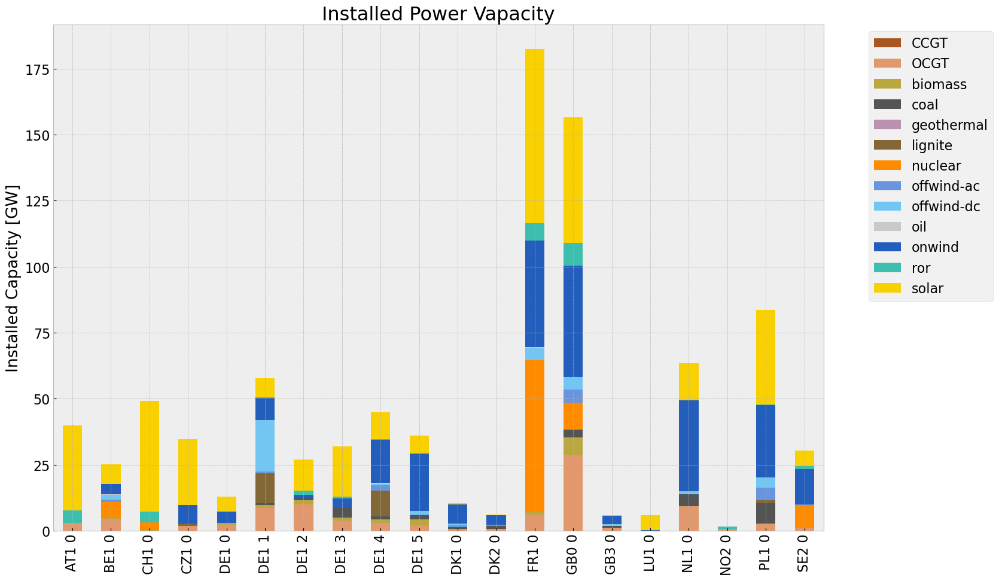

<Figure size 640x480 with 0 Axes>

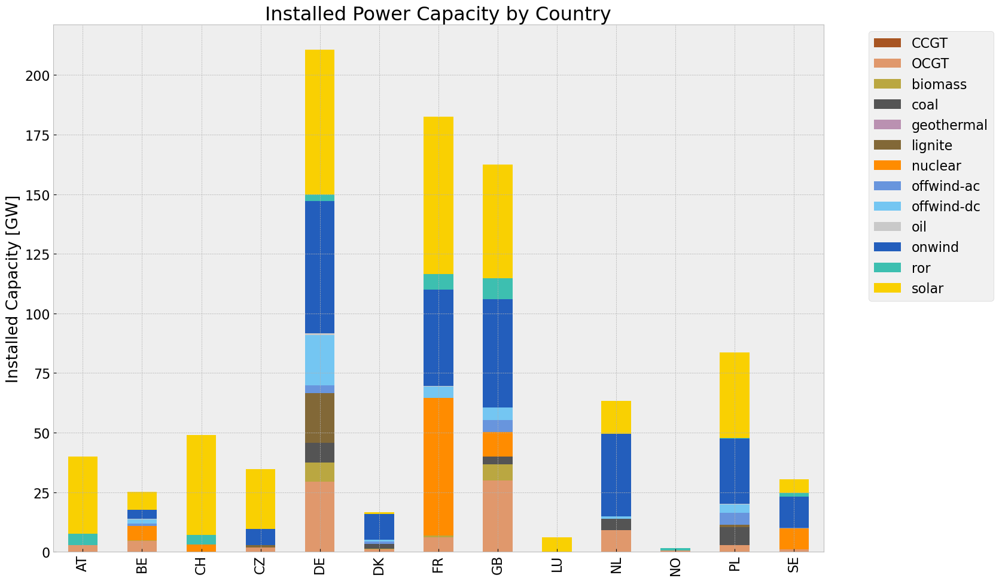

In [92]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

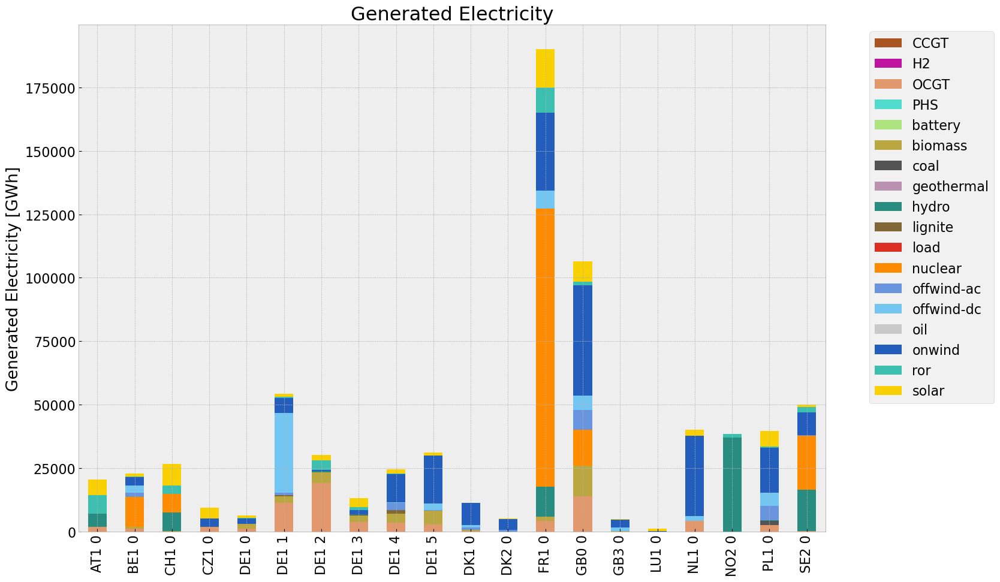

<Figure size 640x480 with 0 Axes>

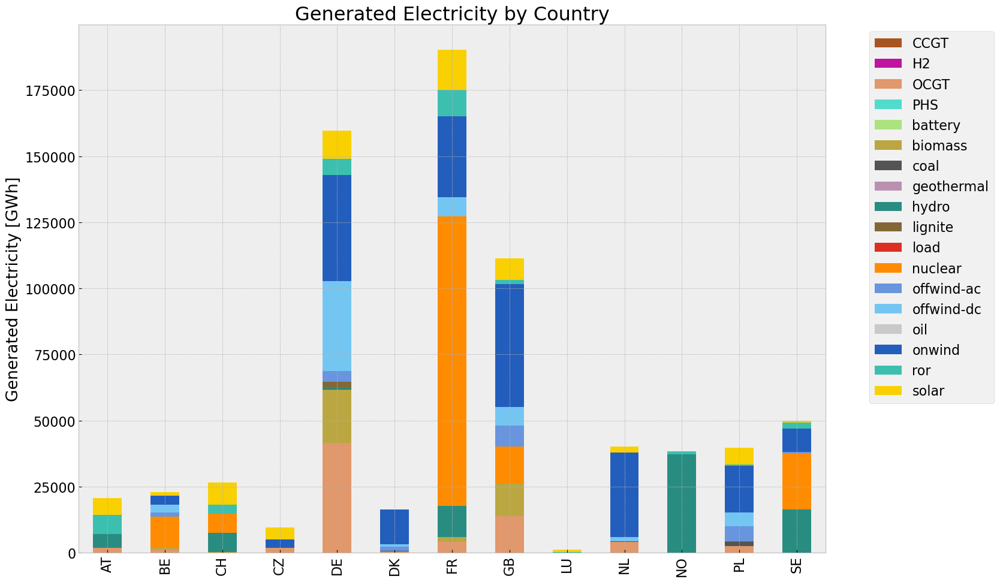

In [93]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

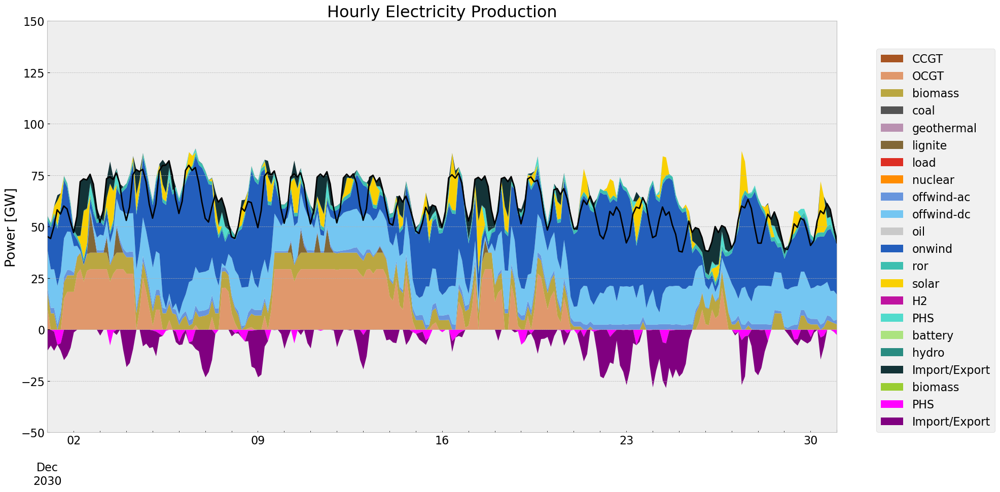

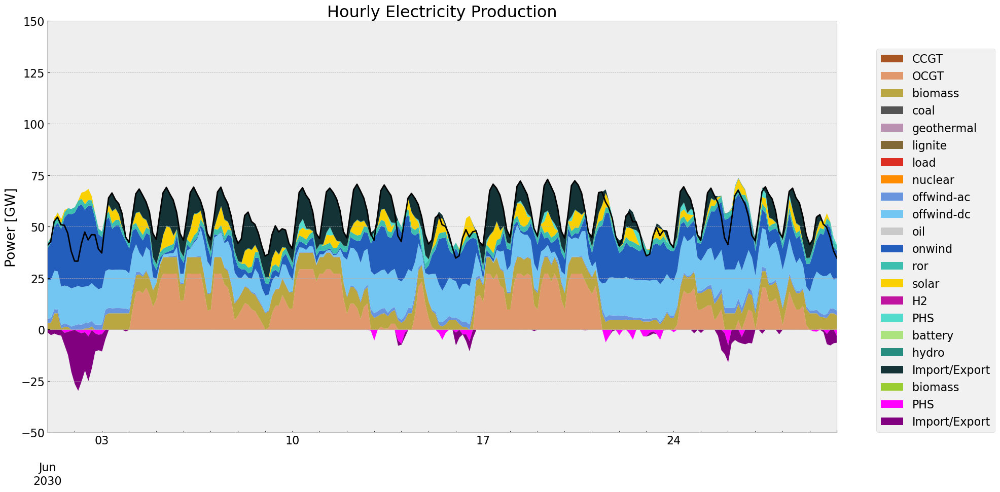

In [94]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

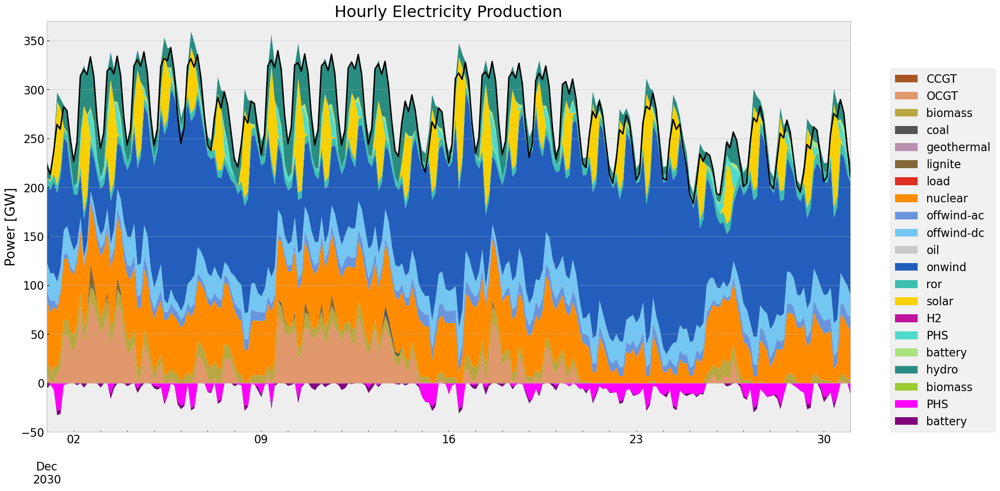

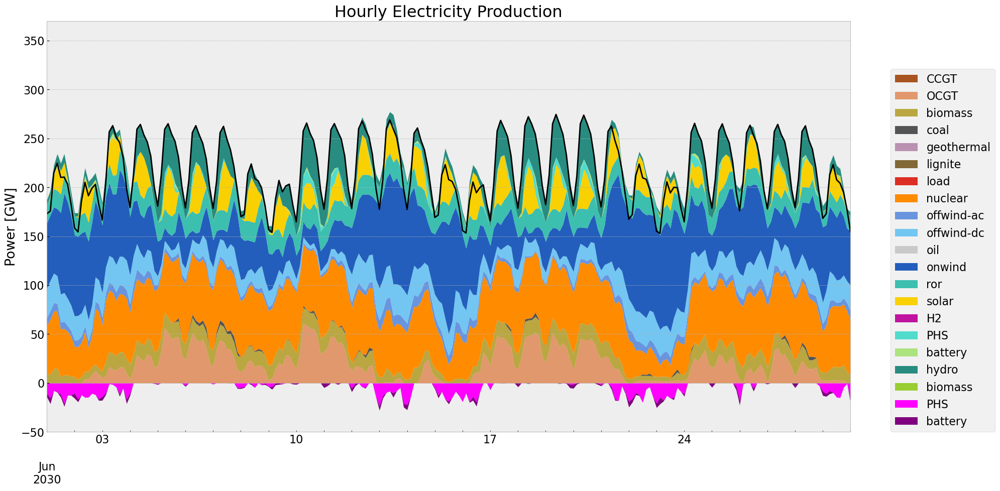

In [95]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

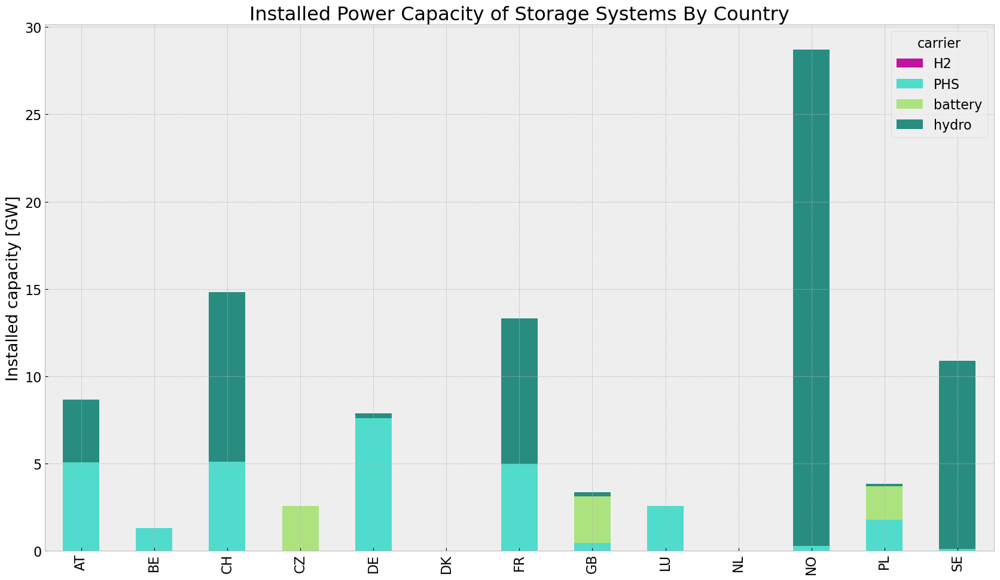

In [96]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\2695015690.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.165013e+07,0.451621,0.1980,3.141291e+07
biomass,3.510896e+07,0.468000,0.0000,0.000000e+00
coal,1.810082e+06,0.329908,0.3361,1.844055e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,2.103531e+06,0.337285,0.4069,2.537697e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.638975e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.111158e+07,1.000000,0.0000,0.000000e+00


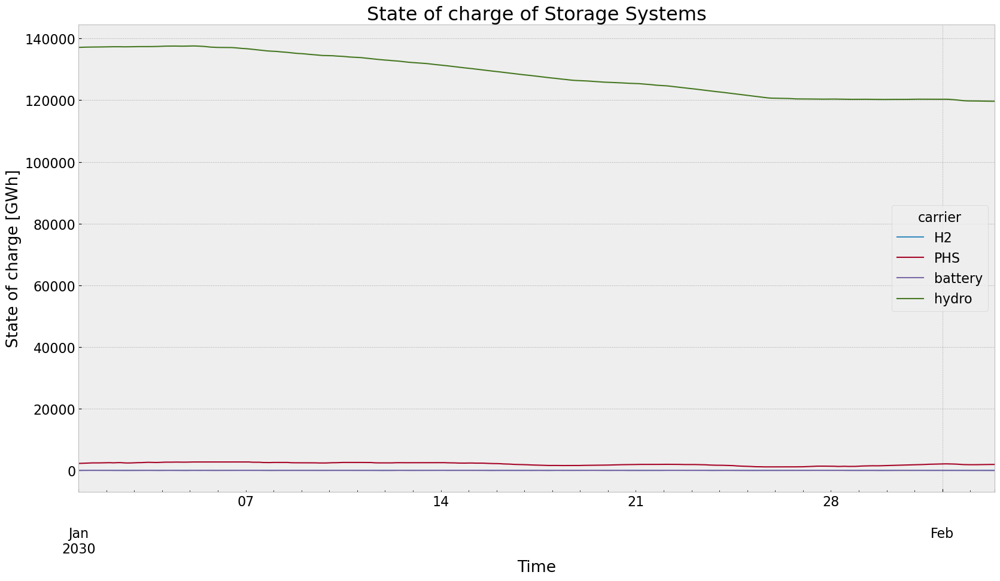

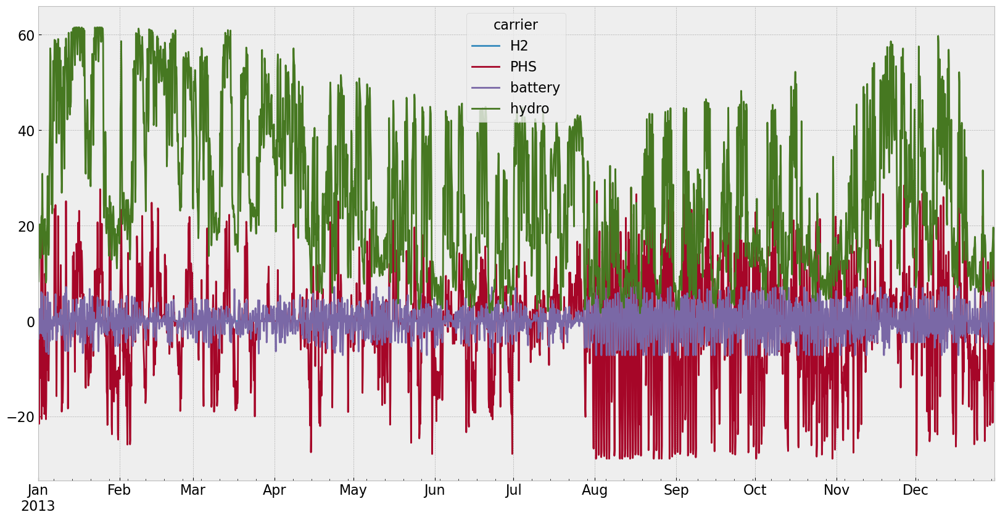

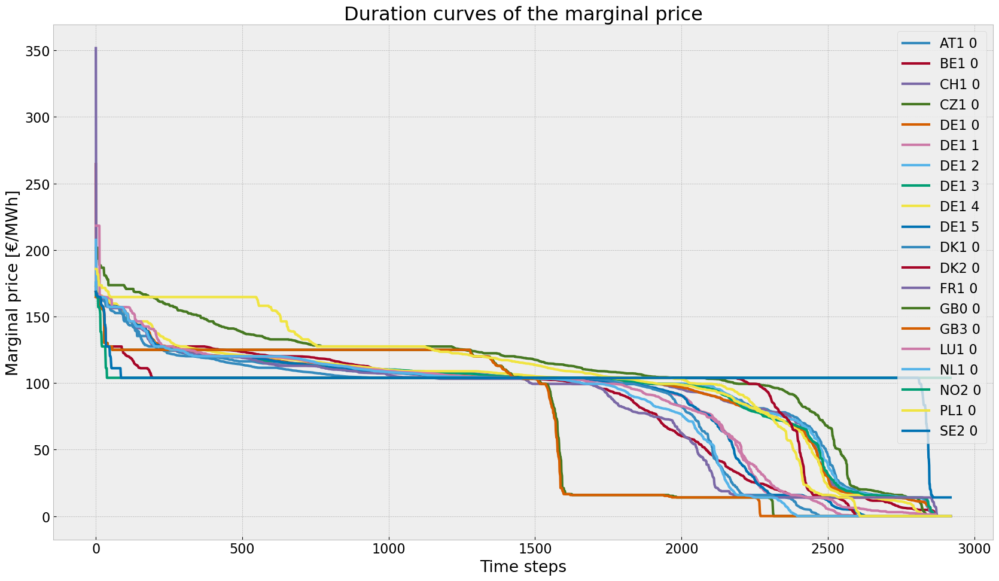

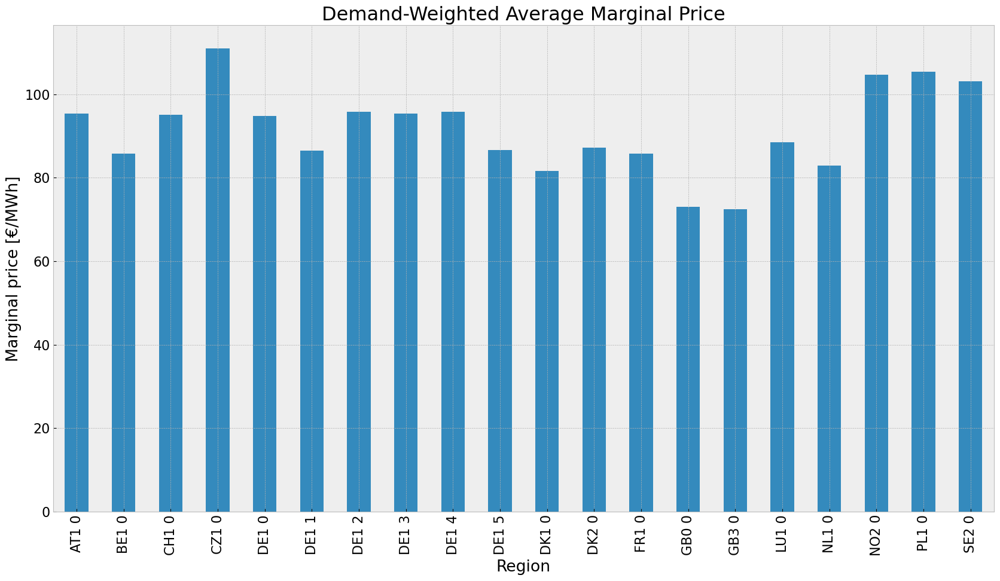

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


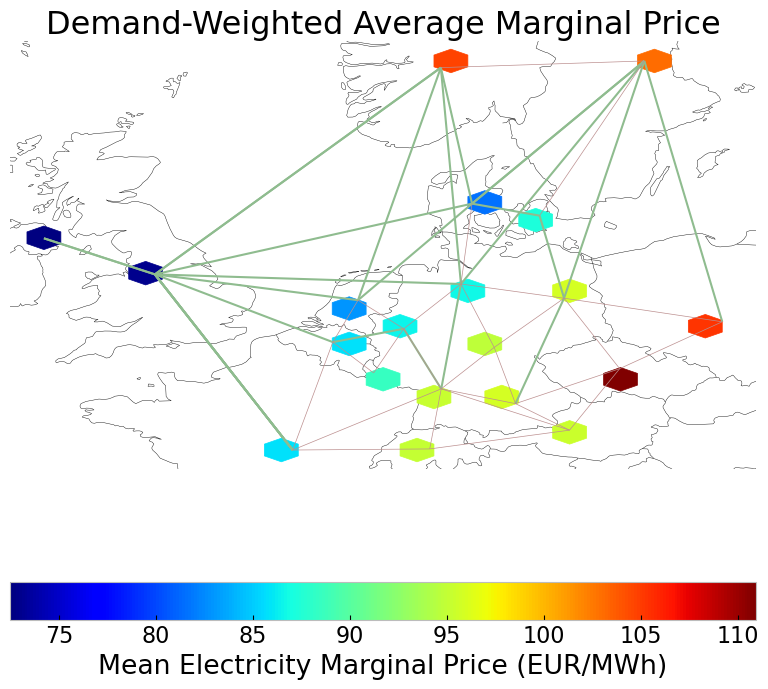

In [97]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-02-02 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [98]:
n3= n2.copy()

horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sazbqb8m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sazbqb8m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81d4f2b4


INFO:gurobipy:Model fingerprint: 0x81d4f2b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25416 rows and 6666 columns


INFO:gurobipy:Presolve removed 25416 rows and 6666 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5838 columns, 9698 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5838 columns, 9698 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.22433127e+11 -5.07094199e+11  5.08e+04 9.19e+03  3.10e+08     0s


INFO:gurobipy:   0   1.22433127e+11 -5.07094199e+11  5.08e+04 9.19e+03  3.10e+08     0s


   1   2.44317483e+10 -2.26391533e+11  5.00e+03 7.28e-11  4.27e+07     0s


INFO:gurobipy:   1   2.44317483e+10 -2.26391533e+11  5.00e+03 7.28e-11  4.27e+07     0s


   2   4.62748248e+09 -6.21660945e+10  3.29e+02 2.73e+02  6.65e+06     0s


INFO:gurobipy:   2   4.62748248e+09 -6.21660945e+10  3.29e+02 2.73e+02  6.65e+06     0s


   3   1.57229114e+09 -1.47479672e+10  5.89e+01 1.75e-10  1.47e+06     0s


INFO:gurobipy:   3   1.57229114e+09 -1.47479672e+10  5.89e+01 1.75e-10  1.47e+06     0s


   4   6.76071451e+08 -1.99972271e+09  1.12e+01 8.73e-11  2.34e+05     0s


INFO:gurobipy:   4   6.76071451e+08 -1.99972271e+09  1.12e+01 8.73e-11  2.34e+05     0s


   5   4.60779435e+08 -9.05883192e+08  5.68e+00 4.37e-11  1.18e+05     0s


INFO:gurobipy:   5   4.60779435e+08 -9.05883192e+08  5.68e+00 4.37e-11  1.18e+05     0s


   6   3.46636927e+08 -2.92233737e+08  3.32e+00 2.91e-11  5.52e+04     0s


INFO:gurobipy:   6   3.46636927e+08 -2.92233737e+08  3.32e+00 2.91e-11  5.52e+04     0s


   7   2.58251146e+08 -9.58122504e+07  1.72e+00 2.24e-11  3.05e+04     0s


INFO:gurobipy:   7   2.58251146e+08 -9.58122504e+07  1.72e+00 2.24e-11  3.05e+04     0s


   8   1.85539116e+08  3.02306738e+07  4.17e-01 2.91e-11  1.33e+04     0s


INFO:gurobipy:   8   1.85539116e+08  3.02306738e+07  4.17e-01 2.91e-11  1.33e+04     0s


   9   1.71021038e+08  1.22176921e+08  2.01e-01 2.91e-11  4.19e+03     0s


INFO:gurobipy:   9   1.71021038e+08  1.22176921e+08  2.01e-01 2.91e-11  4.19e+03     0s


  10   1.61600922e+08  1.38318949e+08  9.78e-02 1.73e-11  2.00e+03     0s


INFO:gurobipy:  10   1.61600922e+08  1.38318949e+08  9.78e-02 1.73e-11  2.00e+03     0s


  11   1.57377116e+08  1.45607772e+08  5.92e-02 2.91e-11  1.01e+03     0s


INFO:gurobipy:  11   1.57377116e+08  1.45607772e+08  5.92e-02 2.91e-11  1.01e+03     0s


  12   1.53952294e+08  1.47850535e+08  3.05e-02 2.06e-11  5.24e+02     0s


INFO:gurobipy:  12   1.53952294e+08  1.47850535e+08  3.05e-02 2.06e-11  5.24e+02     0s


  13   1.51563852e+08  1.49111579e+08  1.15e-02 1.63e-11  2.10e+02     0s


INFO:gurobipy:  13   1.51563852e+08  1.49111579e+08  1.15e-02 1.63e-11  2.10e+02     0s


  14   1.50663540e+08  1.49591680e+08  4.58e-03 1.91e-11  9.19e+01     0s


INFO:gurobipy:  14   1.50663540e+08  1.49591680e+08  4.58e-03 1.91e-11  9.19e+01     0s


  15   1.50350314e+08  1.49772446e+08  2.34e-03 2.18e-11  4.96e+01     0s


INFO:gurobipy:  15   1.50350314e+08  1.49772446e+08  2.34e-03 2.18e-11  4.96e+01     0s


  16   1.50157410e+08  1.49917082e+08  9.37e-04 2.03e-11  2.06e+01     0s


INFO:gurobipy:  16   1.50157410e+08  1.49917082e+08  9.37e-04 2.03e-11  2.06e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2060    1.5002441e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2060    1.5002441e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2060 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2060 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.500244095e+08


INFO:gurobipy:Optimal objective  1.500244095e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ve62msqe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ve62msqe.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb582fee9


INFO:gurobipy:Model fingerprint: 0xb582fee9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6588 columns


INFO:gurobipy:Presolve removed 25417 rows and 6588 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5916 columns, 9768 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5916 columns, 9768 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.949e+03


INFO:gurobipy: AA' NZ     : 3.949e+03


 Factor NZ  : 3.935e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.935e+04 (roughly 3 MB of memory)


 Factor Ops : 2.026e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.026e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22870291e+11 -4.97174692e+11  8.50e+04 8.46e+03  4.86e+08     0s


INFO:gurobipy:   0   2.22870291e+11 -4.97174692e+11  8.50e+04 8.46e+03  4.86e+08     0s


   1   4.38447612e+10 -2.77110581e+11  9.69e+03 7.28e-11  7.02e+07     0s


INFO:gurobipy:   1   4.38447612e+10 -2.77110581e+11  9.69e+03 7.28e-11  7.02e+07     0s


   2   7.12571529e+09 -7.65008570e+10  5.05e+02 2.02e+02  8.69e+06     0s


INFO:gurobipy:   2   7.12571529e+09 -7.65008570e+10  5.05e+02 2.02e+02  8.69e+06     0s


   3   2.30274300e+09 -1.10693383e+10  7.22e+01 3.64e-10  1.23e+06     0s


INFO:gurobipy:   3   2.30274300e+09 -1.10693383e+10  7.22e+01 3.64e-10  1.23e+06     0s


   4   1.10079060e+09 -3.58517477e+09  1.67e+01 3.20e-10  4.09e+05     0s


INFO:gurobipy:   4   1.10079060e+09 -3.58517477e+09  1.67e+01 3.20e-10  4.09e+05     0s


   5   7.68353628e+08 -9.27395226e+08  6.35e+00 1.60e-10  1.46e+05     0s


INFO:gurobipy:   5   7.68353628e+08 -9.27395226e+08  6.35e+00 1.60e-10  1.46e+05     0s


   6   6.14693502e+08 -1.43674730e+08  3.04e+00 5.82e-11  6.49e+04     0s


INFO:gurobipy:   6   6.14693502e+08 -1.43674730e+08  3.04e+00 5.82e-11  6.49e+04     0s


   7   4.63013362e+08  1.88704242e+08  6.02e-01 4.37e-11  2.33e+04     0s


INFO:gurobipy:   7   4.63013362e+08  1.88704242e+08  6.02e-01 4.37e-11  2.33e+04     0s


   8   4.12050363e+08  3.16381753e+08  2.17e-01 3.39e-11  8.12e+03     0s


INFO:gurobipy:   8   4.12050363e+08  3.16381753e+08  2.17e-01 3.39e-11  8.12e+03     0s


   9   3.88785345e+08  3.49588635e+08  8.20e-02 2.91e-11  3.32e+03     0s


INFO:gurobipy:   9   3.88785345e+08  3.49588635e+08  8.20e-02 2.91e-11  3.32e+03     0s


  10   3.81651796e+08  3.60927798e+08  4.50e-02 2.91e-11  1.76e+03     0s


INFO:gurobipy:  10   3.81651796e+08  3.60927798e+08  4.50e-02 2.91e-11  1.76e+03     0s


  11   3.76104659e+08  3.67046746e+08  1.75e-02 2.45e-11  7.68e+02     0s


INFO:gurobipy:  11   3.76104659e+08  3.67046746e+08  1.75e-02 2.45e-11  7.68e+02     0s


  12   3.73790062e+08  3.70521602e+08  6.64e-03 2.84e-11  2.77e+02     0s


INFO:gurobipy:  12   3.73790062e+08  3.70521602e+08  6.64e-03 2.84e-11  2.77e+02     0s


  13   3.72891264e+08  3.71729263e+08  2.62e-03 2.98e-11  9.85e+01     0s


INFO:gurobipy:  13   3.72891264e+08  3.71729263e+08  2.62e-03 2.98e-11  9.85e+01     0s


  14   3.72312328e+08  3.72187673e+08  1.11e-04 5.23e-11  1.05e+01     0s


INFO:gurobipy:  14   3.72312328e+08  3.72187673e+08  1.11e-04 5.23e-11  1.05e+01     0s


  15   3.72285519e+08  3.72261807e+08  3.16e-05 3.47e-11  2.01e+00     0s


INFO:gurobipy:  15   3.72285519e+08  3.72261807e+08  3.16e-05 3.47e-11  2.01e+00     0s


  16   3.72279795e+08  3.72269631e+08  1.62e-05 2.91e-11  8.61e-01     0s


INFO:gurobipy:  16   3.72279795e+08  3.72269631e+08  1.62e-05 2.91e-11  8.61e-01     0s


  17   3.72275617e+08  3.72272528e+08  5.34e-06 3.10e-11  2.62e-01     0s


INFO:gurobipy:  17   3.72275617e+08  3.72272528e+08  5.34e-06 3.10e-11  2.62e-01     0s


  18   3.72273672e+08  3.72273145e+08  4.84e-07 2.91e-11  4.46e-02     0s


INFO:gurobipy:  18   3.72273672e+08  3.72273145e+08  4.84e-07 2.91e-11  4.46e-02     0s


  19   3.72273487e+08  3.72273409e+08  6.56e-08 2.91e-11  6.62e-03     0s


INFO:gurobipy:  19   3.72273487e+08  3.72273409e+08  6.56e-08 2.91e-11  6.62e-03     0s


  20   3.72273456e+08  3.72273453e+08  4.50e-09 2.91e-11  2.40e-04     0s


INFO:gurobipy:  20   3.72273456e+08  3.72273453e+08  4.50e-09 2.91e-11  2.40e-04     0s


  21   3.72273454e+08  3.72273454e+08  2.58e-09 4.37e-11  3.05e-05     0s


INFO:gurobipy:  21   3.72273454e+08  3.72273454e+08  2.58e-09 4.37e-11  3.05e-05     0s


  22   3.72273454e+08  3.72273454e+08  8.33e-10 3.41e-11  3.70e-06     0s


INFO:gurobipy:  22   3.72273454e+08  3.72273454e+08  8.33e-10 3.41e-11  3.70e-06     0s


  23   3.72273454e+08  3.72273454e+08  2.24e-10 2.91e-11  1.77e-08     0s


INFO:gurobipy:  23   3.72273454e+08  3.72273454e+08  2.24e-10 2.91e-11  1.77e-08     0s


  24   3.72273454e+08  3.72273454e+08  5.51e-12 3.06e-11  5.65e-11     0s


INFO:gurobipy:  24   3.72273454e+08  3.72273454e+08  5.51e-12 3.06e-11  5.65e-11     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.29 seconds (0.06 work units)


Optimal objective 3.72273454e+08


INFO:gurobipy:Optimal objective 3.72273454e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2088    3.7227345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2088    3.7227345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2088 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2088 iterations and 0.32 seconds (0.07 work units)


Optimal objective  3.722734539e+08


INFO:gurobipy:Optimal objective  3.722734539e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zkr0vhj_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zkr0vhj_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7a3a678c


INFO:gurobipy:Model fingerprint: 0x7a3a678c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6658 columns


INFO:gurobipy:Presolve removed 25416 rows and 6658 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5846 columns, 9706 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5846 columns, 9706 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64483023e+11 -4.75904557e+11  9.16e+04 1.22e+04  5.11e+08     0s


INFO:gurobipy:   0   2.64483023e+11 -4.75904557e+11  9.16e+04 1.22e+04  5.11e+08     0s


   1   5.21540443e+10 -2.64203891e+11  9.56e+03 7.28e-11  6.86e+07     0s


INFO:gurobipy:   1   5.21540443e+10 -2.64203891e+11  9.56e+03 7.28e-11  6.86e+07     0s


   2   1.24366672e+10 -6.53924265e+10  5.24e+02 7.28e-11  8.30e+06     0s


INFO:gurobipy:   2   1.24366672e+10 -6.53924265e+10  5.24e+02 7.28e-11  8.30e+06     0s


   3   5.70648645e+09 -1.67920057e+10  1.29e+02 1.64e-09  2.16e+06     0s


INFO:gurobipy:   3   5.70648645e+09 -1.67920057e+10  1.29e+02 1.64e-09  2.16e+06     0s


   4   3.72994596e+09 -4.10270983e+09  6.29e+01 4.95e-10  7.39e+05     0s


INFO:gurobipy:   4   3.72994596e+09 -4.10270983e+09  6.29e+01 4.95e-10  7.39e+05     0s


   5   2.59656653e+09 -7.38361645e+08  2.81e+01 2.33e-10  3.06e+05     0s


INFO:gurobipy:   5   2.59656653e+09 -7.38361645e+08  2.81e+01 2.33e-10  3.06e+05     0s


   6   2.26581899e+09  8.60710314e+08  1.39e+01 2.04e-10  1.27e+05     0s


INFO:gurobipy:   6   2.26581899e+09  8.60710314e+08  1.39e+01 2.04e-10  1.27e+05     0s


   7   2.03865460e+09  1.55903016e+09  2.46e+00 1.60e-10  4.17e+04     0s


INFO:gurobipy:   7   2.03865460e+09  1.55903016e+09  2.46e+00 1.60e-10  4.17e+04     0s


   8   1.95871233e+09  1.77360626e+09  3.84e-01 4.37e-11  1.59e+04     0s


INFO:gurobipy:   8   1.95871233e+09  1.77360626e+09  3.84e-01 4.37e-11  1.59e+04     0s


   9   1.95238456e+09  1.81797232e+09  3.20e-01 4.37e-11  1.15e+04     0s


INFO:gurobipy:   9   1.95238456e+09  1.81797232e+09  3.20e-01 4.37e-11  1.15e+04     0s


  10   1.94027046e+09  1.85853549e+09  2.18e-01 3.00e-11  7.02e+03     0s


INFO:gurobipy:  10   1.94027046e+09  1.85853549e+09  2.18e-01 3.00e-11  7.02e+03     0s


  11   1.93142436e+09  1.88189868e+09  1.50e-01 3.05e-11  4.26e+03     0s


INFO:gurobipy:  11   1.93142436e+09  1.88189868e+09  1.50e-01 3.05e-11  4.26e+03     0s


  12   1.91726140e+09  1.89261094e+09  5.20e-02 3.39e-11  2.11e+03     0s


INFO:gurobipy:  12   1.91726140e+09  1.89261094e+09  5.20e-02 3.39e-11  2.11e+03     0s


  13   1.91158016e+09  1.89690743e+09  1.93e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:  13   1.91158016e+09  1.89690743e+09  1.93e-02 2.91e-11  1.26e+03     0s


  14   1.90920289e+09  1.90363188e+09  6.47e-03 2.91e-11  4.77e+02     0s


INFO:gurobipy:  14   1.90920289e+09  1.90363188e+09  6.47e-03 2.91e-11  4.77e+02     0s


  15   1.90837351e+09  1.90587673e+09  2.39e-03 2.91e-11  2.14e+02     0s


INFO:gurobipy:  15   1.90837351e+09  1.90587673e+09  2.39e-03 2.91e-11  2.14e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1836    1.9077856e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1836    1.9077856e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1836 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1836 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.907785566e+09


INFO:gurobipy:Optimal objective  1.907785566e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l9rfe233.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l9rfe233.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77a04055


INFO:gurobipy:Model fingerprint: 0x77a04055


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6587 columns


INFO:gurobipy:Presolve removed 25416 rows and 6587 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5917 columns, 9777 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5917 columns, 9777 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59985223e+11 -4.85572618e+11  5.39e+04 1.33e+04  3.20e+08     0s


INFO:gurobipy:   0   1.59985223e+11 -4.85572618e+11  5.39e+04 1.33e+04  3.20e+08     0s


   1   3.47973495e+10 -2.28907508e+11  5.20e+03 7.28e-11  4.42e+07     0s


INFO:gurobipy:   1   3.47973495e+10 -2.28907508e+11  5.20e+03 7.28e-11  4.42e+07     0s


   2   9.89663719e+09 -5.76463937e+10  3.88e+02 4.25e+02  6.83e+06     0s


INFO:gurobipy:   2   9.89663719e+09 -5.76463937e+10  3.88e+02 4.25e+02  6.83e+06     0s


   3   3.91615190e+09 -1.15725912e+10  7.79e+01 9.17e-10  1.42e+06     0s


INFO:gurobipy:   3   3.91615190e+09 -1.15725912e+10  7.79e+01 9.17e-10  1.42e+06     0s


   4   2.73511627e+09 -2.85834565e+09  3.31e+01 2.84e-10  5.00e+05     0s


INFO:gurobipy:   4   2.73511627e+09 -2.85834565e+09  3.31e+01 2.84e-10  5.00e+05     0s


   5   2.24924693e+09  3.58501600e+08  1.24e+01 8.37e-11  1.65e+05     0s


INFO:gurobipy:   5   2.24924693e+09  3.58501600e+08  1.24e+01 8.37e-11  1.65e+05     0s


   6   1.98673667e+09  1.23365390e+09  3.95e+00 7.28e-11  6.48e+04     0s


INFO:gurobipy:   6   1.98673667e+09  1.23365390e+09  3.95e+00 7.28e-11  6.48e+04     0s


   7   1.86504695e+09  1.55798506e+09  1.16e+00 2.91e-11  2.62e+04     0s


INFO:gurobipy:   7   1.86504695e+09  1.55798506e+09  1.16e+00 2.91e-11  2.62e+04     0s


   8   1.80654317e+09  1.71676066e+09  2.26e-01 3.15e-11  7.62e+03     0s


INFO:gurobipy:   8   1.80654317e+09  1.71676066e+09  2.26e-01 3.15e-11  7.62e+03     0s


   9   1.78754768e+09  1.75061921e+09  4.58e-02 2.91e-11  3.13e+03     0s


INFO:gurobipy:   9   1.78754768e+09  1.75061921e+09  4.58e-02 2.91e-11  3.13e+03     0s


  10   1.78328307e+09  1.76779203e+09  1.92e-02 2.91e-11  1.31e+03     0s


INFO:gurobipy:  10   1.78328307e+09  1.76779203e+09  1.92e-02 2.91e-11  1.31e+03     0s


  11   1.78108221e+09  1.77483661e+09  7.71e-03 2.91e-11  5.29e+02     0s


INFO:gurobipy:  11   1.78108221e+09  1.77483661e+09  7.71e-03 2.91e-11  5.29e+02     0s


  12   1.78008369e+09  1.77639716e+09  3.06e-03 3.05e-11  3.12e+02     0s


INFO:gurobipy:  12   1.78008369e+09  1.77639716e+09  3.06e-03 3.05e-11  3.12e+02     0s


  13   1.77962329e+09  1.77778905e+09  1.07e-03 3.01e-11  1.55e+02     0s


INFO:gurobipy:  13   1.77962329e+09  1.77778905e+09  1.07e-03 3.01e-11  1.55e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1777    1.7793179e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1777    1.7793179e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1777 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1777 iterations and 0.28 seconds (0.05 work units)


Optimal objective  1.779317933e+09


INFO:gurobipy:Optimal objective  1.779317933e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_c29s45.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_c29s45.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xec59c608


INFO:gurobipy:Model fingerprint: 0xec59c608


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25417 rows and 6647 columns


INFO:gurobipy:Presolve removed 25417 rows and 6647 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5857 columns, 9711 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5857 columns, 9711 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.55879699e+11 -4.75248890e+11  8.83e+04 1.13e+04  4.95e+08     0s


INFO:gurobipy:   0   2.55879699e+11 -4.75248890e+11  8.83e+04 1.13e+04  4.95e+08     0s


   1   5.31193445e+10 -2.62827705e+11  9.97e+03 7.28e-11  7.04e+07     0s


INFO:gurobipy:   1   5.31193445e+10 -2.62827705e+11  9.97e+03 7.28e-11  7.04e+07     0s


   2   1.31793344e+10 -6.94215853e+10  5.84e+02 7.28e-11  8.93e+06     0s


INFO:gurobipy:   2   1.31793344e+10 -6.94215853e+10  5.84e+02 7.28e-11  8.93e+06     0s


   3   7.21390028e+09 -1.64487762e+10  1.47e+02 3.06e-10  2.30e+06     0s


INFO:gurobipy:   3   7.21390028e+09 -1.64487762e+10  1.47e+02 3.06e-10  2.30e+06     0s


   4   4.40769233e+09 -2.45273822e+09  4.17e+01 4.66e-10  6.32e+05     0s


INFO:gurobipy:   4   4.40769233e+09 -2.45273822e+09  4.17e+01 4.66e-10  6.32e+05     0s


   5   3.91839724e+09  1.05330287e+09  2.53e+01 1.89e-10  2.61e+05     0s


INFO:gurobipy:   5   3.91839724e+09  1.05330287e+09  2.53e+01 1.89e-10  2.61e+05     0s


   6   3.55195589e+09  2.52253202e+09  7.23e+00 8.73e-11  9.07e+04     0s


INFO:gurobipy:   6   3.55195589e+09  2.52253202e+09  7.23e+00 8.73e-11  9.07e+04     0s


   7   3.41938277e+09  3.09847039e+09  1.38e+00 5.82e-11  2.77e+04     0s


INFO:gurobipy:   7   3.41938277e+09  3.09847039e+09  1.38e+00 5.82e-11  2.77e+04     0s


   8   3.36167601e+09  3.26034532e+09  8.53e-02 5.82e-11  8.66e+03     0s


INFO:gurobipy:   8   3.36167601e+09  3.26034532e+09  8.53e-02 5.82e-11  8.66e+03     0s


   9   3.34970386e+09  3.31154292e+09  4.17e-02 2.91e-11  3.26e+03     0s


INFO:gurobipy:   9   3.34970386e+09  3.31154292e+09  4.17e-02 2.91e-11  3.26e+03     0s


  10   3.34352674e+09  3.32452752e+09  2.38e-02 3.67e-11  1.62e+03     0s


INFO:gurobipy:  10   3.34352674e+09  3.32452752e+09  2.38e-02 3.67e-11  1.62e+03     0s


  11   3.33922952e+09  3.32968341e+09  1.25e-02 2.91e-11  8.16e+02     0s


INFO:gurobipy:  11   3.33922952e+09  3.32968341e+09  1.25e-02 2.91e-11  8.16e+02     0s


  12   3.33691968e+09  3.33257685e+09  6.49e-03 2.95e-11  3.71e+02     0s


INFO:gurobipy:  12   3.33691968e+09  3.33257685e+09  6.49e-03 2.95e-11  3.71e+02     0s


  13   3.33547202e+09  3.33342131e+09  2.87e-03 3.56e-11  1.75e+02     0s


INFO:gurobipy:  13   3.33547202e+09  3.33342131e+09  2.87e-03 3.56e-11  1.75e+02     0s


  14   3.33462228e+09  3.33404603e+09  6.94e-04 2.92e-11  4.92e+01     0s


INFO:gurobipy:  14   3.33462228e+09  3.33404603e+09  6.94e-04 2.92e-11  4.92e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    3.3343261e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1783    3.3343261e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1783 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1783 iterations and 0.26 seconds (0.06 work units)


Optimal objective  3.334326134e+09


INFO:gurobipy:Optimal objective  3.334326134e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skzy43w7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skzy43w7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf8e3bac0


INFO:gurobipy:Model fingerprint: 0xf8e3bac0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25417 rows and 6659 columns


INFO:gurobipy:Presolve removed 25417 rows and 6659 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1415 rows, 5845 columns, 9699 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5845 columns, 9699 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.54514776e+11 -4.78248961e+11  8.80e+04 1.34e+04  4.95e+08     0s


INFO:gurobipy:   0   2.54514776e+11 -4.78248961e+11  8.80e+04 1.34e+04  4.95e+08     0s


   1   5.52836865e+10 -2.64790460e+11  9.98e+03 7.28e-11  7.10e+07     0s


INFO:gurobipy:   1   5.52836865e+10 -2.64790460e+11  9.98e+03 7.28e-11  7.10e+07     0s


   2   1.64988293e+10 -6.34080953e+10  6.82e+02 1.02e-10  9.01e+06     0s


INFO:gurobipy:   2   1.64988293e+10 -6.34080953e+10  6.82e+02 1.02e-10  9.01e+06     0s


   3   1.02534535e+10 -9.26210152e+09  1.64e+02 8.00e-10  1.98e+06     0s


INFO:gurobipy:   3   1.02534535e+10 -9.26210152e+09  1.64e+02 8.00e-10  1.98e+06     0s


   4   7.62858698e+09  1.46292355e+09  6.37e+01 5.38e-10  6.11e+05     0s


INFO:gurobipy:   4   7.62858698e+09  1.46292355e+09  6.37e+01 5.38e-10  6.11e+05     0s


   5   6.52802828e+09  3.79231714e+09  2.87e+01 2.18e-10  2.63e+05     0s


INFO:gurobipy:   5   6.52802828e+09  3.79231714e+09  2.87e+01 2.18e-10  2.63e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.22 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.22 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1978    5.6828261e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1978    5.6828261e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1978 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1978 iterations and 0.24 seconds (0.05 work units)


Optimal objective  5.682826053e+09


INFO:gurobipy:Optimal objective  5.682826053e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xqoaqpf9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xqoaqpf9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc6b8d768


INFO:gurobipy:Model fingerprint: 0xc6b8d768


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25417 rows and 6647 columns


INFO:gurobipy:Presolve removed 25417 rows and 6647 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1415 rows, 5857 columns, 9711 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5857 columns, 9711 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10641386e+11 -4.83682122e+11  8.02e+04 1.17e+04  4.56e+08     0s


INFO:gurobipy:   0   2.10641386e+11 -4.83682122e+11  8.02e+04 1.17e+04  4.56e+08     0s


   1   4.31268957e+10 -2.61987571e+11  9.11e+03 7.28e-11  6.58e+07     0s


INFO:gurobipy:   1   4.31268957e+10 -2.61987571e+11  9.11e+03 7.28e-11  6.58e+07     0s


   2   9.71185479e+09 -7.01989105e+10  4.95e+02 1.16e-10  8.38e+06     0s


INFO:gurobipy:   2   9.71185479e+09 -7.01989105e+10  4.95e+02 1.16e-10  8.38e+06     0s


   3   4.61883689e+09 -1.36500256e+10  1.22e+02 5.68e-10  1.75e+06     0s


INFO:gurobipy:   3   4.61883689e+09 -1.36500256e+10  1.22e+02 5.68e-10  1.75e+06     0s


   4   3.22888780e+09 -2.98639572e+09  4.97e+01 6.11e-10  5.75e+05     0s


INFO:gurobipy:   4   3.22888780e+09 -2.98639572e+09  4.97e+01 6.11e-10  5.75e+05     0s


   5   2.71095709e+09  6.73193197e+08  1.75e+01 6.26e-10  1.83e+05     0s


INFO:gurobipy:   5   2.71095709e+09  6.73193197e+08  1.75e+01 6.26e-10  1.83e+05     0s


   6   2.52885198e+09  1.53648978e+09  9.03e+00 2.33e-10  8.77e+04     0s


INFO:gurobipy:   6   2.52885198e+09  1.53648978e+09  9.03e+00 2.33e-10  8.77e+04     0s


   7   2.32797232e+09  1.94423976e+09  1.96e+00 1.60e-10  3.32e+04     0s


INFO:gurobipy:   7   2.32797232e+09  1.94423976e+09  1.96e+00 1.60e-10  3.32e+04     0s


   8   2.25271142e+09  2.09430428e+09  5.64e-01 1.16e-10  1.36e+04     0s


INFO:gurobipy:   8   2.25271142e+09  2.09430428e+09  5.64e-01 1.16e-10  1.36e+04     0s


   9   2.22234768e+09  2.14630081e+09  1.70e-01 7.28e-11  6.51e+03     0s


INFO:gurobipy:   9   2.22234768e+09  2.14630081e+09  1.70e-01 7.28e-11  6.51e+03     0s


  10   2.21546477e+09  2.17654414e+09  1.04e-01 4.37e-11  3.34e+03     0s


INFO:gurobipy:  10   2.21546477e+09  2.17654414e+09  1.04e-01 4.37e-11  3.34e+03     0s


  11   2.20901856e+09  2.18752135e+09  5.04e-02 2.91e-11  1.84e+03     0s


INFO:gurobipy:  11   2.20901856e+09  2.18752135e+09  5.04e-02 2.91e-11  1.84e+03     0s


  12   2.20551267e+09  2.19476039e+09  2.47e-02 4.37e-11  9.21e+02     0s


INFO:gurobipy:  12   2.20551267e+09  2.19476039e+09  2.47e-02 4.37e-11  9.21e+02     0s


  13   2.20346669e+09  2.19949026e+09  1.05e-02 2.91e-11  3.41e+02     0s


INFO:gurobipy:  13   2.20346669e+09  2.19949026e+09  1.05e-02 2.91e-11  3.41e+02     0s


  14   2.20242427e+09  2.20049834e+09  3.89e-03 2.91e-11  1.65e+02     0s


INFO:gurobipy:  14   2.20242427e+09  2.20049834e+09  3.89e-03 2.91e-11  1.65e+02     0s


  15   2.20194197e+09  2.20127856e+09  1.03e-03 2.91e-11  5.67e+01     0s


INFO:gurobipy:  15   2.20194197e+09  2.20127856e+09  1.03e-03 2.91e-11  5.67e+01     0s


  16   2.20182650e+09  2.20157633e+09  3.90e-04 2.91e-11  2.14e+01     0s


INFO:gurobipy:  16   2.20182650e+09  2.20157633e+09  3.90e-04 2.91e-11  2.14e+01     0s


  17   2.20176980e+09  2.20169340e+09  1.03e-04 2.91e-11  6.53e+00     0s


INFO:gurobipy:  17   2.20176980e+09  2.20169340e+09  1.03e-04 2.91e-11  6.53e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2105    2.2017453e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2105    2.2017453e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2105 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2105 iterations and 0.30 seconds (0.07 work units)


Optimal objective  2.201745255e+09


INFO:gurobipy:Optimal objective  2.201745255e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92vz_b5l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92vz_b5l.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x382284b3


INFO:gurobipy:Model fingerprint: 0x382284b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6719 columns


INFO:gurobipy:Presolve removed 25417 rows and 6719 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5785 columns, 9639 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5785 columns, 9639 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05366682e+11 -4.75363174e+11  6.78e+04 1.33e+04  3.90e+08     0s


INFO:gurobipy:   0   2.05366682e+11 -4.75363174e+11  6.78e+04 1.33e+04  3.90e+08     0s


   1   4.61970020e+10 -2.38242083e+11  7.14e+03 7.28e-11  5.49e+07     0s


INFO:gurobipy:   1   4.61970020e+10 -2.38242083e+11  7.14e+03 7.28e-11  5.49e+07     0s


   2   1.57145980e+10 -5.38390160e+10  4.99e+02 1.31e-10  7.52e+06     0s


INFO:gurobipy:   2   1.57145980e+10 -5.38390160e+10  4.99e+02 1.31e-10  7.52e+06     0s


   3   9.88412571e+09 -1.15360460e+10  1.42e+02 1.09e-09  2.12e+06     0s


INFO:gurobipy:   3   9.88412571e+09 -1.15360460e+10  1.42e+02 1.09e-09  2.12e+06     0s


   4   7.02482805e+09  8.38831750e+08  3.28e+01 3.49e-10  5.77e+05     0s


INFO:gurobipy:   4   7.02482805e+09  8.38831750e+08  3.28e+01 3.49e-10  5.77e+05     0s


   5   6.33329411e+09  3.86397808e+09  1.56e+01 1.46e-10  2.29e+05     0s


INFO:gurobipy:   5   6.33329411e+09  3.86397808e+09  1.56e+01 1.46e-10  2.29e+05     0s


   6   5.90725145e+09  4.82030233e+09  5.92e+00 1.02e-10  9.90e+04     0s


INFO:gurobipy:   6   5.90725145e+09  4.82030233e+09  5.92e+00 1.02e-10  9.90e+04     0s


   7   5.75439259e+09  5.40516949e+09  2.48e+00 1.31e-10  3.21e+04     0s


INFO:gurobipy:   7   5.75439259e+09  5.40516949e+09  2.48e+00 1.31e-10  3.21e+04     0s


   8   5.65953566e+09  5.56964203e+09  5.26e-01 8.73e-11  8.15e+03     0s


INFO:gurobipy:   8   5.65953566e+09  5.56964203e+09  5.26e-01 8.73e-11  8.15e+03     0s


   9   5.64020390e+09  5.59240957e+09  1.99e-01 4.37e-11  4.27e+03     0s


INFO:gurobipy:   9   5.64020390e+09  5.59240957e+09  1.99e-01 4.37e-11  4.27e+03     0s


  10   5.63758558e+09  5.60256653e+09  1.59e-01 4.37e-11  3.14e+03     0s


INFO:gurobipy:  10   5.63758558e+09  5.60256653e+09  1.59e-01 4.37e-11  3.14e+03     0s


  11   5.63561081e+09  5.61808597e+09  1.30e-01 2.91e-11  1.61e+03     0s


INFO:gurobipy:  11   5.63561081e+09  5.61808597e+09  1.30e-01 2.91e-11  1.61e+03     0s


  12   5.63173104e+09  5.62334011e+09  7.23e-02 2.91e-11  7.77e+02     0s


INFO:gurobipy:  12   5.63173104e+09  5.62334011e+09  7.23e-02 2.91e-11  7.77e+02     0s


  13   5.62927229e+09  5.62554189e+09  3.58e-02 4.37e-11  3.48e+02     0s


INFO:gurobipy:  13   5.62927229e+09  5.62554189e+09  3.58e-02 4.37e-11  3.48e+02     0s


  14   5.62702746e+09  5.62639570e+09  3.25e-03 2.91e-11  5.69e+01     0s


INFO:gurobipy:  14   5.62702746e+09  5.62639570e+09  3.25e-03 2.91e-11  5.69e+01     0s


  15   5.62680242e+09  5.62668007e+09  3.98e-04 2.91e-11  1.09e+01     0s


INFO:gurobipy:  15   5.62680242e+09  5.62668007e+09  3.98e-04 2.91e-11  1.09e+01     0s


  16   5.62678896e+09  5.62671559e+09  2.77e-04 2.91e-11  6.54e+00     0s


INFO:gurobipy:  16   5.62678896e+09  5.62671559e+09  2.77e-04 2.91e-11  6.54e+00     0s


  17   5.62677683e+09  5.62672929e+09  1.69e-04 2.91e-11  4.23e+00     0s


INFO:gurobipy:  17   5.62677683e+09  5.62672929e+09  1.69e-04 2.91e-11  4.23e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1975    5.6267570e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1975    5.6267570e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1975 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1975 iterations and 0.27 seconds (0.06 work units)


Optimal objective  5.626756956e+09


INFO:gurobipy:Optimal objective  5.626756956e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ax0t1dtp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ax0t1dtp.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x14955a68


INFO:gurobipy:Model fingerprint: 0x14955a68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25420 rows and 6701 columns


INFO:gurobipy:Presolve removed 25420 rows and 6701 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1412 rows, 5803 columns, 9646 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 5803 columns, 9646 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.942e+03


INFO:gurobipy: AA' NZ     : 3.942e+03


 Factor NZ  : 3.939e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.939e+04 (roughly 3 MB of memory)


 Factor Ops : 2.028e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.028e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97037072e+11 -4.79343609e+11  7.72e+04 9.09e+03  4.45e+08     0s


INFO:gurobipy:   0   1.97037072e+11 -4.79343609e+11  7.72e+04 9.09e+03  4.45e+08     0s


   1   2.99099614e+10 -2.51726363e+11  6.24e+03 7.28e-11  5.16e+07     0s


INFO:gurobipy:   1   2.99099614e+10 -2.51726363e+11  6.24e+03 7.28e-11  5.16e+07     0s


   2   9.33772428e+09 -6.23008938e+10  4.65e+02 1.46e-10  7.57e+06     0s


INFO:gurobipy:   2   9.33772428e+09 -6.23008938e+10  4.65e+02 1.46e-10  7.57e+06     0s


   3   5.37100061e+09 -8.30969138e+09  1.04e+02 6.11e-10  1.33e+06     0s


INFO:gurobipy:   3   5.37100061e+09 -8.30969138e+09  1.04e+02 6.11e-10  1.33e+06     0s


   4   3.83057235e+09  1.35867427e+04  2.31e+01 2.04e-10  3.49e+05     0s


INFO:gurobipy:   4   3.83057235e+09  1.35867427e+04  2.31e+01 2.04e-10  3.49e+05     0s


   5   3.35949332e+09  1.85275720e+09  8.43e+00 1.75e-10  1.35e+05     0s


INFO:gurobipy:   5   3.35949332e+09  1.85275720e+09  8.43e+00 1.75e-10  1.35e+05     0s


   6   3.16852598e+09  2.39672040e+09  3.70e+00 8.73e-11  6.82e+04     0s


INFO:gurobipy:   6   3.16852598e+09  2.39672040e+09  3.70e+00 8.73e-11  6.82e+04     0s


   7   3.05686669e+09  2.71368044e+09  1.27e+00 5.82e-11  3.01e+04     0s


INFO:gurobipy:   7   3.05686669e+09  2.71368044e+09  1.27e+00 5.82e-11  3.01e+04     0s


   8   3.00633029e+09  2.87082483e+09  3.58e-01 2.91e-11  1.18e+04     0s


INFO:gurobipy:   8   3.00633029e+09  2.87082483e+09  3.58e-01 2.91e-11  1.18e+04     0s


   9   2.99181795e+09  2.91901873e+09  1.64e-01 2.91e-11  6.32e+03     0s


INFO:gurobipy:   9   2.99181795e+09  2.91901873e+09  1.64e-01 2.91e-11  6.32e+03     0s


  10   2.98415701e+09  2.94527008e+09  7.90e-02 2.91e-11  3.37e+03     0s


INFO:gurobipy:  10   2.98415701e+09  2.94527008e+09  7.90e-02 2.91e-11  3.37e+03     0s


  11   2.97942343e+09  2.95911821e+09  3.38e-02 2.01e-11  1.76e+03     0s


INFO:gurobipy:  11   2.97942343e+09  2.95911821e+09  3.38e-02 2.01e-11  1.76e+03     0s


  12   2.97826664e+09  2.96775287e+09  2.43e-02 2.91e-11  9.13e+02     0s


INFO:gurobipy:  12   2.97826664e+09  2.96775287e+09  2.43e-02 2.91e-11  9.13e+02     0s


  13   2.97607924e+09  2.97260671e+09  7.11e-03 2.91e-11  3.01e+02     0s


INFO:gurobipy:  13   2.97607924e+09  2.97260671e+09  7.11e-03 2.91e-11  3.01e+02     0s


  14   2.97526051e+09  2.97444800e+09  1.91e-03 2.91e-11  7.05e+01     0s


INFO:gurobipy:  14   2.97526051e+09  2.97444800e+09  1.91e-03 2.91e-11  7.05e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2120    2.9749200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2120    2.9749200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2120 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2120 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.974920036e+09


INFO:gurobipy:Optimal objective  2.974920036e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syt_3dck.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syt_3dck.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4a3094d4


INFO:gurobipy:Model fingerprint: 0x4a3094d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25418 rows and 6707 columns


INFO:gurobipy:Presolve removed 25418 rows and 6707 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 5797 columns, 9642 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5797 columns, 9642 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.945e+03


INFO:gurobipy: AA' NZ     : 3.945e+03


 Factor NZ  : 3.798e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.798e+04 (roughly 3 MB of memory)


 Factor Ops : 1.837e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.837e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06991348e+11 -3.73545697e+11  4.67e+04 1.18e+04  2.18e+08     0s


INFO:gurobipy:   0   1.06991348e+11 -3.73545697e+11  4.67e+04 1.18e+04  2.18e+08     0s


   1   1.51256708e+10 -1.72700321e+11  4.60e+03 5.09e-11  3.09e+07     0s


INFO:gurobipy:   1   1.51256708e+10 -1.72700321e+11  4.60e+03 5.09e-11  3.09e+07     0s


   2   4.20698564e+09 -4.25417216e+10  4.73e+02 3.28e+02  5.03e+06     0s


INFO:gurobipy:   2   4.20698564e+09 -4.25417216e+10  4.73e+02 3.28e+02  5.03e+06     0s


   3   2.00727102e+09 -6.38864444e+09  8.07e+01 7.28e-11  8.04e+05     0s


INFO:gurobipy:   3   2.00727102e+09 -6.38864444e+09  8.07e+01 7.28e-11  8.04e+05     0s


   4   1.40340386e+09 -8.97150964e+08  1.75e+01 4.37e-11  2.07e+05     0s


INFO:gurobipy:   4   1.40340386e+09 -8.97150964e+08  1.75e+01 4.37e-11  2.07e+05     0s


   5   1.26756049e+09  6.29441447e+07  1.02e+01 2.91e-11  1.07e+05     0s


INFO:gurobipy:   5   1.26756049e+09  6.29441447e+07  1.02e+01 2.91e-11  1.07e+05     0s


   6   1.17930865e+09  6.25877568e+08  6.16e+00 2.91e-11  4.90e+04     0s


INFO:gurobipy:   6   1.17930865e+09  6.25877568e+08  6.16e+00 2.91e-11  4.90e+04     0s


   7   1.06992028e+09  7.97338510e+08  1.85e+00 2.91e-11  2.38e+04     0s


INFO:gurobipy:   7   1.06992028e+09  7.97338510e+08  1.85e+00 2.91e-11  2.38e+04     0s


   8   1.03713518e+09  8.80765949e+08  9.30e-01 2.91e-11  1.36e+04     0s


INFO:gurobipy:   8   1.03713518e+09  8.80765949e+08  9.30e-01 2.91e-11  1.36e+04     0s


   9   1.01749106e+09  9.48090985e+08  4.20e-01 2.91e-11  6.04e+03     0s


INFO:gurobipy:   9   1.01749106e+09  9.48090985e+08  4.20e-01 2.91e-11  6.04e+03     0s


  10   1.00149914e+09  9.81719113e+08  7.08e-02 2.89e-11  1.71e+03     0s


INFO:gurobipy:  10   1.00149914e+09  9.81719113e+08  7.08e-02 2.89e-11  1.71e+03     0s


  11   9.98921299e+08  9.91042340e+08  3.83e-02 2.91e-11  6.83e+02     0s


INFO:gurobipy:  11   9.98921299e+08  9.91042340e+08  3.83e-02 2.91e-11  6.83e+02     0s


  12   9.97381050e+08  9.93376629e+08  2.08e-02 2.34e-11  3.48e+02     0s


INFO:gurobipy:  12   9.97381050e+08  9.93376629e+08  2.08e-02 2.34e-11  3.48e+02     0s


  13   9.96469756e+08  9.94520960e+08  1.12e-02 2.51e-11  1.69e+02     0s


INFO:gurobipy:  13   9.96469756e+08  9.94520960e+08  1.12e-02 2.51e-11  1.69e+02     0s


  14   9.95896232e+08  9.95000770e+08  5.26e-03 2.91e-11  7.78e+01     0s


INFO:gurobipy:  14   9.95896232e+08  9.95000770e+08  5.26e-03 2.91e-11  7.78e+01     0s


  15   9.95603150e+08  9.95241606e+08  2.25e-03 2.37e-11  3.14e+01     0s


INFO:gurobipy:  15   9.95603150e+08  9.95241606e+08  2.25e-03 2.37e-11  3.14e+01     0s


  16   9.95409403e+08  9.95345375e+08  3.20e-04 2.53e-11  5.55e+00     0s


INFO:gurobipy:  16   9.95409403e+08  9.95345375e+08  3.20e-04 2.53e-11  5.55e+00     0s


  17   9.95385719e+08  9.95364349e+08  1.14e-04 2.67e-11  1.85e+00     0s


INFO:gurobipy:  17   9.95385719e+08  9.95364349e+08  1.14e-04 2.67e-11  1.85e+00     0s


  18   9.95374626e+08  9.95369627e+08  2.24e-05 3.52e-11  4.33e-01     0s


INFO:gurobipy:  18   9.95374626e+08  9.95369627e+08  2.24e-05 3.52e-11  4.33e-01     0s


  19   9.95372115e+08  9.95371046e+08  4.04e-06 2.94e-11  9.26e-02     0s


INFO:gurobipy:  19   9.95372115e+08  9.95371046e+08  4.04e-06 2.94e-11  9.26e-02     0s


  20   9.95371674e+08  9.95371377e+08  1.03e-06 2.91e-11  2.57e-02     0s


INFO:gurobipy:  20   9.95371674e+08  9.95371377e+08  1.03e-06 2.91e-11  2.57e-02     0s


  21   9.95371540e+08  9.95371498e+08  1.32e-07 2.91e-11  3.66e-03     0s


INFO:gurobipy:  21   9.95371540e+08  9.95371498e+08  1.32e-07 2.91e-11  3.66e-03     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2199    9.9537152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2199    9.9537152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2199 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 2199 iterations and 0.25 seconds (0.06 work units)


Optimal objective  9.953715192e+08


INFO:gurobipy:Optimal objective  9.953715192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1el8ize.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1el8ize.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x73da6b34


INFO:gurobipy:Model fingerprint: 0x73da6b34


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25435 rows and 6645 columns


INFO:gurobipy:Presolve removed 25435 rows and 6645 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1397 rows, 5859 columns, 9677 nonzeros


INFO:gurobipy:Presolved: 1397 rows, 5859 columns, 9677 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.915e+03


INFO:gurobipy: AA' NZ     : 3.915e+03


 Factor NZ  : 3.970e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.970e+04 (roughly 3 MB of memory)


 Factor Ops : 2.116e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.116e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84283705e+11 -4.86951886e+11  7.26e+04 9.10e+03  4.21e+08     0s


INFO:gurobipy:   0   1.84283705e+11 -4.86951886e+11  7.26e+04 9.10e+03  4.21e+08     0s


   1   3.40434965e+10 -2.61952915e+11  7.02e+03 8.73e-11  5.61e+07     0s


INFO:gurobipy:   1   3.40434965e+10 -2.61952915e+11  7.02e+03 8.73e-11  5.61e+07     0s


   2   7.05103615e+09 -6.74786482e+10  4.03e+02 2.03e+02  7.58e+06     0s


INFO:gurobipy:   2   7.05103615e+09 -6.74786482e+10  4.03e+02 2.03e+02  7.58e+06     0s


   3   3.61575846e+09 -1.26497228e+10  1.00e+02 6.40e-10  1.53e+06     0s


INFO:gurobipy:   3   3.61575846e+09 -1.26497228e+10  1.00e+02 6.40e-10  1.53e+06     0s


   4   2.32786610e+09 -1.99697819e+09  2.86e+01 2.91e-10  3.92e+05     0s


INFO:gurobipy:   4   2.32786610e+09 -1.99697819e+09  2.86e+01 2.91e-10  3.92e+05     0s


   5   1.91727914e+09  2.28512397e+08  1.07e+01 2.91e-10  1.49e+05     0s


INFO:gurobipy:   5   1.91727914e+09  2.28512397e+08  1.07e+01 2.91e-10  1.49e+05     0s


   6   1.76987393e+09  1.01208174e+09  5.59e+00 1.75e-10  6.64e+04     0s


INFO:gurobipy:   6   1.76987393e+09  1.01208174e+09  5.59e+00 1.75e-10  6.64e+04     0s


   7   1.63574110e+09  1.29371638e+09  1.92e+00 7.28e-11  2.96e+04     0s


INFO:gurobipy:   7   1.63574110e+09  1.29371638e+09  1.92e+00 7.28e-11  2.96e+04     0s


   8   1.57650668e+09  1.43824771e+09  7.93e-01 7.28e-11  1.19e+04     0s


INFO:gurobipy:   8   1.57650668e+09  1.43824771e+09  7.93e-01 7.28e-11  1.19e+04     0s


   9   1.55281994e+09  1.48704721e+09  4.06e-01 4.37e-11  5.68e+03     0s


INFO:gurobipy:   9   1.55281994e+09  1.48704721e+09  4.06e-01 4.37e-11  5.68e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1945    1.5255315e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1945    1.5255315e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1945 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1945 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.525531486e+09


INFO:gurobipy:Optimal objective  1.525531486e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.20it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0rke74t4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0rke74t4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0569abb1


INFO:gurobipy:Model fingerprint: 0x0569abb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25467 rows and 6740 columns


INFO:gurobipy:Presolve removed 25467 rows and 6740 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1365 rows, 5764 columns, 9506 nonzeros


INFO:gurobipy:Presolved: 1365 rows, 5764 columns, 9506 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.845e+03


INFO:gurobipy: AA' NZ     : 3.845e+03


 Factor NZ  : 3.865e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.865e+04 (roughly 3 MB of memory)


 Factor Ops : 1.939e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.939e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79449111e+11 -4.88334309e+11  7.43e+04 1.16e+04  4.31e+08     0s


INFO:gurobipy:   0   1.79449111e+11 -4.88334309e+11  7.43e+04 1.16e+04  4.31e+08     0s


   1   2.86616667e+10 -2.55402268e+11  7.50e+03 7.28e-11  5.74e+07     0s


INFO:gurobipy:   1   2.86616667e+10 -2.55402268e+11  7.50e+03 7.28e-11  5.74e+07     0s


   2   6.43925575e+09 -6.59513678e+10  5.49e+02 7.28e-11  7.94e+06     0s


INFO:gurobipy:   2   6.43925575e+09 -6.59513678e+10  5.49e+02 7.28e-11  7.94e+06     0s


   3   3.44256654e+09 -9.58352969e+09  1.33e+02 3.35e-10  1.31e+06     0s


INFO:gurobipy:   3   3.44256654e+09 -9.58352969e+09  1.33e+02 3.35e-10  1.31e+06     0s


   4   2.35728155e+09 -3.60793692e+08  3.49e+01 3.49e-10  2.59e+05     0s


INFO:gurobipy:   4   2.35728155e+09 -3.60793692e+08  3.49e+01 3.49e-10  2.59e+05     0s


   5   2.03681233e+09  8.03597463e+08  1.62e+01 2.33e-10  1.14e+05     0s


INFO:gurobipy:   5   2.03681233e+09  8.03597463e+08  1.62e+01 2.33e-10  1.14e+05     0s


   6   1.85720215e+09  1.27651526e+09  7.98e+00 2.04e-10  5.27e+04     0s


INFO:gurobipy:   6   1.85720215e+09  1.27651526e+09  7.98e+00 2.04e-10  5.27e+04     0s


   7   1.72933378e+09  1.42863406e+09  3.00e+00 8.73e-11  2.68e+04     0s


INFO:gurobipy:   7   1.72933378e+09  1.42863406e+09  3.00e+00 8.73e-11  2.68e+04     0s


   8   1.70154933e+09  1.54796972e+09  1.96e+00 4.37e-11  1.37e+04     0s


INFO:gurobipy:   8   1.70154933e+09  1.54796972e+09  1.96e+00 4.37e-11  1.37e+04     0s


   9   1.66147063e+09  1.60960232e+09  3.76e-01 5.82e-11  4.56e+03     0s


INFO:gurobipy:   9   1.66147063e+09  1.60960232e+09  3.76e-01 5.82e-11  4.56e+03     0s


  10   1.65205835e+09  1.63361636e+09  1.00e-01 2.91e-11  1.61e+03     0s


INFO:gurobipy:  10   1.65205835e+09  1.63361636e+09  1.00e-01 2.91e-11  1.61e+03     0s


  11   1.64833658e+09  1.64088005e+09  2.82e-02 3.10e-11  6.50e+02     0s


INFO:gurobipy:  11   1.64833658e+09  1.64088005e+09  2.82e-02 3.10e-11  6.50e+02     0s


  12   1.64723481e+09  1.64350690e+09  1.39e-02 2.91e-11  3.25e+02     0s


INFO:gurobipy:  12   1.64723481e+09  1.64350690e+09  1.39e-02 2.91e-11  3.25e+02     0s


  13   1.64676979e+09  1.64466071e+09  8.39e-03 2.13e-11  1.84e+02     0s


INFO:gurobipy:  13   1.64676979e+09  1.64466071e+09  8.39e-03 2.13e-11  1.84e+02     0s


  14   1.64618505e+09  1.64557396e+09  2.02e-03 2.91e-11  5.33e+01     0s


INFO:gurobipy:  14   1.64618505e+09  1.64557396e+09  2.02e-03 2.91e-11  5.33e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1912    1.6459615e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1912    1.6459615e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1912 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1912 iterations and 0.23 seconds (0.06 work units)


Optimal objective  1.645961510e+09


INFO:gurobipy:Optimal objective  1.645961510e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bodh0kd1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bodh0kd1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xba344f1f


INFO:gurobipy:Model fingerprint: 0xba344f1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6574 columns


INFO:gurobipy:Presolve removed 25417 rows and 6574 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1415 rows, 5930 columns, 9784 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5930 columns, 9784 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16653923e+11 -4.70274856e+11  7.53e+04 1.14e+04  4.28e+08     0s


INFO:gurobipy:   0   2.16653923e+11 -4.70274856e+11  7.53e+04 1.14e+04  4.28e+08     0s


   1   4.55819339e+10 -2.46495051e+11  9.31e+03 7.28e-11  6.48e+07     0s


INFO:gurobipy:   1   4.55819339e+10 -2.46495051e+11  9.31e+03 7.28e-11  6.48e+07     0s


   2   1.18730109e+10 -6.14024336e+10  5.71e+02 7.28e-11  7.98e+06     0s


INFO:gurobipy:   2   1.18730109e+10 -6.14024336e+10  5.71e+02 7.28e-11  7.98e+06     0s


   3   5.52021536e+09 -6.87822855e+09  7.49e+01 3.03e-09  1.16e+06     0s


INFO:gurobipy:   3   5.52021536e+09 -6.87822855e+09  7.49e+01 3.03e-09  1.16e+06     0s


   4   4.00786408e+09 -8.99307586e+08  2.90e+01 1.14e-09  4.41e+05     0s


INFO:gurobipy:   4   4.00786408e+09 -8.99307586e+08  2.90e+01 1.14e-09  4.41e+05     0s


   5   3.54271100e+09  2.00964256e+09  1.03e+01 2.18e-10  1.34e+05     0s


INFO:gurobipy:   5   3.54271100e+09  2.00964256e+09  1.03e+01 2.18e-10  1.34e+05     0s


   6   3.36681382e+09  2.71825313e+09  4.66e+00 1.46e-10  5.61e+04     0s


INFO:gurobipy:   6   3.36681382e+09  2.71825313e+09  4.66e+00 1.46e-10  5.61e+04     0s


   7   3.22202623e+09  2.95614470e+09  7.89e-01 1.02e-10  2.26e+04     0s


INFO:gurobipy:   7   3.22202623e+09  2.95614470e+09  7.89e-01 1.02e-10  2.26e+04     0s


   8   3.17247173e+09  3.08475840e+09  1.91e-01 7.28e-11  7.42e+03     0s


INFO:gurobipy:   8   3.17247173e+09  3.08475840e+09  1.91e-01 7.28e-11  7.42e+03     0s


   9   3.15444975e+09  3.11728183e+09  5.07e-02 4.37e-11  3.14e+03     0s


INFO:gurobipy:   9   3.15444975e+09  3.11728183e+09  5.07e-02 4.37e-11  3.14e+03     0s


  10   3.15060892e+09  3.13010772e+09  2.88e-02 2.91e-11  1.73e+03     0s


INFO:gurobipy:  10   3.15060892e+09  3.13010772e+09  2.88e-02 2.91e-11  1.73e+03     0s


  11   3.14824725e+09  3.13700786e+09  1.63e-02 2.91e-11  9.49e+02     0s


INFO:gurobipy:  11   3.14824725e+09  3.13700786e+09  1.63e-02 2.91e-11  9.49e+02     0s


  12   3.14694469e+09  3.14175182e+09  9.92e-03 3.19e-11  4.39e+02     0s


INFO:gurobipy:  12   3.14694469e+09  3.14175182e+09  9.92e-03 3.19e-11  4.39e+02     0s


  13   3.14509733e+09  3.14353174e+09  1.04e-03 2.91e-11  1.32e+02     0s


INFO:gurobipy:  13   3.14509733e+09  3.14353174e+09  1.04e-03 2.91e-11  1.32e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    3.1447941e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    3.1447941e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.31 seconds (0.07 work units)


Optimal objective  3.144794142e+09


INFO:gurobipy:Optimal objective  3.144794142e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dv283tdh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dv283tdh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfc1dba9e


INFO:gurobipy:Model fingerprint: 0xfc1dba9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25417 rows and 6618 columns


INFO:gurobipy:Presolve removed 25417 rows and 6618 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5886 columns, 9740 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5886 columns, 9740 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98888542e+11 -4.60917440e+11  6.88e+04 1.41e+04  3.93e+08     0s


INFO:gurobipy:   0   1.98888542e+11 -4.60917440e+11  6.88e+04 1.41e+04  3.93e+08     0s


   1   4.17572070e+10 -2.40685208e+11  7.47e+03 7.28e-11  5.61e+07     0s


INFO:gurobipy:   1   4.17572070e+10 -2.40685208e+11  7.47e+03 7.28e-11  5.61e+07     0s


   2   1.11531039e+10 -5.94373730e+10  4.78e+02 2.10e+02  7.46e+06     0s


INFO:gurobipy:   2   1.11531039e+10 -5.94373730e+10  4.78e+02 2.10e+02  7.46e+06     0s


   3   5.92994874e+09 -1.10252657e+10  1.10e+02 5.34e+00  1.63e+06     0s


INFO:gurobipy:   3   5.92994874e+09 -1.10252657e+10  1.10e+02 5.34e+00  1.63e+06     0s


   4   4.08851130e+09  2.47156857e+08  2.80e+01 3.06e-10  3.52e+05     0s


INFO:gurobipy:   4   4.08851130e+09  2.47156857e+08  2.80e+01 3.06e-10  3.52e+05     0s


   5   3.55119356e+09  1.80722032e+09  1.20e+01 1.89e-10  1.56e+05     0s


INFO:gurobipy:   5   3.55119356e+09  1.80722032e+09  1.20e+01 1.89e-10  1.56e+05     0s


   6   3.29469952e+09  2.63719916e+09  5.13e+00 1.46e-10  5.85e+04     0s


INFO:gurobipy:   6   3.29469952e+09  2.63719916e+09  5.13e+00 1.46e-10  5.85e+04     0s


   7   3.18737660e+09  2.90283570e+09  2.53e+00 1.60e-10  2.53e+04     0s


INFO:gurobipy:   7   3.18737660e+09  2.90283570e+09  2.53e+00 1.60e-10  2.53e+04     0s


   8   3.09889000e+09  2.99678390e+09  5.93e-01 1.02e-10  8.92e+03     0s


INFO:gurobipy:   8   3.09889000e+09  2.99678390e+09  5.93e-01 1.02e-10  8.92e+03     0s


   9   3.08111283e+09  3.03167745e+09  3.00e-01 5.82e-11  4.32e+03     0s


INFO:gurobipy:   9   3.08111283e+09  3.03167745e+09  3.00e-01 5.82e-11  4.32e+03     0s


  10   3.07243363e+09  3.04465004e+09  1.67e-01 2.91e-11  2.42e+03     0s


INFO:gurobipy:  10   3.07243363e+09  3.04465004e+09  1.67e-01 2.91e-11  2.42e+03     0s


  11   3.06569086e+09  3.05138661e+09  6.95e-02 2.91e-11  1.24e+03     0s


INFO:gurobipy:  11   3.06569086e+09  3.05138661e+09  6.95e-02 2.91e-11  1.24e+03     0s


  12   3.06318677e+09  3.05648564e+09  3.72e-02 2.91e-11  5.83e+02     0s


INFO:gurobipy:  12   3.06318677e+09  3.05648564e+09  3.72e-02 2.91e-11  5.83e+02     0s


  13   3.06221819e+09  3.05820263e+09  2.42e-02 2.91e-11  3.50e+02     0s


INFO:gurobipy:  13   3.06221819e+09  3.05820263e+09  2.42e-02 2.91e-11  3.50e+02     0s


  14   3.06073505e+09  3.05957019e+09  5.83e-03 2.91e-11  1.01e+02     0s


INFO:gurobipy:  14   3.06073505e+09  3.05957019e+09  5.83e-03 2.91e-11  1.01e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1983    3.0601969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1983    3.0601969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1983 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1983 iterations and 0.25 seconds (0.05 work units)


Optimal objective  3.060196872e+09


INFO:gurobipy:Optimal objective  3.060196872e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lsln5sz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lsln5sz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x44763d4d


INFO:gurobipy:Model fingerprint: 0x44763d4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25417 rows and 6688 columns


INFO:gurobipy:Presolve removed 25417 rows and 6688 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5816 columns, 9670 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5816 columns, 9670 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98239805e+11 -4.57097634e+11  6.95e+04 9.38e+03  3.97e+08     0s


INFO:gurobipy:   0   1.98239805e+11 -4.57097634e+11  6.95e+04 9.38e+03  3.97e+08     0s


   1   4.34734383e+10 -2.37264717e+11  7.44e+03 7.28e-11  5.60e+07     0s


INFO:gurobipy:   1   4.34734383e+10 -2.37264717e+11  7.44e+03 7.28e-11  5.60e+07     0s


   2   1.47045015e+10 -5.44619881e+10  5.20e+02 1.74e+02  7.54e+06     0s


INFO:gurobipy:   2   1.47045015e+10 -5.44619881e+10  5.20e+02 1.74e+02  7.54e+06     0s


   3   8.55811262e+09 -5.16658900e+09  7.69e+01 5.97e-10  1.31e+06     0s


INFO:gurobipy:   3   8.55811262e+09 -5.16658900e+09  7.69e+01 5.97e-10  1.31e+06     0s


   4   6.63510723e+09  1.89102840e+09  1.85e+01 3.78e-10  4.29e+05     0s


INFO:gurobipy:   4   6.63510723e+09  1.89102840e+09  1.85e+01 3.78e-10  4.29e+05     0s


   5   6.21751898e+09  3.82286874e+09  1.01e+01 1.89e-10  2.15e+05     0s


INFO:gurobipy:   5   6.21751898e+09  3.82286874e+09  1.01e+01 1.89e-10  2.15e+05     0s


   6   5.91522841e+09  4.96268089e+09  3.67e+00 1.16e-10  8.46e+04     0s


INFO:gurobipy:   6   5.91522841e+09  4.96268089e+09  3.67e+00 1.16e-10  8.46e+04     0s


   7   5.80399325e+09  5.36267118e+09  1.65e+00 5.82e-11  3.90e+04     0s


INFO:gurobipy:   7   5.80399325e+09  5.36267118e+09  1.65e+00 5.82e-11  3.90e+04     0s


   8   5.73507909e+09  5.55982116e+09  4.12e-01 2.91e-11  1.53e+04     0s


INFO:gurobipy:   8   5.73507909e+09  5.55982116e+09  4.12e-01 2.91e-11  1.53e+04     0s


   9   5.72369935e+09  5.62275552e+09  2.78e-01 2.91e-11  8.84e+03     0s


INFO:gurobipy:   9   5.72369935e+09  5.62275552e+09  2.78e-01 2.91e-11  8.84e+03     0s


  10   5.71698411e+09  5.64143103e+09  2.07e-01 2.91e-11  6.61e+03     0s


INFO:gurobipy:  10   5.71698411e+09  5.64143103e+09  2.07e-01 2.91e-11  6.61e+03     0s


  11   5.71500529e+09  5.64902923e+09  1.86e-01 2.91e-11  5.78e+03     0s


INFO:gurobipy:  11   5.71500529e+09  5.64902923e+09  1.86e-01 2.91e-11  5.78e+03     0s


  12   5.70595111e+09  5.66770149e+09  9.63e-02 2.91e-11  3.34e+03     0s


INFO:gurobipy:  12   5.70595111e+09  5.66770149e+09  9.63e-02 2.91e-11  3.34e+03     0s


  13   5.70106455e+09  5.68148717e+09  5.04e-02 2.91e-11  1.71e+03     0s


INFO:gurobipy:  13   5.70106455e+09  5.68148717e+09  5.04e-02 2.91e-11  1.71e+03     0s


  14   5.69802268e+09  5.68864000e+09  2.47e-02 3.16e-11  8.20e+02     0s


INFO:gurobipy:  14   5.69802268e+09  5.68864000e+09  2.47e-02 3.16e-11  8.20e+02     0s


  15   5.69547703e+09  5.69226818e+09  4.20e-03 2.91e-11  2.78e+02     0s


INFO:gurobipy:  15   5.69547703e+09  5.69226818e+09  4.20e-03 2.91e-11  2.78e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2052    5.6948221e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2052    5.6948221e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2052 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 2052 iterations and 0.24 seconds (0.05 work units)


Optimal objective  5.694822097e+09


INFO:gurobipy:Optimal objective  5.694822097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7ftw776.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7ftw776.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe24115d3


INFO:gurobipy:Model fingerprint: 0xe24115d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25417 rows and 6734 columns


INFO:gurobipy:Presolve removed 25417 rows and 6734 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5770 columns, 9624 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5770 columns, 9624 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59469349e+11 -4.54185538e+11  5.41e+04 1.31e+04  3.21e+08     0s


INFO:gurobipy:   0   1.59469349e+11 -4.54185538e+11  5.41e+04 1.31e+04  3.21e+08     0s


   1   3.57349551e+10 -2.15118471e+11  5.10e+03 3.55e+02  4.34e+07     0s


INFO:gurobipy:   1   3.57349551e+10 -2.15118471e+11  5.10e+03 3.55e+02  4.34e+07     0s


   2   1.22711019e+10 -4.51095492e+10  3.62e+02 3.10e+02  6.03e+06     0s


INFO:gurobipy:   2   1.22711019e+10 -4.51095492e+10  3.62e+02 3.10e+02  6.03e+06     0s


   3   6.65395226e+09 -4.07332948e+09  5.53e+01 6.79e+00  1.02e+06     0s


INFO:gurobipy:   3   6.65395226e+09 -4.07332948e+09  5.53e+01 6.79e+00  1.02e+06     0s


   4   4.90452740e+09  1.08643441e+09  1.16e+01 1.46e-10  3.44e+05     0s


INFO:gurobipy:   4   4.90452740e+09  1.08643441e+09  1.16e+01 1.46e-10  3.44e+05     0s


   5   4.48155069e+09  2.86768817e+09  4.96e+00 8.73e-11  1.44e+05     0s


INFO:gurobipy:   5   4.48155069e+09  2.86768817e+09  4.96e+00 8.73e-11  1.44e+05     0s


   6   4.28936301e+09  3.68715396e+09  1.77e+00 1.02e-10  5.35e+04     0s


INFO:gurobipy:   6   4.28936301e+09  3.68715396e+09  1.77e+00 1.02e-10  5.35e+04     0s


   7   4.22122653e+09  4.00230983e+09  8.31e-01 5.82e-11  1.95e+04     0s


INFO:gurobipy:   7   4.22122653e+09  4.00230983e+09  8.31e-01 5.82e-11  1.95e+04     0s


   8   4.16899647e+09  4.08486602e+09  2.08e-01 2.91e-11  7.42e+03     0s


INFO:gurobipy:   8   4.16899647e+09  4.08486602e+09  2.08e-01 2.91e-11  7.42e+03     0s


   9   4.15860781e+09  4.10617710e+09  1.18e-01 3.37e-11  4.61e+03     0s


INFO:gurobipy:   9   4.15860781e+09  4.10617710e+09  1.18e-01 3.37e-11  4.61e+03     0s


  10   4.15399928e+09  4.12414724e+09  8.05e-02 2.91e-11  2.63e+03     0s


INFO:gurobipy:  10   4.15399928e+09  4.12414724e+09  8.05e-02 2.91e-11  2.63e+03     0s


  11   4.14731218e+09  4.13462776e+09  2.95e-02 2.91e-11  1.12e+03     0s


INFO:gurobipy:  11   4.14731218e+09  4.13462776e+09  2.95e-02 2.91e-11  1.12e+03     0s


  12   4.14448172e+09  4.13792538e+09  9.08e-03 2.91e-11  5.73e+02     0s


INFO:gurobipy:  12   4.14448172e+09  4.13792538e+09  9.08e-03 2.91e-11  5.73e+02     0s


  13   4.14331028e+09  4.14198971e+09  5.88e-04 3.16e-11  1.15e+02     0s


INFO:gurobipy:  13   4.14331028e+09  4.14198971e+09  5.88e-04 3.16e-11  1.15e+02     0s


  14   4.14309825e+09  4.14297187e+09  3.93e-05 3.75e-11  1.10e+01     0s


INFO:gurobipy:  14   4.14309825e+09  4.14297187e+09  3.93e-05 3.75e-11  1.10e+01     0s


  15   4.14307828e+09  4.14303607e+09  6.66e-06 3.13e-11  3.66e+00     0s


INFO:gurobipy:  15   4.14307828e+09  4.14303607e+09  6.66e-06 3.13e-11  3.66e+00     0s


  16   4.14307573e+09  4.14305340e+09  3.49e-06 2.91e-11  1.93e+00     0s


INFO:gurobipy:  16   4.14307573e+09  4.14305340e+09  3.49e-06 2.91e-11  1.93e+00     0s


  17   4.14307470e+09  4.14306249e+09  2.34e-06 2.91e-11  1.06e+00     0s


INFO:gurobipy:  17   4.14307470e+09  4.14306249e+09  2.34e-06 2.91e-11  1.06e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1897    4.1430724e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1897    4.1430724e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1897 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1897 iterations and 0.28 seconds (0.05 work units)


Optimal objective  4.143072424e+09


INFO:gurobipy:Optimal objective  4.143072424e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0zmxxv7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0zmxxv7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbbf10d87


INFO:gurobipy:Model fingerprint: 0xbbf10d87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6613 columns


INFO:gurobipy:Presolve removed 25417 rows and 6613 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5891 columns, 9745 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5891 columns, 9745 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.89572948e+11 -4.61244648e+11  6.55e+04 1.33e+04  3.77e+08     0s


INFO:gurobipy:   0   1.89572948e+11 -4.61244648e+11  6.55e+04 1.33e+04  3.77e+08     0s


   1   4.10285477e+10 -2.37947511e+11  6.87e+03 7.28e-11  5.31e+07     0s


INFO:gurobipy:   1   4.10285477e+10 -2.37947511e+11  6.87e+03 7.28e-11  5.31e+07     0s


   2   1.17624927e+10 -5.58613520e+10  4.62e+02 1.97e+02  7.12e+06     0s


INFO:gurobipy:   2   1.17624927e+10 -5.58613520e+10  4.62e+02 1.97e+02  7.12e+06     0s


   3   5.78405584e+09 -9.83658848e+09  9.25e+01 1.16e-09  1.47e+06     0s


INFO:gurobipy:   3   5.78405584e+09 -9.83658848e+09  9.25e+01 1.16e-09  1.47e+06     0s


   4   4.18527282e+09 -8.39438574e+08  3.17e+01 6.26e-10  4.56e+05     0s


INFO:gurobipy:   4   4.18527282e+09 -8.39438574e+08  3.17e+01 6.26e-10  4.56e+05     0s


   5   3.67574087e+09  1.58744773e+09  1.55e+01 1.75e-10  1.87e+05     0s


INFO:gurobipy:   5   3.67574087e+09  1.58744773e+09  1.55e+01 1.75e-10  1.87e+05     0s


   6   3.34748798e+09  2.52171930e+09  5.97e+00 9.46e-11  7.28e+04     0s


INFO:gurobipy:   6   3.34748798e+09  2.52171930e+09  5.97e+00 9.46e-11  7.28e+04     0s


   7   3.14697913e+09  2.85601862e+09  1.03e+00 5.82e-11  2.51e+04     0s


INFO:gurobipy:   7   3.14697913e+09  2.85601862e+09  1.03e+00 5.82e-11  2.51e+04     0s


   8   3.08938718e+09  2.97355329e+09  2.20e-01 2.91e-11  9.90e+03     0s


INFO:gurobipy:   8   3.08938718e+09  2.97355329e+09  2.20e-01 2.91e-11  9.90e+03     0s


   9   3.07322967e+09  3.02213082e+09  8.10e-02 2.91e-11  4.36e+03     0s


INFO:gurobipy:   9   3.07322967e+09  3.02213082e+09  8.10e-02 2.91e-11  4.36e+03     0s


  10   3.06579523e+09  3.04248342e+09  3.02e-02 2.91e-11  1.99e+03     0s


INFO:gurobipy:  10   3.06579523e+09  3.04248342e+09  3.02e-02 2.91e-11  1.99e+03     0s


  11   3.06283808e+09  3.04925134e+09  1.24e-02 3.30e-11  1.16e+03     0s


INFO:gurobipy:  11   3.06283808e+09  3.04925134e+09  1.24e-02 3.30e-11  1.16e+03     0s


  12   3.06168060e+09  3.05641839e+09  6.47e-03 2.91e-11  4.48e+02     0s


INFO:gurobipy:  12   3.06168060e+09  3.05641839e+09  6.47e-03 2.91e-11  4.48e+02     0s


  13   3.06089964e+09  3.05844275e+09  2.56e-03 2.91e-11  2.09e+02     0s


INFO:gurobipy:  13   3.06089964e+09  3.05844275e+09  2.56e-03 2.91e-11  2.09e+02     0s


  14   3.06046484e+09  3.05970650e+09  6.92e-04 2.91e-11  6.45e+01     0s


INFO:gurobipy:  14   3.06046484e+09  3.05970650e+09  6.92e-04 2.91e-11  6.45e+01     0s


  15   3.06033417e+09  3.05983952e+09  1.33e-04 3.00e-11  4.20e+01     0s


INFO:gurobipy:  15   3.06033417e+09  3.05983952e+09  1.33e-04 3.00e-11  4.20e+01     0s


  16   3.06032308e+09  3.05997576e+09  8.89e-05 2.91e-11  2.95e+01     0s


INFO:gurobipy:  16   3.06032308e+09  3.05997576e+09  8.89e-05 2.91e-11  2.95e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1827    3.0602936e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1827    3.0602936e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1827 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1827 iterations and 0.27 seconds (0.05 work units)


Optimal objective  3.060293581e+09


INFO:gurobipy:Optimal objective  3.060293581e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hhqrdcg7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hhqrdcg7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8e7458b9


INFO:gurobipy:Model fingerprint: 0x8e7458b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25417 rows and 6540 columns


INFO:gurobipy:Presolve removed 25417 rows and 6540 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5964 columns, 9818 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5964 columns, 9818 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79733383e+11 -4.68069317e+11  6.30e+04 1.14e+04  3.69e+08     0s


INFO:gurobipy:   0   1.79733383e+11 -4.68069317e+11  6.30e+04 1.14e+04  3.69e+08     0s


   1   3.09495633e+10 -2.35478023e+11  5.77e+03 7.28e-11  4.73e+07     0s


INFO:gurobipy:   1   3.09495633e+10 -2.35478023e+11  5.77e+03 7.28e-11  4.73e+07     0s


   2   9.34296241e+09 -5.65080979e+10  3.56e+02 2.07e+02  6.59e+06     0s


INFO:gurobipy:   2   9.34296241e+09 -5.65080979e+10  3.56e+02 2.07e+02  6.59e+06     0s


   3   4.83794843e+09 -7.56435199e+09  6.10e+01 1.47e-09  1.12e+06     0s


INFO:gurobipy:   3   4.83794843e+09 -7.56435199e+09  6.10e+01 1.47e-09  1.12e+06     0s


   4   3.72606502e+09  1.00013700e+09  1.23e+01 1.89e-10  2.36e+05     0s


INFO:gurobipy:   4   3.72606502e+09  1.00013700e+09  1.23e+01 1.89e-10  2.36e+05     0s


   5   3.43789411e+09  2.44579067e+09  4.26e+00 7.28e-11  8.47e+04     0s


INFO:gurobipy:   5   3.43789411e+09  2.44579067e+09  4.26e+00 7.28e-11  8.47e+04     0s


   6   3.33850569e+09  2.84797440e+09  2.30e+00 5.82e-11  4.17e+04     0s


INFO:gurobipy:   6   3.33850569e+09  2.84797440e+09  2.30e+00 5.82e-11  4.17e+04     0s


   7   3.21783199e+09  3.02518519e+09  4.56e-01 4.37e-11  1.62e+04     0s


INFO:gurobipy:   7   3.21783199e+09  3.02518519e+09  4.56e-01 4.37e-11  1.62e+04     0s


   8   3.17631567e+09  3.11255550e+09  1.13e-01 3.66e-11  5.36e+03     0s


INFO:gurobipy:   8   3.17631567e+09  3.11255550e+09  1.13e-01 3.66e-11  5.36e+03     0s


   9   3.15883869e+09  3.13226550e+09  2.09e-02 2.91e-11  2.23e+03     0s


INFO:gurobipy:   9   3.15883869e+09  3.13226550e+09  2.09e-02 2.91e-11  2.23e+03     0s


  10   3.15513306e+09  3.14229552e+09  8.72e-03 2.91e-11  1.08e+03     0s


INFO:gurobipy:  10   3.15513306e+09  3.14229552e+09  8.72e-03 2.91e-11  1.08e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1832    3.1520402e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1832    3.1520402e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1832 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1832 iterations and 0.24 seconds (0.05 work units)


Optimal objective  3.152040158e+09


INFO:gurobipy:Optimal objective  3.152040158e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ywsogi4f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ywsogi4f.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f171263


INFO:gurobipy:Model fingerprint: 0x2f171263


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25417 rows and 6573 columns


INFO:gurobipy:Presolve removed 25417 rows and 6573 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5931 columns, 9785 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5931 columns, 9785 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57300176e+11 -4.59200962e+11  5.47e+04 1.17e+04  3.21e+08     0s


INFO:gurobipy:   0   1.57300176e+11 -4.59200962e+11  5.47e+04 1.17e+04  3.21e+08     0s


   1   3.41024672e+10 -2.22812144e+11  5.40e+03 7.28e-11  4.45e+07     0s


INFO:gurobipy:   1   3.41024672e+10 -2.22812144e+11  5.40e+03 7.28e-11  4.45e+07     0s


   2   9.69885848e+09 -5.01506692e+10  3.37e+02 2.33e+02  6.02e+06     0s


INFO:gurobipy:   2   9.69885848e+09 -5.01506692e+10  3.37e+02 2.33e+02  6.02e+06     0s


   3   4.66632746e+09 -6.69507246e+09  8.46e+01 2.76e-10  1.07e+06     0s


INFO:gurobipy:   3   4.66632746e+09 -6.69507246e+09  8.46e+01 2.76e-10  1.07e+06     0s


   4   3.36786043e+09 -8.35637526e+08  3.43e+01 2.33e-10  3.81e+05     0s


INFO:gurobipy:   4   3.36786043e+09 -8.35637526e+08  3.43e+01 2.33e-10  3.81e+05     0s


   5   2.80266434e+09  1.26404488e+09  1.07e+01 1.60e-10  1.35e+05     0s


INFO:gurobipy:   5   2.80266434e+09  1.26404488e+09  1.07e+01 1.60e-10  1.35e+05     0s


   6   2.63973733e+09  1.98529410e+09  4.97e+00 1.60e-10  5.67e+04     0s


INFO:gurobipy:   6   2.63973733e+09  1.98529410e+09  4.97e+00 1.60e-10  5.67e+04     0s


   7   2.52908739e+09  2.21503074e+09  1.89e+00 1.16e-10  2.69e+04     0s


INFO:gurobipy:   7   2.52908739e+09  2.21503074e+09  1.89e+00 1.16e-10  2.69e+04     0s


   8   2.45295962e+09  2.37149637e+09  2.11e-01 4.37e-11  6.90e+03     0s


INFO:gurobipy:   8   2.45295962e+09  2.37149637e+09  2.11e-01 4.37e-11  6.90e+03     0s


   9   2.44206830e+09  2.39888448e+09  1.07e-01 3.49e-11  3.66e+03     0s


INFO:gurobipy:   9   2.44206830e+09  2.39888448e+09  1.07e-01 3.49e-11  3.66e+03     0s


  10   2.43355406e+09  2.41749917e+09  3.67e-02 2.91e-11  1.36e+03     0s


INFO:gurobipy:  10   2.43355406e+09  2.41749917e+09  3.67e-02 2.91e-11  1.36e+03     0s


  11   2.43045551e+09  2.42500083e+09  1.47e-02 2.91e-11  4.62e+02     0s


INFO:gurobipy:  11   2.43045551e+09  2.42500083e+09  1.47e-02 2.91e-11  4.62e+02     0s


  12   2.42910099e+09  2.42671725e+09  5.68e-03 2.91e-11  2.02e+02     0s


INFO:gurobipy:  12   2.42910099e+09  2.42671725e+09  5.68e-03 2.91e-11  2.02e+02     0s


  13   2.42842984e+09  2.42788645e+09  1.20e-03 2.91e-11  4.60e+01     0s


INFO:gurobipy:  13   2.42842984e+09  2.42788645e+09  1.20e-03 2.91e-11  4.60e+01     0s


  14   2.42823587e+09  2.42811126e+09  9.04e-05 2.15e-11  1.05e+01     0s


INFO:gurobipy:  14   2.42823587e+09  2.42811126e+09  9.04e-05 2.15e-11  1.05e+01     0s


  15   2.42821716e+09  2.42819979e+09  8.87e-06 2.92e-11  1.46e+00     0s


INFO:gurobipy:  15   2.42821716e+09  2.42819979e+09  8.87e-06 2.92e-11  1.46e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1841    2.4282140e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1841    2.4282140e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1841 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1841 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.428213996e+09


INFO:gurobipy:Optimal objective  2.428213996e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9byhh_m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9byhh_m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x62a09bd4


INFO:gurobipy:Model fingerprint: 0x62a09bd4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25417 rows and 6562 columns


INFO:gurobipy:Presolve removed 25417 rows and 6562 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1415 rows, 5942 columns, 9796 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5942 columns, 9796 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82587328e+11 -4.54644398e+11  6.08e+04 1.54e+04  3.52e+08     0s


INFO:gurobipy:   0   1.82587328e+11 -4.54644398e+11  6.08e+04 1.54e+04  3.52e+08     0s


   1   4.24693977e+10 -2.28113629e+11  7.06e+03 7.28e-11  5.29e+07     0s


INFO:gurobipy:   1   4.24693977e+10 -2.28113629e+11  7.06e+03 7.28e-11  5.29e+07     0s


   2   1.26139786e+10 -5.24034172e+10  4.85e+02 1.81e+02  6.94e+06     0s


INFO:gurobipy:   2   1.26139786e+10 -5.24034172e+10  4.85e+02 1.81e+02  6.94e+06     0s


   3   6.33132230e+09 -8.58389394e+09  9.53e+01 8.59e-10  1.42e+06     0s


INFO:gurobipy:   3   6.33132230e+09 -8.58389394e+09  9.53e+01 8.59e-10  1.42e+06     0s


   4   4.22756114e+09  1.10374989e+07  3.02e+01 2.69e-10  3.87e+05     0s


INFO:gurobipy:   4   4.22756114e+09  1.10374989e+07  3.02e+01 2.69e-10  3.87e+05     0s


   5   3.57358332e+09  2.04988710e+09  1.29e+01 1.16e-10  1.38e+05     0s


INFO:gurobipy:   5   3.57358332e+09  2.04988710e+09  1.29e+01 1.16e-10  1.38e+05     0s


   6   3.32968505e+09  2.66038607e+09  6.55e+00 1.02e-10  6.02e+04     0s


INFO:gurobipy:   6   3.32968505e+09  2.66038607e+09  6.55e+00 1.02e-10  6.02e+04     0s


   7   3.19331568e+09  2.90903678e+09  2.54e+00 4.37e-11  2.51e+04     0s


INFO:gurobipy:   7   3.19331568e+09  2.90903678e+09  2.54e+00 4.37e-11  2.51e+04     0s


   8   3.11683369e+09  2.99773156e+09  5.25e-01 4.37e-11  1.02e+04     0s


INFO:gurobipy:   8   3.11683369e+09  2.99773156e+09  5.25e-01 4.37e-11  1.02e+04     0s


   9   3.11188480e+09  3.00949237e+09  4.40e-01 4.37e-11  8.78e+03     0s


INFO:gurobipy:   9   3.11188480e+09  3.00949237e+09  4.40e-01 4.37e-11  8.78e+03     0s


  10   3.10560324e+09  3.04746765e+09  3.35e-01 4.37e-11  5.01e+03     0s


INFO:gurobipy:  10   3.10560324e+09  3.04746765e+09  3.35e-01 4.37e-11  5.01e+03     0s


  11   3.10079699e+09  3.04915108e+09  2.60e-01 4.37e-11  4.44e+03     0s


INFO:gurobipy:  11   3.10079699e+09  3.04915108e+09  2.60e-01 4.37e-11  4.44e+03     0s


  12   3.09565902e+09  3.05762910e+09  1.82e-01 2.91e-11  3.26e+03     0s


INFO:gurobipy:  12   3.09565902e+09  3.05762910e+09  1.82e-01 2.91e-11  3.26e+03     0s


  13   3.09384366e+09  3.06188891e+09  1.57e-01 4.37e-11  2.74e+03     0s


INFO:gurobipy:  13   3.09384366e+09  3.06188891e+09  1.57e-01 4.37e-11  2.74e+03     0s


  14   3.08984996e+09  3.06888506e+09  1.05e-01 3.04e-11  1.80e+03     0s


INFO:gurobipy:  14   3.08984996e+09  3.06888506e+09  1.05e-01 3.04e-11  1.80e+03     0s


  15   3.08770782e+09  3.07344532e+09  7.78e-02 2.91e-11  1.23e+03     0s


INFO:gurobipy:  15   3.08770782e+09  3.07344532e+09  7.78e-02 2.91e-11  1.23e+03     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    3.0809474e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    3.0809474e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.27 seconds (0.05 work units)


Optimal objective  3.080947444e+09


INFO:gurobipy:Optimal objective  3.080947444e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ncom9pa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ncom9pa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x018c620e


INFO:gurobipy:Model fingerprint: 0x018c620e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25417 rows and 6596 columns


INFO:gurobipy:Presolve removed 25417 rows and 6596 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5908 columns, 9762 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5908 columns, 9762 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.44488589e+11 -4.56516550e+11  5.04e+04 1.51e+04  2.99e+08     0s


INFO:gurobipy:   0   1.44488589e+11 -4.56516550e+11  5.04e+04 1.51e+04  2.99e+08     0s


   1   3.33546238e+10 -2.16050468e+11  5.74e+03 8.73e-11  4.53e+07     0s


INFO:gurobipy:   1   3.33546238e+10 -2.16050468e+11  5.74e+03 8.73e-11  4.53e+07     0s


   2   8.08973778e+09 -5.29014701e+10  3.71e+02 3.16e+02  6.24e+06     0s


INFO:gurobipy:   2   8.08973778e+09 -5.29014701e+10  3.71e+02 3.16e+02  6.24e+06     0s


   3   3.45495020e+09 -6.63864773e+09  7.12e+01 2.91e-10  9.45e+05     0s


INFO:gurobipy:   3   3.45495020e+09 -6.63864773e+09  7.12e+01 2.91e-10  9.45e+05     0s


   4   2.34296930e+09  2.84114726e+08  1.76e+01 1.49e-10  1.84e+05     0s


INFO:gurobipy:   4   2.34296930e+09  2.84114726e+08  1.76e+01 1.49e-10  1.84e+05     0s


   5   2.07794710e+09  1.19178236e+09  9.01e+00 1.02e-10  7.84e+04     0s


INFO:gurobipy:   5   2.07794710e+09  1.19178236e+09  9.01e+00 1.02e-10  7.84e+04     0s


   6   1.92037114e+09  1.48450539e+09  4.78e+00 7.28e-11  3.82e+04     0s


INFO:gurobipy:   6   1.92037114e+09  1.48450539e+09  4.78e+00 7.28e-11  3.82e+04     0s


   7   1.76594769e+09  1.62662481e+09  9.10e-01 8.73e-11  1.20e+04     0s


INFO:gurobipy:   7   1.76594769e+09  1.62662481e+09  9.10e-01 8.73e-11  1.20e+04     0s


   8   1.72946365e+09  1.68125016e+09  3.01e-01 5.82e-11  4.13e+03     0s


INFO:gurobipy:   8   1.72946365e+09  1.68125016e+09  3.01e-01 5.82e-11  4.13e+03     0s


   9   1.71530015e+09  1.69678267e+09  1.07e-01 2.91e-11  1.59e+03     0s


INFO:gurobipy:   9   1.71530015e+09  1.69678267e+09  1.07e-01 2.91e-11  1.59e+03     0s


  10   1.71044092e+09  1.70152247e+09  4.58e-02 2.91e-11  7.62e+02     0s


INFO:gurobipy:  10   1.71044092e+09  1.70152247e+09  4.58e-02 2.91e-11  7.62e+02     0s


  11   1.70861254e+09  1.70399224e+09  2.33e-02 3.15e-11  3.95e+02     0s


INFO:gurobipy:  11   1.70861254e+09  1.70399224e+09  2.33e-02 3.15e-11  3.95e+02     0s


  12   1.70761153e+09  1.70508423e+09  1.15e-02 2.51e-11  2.16e+02     0s


INFO:gurobipy:  12   1.70761153e+09  1.70508423e+09  1.15e-02 2.51e-11  2.16e+02     0s


  13   1.70698828e+09  1.70607633e+09  4.38e-03 2.91e-11  7.79e+01     0s


INFO:gurobipy:  13   1.70698828e+09  1.70607633e+09  4.38e-03 2.91e-11  7.79e+01     0s


  14   1.70668353e+09  1.70647133e+09  1.05e-03 2.91e-11  1.81e+01     0s


INFO:gurobipy:  14   1.70668353e+09  1.70647133e+09  1.05e-03 2.91e-11  1.81e+01     0s


  15   1.70660433e+09  1.70653633e+09  3.11e-04 3.30e-11  5.80e+00     0s


INFO:gurobipy:  15   1.70660433e+09  1.70653633e+09  3.11e-04 3.30e-11  5.80e+00     0s


  16   1.70657398e+09  1.70655457e+09  5.30e-05 2.91e-11  1.65e+00     0s


INFO:gurobipy:  16   1.70657398e+09  1.70655457e+09  5.30e-05 2.91e-11  1.65e+00     0s


  17   1.70656854e+09  1.70656274e+09  1.38e-05 2.91e-11  4.92e-01     0s


INFO:gurobipy:  17   1.70656854e+09  1.70656274e+09  1.38e-05 2.91e-11  4.92e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1884    1.7065665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1884    1.7065665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1884 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1884 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.706566466e+09


INFO:gurobipy:Optimal objective  1.706566466e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4yi5t65.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4yi5t65.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9f96cd62


INFO:gurobipy:Model fingerprint: 0x9f96cd62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25417 rows and 6556 columns


INFO:gurobipy:Presolve removed 25417 rows and 6556 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1415 rows, 5948 columns, 9802 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5948 columns, 9802 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68699416e+11 -4.60927828e+11  6.18e+04 1.29e+04  3.58e+08     0s


INFO:gurobipy:   0   1.68699416e+11 -4.60927828e+11  6.18e+04 1.29e+04  3.58e+08     0s


   1   3.54386201e+10 -2.34244974e+11  6.55e+03 7.28e-11  5.08e+07     0s


INFO:gurobipy:   1   3.54386201e+10 -2.34244974e+11  6.55e+03 7.28e-11  5.08e+07     0s


   2   8.75923840e+09 -5.52326164e+10  4.24e+02 1.66e+02  6.64e+06     0s


INFO:gurobipy:   2   8.75923840e+09 -5.52326164e+10  4.24e+02 1.66e+02  6.64e+06     0s


   3   3.87098278e+09 -8.64285938e+09  6.21e+01 2.18e-10  1.14e+06     0s


INFO:gurobipy:   3   3.87098278e+09 -8.64285938e+09  6.21e+01 2.18e-10  1.14e+06     0s


   4   2.83422886e+09  4.60698757e+08  8.98e+00 2.47e-10  2.05e+05     0s


INFO:gurobipy:   4   2.83422886e+09  4.60698757e+08  8.98e+00 2.47e-10  2.05e+05     0s


   5   2.57109082e+09  1.65428884e+09  3.47e+00 1.02e-10  7.83e+04     0s


INFO:gurobipy:   5   2.57109082e+09  1.65428884e+09  3.47e+00 1.02e-10  7.83e+04     0s


   6   2.41674345e+09  1.95749009e+09  1.27e+00 5.82e-11  3.89e+04     0s


INFO:gurobipy:   6   2.41674345e+09  1.95749009e+09  1.27e+00 5.82e-11  3.89e+04     0s


   7   2.32232230e+09  2.17662540e+09  1.22e-01 3.20e-11  1.23e+04     0s


INFO:gurobipy:   7   2.32232230e+09  2.17662540e+09  1.22e-01 3.20e-11  1.23e+04     0s


   8   2.29877192e+09  2.25353876e+09  2.70e-02 3.23e-11  3.80e+03     0s


INFO:gurobipy:   8   2.29877192e+09  2.25353876e+09  2.70e-02 3.23e-11  3.80e+03     0s


   9   2.29191784e+09  2.27583495e+09  9.01e-03 2.97e-11  1.35e+03     0s


INFO:gurobipy:   9   2.29191784e+09  2.27583495e+09  9.01e-03 2.97e-11  1.35e+03     0s


  10   2.28950833e+09  2.28239252e+09  3.72e-03 2.91e-11  5.98e+02     0s


INFO:gurobipy:  10   2.28950833e+09  2.28239252e+09  3.72e-03 2.91e-11  5.98e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1868    2.2875353e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1868    2.2875353e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1868 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1868 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.287535341e+09


INFO:gurobipy:Optimal objective  2.287535341e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzzwp93j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzzwp93j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9a52658b


INFO:gurobipy:Model fingerprint: 0x9a52658b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25423 rows and 6634 columns


INFO:gurobipy:Presolve removed 25423 rows and 6634 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1409 rows, 5870 columns, 9712 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 5870 columns, 9712 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.939e+03


INFO:gurobipy: AA' NZ     : 3.939e+03


 Factor NZ  : 4.060e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.060e+04 (roughly 3 MB of memory)


 Factor Ops : 2.239e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.239e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60721907e+11 -4.73676120e+11  6.72e+04 1.19e+04  3.99e+08     0s


INFO:gurobipy:   0   1.60721907e+11 -4.73676120e+11  6.72e+04 1.19e+04  3.99e+08     0s


   1   2.59811724e+10 -2.49654091e+11  6.46e+03 7.28e-11  5.24e+07     0s


INFO:gurobipy:   1   2.59811724e+10 -2.49654091e+11  6.46e+03 7.28e-11  5.24e+07     0s


   2   6.35438364e+09 -6.06078289e+10  4.61e+02 9.33e+01  7.11e+06     0s


INFO:gurobipy:   2   6.35438364e+09 -6.06078289e+10  4.61e+02 9.33e+01  7.11e+06     0s


   3   3.55059740e+09 -5.80376754e+09  1.05e+02 2.33e-10  9.30e+05     0s


INFO:gurobipy:   3   3.55059740e+09 -5.80376754e+09  1.05e+02 2.33e-10  9.30e+05     0s


   4   2.55739066e+09  2.16892054e+07  2.20e+01 3.06e-10  2.31e+05     0s


INFO:gurobipy:   4   2.55739066e+09  2.16892054e+07  2.20e+01 3.06e-10  2.31e+05     0s


   5   2.29853346e+09  1.24332841e+09  9.70e+00 1.02e-10  9.39e+04     0s


INFO:gurobipy:   5   2.29853346e+09  1.24332841e+09  9.70e+00 1.02e-10  9.39e+04     0s


   6   2.16144258e+09  1.65015671e+09  4.73e+00 7.28e-11  4.49e+04     0s


INFO:gurobipy:   6   2.16144258e+09  1.65015671e+09  4.73e+00 7.28e-11  4.49e+04     0s


   7   2.03571844e+09  1.84419631e+09  1.02e+00 5.82e-11  1.65e+04     0s


INFO:gurobipy:   7   2.03571844e+09  1.84419631e+09  1.02e+00 5.82e-11  1.65e+04     0s


   8   1.99960474e+09  1.93468750e+09  2.86e-01 5.82e-11  5.58e+03     0s


INFO:gurobipy:   8   1.99960474e+09  1.93468750e+09  2.86e-01 5.82e-11  5.58e+03     0s


   9   1.98588901e+09  1.96525172e+09  1.02e-01 4.37e-11  1.77e+03     0s


INFO:gurobipy:   9   1.98588901e+09  1.96525172e+09  1.02e-01 4.37e-11  1.77e+03     0s


  10   1.98013184e+09  1.97131966e+09  4.00e-02 3.59e-11  7.56e+02     0s


INFO:gurobipy:  10   1.98013184e+09  1.97131966e+09  4.00e-02 3.59e-11  7.56e+02     0s


  11   1.97838049e+09  1.97330883e+09  2.26e-02 2.91e-11  4.35e+02     0s


INFO:gurobipy:  11   1.97838049e+09  1.97330883e+09  2.26e-02 2.91e-11  4.35e+02     0s


  12   1.97752583e+09  1.97482697e+09  1.43e-02 2.91e-11  2.32e+02     0s


INFO:gurobipy:  12   1.97752583e+09  1.97482697e+09  1.43e-02 2.91e-11  2.32e+02     0s


  13   1.97661354e+09  1.97550091e+09  5.35e-03 2.91e-11  9.55e+01     0s


INFO:gurobipy:  13   1.97661354e+09  1.97550091e+09  5.35e-03 2.91e-11  9.55e+01     0s


  14   1.97612897e+09  1.97588572e+09  8.86e-04 3.29e-11  2.08e+01     0s


INFO:gurobipy:  14   1.97612897e+09  1.97588572e+09  8.86e-04 3.29e-11  2.08e+01     0s


  15   1.97604722e+09  1.97598707e+09  2.15e-04 2.98e-11  5.15e+00     0s


INFO:gurobipy:  15   1.97604722e+09  1.97598707e+09  2.15e-04 2.98e-11  5.15e+00     0s


  16   1.97602722e+09  1.97599848e+09  5.40e-05 2.91e-11  2.45e+00     0s


INFO:gurobipy:  16   1.97602722e+09  1.97599848e+09  5.40e-05 2.91e-11  2.45e+00     0s


  17   1.97602141e+09  1.97601108e+09  1.49e-05 3.13e-11  8.82e-01     0s


INFO:gurobipy:  17   1.97602141e+09  1.97601108e+09  1.49e-05 3.13e-11  8.82e-01     0s


  18   1.97601940e+09  1.97601568e+09  3.27e-06 2.91e-11  3.17e-01     0s


INFO:gurobipy:  18   1.97601940e+09  1.97601568e+09  3.27e-06 2.91e-11  3.17e-01     0s


  19   1.97601875e+09  1.97601823e+09  1.16e-08 2.96e-11  4.47e-02     0s


INFO:gurobipy:  19   1.97601875e+09  1.97601823e+09  1.16e-08 2.96e-11  4.47e-02     0s


  20   1.97601871e+09  1.97601864e+09  8.13e-09 2.91e-11  6.22e-03     0s


INFO:gurobipy:  20   1.97601871e+09  1.97601864e+09  8.13e-09 2.91e-11  6.22e-03     0s


  21   1.97601870e+09  1.97601868e+09  1.36e-08 2.91e-11  1.68e-03     0s


INFO:gurobipy:  21   1.97601870e+09  1.97601868e+09  1.36e-08 2.91e-11  1.68e-03     0s


  22   1.97601870e+09  1.97601869e+09  8.22e-09 2.91e-11  5.41e-04     0s


INFO:gurobipy:  22   1.97601870e+09  1.97601869e+09  8.22e-09 2.91e-11  5.41e-04     0s


  23   1.97601870e+09  1.97601870e+09  1.12e-08 3.28e-11  5.36e-05     0s


INFO:gurobipy:  23   1.97601870e+09  1.97601870e+09  1.12e-08 3.28e-11  5.36e-05     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2382    1.9760187e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2382    1.9760187e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2382 iterations and 0.33 seconds (0.07 work units)


INFO:gurobipy:Solved in 2382 iterations and 0.33 seconds (0.07 work units)


Optimal objective  1.976018698e+09


INFO:gurobipy:Optimal objective  1.976018698e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2a3mesxh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2a3mesxh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7b709bd9


INFO:gurobipy:Model fingerprint: 0x7b709bd9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25466 rows and 6705 columns


INFO:gurobipy:Presolve removed 25466 rows and 6705 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1366 rows, 5799 columns, 9553 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5799 columns, 9553 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.852e+03


INFO:gurobipy: AA' NZ     : 3.852e+03


 Factor NZ  : 3.797e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.797e+04 (roughly 3 MB of memory)


 Factor Ops : 1.856e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.856e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25246604e+11 -4.58340828e+11  8.02e+04 1.18e+04  4.54e+08     0s


INFO:gurobipy:   0   2.25246604e+11 -4.58340828e+11  8.02e+04 1.18e+04  4.54e+08     0s


   1   4.72007508e+10 -2.50215386e+11  9.13e+03 7.28e-11  6.53e+07     0s


INFO:gurobipy:   1   4.72007508e+10 -2.50215386e+11  9.13e+03 7.28e-11  6.53e+07     0s


   2   1.20165648e+10 -5.81446460e+10  5.49e+02 7.28e-11  7.77e+06     0s


INFO:gurobipy:   2   1.20165648e+10 -5.81446460e+10  5.49e+02 7.28e-11  7.77e+06     0s


   3   5.93971165e+09 -6.11760467e+09  6.16e+01 1.79e-09  1.14e+06     0s


INFO:gurobipy:   3   5.93971165e+09 -6.11760467e+09  6.16e+01 1.79e-09  1.14e+06     0s


   4   4.32917806e+09  1.40781943e+09  1.45e+01 4.22e-10  2.62e+05     0s


INFO:gurobipy:   4   4.32917806e+09  1.40781943e+09  1.45e+01 4.22e-10  2.62e+05     0s


   5   4.02904612e+09  2.55807239e+09  4.80e+00 2.18e-10  1.29e+05     0s


INFO:gurobipy:   5   4.02904612e+09  2.55807239e+09  4.80e+00 2.18e-10  1.29e+05     0s


   6   3.94759667e+09  3.25685155e+09  2.89e+00 9.28e-11  6.05e+04     0s


INFO:gurobipy:   6   3.94759667e+09  3.25685155e+09  2.89e+00 9.28e-11  6.05e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1894    3.7657339e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1894    3.7657339e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1894 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 1894 iterations and 0.21 seconds (0.07 work units)


Optimal objective  3.765733868e+09


INFO:gurobipy:Optimal objective  3.765733868e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8z0ep_yr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8z0ep_yr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe7e969f5


INFO:gurobipy:Model fingerprint: 0xe7e969f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25419 rows and 6623 columns


INFO:gurobipy:Presolve removed 25419 rows and 6623 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1413 rows, 5881 columns, 9721 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 5881 columns, 9721 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.940e+03


INFO:gurobipy: AA' NZ     : 3.940e+03


 Factor NZ  : 4.288e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.288e+04 (roughly 3 MB of memory)


 Factor Ops : 2.609e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.609e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73232007e+11 -4.56013744e+11  6.32e+04 1.08e+04  3.65e+08     0s


INFO:gurobipy:   0   1.73232007e+11 -4.56013744e+11  6.32e+04 1.08e+04  3.65e+08     0s


   1   3.40064368e+10 -2.36407821e+11  6.29e+03 1.39e+02  5.00e+07     0s


INFO:gurobipy:   1   3.40064368e+10 -2.36407821e+11  6.29e+03 1.39e+02  5.00e+07     0s


   2   1.02236043e+10 -5.24839363e+10  4.14e+02 3.26e+01  6.56e+06     0s


INFO:gurobipy:   2   1.02236043e+10 -5.24839363e+10  4.14e+02 3.26e+01  6.56e+06     0s


   3   5.77378035e+09 -6.69693507e+09  7.32e+01 9.02e-10  1.17e+06     0s


INFO:gurobipy:   3   5.77378035e+09 -6.69693507e+09  7.32e+01 9.02e-10  1.17e+06     0s


   4   4.35981640e+09  1.00962496e+09  1.89e+01 4.95e-10  3.01e+05     0s


INFO:gurobipy:   4   4.35981640e+09  1.00962496e+09  1.89e+01 4.95e-10  3.01e+05     0s


   5   3.94949253e+09  2.70355964e+09  7.43e+00 1.96e-10  1.10e+05     0s


INFO:gurobipy:   5   3.94949253e+09  2.70355964e+09  7.43e+00 1.96e-10  1.10e+05     0s


   6   3.84736909e+09  3.20351036e+09  4.62e+00 8.73e-11  5.63e+04     0s


INFO:gurobipy:   6   3.84736909e+09  3.20351036e+09  4.62e+00 8.73e-11  5.63e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2080    3.6370669e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2080    3.6370669e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2080 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 2080 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.637066870e+09


INFO:gurobipy:Optimal objective  3.637066870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfy7ireo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfy7ireo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfedbf6af


INFO:gurobipy:Model fingerprint: 0xfedbf6af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25417 rows and 6612 columns


INFO:gurobipy:Presolve removed 25417 rows and 6612 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1415 rows, 5892 columns, 9746 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5892 columns, 9746 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49437489e+11 -4.59307478e+11  5.99e+04 1.07e+04  3.49e+08     0s


INFO:gurobipy:   0   1.49437489e+11 -4.59307478e+11  5.99e+04 1.07e+04  3.49e+08     0s


   1   3.04874103e+10 -2.33560638e+11  6.28e+03 7.28e-11  4.94e+07     0s


INFO:gurobipy:   1   3.04874103e+10 -2.33560638e+11  6.28e+03 7.28e-11  4.94e+07     0s


   2   7.50412473e+09 -5.72379663e+10  4.16e+02 1.37e+02  6.72e+06     0s


INFO:gurobipy:   2   7.50412473e+09 -5.72379663e+10  4.16e+02 1.37e+02  6.72e+06     0s


   3   3.57194588e+09 -7.78326400e+09  6.21e+01 2.76e-10  1.04e+06     0s


INFO:gurobipy:   3   3.57194588e+09 -7.78326400e+09  6.21e+01 2.76e-10  1.04e+06     0s


   4   2.90310712e+09  9.27101418e+08  1.55e+01 2.04e-10  1.76e+05     0s


INFO:gurobipy:   4   2.90310712e+09  9.27101418e+08  1.55e+01 2.04e-10  1.76e+05     0s


   5   2.65016757e+09  1.81803653e+09  6.97e+00 1.02e-10  7.29e+04     0s


INFO:gurobipy:   5   2.65016757e+09  1.81803653e+09  6.97e+00 1.02e-10  7.29e+04     0s


   6   2.52452518e+09  2.09837235e+09  3.65e+00 5.82e-11  3.71e+04     0s


INFO:gurobipy:   6   2.52452518e+09  2.09837235e+09  3.65e+00 5.82e-11  3.71e+04     0s


   7   2.39450512e+09  2.26311826e+09  3.93e-01 5.82e-11  1.12e+04     0s


INFO:gurobipy:   7   2.39450512e+09  2.26311826e+09  3.93e-01 5.82e-11  1.12e+04     0s


   8   2.36880122e+09  2.32668199e+09  8.90e-02 5.82e-11  3.59e+03     0s


INFO:gurobipy:   8   2.36880122e+09  2.32668199e+09  8.90e-02 5.82e-11  3.59e+03     0s


   9   2.36222576e+09  2.34245943e+09  3.63e-02 2.91e-11  1.68e+03     0s


INFO:gurobipy:   9   2.36222576e+09  2.34245943e+09  3.63e-02 2.91e-11  1.68e+03     0s


  10   2.35969720e+09  2.35023615e+09  1.86e-02 2.91e-11  8.05e+02     0s


INFO:gurobipy:  10   2.35969720e+09  2.35023615e+09  1.86e-02 2.91e-11  8.05e+02     0s


  11   2.35846199e+09  2.35341853e+09  1.08e-02 2.91e-11  4.29e+02     0s


INFO:gurobipy:  11   2.35846199e+09  2.35341853e+09  1.08e-02 2.91e-11  4.29e+02     0s


  12   2.35750470e+09  2.35492936e+09  4.88e-03 2.96e-11  2.19e+02     0s


INFO:gurobipy:  12   2.35750470e+09  2.35492936e+09  4.88e-03 2.96e-11  2.19e+02     0s


  13   2.35687275e+09  2.35602353e+09  1.15e-03 3.11e-11  7.22e+01     0s


INFO:gurobipy:  13   2.35687275e+09  2.35602353e+09  1.15e-03 3.11e-11  7.22e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2082    2.3566417e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2082    2.3566417e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2082 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2082 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.356641673e+09


INFO:gurobipy:Optimal objective  2.356641673e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.36it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p209tj6o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p209tj6o.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb954c94a


INFO:gurobipy:Model fingerprint: 0xb954c94a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6598 columns


INFO:gurobipy:Presolve removed 25418 rows and 6598 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5906 columns, 9754 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5906 columns, 9754 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.946e+03


INFO:gurobipy: AA' NZ     : 3.946e+03


 Factor NZ  : 4.300e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.300e+04 (roughly 3 MB of memory)


 Factor Ops : 2.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61079900e+11 -4.48489032e+11  5.79e+04 1.20e+04  3.37e+08     0s


INFO:gurobipy:   0   1.61079900e+11 -4.48489032e+11  5.79e+04 1.20e+04  3.37e+08     0s


   1   3.40120405e+10 -2.07041129e+11  5.72e+03 7.28e-11  4.44e+07     0s


INFO:gurobipy:   1   3.40120405e+10 -2.07041129e+11  5.72e+03 7.28e-11  4.44e+07     0s


   2   1.07249574e+10 -4.22467272e+10  5.50e+02 1.16e-10  6.02e+06     0s


INFO:gurobipy:   2   1.07249574e+10 -4.22467272e+10  5.50e+02 1.16e-10  6.02e+06     0s


   3   4.78123571e+09 -6.08040478e+09  6.76e+01 1.57e-09  1.02e+06     0s


INFO:gurobipy:   3   4.78123571e+09 -6.08040478e+09  6.76e+01 1.57e-09  1.02e+06     0s


   4   3.74914950e+09  9.57163951e+08  1.09e+01 6.40e-10  2.43e+05     0s


INFO:gurobipy:   4   3.74914950e+09  9.57163951e+08  1.09e+01 6.40e-10  2.43e+05     0s


   5   3.47889201e+09  2.47204503e+09  4.44e+00 3.49e-10  8.67e+04     0s


INFO:gurobipy:   5   3.47889201e+09  2.47204503e+09  4.44e+00 3.49e-10  8.67e+04     0s


   6   3.35062639e+09  2.87329472e+09  2.06e+00 1.60e-10  4.09e+04     0s


INFO:gurobipy:   6   3.35062639e+09  2.87329472e+09  2.06e+00 1.60e-10  4.09e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1976    3.1627837e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1976    3.1627837e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1976 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1976 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.162783660e+09


INFO:gurobipy:Optimal objective  3.162783660e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cahz549m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cahz549m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc0c348d


INFO:gurobipy:Model fingerprint: 0xcc0c348d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25418 rows and 6563 columns


INFO:gurobipy:Presolve removed 25418 rows and 6563 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5941 columns, 9789 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5941 columns, 9789 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.946e+03


INFO:gurobipy: AA' NZ     : 3.946e+03


 Factor NZ  : 4.300e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.300e+04 (roughly 3 MB of memory)


 Factor Ops : 2.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07611244e+11 -4.54182001e+11  4.11e+04 7.41e+03  2.50e+08     0s


INFO:gurobipy:   0   1.07611244e+11 -4.54182001e+11  4.11e+04 7.41e+03  2.50e+08     0s


   1   1.80340730e+10 -1.98923189e+11  3.28e+03 7.28e-11  3.18e+07     0s


INFO:gurobipy:   1   1.80340730e+10 -1.98923189e+11  3.28e+03 7.28e-11  3.18e+07     0s


   2   5.59275080e+09 -4.12360673e+10  2.86e+02 3.38e+02  4.66e+06     0s


INFO:gurobipy:   2   5.59275080e+09 -4.12360673e+10  2.86e+02 3.38e+02  4.66e+06     0s


   3   3.31752963e+09 -2.55584109e+09  2.82e+01 1.16e-10  5.22e+05     0s


INFO:gurobipy:   3   3.31752963e+09 -2.55584109e+09  2.82e+01 1.16e-10  5.22e+05     0s


   4   2.73532474e+09  1.26373422e+09  4.10e+00 4.37e-11  1.26e+05     0s


INFO:gurobipy:   4   2.73532474e+09  1.26373422e+09  4.10e+00 4.37e-11  1.26e+05     0s


   5   2.59316889e+09  2.00963529e+09  1.90e+00 2.91e-11  4.96e+04     0s


INFO:gurobipy:   5   2.59316889e+09  2.00963529e+09  1.90e+00 2.91e-11  4.96e+04     0s


   6   2.50572520e+09  2.25572939e+09  8.48e-01 2.91e-11  2.12e+04     0s


INFO:gurobipy:   6   2.50572520e+09  2.25572939e+09  8.48e-01 2.91e-11  2.12e+04     0s


   7   2.44964573e+09  2.33250189e+09  2.31e-01 3.31e-11  9.90e+03     0s


INFO:gurobipy:   7   2.44964573e+09  2.33250189e+09  2.31e-01 3.31e-11  9.90e+03     0s


   8   2.43431181e+09  2.39286822e+09  7.32e-02 2.91e-11  3.50e+03     0s


INFO:gurobipy:   8   2.43431181e+09  2.39286822e+09  7.32e-02 2.91e-11  3.50e+03     0s


   9   2.42990845e+09  2.40672305e+09  4.04e-02 2.91e-11  1.96e+03     0s


INFO:gurobipy:   9   2.42990845e+09  2.40672305e+09  4.04e-02 2.91e-11  1.96e+03     0s


  10   2.42850100e+09  2.41040398e+09  3.08e-02 3.93e-11  1.53e+03     0s


INFO:gurobipy:  10   2.42850100e+09  2.41040398e+09  3.08e-02 3.93e-11  1.53e+03     0s


  11   2.42677619e+09  2.41407283e+09  1.81e-02 3.10e-11  1.07e+03     0s


INFO:gurobipy:  11   2.42677619e+09  2.41407283e+09  1.81e-02 3.10e-11  1.07e+03     0s


  12   2.42643858e+09  2.41541458e+09  1.58e-02 4.65e-11  9.30e+02     0s


INFO:gurobipy:  12   2.42643858e+09  2.41541458e+09  1.58e-02 4.65e-11  9.30e+02     0s


  13   2.42553215e+09  2.41912652e+09  9.99e-03 2.91e-11  5.40e+02     0s


INFO:gurobipy:  13   2.42553215e+09  2.41912652e+09  9.99e-03 2.91e-11  5.40e+02     0s


  14   2.42451761e+09  2.42175163e+09  4.30e-03 2.91e-11  2.33e+02     0s


INFO:gurobipy:  14   2.42451761e+09  2.42175163e+09  4.30e-03 2.91e-11  2.33e+02     0s


  15   2.42416234e+09  2.42306920e+09  2.78e-03 2.91e-11  9.23e+01     0s


INFO:gurobipy:  15   2.42416234e+09  2.42306920e+09  2.78e-03 2.91e-11  9.23e+01     0s


  16   2.42384886e+09  2.42326208e+09  1.48e-03 2.91e-11  4.96e+01     0s


INFO:gurobipy:  16   2.42384886e+09  2.42326208e+09  1.48e-03 2.91e-11  4.96e+01     0s


  17   2.42364167e+09  2.42338215e+09  6.25e-04 2.91e-11  2.19e+01     0s


INFO:gurobipy:  17   2.42364167e+09  2.42338215e+09  6.25e-04 2.91e-11  2.19e+01     0s


  18   2.42358312e+09  2.42342846e+09  3.91e-04 2.91e-11  1.31e+01     0s


INFO:gurobipy:  18   2.42358312e+09  2.42342846e+09  3.91e-04 2.91e-11  1.31e+01     0s


  19   2.42351641e+09  2.42345531e+09  1.26e-04 2.91e-11  5.16e+00     0s


INFO:gurobipy:  19   2.42351641e+09  2.42345531e+09  1.26e-04 2.91e-11  5.16e+00     0s


  20   2.42348761e+09  2.42347175e+09  1.63e-05 2.93e-11  1.34e+00     0s


INFO:gurobipy:  20   2.42348761e+09  2.42347175e+09  1.63e-05 2.93e-11  1.34e+00     0s


  21   2.42348554e+09  2.42348109e+09  9.35e-06 3.66e-11  3.76e-01     0s


INFO:gurobipy:  21   2.42348554e+09  2.42348109e+09  9.35e-06 3.66e-11  3.76e-01     0s


  22   2.42348414e+09  2.42348223e+09  4.92e-06 3.27e-11  1.62e-01     0s


INFO:gurobipy:  22   2.42348414e+09  2.42348223e+09  4.92e-06 3.27e-11  1.62e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2195    2.4234826e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2195    2.4234826e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2195 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2195 iterations and 0.30 seconds (0.07 work units)


Optimal objective  2.423482577e+09


INFO:gurobipy:Optimal objective  2.423482577e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9o42pb9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9o42pb9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9f47e2a6


INFO:gurobipy:Model fingerprint: 0x9f47e2a6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6516 columns


INFO:gurobipy:Presolve removed 25418 rows and 6516 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 5988 columns, 9836 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5988 columns, 9836 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.946e+03


INFO:gurobipy: AA' NZ     : 3.946e+03


 Factor NZ  : 4.300e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.300e+04 (roughly 3 MB of memory)


 Factor Ops : 2.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85806790e+11 -4.50020307e+11  6.63e+04 1.17e+04  3.80e+08     0s


INFO:gurobipy:   0   1.85806790e+11 -4.50020307e+11  6.63e+04 1.17e+04  3.80e+08     0s


   1   3.79113301e+10 -2.34799074e+11  6.76e+03 7.28e-11  5.18e+07     0s


INFO:gurobipy:   1   3.79113301e+10 -2.34799074e+11  6.76e+03 7.28e-11  5.18e+07     0s


   2   9.87693675e+09 -4.90810761e+10  4.83e+02 2.70e+01  6.33e+06     0s


INFO:gurobipy:   2   9.87693675e+09 -4.90810761e+10  4.83e+02 2.70e+01  6.33e+06     0s


   3   4.63389894e+09 -6.96824582e+09  9.28e+01 2.76e-10  1.09e+06     0s


INFO:gurobipy:   3   4.63389894e+09 -6.96824582e+09  9.28e+01 2.76e-10  1.09e+06     0s


   4   3.60053550e+09  1.60393172e+09  2.14e+01 1.46e-10  1.79e+05     0s


INFO:gurobipy:   4   3.60053550e+09  1.60393172e+09  2.14e+01 1.46e-10  1.79e+05     0s


   5   3.27360497e+09  2.43519199e+09  7.64e+00 1.02e-10  7.28e+04     0s


INFO:gurobipy:   5   3.27360497e+09  2.43519199e+09  7.64e+00 1.02e-10  7.28e+04     0s


   6   3.13955678e+09  2.78464202e+09  3.19e+00 7.28e-11  3.04e+04     0s


INFO:gurobipy:   6   3.13955678e+09  2.78464202e+09  3.19e+00 7.28e-11  3.04e+04     0s


   7   3.04397625e+09  2.88499138e+09  7.51e-01 5.82e-11  1.34e+04     0s


INFO:gurobipy:   7   3.04397625e+09  2.88499138e+09  7.51e-01 5.82e-11  1.34e+04     0s


   8   3.01187224e+09  2.95528650e+09  2.07e-01 3.64e-11  4.76e+03     0s


INFO:gurobipy:   8   3.01187224e+09  2.95528650e+09  2.07e-01 3.64e-11  4.76e+03     0s


   9   3.00034400e+09  2.97980612e+09  7.22e-02 2.91e-11  1.72e+03     0s


INFO:gurobipy:   9   3.00034400e+09  2.97980612e+09  7.22e-02 2.91e-11  1.72e+03     0s


  10   2.99755724e+09  2.98364262e+09  4.69e-02 2.98e-11  1.17e+03     0s


INFO:gurobipy:  10   2.99755724e+09  2.98364262e+09  4.69e-02 2.98e-11  1.17e+03     0s


  11   2.99506223e+09  2.98827664e+09  2.51e-02 2.99e-11  5.70e+02     0s


INFO:gurobipy:  11   2.99506223e+09  2.98827664e+09  2.51e-02 2.99e-11  5.70e+02     0s


  12   2.99350663e+09  2.98988361e+09  1.16e-02 2.91e-11  3.04e+02     0s


INFO:gurobipy:  12   2.99350663e+09  2.98988361e+09  1.16e-02 2.91e-11  3.04e+02     0s


  13   2.99264480e+09  2.99110508e+09  4.67e-03 2.47e-11  1.29e+02     0s


INFO:gurobipy:  13   2.99264480e+09  2.99110508e+09  4.67e-03 2.47e-11  1.29e+02     0s


  14   2.99223768e+09  2.99174293e+09  1.42e-03 2.89e-11  4.15e+01     0s


INFO:gurobipy:  14   2.99223768e+09  2.99174293e+09  1.42e-03 2.89e-11  4.15e+01     0s


  15   2.99218227e+09  2.99185912e+09  9.83e-04 2.95e-11  2.71e+01     0s


INFO:gurobipy:  15   2.99218227e+09  2.99185912e+09  9.83e-04 2.95e-11  2.71e+01     0s


  16   2.99212621e+09  2.99193077e+09  5.72e-04 2.53e-11  1.64e+01     0s


INFO:gurobipy:  16   2.99212621e+09  2.99193077e+09  5.72e-04 2.53e-11  1.64e+01     0s


  17   2.99209607e+09  2.99201791e+09  3.61e-04 3.27e-11  6.57e+00     0s


INFO:gurobipy:  17   2.99209607e+09  2.99201791e+09  3.61e-04 3.27e-11  6.57e+00     0s


  18   2.99205238e+09  2.99203092e+09  5.37e-05 2.91e-11  1.80e+00     0s


INFO:gurobipy:  18   2.99205238e+09  2.99203092e+09  5.37e-05 2.91e-11  1.80e+00     0s


  19   2.99204529e+09  2.99204112e+09  1.16e-05 2.91e-11  3.49e-01     0s


INFO:gurobipy:  19   2.99204529e+09  2.99204112e+09  1.16e-05 2.91e-11  3.49e-01     0s


  20   2.99204373e+09  2.99204288e+09  3.31e-06 3.64e-11  7.13e-02     0s


INFO:gurobipy:  20   2.99204373e+09  2.99204288e+09  3.31e-06 3.64e-11  7.13e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1948    2.9920431e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1948    2.9920431e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1948 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1948 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.992043093e+09


INFO:gurobipy:Optimal objective  2.992043093e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xahamau.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xahamau.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf263c130


INFO:gurobipy:Model fingerprint: 0xf263c130


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6517 columns


INFO:gurobipy:Presolve removed 25417 rows and 6517 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5987 columns, 9841 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5987 columns, 9841 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41156839e+11 -4.48179090e+11  4.90e+04 1.31e+04  2.93e+08     0s


INFO:gurobipy:   0   1.41156839e+11 -4.48179090e+11  4.90e+04 1.31e+04  2.93e+08     0s


   1   3.02033123e+10 -2.07053230e+11  4.72e+03 7.28e-11  3.99e+07     0s


INFO:gurobipy:   1   3.02033123e+10 -2.07053230e+11  4.72e+03 7.28e-11  3.99e+07     0s


   2   8.00908906e+09 -4.50715366e+10  3.29e+02 1.83e+02  5.37e+06     0s


INFO:gurobipy:   2   8.00908906e+09 -4.50715366e+10  3.29e+02 1.83e+02  5.37e+06     0s


   3   3.78089178e+09 -4.81384386e+09  5.98e+01 2.33e-10  7.91e+05     0s


INFO:gurobipy:   3   3.78089178e+09 -4.81384386e+09  5.98e+01 2.33e-10  7.91e+05     0s


   4   2.88221048e+09  6.61044567e+08  1.50e+01 1.24e-10  1.95e+05     0s


INFO:gurobipy:   4   2.88221048e+09  6.61044567e+08  1.50e+01 1.24e-10  1.95e+05     0s


   5   2.61690637e+09  1.72238324e+09  5.90e+00 8.73e-11  7.70e+04     0s


INFO:gurobipy:   5   2.61690637e+09  1.72238324e+09  5.90e+00 8.73e-11  7.70e+04     0s


   6   2.48093687e+09  2.09858525e+09  2.37e+00 5.82e-11  3.26e+04     0s


INFO:gurobipy:   6   2.48093687e+09  2.09858525e+09  2.37e+00 5.82e-11  3.26e+04     0s


   7   2.36723338e+09  2.23875209e+09  2.76e-01 5.82e-11  1.08e+04     0s


INFO:gurobipy:   7   2.36723338e+09  2.23875209e+09  2.76e-01 5.82e-11  1.08e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1862    2.3257673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1862    2.3257673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1862 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1862 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.325767271e+09


INFO:gurobipy:Optimal objective  2.325767271e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a76xjjqn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a76xjjqn.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x72cdd979


INFO:gurobipy:Model fingerprint: 0x72cdd979


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25417 rows and 6517 columns


INFO:gurobipy:Presolve removed 25417 rows and 6517 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1415 rows, 5987 columns, 9841 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5987 columns, 9841 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14210171e+11 -4.52278630e+11  4.12e+04 7.30e+03  2.51e+08     0s


INFO:gurobipy:   0   1.14210171e+11 -4.52278630e+11  4.12e+04 7.30e+03  2.51e+08     0s


   1   2.04778821e+10 -1.94475330e+11  3.64e+03 7.28e-11  3.30e+07     0s


INFO:gurobipy:   1   2.04778821e+10 -1.94475330e+11  3.64e+03 7.28e-11  3.30e+07     0s


   2   6.54135528e+09 -4.34008027e+10  2.47e+02 3.02e+02  4.84e+06     0s


INFO:gurobipy:   2   6.54135528e+09 -4.34008027e+10  2.47e+02 3.02e+02  4.84e+06     0s


   3   3.95912884e+09 -1.04476857e+10  8.09e+01 2.54e+01  1.32e+06     0s


INFO:gurobipy:   3   3.95912884e+09 -1.04476857e+10  8.09e+01 2.54e+01  1.32e+06     0s


   4   3.06217729e+09  3.99808793e+08  1.98e+01 1.31e-10  2.36e+05     0s


INFO:gurobipy:   4   3.06217729e+09  3.99808793e+08  1.98e+01 1.31e-10  2.36e+05     0s


   5   2.75195849e+09  1.67098041e+09  8.50e+00 1.02e-10  9.39e+04     0s


INFO:gurobipy:   5   2.75195849e+09  1.67098041e+09  8.50e+00 1.02e-10  9.39e+04     0s


   6   2.60193138e+09  2.08388956e+09  4.11e+00 1.02e-10  4.45e+04     0s


INFO:gurobipy:   6   2.60193138e+09  2.08388956e+09  4.11e+00 1.02e-10  4.45e+04     0s


   7   2.48350459e+09  2.25855572e+09  1.19e+00 5.82e-11  1.91e+04     0s


INFO:gurobipy:   7   2.48350459e+09  2.25855572e+09  1.19e+00 5.82e-11  1.91e+04     0s


   8   2.43857736e+09  2.33613366e+09  4.42e-01 7.28e-11  8.65e+03     0s


INFO:gurobipy:   8   2.43857736e+09  2.33613366e+09  4.42e-01 7.28e-11  8.65e+03     0s


   9   2.41960226e+09  2.37487961e+09  1.93e-01 8.73e-11  3.77e+03     0s


INFO:gurobipy:   9   2.41960226e+09  2.37487961e+09  1.93e-01 8.73e-11  3.77e+03     0s


  10   2.41251420e+09  2.39018233e+09  1.15e-01 2.91e-11  1.89e+03     0s


INFO:gurobipy:  10   2.41251420e+09  2.39018233e+09  1.15e-01 2.91e-11  1.89e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1789    2.4011886e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1789    2.4011886e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1789 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1789 iterations and 0.25 seconds (0.05 work units)


Optimal objective  2.401188567e+09


INFO:gurobipy:Optimal objective  2.401188567e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6urfmtbe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6urfmtbe.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x025ecd7f


INFO:gurobipy:Model fingerprint: 0x025ecd7f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25431 rows and 6552 columns


INFO:gurobipy:Presolve removed 25431 rows and 6552 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1401 rows, 5952 columns, 9774 nonzeros


INFO:gurobipy:Presolved: 1401 rows, 5952 columns, 9774 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.920e+03


INFO:gurobipy: AA' NZ     : 3.920e+03


 Factor NZ  : 3.977e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.977e+04 (roughly 3 MB of memory)


 Factor Ops : 2.134e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.134e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91734047e+11 -4.05831755e+11  6.65e+04 1.57e+04  3.48e+08     0s


INFO:gurobipy:   0   1.91734047e+11 -4.05831755e+11  6.65e+04 1.57e+04  3.48e+08     0s


   1   4.24445599e+10 -2.09980318e+11  9.78e+03 7.28e-11  5.94e+07     0s


INFO:gurobipy:   1   4.24445599e+10 -2.09980318e+11  9.78e+03 7.28e-11  5.94e+07     0s


   2   8.86125386e+09 -5.21142958e+10  6.41e+02 5.82e-11  6.96e+06     0s


INFO:gurobipy:   2   8.86125386e+09 -5.21142958e+10  6.41e+02 5.82e-11  6.96e+06     0s


   3   3.94198777e+09 -1.12538754e+10  1.01e+02 4.95e-10  1.43e+06     0s


INFO:gurobipy:   3   3.94198777e+09 -1.12538754e+10  1.01e+02 4.95e-10  1.43e+06     0s


   4   3.05818802e+09  4.94591061e+08  1.88e+01 7.13e-10  2.29e+05     0s


INFO:gurobipy:   4   3.05818802e+09  4.94591061e+08  1.88e+01 7.13e-10  2.29e+05     0s


   5   2.80926023e+09  1.89143623e+09  6.57e+00 3.06e-10  7.97e+04     0s


INFO:gurobipy:   5   2.80926023e+09  1.89143623e+09  6.57e+00 3.06e-10  7.97e+04     0s


   6   2.71674116e+09  2.28873230e+09  3.60e+00 1.31e-10  3.69e+04     0s


INFO:gurobipy:   6   2.71674116e+09  2.28873230e+09  3.60e+00 1.31e-10  3.69e+04     0s


   7   2.59905735e+09  2.45863770e+09  7.96e-01 7.28e-11  1.20e+04     0s


INFO:gurobipy:   7   2.59905735e+09  2.45863770e+09  7.96e-01 7.28e-11  1.20e+04     0s


   8   2.55764341e+09  2.51652232e+09  2.23e-01 5.82e-11  3.49e+03     0s


INFO:gurobipy:   8   2.55764341e+09  2.51652232e+09  2.23e-01 5.82e-11  3.49e+03     0s


   9   2.53981109e+09  2.52665736e+09  4.63e-02 2.91e-11  1.11e+03     0s


INFO:gurobipy:   9   2.53981109e+09  2.52665736e+09  4.63e-02 2.91e-11  1.11e+03     0s


  10   2.53854418e+09  2.53066696e+09  3.58e-02 2.91e-11  6.67e+02     0s


INFO:gurobipy:  10   2.53854418e+09  2.53066696e+09  3.58e-02 2.91e-11  6.67e+02     0s


  11   2.53631502e+09  2.53156639e+09  1.69e-02 2.91e-11  4.01e+02     0s


INFO:gurobipy:  11   2.53631502e+09  2.53156639e+09  1.69e-02 2.91e-11  4.01e+02     0s


  12   2.53554409e+09  2.53307560e+09  1.06e-02 2.91e-11  2.09e+02     0s


INFO:gurobipy:  12   2.53554409e+09  2.53307560e+09  1.06e-02 2.91e-11  2.09e+02     0s


  13   2.53481300e+09  2.53367089e+09  4.87e-03 2.52e-11  9.67e+01     0s


INFO:gurobipy:  13   2.53481300e+09  2.53367089e+09  4.87e-03 2.52e-11  9.67e+01     0s


  14   2.53434012e+09  2.53394915e+09  1.30e-03 3.54e-11  3.30e+01     0s


INFO:gurobipy:  14   2.53434012e+09  2.53394915e+09  1.30e-03 3.54e-11  3.30e+01     0s


  15   2.53422694e+09  2.53407912e+09  5.00e-04 2.91e-11  1.25e+01     0s


INFO:gurobipy:  15   2.53422694e+09  2.53407912e+09  5.00e-04 2.91e-11  1.25e+01     0s


  16   2.53419085e+09  2.53411531e+09  2.48e-04 2.91e-11  6.38e+00     0s


INFO:gurobipy:  16   2.53419085e+09  2.53411531e+09  2.48e-04 2.91e-11  6.38e+00     0s


  17   2.53416081e+09  2.53414366e+09  5.31e-05 2.91e-11  1.45e+00     0s


INFO:gurobipy:  17   2.53416081e+09  2.53414366e+09  5.31e-05 2.91e-11  1.45e+00     0s


  18   2.53415314e+09  2.53415067e+09  6.46e-06 3.26e-11  2.08e-01     0s


INFO:gurobipy:  18   2.53415314e+09  2.53415067e+09  6.46e-06 3.26e-11  2.08e-01     0s


  19   2.53415204e+09  2.53415178e+09  3.01e-07 2.91e-11  2.21e-02     0s


INFO:gurobipy:  19   2.53415204e+09  2.53415178e+09  3.01e-07 2.91e-11  2.21e-02     0s


  20   2.53415197e+09  2.53415197e+09  1.49e-08 2.98e-11  3.43e-04     0s


INFO:gurobipy:  20   2.53415197e+09  2.53415197e+09  1.49e-08 2.98e-11  3.43e-04     0s


  21   2.53415197e+09  2.53415197e+09  1.44e-07 4.37e-11  3.44e-06     0s


INFO:gurobipy:  21   2.53415197e+09  2.53415197e+09  1.44e-07 4.37e-11  3.44e-06     0s


  22   2.53415197e+09  2.53415197e+09  1.39e-06 2.91e-11  9.70e-09     0s


INFO:gurobipy:  22   2.53415197e+09  2.53415197e+09  1.39e-06 2.91e-11  9.70e-09     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.26 seconds (0.06 work units)


Optimal objective 2.53415197e+09


INFO:gurobipy:Optimal objective 2.53415197e+09


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     253 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     253 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     154 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     154 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 3.5847951e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 3.5847951e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2047    2.5341520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2047    2.5341520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2047 iterations and 0.32 seconds (0.08 work units)


INFO:gurobipy:Solved in 2047 iterations and 0.32 seconds (0.08 work units)


Optimal objective  2.534151969e+09


INFO:gurobipy:Optimal objective  2.534151969e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7cbrugp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7cbrugp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x44a17b40


INFO:gurobipy:Model fingerprint: 0x44a17b40


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25430 rows and 6549 columns


INFO:gurobipy:Presolve removed 25430 rows and 6549 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1402 rows, 5955 columns, 9783 nonzeros


INFO:gurobipy:Presolved: 1402 rows, 5955 columns, 9783 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.925e+03


INFO:gurobipy: AA' NZ     : 3.925e+03


 Factor NZ  : 4.140e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.140e+04 (roughly 3 MB of memory)


 Factor Ops : 2.326e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.326e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80382041e+11 -3.74758526e+11  6.50e+04 1.40e+04  3.16e+08     0s


INFO:gurobipy:   0   1.80382041e+11 -3.74758526e+11  6.50e+04 1.40e+04  3.16e+08     0s


   1   3.50438783e+10 -1.95692503e+11  8.38e+03 6.55e-11  4.98e+07     0s


INFO:gurobipy:   1   3.50438783e+10 -1.95692503e+11  8.38e+03 6.55e-11  4.98e+07     0s


   2   7.40149307e+09 -4.27604918e+10  5.23e+02 5.82e-11  5.56e+06     0s


INFO:gurobipy:   2   7.40149307e+09 -4.27604918e+10  5.23e+02 5.82e-11  5.56e+06     0s


   3   3.73508741e+09 -5.77201891e+09  9.37e+01 8.59e-10  9.15e+05     0s


INFO:gurobipy:   3   3.73508741e+09 -5.77201891e+09  9.37e+01 8.59e-10  9.15e+05     0s


   4   3.06393170e+09  1.38286646e+09  2.07e+01 4.22e-10  1.53e+05     0s


INFO:gurobipy:   4   3.06393170e+09  1.38286646e+09  2.07e+01 4.22e-10  1.53e+05     0s


   5   2.82026295e+09  2.09727649e+09  8.15e+00 2.33e-10  6.38e+04     0s


INFO:gurobipy:   5   2.82026295e+09  2.09727649e+09  8.15e+00 2.33e-10  6.38e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1960    2.5724905e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1960    2.5724905e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1960 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1960 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.572490456e+09


INFO:gurobipy:Optimal objective  2.572490456e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pd8u0sk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pd8u0sk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd250f39


INFO:gurobipy:Model fingerprint: 0xfd250f39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25431 rows and 6495 columns


INFO:gurobipy:Presolve removed 25431 rows and 6495 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1401 rows, 6009 columns, 9831 nonzeros


INFO:gurobipy:Presolved: 1401 rows, 6009 columns, 9831 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.920e+03


INFO:gurobipy: AA' NZ     : 3.920e+03


 Factor NZ  : 3.977e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.977e+04 (roughly 3 MB of memory)


 Factor Ops : 2.134e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.134e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.25437613e+11 -4.23541779e+11  4.39e+04 8.32e+03  2.48e+08     0s


INFO:gurobipy:   0   1.25437613e+11 -4.23541779e+11  4.39e+04 8.32e+03  2.48e+08     0s


   1   2.58220254e+10 -1.89002005e+11  4.45e+03 5.82e-11  3.52e+07     0s


INFO:gurobipy:   1   2.58220254e+10 -1.89002005e+11  4.45e+03 5.82e-11  3.52e+07     0s


   2   7.09477901e+09 -4.10129830e+10  3.30e+02 1.85e+02  4.85e+06     0s


INFO:gurobipy:   2   7.09477901e+09 -4.10129830e+10  3.30e+02 1.85e+02  4.85e+06     0s


   3   4.16500964e+09 -4.90272182e+09  9.91e+01 6.98e-10  8.72e+05     0s


INFO:gurobipy:   3   4.16500964e+09 -4.90272182e+09  9.91e+01 6.98e-10  8.72e+05     0s


   4   3.25910517e+09  1.14179553e+09  2.10e+01 4.07e-10  1.90e+05     0s


INFO:gurobipy:   4   3.25910517e+09  1.14179553e+09  2.10e+01 4.07e-10  1.90e+05     0s


   5   3.06761926e+09  2.12921776e+09  1.17e+01 1.31e-10  8.28e+04     0s


INFO:gurobipy:   5   3.06761926e+09  2.12921776e+09  1.17e+01 1.31e-10  8.28e+04     0s


   6   2.91417014e+09  2.43436105e+09  6.16e+00 1.46e-10  4.17e+04     0s


INFO:gurobipy:   6   2.91417014e+09  2.43436105e+09  6.16e+00 1.46e-10  4.17e+04     0s


   7   2.78400590e+09  2.58582539e+09  2.26e+00 8.73e-11  1.70e+04     0s


INFO:gurobipy:   7   2.78400590e+09  2.58582539e+09  2.26e+00 8.73e-11  1.70e+04     0s


   8   2.74992219e+09  2.63652488e+09  1.47e+00 8.73e-11  9.73e+03     0s


INFO:gurobipy:   8   2.74992219e+09  2.63652488e+09  1.47e+00 8.73e-11  9.73e+03     0s


   9   2.71749074e+09  2.65960606e+09  7.63e-01 8.73e-11  4.96e+03     0s


INFO:gurobipy:   9   2.71749074e+09  2.65960606e+09  7.63e-01 8.73e-11  4.96e+03     0s


  10   2.69539050e+09  2.67000955e+09  2.98e-01 5.82e-11  2.17e+03     0s


INFO:gurobipy:  10   2.69539050e+09  2.67000955e+09  2.98e-01 5.82e-11  2.17e+03     0s


  11   2.68586008e+09  2.67607591e+09  1.13e-01 4.37e-11  8.34e+02     0s


INFO:gurobipy:  11   2.68586008e+09  2.67607591e+09  1.13e-01 4.37e-11  8.34e+02     0s


  12   2.68156686e+09  2.67819792e+09  3.56e-02 5.82e-11  2.86e+02     0s


INFO:gurobipy:  12   2.68156686e+09  2.67819792e+09  3.56e-02 5.82e-11  2.86e+02     0s


  13   2.68043686e+09  2.67900952e+09  1.58e-02 2.91e-11  1.21e+02     0s


INFO:gurobipy:  13   2.68043686e+09  2.67900952e+09  1.58e-02 2.91e-11  1.21e+02     0s


  14   2.67991861e+09  2.67936913e+09  6.76e-03 5.82e-11  4.69e+01     0s


INFO:gurobipy:  14   2.67991861e+09  2.67936913e+09  6.76e-03 5.82e-11  4.69e+01     0s


  15   2.67969869e+09  2.67944597e+09  3.11e-03 2.91e-11  2.16e+01     0s


INFO:gurobipy:  15   2.67969869e+09  2.67944597e+09  3.11e-03 2.91e-11  2.16e+01     0s


  16   2.67958426e+09  2.67947922e+09  1.23e-03 2.91e-11  8.95e+00     0s


INFO:gurobipy:  16   2.67958426e+09  2.67947922e+09  1.23e-03 2.91e-11  8.95e+00     0s


  17   2.67951871e+09  2.67949588e+09  1.90e-04 3.25e-11  1.93e+00     0s


INFO:gurobipy:  17   2.67951871e+09  2.67949588e+09  1.90e-04 3.25e-11  1.93e+00     0s


  18   2.67950732e+09  2.67950415e+09  1.66e-05 3.42e-11  2.66e-01     0s


INFO:gurobipy:  18   2.67950732e+09  2.67950415e+09  1.66e-05 3.42e-11  2.66e-01     0s


  19   2.67950623e+09  2.67950554e+09  1.88e-06 3.07e-11  5.84e-02     0s


INFO:gurobipy:  19   2.67950623e+09  2.67950554e+09  1.88e-06 3.07e-11  5.84e-02     0s


  20   2.67950608e+09  2.67950596e+09  2.45e-08 3.02e-11  1.02e-02     0s


INFO:gurobipy:  20   2.67950608e+09  2.67950596e+09  2.45e-08 3.02e-11  1.02e-02     0s


  21   2.67950608e+09  2.67950607e+09  1.04e-08 3.05e-11  9.70e-05     0s


INFO:gurobipy:  21   2.67950608e+09  2.67950607e+09  1.04e-08 3.05e-11  9.70e-05     0s


  22   2.67950608e+09  2.67950608e+09  3.71e-09 2.91e-11  9.70e-08     0s


INFO:gurobipy:  22   2.67950608e+09  2.67950608e+09  3.71e-09 2.91e-11  9.70e-08     0s


  23   2.67950608e+09  2.67950608e+09  1.47e-10 2.91e-11  1.77e-10     0s


INFO:gurobipy:  23   2.67950608e+09  2.67950608e+09  1.47e-10 2.91e-11  1.77e-10     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.28 seconds (0.06 work units)


Optimal objective 2.67950608e+09


INFO:gurobipy:Optimal objective 2.67950608e+09


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     245 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     245 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     162 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     162 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1887    2.6795061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1887    2.6795061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1887 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 1887 iterations and 0.35 seconds (0.07 work units)


Optimal objective  2.679506076e+09


INFO:gurobipy:Optimal objective  2.679506076e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8rlvpow_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8rlvpow_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc3dd6cec


INFO:gurobipy:Model fingerprint: 0xc3dd6cec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25462 rows and 6656 columns


INFO:gurobipy:Presolve removed 25462 rows and 6656 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1370 rows, 5848 columns, 9581 nonzeros


INFO:gurobipy:Presolved: 1370 rows, 5848 columns, 9581 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.845e+03


INFO:gurobipy: AA' NZ     : 3.845e+03


 Factor NZ  : 3.848e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.848e+04 (roughly 3 MB of memory)


 Factor Ops : 1.943e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.943e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.42100769e+10 -4.70104747e+11  3.60e+04 1.16e+04  2.29e+08     0s


INFO:gurobipy:   0   9.42100769e+10 -4.70104747e+11  3.60e+04 1.16e+04  2.29e+08     0s


   1   1.67102199e+10 -1.91353281e+11  3.18e+03 5.82e-11  3.08e+07     0s


INFO:gurobipy:   1   1.67102199e+10 -1.91353281e+11  3.18e+03 5.82e-11  3.08e+07     0s


   2   4.13819718e+09 -4.45853378e+10  2.19e+02 3.34e+02  4.73e+06     0s


INFO:gurobipy:   2   4.13819718e+09 -4.45853378e+10  2.19e+02 3.34e+02  4.73e+06     0s


   3   2.08512542e+09 -8.07052733e+09  2.38e+01 8.73e-11  8.95e+05     0s


INFO:gurobipy:   3   2.08512542e+09 -8.07052733e+09  2.38e+01 8.73e-11  8.95e+05     0s


   4   1.63393790e+09 -1.26487090e+08  6.61e+00 5.09e-11  1.53e+05     0s


INFO:gurobipy:   4   1.63393790e+09 -1.26487090e+08  6.61e+00 5.09e-11  1.53e+05     0s


   5   1.39539267e+09  6.57223136e+08  2.76e+00 2.91e-11  6.38e+04     0s


INFO:gurobipy:   5   1.39539267e+09  6.57223136e+08  2.76e+00 2.91e-11  6.38e+04     0s


   6   1.25872260e+09  9.45292365e+08  1.09e+00 2.91e-11  2.70e+04     0s


INFO:gurobipy:   6   1.25872260e+09  9.45292365e+08  1.09e+00 2.91e-11  2.70e+04     0s


   7   1.18521796e+09  1.07614148e+09  3.03e-01 2.99e-11  9.36e+03     0s


INFO:gurobipy:   7   1.18521796e+09  1.07614148e+09  3.03e-01 2.99e-11  9.36e+03     0s


   8   1.16941835e+09  1.11903407e+09  1.64e-01 2.91e-11  4.33e+03     0s


INFO:gurobipy:   8   1.16941835e+09  1.11903407e+09  1.64e-01 2.91e-11  4.33e+03     0s


   9   1.15458186e+09  1.13926858e+09  3.93e-02 2.91e-11  1.31e+03     0s


INFO:gurobipy:   9   1.15458186e+09  1.13926858e+09  3.93e-02 2.91e-11  1.31e+03     0s


  10   1.14986319e+09  1.14631696e+09  7.13e-03 2.91e-11  3.04e+02     0s


INFO:gurobipy:  10   1.14986319e+09  1.14631696e+09  7.13e-03 2.91e-11  3.04e+02     0s


  11   1.14882265e+09  1.14801686e+09  1.39e-03 2.91e-11  6.90e+01     0s


INFO:gurobipy:  11   1.14882265e+09  1.14801686e+09  1.39e-03 2.91e-11  6.90e+01     0s


  12   1.14866435e+09  1.14835736e+09  6.47e-04 2.97e-11  2.63e+01     0s


INFO:gurobipy:  12   1.14866435e+09  1.14835736e+09  6.47e-04 2.97e-11  2.63e+01     0s


  13   1.14855554e+09  1.14847448e+09  1.51e-04 3.09e-11  6.94e+00     0s


INFO:gurobipy:  13   1.14855554e+09  1.14847448e+09  1.51e-04 3.09e-11  6.94e+00     0s


  14   1.14853002e+09  1.14849188e+09  4.28e-05 2.91e-11  3.26e+00     0s


INFO:gurobipy:  14   1.14853002e+09  1.14849188e+09  4.28e-05 2.91e-11  3.26e+00     0s


  15   1.14852028e+09  1.14851511e+09  6.85e-06 3.15e-11  4.43e-01     0s


INFO:gurobipy:  15   1.14852028e+09  1.14851511e+09  6.85e-06 3.15e-11  4.43e-01     0s


  16   1.14851826e+09  1.14851788e+09  1.51e-07 2.91e-11  3.19e-02     0s


INFO:gurobipy:  16   1.14851826e+09  1.14851788e+09  1.51e-07 2.91e-11  3.19e-02     0s


  17   1.14851819e+09  1.14851815e+09  1.15e-08 2.91e-11  3.67e-03     0s


INFO:gurobipy:  17   1.14851819e+09  1.14851815e+09  1.15e-08 2.91e-11  3.67e-03     0s


  18   1.14851818e+09  1.14851818e+09  7.80e-10 4.37e-11  3.96e-04     0s


INFO:gurobipy:  18   1.14851818e+09  1.14851818e+09  7.80e-10 4.37e-11  3.96e-04     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2043    1.1485182e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2043    1.1485182e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2043 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2043 iterations and 0.28 seconds (0.07 work units)


Optimal objective  1.148518182e+09


INFO:gurobipy:Optimal objective  1.148518182e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gka_smll.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gka_smll.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7605b55c


INFO:gurobipy:Model fingerprint: 0x7605b55c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25491 rows and 6766 columns


INFO:gurobipy:Presolve removed 25491 rows and 6766 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5738 columns, 9433 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5738 columns, 9433 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.798e+03


INFO:gurobipy: AA' NZ     : 3.798e+03


 Factor NZ  : 3.850e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.850e+04 (roughly 3 MB of memory)


 Factor Ops : 1.991e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.991e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.29455725e+11 -4.83077193e+11  9.49e+04 1.17e+04  5.33e+08     0s


INFO:gurobipy:   0   2.29455725e+11 -4.83077193e+11  9.49e+04 1.17e+04  5.33e+08     0s


   1   3.50940778e+10 -2.62049256e+11  1.01e+04 8.73e-11  7.01e+07     0s


INFO:gurobipy:   1   3.50940778e+10 -2.62049256e+11  1.01e+04 8.73e-11  7.01e+07     0s


   2   5.97510935e+09 -6.16605124e+10  5.95e+02 5.82e-11  7.69e+06     0s


INFO:gurobipy:   2   5.97510935e+09 -6.16605124e+10  5.95e+02 5.82e-11  7.69e+06     0s


   3   1.91469150e+09 -7.93593656e+09  4.47e+01 1.02e-09  9.16e+05     0s


INFO:gurobipy:   3   1.91469150e+09 -7.93593656e+09  4.47e+01 1.02e-09  9.16e+05     0s


   4   1.18327079e+09 -6.82780504e+08  9.11e+00 1.02e-10  1.67e+05     0s


INFO:gurobipy:   4   1.18327079e+09 -6.82780504e+08  9.11e+00 1.02e-10  1.67e+05     0s


   5   9.90248032e+08  6.10717291e+07  4.90e+00 5.82e-11  8.25e+04     0s


INFO:gurobipy:   5   9.90248032e+08  6.10717291e+07  4.90e+00 5.82e-11  8.25e+04     0s


   6   8.45777307e+08  3.98421640e+08  2.31e+00 2.91e-11  3.94e+04     0s


INFO:gurobipy:   6   8.45777307e+08  3.98421640e+08  2.31e+00 2.91e-11  3.94e+04     0s


   7   7.58441827e+08  5.79584625e+08  7.72e-01 2.91e-11  1.57e+04     0s


INFO:gurobipy:   7   7.58441827e+08  5.79584625e+08  7.72e-01 2.91e-11  1.57e+04     0s


   8   7.12215387e+08  6.60230304e+08  1.34e-01 3.62e-11  4.54e+03     0s


INFO:gurobipy:   8   7.12215387e+08  6.60230304e+08  1.34e-01 3.62e-11  4.54e+03     0s


   9   6.99822436e+08  6.79469756e+08  3.22e-02 2.91e-11  1.78e+03     0s


INFO:gurobipy:   9   6.99822436e+08  6.79469756e+08  3.22e-02 2.91e-11  1.78e+03     0s


  10   6.96830151e+08  6.88968573e+08  1.47e-02 2.93e-11  6.86e+02     0s


INFO:gurobipy:  10   6.96830151e+08  6.88968573e+08  1.47e-02 2.93e-11  6.86e+02     0s


  11   6.95389764e+08  6.91797819e+08  7.12e-03 3.43e-11  3.13e+02     0s


INFO:gurobipy:  11   6.95389764e+08  6.91797819e+08  7.12e-03 3.43e-11  3.13e+02     0s


  12   6.94723801e+08  6.92714160e+08  3.84e-03 2.91e-11  1.75e+02     0s


INFO:gurobipy:  12   6.94723801e+08  6.92714160e+08  3.84e-03 2.91e-11  1.75e+02     0s


  13   6.94199483e+08  6.93377683e+08  1.32e-03 2.94e-11  7.17e+01     0s


INFO:gurobipy:  13   6.94199483e+08  6.93377683e+08  1.32e-03 2.94e-11  7.17e+01     0s


  14   6.93996583e+08  6.93759378e+08  4.28e-04 2.91e-11  2.07e+01     0s


INFO:gurobipy:  14   6.93996583e+08  6.93759378e+08  4.28e-04 2.91e-11  2.07e+01     0s


  15   6.93923394e+08  6.93853520e+08  1.05e-04 2.91e-11  6.09e+00     0s


INFO:gurobipy:  15   6.93923394e+08  6.93853520e+08  1.05e-04 2.91e-11  6.09e+00     0s


  16   6.93903365e+08  6.93877674e+08  3.34e-05 2.46e-11  2.24e+00     0s


INFO:gurobipy:  16   6.93903365e+08  6.93877674e+08  3.34e-05 2.46e-11  2.24e+00     0s


  17   6.93895878e+08  6.93887737e+08  8.06e-06 2.84e-11  7.10e-01     0s


INFO:gurobipy:  17   6.93895878e+08  6.93887737e+08  8.06e-06 2.84e-11  7.10e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2005    6.9389312e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2005    6.9389312e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2005 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2005 iterations and 0.30 seconds (0.07 work units)


Optimal objective  6.938931240e+08


INFO:gurobipy:Optimal objective  6.938931240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a86v1nw8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a86v1nw8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7c08af17


INFO:gurobipy:Model fingerprint: 0x7c08af17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 6625 columns


INFO:gurobipy:Presolve removed 25488 rows and 6625 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5879 columns, 9598 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5879 columns, 9598 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.88375120e+10 -4.99899182e+11  3.53e+04 9.99e+03  2.28e+08     0s


INFO:gurobipy:   0   9.88375120e+10 -4.99899182e+11  3.53e+04 9.99e+03  2.28e+08     0s


   1   1.94385596e+10 -1.97306010e+11  3.14e+03 7.28e-11  3.13e+07     0s


INFO:gurobipy:   1   1.94385596e+10 -1.97306010e+11  3.14e+03 7.28e-11  3.13e+07     0s


   2   4.08555391e+09 -4.83335742e+10  2.09e+02 4.52e+02  5.00e+06     0s


INFO:gurobipy:   2   4.08555391e+09 -4.83335742e+10  2.09e+02 4.52e+02  5.00e+06     0s


   3   1.34834000e+09 -4.96826736e+09  1.10e+01 3.19e+01  5.48e+05     0s


INFO:gurobipy:   3   1.34834000e+09 -4.96826736e+09  1.10e+01 3.19e+01  5.48e+05     0s


   4   6.76370163e+08 -7.35871450e+08  2.37e+00 4.37e-11  1.21e+05     0s


INFO:gurobipy:   4   6.76370163e+08 -7.35871450e+08  2.37e+00 4.37e-11  1.21e+05     0s


   5   4.79628752e+08 -8.61383632e+07  1.09e+00 2.91e-11  4.83e+04     0s


INFO:gurobipy:   5   4.79628752e+08 -8.61383632e+07  1.09e+00 2.91e-11  4.83e+04     0s


   6   3.87260544e+08  6.51489626e+07  5.27e-01 1.71e-11  2.74e+04     0s


INFO:gurobipy:   6   3.87260544e+08  6.51489626e+07  5.27e-01 1.71e-11  2.74e+04     0s


   7   3.25314739e+08  2.03447253e+08  1.87e-01 2.91e-11  1.04e+04     0s


INFO:gurobipy:   7   3.25314739e+08  2.03447253e+08  1.87e-01 2.91e-11  1.04e+04     0s


   8   3.06965451e+08  2.43280022e+08  1.04e-01 2.91e-11  5.42e+03     0s


INFO:gurobipy:   8   3.06965451e+08  2.43280022e+08  1.04e-01 2.91e-11  5.42e+03     0s


   9   2.93673450e+08  2.69701769e+08  4.34e-02 1.90e-11  2.04e+03     0s


INFO:gurobipy:   9   2.93673450e+08  2.69701769e+08  4.34e-02 1.90e-11  2.04e+03     0s


  10   2.85007828e+08  2.78042458e+08  8.84e-03 2.48e-11  5.92e+02     0s


INFO:gurobipy:  10   2.85007828e+08  2.78042458e+08  8.84e-03 2.48e-11  5.92e+02     0s


  11   2.83073966e+08  2.80771869e+08  2.65e-03 2.91e-11  1.96e+02     0s


INFO:gurobipy:  11   2.83073966e+08  2.80771869e+08  2.65e-03 2.91e-11  1.96e+02     0s


  12   2.82628203e+08  2.81558675e+08  1.37e-03 2.91e-11  9.10e+01     0s


INFO:gurobipy:  12   2.82628203e+08  2.81558675e+08  1.37e-03 2.91e-11  9.10e+01     0s


  13   2.82381934e+08  2.81939301e+08  6.66e-04 2.91e-11  3.76e+01     0s


INFO:gurobipy:  13   2.82381934e+08  2.81939301e+08  6.66e-04 2.91e-11  3.76e+01     0s


  14   2.82231885e+08  2.82045734e+08  2.49e-04 2.65e-11  1.58e+01     0s


INFO:gurobipy:  14   2.82231885e+08  2.82045734e+08  2.49e-04 2.65e-11  1.58e+01     0s


  15   2.82164049e+08  2.82105265e+08  6.87e-05 2.26e-11  5.00e+00     0s


INFO:gurobipy:  15   2.82164049e+08  2.82105265e+08  6.87e-05 2.26e-11  5.00e+00     0s


  16   2.82144040e+08  2.82129130e+08  1.72e-05 2.91e-11  1.27e+00     0s


INFO:gurobipy:  16   2.82144040e+08  2.82129130e+08  1.72e-05 2.91e-11  1.27e+00     0s


  17   2.82136962e+08  2.82135419e+08  1.16e-06 2.91e-11  1.31e-01     0s


INFO:gurobipy:  17   2.82136962e+08  2.82135419e+08  1.16e-06 2.91e-11  1.31e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1918    2.8213630e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1918    2.8213630e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1918 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 1918 iterations and 0.27 seconds (0.07 work units)


Optimal objective  2.821362972e+08


INFO:gurobipy:Optimal objective  2.821362972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9unpx1dw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9unpx1dw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa6316991


INFO:gurobipy:Model fingerprint: 0xa6316991


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25488 rows and 6685 columns


INFO:gurobipy:Presolve removed 25488 rows and 6685 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5819 columns, 9538 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5819 columns, 9538 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18396257e+11 -4.97414254e+11  8.42e+04 6.62e+03  4.84e+08     0s


INFO:gurobipy:   0   2.18396257e+11 -4.97414254e+11  8.42e+04 6.62e+03  4.84e+08     0s


   1   3.09349267e+10 -2.71410995e+11  7.27e+03 7.28e-11  5.81e+07     0s


INFO:gurobipy:   1   3.09349267e+10 -2.71410995e+11  7.27e+03 7.28e-11  5.81e+07     0s


   2   5.66825524e+09 -6.12194598e+10  4.15e+02 5.82e-11  6.98e+06     0s


INFO:gurobipy:   2   5.66825524e+09 -6.12194598e+10  4.15e+02 5.82e-11  6.98e+06     0s


   3   1.68429550e+09 -7.90344529e+09  2.91e+01 6.11e-10  8.59e+05     0s


INFO:gurobipy:   3   1.68429550e+09 -7.90344529e+09  2.91e+01 6.11e-10  8.59e+05     0s


   4   1.03706707e+09 -1.17918733e+09  4.55e+00 1.60e-10  1.92e+05     0s


INFO:gurobipy:   4   1.03706707e+09 -1.17918733e+09  4.55e+00 1.60e-10  1.92e+05     0s


   5   7.51888328e+08 -4.32338756e+07  1.49e+00 4.91e-11  6.86e+04     0s


INFO:gurobipy:   5   7.51888328e+08 -4.32338756e+07  1.49e+00 4.91e-11  6.86e+04     0s


   6   6.46831669e+08  2.75223984e+08  7.97e-01 2.91e-11  3.20e+04     0s


INFO:gurobipy:   6   6.46831669e+08  2.75223984e+08  7.97e-01 2.91e-11  3.20e+04     0s


   7   5.49730592e+08  4.11990375e+08  2.38e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   7   5.49730592e+08  4.11990375e+08  2.38e-01 2.91e-11  1.19e+04     0s


   8   5.24678004e+08  4.53190626e+08  1.20e-01 1.91e-11  6.15e+03     0s


INFO:gurobipy:   8   5.24678004e+08  4.53190626e+08  1.20e-01 1.91e-11  6.15e+03     0s


   9   5.06449228e+08  4.72962967e+08  4.08e-02 2.91e-11  2.88e+03     0s


INFO:gurobipy:   9   5.06449228e+08  4.72962967e+08  4.08e-02 2.91e-11  2.88e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1837    4.9528184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1837    4.9528184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1837 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1837 iterations and 0.22 seconds (0.06 work units)


Optimal objective  4.952818442e+08


INFO:gurobipy:Optimal objective  4.952818442e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2f1tbs1s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2f1tbs1s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x12009857


INFO:gurobipy:Model fingerprint: 0x12009857


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6619 columns


INFO:gurobipy:Presolve removed 25488 rows and 6619 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5885 columns, 9604 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5885 columns, 9604 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.31997955e+11 -4.82788004e+11  8.22e+04 1.49e+04  4.70e+08     0s


INFO:gurobipy:   0   2.31997955e+11 -4.82788004e+11  8.22e+04 1.49e+04  4.70e+08     0s


   1   4.81923561e+10 -2.62584153e+11  1.04e+04 7.28e-11  7.19e+07     0s


INFO:gurobipy:   1   4.81923561e+10 -2.62584153e+11  1.04e+04 7.28e-11  7.19e+07     0s


   2   7.69418233e+09 -5.99913413e+10  5.50e+02 5.82e-11  7.46e+06     0s


INFO:gurobipy:   2   7.69418233e+09 -5.99913413e+10  5.50e+02 5.82e-11  7.46e+06     0s


   3   3.04758576e+09 -1.12351084e+10  9.13e+01 2.50e-09  1.36e+06     0s


INFO:gurobipy:   3   3.04758576e+09 -1.12351084e+10  9.13e+01 2.50e-09  1.36e+06     0s


   4   2.05512892e+09 -5.56960527e+08  2.58e+01 4.37e-10  2.40e+05     0s


INFO:gurobipy:   4   2.05512892e+09 -5.56960527e+08  2.58e+01 4.37e-10  2.40e+05     0s


   5   1.71399533e+09  6.22696956e+08  1.12e+01 1.75e-10  9.79e+04     0s


INFO:gurobipy:   5   1.71399533e+09  6.22696956e+08  1.12e+01 1.75e-10  9.79e+04     0s


   6   1.54199251e+09  1.04987221e+09  5.65e+00 1.16e-10  4.36e+04     0s


INFO:gurobipy:   6   1.54199251e+09  1.04987221e+09  5.65e+00 1.16e-10  4.36e+04     0s


   7   1.37445778e+09  1.22695707e+09  7.39e-01 5.82e-11  1.27e+04     0s


INFO:gurobipy:   7   1.37445778e+09  1.22695707e+09  7.39e-01 5.82e-11  1.27e+04     0s


   8   1.34576146e+09  1.28277033e+09  2.97e-01 4.37e-11  5.41e+03     0s


INFO:gurobipy:   8   1.34576146e+09  1.28277033e+09  2.97e-01 4.37e-11  5.41e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1934    1.3211765e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1934    1.3211765e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1934 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1934 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.321176542e+09


INFO:gurobipy:Optimal objective  1.321176542e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.32e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apw6lrwu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apw6lrwu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x60180a29


INFO:gurobipy:Model fingerprint: 0x60180a29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6710 columns


INFO:gurobipy:Presolve removed 25494 rows and 6710 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1338 rows, 5794 columns, 9496 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5794 columns, 9496 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.831e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.831e+04 (roughly 3 MB of memory)


 Factor Ops : 2.014e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.014e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45009248e+11 -4.72288818e+11  5.59e+04 1.18e+04  3.30e+08     0s


INFO:gurobipy:   0   1.45009248e+11 -4.72288818e+11  5.59e+04 1.18e+04  3.30e+08     0s


   1   2.86696497e+10 -2.31408929e+11  6.40e+03 7.28e-11  4.97e+07     0s


INFO:gurobipy:   1   2.86696497e+10 -2.31408929e+11  6.40e+03 7.28e-11  4.97e+07     0s


   2   5.29916883e+09 -5.29058920e+10  3.71e+02 8.23e+01  6.08e+06     0s


INFO:gurobipy:   2   5.29916883e+09 -5.29058920e+10  3.71e+02 8.23e+01  6.08e+06     0s


   3   2.12435361e+09 -6.07266685e+09  4.93e+01 2.91e-10  7.64e+05     0s


INFO:gurobipy:   3   2.12435361e+09 -6.07266685e+09  4.93e+01 2.91e-10  7.64e+05     0s


   4   1.25812792e+09 -1.07869464e+09  9.49e+00 1.89e-10  2.07e+05     0s


INFO:gurobipy:   4   1.25812792e+09 -1.07869464e+09  9.49e+00 1.89e-10  2.07e+05     0s


   5   9.46390398e+08  1.42082138e+08  3.19e+00 1.75e-10  7.02e+04     0s


INFO:gurobipy:   5   9.46390398e+08  1.42082138e+08  3.19e+00 1.75e-10  7.02e+04     0s


   6   8.08684675e+08  4.37940713e+08  1.30e+00 7.28e-11  3.22e+04     0s


INFO:gurobipy:   6   8.08684675e+08  4.37940713e+08  1.30e+00 7.28e-11  3.22e+04     0s


   7   7.29346636e+08  5.98188968e+08  4.01e-01 3.02e-11  1.14e+04     0s


INFO:gurobipy:   7   7.29346636e+08  5.98188968e+08  4.01e-01 3.02e-11  1.14e+04     0s


   8   7.01897042e+08  6.48590407e+08  1.57e-01 2.91e-11  4.61e+03     0s


INFO:gurobipy:   8   7.01897042e+08  6.48590407e+08  1.57e-01 2.91e-11  4.61e+03     0s


   9   6.88731846e+08  6.65585020e+08  5.78e-02 2.91e-11  2.00e+03     0s


INFO:gurobipy:   9   6.88731846e+08  6.65585020e+08  5.78e-02 2.91e-11  2.00e+03     0s


  10   6.84667280e+08  6.74805810e+08  3.04e-02 2.91e-11  8.53e+02     0s


INFO:gurobipy:  10   6.84667280e+08  6.74805810e+08  3.04e-02 2.91e-11  8.53e+02     0s


  11   6.81791751e+08  6.76879255e+08  1.18e-02 2.91e-11  4.24e+02     0s


INFO:gurobipy:  11   6.81791751e+08  6.76879255e+08  1.18e-02 2.91e-11  4.24e+02     0s


  12   6.80907671e+08  6.78675344e+08  6.25e-03 2.89e-11  1.93e+02     0s


INFO:gurobipy:  12   6.80907671e+08  6.78675344e+08  6.25e-03 2.89e-11  1.93e+02     0s


  13   6.80303798e+08  6.79344379e+08  2.59e-03 1.73e-11  8.29e+01     0s


INFO:gurobipy:  13   6.80303798e+08  6.79344379e+08  2.59e-03 1.73e-11  8.29e+01     0s


  14   6.79951681e+08  6.79705831e+08  5.10e-04 2.50e-11  2.12e+01     0s


INFO:gurobipy:  14   6.79951681e+08  6.79705831e+08  5.10e-04 2.50e-11  2.12e+01     0s


  15   6.79882132e+08  6.79805754e+08  1.49e-04 2.91e-11  6.60e+00     0s


INFO:gurobipy:  15   6.79882132e+08  6.79805754e+08  1.49e-04 2.91e-11  6.60e+00     0s


  16   6.79860785e+08  6.79835959e+08  4.07e-05 2.65e-11  2.14e+00     0s


INFO:gurobipy:  16   6.79860785e+08  6.79835959e+08  4.07e-05 2.65e-11  2.14e+00     0s


  17   6.79854916e+08  6.79845099e+08  1.33e-05 2.31e-11  8.47e-01     0s


INFO:gurobipy:  17   6.79854916e+08  6.79845099e+08  1.33e-05 2.31e-11  8.47e-01     0s


  18   6.79852511e+08  6.79849157e+08  2.25e-06 2.91e-11  2.89e-01     0s


INFO:gurobipy:  18   6.79852511e+08  6.79849157e+08  2.25e-06 2.91e-11  2.89e-01     0s


  19   6.79852010e+08  6.79851678e+08  8.36e-08 3.74e-11  2.86e-02     0s


INFO:gurobipy:  19   6.79852010e+08  6.79851678e+08  8.36e-08 3.74e-11  2.86e-02     0s


  20   6.79851907e+08  6.79851895e+08  2.25e-09 2.91e-11  1.10e-03     0s


INFO:gurobipy:  20   6.79851907e+08  6.79851895e+08  2.25e-09 2.91e-11  1.10e-03     0s


  21   6.79851904e+08  6.79851903e+08  2.93e-09 4.37e-11  4.92e-05     0s


INFO:gurobipy:  21   6.79851904e+08  6.79851903e+08  2.93e-09 4.37e-11  4.92e-05     0s


  22   6.79851904e+08  6.79851904e+08  7.33e-09 2.91e-11  3.05e-06     0s


INFO:gurobipy:  22   6.79851904e+08  6.79851904e+08  7.33e-09 2.91e-11  3.05e-06     0s


  23   6.79851904e+08  6.79851904e+08  4.75e-09 3.63e-11  7.59e-10     0s


INFO:gurobipy:  23   6.79851904e+08  6.79851904e+08  4.75e-09 3.63e-11  7.59e-10     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.26 seconds (0.06 work units)


Optimal objective 6.79851904e+08


INFO:gurobipy:Optimal objective 6.79851904e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     225 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     225 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     109 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     109 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.1968388e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.1968388e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     337    6.7985190e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    6.7985190e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.33 seconds (0.07 work units)


INFO:gurobipy:Solved in 337 iterations and 0.33 seconds (0.07 work units)


Optimal objective  6.798519036e+08


INFO:gurobipy:Optimal objective  6.798519036e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9m1nll_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9m1nll_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x533334e9


INFO:gurobipy:Model fingerprint: 0x533334e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25513 rows and 6682 columns


INFO:gurobipy:Presolve removed 25513 rows and 6682 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1319 rows, 5822 columns, 9488 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5822 columns, 9488 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.763e+03


INFO:gurobipy: AA' NZ     : 3.763e+03


 Factor NZ  : 3.658e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.658e+04 (roughly 3 MB of memory)


 Factor Ops : 1.804e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.804e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45117870e+11 -4.64679005e+11  5.21e+04 1.14e+04  3.12e+08     0s


INFO:gurobipy:   0   1.45117870e+11 -4.64679005e+11  5.21e+04 1.14e+04  3.12e+08     0s


   1   2.76100679e+10 -2.17123006e+11  4.54e+03 7.28e-11  4.04e+07     0s


INFO:gurobipy:   1   2.76100679e+10 -2.17123006e+11  4.54e+03 7.28e-11  4.04e+07     0s


   2   5.78813324e+09 -4.70907191e+10  2.33e+02 1.65e+02  5.18e+06     0s


INFO:gurobipy:   2   5.78813324e+09 -4.70907191e+10  2.33e+02 1.65e+02  5.18e+06     0s


   3   2.30744698e+09 -7.14775868e+09  1.97e+01 1.05e-09  8.35e+05     0s


INFO:gurobipy:   3   2.30744698e+09 -7.14775868e+09  1.97e+01 1.05e-09  8.35e+05     0s


   4   1.56468381e+09 -5.05711358e+08  4.62e+00 3.49e-10  1.80e+05     0s


INFO:gurobipy:   4   1.56468381e+09 -5.05711358e+08  4.62e+00 3.49e-10  1.80e+05     0s


   5   1.33951574e+09  4.37531726e+08  2.36e+00 1.31e-10  7.82e+04     0s


INFO:gurobipy:   5   1.33951574e+09  4.37531726e+08  2.36e+00 1.31e-10  7.82e+04     0s


   6   1.15063680e+09  8.10475131e+08  8.94e-01 5.82e-11  2.94e+04     0s


INFO:gurobipy:   6   1.15063680e+09  8.10475131e+08  8.94e-01 5.82e-11  2.94e+04     0s


   7   1.05340748e+09  9.30159637e+08  2.36e-01 2.91e-11  1.06e+04     0s


INFO:gurobipy:   7   1.05340748e+09  9.30159637e+08  2.36e-01 2.91e-11  1.06e+04     0s


   8   1.03005525e+09  9.76612576e+08  1.12e-01 2.93e-11  4.61e+03     0s


INFO:gurobipy:   8   1.03005525e+09  9.76612576e+08  1.12e-01 2.93e-11  4.61e+03     0s


   9   1.01466304e+09  9.96094476e+08  3.38e-02 2.91e-11  1.60e+03     0s


INFO:gurobipy:   9   1.01466304e+09  9.96094476e+08  3.38e-02 2.91e-11  1.60e+03     0s


  10   1.00843643e+09  1.00397376e+09  6.16e-03 3.10e-11  3.84e+02     0s


INFO:gurobipy:  10   1.00843643e+09  1.00397376e+09  6.16e-03 3.10e-11  3.84e+02     0s


  11   1.00725396e+09  1.00572494e+09  1.78e-03 3.02e-11  1.32e+02     0s


INFO:gurobipy:  11   1.00725396e+09  1.00572494e+09  1.78e-03 3.02e-11  1.32e+02     0s


  12   1.00689772e+09  1.00623549e+09  5.54e-04 2.30e-11  5.69e+01     0s


INFO:gurobipy:  12   1.00689772e+09  1.00623549e+09  5.54e-04 2.30e-11  5.69e+01     0s


  13   1.00680888e+09  1.00654861e+09  2.62e-04 2.91e-11  2.24e+01     0s


INFO:gurobipy:  13   1.00680888e+09  1.00654861e+09  2.62e-04 2.91e-11  2.24e+01     0s


  14   1.00674027e+09  1.00666412e+09  5.35e-05 3.62e-11  6.55e+00     0s


INFO:gurobipy:  14   1.00674027e+09  1.00666412e+09  5.35e-05 3.62e-11  6.55e+00     0s


  15   1.00672660e+09  1.00671360e+09  1.66e-05 3.68e-11  1.12e+00     0s


INFO:gurobipy:  15   1.00672660e+09  1.00671360e+09  1.66e-05 3.68e-11  1.12e+00     0s


  16   1.00672047e+09  1.00671959e+09  7.03e-07 2.91e-11  7.63e-02     0s


INFO:gurobipy:  16   1.00672047e+09  1.00671959e+09  7.03e-07 2.91e-11  7.63e-02     0s


  17   1.00672015e+09  1.00671989e+09  2.01e-08 2.91e-11  2.28e-02     0s


INFO:gurobipy:  17   1.00672015e+09  1.00671989e+09  2.01e-08 2.91e-11  2.28e-02     0s


  18   1.00672014e+09  1.00672007e+09  8.98e-09 2.91e-11  5.46e-03     0s


INFO:gurobipy:  18   1.00672014e+09  1.00672007e+09  8.98e-09 2.91e-11  5.46e-03     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.30 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.30 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1844    1.0067201e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1844    1.0067201e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1844 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 1844 iterations and 0.32 seconds (0.07 work units)


Optimal objective  1.006720133e+09


INFO:gurobipy:Optimal objective  1.006720133e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ucuwd5x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ucuwd5x.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x20dcd4a3


INFO:gurobipy:Model fingerprint: 0x20dcd4a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25516 rows and 6688 columns


INFO:gurobipy:Presolve removed 25516 rows and 6688 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1316 rows, 5816 columns, 9475 nonzeros


INFO:gurobipy:Presolved: 1316 rows, 5816 columns, 9475 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.772e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.772e+04 (roughly 3 MB of memory)


 Factor Ops : 1.912e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.912e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13038868e+11 -4.60665697e+11  4.08e+04 1.15e+04  2.53e+08     0s


INFO:gurobipy:   0   1.13038868e+11 -4.60665697e+11  4.08e+04 1.15e+04  2.53e+08     0s


   1   2.24393602e+10 -2.01532318e+11  4.08e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   2.24393602e+10 -2.01532318e+11  4.08e+03 7.28e-11  3.64e+07     0s


   2   4.36200173e+09 -4.82004290e+10  2.00e+02 2.94e+02  5.06e+06     0s


INFO:gurobipy:   2   4.36200173e+09 -4.82004290e+10  2.00e+02 2.94e+02  5.06e+06     0s


   3   1.70959742e+09 -9.43117137e+09  1.65e+01 3.06e-10  9.78e+05     0s


INFO:gurobipy:   3   1.70959742e+09 -9.43117137e+09  1.65e+01 3.06e-10  9.78e+05     0s


   4   9.85038668e+08 -1.23583864e+09  2.61e+00 1.46e-10  1.92e+05     0s


INFO:gurobipy:   4   9.85038668e+08 -1.23583864e+09  2.61e+00 1.46e-10  1.92e+05     0s


   5   7.81091701e+08 -2.41538516e+08  1.30e+00 5.82e-11  8.82e+04     0s


INFO:gurobipy:   5   7.81091701e+08 -2.41538516e+08  1.30e+00 5.82e-11  8.82e+04     0s


   6   6.03519553e+08  2.36063392e+08  5.13e-01 2.91e-11  3.17e+04     0s


INFO:gurobipy:   6   6.03519553e+08  2.36063392e+08  5.13e-01 2.91e-11  3.17e+04     0s


   7   5.25584296e+08  4.00232034e+08  1.76e-01 2.56e-11  1.08e+04     0s


INFO:gurobipy:   7   5.25584296e+08  4.00232034e+08  1.76e-01 2.56e-11  1.08e+04     0s


   8   4.95792970e+08  4.41033737e+08  6.91e-02 2.91e-11  4.71e+03     0s


INFO:gurobipy:   8   4.95792970e+08  4.41033737e+08  6.91e-02 2.91e-11  4.71e+03     0s


   9   4.81386623e+08  4.62037868e+08  2.03e-02 2.91e-11  1.66e+03     0s


INFO:gurobipy:   9   4.81386623e+08  4.62037868e+08  2.03e-02 2.91e-11  1.66e+03     0s


  10   4.76243920e+08  4.69831054e+08  4.30e-03 2.91e-11  5.51e+02     0s


INFO:gurobipy:  10   4.76243920e+08  4.69831054e+08  4.30e-03 2.91e-11  5.51e+02     0s


  11   4.75250508e+08  4.72929898e+08  1.75e-03 2.19e-11  2.00e+02     0s


INFO:gurobipy:  11   4.75250508e+08  4.72929898e+08  1.75e-03 2.19e-11  2.00e+02     0s


  12   4.74804642e+08  4.73586172e+08  7.82e-04 3.01e-11  1.05e+02     0s


INFO:gurobipy:  12   4.74804642e+08  4.73586172e+08  7.82e-04 3.01e-11  1.05e+02     0s


  13   4.74584950e+08  4.74052004e+08  3.19e-04 1.89e-11  4.58e+01     0s


INFO:gurobipy:  13   4.74584950e+08  4.74052004e+08  3.19e-04 1.89e-11  4.58e+01     0s


  14   4.74469552e+08  4.74311303e+08  8.12e-05 2.91e-11  1.36e+01     0s


INFO:gurobipy:  14   4.74469552e+08  4.74311303e+08  8.12e-05 2.91e-11  1.36e+01     0s


  15   4.74426150e+08  4.74394463e+08  1.14e-05 2.91e-11  2.72e+00     0s


INFO:gurobipy:  15   4.74426150e+08  4.74394463e+08  1.14e-05 2.91e-11  2.72e+00     0s


  16   4.74418232e+08  4.74415589e+08  4.11e-07 2.91e-11  2.27e-01     0s


INFO:gurobipy:  16   4.74418232e+08  4.74415589e+08  4.11e-07 2.91e-11  2.27e-01     0s


  17   4.74417881e+08  4.74417479e+08  6.58e-08 2.91e-11  3.45e-02     0s


INFO:gurobipy:  17   4.74417881e+08  4.74417479e+08  6.58e-08 2.91e-11  3.45e-02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1956    4.7441778e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1956    4.7441778e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1956 iterations and 0.30 seconds (0.08 work units)


INFO:gurobipy:Solved in 1956 iterations and 0.30 seconds (0.08 work units)


Optimal objective  4.744177849e+08


INFO:gurobipy:Optimal objective  4.744177849e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 121.72it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k_75zzif.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k_75zzif.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x850c63b8


INFO:gurobipy:Model fingerprint: 0x850c63b8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25536 rows and 6744 columns


INFO:gurobipy:Presolve removed 25536 rows and 6744 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1296 rows, 5760 columns, 9385 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5760 columns, 9385 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.675e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.675e+04 (roughly 3 MB of memory)


 Factor Ops : 1.823e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.823e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.90961212e+10 -4.62763600e+11  3.66e+04 1.12e+04  2.32e+08     0s


INFO:gurobipy:   0   9.90961212e+10 -4.62763600e+11  3.66e+04 1.12e+04  2.32e+08     0s


   1   1.86209057e+10 -1.82392932e+11  3.08e+03 7.28e-11  3.01e+07     0s


INFO:gurobipy:   1   1.86209057e+10 -1.82392932e+11  3.08e+03 7.28e-11  3.01e+07     0s


   2   3.75306094e+09 -4.26758100e+10  1.72e+02 1.90e+02  4.47e+06     0s


INFO:gurobipy:   2   3.75306094e+09 -4.26758100e+10  1.72e+02 1.90e+02  4.47e+06     0s


   3   1.50987463e+09 -5.33631553e+09  2.05e+01 1.46e-10  6.14e+05     0s


INFO:gurobipy:   3   1.50987463e+09 -5.33631553e+09  2.05e+01 1.46e-10  6.14e+05     0s


   4   7.86912666e+08 -1.40194822e+09  4.43e+00 3.92e+00  1.92e+05     0s


INFO:gurobipy:   4   7.86912666e+08 -1.40194822e+09  4.43e+00 3.92e+00  1.92e+05     0s


   5   5.33315023e+08 -3.11759502e+08  1.63e+00 5.82e-11  7.37e+04     0s


INFO:gurobipy:   5   5.33315023e+08 -3.11759502e+08  1.63e+00 5.82e-11  7.37e+04     0s


   6   4.29330921e+08  6.29280086e+07  8.23e-01 2.91e-11  3.19e+04     0s


INFO:gurobipy:   6   4.29330921e+08  6.29280086e+07  8.23e-01 2.91e-11  3.19e+04     0s


   7   3.45188659e+08  1.97402891e+08  2.33e-01 2.64e-11  1.28e+04     0s


INFO:gurobipy:   7   3.45188659e+08  1.97402891e+08  2.33e-01 2.64e-11  1.28e+04     0s


   8   3.27681046e+08  2.37552224e+08  1.51e-01 2.52e-11  7.83e+03     0s


INFO:gurobipy:   8   3.27681046e+08  2.37552224e+08  1.51e-01 2.52e-11  7.83e+03     0s


   9   3.10728320e+08  2.57564989e+08  7.59e-02 1.72e-11  4.62e+03     0s


INFO:gurobipy:   9   3.10728320e+08  2.57564989e+08  7.59e-02 1.72e-11  4.62e+03     0s


  10   2.99630179e+08  2.79023112e+08  2.96e-02 2.91e-11  1.79e+03     0s


INFO:gurobipy:  10   2.99630179e+08  2.79023112e+08  2.96e-02 2.91e-11  1.79e+03     0s


  11   2.95445890e+08  2.85398904e+08  1.48e-02 2.39e-11  8.72e+02     0s


INFO:gurobipy:  11   2.95445890e+08  2.85398904e+08  1.48e-02 2.39e-11  8.72e+02     0s


  12   2.92894856e+08  2.86994420e+08  6.40e-03 2.91e-11  5.12e+02     0s


INFO:gurobipy:  12   2.92894856e+08  2.86994420e+08  6.40e-03 2.91e-11  5.12e+02     0s


  13   2.91944299e+08  2.88975329e+08  3.39e-03 1.46e-11  2.58e+02     0s


INFO:gurobipy:  13   2.91944299e+08  2.88975329e+08  3.39e-03 1.46e-11  2.58e+02     0s


  14   2.91395736e+08  2.90364276e+08  1.74e-03 1.98e-11  8.96e+01     0s


INFO:gurobipy:  14   2.91395736e+08  2.90364276e+08  1.74e-03 1.98e-11  8.96e+01     0s


  15   2.91066253e+08  2.90686263e+08  7.64e-04 2.02e-11  3.30e+01     0s


INFO:gurobipy:  15   2.91066253e+08  2.90686263e+08  7.64e-04 2.02e-11  3.30e+01     0s


  16   2.90841313e+08  2.90779264e+08  1.25e-04 2.91e-11  5.39e+00     0s


INFO:gurobipy:  16   2.90841313e+08  2.90779264e+08  1.25e-04 2.91e-11  5.39e+00     0s


  17   2.90796447e+08  2.90789274e+08  8.83e-06 2.26e-11  6.23e-01     0s


INFO:gurobipy:  17   2.90796447e+08  2.90789274e+08  8.83e-06 2.26e-11  6.23e-01     0s


  18   2.90793834e+08  2.90791663e+08  2.74e-06 2.93e-11  1.88e-01     0s


INFO:gurobipy:  18   2.90793834e+08  2.90791663e+08  2.74e-06 2.93e-11  1.88e-01     0s


  19   2.90792627e+08  2.90792364e+08  8.02e-08 2.76e-11  2.28e-02     0s


INFO:gurobipy:  19   2.90792627e+08  2.90792364e+08  8.02e-08 2.76e-11  2.28e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1849    2.9079258e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1849    2.9079258e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1849 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1849 iterations and 0.30 seconds (0.06 work units)


Optimal objective  2.907925789e+08


INFO:gurobipy:Optimal objective  2.907925789e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8lugrem7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8lugrem7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd72c5927


INFO:gurobipy:Model fingerprint: 0xd72c5927


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6684 columns


INFO:gurobipy:Presolve removed 25492 rows and 6684 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5820 columns, 9545 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5820 columns, 9545 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.821e+03


INFO:gurobipy: AA' NZ     : 3.821e+03


 Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


 Factor Ops : 2.120e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.120e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13014783e+11 -4.97191937e+11  8.67e+04 1.08e+04  4.98e+08     0s


INFO:gurobipy:   0   2.13014783e+11 -4.97191937e+11  8.67e+04 1.08e+04  4.98e+08     0s


   1   2.78637094e+10 -2.74149244e+11  7.44e+03 7.28e-11  5.93e+07     0s


INFO:gurobipy:   1   2.78637094e+10 -2.74149244e+11  7.44e+03 7.28e-11  5.93e+07     0s


   2   4.03990357e+09 -7.00512373e+10  4.25e+02 1.75e+02  7.68e+06     0s


INFO:gurobipy:   2   4.03990357e+09 -7.00512373e+10  4.25e+02 1.75e+02  7.68e+06     0s


   3   1.00724350e+09 -9.64392688e+09  3.95e+01 2.33e-10  9.65e+05     0s


INFO:gurobipy:   3   1.00724350e+09 -9.64392688e+09  3.95e+01 2.33e-10  9.65e+05     0s


   4   6.58954441e+08 -2.37424854e+09  1.70e+01 1.09e-10  2.70e+05     0s


INFO:gurobipy:   4   6.58954441e+08 -2.37424854e+09  1.70e+01 1.09e-10  2.70e+05     0s


   5   3.29757382e+08 -8.90489944e+08  5.36e+00 5.82e-11  1.06e+05     0s


INFO:gurobipy:   5   3.29757382e+08 -8.90489944e+08  5.36e+00 5.82e-11  1.06e+05     0s


   6   2.05380671e+08 -3.53063245e+08  2.40e+00 2.18e-11  4.83e+04     0s


INFO:gurobipy:   6   2.05380671e+08 -3.53063245e+08  2.40e+00 2.18e-11  4.83e+04     0s


   7   1.12789069e+08 -1.62252123e+08  5.92e-01 2.18e-11  2.37e+04     0s


INFO:gurobipy:   7   1.12789069e+08 -1.62252123e+08  5.92e-01 2.18e-11  2.37e+04     0s


   8   9.35521484e+07 -7.78404874e+07  3.19e-01 1.46e-11  1.47e+04     0s


INFO:gurobipy:   8   9.35521484e+07 -7.78404874e+07  3.19e-01 1.46e-11  1.47e+04     0s


   9   8.33688011e+07 -1.55410942e+07  1.90e-01 7.28e-12  8.50e+03     0s


INFO:gurobipy:   9   8.33688011e+07 -1.55410942e+07  1.90e-01 7.28e-12  8.50e+03     0s


  10   7.81548318e+07  6.93042866e+06  1.33e-01 1.20e-11  6.12e+03     0s


INFO:gurobipy:  10   7.81548318e+07  6.93042866e+06  1.33e-01 1.20e-11  6.12e+03     0s


  11   7.12602669e+07  3.12030963e+07  6.73e-02 7.28e-12  3.44e+03     0s


INFO:gurobipy:  11   7.12602669e+07  3.12030963e+07  6.73e-02 7.28e-12  3.44e+03     0s


  12   6.70971465e+07  4.91076384e+07  3.56e-02 6.83e-12  1.54e+03     0s


INFO:gurobipy:  12   6.70971465e+07  4.91076384e+07  3.56e-02 6.83e-12  1.54e+03     0s


  13   6.35343882e+07  5.61961860e+07  1.24e-02 2.01e-11  6.30e+02     0s


INFO:gurobipy:  13   6.35343882e+07  5.61961860e+07  1.24e-02 2.01e-11  6.30e+02     0s


  14   6.20609591e+07  5.94396580e+07  4.15e-03 1.71e-11  2.25e+02     0s


INFO:gurobipy:  14   6.20609591e+07  5.94396580e+07  4.15e-03 1.71e-11  2.25e+02     0s


  15   6.16533522e+07  6.01427250e+07  2.24e-03 1.57e-11  1.30e+02     0s


INFO:gurobipy:  15   6.16533522e+07  6.01427250e+07  2.24e-03 1.57e-11  1.30e+02     0s


  16   6.14513504e+07  6.07108971e+07  1.31e-03 2.00e-11  6.36e+01     0s


INFO:gurobipy:  16   6.14513504e+07  6.07108971e+07  1.31e-03 2.00e-11  6.36e+01     0s


  17   6.13438436e+07  6.08997688e+07  8.54e-04 9.49e-12  3.81e+01     0s


INFO:gurobipy:  17   6.13438436e+07  6.08997688e+07  8.54e-04 9.49e-12  3.81e+01     0s


  18   6.12035485e+07  6.10324460e+07  2.65e-04 9.59e-12  1.47e+01     0s


INFO:gurobipy:  18   6.12035485e+07  6.10324460e+07  2.65e-04 9.59e-12  1.47e+01     0s


  19   6.11502596e+07  6.11076284e+07  4.84e-05 7.24e-12  3.66e+00     0s


INFO:gurobipy:  19   6.11502596e+07  6.11076284e+07  4.84e-05 7.24e-12  3.66e+00     0s


  20   6.11369972e+07  6.11311902e+07  4.79e-06 9.38e-12  4.99e-01     0s


INFO:gurobipy:  20   6.11369972e+07  6.11311902e+07  4.79e-06 9.38e-12  4.99e-01     0s


  21   6.11352331e+07  6.11333724e+07  1.00e-06 6.55e-12  1.60e-01     0s


INFO:gurobipy:  21   6.11352331e+07  6.11333724e+07  1.00e-06 6.55e-12  1.60e-01     0s


  22   6.11347942e+07  6.11342971e+07  1.53e-07 1.01e-11  4.27e-02     0s


INFO:gurobipy:  22   6.11347942e+07  6.11342971e+07  1.53e-07 1.01e-11  4.27e-02     0s


  23   6.11347307e+07  6.11345761e+07  5.51e-08 1.66e-12  1.33e-02     0s


INFO:gurobipy:  23   6.11347307e+07  6.11345761e+07  5.51e-08 1.66e-12  1.33e-02     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2250    6.1134687e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2250    6.1134687e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2250 iterations and 0.33 seconds (0.09 work units)


INFO:gurobipy:Solved in 2250 iterations and 0.33 seconds (0.09 work units)


Optimal objective  6.113468712e+07


INFO:gurobipy:Optimal objective  6.113468712e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mvjz9tw9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mvjz9tw9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x16b06827


INFO:gurobipy:Model fingerprint: 0x16b06827


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25471 rows and 6644 columns


INFO:gurobipy:Presolve removed 25471 rows and 6644 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1361 rows, 5860 columns, 9611 nonzeros


INFO:gurobipy:Presolved: 1361 rows, 5860 columns, 9611 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.850e+03


INFO:gurobipy: AA' NZ     : 3.850e+03


 Factor NZ  : 3.835e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.835e+04 (roughly 3 MB of memory)


 Factor Ops : 1.974e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.974e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.66094329e+11 -5.17523376e+11  1.07e+05 9.70e+03  5.98e+08     0s


INFO:gurobipy:   0   2.66094329e+11 -5.17523376e+11  1.07e+05 9.70e+03  5.98e+08     0s


   1   4.91677998e+10 -3.01340280e+11  1.39e+04 8.73e-11  9.20e+07     0s


INFO:gurobipy:   1   4.91677998e+10 -3.01340280e+11  1.39e+04 8.73e-11  9.20e+07     0s


   2   5.77712915e+09 -8.03324445e+10  6.53e+02 3.49e+01  9.49e+06     0s


INFO:gurobipy:   2   5.77712915e+09 -8.03324445e+10  6.53e+02 3.49e+01  9.49e+06     0s


   3   1.26022938e+09 -1.30167803e+10  6.30e+01 2.76e-10  1.31e+06     0s


INFO:gurobipy:   3   1.26022938e+09 -1.30167803e+10  6.30e+01 2.76e-10  1.31e+06     0s


   4   6.23282269e+08 -1.79864555e+09  3.89e+00 6.55e-11  2.09e+05     0s


INFO:gurobipy:   4   6.23282269e+08 -1.79864555e+09  3.89e+00 6.55e-11  2.09e+05     0s


   5   4.15663184e+08 -5.75788470e+08  1.77e+00 3.27e-11  8.49e+04     0s


INFO:gurobipy:   5   4.15663184e+08 -5.75788470e+08  1.77e+00 3.27e-11  8.49e+04     0s


   6   2.77357163e+08 -1.93196362e+08  9.03e-01 2.91e-11  4.02e+04     0s


INFO:gurobipy:   6   2.77357163e+08 -1.93196362e+08  9.03e-01 2.91e-11  4.02e+04     0s


   7   1.45461232e+08 -4.32003949e+07  1.84e-01 1.46e-11  1.61e+04     0s


INFO:gurobipy:   7   1.45461232e+08 -4.32003949e+07  1.84e-01 1.46e-11  1.61e+04     0s


   8   1.24612346e+08  1.50811790e+07  1.14e-01 7.28e-12  9.34e+03     0s


INFO:gurobipy:   8   1.24612346e+08  1.50811790e+07  1.14e-01 7.28e-12  9.34e+03     0s


   9   1.04905353e+08  6.21446713e+07  5.03e-02 3.64e-12  3.65e+03     0s


INFO:gurobipy:   9   1.04905353e+08  6.21446713e+07  5.03e-02 3.64e-12  3.65e+03     0s


  10   9.57498542e+07  7.70694057e+07  2.36e-02 2.22e-12  1.59e+03     0s


INFO:gurobipy:  10   9.57498542e+07  7.70694057e+07  2.36e-02 2.22e-12  1.59e+03     0s


  11   9.06544264e+07  8.14753922e+07  1.08e-02 1.48e-12  7.82e+02     0s


INFO:gurobipy:  11   9.06544264e+07  8.14753922e+07  1.08e-02 1.48e-12  7.82e+02     0s


  12   8.90100355e+07  8.36566701e+07  6.81e-03 5.90e-12  4.56e+02     0s


INFO:gurobipy:  12   8.90100355e+07  8.36566701e+07  6.81e-03 5.90e-12  4.56e+02     0s


  13   8.87237970e+07  8.39883097e+07  6.16e-03 5.47e-12  4.04e+02     0s


INFO:gurobipy:  13   8.87237970e+07  8.39883097e+07  6.16e-03 5.47e-12  4.04e+02     0s


  14   8.77972089e+07  8.46733115e+07  4.02e-03 2.91e-12  2.66e+02     0s


INFO:gurobipy:  14   8.77972089e+07  8.46733115e+07  4.02e-03 2.91e-12  2.66e+02     0s


  15   8.71953688e+07  8.52254159e+07  2.59e-03 1.48e-12  1.68e+02     0s


INFO:gurobipy:  15   8.71953688e+07  8.52254159e+07  2.59e-03 1.48e-12  1.68e+02     0s


  16   8.65649901e+07  8.56485696e+07  1.11e-03 2.15e-12  7.81e+01     0s


INFO:gurobipy:  16   8.65649901e+07  8.56485696e+07  1.11e-03 2.15e-12  7.81e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1988    8.6037110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1988    8.6037110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1988 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 1988 iterations and 0.30 seconds (0.07 work units)


Optimal objective  8.603710980e+07


INFO:gurobipy:Optimal objective  8.603710980e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-98fznoxt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-98fznoxt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7a718f95


INFO:gurobipy:Model fingerprint: 0x7a718f95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25464 rows and 6621 columns


INFO:gurobipy:Presolve removed 25464 rows and 6621 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1368 rows, 5883 columns, 9649 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5883 columns, 9649 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.862e+03


INFO:gurobipy: AA' NZ     : 3.862e+03


 Factor NZ  : 3.966e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.966e+04 (roughly 3 MB of memory)


 Factor Ops : 2.177e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.177e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93538299e+11 -5.06188376e+11  7.31e+04 1.31e+04  4.21e+08     0s


INFO:gurobipy:   0   1.93538299e+11 -5.06188376e+11  7.31e+04 1.31e+04  4.21e+08     0s


   1   3.67936612e+10 -2.52176164e+11  8.04e+03 7.28e-11  5.94e+07     0s


INFO:gurobipy:   1   3.67936612e+10 -2.52176164e+11  8.04e+03 7.28e-11  5.94e+07     0s


   2   4.87459282e+09 -6.29582048e+10  4.22e+02 5.08e+01  7.03e+06     0s


INFO:gurobipy:   2   4.87459282e+09 -6.29582048e+10  4.22e+02 5.08e+01  7.03e+06     0s


   3   1.62846837e+09 -1.29930836e+10  8.07e+01 5.19e+00  1.35e+06     0s


INFO:gurobipy:   3   1.62846837e+09 -1.29930836e+10  8.07e+01 5.19e+00  1.35e+06     0s


   4   6.87110113e+08 -1.55949848e+09  2.81e+00 5.09e-11  1.92e+05     0s


INFO:gurobipy:   4   6.87110113e+08 -1.55949848e+09  2.81e+00 5.09e-11  1.92e+05     0s


   5   5.44136150e+08 -4.58701146e+08  1.35e+00 2.91e-11  8.54e+04     0s


INFO:gurobipy:   5   5.44136150e+08 -4.58701146e+08  1.35e+00 2.91e-11  8.54e+04     0s


   6   4.14481730e+08 -3.07388947e+07  5.88e-01 2.18e-11  3.79e+04     0s


INFO:gurobipy:   6   4.14481730e+08 -3.07388947e+07  5.88e-01 2.18e-11  3.79e+04     0s


   7   3.03645116e+08  1.52933928e+08  1.63e-01 1.82e-11  1.28e+04     0s


INFO:gurobipy:   7   3.03645116e+08  1.52933928e+08  1.63e-01 1.82e-11  1.28e+04     0s


   8   2.69123028e+08  2.09068950e+08  5.89e-02 9.09e-12  5.10e+03     0s


INFO:gurobipy:   8   2.69123028e+08  2.09068950e+08  5.89e-02 9.09e-12  5.10e+03     0s


   9   2.55892367e+08  2.30825540e+08  2.46e-02 4.55e-12  2.13e+03     0s


INFO:gurobipy:   9   2.55892367e+08  2.30825540e+08  2.46e-02 4.55e-12  2.13e+03     0s


  10   2.51937675e+08  2.36705036e+08  1.58e-02 7.03e-12  1.29e+03     0s


INFO:gurobipy:  10   2.51937675e+08  2.36705036e+08  1.58e-02 7.03e-12  1.29e+03     0s


  11   2.50483222e+08  2.39578898e+08  1.28e-02 3.43e-12  9.26e+02     0s


INFO:gurobipy:  11   2.50483222e+08  2.39578898e+08  1.28e-02 3.43e-12  9.26e+02     0s


  12   2.47767812e+08  2.42709199e+08  6.44e-03 9.48e-12  4.30e+02     0s


INFO:gurobipy:  12   2.47767812e+08  2.42709199e+08  6.44e-03 9.48e-12  4.30e+02     0s


  13   2.46582087e+08  2.43519472e+08  3.69e-03 7.16e-12  2.60e+02     0s


INFO:gurobipy:  13   2.46582087e+08  2.43519472e+08  3.69e-03 7.16e-12  2.60e+02     0s


  14   2.45571411e+08  2.44425044e+08  1.46e-03 1.07e-11  9.73e+01     0s


INFO:gurobipy:  14   2.45571411e+08  2.44425044e+08  1.46e-03 1.07e-11  9.73e+01     0s


  15   2.45248251e+08  2.44482906e+08  8.30e-04 1.60e-11  6.50e+01     0s


INFO:gurobipy:  15   2.45248251e+08  2.44482906e+08  8.30e-04 1.60e-11  6.50e+01     0s


  16   2.45169524e+08  2.44628738e+08  6.72e-04 9.62e-12  4.59e+01     0s


INFO:gurobipy:  16   2.45169524e+08  2.44628738e+08  6.72e-04 9.62e-12  4.59e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1917    2.4482050e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1917    2.4482050e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1917 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1917 iterations and 0.29 seconds (0.05 work units)


Optimal objective  2.448204998e+08


INFO:gurobipy:Optimal objective  2.448204998e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6jcfoe1g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6jcfoe1g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3b1924c


INFO:gurobipy:Model fingerprint: 0xa3b1924c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25464 rows and 6577 columns


INFO:gurobipy:Presolve removed 25464 rows and 6577 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1368 rows, 5927 columns, 9693 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5927 columns, 9693 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.862e+03


INFO:gurobipy: AA' NZ     : 3.862e+03


 Factor NZ  : 3.966e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.966e+04 (roughly 3 MB of memory)


 Factor Ops : 2.177e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.177e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08582595e+11 -5.13521581e+11  7.58e+04 9.58e+03  4.34e+08     0s


INFO:gurobipy:   0   2.08582595e+11 -5.13521581e+11  7.58e+04 9.58e+03  4.34e+08     0s


   1   3.84042996e+10 -2.61091311e+11  7.94e+03 7.28e-11  5.98e+07     0s


INFO:gurobipy:   1   3.84042996e+10 -2.61091311e+11  7.94e+03 7.28e-11  5.98e+07     0s


   2   4.70767167e+09 -7.29522095e+10  3.76e+02 2.66e+02  7.71e+06     0s


INFO:gurobipy:   2   4.70767167e+09 -7.29522095e+10  3.76e+02 2.66e+02  7.71e+06     0s


   3   1.21813819e+09 -1.00493191e+10  3.92e+01 2.11e-10  9.98e+05     0s


INFO:gurobipy:   3   1.21813819e+09 -1.00493191e+10  3.92e+01 2.11e-10  9.98e+05     0s


   4   6.29859556e+08 -1.19734271e+09  2.50e-01 7.28e-11  1.54e+05     0s


INFO:gurobipy:   4   6.29859556e+08 -1.19734271e+09  2.50e-01 7.28e-11  1.54e+05     0s


   5   4.64355523e+08 -4.13504130e+08  9.41e-02 3.27e-11  7.40e+04     0s


INFO:gurobipy:   5   4.64355523e+08 -4.13504130e+08  9.41e-02 3.27e-11  7.40e+04     0s


   6   3.46593202e+08 -7.18184455e+07  4.18e-02 1.54e-11  3.53e+04     0s


INFO:gurobipy:   6   3.46593202e+08 -7.18184455e+07  4.18e-02 1.54e-11  3.53e+04     0s


   7   2.58008759e+08  8.30326573e+07  1.03e-02 7.28e-12  1.47e+04     0s


INFO:gurobipy:   7   2.58008759e+08  8.30326573e+07  1.03e-02 7.28e-12  1.47e+04     0s


   8   2.31518769e+08  1.82911023e+08  2.81e-03 1.29e-11  4.10e+03     0s


INFO:gurobipy:   8   2.31518769e+08  1.82911023e+08  2.81e-03 1.29e-11  4.10e+03     0s


   9   2.22381652e+08  2.03860449e+08  8.50e-04 8.26e-12  1.56e+03     0s


INFO:gurobipy:   9   2.22381652e+08  2.03860449e+08  8.50e-04 8.26e-12  1.56e+03     0s


  10   2.19590819e+08  2.11123640e+08  4.04e-04 2.18e-11  7.14e+02     0s


INFO:gurobipy:  10   2.19590819e+08  2.11123640e+08  4.04e-04 2.18e-11  7.14e+02     0s


  11   2.18342814e+08  2.14363028e+08  2.17e-04 8.55e-12  3.35e+02     0s


INFO:gurobipy:  11   2.18342814e+08  2.14363028e+08  2.17e-04 8.55e-12  3.35e+02     0s


  12   2.17481763e+08  2.15864077e+08  9.35e-05 1.45e-12  1.36e+02     0s


INFO:gurobipy:  12   2.17481763e+08  2.15864077e+08  9.35e-05 1.45e-12  1.36e+02     0s


  13   2.16859755e+08  2.16605661e+08  8.47e-06 1.21e-11  2.14e+01     0s


INFO:gurobipy:  13   2.16859755e+08  2.16605661e+08  8.47e-06 1.21e-11  2.14e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.36 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.36 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1861    2.1677676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1861    2.1677676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1861 iterations and 0.38 seconds (0.06 work units)


INFO:gurobipy:Solved in 1861 iterations and 0.38 seconds (0.06 work units)


Optimal objective  2.167767613e+08


INFO:gurobipy:Optimal objective  2.167767613e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9cd4a50.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9cd4a50.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x30214c15


INFO:gurobipy:Model fingerprint: 0x30214c15


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25466 rows and 6662 columns


INFO:gurobipy:Presolve removed 25466 rows and 6662 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1366 rows, 5842 columns, 9601 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5842 columns, 9601 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.856e+03


INFO:gurobipy: AA' NZ     : 3.856e+03


 Factor NZ  : 3.886e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.886e+04 (roughly 3 MB of memory)


 Factor Ops : 2.017e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.017e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.03317194e+10 -5.50190009e+11  3.38e+04 1.04e+04  2.23e+08     0s


INFO:gurobipy:   0   9.03317194e+10 -5.50190009e+11  3.38e+04 1.04e+04  2.23e+08     0s


   1   1.40811333e+10 -1.75871545e+11  1.91e+03 5.82e-11  2.39e+07     0s


INFO:gurobipy:   1   1.40811333e+10 -1.75871545e+11  1.91e+03 5.82e-11  2.39e+07     0s


   2   3.43409023e+09 -3.59848784e+10  1.28e+02 2.68e+02  3.66e+06     0s


INFO:gurobipy:   2   3.43409023e+09 -3.59848784e+10  1.28e+02 2.68e+02  3.66e+06     0s


   3   1.07948963e+09 -2.99645525e+09  1.01e+01 1.08e-09  3.56e+05     0s


INFO:gurobipy:   3   1.07948963e+09 -2.99645525e+09  1.01e+01 1.08e-09  3.56e+05     0s


   4   5.31354873e+08 -7.31589730e+08  1.55e+00 3.20e-10  1.08e+05     0s


INFO:gurobipy:   4   5.31354873e+08 -7.31589730e+08  1.55e+00 3.20e-10  1.08e+05     0s


   5   4.15066930e+08 -1.99778487e+08  9.28e-01 1.25e-10  5.27e+04     0s


INFO:gurobipy:   5   4.15066930e+08 -1.99778487e+08  9.28e-01 1.25e-10  5.27e+04     0s


   6   3.19124285e+08 -1.73777334e+07  5.01e-01 6.37e-11  2.88e+04     0s


INFO:gurobipy:   6   3.19124285e+08 -1.73777334e+07  5.01e-01 6.37e-11  2.88e+04     0s


   7   2.61781635e+08  8.34748590e+07  2.68e-01 3.14e-11  1.53e+04     0s


INFO:gurobipy:   7   2.61781635e+08  8.34748590e+07  2.68e-01 3.14e-11  1.53e+04     0s


   8   2.18915859e+08  1.55477479e+08  9.74e-02 1.09e-11  5.43e+03     0s


INFO:gurobipy:   8   2.18915859e+08  1.55477479e+08  9.74e-02 1.09e-11  5.43e+03     0s


   9   2.02529991e+08  1.67451774e+08  4.30e-02 1.09e-11  3.00e+03     0s


INFO:gurobipy:   9   2.02529991e+08  1.67451774e+08  4.30e-02 1.09e-11  3.00e+03     0s


  10   1.96078988e+08  1.76017964e+08  2.13e-02 7.28e-12  1.72e+03     0s


INFO:gurobipy:  10   1.96078988e+08  1.76017964e+08  2.13e-02 7.28e-12  1.72e+03     0s


  11   1.92800721e+08  1.81321918e+08  1.10e-02 3.64e-12  9.82e+02     0s


INFO:gurobipy:  11   1.92800721e+08  1.81321918e+08  1.10e-02 3.64e-12  9.82e+02     0s


  12   1.91141690e+08  1.85587918e+08  6.09e-03 1.82e-12  4.75e+02     0s


INFO:gurobipy:  12   1.91141690e+08  1.85587918e+08  6.09e-03 1.82e-12  4.75e+02     0s


  13   1.89961731e+08  1.87245696e+08  2.75e-03 1.11e-11  2.32e+02     0s


INFO:gurobipy:  13   1.89961731e+08  1.87245696e+08  2.75e-03 1.11e-11  2.32e+02     0s


  14   1.89312010e+08  1.88142983e+08  9.74e-04 1.77e-12  1.00e+02     0s


INFO:gurobipy:  14   1.89312010e+08  1.88142983e+08  9.74e-04 1.77e-12  1.00e+02     0s


  15   1.89019617e+08  1.88767750e+08  2.34e-04 1.65e-11  2.15e+01     0s


INFO:gurobipy:  15   1.89019617e+08  1.88767750e+08  2.34e-04 1.65e-11  2.15e+01     0s


  16   1.88987129e+08  1.88834214e+08  1.62e-04 1.82e-12  1.31e+01     0s


INFO:gurobipy:  16   1.88987129e+08  1.88834214e+08  1.62e-04 1.82e-12  1.31e+01     0s


  17   1.88952146e+08  1.88867255e+08  8.99e-05 1.07e-11  7.26e+00     0s


INFO:gurobipy:  17   1.88952146e+08  1.88867255e+08  8.99e-05 1.07e-11  7.26e+00     0s


  18   1.88934862e+08  1.88885701e+08  5.60e-05 1.25e-11  4.20e+00     0s


INFO:gurobipy:  18   1.88934862e+08  1.88885701e+08  5.60e-05 1.25e-11  4.20e+00     0s


  19   1.88914660e+08  1.88900617e+08  1.65e-05 1.12e-11  1.20e+00     0s


INFO:gurobipy:  19   1.88914660e+08  1.88900617e+08  1.65e-05 1.12e-11  1.20e+00     0s


  20   1.88908056e+08  1.88903881e+08  3.76e-06 1.23e-11  3.57e-01     0s


INFO:gurobipy:  20   1.88908056e+08  1.88903881e+08  3.76e-06 1.23e-11  3.57e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.31 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.31 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1937    1.8890576e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1937    1.8890576e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1937 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1937 iterations and 0.34 seconds (0.06 work units)


Optimal objective  1.889057558e+08


INFO:gurobipy:Optimal objective  1.889057558e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-huns5lr3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-huns5lr3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd8e87f8


INFO:gurobipy:Model fingerprint: 0xfd8e87f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25470 rows and 6615 columns


INFO:gurobipy:Presolve removed 25470 rows and 6615 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1362 rows, 5889 columns, 9634 nonzeros


INFO:gurobipy:Presolved: 1362 rows, 5889 columns, 9634 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.844e+03


INFO:gurobipy: AA' NZ     : 3.844e+03


 Factor NZ  : 3.844e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.844e+04 (roughly 3 MB of memory)


 Factor Ops : 2.003e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.003e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29890919e+11 -5.46590121e+11  4.90e+04 9.60e+03  3.00e+08     0s


INFO:gurobipy:   0   1.29890919e+11 -5.46590121e+11  4.90e+04 9.60e+03  3.00e+08     0s


   1   2.48475616e+10 -2.12482746e+11  4.51e+03 7.28e-11  3.90e+07     0s


INFO:gurobipy:   1   2.48475616e+10 -2.12482746e+11  4.51e+03 7.28e-11  3.90e+07     0s


   2   3.58211025e+09 -5.09435710e+10  3.68e+02 2.80e+02  5.62e+06     0s


INFO:gurobipy:   2   3.58211025e+09 -5.09435710e+10  3.68e+02 2.80e+02  5.62e+06     0s


   3   9.76597894e+08 -4.01241482e+09  3.13e+01 8.00e-11  4.53e+05     0s


INFO:gurobipy:   3   9.76597894e+08 -4.01241482e+09  3.13e+01 8.00e-11  4.53e+05     0s


   4   3.50655165e+08 -9.70397995e+08  2.59e-01 3.64e-11  1.12e+05     0s


INFO:gurobipy:   4   3.50655165e+08 -9.70397995e+08  2.59e-01 3.64e-11  1.12e+05     0s


   5   2.31687213e+08 -3.25162008e+08  1.04e-01 2.18e-11  4.73e+04     0s


INFO:gurobipy:   5   2.31687213e+08 -3.25162008e+08  1.04e-01 2.18e-11  4.73e+04     0s


   6   1.67033442e+08 -7.70821341e+07  4.55e-02 1.63e-11  2.07e+04     0s


INFO:gurobipy:   6   1.67033442e+08 -7.70821341e+07  4.55e-02 1.63e-11  2.07e+04     0s


   7   1.32490472e+08  5.91740166e+07  1.52e-02 1.25e-11  6.22e+03     0s


INFO:gurobipy:   7   1.32490472e+08  5.91740166e+07  1.52e-02 1.25e-11  6.22e+03     0s


   8   1.22746509e+08  8.82508260e+07  9.10e-03 2.66e-11  2.93e+03     0s


INFO:gurobipy:   8   1.22746509e+08  8.82508260e+07  9.10e-03 2.66e-11  2.93e+03     0s


   9   1.15703882e+08  1.00539084e+08  4.95e-03 1.35e-11  1.29e+03     0s


INFO:gurobipy:   9   1.15703882e+08  1.00539084e+08  4.95e-03 1.35e-11  1.29e+03     0s


  10   1.08997929e+08  1.05172695e+08  9.70e-04 2.80e-11  3.24e+02     0s


INFO:gurobipy:  10   1.08997929e+08  1.05172695e+08  9.70e-04 2.80e-11  3.24e+02     0s


  11   1.07548264e+08  1.06416615e+08  2.43e-04 2.95e-11  9.60e+01     0s


INFO:gurobipy:  11   1.07548264e+08  1.06416615e+08  2.43e-04 2.95e-11  9.60e+01     0s


  12   1.07277280e+08  1.06682520e+08  1.23e-04 1.78e-11  5.05e+01     0s


INFO:gurobipy:  12   1.07277280e+08  1.06682520e+08  1.23e-04 1.78e-11  5.05e+01     0s


  13   1.07172058e+08  1.06849459e+08  7.84e-05 1.90e-11  2.74e+01     0s


INFO:gurobipy:  13   1.07172058e+08  1.06849459e+08  7.84e-05 1.90e-11  2.74e+01     0s


  14   1.07106575e+08  1.06907411e+08  5.14e-05 1.43e-11  1.69e+01     0s


INFO:gurobipy:  14   1.07106575e+08  1.06907411e+08  5.14e-05 1.43e-11  1.69e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1818    1.0697699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1818    1.0697699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1818 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1818 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.069769856e+08


INFO:gurobipy:Optimal objective  1.069769856e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vm1rhyzk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vm1rhyzk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2fc3babc


INFO:gurobipy:Model fingerprint: 0x2fc3babc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25468 rows and 6609 columns


INFO:gurobipy:Presolve removed 25468 rows and 6609 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1364 rows, 5895 columns, 9647 nonzeros


INFO:gurobipy:Presolved: 1364 rows, 5895 columns, 9647 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.850e+03


INFO:gurobipy: AA' NZ     : 3.850e+03


 Factor NZ  : 4.048e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.048e+04 (roughly 3 MB of memory)


 Factor Ops : 2.271e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.271e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.88256013e+10 -5.52569620e+11  3.54e+04 1.12e+04  2.30e+08     0s


INFO:gurobipy:   0   9.88256013e+10 -5.52569620e+11  3.54e+04 1.12e+04  2.30e+08     0s


   1   1.92863828e+10 -1.77132375e+11  3.07e+03 7.28e-11  2.90e+07     0s


INFO:gurobipy:   1   1.92863828e+10 -1.77132375e+11  3.07e+03 7.28e-11  2.90e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.21 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.21 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1701    2.6466480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1701    2.6466480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1701 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1701 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.646647983e+08


INFO:gurobipy:Optimal objective  2.646647983e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkaw6unx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkaw6unx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9681cf2b


INFO:gurobipy:Model fingerprint: 0x9681cf2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25523 rows and 6724 columns


INFO:gurobipy:Presolve removed 25523 rows and 6724 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1309 rows, 5780 columns, 9427 nonzeros


INFO:gurobipy:Presolved: 1309 rows, 5780 columns, 9427 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.775e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.775e+04 (roughly 3 MB of memory)


 Factor Ops : 1.942e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.942e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.35998116e+11 -5.69832041e+11  1.35e+05 9.85e+03  7.53e+08     0s


INFO:gurobipy:   0   3.35998116e+11 -5.69832041e+11  1.35e+05 9.85e+03  7.53e+08     0s


   1   6.03331898e+10 -3.32038420e+11  1.66e+04 7.28e-11  1.10e+08     0s


INFO:gurobipy:   1   6.03331898e+10 -3.32038420e+11  1.66e+04 7.28e-11  1.10e+08     0s


   2   4.74949906e+09 -9.32648490e+10  7.41e+02 5.82e-11  1.10e+07     0s


INFO:gurobipy:   2   4.74949906e+09 -9.32648490e+10  7.41e+02 5.82e-11  1.10e+07     0s


   3   9.79945009e+08 -1.16838323e+10  7.23e+01 1.46e-10  1.20e+06     0s


INFO:gurobipy:   3   9.79945009e+08 -1.16838323e+10  7.23e+01 1.46e-10  1.20e+06     0s


   4   3.94541870e+08 -1.61935698e+09  3.05e+00 4.37e-11  1.76e+05     0s


INFO:gurobipy:   4   3.94541870e+08 -1.61935698e+09  3.05e+00 4.37e-11  1.76e+05     0s


   5   2.53336421e+08 -7.21442300e+08  1.49e+00 2.27e-11  8.46e+04     0s


INFO:gurobipy:   5   2.53336421e+08 -7.21442300e+08  1.49e+00 2.27e-11  8.46e+04     0s


   6   1.81182232e+08 -3.37395712e+08  8.82e-01 1.46e-11  4.50e+04     0s


INFO:gurobipy:   6   1.81182232e+08 -3.37395712e+08  8.82e-01 1.46e-11  4.50e+04     0s


   7   1.03977821e+08 -1.33677258e+08  2.75e-01 1.46e-11  2.06e+04     0s


INFO:gurobipy:   7   1.03977821e+08 -1.33677258e+08  2.75e-01 1.46e-11  2.06e+04     0s


   8   7.95069301e+07 -3.72932913e+07  1.35e-01 1.38e-11  1.01e+04     0s


INFO:gurobipy:   8   7.95069301e+07 -3.72932913e+07  1.35e-01 1.38e-11  1.01e+04     0s


   9   6.52676933e+07  1.67336592e+07  7.19e-02 1.55e-11  4.20e+03     0s


INFO:gurobipy:   9   6.52676933e+07  1.67336592e+07  7.19e-02 1.55e-11  4.20e+03     0s


  10   5.40892900e+07  3.76547316e+07  2.39e-02 1.62e-11  1.42e+03     0s


INFO:gurobipy:  10   5.40892900e+07  3.76547316e+07  2.39e-02 1.62e-11  1.42e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1903    4.7095649e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1903    4.7095649e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1903 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1903 iterations and 0.30 seconds (0.06 work units)


Optimal objective  4.709564885e+07


INFO:gurobipy:Optimal objective  4.709564885e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zz__a6d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zz__a6d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x86f51569


INFO:gurobipy:Model fingerprint: 0x86f51569


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25540 rows and 6745 columns


INFO:gurobipy:Presolve removed 25540 rows and 6745 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1292 rows, 5759 columns, 9370 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5759 columns, 9370 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.709e+03


INFO:gurobipy: AA' NZ     : 3.709e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.644e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.644e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16973165e+11 -5.75617556e+11  4.35e+04 1.23e+04  2.77e+08     0s


INFO:gurobipy:   0   1.16973165e+11 -5.75617556e+11  4.35e+04 1.23e+04  2.77e+08     0s


   1   2.45368157e+10 -1.96457898e+11  4.35e+03 5.82e-11  3.72e+07     0s


INFO:gurobipy:   1   2.45368157e+10 -1.96457898e+11  4.35e+03 5.82e-11  3.72e+07     0s


   2   4.73991035e+09 -5.22899559e+10  4.46e+02 2.82e+02  6.18e+06     0s


INFO:gurobipy:   2   4.73991035e+09 -5.22899559e+10  4.46e+02 2.82e+02  6.18e+06     0s


   3   1.09668632e+09 -5.05078178e+09  3.27e+01 1.02e-10  5.70e+05     0s


INFO:gurobipy:   3   1.09668632e+09 -5.05078178e+09  3.27e+01 1.02e-10  5.70e+05     0s


   4   5.91990311e+08 -9.50576839e+08  4.50e+00 4.37e-11  1.36e+05     0s


INFO:gurobipy:   4   5.91990311e+08 -9.50576839e+08  4.50e+00 4.37e-11  1.36e+05     0s


   5   4.84709580e+08 -3.11578674e+08  2.74e+00 2.18e-11  6.97e+04     0s


INFO:gurobipy:   5   4.84709580e+08 -3.11578674e+08  2.74e+00 2.18e-11  6.97e+04     0s


   6   3.71754037e+08 -6.97622890e+06  1.36e+00 2.01e-11  3.30e+04     0s


INFO:gurobipy:   6   3.71754037e+08 -6.97622890e+06  1.36e+00 2.01e-11  3.30e+04     0s


   7   2.69741686e+08  1.21036365e+08  3.75e-01 2.09e-11  1.29e+04     0s


INFO:gurobipy:   7   2.69741686e+08  1.21036365e+08  3.75e-01 2.09e-11  1.29e+04     0s


   8   2.47258186e+08  1.68337244e+08  2.22e-01 1.68e-11  6.85e+03     0s


INFO:gurobipy:   8   2.47258186e+08  1.68337244e+08  2.22e-01 1.68e-11  6.85e+03     0s


   9   2.36825091e+08  1.95605798e+08  1.57e-01 1.09e-11  3.58e+03     0s


INFO:gurobipy:   9   2.36825091e+08  1.95605798e+08  1.57e-01 1.09e-11  3.58e+03     0s


  10   2.16336326e+08  2.06654067e+08  2.33e-02 1.03e-11  8.40e+02     0s


INFO:gurobipy:  10   2.16336326e+08  2.06654067e+08  2.33e-02 1.03e-11  8.40e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1684    2.1124479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1684    2.1124479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1684 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1684 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.112447892e+08


INFO:gurobipy:Optimal objective  2.112447892e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7imfs38f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7imfs38f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x62dcfd64


INFO:gurobipy:Model fingerprint: 0x62dcfd64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25538 rows and 6808 columns


INFO:gurobipy:Presolve removed 25538 rows and 6808 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1294 rows, 5696 columns, 9314 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5696 columns, 9314 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


 Factor Ops : 1.912e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.912e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.02009894e+11 -5.78693995e+11  1.12e+05 1.09e+04  6.34e+08     0s


INFO:gurobipy:   0   3.02009894e+11 -5.78693995e+11  1.12e+05 1.09e+04  6.34e+08     0s


   1   5.58529063e+10 -2.94030374e+11  1.26e+04 7.28e-11  8.73e+07     0s


INFO:gurobipy:   1   5.58529063e+10 -2.94030374e+11  1.26e+04 7.28e-11  8.73e+07     0s


   2   6.29621223e+09 -8.37182804e+10  6.22e+02 1.09e+02  1.00e+07     0s


INFO:gurobipy:   2   6.29621223e+09 -8.37182804e+10  6.22e+02 1.09e+02  1.00e+07     0s


   3   1.24899718e+09 -1.15278960e+10  5.97e+01 2.18e-10  1.21e+06     0s


INFO:gurobipy:   3   1.24899718e+09 -1.15278960e+10  5.97e+01 2.18e-10  1.21e+06     0s


   4   7.31960804e+08 -1.36299530e+09  2.33e+00 6.55e-11  1.85e+05     0s


INFO:gurobipy:   4   7.31960804e+08 -1.36299530e+09  2.33e+00 6.55e-11  1.85e+05     0s


   5   5.75761348e+08 -4.21699203e+08  1.12e+00 2.91e-11  8.78e+04     0s


INFO:gurobipy:   5   5.75761348e+08 -4.21699203e+08  1.12e+00 2.91e-11  8.78e+04     0s


   6   4.54066058e+08 -1.96595759e+07  5.49e-01 2.91e-11  4.16e+04     0s


INFO:gurobipy:   6   4.54066058e+08 -1.96595759e+07  5.49e-01 2.91e-11  4.16e+04     0s


   7   3.26948887e+08  1.46897909e+08  1.07e-01 2.91e-11  1.58e+04     0s


INFO:gurobipy:   7   3.26948887e+08  1.46897909e+08  1.07e-01 2.91e-11  1.58e+04     0s


   8   2.99724101e+08  2.17941685e+08  5.40e-02 7.28e-12  7.18e+03     0s


INFO:gurobipy:   8   2.99724101e+08  2.17941685e+08  5.40e-02 7.28e-12  7.18e+03     0s


   9   2.84538915e+08  2.53203482e+08  2.52e-02 1.33e-11  2.75e+03     0s


INFO:gurobipy:   9   2.84538915e+08  2.53203482e+08  2.52e-02 1.33e-11  2.75e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1905    2.6913909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1905    2.6913909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1905 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 1905 iterations and 0.19 seconds (0.07 work units)


Optimal objective  2.691390859e+08


INFO:gurobipy:Optimal objective  2.691390859e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.06it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qizj3tr2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qizj3tr2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3d71a4dc


INFO:gurobipy:Model fingerprint: 0x3d71a4dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25542 rows and 6740 columns


INFO:gurobipy:Presolve removed 25542 rows and 6740 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1290 rows, 5764 columns, 9368 nonzeros


INFO:gurobipy:Presolved: 1290 rows, 5764 columns, 9368 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.703e+03


INFO:gurobipy: AA' NZ     : 3.703e+03


 Factor NZ  : 3.607e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.607e+04 (roughly 3 MB of memory)


 Factor Ops : 1.764e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.764e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.91955261e+11 -5.52111915e+11  1.07e+05 9.92e+03  6.06e+08     0s


INFO:gurobipy:   0   2.91955261e+11 -5.52111915e+11  1.07e+05 9.92e+03  6.06e+08     0s


   1   5.47131926e+10 -2.93507810e+11  1.23e+04 8.73e-11  8.56e+07     0s


INFO:gurobipy:   1   5.47131926e+10 -2.93507810e+11  1.23e+04 8.73e-11  8.56e+07     0s


   2   6.48493463e+09 -8.84047757e+10  6.16e+02 9.28e+01  1.04e+07     0s


INFO:gurobipy:   2   6.48493463e+09 -8.84047757e+10  6.16e+02 9.28e+01  1.04e+07     0s


   3   1.31473029e+09 -1.26763643e+10  5.82e+01 1.31e-10  1.30e+06     0s


INFO:gurobipy:   3   1.31473029e+09 -1.26763643e+10  5.82e+01 1.31e-10  1.30e+06     0s


   4   7.78450041e+08 -1.42218745e+09  1.08e+00 8.73e-11  1.91e+05     0s


INFO:gurobipy:   4   7.78450041e+08 -1.42218745e+09  1.08e+00 8.73e-11  1.91e+05     0s


   5   6.16710939e+08 -4.15474725e+08  4.17e-01 2.91e-11  8.96e+04     0s


INFO:gurobipy:   5   6.16710939e+08 -4.15474725e+08  4.17e-01 2.91e-11  8.96e+04     0s


   6   4.94598602e+08  6.44947321e+07  1.66e-01 2.91e-11  3.73e+04     0s


INFO:gurobipy:   6   4.94598602e+08  6.44947321e+07  1.66e-01 2.91e-11  3.73e+04     0s


   7   3.98190833e+08  2.25468423e+08  5.93e-02 1.74e-11  1.50e+04     0s


INFO:gurobipy:   7   3.98190833e+08  2.25468423e+08  5.93e-02 1.74e-11  1.50e+04     0s


   8   3.70064715e+08  2.87234629e+08  2.93e-02 1.72e-11  7.18e+03     0s


INFO:gurobipy:   8   3.70064715e+08  2.87234629e+08  2.93e-02 1.72e-11  7.18e+03     0s


   9   3.51477660e+08  3.18922494e+08  1.16e-02 1.80e-11  2.82e+03     0s


INFO:gurobipy:   9   3.51477660e+08  3.18922494e+08  1.16e-02 1.80e-11  2.82e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1688    3.3748837e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1688    3.3748837e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1688 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1688 iterations and 0.28 seconds (0.06 work units)


Optimal objective  3.374883702e+08


INFO:gurobipy:Optimal objective  3.374883702e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7_g0ta2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7_g0ta2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3bc43bf2


INFO:gurobipy:Model fingerprint: 0x3bc43bf2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25538 rows and 6758 columns


INFO:gurobipy:Presolve removed 25538 rows and 6758 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1294 rows, 5746 columns, 9364 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5746 columns, 9364 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


 Factor Ops : 1.912e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.912e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.52403596e+11 -5.77241228e+11  9.92e+04 1.06e+04  5.69e+08     0s


INFO:gurobipy:   0   2.52403596e+11 -5.77241228e+11  9.92e+04 1.06e+04  5.69e+08     0s


   1   4.51849128e+10 -2.88792946e+11  1.06e+04 8.73e-11  7.65e+07     0s


INFO:gurobipy:   1   4.51849128e+10 -2.88792946e+11  1.06e+04 8.73e-11  7.65e+07     0s


   2   4.81557573e+09 -7.96160838e+10  4.99e+02 9.35e+01  8.97e+06     0s


INFO:gurobipy:   2   4.81557573e+09 -7.96160838e+10  4.99e+02 9.35e+01  8.97e+06     0s


   3   1.03937329e+09 -9.81436822e+09  5.24e+01 2.18e-10  1.01e+06     0s


INFO:gurobipy:   3   1.03937329e+09 -9.81436822e+09  5.24e+01 2.18e-10  1.01e+06     0s


   4   4.87868371e+08 -1.24667319e+09  4.38e+00 5.09e-11  1.53e+05     0s


INFO:gurobipy:   4   4.87868371e+08 -1.24667319e+09  4.38e+00 5.09e-11  1.53e+05     0s


   5   2.84430825e+08 -4.48926477e+08  1.68e+00 2.00e-11  6.41e+04     0s


INFO:gurobipy:   5   2.84430825e+08 -4.48926477e+08  1.68e+00 2.00e-11  6.41e+04     0s


   6   1.79392719e+08 -1.71251078e+08  7.83e-01 1.46e-11  3.06e+04     0s


INFO:gurobipy:   6   1.79392719e+08 -1.71251078e+08  7.83e-01 1.46e-11  3.06e+04     0s


   7   9.89872909e+07 -3.65888200e+07  1.66e-01 1.53e-11  1.18e+04     0s


INFO:gurobipy:   7   9.89872909e+07 -3.65888200e+07  1.66e-01 1.53e-11  1.18e+04     0s


   8   8.70405167e+07  1.32222838e+07  1.03e-01 2.43e-11  6.42e+03     0s


INFO:gurobipy:   8   8.70405167e+07  1.32222838e+07  1.03e-01 2.43e-11  6.42e+03     0s


   9   7.76838191e+07  3.97573091e+07  5.73e-02 1.22e-11  3.30e+03     0s


INFO:gurobipy:   9   7.76838191e+07  3.97573091e+07  5.73e-02 1.22e-11  3.30e+03     0s


  10   6.96129752e+07  5.39907939e+07  2.12e-02 3.15e-12  1.36e+03     0s


INFO:gurobipy:  10   6.96129752e+07  5.39907939e+07  2.12e-02 3.15e-12  1.36e+03     0s


  11   6.67093641e+07  5.72044294e+07  1.03e-02 1.10e-11  8.27e+02     0s


INFO:gurobipy:  11   6.67093641e+07  5.72044294e+07  1.03e-02 1.10e-11  8.27e+02     0s


  12   6.53776329e+07  6.02464344e+07  5.49e-03 1.96e-11  4.46e+02     0s


INFO:gurobipy:  12   6.53776329e+07  6.02464344e+07  5.49e-03 1.96e-11  4.46e+02     0s


  13   6.42886604e+07  6.18709259e+07  1.92e-03 1.05e-11  2.10e+02     0s


INFO:gurobipy:  13   6.42886604e+07  6.18709259e+07  1.92e-03 1.05e-11  2.10e+02     0s


  14   6.38673897e+07  6.27202411e+07  6.58e-04 1.13e-11  9.98e+01     0s


INFO:gurobipy:  14   6.38673897e+07  6.27202411e+07  6.58e-04 1.13e-11  9.98e+01     0s


  15   6.37296823e+07  6.33019454e+07  2.76e-04 5.21e-12  3.72e+01     0s


INFO:gurobipy:  15   6.37296823e+07  6.33019454e+07  2.76e-04 5.21e-12  3.72e+01     0s


  16   6.36345025e+07  6.35608623e+07  3.33e-05 2.04e-11  6.41e+00     0s


INFO:gurobipy:  16   6.36345025e+07  6.35608623e+07  3.33e-05 2.04e-11  6.41e+00     0s


  17   6.36168049e+07  6.35976407e+07  2.65e-06 1.17e-11  1.67e+00     0s


INFO:gurobipy:  17   6.36168049e+07  6.35976407e+07  2.65e-06 1.17e-11  1.67e+00     0s


  18   6.36154139e+07  6.36070777e+07  1.34e-06 5.81e-12  7.25e-01     0s


INFO:gurobipy:  18   6.36154139e+07  6.36070777e+07  1.34e-06 5.81e-12  7.25e-01     0s


  19   6.36143305e+07  6.36117359e+07  4.16e-07 5.80e-12  2.26e-01     0s


INFO:gurobipy:  19   6.36143305e+07  6.36117359e+07  4.16e-07 5.80e-12  2.26e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1879    6.3613737e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1879    6.3613737e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1879 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1879 iterations and 0.27 seconds (0.06 work units)


Optimal objective  6.361373671e+07


INFO:gurobipy:Optimal objective  6.361373671e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.36e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxj8mvdl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxj8mvdl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdda36d1d


INFO:gurobipy:Model fingerprint: 0xdda36d1d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25540 rows and 6776 columns


INFO:gurobipy:Presolve removed 25540 rows and 6776 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1292 rows, 5728 columns, 9339 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5728 columns, 9339 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.709e+03


INFO:gurobipy: AA' NZ     : 3.709e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.644e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.644e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03181138e+11 -5.63894365e+11  4.02e+04 1.05e+04  2.60e+08     0s


INFO:gurobipy:   0   1.03181138e+11 -5.63894365e+11  4.02e+04 1.05e+04  2.60e+08     0s


   1   2.13827331e+10 -1.90532557e+11  3.91e+03 8.73e-11  3.46e+07     0s


INFO:gurobipy:   1   2.13827331e+10 -1.90532557e+11  3.91e+03 8.73e-11  3.46e+07     0s


   2   3.36725983e+09 -4.43888800e+10  3.21e+02 2.97e+02  4.99e+06     0s


INFO:gurobipy:   2   3.36725983e+09 -4.43888800e+10  3.21e+02 2.97e+02  4.99e+06     0s


   3   9.41342809e+08 -3.28725038e+09  2.73e+01 1.09e-10  3.94e+05     0s


INFO:gurobipy:   3   9.41342809e+08 -3.28725038e+09  2.73e+01 1.09e-10  3.94e+05     0s


   4   3.83030295e+08 -9.23030449e+08  2.58e+00 2.91e-11  1.15e+05     0s


INFO:gurobipy:   4   3.83030295e+08 -9.23030449e+08  2.58e+00 2.91e-11  1.15e+05     0s


   5   2.57888656e+08 -2.69262665e+08  1.12e+00 1.46e-11  4.62e+04     0s


INFO:gurobipy:   5   2.57888656e+08 -2.69262665e+08  1.12e+00 1.46e-11  4.62e+04     0s


   6   1.96002095e+08 -2.25307625e+07  5.31e-01 1.46e-11  1.91e+04     0s


INFO:gurobipy:   6   1.96002095e+08 -2.25307625e+07  5.31e-01 1.46e-11  1.91e+04     0s


   7   1.52219829e+08  5.81628490e+07  1.79e-01 1.09e-11  8.22e+03     0s


INFO:gurobipy:   7   1.52219829e+08  5.81628490e+07  1.79e-01 1.09e-11  8.22e+03     0s


   8   1.37919429e+08  9.07898299e+07  9.10e-02 7.28e-12  4.12e+03     0s


INFO:gurobipy:   8   1.37919429e+08  9.07898299e+07  9.10e-02 7.28e-12  4.12e+03     0s


   9   1.28430411e+08  1.07854848e+08  3.78e-02 2.80e-11  1.80e+03     0s


INFO:gurobipy:   9   1.28430411e+08  1.07854848e+08  3.78e-02 2.80e-11  1.80e+03     0s


  10   1.23387963e+08  1.17379277e+08  1.21e-02 2.47e-12  5.24e+02     0s


INFO:gurobipy:  10   1.23387963e+08  1.17379277e+08  1.21e-02 2.47e-12  5.24e+02     0s


  11   1.21686160e+08  1.19280463e+08  4.74e-03 1.67e-12  2.10e+02     0s


INFO:gurobipy:  11   1.21686160e+08  1.19280463e+08  4.74e-03 1.67e-12  2.10e+02     0s


  12   1.21081602e+08  1.19749499e+08  2.35e-03 6.96e-12  1.16e+02     0s


INFO:gurobipy:  12   1.21081602e+08  1.19749499e+08  2.35e-03 6.96e-12  1.16e+02     0s


  13   1.20698272e+08  1.20029862e+08  8.58e-04 8.60e-12  5.83e+01     0s


INFO:gurobipy:  13   1.20698272e+08  1.20029862e+08  8.58e-04 8.60e-12  5.83e+01     0s


  14   1.20548745e+08  1.20235101e+08  2.99e-04 6.92e-12  2.74e+01     0s


INFO:gurobipy:  14   1.20548745e+08  1.20235101e+08  2.99e-04 6.92e-12  2.74e+01     0s


  15   1.20472788e+08  1.20408685e+08  4.11e-05 1.56e-11  5.59e+00     0s


INFO:gurobipy:  15   1.20472788e+08  1.20408685e+08  4.11e-05 1.56e-11  5.59e+00     0s


  16   1.20457452e+08  1.20447161e+08  3.42e-06 1.82e-11  8.98e-01     0s


INFO:gurobipy:  16   1.20457452e+08  1.20447161e+08  3.42e-06 1.82e-11  8.98e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1795    1.2045515e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1795    1.2045515e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1795 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1795 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.204551463e+08


INFO:gurobipy:Optimal objective  1.204551463e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9nfqo6a_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9nfqo6a_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbdba2bed


INFO:gurobipy:Model fingerprint: 0xbdba2bed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25538 rows and 6736 columns


INFO:gurobipy:Presolve removed 25538 rows and 6736 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1294 rows, 5768 columns, 9386 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5768 columns, 9386 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


 Factor Ops : 1.912e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.912e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.60573600e+11 -5.50562180e+11  9.16e+04 1.24e+04  5.25e+08     0s


INFO:gurobipy:   0   2.60573600e+11 -5.50562180e+11  9.16e+04 1.24e+04  5.25e+08     0s


   1   4.97308790e+10 -2.68385558e+11  1.03e+04 7.28e-11  7.30e+07     0s


INFO:gurobipy:   1   4.97308790e+10 -2.68385558e+11  1.03e+04 7.28e-11  7.30e+07     0s


   2   6.47204025e+09 -7.29927418e+10  5.24e+02 1.79e+02  8.59e+06     0s


INFO:gurobipy:   2   6.47204025e+09 -7.29927418e+10  5.24e+02 1.79e+02  8.59e+06     0s


   3   1.49263437e+09 -1.04328396e+10  6.17e+01 1.89e-10  1.12e+06     0s


INFO:gurobipy:   3   1.49263437e+09 -1.04328396e+10  6.17e+01 1.89e-10  1.12e+06     0s


   4   7.99241195e+08 -1.09650623e+09  5.75e-01 5.82e-11  1.65e+05     0s


INFO:gurobipy:   4   7.99241195e+08 -1.09650623e+09  5.75e-01 5.82e-11  1.65e+05     0s


   5   6.52057654e+08 -1.61346713e+08  2.35e-01 2.91e-11  7.05e+04     0s


INFO:gurobipy:   5   6.52057654e+08 -1.61346713e+08  2.35e-01 2.91e-11  7.05e+04     0s


   6   5.46122023e+08  1.45868431e+08  1.14e-01 1.84e-11  3.47e+04     0s


INFO:gurobipy:   6   5.46122023e+08  1.45868431e+08  1.14e-01 1.84e-11  3.47e+04     0s


   7   4.60840861e+08  3.17046235e+08  3.45e-02 1.46e-11  1.25e+04     0s


INFO:gurobipy:   7   4.60840861e+08  3.17046235e+08  3.45e-02 1.46e-11  1.25e+04     0s


   8   4.32781371e+08  3.70445553e+08  1.47e-02 1.19e-11  5.40e+03     0s


INFO:gurobipy:   8   4.32781371e+08  3.70445553e+08  1.47e-02 1.19e-11  5.40e+03     0s


   9   4.20232384e+08  3.97264519e+08  6.93e-03 9.20e-12  1.99e+03     0s


INFO:gurobipy:   9   4.20232384e+08  3.97264519e+08  6.93e-03 9.20e-12  1.99e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1633    4.0781695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1633    4.0781695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1633 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1633 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.078169515e+08


INFO:gurobipy:Optimal objective  4.078169515e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbuepez_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbuepez_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4c35ddb0


INFO:gurobipy:Model fingerprint: 0x4c35ddb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25538 rows and 6764 columns


INFO:gurobipy:Presolve removed 25538 rows and 6764 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1294 rows, 5740 columns, 9358 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5740 columns, 9358 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


 Factor Ops : 1.912e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.912e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11107765e+11 -5.58440005e+11  8.74e+04 9.61e+03  5.06e+08     0s


INFO:gurobipy:   0   2.11107765e+11 -5.58440005e+11  8.74e+04 9.61e+03  5.06e+08     0s


   1   3.69927058e+10 -2.74387236e+11  8.79e+03 7.28e-11  6.63e+07     0s


INFO:gurobipy:   1   3.69927058e+10 -2.74387236e+11  8.79e+03 7.28e-11  6.63e+07     0s


   2   3.53799321e+09 -7.03621258e+10  4.25e+02 9.52e+01  7.77e+06     0s


INFO:gurobipy:   2   3.53799321e+09 -7.03621258e+10  4.25e+02 9.52e+01  7.77e+06     0s


   3   7.36454449e+08 -5.25981200e+09  2.68e+01 1.09e-10  5.51e+05     0s


INFO:gurobipy:   3   7.36454449e+08 -5.25981200e+09  2.68e+01 1.09e-10  5.51e+05     0s


   4   3.42849798e+08 -1.00112777e+09  3.98e+00 3.27e-11  1.19e+05     0s


INFO:gurobipy:   4   3.42849798e+08 -1.00112777e+09  3.98e+00 3.27e-11  1.19e+05     0s


   5   2.16737001e+08 -4.45675823e+08  1.88e+00 2.91e-11  5.81e+04     0s


INFO:gurobipy:   5   2.16737001e+08 -4.45675823e+08  1.88e+00 2.91e-11  5.81e+04     0s


   6   1.47183592e+08 -1.65264427e+08  8.46e-01 2.91e-11  2.73e+04     0s


INFO:gurobipy:   6   1.47183592e+08 -1.65264427e+08  8.46e-01 2.91e-11  2.73e+04     0s


   7   9.67900982e+07 -1.83936353e+07  1.86e-01 2.18e-11  1.00e+04     0s


INFO:gurobipy:   7   9.67900982e+07 -1.83936353e+07  1.86e-01 2.18e-11  1.00e+04     0s


   8   8.44737283e+07  2.58236650e+07  9.27e-02 1.17e-11  5.11e+03     0s


INFO:gurobipy:   8   8.44737283e+07  2.58236650e+07  9.27e-02 1.17e-11  5.11e+03     0s


   9   7.49804718e+07  4.98994357e+07  2.87e-02 1.30e-11  2.18e+03     0s


INFO:gurobipy:   9   7.49804718e+07  4.98994357e+07  2.87e-02 1.30e-11  2.18e+03     0s


  10   7.16775256e+07  6.38677089e+07  1.01e-02 1.93e-11  6.80e+02     0s


INFO:gurobipy:  10   7.16775256e+07  6.38677089e+07  1.01e-02 1.93e-11  6.80e+02     0s


  11   7.04126544e+07  6.70684505e+07  4.85e-03 1.49e-11  2.91e+02     0s


INFO:gurobipy:  11   7.04126544e+07  6.70684505e+07  4.85e-03 1.49e-11  2.91e+02     0s


  12   6.96955099e+07  6.80567481e+07  1.99e-03 1.06e-11  1.43e+02     0s


INFO:gurobipy:  12   6.96955099e+07  6.80567481e+07  1.99e-03 1.06e-11  1.43e+02     0s


  13   6.93648225e+07  6.86235086e+07  8.16e-04 1.02e-11  6.45e+01     0s


INFO:gurobipy:  13   6.93648225e+07  6.86235086e+07  8.16e-04 1.02e-11  6.45e+01     0s


  14   6.92148366e+07  6.89466199e+07  3.22e-04 2.27e-11  2.34e+01     0s


INFO:gurobipy:  14   6.92148366e+07  6.89466199e+07  3.22e-04 2.27e-11  2.34e+01     0s


  15   6.91354131e+07  6.90648329e+07  7.57e-05 1.42e-11  6.14e+00     0s


INFO:gurobipy:  15   6.91354131e+07  6.90648329e+07  7.57e-05 1.42e-11  6.14e+00     0s


  16   6.91106823e+07  6.90975792e+07  1.00e-05 1.28e-11  1.14e+00     0s


INFO:gurobipy:  16   6.91106823e+07  6.90975792e+07  1.00e-05 1.28e-11  1.14e+00     0s


  17   6.91083969e+07  6.91027425e+07  5.67e-06 7.98e-12  4.92e-01     0s


INFO:gurobipy:  17   6.91083969e+07  6.91027425e+07  5.67e-06 7.98e-12  4.92e-01     0s


  18   6.91064320e+07  6.91042827e+07  2.07e-06 1.66e-11  1.87e-01     0s


INFO:gurobipy:  18   6.91064320e+07  6.91042827e+07  2.07e-06 1.66e-11  1.87e-01     0s


  19   6.91058606e+07  6.91047548e+07  1.07e-06 9.12e-12  9.63e-02     0s


INFO:gurobipy:  19   6.91058606e+07  6.91047548e+07  1.07e-06 9.12e-12  9.63e-02     0s


  20   6.91054780e+07  6.91050287e+07  4.18e-07 1.44e-11  3.91e-02     0s


INFO:gurobipy:  20   6.91054780e+07  6.91050287e+07  4.18e-07 1.44e-11  3.91e-02     0s


  21   6.91052862e+07  6.91051528e+07  1.01e-07 3.38e-12  1.16e-02     0s


INFO:gurobipy:  21   6.91052862e+07  6.91051528e+07  1.01e-07 3.38e-12  1.16e-02     0s


  22   6.91052252e+07  6.91052090e+07  1.22e-08 1.30e-11  1.41e-03     0s


INFO:gurobipy:  22   6.91052252e+07  6.91052090e+07  1.22e-08 1.30e-11  1.41e-03     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.31 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.31 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2254    6.9105219e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2254    6.9105219e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2254 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 2254 iterations and 0.35 seconds (0.07 work units)


Optimal objective  6.910521927e+07


INFO:gurobipy:Optimal objective  6.910521927e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mec7ch33.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mec7ch33.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc07e55a


INFO:gurobipy:Model fingerprint: 0xbc07e55a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25540 rows and 6712 columns


INFO:gurobipy:Presolve removed 25540 rows and 6712 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1292 rows, 5792 columns, 9403 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5792 columns, 9403 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.709e+03


INFO:gurobipy: AA' NZ     : 3.709e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.644e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.644e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.68624369e+10 -5.48233626e+11  3.53e+04 1.16e+04  2.32e+08     0s


INFO:gurobipy:   0   9.68624369e+10 -5.48233626e+11  3.53e+04 1.16e+04  2.32e+08     0s


   1   1.77852399e+10 -1.76723423e+11  2.81e+03 7.28e-11  2.82e+07     0s


INFO:gurobipy:   1   1.77852399e+10 -1.76723423e+11  2.81e+03 7.28e-11  2.82e+07     0s


   2   3.10034192e+09 -3.99889518e+10  1.97e+02 2.69e+02  4.20e+06     0s


INFO:gurobipy:   2   3.10034192e+09 -3.99889518e+10  1.97e+02 2.69e+02  4.20e+06     0s


   3   9.61234485e+08 -3.59986537e+09  1.23e+01 2.98e-10  4.04e+05     0s


INFO:gurobipy:   3   9.61234485e+08 -3.59986537e+09  1.23e+01 2.98e-10  4.04e+05     0s


   4   4.48301865e+08 -6.86665603e+08  1.38e+00 6.55e-11  9.84e+04     0s


INFO:gurobipy:   4   4.48301865e+08 -6.86665603e+08  1.38e+00 6.55e-11  9.84e+04     0s


   5   3.34502570e+08 -2.16071147e+08  7.03e-01 2.91e-11  4.76e+04     0s


INFO:gurobipy:   5   3.34502570e+08 -2.16071147e+08  7.03e-01 2.91e-11  4.76e+04     0s


   6   2.47077714e+08 -2.58885492e+07  2.99e-01 2.91e-11  2.36e+04     0s


INFO:gurobipy:   6   2.47077714e+08 -2.58885492e+07  2.99e-01 2.91e-11  2.36e+04     0s


   7   1.85650727e+08  9.28803236e+07  5.30e-02 1.46e-11  8.01e+03     0s


INFO:gurobipy:   7   1.85650727e+08  9.28803236e+07  5.30e-02 1.46e-11  8.01e+03     0s


   8   1.74740170e+08  1.31510033e+08  2.79e-02 1.15e-11  3.73e+03     0s


INFO:gurobipy:   8   1.74740170e+08  1.31510033e+08  2.79e-02 1.15e-11  3.73e+03     0s


   9   1.66346162e+08  1.50381704e+08  1.06e-02 9.13e-12  1.38e+03     0s


INFO:gurobipy:   9   1.66346162e+08  1.50381704e+08  1.06e-02 9.13e-12  1.38e+03     0s


  10   1.62321836e+08  1.56390350e+08  2.85e-03 1.66e-11  5.12e+02     0s


INFO:gurobipy:  10   1.62321836e+08  1.56390350e+08  2.85e-03 1.66e-11  5.12e+02     0s


  11   1.61399200e+08  1.58386519e+08  1.26e-03 2.03e-11  2.60e+02     0s


INFO:gurobipy:  11   1.61399200e+08  1.58386519e+08  1.26e-03 2.03e-11  2.60e+02     0s


  12   1.61000605e+08  1.59314067e+08  6.94e-04 9.04e-12  1.46e+02     0s


INFO:gurobipy:  12   1.61000605e+08  1.59314067e+08  6.94e-04 9.04e-12  1.46e+02     0s


  13   1.60778376e+08  1.60006852e+08  3.91e-04 2.25e-11  6.66e+01     0s


INFO:gurobipy:  13   1.60778376e+08  1.60006852e+08  3.91e-04 2.25e-11  6.66e+01     0s


  14   1.60658105e+08  1.60280257e+08  2.37e-04 2.09e-11  3.26e+01     0s


INFO:gurobipy:  14   1.60658105e+08  1.60280257e+08  2.37e-04 2.09e-11  3.26e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    1.6046149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    1.6046149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.604614928e+08


INFO:gurobipy:Optimal objective  1.604614928e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-exh_7ool.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-exh_7ool.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3a1d4bc4


INFO:gurobipy:Model fingerprint: 0x3a1d4bc4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25538 rows and 6734 columns


INFO:gurobipy:Presolve removed 25538 rows and 6734 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1294 rows, 5770 columns, 9388 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5770 columns, 9388 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.715e+04 (roughly 3 MB of memory)


 Factor Ops : 1.912e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.912e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.95811066e+10 -5.52196224e+11  3.66e+04 1.04e+04  2.40e+08     0s


INFO:gurobipy:   0   9.95811066e+10 -5.52196224e+11  3.66e+04 1.04e+04  2.40e+08     0s


   1   1.60608811e+10 -1.78725606e+11  2.81e+03 7.28e-11  2.83e+07     0s


INFO:gurobipy:   1   1.60608811e+10 -1.78725606e+11  2.81e+03 7.28e-11  2.83e+07     0s


   2   3.00872414e+09 -3.58466859e+10  2.46e+02 2.15e+02  3.95e+06     0s


INFO:gurobipy:   2   3.00872414e+09 -3.58466859e+10  2.46e+02 2.15e+02  3.95e+06     0s


   3   8.72986854e+08 -3.64604324e+09  1.33e+01 1.24e-10  4.04e+05     0s


INFO:gurobipy:   3   8.72986854e+08 -3.64604324e+09  1.33e+01 1.24e-10  4.04e+05     0s


   4   4.42412138e+08 -1.04670675e+09  1.37e+00 4.37e-11  1.30e+05     0s


INFO:gurobipy:   4   4.42412138e+08 -1.04670675e+09  1.37e+00 4.37e-11  1.30e+05     0s


   5   3.49628835e+08 -3.51332872e+08  8.10e-01 1.82e-11  6.09e+04     0s


INFO:gurobipy:   5   3.49628835e+08 -3.51332872e+08  8.10e-01 1.82e-11  6.09e+04     0s


   6   2.58786179e+08 -7.78783152e+07  4.07e-01 1.48e-11  2.92e+04     0s


INFO:gurobipy:   6   2.58786179e+08 -7.78783152e+07  4.07e-01 1.48e-11  2.92e+04     0s


   7   1.86332159e+08  7.47224528e+07  1.11e-01 2.18e-11  9.67e+03     0s


INFO:gurobipy:   7   1.86332159e+08  7.47224528e+07  1.11e-01 2.18e-11  9.67e+03     0s


   8   1.64142254e+08  1.13084246e+08  4.76e-02 1.12e-11  4.42e+03     0s


INFO:gurobipy:   8   1.64142254e+08  1.13084246e+08  4.76e-02 1.12e-11  4.42e+03     0s


   9   1.53186202e+08  1.33093006e+08  1.82e-02 7.28e-12  1.74e+03     0s


INFO:gurobipy:   9   1.53186202e+08  1.33093006e+08  1.82e-02 7.28e-12  1.74e+03     0s


  10   1.48124957e+08  1.42474302e+08  6.33e-03 4.01e-12  4.89e+02     0s


INFO:gurobipy:  10   1.48124957e+08  1.42474302e+08  6.33e-03 4.01e-12  4.89e+02     0s


  11   1.46396922e+08  1.43466029e+08  2.79e-03 1.42e-11  2.54e+02     0s


INFO:gurobipy:  11   1.46396922e+08  1.43466029e+08  2.79e-03 1.42e-11  2.54e+02     0s


  12   1.45647379e+08  1.44158295e+08  1.23e-03 2.07e-11  1.29e+02     0s


INFO:gurobipy:  12   1.45647379e+08  1.44158295e+08  1.23e-03 2.07e-11  1.29e+02     0s


  13   1.45281440e+08  1.44570732e+08  4.91e-04 7.48e-12  6.16e+01     0s


INFO:gurobipy:  13   1.45281440e+08  1.44570732e+08  4.91e-04 7.48e-12  6.16e+01     0s


  14   1.45186893e+08  1.44728342e+08  3.09e-04 8.96e-12  3.97e+01     0s


INFO:gurobipy:  14   1.45186893e+08  1.44728342e+08  3.09e-04 8.96e-12  3.97e+01     0s


  15   1.45084115e+08  1.44906665e+08  9.99e-05 1.12e-11  1.54e+01     0s


INFO:gurobipy:  15   1.45084115e+08  1.44906665e+08  9.99e-05 1.12e-11  1.54e+01     0s


  16   1.45029327e+08  1.44997606e+08  1.63e-05 2.81e-11  2.75e+00     0s


INFO:gurobipy:  16   1.45029327e+08  1.44997606e+08  1.63e-05 2.81e-11  2.75e+00     0s


  17   1.45024441e+08  1.45009367e+08  9.11e-06 4.82e-12  1.31e+00     0s


INFO:gurobipy:  17   1.45024441e+08  1.45009367e+08  9.11e-06 4.82e-12  1.31e+00     0s


  18   1.45020419e+08  1.45014524e+08  3.86e-06 5.62e-12  5.11e-01     0s


INFO:gurobipy:  18   1.45020419e+08  1.45014524e+08  3.86e-06 5.62e-12  5.11e-01     0s


  19   1.45018733e+08  1.45016139e+08  1.78e-06 6.37e-12  2.25e-01     0s


INFO:gurobipy:  19   1.45018733e+08  1.45016139e+08  1.78e-06 6.37e-12  2.25e-01     0s


  20   1.45018041e+08  1.45016764e+08  9.68e-07 7.93e-12  1.11e-01     0s


INFO:gurobipy:  20   1.45018041e+08  1.45016764e+08  9.68e-07 7.93e-12  1.11e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1999    1.4501719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1999    1.4501719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1999 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1999 iterations and 0.25 seconds (0.07 work units)


Optimal objective  1.450171901e+08


INFO:gurobipy:Optimal objective  1.450171901e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-deuedjjb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-deuedjjb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d6365dd


INFO:gurobipy:Model fingerprint: 0x1d6365dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25526 rows and 6659 columns


INFO:gurobipy:Presolve removed 25526 rows and 6659 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1306 rows, 5845 columns, 9498 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5845 columns, 9498 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.750e+03


INFO:gurobipy: AA' NZ     : 3.750e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.784e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.784e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.92616405e+11 -5.75795643e+11  1.85e+05 1.15e+04  1.02e+09     0s


INFO:gurobipy:   0   4.92616405e+11 -5.75795643e+11  1.85e+05 1.15e+04  1.02e+09     0s


   1   8.91227317e+10 -3.61998223e+11  2.23e+04 8.73e-11  1.43e+08     0s


INFO:gurobipy:   1   8.91227317e+10 -3.61998223e+11  2.23e+04 8.73e-11  1.43e+08     0s


   2   7.98635939e+09 -1.05506640e+11  1.04e+03 7.28e-11  1.35e+07     0s


INFO:gurobipy:   2   7.98635939e+09 -1.05506640e+11  1.04e+03 7.28e-11  1.35e+07     0s


   3   1.17075517e+09 -1.55417989e+10  6.39e+01 8.73e-11  1.54e+06     0s


INFO:gurobipy:   3   1.17075517e+09 -1.55417989e+10  6.39e+01 8.73e-11  1.54e+06     0s


   4   6.62466006e+08 -1.76028615e+09  1.60e+00 4.37e-11  2.08e+05     0s


INFO:gurobipy:   4   6.62466006e+08 -1.76028615e+09  1.60e+00 4.37e-11  2.08e+05     0s


   5   4.86063999e+08 -7.21916701e+08  7.13e-01 2.91e-11  1.03e+05     0s


INFO:gurobipy:   5   4.86063999e+08 -7.21916701e+08  7.13e-01 2.91e-11  1.03e+05     0s


   6   3.46674935e+08 -1.94791082e+08  2.85e-01 2.91e-11  4.63e+04     0s


INFO:gurobipy:   6   3.46674935e+08 -1.94791082e+08  2.85e-01 2.91e-11  4.63e+04     0s


   7   2.34193492e+08  4.48543376e+07  6.26e-02 2.02e-11  1.62e+04     0s


INFO:gurobipy:   7   2.34193492e+08  4.48543376e+07  6.26e-02 2.02e-11  1.62e+04     0s


   8   2.00644924e+08  1.15155782e+08  2.97e-02 1.38e-11  7.31e+03     0s


INFO:gurobipy:   8   2.00644924e+08  1.15155782e+08  2.97e-02 1.38e-11  7.31e+03     0s


   9   1.76025026e+08  1.47558016e+08  6.88e-03 1.26e-11  2.43e+03     0s


INFO:gurobipy:   9   1.76025026e+08  1.47558016e+08  6.88e-03 1.26e-11  2.43e+03     0s


  10   1.68899228e+08  1.62669469e+08  1.47e-03 1.05e-11  5.33e+02     0s


INFO:gurobipy:  10   1.68899228e+08  1.62669469e+08  1.47e-03 1.05e-11  5.33e+02     0s


  11   1.67049064e+08  1.64766351e+08  4.61e-04 1.99e-11  1.95e+02     0s


INFO:gurobipy:  11   1.67049064e+08  1.64766351e+08  4.61e-04 1.99e-11  1.95e+02     0s


  12   1.66557228e+08  1.65275725e+08  2.16e-04 2.72e-11  1.10e+02     0s


INFO:gurobipy:  12   1.66557228e+08  1.65275725e+08  2.16e-04 2.72e-11  1.10e+02     0s


  13   1.66263908e+08  1.65809979e+08  8.07e-05 2.44e-11  3.88e+01     0s


INFO:gurobipy:  13   1.66263908e+08  1.65809979e+08  8.07e-05 2.44e-11  3.88e+01     0s


  14   1.66143914e+08  1.65952693e+08  2.89e-05 2.39e-11  1.63e+01     0s


INFO:gurobipy:  14   1.66143914e+08  1.65952693e+08  2.89e-05 2.39e-11  1.63e+01     0s


  15   1.66078391e+08  1.66044511e+08  2.10e-06 1.71e-11  2.90e+00     0s


INFO:gurobipy:  15   1.66078391e+08  1.66044511e+08  2.10e-06 1.71e-11  2.90e+00     0s


  16   1.66073484e+08  1.66065228e+08  4.66e-07 1.68e-11  7.06e-01     0s


INFO:gurobipy:  16   1.66073484e+08  1.66065228e+08  4.66e-07 1.68e-11  7.06e-01     0s


  17   1.66072166e+08  1.66070645e+08  7.02e-08 1.43e-11  1.30e-01     0s


INFO:gurobipy:  17   1.66072166e+08  1.66070645e+08  7.02e-08 1.43e-11  1.30e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1684    1.6607178e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1684    1.6607178e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1684 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1684 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.660717815e+08


INFO:gurobipy:Optimal objective  1.660717815e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dg243fw3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dg243fw3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1f3b3ad3


INFO:gurobipy:Model fingerprint: 0x1f3b3ad3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25516 rows and 6628 columns


INFO:gurobipy:Presolve removed 25516 rows and 6628 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1316 rows, 5876 columns, 9534 nonzeros


INFO:gurobipy:Presolved: 1316 rows, 5876 columns, 9534 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.623e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.623e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05263702e+11 -5.42126011e+11  3.63e+04 9.72e+03  2.35e+08     0s


INFO:gurobipy:   0   1.05263702e+11 -5.42126011e+11  3.63e+04 9.72e+03  2.35e+08     0s


   1   2.10481879e+10 -1.78844383e+11  3.30e+03 5.82e-11  3.03e+07     0s


INFO:gurobipy:   1   2.10481879e+10 -1.78844383e+11  3.30e+03 5.82e-11  3.03e+07     0s


   2   4.96466080e+09 -4.97927024e+10  3.38e+02 3.71e+02  5.57e+06     0s


INFO:gurobipy:   2   4.96466080e+09 -4.97927024e+10  3.38e+02 3.71e+02  5.57e+06     0s


   3   1.18159921e+09 -6.03556405e+09  2.85e+01 1.24e-10  6.47e+05     0s


INFO:gurobipy:   3   1.18159921e+09 -6.03556405e+09  2.85e+01 1.24e-10  6.47e+05     0s


   4   7.62419674e+08 -8.30360148e+08  2.33e+00 3.64e-11  1.36e+05     0s


INFO:gurobipy:   4   7.62419674e+08 -8.30360148e+08  2.33e+00 3.64e-11  1.36e+05     0s


   5   6.63934619e+08 -1.44140077e+08  1.40e+00 2.91e-11  6.90e+04     0s


INFO:gurobipy:   5   6.63934619e+08 -1.44140077e+08  1.40e+00 2.91e-11  6.90e+04     0s


   6   5.41465181e+08  1.14449225e+08  6.47e-01 1.46e-11  3.64e+04     0s


INFO:gurobipy:   6   5.41465181e+08  1.14449225e+08  6.47e-01 1.46e-11  3.64e+04     0s


   7   4.49937850e+08  2.73370492e+08  2.26e-01 2.91e-11  1.50e+04     0s


INFO:gurobipy:   7   4.49937850e+08  2.73370492e+08  2.26e-01 2.91e-11  1.50e+04     0s


   8   4.19254359e+08  3.27318071e+08  1.31e-01 7.28e-12  7.82e+03     0s


INFO:gurobipy:   8   4.19254359e+08  3.27318071e+08  1.31e-01 7.28e-12  7.82e+03     0s


   9   3.94635705e+08  3.48856877e+08  5.85e-02 1.59e-11  3.90e+03     0s


INFO:gurobipy:   9   3.94635705e+08  3.48856877e+08  5.85e-02 1.59e-11  3.90e+03     0s


  10   3.82417370e+08  3.61835002e+08  2.46e-02 7.28e-12  1.75e+03     0s


INFO:gurobipy:  10   3.82417370e+08  3.61835002e+08  2.46e-02 7.28e-12  1.75e+03     0s


  11   3.77890812e+08  3.66074692e+08  1.26e-02 8.36e-12  1.01e+03     0s


INFO:gurobipy:  11   3.77890812e+08  3.66074692e+08  1.26e-02 8.36e-12  1.01e+03     0s


  12   3.76224332e+08  3.68654358e+08  8.31e-03 1.82e-12  6.44e+02     0s


INFO:gurobipy:  12   3.76224332e+08  3.68654358e+08  8.31e-03 1.82e-12  6.44e+02     0s


  13   3.74716069e+08  3.70707038e+08  4.56e-03 1.19e-12  3.41e+02     0s


INFO:gurobipy:  13   3.74716069e+08  3.70707038e+08  4.56e-03 1.19e-12  3.41e+02     0s


  14   3.73724015e+08  3.71949380e+08  2.11e-03 2.85e-12  1.51e+02     0s


INFO:gurobipy:  14   3.73724015e+08  3.71949380e+08  2.11e-03 2.85e-12  1.51e+02     0s


  15   3.72944164e+08  3.72457105e+08  3.04e-04 6.05e-12  4.14e+01     0s


INFO:gurobipy:  15   3.72944164e+08  3.72457105e+08  3.04e-04 6.05e-12  4.14e+01     0s


  16   3.72828947e+08  3.72741292e+08  5.98e-05 2.10e-12  7.46e+00     0s


INFO:gurobipy:  16   3.72828947e+08  3.72741292e+08  5.98e-05 2.10e-12  7.46e+00     0s


  17   3.72797834e+08  3.72780798e+08  2.33e-06 1.36e-12  1.45e+00     0s


INFO:gurobipy:  17   3.72797834e+08  3.72780798e+08  2.33e-06 1.36e-12  1.45e+00     0s


  18   3.72796692e+08  3.72792743e+08  6.89e-07 9.83e-12  3.36e-01     0s


INFO:gurobipy:  18   3.72796692e+08  3.72792743e+08  6.89e-07 9.83e-12  3.36e-01     0s


  19   3.72796177e+08  3.72795363e+08  1.14e-07 1.06e-11  6.92e-02     0s


INFO:gurobipy:  19   3.72796177e+08  3.72795363e+08  1.14e-07 1.06e-11  6.92e-02     0s


  20   3.72796066e+08  3.72795825e+08  2.36e-08 6.65e-12  2.05e-02     0s


INFO:gurobipy:  20   3.72796066e+08  3.72795825e+08  2.36e-08 6.65e-12  2.05e-02     0s


  21   3.72796035e+08  3.72796001e+08  2.13e-09 4.85e-12  2.90e-03     0s


INFO:gurobipy:  21   3.72796035e+08  3.72796001e+08  2.13e-09 4.85e-12  2.90e-03     0s


  22   3.72796031e+08  3.72796026e+08  4.53e-10 1.80e-12  4.17e-04     0s


INFO:gurobipy:  22   3.72796031e+08  3.72796026e+08  4.53e-10 1.80e-12  4.17e-04     0s


  23   3.72796030e+08  3.72796030e+08  1.83e-10 2.91e-11  3.16e-06     0s


INFO:gurobipy:  23   3.72796030e+08  3.72796030e+08  1.83e-10 2.91e-11  3.16e-06     0s


  24   3.72796030e+08  3.72796030e+08  4.86e-10 2.91e-11  3.16e-09     0s


INFO:gurobipy:  24   3.72796030e+08  3.72796030e+08  4.86e-10 2.91e-11  3.16e-09     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.27 seconds (0.06 work units)


Optimal objective 3.72796030e+08


INFO:gurobipy:Optimal objective 3.72796030e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     126 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     126 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     167 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     167 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2388556e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2388556e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     296    3.7279603e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     296    3.7279603e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 296 iterations and 0.47 seconds (0.06 work units)


INFO:gurobipy:Solved in 296 iterations and 0.47 seconds (0.06 work units)


Optimal objective  3.727960301e+08


INFO:gurobipy:Optimal objective  3.727960301e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xz84ut7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xz84ut7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x02f73d09


INFO:gurobipy:Model fingerprint: 0x02f73d09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25514 rows and 6582 columns


INFO:gurobipy:Presolve removed 25514 rows and 6582 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1318 rows, 5922 columns, 9587 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5922 columns, 9587 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


 Factor Ops : 1.783e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.783e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.23364075e+11 -5.46816433e+11  7.87e+04 1.16e+04  4.57e+08     0s


INFO:gurobipy:   0   2.23364075e+11 -5.46816433e+11  7.87e+04 1.16e+04  4.57e+08     0s


   1   4.39232783e+10 -2.61537998e+11  9.31e+03 5.82e-11  6.67e+07     0s


INFO:gurobipy:   1   4.39232783e+10 -2.61537998e+11  9.31e+03 5.82e-11  6.67e+07     0s


   2   4.86529261e+09 -6.84974298e+10  4.47e+02 1.80e+02  7.60e+06     0s


INFO:gurobipy:   2   4.86529261e+09 -6.84974298e+10  4.47e+02 1.80e+02  7.60e+06     0s


   3   1.10008689e+09 -5.33663533e+09  3.10e+01 1.24e-10  5.79e+05     0s


INFO:gurobipy:   3   1.10008689e+09 -5.33663533e+09  3.10e+01 1.24e-10  5.79e+05     0s


   4   6.60490205e+08 -7.18810346e+08  5.47e+00 4.37e-11  1.19e+05     0s


INFO:gurobipy:   4   6.60490205e+08 -7.18810346e+08  5.47e+00 4.37e-11  1.19e+05     0s


   5   5.03926246e+08 -1.81156679e+08  2.68e+00 2.91e-11  5.84e+04     0s


INFO:gurobipy:   5   5.03926246e+08 -1.81156679e+08  2.68e+00 2.91e-11  5.84e+04     0s


   6   3.79583893e+08  7.41421168e+07  1.10e+00 2.23e-11  2.59e+04     0s


INFO:gurobipy:   6   3.79583893e+08  7.41421168e+07  1.10e+00 2.23e-11  2.59e+04     0s


   7   2.98574266e+08  1.81984765e+08  3.59e-01 3.64e-11  9.86e+03     0s


INFO:gurobipy:   7   2.98574266e+08  1.81984765e+08  3.59e-01 3.64e-11  9.86e+03     0s


   8   2.66584720e+08  2.17903562e+08  1.26e-01 1.96e-11  4.11e+03     0s


INFO:gurobipy:   8   2.66584720e+08  2.17903562e+08  1.26e-01 1.96e-11  4.11e+03     0s


   9   2.57960791e+08  2.36542593e+08  6.85e-02 1.46e-11  1.81e+03     0s


INFO:gurobipy:   9   2.57960791e+08  2.36542593e+08  6.85e-02 1.46e-11  1.81e+03     0s


  10   2.49304138e+08  2.43866663e+08  1.37e-02 3.31e-11  4.59e+02     0s


INFO:gurobipy:  10   2.49304138e+08  2.43866663e+08  1.37e-02 3.31e-11  4.59e+02     0s


  11   2.47399058e+08  2.45705416e+08  3.54e-03 2.06e-11  1.43e+02     0s


INFO:gurobipy:  11   2.47399058e+08  2.45705416e+08  3.54e-03 2.06e-11  1.43e+02     0s


  12   2.46967787e+08  2.46147433e+08  1.39e-03 1.21e-11  6.92e+01     0s


INFO:gurobipy:  12   2.46967787e+08  2.46147433e+08  1.39e-03 1.21e-11  6.92e+01     0s


  13   2.46809536e+08  2.46524617e+08  6.11e-04 1.77e-11  2.40e+01     0s


INFO:gurobipy:  13   2.46809536e+08  2.46524617e+08  6.11e-04 1.77e-11  2.40e+01     0s


  14   2.46709462e+08  2.46633898e+08  1.32e-04 1.58e-11  6.38e+00     0s


INFO:gurobipy:  14   2.46709462e+08  2.46633898e+08  1.32e-04 1.58e-11  6.38e+00     0s


  15   2.46680302e+08  2.46669100e+08  9.67e-06 7.41e-12  9.45e-01     0s


INFO:gurobipy:  15   2.46680302e+08  2.46669100e+08  9.67e-06 7.41e-12  9.45e-01     0s


  16   2.46677185e+08  2.46676305e+08  2.68e-07 2.32e-11  7.43e-02     0s


INFO:gurobipy:  16   2.46677185e+08  2.46676305e+08  2.68e-07 2.32e-11  7.43e-02     0s


  17   2.46677072e+08  2.46676882e+08  8.45e-08 1.86e-11  1.60e-02     0s


INFO:gurobipy:  17   2.46677072e+08  2.46676882e+08  8.45e-08 1.86e-11  1.60e-02     0s


  18   2.46677002e+08  2.46676973e+08  6.33e-09 1.20e-11  2.42e-03     0s


INFO:gurobipy:  18   2.46677002e+08  2.46676973e+08  6.33e-09 1.20e-11  2.42e-03     0s


  19   2.46676996e+08  2.46676993e+08  3.01e-09 9.66e-12  2.93e-04     0s


INFO:gurobipy:  19   2.46676996e+08  2.46676993e+08  3.01e-09 9.66e-12  2.93e-04     0s


  20   2.46676996e+08  2.46676995e+08  3.29e-09 2.48e-11  5.87e-05     0s


INFO:gurobipy:  20   2.46676996e+08  2.46676995e+08  3.29e-09 2.48e-11  5.87e-05     0s


  21   2.46676996e+08  2.46676996e+08  3.28e-09 2.91e-11  6.61e-06     0s


INFO:gurobipy:  21   2.46676996e+08  2.46676996e+08  3.28e-09 2.91e-11  6.61e-06     0s


  22   2.46676996e+08  2.46676996e+08  1.46e-08 2.91e-11  1.20e-07     0s


INFO:gurobipy:  22   2.46676996e+08  2.46676996e+08  1.46e-08 2.91e-11  1.20e-07     0s


  23   2.46676996e+08  2.46676996e+08  1.16e-10 2.91e-11  1.35e-10     0s


INFO:gurobipy:  23   2.46676996e+08  2.46676996e+08  1.16e-10 2.91e-11  1.35e-10     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.20 seconds (0.06 work units)


Optimal objective 2.46676996e+08


INFO:gurobipy:Optimal objective 2.46676996e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     278 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     278 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    2.4667700e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    2.4667700e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.24 seconds (0.08 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.24 seconds (0.08 work units)


Optimal objective  2.466769960e+08


INFO:gurobipy:Optimal objective  2.466769960e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uhndgk_q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uhndgk_q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x475002fb


INFO:gurobipy:Model fingerprint: 0x475002fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25508 rows and 6623 columns


INFO:gurobipy:Presolve removed 25508 rows and 6623 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 5881 columns, 9575 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5881 columns, 9575 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.791e+03


INFO:gurobipy: AA' NZ     : 3.791e+03


 Factor NZ  : 3.748e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.748e+04 (roughly 3 MB of memory)


 Factor Ops : 1.898e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.898e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.44543694e+11 -5.57127924e+11  2.18e+05 1.27e+04  8.87e+08     0s


INFO:gurobipy:   0   4.44543694e+11 -5.57127924e+11  2.18e+05 1.27e+04  8.87e+08     0s


   1   8.81354847e+10 -3.50853069e+11  2.99e+04 5.82e-11  1.39e+08     0s


INFO:gurobipy:   1   8.81354847e+10 -3.50853069e+11  2.99e+04 5.82e-11  1.39e+08     0s


   2   7.59507224e+09 -1.10652546e+11  1.10e+03 5.82e-11  1.30e+07     0s


INFO:gurobipy:   2   7.59507224e+09 -1.10652546e+11  1.10e+03 5.82e-11  1.30e+07     0s


   3   1.37188018e+09 -1.57264544e+10  6.11e+01 1.16e-10  1.53e+06     0s


INFO:gurobipy:   3   1.37188018e+09 -1.57264544e+10  6.11e+01 1.16e-10  1.53e+06     0s


   4   8.50341723e+08 -2.13277045e+09  2.71e+00 1.02e-10  2.54e+05     0s


INFO:gurobipy:   4   8.50341723e+08 -2.13277045e+09  2.71e+00 1.02e-10  2.54e+05     0s


   5   6.22315818e+08 -4.50520094e+08  7.67e-01 3.00e-11  9.13e+04     0s


INFO:gurobipy:   5   6.22315818e+08 -4.50520094e+08  7.67e-01 3.00e-11  9.13e+04     0s


   6   4.82653624e+08 -3.02641660e+07  3.49e-01 2.91e-11  4.36e+04     0s


INFO:gurobipy:   6   4.82653624e+08 -3.02641660e+07  3.49e-01 2.91e-11  4.36e+04     0s


   7   3.73353711e+08  2.02095361e+08  8.35e-02 1.45e-11  1.46e+04     0s


INFO:gurobipy:   7   3.73353711e+08  2.02095361e+08  8.35e-02 1.45e-11  1.46e+04     0s


   8   3.45278227e+08  2.57850547e+08  4.04e-02 7.28e-12  7.43e+03     0s


INFO:gurobipy:   8   3.45278227e+08  2.57850547e+08  4.04e-02 7.28e-12  7.43e+03     0s


   9   3.25902529e+08  2.99532641e+08  1.25e-02 1.46e-11  2.24e+03     0s


INFO:gurobipy:   9   3.25902529e+08  2.99532641e+08  1.25e-02 1.46e-11  2.24e+03     0s


  10   3.17627600e+08  3.11041973e+08  1.51e-03 8.61e-12  5.60e+02     0s


INFO:gurobipy:  10   3.17627600e+08  3.11041973e+08  1.51e-03 8.61e-12  5.60e+02     0s


  11   3.16564088e+08  3.14613256e+08  4.85e-04 4.09e-12  1.66e+02     0s


INFO:gurobipy:  11   3.16564088e+08  3.14613256e+08  4.85e-04 4.09e-12  1.66e+02     0s


  12   3.16190025e+08  3.15369573e+08  1.99e-04 1.59e-12  6.97e+01     0s


INFO:gurobipy:  12   3.16190025e+08  3.15369573e+08  1.99e-04 1.59e-12  6.97e+01     0s


  13   3.15997574e+08  3.15754858e+08  6.16e-05 1.31e-12  2.06e+01     0s


INFO:gurobipy:  13   3.15997574e+08  3.15754858e+08  6.16e-05 1.31e-12  2.06e+01     0s


  14   3.15938133e+08  3.15847582e+08  2.14e-05 9.62e-12  7.69e+00     0s


INFO:gurobipy:  14   3.15938133e+08  3.15847582e+08  2.14e-05 9.62e-12  7.69e+00     0s


  15   3.15910438e+08  3.15891837e+08  4.01e-06 4.41e-12  1.58e+00     0s


INFO:gurobipy:  15   3.15910438e+08  3.15891837e+08  4.01e-06 4.41e-12  1.58e+00     0s


  16   3.15904622e+08  3.15902083e+08  6.97e-07 7.21e-12  2.16e-01     0s


INFO:gurobipy:  16   3.15904622e+08  3.15902083e+08  6.97e-07 7.21e-12  2.16e-01     0s


  17   3.15903639e+08  3.15902914e+08  2.07e-07 1.40e-11  6.16e-02     0s


INFO:gurobipy:  17   3.15903639e+08  3.15902914e+08  2.07e-07 1.40e-11  6.16e-02     0s


  18   3.15903259e+08  3.15903124e+08  1.24e-07 1.18e-11  1.14e-02     0s


INFO:gurobipy:  18   3.15903259e+08  3.15903124e+08  1.24e-07 1.18e-11  1.14e-02     0s


  19   3.15903216e+08  3.15903194e+08  6.55e-08 1.04e-11  1.83e-03     0s


INFO:gurobipy:  19   3.15903216e+08  3.15903194e+08  6.55e-08 1.04e-11  1.83e-03     0s


  20   3.15903206e+08  3.15903204e+08  1.22e-08 9.35e-12  2.33e-04     0s


INFO:gurobipy:  20   3.15903206e+08  3.15903204e+08  1.22e-08 9.35e-12  2.33e-04     0s


  21   3.15903206e+08  3.15903206e+08  1.29e-08 2.91e-11  6.28e-06     0s


INFO:gurobipy:  21   3.15903206e+08  3.15903206e+08  1.29e-08 2.91e-11  6.28e-06     0s


  22   3.15903206e+08  3.15903206e+08  7.28e-09 2.91e-11  6.42e-09     0s


INFO:gurobipy:  22   3.15903206e+08  3.15903206e+08  7.28e-09 2.91e-11  6.42e-09     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.23 seconds (0.05 work units)


Optimal objective 3.15903206e+08


INFO:gurobipy:Optimal objective 3.15903206e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     308 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     308 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     133 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     133 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4793803e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4793803e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     444    3.1590321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     444    3.1590321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 444 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 444 iterations and 0.32 seconds (0.06 work units)


Optimal objective  3.159032059e+08


INFO:gurobipy:Optimal objective  3.159032059e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ycke6j10.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ycke6j10.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4d86dfbd


INFO:gurobipy:Model fingerprint: 0x4d86dfbd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25502 rows and 6634 columns


INFO:gurobipy:Presolve removed 25502 rows and 6634 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5870 columns, 9565 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5870 columns, 9565 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.793e+03


INFO:gurobipy: AA' NZ     : 3.793e+03


 Factor NZ  : 3.826e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.826e+04 (roughly 3 MB of memory)


 Factor Ops : 1.975e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.975e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.00118848e+11 -5.44193465e+11  1.12e+05 1.21e+04  6.30e+08     0s


INFO:gurobipy:   0   3.00118848e+11 -5.44193465e+11  1.12e+05 1.21e+04  6.30e+08     0s


   1   5.60493615e+10 -3.12401772e+11  1.31e+04 7.28e-11  9.06e+07     0s


INFO:gurobipy:   1   5.60493615e+10 -3.12401772e+11  1.31e+04 7.28e-11  9.06e+07     0s


   2   5.84904700e+09 -8.00232444e+10  6.45e+02 7.28e-11  9.46e+06     0s


INFO:gurobipy:   2   5.84904700e+09 -8.00232444e+10  6.45e+02 7.28e-11  9.46e+06     0s


   3   1.20812333e+09 -1.37104628e+10  5.39e+01 1.16e-10  1.36e+06     0s


INFO:gurobipy:   3   1.20812333e+09 -1.37104628e+10  5.39e+01 1.16e-10  1.36e+06     0s


   4   6.84255734e+08 -1.39104592e+09  3.80e-01 4.37e-11  1.77e+05     0s


INFO:gurobipy:   4   6.84255734e+08 -1.39104592e+09  3.80e-01 4.37e-11  1.77e+05     0s


   5   5.38221663e+08 -3.66084844e+08  1.67e-01 2.91e-11  7.70e+04     0s


INFO:gurobipy:   5   5.38221663e+08 -3.66084844e+08  1.67e-01 2.91e-11  7.70e+04     0s


   6   4.20494144e+08 -3.12387397e+07  7.23e-02 2.91e-11  3.85e+04     0s


INFO:gurobipy:   6   4.20494144e+08 -3.12387397e+07  7.23e-02 2.91e-11  3.85e+04     0s


   7   3.32321918e+08  1.50482334e+08  2.26e-02 1.46e-11  1.55e+04     0s


INFO:gurobipy:   7   3.32321918e+08  1.50482334e+08  2.26e-02 1.46e-11  1.55e+04     0s


   8   3.01269629e+08  2.09954353e+08  1.11e-02 1.46e-11  7.77e+03     0s


INFO:gurobipy:   8   3.01269629e+08  2.09954353e+08  1.11e-02 1.46e-11  7.77e+03     0s


   9   2.83637847e+08  2.45908244e+08  4.44e-03 2.44e-11  3.21e+03     0s


INFO:gurobipy:   9   2.83637847e+08  2.45908244e+08  4.44e-03 2.44e-11  3.21e+03     0s


  10   2.73979619e+08  2.59619667e+08  1.28e-03 2.73e-12  1.22e+03     0s


INFO:gurobipy:  10   2.73979619e+08  2.59619667e+08  1.28e-03 2.73e-12  1.22e+03     0s


  11   2.70421695e+08  2.66237644e+08  3.82e-04 1.31e-11  3.56e+02     0s


INFO:gurobipy:  11   2.70421695e+08  2.66237644e+08  3.82e-04 1.31e-11  3.56e+02     0s


  12   2.69600464e+08  2.67087518e+08  2.09e-04 3.25e-12  2.14e+02     0s


INFO:gurobipy:  12   2.69600464e+08  2.67087518e+08  2.09e-04 3.25e-12  2.14e+02     0s


  13   2.69021237e+08  2.67657519e+08  8.75e-05 9.65e-12  1.16e+02     0s


INFO:gurobipy:  13   2.69021237e+08  2.67657519e+08  8.75e-05 9.65e-12  1.16e+02     0s


  14   2.68850864e+08  2.68126670e+08  5.49e-05 2.07e-11  6.16e+01     0s


INFO:gurobipy:  14   2.68850864e+08  2.68126670e+08  5.49e-05 2.07e-11  6.16e+01     0s


  15   2.68695305e+08  2.68358209e+08  2.48e-05 1.92e-11  2.87e+01     0s


INFO:gurobipy:  15   2.68695305e+08  2.68358209e+08  2.48e-05 1.92e-11  2.87e+01     0s


  16   2.68579682e+08  2.68512209e+08  3.13e-06 1.58e-11  5.74e+00     0s


INFO:gurobipy:  16   2.68579682e+08  2.68512209e+08  3.13e-06 1.58e-11  5.74e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1870    2.6855863e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1870    2.6855863e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1870 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1870 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.685586325e+08


INFO:gurobipy:Optimal objective  2.685586325e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88gbh69s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88gbh69s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xedbe851d


INFO:gurobipy:Model fingerprint: 0xedbe851d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 6658 columns


INFO:gurobipy:Presolve removed 25490 rows and 6658 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5846 columns, 9558 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5846 columns, 9558 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18041175e+11 -5.39353700e+11  7.60e+04 1.25e+04  4.43e+08     0s


INFO:gurobipy:   0   2.18041175e+11 -5.39353700e+11  7.60e+04 1.25e+04  4.43e+08     0s


   1   4.44258109e+10 -2.57244883e+11  8.83e+03 7.28e-11  6.43e+07     0s


INFO:gurobipy:   1   4.44258109e+10 -2.57244883e+11  8.83e+03 7.28e-11  6.43e+07     0s


   2   5.98625064e+09 -6.72961696e+10  4.27e+02 2.21e+02  7.59e+06     0s


INFO:gurobipy:   2   5.98625064e+09 -6.72961696e+10  4.27e+02 2.21e+02  7.59e+06     0s


   3   1.59135735e+09 -8.64526929e+09  6.19e+01 1.96e-10  9.58e+05     0s


INFO:gurobipy:   3   1.59135735e+09 -8.64526929e+09  6.19e+01 1.96e-10  9.58e+05     0s


   4   8.78202764e+08 -7.84989957e+08  2.67e-01 6.55e-11  1.42e+05     0s


INFO:gurobipy:   4   8.78202764e+08 -7.84989957e+08  2.67e-01 6.55e-11  1.42e+05     0s


   5   7.50274077e+08  1.58009048e+07  1.21e-01 2.91e-11  6.28e+04     0s


INFO:gurobipy:   5   7.50274077e+08  1.58009048e+07  1.21e-01 2.91e-11  6.28e+04     0s


   6   6.69544061e+08  3.16844303e+08  5.78e-02 1.46e-11  3.02e+04     0s


INFO:gurobipy:   6   6.69544061e+08  3.16844303e+08  5.78e-02 1.46e-11  3.02e+04     0s


   7   6.04962553e+08  4.46419536e+08  2.20e-02 1.46e-11  1.36e+04     0s


INFO:gurobipy:   7   6.04962553e+08  4.46419536e+08  2.20e-02 1.46e-11  1.36e+04     0s


   8   5.88349208e+08  4.98786802e+08  1.54e-02 1.09e-11  7.66e+03     0s


INFO:gurobipy:   8   5.88349208e+08  4.98786802e+08  1.54e-02 1.09e-11  7.66e+03     0s


   9   5.65522831e+08  5.23899485e+08  6.77e-03 3.64e-12  3.56e+03     0s


INFO:gurobipy:   9   5.65522831e+08  5.23899485e+08  6.77e-03 3.64e-12  3.56e+03     0s


  10   5.54348266e+08  5.36815097e+08  2.94e-03 1.26e-11  1.50e+03     0s


INFO:gurobipy:  10   5.54348266e+08  5.36815097e+08  2.94e-03 1.26e-11  1.50e+03     0s


  11   5.49129667e+08  5.40985426e+08  1.27e-03 3.11e-12  6.96e+02     0s


INFO:gurobipy:  11   5.49129667e+08  5.40985426e+08  1.27e-03 3.11e-12  6.96e+02     0s


  12   5.46569871e+08  5.43075530e+08  4.57e-04 2.45e-11  2.99e+02     0s


INFO:gurobipy:  12   5.46569871e+08  5.43075530e+08  4.57e-04 2.45e-11  2.99e+02     0s


  13   5.46169164e+08  5.44487943e+08  3.36e-04 1.40e-11  1.44e+02     0s


INFO:gurobipy:  13   5.46169164e+08  5.44487943e+08  3.36e-04 1.40e-11  1.44e+02     0s


  14   5.45538811e+08  5.44627945e+08  1.28e-04 1.23e-11  7.79e+01     0s


INFO:gurobipy:  14   5.45538811e+08  5.44627945e+08  1.28e-04 1.23e-11  7.79e+01     0s


  15   5.45185244e+08  5.44974648e+08  3.16e-05 1.11e-11  1.80e+01     0s


INFO:gurobipy:  15   5.45185244e+08  5.44974648e+08  3.16e-05 1.11e-11  1.80e+01     0s


  16   5.45055654e+08  5.45046660e+08  4.04e-10 1.17e-11  7.69e-01     0s


INFO:gurobipy:  16   5.45055654e+08  5.45046660e+08  4.04e-10 1.17e-11  7.69e-01     0s


  17   5.45054836e+08  5.45052763e+08  8.75e-10 4.90e-12  1.77e-01     0s


INFO:gurobipy:  17   5.45054836e+08  5.45052763e+08  8.75e-10 4.90e-12  1.77e-01     0s


  18   5.45054657e+08  5.45053782e+08  4.88e-10 9.02e-12  7.48e-02     0s


INFO:gurobipy:  18   5.45054657e+08  5.45053782e+08  4.88e-10 9.02e-12  7.48e-02     0s


  19   5.45054538e+08  5.45054231e+08  4.00e-10 1.26e-11  2.63e-02     0s


INFO:gurobipy:  19   5.45054538e+08  5.45054231e+08  4.00e-10 1.26e-11  2.63e-02     0s


  20   5.45054511e+08  5.45054402e+08  4.81e-10 1.09e-11  9.38e-03     0s


INFO:gurobipy:  20   5.45054511e+08  5.45054402e+08  4.81e-10 1.09e-11  9.38e-03     0s


  21   5.45054481e+08  5.45054456e+08  7.43e-10 1.27e-11  2.16e-03     0s


INFO:gurobipy:  21   5.45054481e+08  5.45054456e+08  7.43e-10 1.27e-11  2.16e-03     0s


  22   5.45054477e+08  5.45054476e+08  7.46e-10 1.48e-11  1.48e-04     0s


INFO:gurobipy:  22   5.45054477e+08  5.45054476e+08  7.46e-10 1.48e-11  1.48e-04     0s


  23   5.45054477e+08  5.45054477e+08  4.39e-10 2.91e-11  2.00e-05     0s


INFO:gurobipy:  23   5.45054477e+08  5.45054477e+08  4.39e-10 2.91e-11  2.00e-05     0s


  24   5.45054477e+08  5.45054477e+08  1.08e-09 2.91e-11  3.96e-06     0s


INFO:gurobipy:  24   5.45054477e+08  5.45054477e+08  1.08e-09 2.91e-11  3.96e-06     0s


  25   5.45054477e+08  5.45054477e+08  5.30e-10 2.91e-11  1.09e-07     0s


INFO:gurobipy:  25   5.45054477e+08  5.45054477e+08  5.30e-10 2.91e-11  1.09e-07     0s


  26   5.45054477e+08  5.45054477e+08  1.42e-10 2.91e-11  1.88e-08     0s


INFO:gurobipy:  26   5.45054477e+08  5.45054477e+08  1.42e-10 2.91e-11  1.88e-08     0s


  27   5.45054477e+08  5.45054477e+08  1.57e-11 2.91e-11  9.35e-11     0s


INFO:gurobipy:  27   5.45054477e+08  5.45054477e+08  1.57e-11 2.91e-11  9.35e-11     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.26 seconds (0.06 work units)


Optimal objective 5.45054477e+08


INFO:gurobipy:Optimal objective 5.45054477e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     367 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     367 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     140 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     140 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.3721882e-06      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.3721882e-06      0s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     510    5.4505448e+08   0.000000e+00   9.372003e-06      0s


INFO:gurobipy:     510    5.4505448e+08   0.000000e+00   9.372003e-06      0s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


     511    5.4505448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     511    5.4505448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 511 iterations and 0.41 seconds (0.07 work units)


INFO:gurobipy:Solved in 511 iterations and 0.41 seconds (0.07 work units)


Optimal objective  5.450544770e+08


INFO:gurobipy:Optimal objective  5.450544770e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nz_kzxcs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nz_kzxcs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfe25be46


INFO:gurobipy:Model fingerprint: 0xfe25be46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25490 rows and 6587 columns


INFO:gurobipy:Presolve removed 25490 rows and 6587 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5917 columns, 9629 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5917 columns, 9629 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02154857e+11 -5.46737194e+11  3.56e+04 1.20e+04  2.33e+08     0s


INFO:gurobipy:   0   1.02154857e+11 -5.46737194e+11  3.56e+04 1.20e+04  2.33e+08     0s


   1   2.00731128e+10 -1.82657778e+11  3.28e+03 7.28e-11  3.04e+07     0s


INFO:gurobipy:   1   2.00731128e+10 -1.82657778e+11  3.28e+03 7.28e-11  3.04e+07     0s


   2   3.92042666e+09 -4.67879037e+10  2.84e+02 3.08e+02  5.02e+06     0s


INFO:gurobipy:   2   3.92042666e+09 -4.67879037e+10  2.84e+02 3.08e+02  5.02e+06     0s


   3   1.14688057e+09 -3.49533436e+09  1.88e+01 2.04e-10  4.09e+05     0s


INFO:gurobipy:   3   1.14688057e+09 -3.49533436e+09  1.88e+01 2.04e-10  4.09e+05     0s


   4   5.72044591e+08 -4.82010930e+08  6.09e-02 4.00e-11  8.91e+04     0s


INFO:gurobipy:   4   5.72044591e+08 -4.82010930e+08  6.09e-02 4.00e-11  8.91e+04     0s


   5   4.83810053e+08 -1.32016271e+07  3.35e-02 1.82e-11  4.20e+04     0s


INFO:gurobipy:   5   4.83810053e+08 -1.32016271e+07  3.35e-02 1.82e-11  4.20e+04     0s


   6   3.92507130e+08  1.55806491e+08  1.44e-02 2.91e-11  2.00e+04     0s


INFO:gurobipy:   6   3.92507130e+08  1.55806491e+08  1.44e-02 2.91e-11  2.00e+04     0s


   7   3.34840730e+08  2.37056495e+08  4.69e-03 1.46e-11  8.26e+03     0s


INFO:gurobipy:   7   3.34840730e+08  2.37056495e+08  4.69e-03 1.46e-11  8.26e+03     0s


   8   3.14772766e+08  2.65809589e+08  2.29e-03 1.56e-11  4.14e+03     0s


INFO:gurobipy:   8   3.14772766e+08  2.65809589e+08  2.29e-03 1.56e-11  4.14e+03     0s


   9   3.06779854e+08  2.79654060e+08  1.34e-03 8.27e-12  2.29e+03     0s


INFO:gurobipy:   9   3.06779854e+08  2.79654060e+08  1.34e-03 8.27e-12  2.29e+03     0s


  10   2.98818413e+08  2.86680441e+08  4.81e-04 1.45e-11  1.03e+03     0s


INFO:gurobipy:  10   2.98818413e+08  2.86680441e+08  4.81e-04 1.45e-11  1.03e+03     0s


  11   2.96325245e+08  2.90274916e+08  2.40e-04 1.48e-11  5.11e+02     0s


INFO:gurobipy:  11   2.96325245e+08  2.90274916e+08  2.40e-04 1.48e-11  5.11e+02     0s


  12   2.94870284e+08  2.91785772e+08  1.03e-04 1.74e-11  2.61e+02     0s


INFO:gurobipy:  12   2.94870284e+08  2.91785772e+08  1.03e-04 1.74e-11  2.61e+02     0s


  13   2.94211570e+08  2.92959515e+08  4.41e-05 1.74e-11  1.06e+02     0s


INFO:gurobipy:  13   2.94211570e+08  2.92959515e+08  4.41e-05 1.74e-11  1.06e+02     0s


  14   2.93906038e+08  2.93305966e+08  1.66e-05 9.26e-12  5.07e+01     0s


INFO:gurobipy:  14   2.93906038e+08  2.93305966e+08  1.66e-05 9.26e-12  5.07e+01     0s


  15   2.93774544e+08  2.93573127e+08  5.59e-06 1.71e-11  1.70e+01     0s


INFO:gurobipy:  15   2.93774544e+08  2.93573127e+08  5.59e-06 1.71e-11  1.70e+01     0s


  16   2.93700831e+08  2.93680392e+08  1.74e-07 1.37e-11  1.73e+00     0s


INFO:gurobipy:  16   2.93700831e+08  2.93680392e+08  1.74e-07 1.37e-11  1.73e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1788    2.9369580e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1788    2.9369580e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1788 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1788 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.936958001e+08


INFO:gurobipy:Optimal objective  2.936958001e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eb5tloxc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eb5tloxc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x661beb15


INFO:gurobipy:Model fingerprint: 0x661beb15


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6663 columns


INFO:gurobipy:Presolve removed 25488 rows and 6663 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5841 columns, 9560 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5841 columns, 9560 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13333583e+11 -5.28560420e+11  7.36e+04 1.18e+04  4.25e+08     0s


INFO:gurobipy:   0   2.13333583e+11 -5.28560420e+11  7.36e+04 1.18e+04  4.25e+08     0s


   1   4.01089858e+10 -2.61018586e+11  8.60e+03 7.28e-11  6.29e+07     0s


INFO:gurobipy:   1   4.01089858e+10 -2.61018586e+11  8.60e+03 7.28e-11  6.29e+07     0s


   2   5.21225514e+09 -7.24126768e+10  4.12e+02 1.79e+02  7.91e+06     0s


INFO:gurobipy:   2   5.21225514e+09 -7.24126768e+10  4.12e+02 1.79e+02  7.91e+06     0s


   3   1.35653491e+09 -8.41163743e+09  5.18e+01 2.04e-10  9.00e+05     0s


INFO:gurobipy:   3   1.35653491e+09 -8.41163743e+09  5.18e+01 2.04e-10  9.00e+05     0s


   4   7.72979467e+08 -7.75232463e+08  8.32e-11 1.09e-10  1.32e+05     0s


INFO:gurobipy:   4   7.72979467e+08 -7.75232463e+08  8.32e-11 1.09e-10  1.32e+05     0s


   5   6.66337460e+08 -7.61017004e+07  3.50e-11 4.37e-11  6.35e+04     0s


INFO:gurobipy:   5   6.66337460e+08 -7.61017004e+07  3.50e-11 4.37e-11  6.35e+04     0s


   6   5.79109692e+08  1.71744760e+08  4.00e-11 2.91e-11  3.48e+04     0s


INFO:gurobipy:   6   5.79109692e+08  1.71744760e+08  4.00e-11 2.91e-11  3.48e+04     0s


   7   5.27920993e+08  3.41975489e+08  3.46e-11 2.18e-11  1.59e+04     0s


INFO:gurobipy:   7   5.27920993e+08  3.41975489e+08  3.46e-11 2.18e-11  1.59e+04     0s


   8   4.94800551e+08  3.89862463e+08  2.91e-11 1.46e-11  8.98e+03     0s


INFO:gurobipy:   8   4.94800551e+08  3.89862463e+08  2.91e-11 1.46e-11  8.98e+03     0s


   9   4.71620496e+08  4.24805341e+08  4.09e-11 8.68e-12  4.00e+03     0s


INFO:gurobipy:   9   4.71620496e+08  4.24805341e+08  4.09e-11 8.68e-12  4.00e+03     0s


  10   4.55111055e+08  4.38046714e+08  8.23e-11 1.10e-11  1.46e+03     0s


INFO:gurobipy:  10   4.55111055e+08  4.38046714e+08  8.23e-11 1.10e-11  1.46e+03     0s


  11   4.48801543e+08  4.43183969e+08  1.18e-10 8.09e-12  4.80e+02     0s


INFO:gurobipy:  11   4.48801543e+08  4.43183969e+08  1.18e-10 8.09e-12  4.80e+02     0s


  12   4.46968997e+08  4.44319839e+08  1.68e-10 6.16e-12  2.27e+02     0s


INFO:gurobipy:  12   4.46968997e+08  4.44319839e+08  1.68e-10 6.16e-12  2.27e+02     0s


  13   4.46079137e+08  4.45207045e+08  4.37e-10 1.22e-11  7.46e+01     0s


INFO:gurobipy:  13   4.46079137e+08  4.45207045e+08  4.37e-10 1.22e-11  7.46e+01     0s


  14   4.45856369e+08  4.45423114e+08  2.44e-09 7.96e-12  3.71e+01     0s


INFO:gurobipy:  14   4.45856369e+08  4.45423114e+08  2.44e-09 7.96e-12  3.71e+01     0s


  15   4.45757885e+08  4.45686323e+08  2.68e-09 1.06e-11  6.12e+00     0s


INFO:gurobipy:  15   4.45757885e+08  4.45686323e+08  2.68e-09 1.06e-11  6.12e+00     0s


  16   4.45741942e+08  4.45730309e+08  5.94e-10 3.53e-12  9.95e-01     0s


INFO:gurobipy:  16   4.45741942e+08  4.45730309e+08  5.94e-10 3.53e-12  9.95e-01     0s


  17   4.45739255e+08  4.45737581e+08  7.64e-10 9.24e-12  1.43e-01     0s


INFO:gurobipy:  17   4.45739255e+08  4.45737581e+08  7.64e-10 9.24e-12  1.43e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1680    4.4573875e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1680    4.4573875e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1680 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1680 iterations and 0.26 seconds (0.06 work units)


Optimal objective  4.457387521e+08


INFO:gurobipy:Optimal objective  4.457387521e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jiyddfoc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jiyddfoc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x37d947ff


INFO:gurobipy:Model fingerprint: 0x37d947ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 6823 columns


INFO:gurobipy:Presolve removed 25488 rows and 6823 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5681 columns, 9400 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5681 columns, 9400 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05355392e+11 -5.13715608e+11  7.02e+04 1.24e+04  4.07e+08     0s


INFO:gurobipy:   0   2.05355392e+11 -5.13715608e+11  7.02e+04 1.24e+04  4.07e+08     0s


   1   4.00254867e+10 -2.49333758e+11  8.09e+03 7.28e-11  6.00e+07     0s


INFO:gurobipy:   1   4.00254867e+10 -2.49333758e+11  8.09e+03 7.28e-11  6.00e+07     0s


   2   6.93050442e+09 -6.48944298e+10  4.10e+02 1.70e+02  7.57e+06     0s


INFO:gurobipy:   2   6.93050442e+09 -6.48944298e+10  4.10e+02 1.70e+02  7.57e+06     0s


   3   1.79194606e+09 -9.68622434e+09  5.06e+01 1.51e-09  1.08e+06     0s


INFO:gurobipy:   3   1.79194606e+09 -9.68622434e+09  5.06e+01 1.51e-09  1.08e+06     0s


   4   1.12612833e+09 -6.79375001e+08  1.80e+00 4.95e-10  1.60e+05     0s


INFO:gurobipy:   4   1.12612833e+09 -6.79375001e+08  1.80e+00 4.95e-10  1.60e+05     0s


   5   9.82222958e+08  2.11391731e+08  6.81e-01 1.89e-10  6.80e+04     0s


INFO:gurobipy:   5   9.82222958e+08  2.11391731e+08  6.81e-01 1.89e-10  6.80e+04     0s


   6   8.88743627e+08  5.06008103e+08  3.19e-01 7.91e-11  3.37e+04     0s


INFO:gurobipy:   6   8.88743627e+08  5.06008103e+08  3.19e-01 7.91e-11  3.37e+04     0s


   7   7.97879539e+08  6.32237058e+08  9.06e-02 3.46e-11  1.46e+04     0s


INFO:gurobipy:   7   7.97879539e+08  6.32237058e+08  9.06e-02 3.46e-11  1.46e+04     0s


   8   7.72278357e+08  6.99428037e+08  4.88e-02 1.52e-11  6.41e+03     0s


INFO:gurobipy:   8   7.72278357e+08  6.99428037e+08  4.88e-02 1.52e-11  6.41e+03     0s


   9   7.55864326e+08  7.25273865e+08  2.47e-02 9.66e-12  2.69e+03     0s


INFO:gurobipy:   9   7.55864326e+08  7.25273865e+08  2.47e-02 9.66e-12  2.69e+03     0s


  10   7.46736451e+08  7.34324826e+08  1.15e-02 6.34e-12  1.09e+03     0s


INFO:gurobipy:  10   7.46736451e+08  7.34324826e+08  1.15e-02 6.34e-12  1.09e+03     0s


  11   7.41107799e+08  7.36595534e+08  3.62e-03 1.01e-11  3.97e+02     0s


INFO:gurobipy:  11   7.41107799e+08  7.36595534e+08  3.62e-03 1.01e-11  3.97e+02     0s


  12   7.40286158e+08  7.37242995e+08  2.48e-03 1.13e-11  2.68e+02     0s


INFO:gurobipy:  12   7.40286158e+08  7.37242995e+08  2.48e-03 1.13e-11  2.68e+02     0s


  13   7.39845077e+08  7.37888514e+08  1.85e-03 1.72e-11  1.72e+02     0s


INFO:gurobipy:  13   7.39845077e+08  7.37888514e+08  1.85e-03 1.72e-11  1.72e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1751    7.3845955e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1751    7.3845955e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1751 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1751 iterations and 0.17 seconds (0.05 work units)


Optimal objective  7.384595483e+08


INFO:gurobipy:Optimal objective  7.384595483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ufm4wf1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ufm4wf1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8f77fac7


INFO:gurobipy:Model fingerprint: 0x8f77fac7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6575 columns


INFO:gurobipy:Presolve removed 25488 rows and 6575 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5929 columns, 9648 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5929 columns, 9648 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87031619e+11 -5.20808289e+11  6.56e+04 1.05e+04  3.87e+08     0s


INFO:gurobipy:   0   1.87031619e+11 -5.20808289e+11  6.56e+04 1.05e+04  3.87e+08     0s


   1   3.42747447e+10 -2.52776429e+11  7.32e+03 7.28e-11  5.60e+07     0s


INFO:gurobipy:   1   3.42747447e+10 -2.52776429e+11  7.32e+03 7.28e-11  5.60e+07     0s


   2   4.71221273e+09 -6.36081325e+10  4.13e+02 1.43e+02  7.01e+06     0s


INFO:gurobipy:   2   4.71221273e+09 -6.36081325e+10  4.13e+02 1.43e+02  7.01e+06     0s


   3   1.19332871e+09 -6.25210956e+09  4.29e+01 2.18e-10  6.77e+05     0s


INFO:gurobipy:   3   1.19332871e+09 -6.25210956e+09  4.29e+01 2.18e-10  6.77e+05     0s


   4   6.79559873e+08 -9.71723466e+08  6.56e+00 4.37e-11  1.42e+05     0s


INFO:gurobipy:   4   6.79559873e+08 -9.71723466e+08  6.56e+00 4.37e-11  1.42e+05     0s


   5   5.04092957e+08 -1.99917705e+08  2.81e+00 4.37e-11  5.99e+04     0s


INFO:gurobipy:   5   5.04092957e+08 -1.99917705e+08  2.81e+00 4.37e-11  5.99e+04     0s


   6   3.78949401e+08  7.16732407e+07  1.21e+00 1.46e-11  2.60e+04     0s


INFO:gurobipy:   6   3.78949401e+08  7.16732407e+07  1.21e+00 1.46e-11  2.60e+04     0s


   7   2.89137582e+08  1.72616008e+08  3.25e-01 1.87e-11  9.83e+03     0s


INFO:gurobipy:   7   2.89137582e+08  1.72616008e+08  3.25e-01 1.87e-11  9.83e+03     0s


   8   2.68270780e+08  2.03074738e+08  1.69e-01 2.09e-11  5.50e+03     0s


INFO:gurobipy:   8   2.68270780e+08  2.03074738e+08  1.69e-01 2.09e-11  5.50e+03     0s


   9   2.56488637e+08  2.30771392e+08  8.46e-02 7.81e-12  2.17e+03     0s


INFO:gurobipy:   9   2.56488637e+08  2.30771392e+08  8.46e-02 7.81e-12  2.17e+03     0s


  10   2.47249261e+08  2.37635247e+08  2.41e-02 6.19e-12  8.10e+02     0s


INFO:gurobipy:  10   2.47249261e+08  2.37635247e+08  2.41e-02 6.19e-12  8.10e+02     0s


  11   2.45111252e+08  2.41188712e+08  1.15e-02 4.98e-12  3.31e+02     0s


INFO:gurobipy:  11   2.45111252e+08  2.41188712e+08  1.15e-02 4.98e-12  3.31e+02     0s


  12   2.44287348e+08  2.42151412e+08  7.00e-03 1.10e-11  1.80e+02     0s


INFO:gurobipy:  12   2.44287348e+08  2.42151412e+08  7.00e-03 1.10e-11  1.80e+02     0s


  13   2.43588962e+08  2.42542346e+08  3.23e-03 1.40e-11  8.82e+01     0s


INFO:gurobipy:  13   2.43588962e+08  2.42542346e+08  3.23e-03 1.40e-11  8.82e+01     0s


  14   2.43213622e+08  2.42871122e+08  1.25e-03 1.39e-11  2.89e+01     0s


INFO:gurobipy:  14   2.43213622e+08  2.42871122e+08  1.25e-03 1.39e-11  2.89e+01     0s


  15   2.43017364e+08  2.42922453e+08  2.39e-04 9.85e-12  8.00e+00     0s


INFO:gurobipy:  15   2.43017364e+08  2.42922453e+08  2.39e-04 9.85e-12  8.00e+00     0s


  16   2.42970443e+08  2.42956511e+08  8.40e-06 2.20e-11  1.17e+00     0s


INFO:gurobipy:  16   2.42970443e+08  2.42956511e+08  8.40e-06 2.20e-11  1.17e+00     0s


  17   2.42967701e+08  2.42966174e+08  7.28e-07 6.43e-12  1.29e-01     0s


INFO:gurobipy:  17   2.42967701e+08  2.42966174e+08  7.28e-07 6.43e-12  1.29e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    2.4296720e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    2.4296720e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.25 seconds (0.06 work units)


Optimal objective  2.429671997e+08


INFO:gurobipy:Optimal objective  2.429671997e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w8yghpz9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w8yghpz9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xddb337da


INFO:gurobipy:Model fingerprint: 0xddb337da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6607 columns


INFO:gurobipy:Presolve removed 25488 rows and 6607 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5897 columns, 9616 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5897 columns, 9616 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99662549e+11 -5.42132545e+11  7.56e+04 1.03e+04  4.42e+08     0s


INFO:gurobipy:   0   1.99662549e+11 -5.42132545e+11  7.56e+04 1.03e+04  4.42e+08     0s


   1   3.96651833e+10 -2.77123633e+11  8.85e+03 6.55e-11  6.58e+07     0s


INFO:gurobipy:   1   3.96651833e+10 -2.77123633e+11  8.85e+03 6.55e-11  6.58e+07     0s


   2   4.34910100e+09 -7.10653457e+10  4.20e+02 1.00e+02  7.68e+06     0s


INFO:gurobipy:   2   4.34910100e+09 -7.10653457e+10  4.20e+02 1.00e+02  7.68e+06     0s


   3   1.01147804e+09 -7.61576337e+09  3.40e+01 1.42e-10  7.69e+05     0s


INFO:gurobipy:   3   1.01147804e+09 -7.61576337e+09  3.40e+01 1.42e-10  7.69e+05     0s


   4   4.76343573e+08 -1.21156480e+09  2.07e+00 4.73e-11  1.44e+05     0s


INFO:gurobipy:   4   4.76343573e+08 -1.21156480e+09  2.07e+00 4.73e-11  1.44e+05     0s


   5   2.96546931e+08 -4.96469602e+08  9.27e-01 2.91e-11  6.74e+04     0s


INFO:gurobipy:   5   2.96546931e+08 -4.96469602e+08  9.27e-01 2.91e-11  6.74e+04     0s


   6   1.74726924e+08 -1.68588215e+08  3.74e-01 2.42e-11  2.91e+04     0s


INFO:gurobipy:   6   1.74726924e+08 -1.68588215e+08  3.74e-01 2.42e-11  2.91e+04     0s


   7   1.14649725e+08 -8.51517603e+06  1.37e-01 2.18e-11  1.04e+04     0s


INFO:gurobipy:   7   1.14649725e+08 -8.51517603e+06  1.37e-01 2.18e-11  1.04e+04     0s


   8   9.64215295e+07  3.51321462e+07  7.31e-02 1.46e-11  5.19e+03     0s


INFO:gurobipy:   8   9.64215295e+07  3.51321462e+07  7.31e-02 1.46e-11  5.19e+03     0s


   9   8.53781205e+07  5.94481655e+07  3.19e-02 7.28e-12  2.20e+03     0s


INFO:gurobipy:   9   8.53781205e+07  5.94481655e+07  3.19e-02 7.28e-12  2.20e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1771    7.5548078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1771    7.5548078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1771 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1771 iterations and 0.15 seconds (0.05 work units)


Optimal objective  7.554807792e+07


INFO:gurobipy:Optimal objective  7.554807792e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xvadz_a2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xvadz_a2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7df0cb82


INFO:gurobipy:Model fingerprint: 0x7df0cb82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25490 rows and 6687 columns


INFO:gurobipy:Presolve removed 25490 rows and 6687 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5817 columns, 9529 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5817 columns, 9529 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.70220679e+10 -5.41909509e+11  3.75e+04 9.38e+03  2.43e+08     0s


INFO:gurobipy:   0   9.70220679e+10 -5.41909509e+11  3.75e+04 9.38e+03  2.43e+08     0s


   1   1.72414231e+10 -1.93834540e+11  3.06e+03 7.28e-11  3.06e+07     0s


INFO:gurobipy:   1   1.72414231e+10 -1.93834540e+11  3.06e+03 7.28e-11  3.06e+07     0s


   2   2.51910861e+09 -4.64814169e+10  2.16e+02 2.91e+02  4.74e+06     0s


INFO:gurobipy:   2   2.51910861e+09 -4.64814169e+10  2.16e+02 2.91e+02  4.74e+06     0s


   3   8.25904427e+08 -3.58556803e+09  2.06e+01 1.67e-10  3.96e+05     0s


INFO:gurobipy:   3   8.25904427e+08 -3.58556803e+09  2.06e+01 1.67e-10  3.96e+05     0s


   4   2.89659727e+08 -9.90605143e+08  1.20e+00 4.37e-11  1.10e+05     0s


INFO:gurobipy:   4   2.89659727e+08 -9.90605143e+08  1.20e+00 4.37e-11  1.10e+05     0s


   5   1.73817690e+08 -4.55045917e+08  5.47e-01 4.37e-11  5.41e+04     0s


INFO:gurobipy:   5   1.73817690e+08 -4.55045917e+08  5.47e-01 4.37e-11  5.41e+04     0s


   6   1.18572198e+08 -1.81568602e+08  3.10e-01 2.18e-11  2.58e+04     0s


INFO:gurobipy:   6   1.18572198e+08 -1.81568602e+08  3.10e-01 2.18e-11  2.58e+04     0s


   7   7.83127110e+07 -5.21769311e+07  1.42e-01 1.46e-11  1.12e+04     0s


INFO:gurobipy:   7   7.83127110e+07 -5.21769311e+07  1.42e-01 1.46e-11  1.12e+04     0s


   8   6.23857839e+07 -7.09698601e+06  7.68e-02 1.12e-11  5.97e+03     0s


INFO:gurobipy:   8   6.23857839e+07 -7.09698601e+06  7.68e-02 1.12e-11  5.97e+03     0s


   9   4.76776590e+07  1.83735544e+07  1.61e-02 1.81e-11  2.52e+03     0s


INFO:gurobipy:   9   4.76776590e+07  1.83735544e+07  1.61e-02 1.81e-11  2.52e+03     0s


  10   4.33982459e+07  3.48522409e+07  4.32e-03 1.14e-11  7.34e+02     0s


INFO:gurobipy:  10   4.33982459e+07  3.48522409e+07  4.32e-03 1.14e-11  7.34e+02     0s


  11   4.23235763e+07  3.87740560e+07  2.06e-03 9.68e-12  3.05e+02     0s


INFO:gurobipy:  11   4.23235763e+07  3.87740560e+07  2.06e-03 9.68e-12  3.05e+02     0s


  12   4.16058880e+07  3.99549174e+07  7.38e-04 7.21e-12  1.42e+02     0s


INFO:gurobipy:  12   4.16058880e+07  3.99549174e+07  7.38e-04 7.21e-12  1.42e+02     0s


  13   4.13585090e+07  4.07444496e+07  3.17e-04 1.02e-11  5.28e+01     0s


INFO:gurobipy:  13   4.13585090e+07  4.07444496e+07  3.17e-04 1.02e-11  5.28e+01     0s


  14   4.13093727e+07  4.10011390e+07  2.39e-04 2.44e-11  2.65e+01     0s


INFO:gurobipy:  14   4.13093727e+07  4.10011390e+07  2.39e-04 2.44e-11  2.65e+01     0s


  15   4.11901025e+07  4.10797643e+07  5.06e-05 6.73e-12  9.48e+00     0s


INFO:gurobipy:  15   4.11901025e+07  4.10797643e+07  5.06e-05 6.73e-12  9.48e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1702    4.1150356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1702    4.1150356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1702 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1702 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.115035614e+07


INFO:gurobipy:Optimal objective  4.115035614e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62wjgrsp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62wjgrsp.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x40076948


INFO:gurobipy:Model fingerprint: 0x40076948


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6640 columns


INFO:gurobipy:Presolve removed 25488 rows and 6640 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5864 columns, 9583 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5864 columns, 9583 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00030085e+11 -5.31748187e+11  7.31e+04 1.05e+04  4.27e+08     0s


INFO:gurobipy:   0   2.00030085e+11 -5.31748187e+11  7.31e+04 1.05e+04  4.27e+08     0s


   1   3.65208195e+10 -2.68628397e+11  8.52e+03 7.28e-11  6.33e+07     0s


INFO:gurobipy:   1   3.65208195e+10 -2.68628397e+11  8.52e+03 7.28e-11  6.33e+07     0s


   2   4.18568653e+09 -7.11380670e+10  3.79e+02 1.31e+02  7.58e+06     0s


INFO:gurobipy:   2   4.18568653e+09 -7.11380670e+10  3.79e+02 1.31e+02  7.58e+06     0s


   3   1.20591253e+09 -7.77387018e+09  5.03e+01 2.62e-10  8.24e+05     0s


INFO:gurobipy:   3   1.20591253e+09 -7.77387018e+09  5.03e+01 2.62e-10  8.24e+05     0s


   4   5.95856513e+08 -1.14234968e+09  5.00e+00 5.82e-11  1.50e+05     0s


INFO:gurobipy:   4   5.95856513e+08 -1.14234968e+09  5.00e+00 5.82e-11  1.50e+05     0s


   5   4.22332985e+08 -5.24594120e+08  2.28e+00 2.91e-11  8.13e+04     0s


INFO:gurobipy:   5   4.22332985e+08 -5.24594120e+08  2.28e+00 2.91e-11  8.13e+04     0s


   6   2.84168725e+08 -1.30995432e+08  8.52e-01 2.18e-11  3.55e+04     0s


INFO:gurobipy:   6   2.84168725e+08 -1.30995432e+08  8.52e-01 2.18e-11  3.55e+04     0s


   7   1.90920225e+08  2.90298517e+07  1.80e-01 9.09e-12  1.38e+04     0s


INFO:gurobipy:   7   1.90920225e+08  2.90298517e+07  1.80e-01 9.09e-12  1.38e+04     0s


   8   1.69492499e+08  9.59924910e+07  9.83e-02 1.29e-11  6.26e+03     0s


INFO:gurobipy:   8   1.69492499e+08  9.59924910e+07  9.83e-02 1.29e-11  6.26e+03     0s


   9   1.49987326e+08  1.18521540e+08  2.99e-02 1.30e-11  2.68e+03     0s


INFO:gurobipy:   9   1.49987326e+08  1.18521540e+08  2.99e-02 1.30e-11  2.68e+03     0s


  10   1.42757209e+08  1.34384274e+08  7.49e-03 6.73e-12  7.13e+02     0s


INFO:gurobipy:  10   1.42757209e+08  1.34384274e+08  7.49e-03 6.73e-12  7.13e+02     0s


  11   1.41670736e+08  1.36491136e+08  4.63e-03 1.22e-11  4.41e+02     0s


INFO:gurobipy:  11   1.41670736e+08  1.36491136e+08  4.63e-03 1.22e-11  4.41e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1821    1.3965628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1821    1.3965628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1821 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1821 iterations and 0.23 seconds (0.05 work units)


Optimal objective  1.396562805e+08


INFO:gurobipy:Optimal objective  1.396562805e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99b692yq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99b692yq.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x35cf9696


INFO:gurobipy:Model fingerprint: 0x35cf9696


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6592 columns


INFO:gurobipy:Presolve removed 25488 rows and 6592 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5912 columns, 9631 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5912 columns, 9631 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86694077e+11 -5.39097145e+11  6.76e+04 1.23e+04  3.99e+08     0s


INFO:gurobipy:   0   1.86694077e+11 -5.39097145e+11  6.76e+04 1.23e+04  3.99e+08     0s


   1   3.51334699e+10 -2.52004708e+11  6.87e+03 7.28e-11  5.40e+07     0s


INFO:gurobipy:   1   3.51334699e+10 -2.52004708e+11  6.87e+03 7.28e-11  5.40e+07     0s


   2   4.22921985e+09 -6.86774566e+10  3.20e+02 3.21e+02  7.12e+06     0s


INFO:gurobipy:   2   4.22921985e+09 -6.86774566e+10  3.20e+02 3.21e+02  7.12e+06     0s


   3   1.12311499e+09 -9.38002349e+09  3.56e+01 2.91e-10  9.30e+05     0s


INFO:gurobipy:   3   1.12311499e+09 -9.38002349e+09  3.56e+01 2.91e-10  9.30e+05     0s


   4   5.48295586e+08 -1.24428505e+09  1.35e+00 6.55e-11  1.52e+05     0s


INFO:gurobipy:   4   5.48295586e+08 -1.24428505e+09  1.35e+00 6.55e-11  1.52e+05     0s


   5   3.97855495e+08 -5.56345010e+08  6.39e-01 2.91e-11  8.08e+04     0s


INFO:gurobipy:   5   3.97855495e+08 -5.56345010e+08  6.39e-01 2.91e-11  8.08e+04     0s


   6   2.71173550e+08 -1.33163489e+08  2.54e-01 2.91e-11  3.42e+04     0s


INFO:gurobipy:   6   2.71173550e+08 -1.33163489e+08  2.54e-01 2.91e-11  3.42e+04     0s


   7   1.83864881e+08  2.37806217e+07  7.81e-02 1.46e-11  1.35e+04     0s


INFO:gurobipy:   7   1.83864881e+08  2.37806217e+07  7.81e-02 1.46e-11  1.35e+04     0s


   8   1.66705143e+08  8.66158933e+07  4.97e-02 1.09e-11  6.77e+03     0s


INFO:gurobipy:   8   1.66705143e+08  8.66158933e+07  4.97e-02 1.09e-11  6.77e+03     0s


   9   1.44906850e+08  1.14138718e+08  1.53e-02 5.46e-12  2.60e+03     0s


INFO:gurobipy:   9   1.44906850e+08  1.14138718e+08  1.53e-02 5.46e-12  2.60e+03     0s


  10   1.37212149e+08  1.26523962e+08  6.00e-03 1.93e-11  9.03e+02     0s


INFO:gurobipy:  10   1.37212149e+08  1.26523962e+08  6.00e-03 1.93e-11  9.03e+02     0s


  11   1.33724371e+08  1.29422107e+08  1.98e-03 9.70e-12  3.64e+02     0s


INFO:gurobipy:  11   1.33724371e+08  1.29422107e+08  1.98e-03 9.70e-12  3.64e+02     0s


  12   1.32827061e+08  1.30519482e+08  1.03e-03 7.43e-12  1.95e+02     0s


INFO:gurobipy:  12   1.32827061e+08  1.30519482e+08  1.03e-03 7.43e-12  1.95e+02     0s


  13   1.32431264e+08  1.31145174e+08  6.26e-04 3.99e-12  1.09e+02     0s


INFO:gurobipy:  13   1.32431264e+08  1.31145174e+08  6.26e-04 3.99e-12  1.09e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1799    1.3180268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1799    1.3180268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1799 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1799 iterations and 0.25 seconds (0.05 work units)


Optimal objective  1.318026845e+08


INFO:gurobipy:Optimal objective  1.318026845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fm9gqnn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fm9gqnn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb1f4a86c


INFO:gurobipy:Model fingerprint: 0xb1f4a86c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25488 rows and 6599 columns


INFO:gurobipy:Presolve removed 25488 rows and 6599 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5905 columns, 9624 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5905 columns, 9624 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.23203104e+10 -5.45216048e+11  3.56e+04 9.36e+03  2.31e+08     0s


INFO:gurobipy:   0   9.23203104e+10 -5.45216048e+11  3.56e+04 9.36e+03  2.31e+08     0s


   1   1.64037488e+10 -1.90038224e+11  2.92e+03 5.82e-11  2.92e+07     0s


INFO:gurobipy:   1   1.64037488e+10 -1.90038224e+11  2.92e+03 5.82e-11  2.92e+07     0s


   2   2.34760743e+09 -4.93060581e+10  2.06e+02 3.66e+02  4.87e+06     0s


INFO:gurobipy:   2   2.34760743e+09 -4.93060581e+10  2.06e+02 3.66e+02  4.87e+06     0s


   3   7.81631866e+08 -4.03377048e+09  1.86e+01 1.02e-10  4.22e+05     0s


INFO:gurobipy:   3   7.81631866e+08 -4.03377048e+09  1.86e+01 1.02e-10  4.22e+05     0s


   4   2.88812396e+08 -8.76446934e+08  2.10e+00 2.91e-11  9.92e+04     0s


INFO:gurobipy:   4   2.88812396e+08 -8.76446934e+08  2.10e+00 2.91e-11  9.92e+04     0s


   5   1.81002724e+08 -4.66661765e+08  1.08e+00 2.18e-11  5.50e+04     0s


INFO:gurobipy:   5   1.81002724e+08 -4.66661765e+08  1.08e+00 2.18e-11  5.50e+04     0s


   6   1.29080640e+08 -1.83135389e+08  6.67e-01 1.34e-11  2.65e+04     0s


INFO:gurobipy:   6   1.29080640e+08 -1.83135389e+08  6.67e-01 1.34e-11  2.65e+04     0s


   7   7.44147015e+07 -8.50939307e+07  2.26e-01 1.11e-11  1.35e+04     0s


INFO:gurobipy:   7   7.44147015e+07 -8.50939307e+07  2.26e-01 1.11e-11  1.35e+04     0s


   8   6.39588775e+07 -2.23841539e+07  1.47e-01 1.09e-11  7.31e+03     0s


INFO:gurobipy:   8   6.39588775e+07 -2.23841539e+07  1.47e-01 1.09e-11  7.31e+03     0s


   9   5.23923663e+07  2.13656077e+07  7.51e-02 3.64e-12  2.63e+03     0s


INFO:gurobipy:   9   5.23923663e+07  2.13656077e+07  7.51e-02 3.64e-12  2.63e+03     0s


  10   4.19644897e+07  3.26969459e+07  1.38e-02 2.95e-12  7.84e+02     0s


INFO:gurobipy:  10   4.19644897e+07  3.26969459e+07  1.38e-02 2.95e-12  7.84e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    3.8710548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    3.8710548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.871054802e+07


INFO:gurobipy:Optimal objective  3.871054802e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3v4dlh75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3v4dlh75.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x324c9ef3


INFO:gurobipy:Model fingerprint: 0x324c9ef3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 6661 columns


INFO:gurobipy:Presolve removed 25490 rows and 6661 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5843 columns, 9555 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5843 columns, 9555 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.78316709e+10 -5.32589500e+11  3.64e+04 9.91e+03  2.37e+08     0s


INFO:gurobipy:   0   9.78316709e+10 -5.32589500e+11  3.64e+04 9.91e+03  2.37e+08     0s


   1   1.75699690e+10 -1.90783285e+11  2.89e+03 1.86e+02  2.95e+07     0s


INFO:gurobipy:   1   1.75699690e+10 -1.90783285e+11  2.89e+03 1.86e+02  2.95e+07     0s


   2   2.90144050e+09 -4.90491571e+10  1.95e+02 3.94e+02  4.93e+06     0s


INFO:gurobipy:   2   2.90144050e+09 -4.90491571e+10  1.95e+02 3.94e+02  4.93e+06     0s


   3   9.86731219e+08 -3.56732337e+09  2.30e+01 1.82e-10  4.08e+05     0s


INFO:gurobipy:   3   9.86731219e+08 -3.56732337e+09  2.30e+01 1.82e-10  4.08e+05     0s


   4   4.30215463e+08 -9.07882320e+08  4.19e+00 5.09e-11  1.16e+05     0s


INFO:gurobipy:   4   4.30215463e+08 -9.07882320e+08  4.19e+00 5.09e-11  1.16e+05     0s


   5   3.07674266e+08 -3.78914848e+08  2.41e+00 2.91e-11  5.92e+04     0s


INFO:gurobipy:   5   3.07674266e+08 -3.78914848e+08  2.41e+00 2.91e-11  5.92e+04     0s


   6   2.22013645e+08 -1.70315004e+08  1.52e+00 2.18e-11  3.37e+04     0s


INFO:gurobipy:   6   2.22013645e+08 -1.70315004e+08  1.52e+00 2.18e-11  3.37e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1911    6.8463257e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1911    6.8463257e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1911 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1911 iterations and 0.21 seconds (0.05 work units)


Optimal objective  6.846325661e+07


INFO:gurobipy:Optimal objective  6.846325661e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_xowybf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_xowybf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd9580e9


INFO:gurobipy:Model fingerprint: 0xfd9580e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25490 rows and 6681 columns


INFO:gurobipy:Presolve removed 25490 rows and 6681 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5823 columns, 9535 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5823 columns, 9535 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.74204206e+11 -5.24098565e+11  6.81e+04 8.68e+03  4.01e+08     0s


INFO:gurobipy:   0   1.74204206e+11 -5.24098565e+11  6.81e+04 8.68e+03  4.01e+08     0s


   1   3.34295031e+10 -2.50022829e+11  7.13e+03 7.28e-11  5.54e+07     0s


INFO:gurobipy:   1   3.34295031e+10 -2.50022829e+11  7.13e+03 7.28e-11  5.54e+07     0s


   2   4.30557399e+09 -6.65432657e+10  4.49e+02 2.85e+02  7.43e+06     0s


INFO:gurobipy:   2   4.30557399e+09 -6.65432657e+10  4.49e+02 2.85e+02  7.43e+06     0s


   3   9.08094743e+08 -5.10720267e+09  3.53e+01 9.46e-11  5.54e+05     0s


INFO:gurobipy:   3   9.08094743e+08 -5.10720267e+09  3.53e+01 9.46e-11  5.54e+05     0s


   4   4.08081906e+08 -1.02137476e+09  2.36e+00 4.37e-11  1.24e+05     0s


INFO:gurobipy:   4   4.08081906e+08 -1.02137476e+09  2.36e+00 4.37e-11  1.24e+05     0s


   5   2.84773415e+08 -3.91177873e+08  1.11e+00 1.89e-11  5.82e+04     0s


INFO:gurobipy:   5   2.84773415e+08 -3.91177873e+08  1.11e+00 1.89e-11  5.82e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1704    8.7700549e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1704    8.7700549e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1704 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1704 iterations and 0.13 seconds (0.05 work units)


Optimal objective  8.770054883e+07


INFO:gurobipy:Optimal objective  8.770054883e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rale0w_z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rale0w_z.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x785f9eec


INFO:gurobipy:Model fingerprint: 0x785f9eec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 6702 columns


INFO:gurobipy:Presolve removed 25490 rows and 6702 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5802 columns, 9514 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5802 columns, 9514 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.739e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98196199e+11 -5.23501443e+11  6.99e+04 1.14e+04  4.10e+08     0s


INFO:gurobipy:   0   1.98196199e+11 -5.23501443e+11  6.99e+04 1.14e+04  4.10e+08     0s


   1   3.84706973e+10 -2.49094193e+11  7.23e+03 7.28e-11  5.61e+07     0s


INFO:gurobipy:   1   3.84706973e+10 -2.49094193e+11  7.23e+03 7.28e-11  5.61e+07     0s


   2   5.97333648e+09 -6.60577752e+10  4.30e+02 3.25e+02  7.50e+06     0s


INFO:gurobipy:   2   5.97333648e+09 -6.60577752e+10  4.30e+02 3.25e+02  7.50e+06     0s


   3   1.33459842e+09 -1.04830528e+10  4.72e+01 2.62e-10  1.08e+06     0s


INFO:gurobipy:   3   1.33459842e+09 -1.04830528e+10  4.72e+01 2.62e-10  1.08e+06     0s


   4   7.75553049e+08 -1.27684871e+09  1.51e+00 9.46e-11  1.78e+05     0s


INFO:gurobipy:   4   7.75553049e+08 -1.27684871e+09  1.51e+00 9.46e-11  1.78e+05     0s


   5   6.18807917e+08 -2.59666845e+08  6.66e-01 3.27e-11  7.58e+04     0s


INFO:gurobipy:   5   6.18807917e+08 -2.59666845e+08  6.66e-01 3.27e-11  7.58e+04     0s


   6   5.21911988e+08  2.90291833e+07  3.91e-01 1.54e-11  4.25e+04     0s


INFO:gurobipy:   6   5.21911988e+08  2.90291833e+07  3.91e-01 1.54e-11  4.25e+04     0s


   7   3.90468392e+08  2.07858121e+08  9.17e-02 1.82e-11  1.57e+04     0s


INFO:gurobipy:   7   3.90468392e+08  2.07858121e+08  9.17e-02 1.82e-11  1.57e+04     0s


   8   3.64184155e+08  2.69023002e+08  5.52e-02 1.80e-11  8.20e+03     0s


INFO:gurobipy:   8   3.64184155e+08  2.69023002e+08  5.52e-02 1.80e-11  8.20e+03     0s


   9   3.40910775e+08  2.99905500e+08  2.39e-02 1.09e-11  3.53e+03     0s


INFO:gurobipy:   9   3.40910775e+08  2.99905500e+08  2.39e-02 1.09e-11  3.53e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1782    3.2117642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1782    3.2117642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1782 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1782 iterations and 0.16 seconds (0.06 work units)


Optimal objective  3.211764241e+08


INFO:gurobipy:Optimal objective  3.211764241e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3afq9nl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3afq9nl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd1f922cc


INFO:gurobipy:Model fingerprint: 0xd1f922cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25488 rows and 6593 columns


INFO:gurobipy:Presolve removed 25488 rows and 6593 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5911 columns, 9630 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5911 columns, 9630 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.690e+04 (roughly 3 MB of memory)


 Factor Ops : 1.809e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.809e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03297674e+11 -5.37510112e+11  3.73e+04 9.36e+03  2.41e+08     0s


INFO:gurobipy:   0   1.03297674e+11 -5.37510112e+11  3.73e+04 9.36e+03  2.41e+08     0s


   1   1.87133503e+10 -1.90976897e+11  3.22e+03 7.28e-11  3.08e+07     0s


INFO:gurobipy:   1   1.87133503e+10 -1.90976897e+11  3.22e+03 7.28e-11  3.08e+07     0s


   2   2.94105843e+09 -4.86162139e+10  2.44e+02 2.97e+02  4.98e+06     0s


INFO:gurobipy:   2   2.94105843e+09 -4.86162139e+10  2.44e+02 2.97e+02  4.98e+06     0s


   3   9.13789915e+08 -4.07784307e+09  2.66e+01 1.38e-10  4.47e+05     0s


INFO:gurobipy:   3   9.13789915e+08 -4.07784307e+09  2.66e+01 1.38e-10  4.47e+05     0s


   4   4.02160337e+08 -9.79644964e+08  4.49e+00 3.64e-11  1.19e+05     0s


INFO:gurobipy:   4   4.02160337e+08 -9.79644964e+08  4.49e+00 3.64e-11  1.19e+05     0s


   5   3.05555764e+08 -4.30412569e+08  2.70e+00 2.91e-11  6.28e+04     0s


INFO:gurobipy:   5   3.05555764e+08 -4.30412569e+08  2.70e+00 2.91e-11  6.28e+04     0s


   6   2.35399338e+08 -1.88061020e+08  1.71e+00 2.18e-11  3.60e+04     0s


INFO:gurobipy:   6   2.35399338e+08 -1.88061020e+08  1.71e+00 2.18e-11  3.60e+04     0s


   7   1.46166374e+08 -3.06262141e+07  4.67e-01 1.52e-11  1.50e+04     0s


INFO:gurobipy:   7   1.46166374e+08 -3.06262141e+07  4.67e-01 1.52e-11  1.50e+04     0s


   8   1.26941929e+08  3.12076086e+07  2.98e-01 1.08e-11  8.10e+03     0s


INFO:gurobipy:   8   1.26941929e+08  3.12076086e+07  2.98e-01 1.08e-11  8.10e+03     0s


   9   1.13946059e+08  6.42521210e+07  1.94e-01 5.46e-12  4.20e+03     0s


INFO:gurobipy:   9   1.13946059e+08  6.42521210e+07  1.94e-01 5.46e-12  4.20e+03     0s


  10   1.01741678e+08  7.81649344e+07  9.70e-02 1.63e-11  1.99e+03     0s


INFO:gurobipy:  10   1.01741678e+08  7.81649344e+07  9.70e-02 1.63e-11  1.99e+03     0s


  11   9.72672898e+07  8.26654858e+07  6.41e-02 8.00e-12  1.23e+03     0s


INFO:gurobipy:  11   9.72672898e+07  8.26654858e+07  6.41e-02 8.00e-12  1.23e+03     0s


  12   9.29487292e+07  8.47422769e+07  3.28e-02 1.24e-11  6.94e+02     0s


INFO:gurobipy:  12   9.29487292e+07  8.47422769e+07  3.28e-02 1.24e-11  6.94e+02     0s


  13   9.16468815e+07  8.60522700e+07  2.36e-02 1.11e-11  4.73e+02     0s


INFO:gurobipy:  13   9.16468815e+07  8.60522700e+07  2.36e-02 1.11e-11  4.73e+02     0s


  14   9.01128262e+07  8.70994593e+07  1.26e-02 7.39e-12  2.55e+02     0s


INFO:gurobipy:  14   9.01128262e+07  8.70994593e+07  1.26e-02 7.39e-12  2.55e+02     0s


  15   8.95789946e+07  8.76722444e+07  8.93e-03 1.25e-11  1.61e+02     0s


INFO:gurobipy:  15   8.95789946e+07  8.76722444e+07  8.93e-03 1.25e-11  1.61e+02     0s


  16   8.90473651e+07  8.78974317e+07  5.26e-03 4.57e-12  9.72e+01     0s


INFO:gurobipy:  16   8.90473651e+07  8.78974317e+07  5.26e-03 4.57e-12  9.72e+01     0s


  17   8.86330968e+07  8.80992788e+07  2.33e-03 9.10e-12  4.51e+01     0s


INFO:gurobipy:  17   8.86330968e+07  8.80992788e+07  2.33e-03 9.10e-12  4.51e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1950    8.8284992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1950    8.8284992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1950 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1950 iterations and 0.23 seconds (0.05 work units)


Optimal objective  8.828499152e+07


INFO:gurobipy:Optimal objective  8.828499152e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 83.32it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwp4rttf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwp4rttf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3fa3ebe5


INFO:gurobipy:Model fingerprint: 0x3fa3ebe5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25485 rows and 6610 columns


INFO:gurobipy:Presolve removed 25485 rows and 6610 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1347 rows, 5894 columns, 9639 nonzeros


INFO:gurobipy:Presolved: 1347 rows, 5894 columns, 9639 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.841e+03


INFO:gurobipy: AA' NZ     : 3.841e+03


 Factor NZ  : 3.865e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.865e+04 (roughly 3 MB of memory)


 Factor Ops : 2.060e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.060e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08561555e+11 -5.12212035e+11  5.81e+04 1.40e+04  2.38e+08     0s


INFO:gurobipy:   0   1.08561555e+11 -5.12212035e+11  5.81e+04 1.40e+04  2.38e+08     0s


   1   2.38213427e+10 -1.85351917e+11  5.83e+03 6.55e-11  3.29e+07     0s


INFO:gurobipy:   1   2.38213427e+10 -1.85351917e+11  5.83e+03 6.55e-11  3.29e+07     0s


   2   4.66998861e+09 -4.83437563e+10  4.00e+02 4.24e+02  5.16e+06     0s


INFO:gurobipy:   2   4.66998861e+09 -4.83437563e+10  4.00e+02 4.24e+02  5.16e+06     0s


   3   1.41734487e+09 -8.17002506e+09  5.36e+01 1.12e-09  8.52e+05     0s


INFO:gurobipy:   3   1.41734487e+09 -8.17002506e+09  5.36e+01 1.12e-09  8.52e+05     0s


   4   7.05551043e+08 -1.08440230e+09  2.74e+00 2.04e-10  1.53e+05     0s


INFO:gurobipy:   4   7.05551043e+08 -1.08440230e+09  2.74e+00 2.04e-10  1.53e+05     0s


   5   5.73547542e+08 -2.80032667e+08  1.40e+00 8.00e-11  7.26e+04     0s


INFO:gurobipy:   5   5.73547542e+08 -2.80032667e+08  1.40e+00 8.00e-11  7.26e+04     0s


   6   4.45585796e+08  5.70987435e+07  5.89e-01 4.37e-11  3.30e+04     0s


INFO:gurobipy:   6   4.45585796e+08  5.70987435e+07  5.89e-01 4.37e-11  3.30e+04     0s


   7   3.49941167e+08  1.79038293e+08  1.53e-01 1.46e-11  1.45e+04     0s


INFO:gurobipy:   7   3.49941167e+08  1.79038293e+08  1.53e-01 1.46e-11  1.45e+04     0s


   8   3.26696425e+08  2.35950757e+08  8.44e-02 1.46e-11  7.70e+03     0s


INFO:gurobipy:   8   3.26696425e+08  2.35950757e+08  8.44e-02 1.46e-11  7.70e+03     0s


   9   3.08420578e+08  2.70059383e+08  3.23e-02 9.57e-12  3.25e+03     0s


INFO:gurobipy:   9   3.08420578e+08  2.70059383e+08  3.23e-02 9.57e-12  3.25e+03     0s


  10   2.99630141e+08  2.86491353e+08  1.04e-02 9.09e-12  1.11e+03     0s


INFO:gurobipy:  10   2.99630141e+08  2.86491353e+08  1.04e-02 9.09e-12  1.11e+03     0s


  11   2.95842201e+08  2.91127176e+08  2.29e-03 1.67e-11  4.00e+02     0s


INFO:gurobipy:  11   2.95842201e+08  2.91127176e+08  2.29e-03 1.67e-11  4.00e+02     0s


  12   2.95441636e+08  2.92869529e+08  1.54e-03 1.82e-12  2.18e+02     0s


INFO:gurobipy:  12   2.95441636e+08  2.92869529e+08  1.54e-03 1.82e-12  2.18e+02     0s


  13   2.94885932e+08  2.93429619e+08  5.60e-04 1.22e-11  1.24e+02     0s


INFO:gurobipy:  13   2.94885932e+08  2.93429619e+08  5.60e-04 1.22e-11  1.24e+02     0s


  14   2.94695970e+08  2.94019779e+08  2.41e-04 1.05e-11  5.73e+01     0s


INFO:gurobipy:  14   2.94695970e+08  2.94019779e+08  2.41e-04 1.05e-11  5.73e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    2.9452877e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    2.9452877e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.945287733e+08


INFO:gurobipy:Optimal objective  2.945287733e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xgbhruov.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xgbhruov.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc2d07716


INFO:gurobipy:Model fingerprint: 0xc2d07716


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25457 rows and 6635 columns


INFO:gurobipy:Presolve removed 25457 rows and 6635 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1375 rows, 5869 columns, 9665 nonzeros


INFO:gurobipy:Presolved: 1375 rows, 5869 columns, 9665 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.892e+03


INFO:gurobipy: AA' NZ     : 3.892e+03


 Factor NZ  : 3.982e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.982e+04 (roughly 3 MB of memory)


 Factor Ops : 2.170e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.170e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95716657e+11 -5.18341133e+11  9.44e+04 1.02e+04  4.27e+08     0s


INFO:gurobipy:   0   1.95716657e+11 -5.18341133e+11  9.44e+04 1.02e+04  4.27e+08     0s


   1   3.94537851e+10 -2.65388383e+11  1.09e+04 7.28e-11  6.31e+07     0s


INFO:gurobipy:   1   3.94537851e+10 -2.65388383e+11  1.09e+04 7.28e-11  6.31e+07     0s


   2   4.88530640e+09 -7.25904570e+10  5.22e+02 1.50e+02  7.84e+06     0s


INFO:gurobipy:   2   4.88530640e+09 -7.25904570e+10  5.22e+02 1.50e+02  7.84e+06     0s


   3   1.23249767e+09 -1.08904582e+10  6.30e+01 1.43e-09  1.09e+06     0s


INFO:gurobipy:   3   1.23249767e+09 -1.08904582e+10  6.30e+01 1.43e-09  1.09e+06     0s


   4   7.11532360e+08 -1.30477416e+09  1.14e+01 2.40e-10  1.75e+05     0s


INFO:gurobipy:   4   7.11532360e+08 -1.30477416e+09  1.14e+01 2.40e-10  1.75e+05     0s


   5   5.00414472e+08 -4.72820524e+08  5.13e+00 8.55e-11  8.38e+04     0s


INFO:gurobipy:   5   5.00414472e+08 -4.72820524e+08  5.13e+00 8.55e-11  8.38e+04     0s


   6   3.51685272e+08 -9.53802246e+07  2.23e+00 2.91e-11  3.82e+04     0s


INFO:gurobipy:   6   3.51685272e+08 -9.53802246e+07  2.23e+00 2.91e-11  3.82e+04     0s


   7   2.26582201e+08  8.26264537e+07  3.62e-01 2.18e-11  1.23e+04     0s


INFO:gurobipy:   7   2.26582201e+08  8.26264537e+07  3.62e-01 2.18e-11  1.23e+04     0s


   8   1.95909048e+08  1.36179051e+08  1.19e-01 7.28e-12  5.08e+03     0s


INFO:gurobipy:   8   1.95909048e+08  1.36179051e+08  1.19e-01 7.28e-12  5.08e+03     0s


   9   1.89036265e+08  1.60974650e+08  7.18e-02 7.28e-12  2.39e+03     0s


INFO:gurobipy:   9   1.89036265e+08  1.60974650e+08  7.18e-02 7.28e-12  2.39e+03     0s


  10   1.83382691e+08  1.67748609e+08  3.53e-02 5.14e-12  1.33e+03     0s


INFO:gurobipy:  10   1.83382691e+08  1.67748609e+08  3.53e-02 5.14e-12  1.33e+03     0s


  11   1.80252317e+08  1.73148164e+08  1.66e-02 4.71e-12  6.05e+02     0s


INFO:gurobipy:  11   1.80252317e+08  1.73148164e+08  1.66e-02 4.71e-12  6.05e+02     0s


  12   1.79595463e+08  1.75181215e+08  1.28e-02 1.53e-11  3.76e+02     0s


INFO:gurobipy:  12   1.79595463e+08  1.75181215e+08  1.28e-02 1.53e-11  3.76e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1924    1.7725451e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1924    1.7725451e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1924 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1924 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.772545074e+08


INFO:gurobipy:Optimal objective  1.772545074e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6lifh6z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6lifh6z.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11de3dbd


INFO:gurobipy:Model fingerprint: 0x11de3dbd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6700 columns


INFO:gurobipy:Presolve removed 25444 rows and 6700 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1388 rows, 5804 columns, 9599 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5804 columns, 9599 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.980e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.980e+04 (roughly 3 MB of memory)


 Factor Ops : 2.155e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.155e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.27467898e+10 -5.22598301e+11  3.87e+04 9.38e+03  2.46e+08     0s


INFO:gurobipy:   0   9.27467898e+10 -5.22598301e+11  3.87e+04 9.38e+03  2.46e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1859    6.0200453e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1859    6.0200453e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1859 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1859 iterations and 0.14 seconds (0.05 work units)


Optimal objective  6.020045316e+07


INFO:gurobipy:Optimal objective  6.020045316e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.67it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xgeajtu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xgeajtu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7840d43


INFO:gurobipy:Model fingerprint: 0xf7840d43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25440 rows and 6635 columns


INFO:gurobipy:Presolve removed 25440 rows and 6635 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5869 columns, 9682 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5869 columns, 9682 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.133e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.133e+04 (roughly 3 MB of memory)


 Factor Ops : 2.378e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.378e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12482525e+11 -5.09635391e+11  4.08e+04 8.70e+03  2.55e+08     0s


INFO:gurobipy:   0   1.12482525e+11 -5.09635391e+11  4.08e+04 8.70e+03  2.55e+08     0s


   1   2.34185609e+10 -1.94203242e+11  3.72e+03 5.82e-11  3.37e+07     0s


INFO:gurobipy:   1   2.34185609e+10 -1.94203242e+11  3.72e+03 5.82e-11  3.37e+07     0s


   2   4.75640704e+09 -5.18660837e+10  2.93e+02 3.74e+02  5.61e+06     0s


INFO:gurobipy:   2   4.75640704e+09 -5.18660837e+10  2.93e+02 3.74e+02  5.61e+06     0s


   3   1.42406869e+09 -1.04169619e+10  4.89e+01 1.44e-09  1.07e+06     0s


INFO:gurobipy:   3   1.42406869e+09 -1.04169619e+10  4.89e+01 1.44e-09  1.07e+06     0s


   4   6.39158430e+08 -1.26231063e+09  1.93e+00 1.09e-10  1.63e+05     0s


INFO:gurobipy:   4   6.39158430e+08 -1.26231063e+09  1.93e+00 1.09e-10  1.63e+05     0s


   5   4.91357811e+08 -3.33014994e+08  8.36e-01 3.64e-11  7.04e+04     0s


INFO:gurobipy:   5   4.91357811e+08 -3.33014994e+08  8.36e-01 3.64e-11  7.04e+04     0s


   6   3.92729728e+08  1.61562591e+07  4.34e-01 1.46e-11  3.21e+04     0s


INFO:gurobipy:   6   3.92729728e+08  1.61562591e+07  4.34e-01 1.46e-11  3.21e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1948    2.3478221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1948    2.3478221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1948 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1948 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.347822139e+08


INFO:gurobipy:Optimal objective  2.347822139e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bos1yn5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bos1yn5d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x05f84171


INFO:gurobipy:Model fingerprint: 0x05f84171


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25434 rows and 6530 columns


INFO:gurobipy:Presolve removed 25434 rows and 6530 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1398 rows, 5974 columns, 9816 nonzeros


INFO:gurobipy:Presolved: 1398 rows, 5974 columns, 9816 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.938e+03


INFO:gurobipy: AA' NZ     : 3.938e+03


 Factor NZ  : 4.105e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.105e+04 (roughly 3 MB of memory)


 Factor Ops : 2.321e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.321e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80996604e+11 -5.03116499e+11  9.38e+04 9.39e+03  4.05e+08     0s


INFO:gurobipy:   0   1.80996604e+11 -5.03116499e+11  9.38e+04 9.39e+03  4.05e+08     0s


   1   3.55902259e+10 -2.54080991e+11  1.07e+04 6.55e-11  5.90e+07     0s


INFO:gurobipy:   1   3.55902259e+10 -2.54080991e+11  1.07e+04 6.55e-11  5.90e+07     0s


   2   4.14938416e+09 -7.05680162e+10  4.71e+02 1.82e+02  7.33e+06     0s


INFO:gurobipy:   2   4.14938416e+09 -7.05680162e+10  4.71e+02 1.82e+02  7.33e+06     0s


   3   1.12729446e+09 -5.48700240e+09  5.42e+01 1.16e-10  5.96e+05     0s


INFO:gurobipy:   3   1.12729446e+09 -5.48700240e+09  5.42e+01 1.16e-10  5.96e+05     0s


   4   5.35042551e+08 -1.02565963e+09  6.65e+00 5.09e-11  1.33e+05     0s


INFO:gurobipy:   4   5.35042551e+08 -1.02565963e+09  6.65e+00 5.09e-11  1.33e+05     0s


   5   3.81975082e+08 -3.63474587e+08  2.92e+00 2.91e-11  6.28e+04     0s


INFO:gurobipy:   5   3.81975082e+08 -3.63474587e+08  2.92e+00 2.91e-11  6.28e+04     0s


   6   2.90774701e+08 -8.74368622e+07  1.39e+00 1.46e-11  3.17e+04     0s


INFO:gurobipy:   6   2.90774701e+08 -8.74368622e+07  1.39e+00 1.46e-11  3.17e+04     0s


   7   2.14436184e+08  5.82483903e+07  3.80e-01 1.46e-11  1.31e+04     0s


INFO:gurobipy:   7   2.14436184e+08  5.82483903e+07  3.80e-01 1.46e-11  1.31e+04     0s


   8   1.87220703e+08  1.27216062e+08  1.43e-01 7.28e-12  5.02e+03     0s


INFO:gurobipy:   8   1.87220703e+08  1.27216062e+08  1.43e-01 7.28e-12  5.02e+03     0s


   9   1.79850104e+08  1.49667293e+08  9.24e-02 1.76e-11  2.52e+03     0s


INFO:gurobipy:   9   1.79850104e+08  1.49667293e+08  9.24e-02 1.76e-11  2.52e+03     0s


  10   1.72676305e+08  1.57890001e+08  4.59e-02 1.82e-12  1.24e+03     0s


INFO:gurobipy:  10   1.72676305e+08  1.57890001e+08  4.59e-02 1.82e-12  1.24e+03     0s


  11   1.68241938e+08  1.62006760e+08  1.84e-02 3.08e-12  5.21e+02     0s


INFO:gurobipy:  11   1.68241938e+08  1.62006760e+08  1.84e-02 3.08e-12  5.21e+02     0s


  12   1.66597087e+08  1.63489194e+08  8.38e-03 1.11e-11  2.60e+02     0s


INFO:gurobipy:  12   1.66597087e+08  1.63489194e+08  8.38e-03 1.11e-11  2.60e+02     0s


  13   1.65825841e+08  1.64305860e+08  3.76e-03 1.85e-11  1.27e+02     0s


INFO:gurobipy:  13   1.65825841e+08  1.64305860e+08  3.76e-03 1.85e-11  1.27e+02     0s


  14   1.65410811e+08  1.64834790e+08  1.38e-03 1.42e-12  4.82e+01     0s


INFO:gurobipy:  14   1.65410811e+08  1.64834790e+08  1.38e-03 1.42e-12  4.82e+01     0s


  15   1.65296583e+08  1.65020893e+08  7.53e-04 1.49e-11  2.30e+01     0s


INFO:gurobipy:  15   1.65296583e+08  1.65020893e+08  7.53e-04 1.49e-11  2.30e+01     0s


  16   1.65212193e+08  1.65093569e+08  3.13e-04 8.05e-12  9.92e+00     0s


INFO:gurobipy:  16   1.65212193e+08  1.65093569e+08  3.13e-04 8.05e-12  9.92e+00     0s


  17   1.65168458e+08  1.65129752e+08  9.64e-05 1.58e-12  3.24e+00     0s


INFO:gurobipy:  17   1.65168458e+08  1.65129752e+08  9.64e-05 1.58e-12  3.24e+00     0s


  18   1.65154026e+08  1.65142862e+08  2.81e-05 1.24e-11  9.33e-01     0s


INFO:gurobipy:  18   1.65154026e+08  1.65142862e+08  2.81e-05 1.24e-11  9.33e-01     0s


  19   1.65148205e+08  1.65146843e+08  2.39e-06 2.19e-12  1.14e-01     0s


INFO:gurobipy:  19   1.65148205e+08  1.65146843e+08  2.39e-06 2.19e-12  1.14e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1913    1.6514756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1913    1.6514756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1913 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1913 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.651475628e+08


INFO:gurobipy:Optimal objective  1.651475628e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gf3hzec2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gf3hzec2.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc517f1c8


INFO:gurobipy:Model fingerprint: 0xc517f1c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6495 columns


INFO:gurobipy:Presolve removed 25416 rows and 6495 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6009 columns, 9869 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6009 columns, 9869 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68830409e+11 -5.03858252e+11  6.07e+04 1.02e+04  3.55e+08     0s


INFO:gurobipy:   0   1.68830409e+11 -5.03858252e+11  6.07e+04 1.02e+04  3.55e+08     0s


   1   2.25374266e+10 -2.32536872e+11  4.19e+03 7.28e-11  3.90e+07     0s


INFO:gurobipy:   1   2.25374266e+10 -2.32536872e+11  4.19e+03 7.28e-11  3.90e+07     0s


   2   5.06816455e+09 -5.96035051e+10  2.87e+02 4.06e+02  6.19e+06     0s


INFO:gurobipy:   2   5.06816455e+09 -5.96035051e+10  2.87e+02 4.06e+02  6.19e+06     0s


   3   1.60895025e+09 -1.03966038e+10  6.68e+01 7.07e+00  1.08e+06     0s


INFO:gurobipy:   3   1.60895025e+09 -1.03966038e+10  6.68e+01 7.07e+00  1.08e+06     0s


   4   8.24523581e+08 -1.28707945e+09  2.17e+00 5.09e-11  1.77e+05     0s


INFO:gurobipy:   4   8.24523581e+08 -1.28707945e+09  2.17e+00 5.09e-11  1.77e+05     0s


   5   6.85471480e+08 -2.66515122e+08  1.12e+00 2.91e-11  7.94e+04     0s


INFO:gurobipy:   5   6.85471480e+08 -2.66515122e+08  1.12e+00 2.91e-11  7.94e+04     0s


   6   5.55158127e+08  5.98199009e+07  5.47e-01 1.46e-11  4.12e+04     0s


INFO:gurobipy:   6   5.55158127e+08  5.98199009e+07  5.47e-01 1.46e-11  4.12e+04     0s


   7   4.43265349e+08  2.24874411e+08  1.68e-01 1.81e-11  1.82e+04     0s


INFO:gurobipy:   7   4.43265349e+08  2.24874411e+08  1.68e-01 1.81e-11  1.82e+04     0s


   8   3.95496247e+08  3.24519974e+08  5.57e-02 1.22e-11  5.90e+03     0s


INFO:gurobipy:   8   3.95496247e+08  3.24519974e+08  5.57e-02 1.22e-11  5.90e+03     0s


   9   3.80540722e+08  3.45486809e+08  2.70e-02 1.62e-11  2.91e+03     0s


INFO:gurobipy:   9   3.80540722e+08  3.45486809e+08  2.70e-02 1.62e-11  2.91e+03     0s


  10   3.75002101e+08  3.56314143e+08  1.71e-02 1.58e-11  1.55e+03     0s


INFO:gurobipy:  10   3.75002101e+08  3.56314143e+08  1.71e-02 1.58e-11  1.55e+03     0s


  11   3.70018025e+08  3.60607743e+08  8.68e-03 1.16e-11  7.82e+02     0s


INFO:gurobipy:  11   3.70018025e+08  3.60607743e+08  8.68e-03 1.16e-11  7.82e+02     0s


  12   3.67266353e+08  3.62603436e+08  4.16e-03 4.02e-12  3.88e+02     0s


INFO:gurobipy:  12   3.67266353e+08  3.62603436e+08  4.16e-03 4.02e-12  3.88e+02     0s


  13   3.65297720e+08  3.63910797e+08  9.88e-04 7.20e-12  1.15e+02     0s


INFO:gurobipy:  13   3.65297720e+08  3.63910797e+08  9.88e-04 7.20e-12  1.15e+02     0s


  14   3.64728050e+08  3.64390674e+08  1.67e-04 2.27e-11  2.80e+01     0s


INFO:gurobipy:  14   3.64728050e+08  3.64390674e+08  1.67e-04 2.27e-11  2.80e+01     0s


  15   3.64672469e+08  3.64542658e+08  9.41e-05 1.80e-11  1.08e+01     0s


INFO:gurobipy:  15   3.64672469e+08  3.64542658e+08  9.41e-05 1.80e-11  1.08e+01     0s


  16   3.64617834e+08  3.64572977e+08  2.69e-05 1.09e-11  3.73e+00     0s


INFO:gurobipy:  16   3.64617834e+08  3.64572977e+08  2.69e-05 1.09e-11  3.73e+00     0s


  17   3.64605086e+08  3.64591035e+08  1.12e-05 1.80e-12  1.17e+00     0s


INFO:gurobipy:  17   3.64605086e+08  3.64591035e+08  1.12e-05 1.80e-12  1.17e+00     0s


  18   3.64598893e+08  3.64593257e+08  3.82e-06 9.09e-13  4.68e-01     0s


INFO:gurobipy:  18   3.64598893e+08  3.64593257e+08  3.82e-06 9.09e-13  4.68e-01     0s


  19   3.64595791e+08  3.64595114e+08  4.41e-07 8.77e-12  5.62e-02     0s


INFO:gurobipy:  19   3.64595791e+08  3.64595114e+08  4.41e-07 8.77e-12  5.62e-02     0s


  20   3.64595428e+08  3.64595331e+08  9.58e-08 8.05e-12  8.03e-03     0s


INFO:gurobipy:  20   3.64595428e+08  3.64595331e+08  9.58e-08 8.05e-12  8.03e-03     0s


  21   3.64595356e+08  3.64595343e+08  2.90e-08 7.12e-12  1.12e-03     0s


INFO:gurobipy:  21   3.64595356e+08  3.64595343e+08  2.90e-08 7.12e-12  1.12e-03     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1883    3.6459534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1883    3.6459534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1883 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1883 iterations and 0.25 seconds (0.07 work units)


Optimal objective  3.645953446e+08


INFO:gurobipy:Optimal objective  3.645953446e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2tqi248.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2tqi248.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd42b8b8b


INFO:gurobipy:Model fingerprint: 0xd42b8b8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25418 rows and 6533 columns


INFO:gurobipy:Presolve removed 25418 rows and 6533 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5971 columns, 9813 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5971 columns, 9813 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.944e+03


INFO:gurobipy: AA' NZ     : 3.944e+03


 Factor NZ  : 4.041e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.041e+04 (roughly 3 MB of memory)


 Factor Ops : 2.183e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.183e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03819584e+11 -5.08642021e+11  3.83e+04 9.29e+03  2.41e+08     0s


INFO:gurobipy:   0   1.03819584e+11 -5.08642021e+11  3.83e+04 9.29e+03  2.41e+08     0s


   1   2.02799692e+10 -1.90202276e+11  3.83e+03 7.28e-11  3.32e+07     0s


INFO:gurobipy:   1   2.02799692e+10 -1.90202276e+11  3.83e+03 7.28e-11  3.32e+07     0s


   2   3.78546228e+09 -5.11362956e+10  3.14e+02 3.72e+02  5.43e+06     0s


INFO:gurobipy:   2   3.78546228e+09 -5.11362956e+10  3.14e+02 3.72e+02  5.43e+06     0s


   3   1.14738654e+09 -1.15766732e+10  4.66e+01 1.75e-10  1.12e+06     0s


INFO:gurobipy:   3   1.14738654e+09 -1.15766732e+10  4.66e+01 1.75e-10  1.12e+06     0s


   4   5.45205562e+08 -1.65417635e+09  5.73e-11 6.55e-11  1.84e+05     0s


INFO:gurobipy:   4   5.45205562e+08 -1.65417635e+09  5.73e-11 6.55e-11  1.84e+05     0s


   5   4.16024878e+08 -4.47608734e+08  4.46e-11 8.82e-11  7.23e+04     0s


INFO:gurobipy:   5   4.16024878e+08 -4.47608734e+08  4.46e-11 8.82e-11  7.23e+04     0s


   6   3.24695209e+08 -1.00386696e+08  2.18e-11 3.68e-11  3.56e+04     0s


INFO:gurobipy:   6   3.24695209e+08 -1.00386696e+08  2.18e-11 3.68e-11  3.56e+04     0s


   7   2.41451584e+08  8.99787001e+07  6.18e-11 1.46e-11  1.27e+04     0s


INFO:gurobipy:   7   2.41451584e+08  8.99787001e+07  6.18e-11 1.46e-11  1.27e+04     0s


   8   2.17252444e+08  1.43964267e+08  1.49e-10 1.41e-11  6.13e+03     0s


INFO:gurobipy:   8   2.17252444e+08  1.43964267e+08  1.49e-10 1.41e-11  6.13e+03     0s


   9   2.03182403e+08  1.71193078e+08  1.66e-10 1.09e-11  2.68e+03     0s


INFO:gurobipy:   9   2.03182403e+08  1.71193078e+08  1.66e-10 1.09e-11  2.68e+03     0s


  10   1.98539835e+08  1.81027938e+08  1.43e-10 9.19e-12  1.47e+03     0s


INFO:gurobipy:  10   1.98539835e+08  1.81027938e+08  1.43e-10 9.19e-12  1.47e+03     0s


  11   1.95156869e+08  1.85794114e+08  1.33e-10 1.09e-11  7.83e+02     0s


INFO:gurobipy:  11   1.95156869e+08  1.85794114e+08  1.33e-10 1.09e-11  7.83e+02     0s


  12   1.93316156e+08  1.88540663e+08  1.71e-10 1.20e-11  4.00e+02     0s


INFO:gurobipy:  12   1.93316156e+08  1.88540663e+08  1.71e-10 1.20e-11  4.00e+02     0s


  13   1.91900797e+08  1.90359304e+08  6.48e-10 1.43e-11  1.29e+02     0s


INFO:gurobipy:  13   1.91900797e+08  1.90359304e+08  6.48e-10 1.43e-11  1.29e+02     0s


  14   1.91397928e+08  1.90951045e+08  2.01e-09 1.08e-11  3.74e+01     0s


INFO:gurobipy:  14   1.91397928e+08  1.90951045e+08  2.01e-09 1.08e-11  3.74e+01     0s


  15   1.91321211e+08  1.91125686e+08  1.16e-09 5.64e-12  1.64e+01     0s


INFO:gurobipy:  15   1.91321211e+08  1.91125686e+08  1.16e-09 5.64e-12  1.64e+01     0s


  16   1.91288641e+08  1.91212961e+08  2.35e-09 1.45e-11  6.33e+00     0s


INFO:gurobipy:  16   1.91288641e+08  1.91212961e+08  2.35e-09 1.45e-11  6.33e+00     0s


  17   1.91277050e+08  1.91236247e+08  2.03e-09 7.96e-12  3.41e+00     0s


INFO:gurobipy:  17   1.91277050e+08  1.91236247e+08  2.03e-09 7.96e-12  3.41e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2088    1.9126422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2088    1.9126422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2088 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 2088 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.912642223e+08


INFO:gurobipy:Optimal objective  1.912642223e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ti02y93i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ti02y93i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe9bf7da5


INFO:gurobipy:Model fingerprint: 0xe9bf7da5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25419 rows and 6558 columns


INFO:gurobipy:Presolve removed 25419 rows and 6558 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1413 rows, 5946 columns, 9788 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 5946 columns, 9788 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.944e+03


INFO:gurobipy: AA' NZ     : 3.944e+03


 Factor NZ  : 4.119e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.119e+04 (roughly 3 MB of memory)


 Factor Ops : 2.316e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.316e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.67282685e+11 -5.17347525e+11  6.55e+04 9.39e+03  3.82e+08     0s


INFO:gurobipy:   0   1.67282685e+11 -5.17347525e+11  6.55e+04 9.39e+03  3.82e+08     0s


   1   3.35192991e+10 -2.46864363e+11  7.38e+03 7.28e-11  5.53e+07     0s


INFO:gurobipy:   1   3.35192991e+10 -2.46864363e+11  7.38e+03 7.28e-11  5.53e+07     0s


   2   4.91439956e+09 -7.06200354e+10  3.99e+02 3.48e+02  7.55e+06     0s


INFO:gurobipy:   2   4.91439956e+09 -7.06200354e+10  3.99e+02 3.48e+02  7.55e+06     0s


   3   1.22047810e+09 -9.55039896e+09  6.28e+01 2.91e-10  9.82e+05     0s


INFO:gurobipy:   3   1.22047810e+09 -9.55039896e+09  6.28e+01 2.91e-10  9.82e+05     0s


   4   5.76796153e+08 -1.61663275e+09  7.02e+00 9.46e-11  1.88e+05     0s


INFO:gurobipy:   4   5.76796153e+08 -1.61663275e+09  7.02e+00 9.46e-11  1.88e+05     0s


   5   4.38949261e+08 -5.92068062e+08  3.78e+00 4.37e-11  8.75e+04     0s


INFO:gurobipy:   5   4.38949261e+08 -5.92068062e+08  3.78e+00 4.37e-11  8.75e+04     0s


   6   2.99991967e+08 -1.73718644e+08  1.71e+00 2.18e-11  4.00e+04     0s


INFO:gurobipy:   6   2.99991967e+08 -1.73718644e+08  1.71e+00 2.18e-11  4.00e+04     0s


   7   1.78736959e+08  2.60673864e+06  2.87e-01 1.46e-11  1.48e+04     0s


INFO:gurobipy:   7   1.78736959e+08  2.60673864e+06  2.87e-01 1.46e-11  1.48e+04     0s


   8   1.47104400e+08  8.52374675e+07  1.01e-01 1.46e-11  5.20e+03     0s


INFO:gurobipy:   8   1.47104400e+08  8.52374675e+07  1.01e-01 1.46e-11  5.20e+03     0s


   9   1.31955028e+08  1.09801052e+08  3.85e-02 1.46e-11  1.86e+03     0s


INFO:gurobipy:   9   1.31955028e+08  1.09801052e+08  3.85e-02 1.46e-11  1.86e+03     0s


  10   1.29414883e+08  1.14989570e+08  2.89e-02 1.09e-11  1.21e+03     0s


INFO:gurobipy:  10   1.29414883e+08  1.14989570e+08  2.89e-02 1.09e-11  1.21e+03     0s


  11   1.25091042e+08  1.18622312e+08  1.31e-02 1.36e-12  5.43e+02     0s


INFO:gurobipy:  11   1.25091042e+08  1.18622312e+08  1.31e-02 1.36e-12  5.43e+02     0s


  12   1.23535993e+08  1.20022032e+08  7.58e-03 2.92e-12  2.95e+02     0s


INFO:gurobipy:  12   1.23535993e+08  1.20022032e+08  7.58e-03 2.92e-12  2.95e+02     0s


  13   1.22100178e+08  1.20874918e+08  2.52e-03 1.51e-12  1.03e+02     0s


INFO:gurobipy:  13   1.22100178e+08  1.20874918e+08  2.52e-03 1.51e-12  1.03e+02     0s


  14   1.21478329e+08  1.21229713e+08  4.28e-04 1.30e-11  2.09e+01     0s


INFO:gurobipy:  14   1.21478329e+08  1.21229713e+08  4.28e-04 1.30e-11  2.09e+01     0s


  15   1.21348430e+08  1.21308517e+08  5.09e-05 1.94e-11  3.35e+00     0s


INFO:gurobipy:  15   1.21348430e+08  1.21308517e+08  5.09e-05 1.94e-11  3.35e+00     0s


  16   1.21338633e+08  1.21320542e+08  2.47e-05 6.14e-12  1.52e+00     0s


INFO:gurobipy:  16   1.21338633e+08  1.21320542e+08  2.47e-05 6.14e-12  1.52e+00     0s


  17   1.21332897e+08  1.21326330e+08  9.32e-06 8.15e-12  5.52e-01     0s


INFO:gurobipy:  17   1.21332897e+08  1.21326330e+08  9.32e-06 8.15e-12  5.52e-01     0s


  18   1.21330102e+08  1.21328282e+08  2.01e-06 2.20e-12  1.53e-01     0s


INFO:gurobipy:  18   1.21330102e+08  1.21328282e+08  2.01e-06 2.20e-12  1.53e-01     0s


  19   1.21329273e+08  1.21329081e+08  2.30e-07 1.83e-12  1.61e-02     0s


INFO:gurobipy:  19   1.21329273e+08  1.21329081e+08  2.30e-07 1.83e-12  1.61e-02     0s


  20   1.21329200e+08  1.21329187e+08  2.38e-08 1.43e-11  1.11e-03     0s


INFO:gurobipy:  20   1.21329200e+08  1.21329187e+08  2.38e-08 1.43e-11  1.11e-03     0s


  21   1.21329198e+08  1.21329197e+08  2.93e-08 2.91e-11  3.08e-05     0s


INFO:gurobipy:  21   1.21329198e+08  1.21329197e+08  2.93e-08 2.91e-11  3.08e-05     0s


  22   1.21329198e+08  1.21329198e+08  1.23e-08 2.91e-11  3.04e-07     0s


INFO:gurobipy:  22   1.21329198e+08  1.21329198e+08  1.23e-08 2.91e-11  3.04e-07     0s


  23   1.21329198e+08  1.21329198e+08  1.22e-10 2.91e-11  6.82e-12     0s


INFO:gurobipy:  23   1.21329198e+08  1.21329198e+08  1.22e-10 2.91e-11  6.82e-12     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.23 seconds (0.06 work units)


Optimal objective 1.21329198e+08


INFO:gurobipy:Optimal objective 1.21329198e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2091    1.2132920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2091    1.2132920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2091 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2091 iterations and 0.28 seconds (0.07 work units)


Optimal objective  1.213291977e+08


INFO:gurobipy:Optimal objective  1.213291977e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxqmxuze.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxqmxuze.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39b9d1a7


INFO:gurobipy:Model fingerprint: 0x39b9d1a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25416 rows and 6477 columns


INFO:gurobipy:Presolve removed 25416 rows and 6477 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6027 columns, 9887 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6027 columns, 9887 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07694805e+11 -5.33607350e+11  3.83e+04 9.39e+03  2.45e+08     0s


INFO:gurobipy:   0   1.07694805e+11 -5.33607350e+11  3.83e+04 9.39e+03  2.45e+08     0s


   1   1.59739117e+10 -1.93962871e+11  2.35e+03 7.28e-11  2.70e+07     0s


INFO:gurobipy:   1   1.59739117e+10 -1.93962871e+11  2.35e+03 7.28e-11  2.70e+07     0s


   2   3.75664730e+09 -4.64703236e+10  2.41e+02 3.48e+02  4.77e+06     0s


INFO:gurobipy:   2   3.75664730e+09 -4.64703236e+10  2.41e+02 3.48e+02  4.77e+06     0s


   3   1.21784205e+09 -7.97573730e+09  3.88e+01 1.05e+01  8.05e+05     0s


INFO:gurobipy:   3   1.21784205e+09 -7.97573730e+09  3.88e+01 1.05e+01  8.05e+05     0s


   4   6.42418198e+08 -1.15545874e+09  4.68e+00 4.37e-11  1.51e+05     0s


INFO:gurobipy:   4   6.42418198e+08 -1.15545874e+09  4.68e+00 4.37e-11  1.51e+05     0s


   5   5.09149064e+08 -3.65976687e+08  2.74e+00 2.18e-11  7.31e+04     0s


INFO:gurobipy:   5   5.09149064e+08 -3.65976687e+08  2.74e+00 2.18e-11  7.31e+04     0s


   6   4.05935358e+08 -9.95475219e+07  1.74e+00 2.18e-11  4.21e+04     0s


INFO:gurobipy:   6   4.05935358e+08 -9.95475219e+07  1.74e+00 2.18e-11  4.21e+04     0s


   7   2.71667030e+08  3.21103847e+07  6.82e-01 1.59e-11  1.99e+04     0s


INFO:gurobipy:   7   2.71667030e+08  3.21103847e+07  6.82e-01 1.59e-11  1.99e+04     0s


   8   2.09566737e+08  1.08190569e+08  2.61e-01 1.61e-11  8.41e+03     0s


INFO:gurobipy:   8   2.09566737e+08  1.08190569e+08  2.61e-01 1.61e-11  8.41e+03     0s


   9   1.88383979e+08  1.31241608e+08  1.32e-01 7.45e-12  4.74e+03     0s


INFO:gurobipy:   9   1.88383979e+08  1.31241608e+08  1.32e-01 7.45e-12  4.74e+03     0s


  10   1.81021937e+08  1.42813523e+08  8.80e-02 7.41e-12  3.17e+03     0s


INFO:gurobipy:  10   1.81021937e+08  1.42813523e+08  8.80e-02 7.41e-12  3.17e+03     0s


  11   1.74341716e+08  1.54836820e+08  5.01e-02 4.19e-12  1.62e+03     0s


INFO:gurobipy:  11   1.74341716e+08  1.54836820e+08  5.01e-02 4.19e-12  1.62e+03     0s


  12   1.71245417e+08  1.59463365e+08  3.34e-02 9.11e-12  9.77e+02     0s


INFO:gurobipy:  12   1.71245417e+08  1.59463365e+08  3.34e-02 9.11e-12  9.77e+02     0s


  13   1.67563114e+08  1.61691235e+08  1.46e-02 1.45e-11  4.87e+02     0s


INFO:gurobipy:  13   1.67563114e+08  1.61691235e+08  1.46e-02 1.45e-11  4.87e+02     0s


  14   1.65508271e+08  1.64079420e+08  3.83e-03 1.07e-11  1.18e+02     0s


INFO:gurobipy:  14   1.65508271e+08  1.64079420e+08  3.83e-03 1.07e-11  1.18e+02     0s


  15   1.64954703e+08  1.64513934e+08  1.26e-03 8.77e-12  3.65e+01     0s


INFO:gurobipy:  15   1.64954703e+08  1.64513934e+08  1.26e-03 8.77e-12  3.65e+01     0s


  16   1.64796010e+08  1.64596637e+08  5.45e-04 1.81e-12  1.65e+01     0s


INFO:gurobipy:  16   1.64796010e+08  1.64596637e+08  5.45e-04 1.81e-12  1.65e+01     0s


  17   1.64748763e+08  1.64638718e+08  3.41e-04 2.78e-11  9.12e+00     0s


INFO:gurobipy:  17   1.64748763e+08  1.64638718e+08  3.41e-04 2.78e-11  9.12e+00     0s


  18   1.64703478e+08  1.64649043e+08  1.45e-04 9.31e-12  4.51e+00     0s


INFO:gurobipy:  18   1.64703478e+08  1.64649043e+08  1.45e-04 9.31e-12  4.51e+00     0s


  19   1.64680898e+08  1.64660660e+08  4.72e-05 2.03e-11  1.68e+00     0s


INFO:gurobipy:  19   1.64680898e+08  1.64660660e+08  4.72e-05 2.03e-11  1.68e+00     0s


  20   1.64670583e+08  1.64667660e+08  5.61e-06 1.30e-11  2.42e-01     0s


INFO:gurobipy:  20   1.64670583e+08  1.64667660e+08  5.61e-06 1.30e-11  2.42e-01     0s


  21   1.64669187e+08  1.64668683e+08  5.30e-07 7.19e-12  4.17e-02     0s


INFO:gurobipy:  21   1.64669187e+08  1.64668683e+08  5.30e-07 7.19e-12  4.17e-02     0s


  22   1.64669084e+08  1.64668832e+08  1.84e-07 1.53e-11  2.09e-02     0s


INFO:gurobipy:  22   1.64669084e+08  1.64668832e+08  1.84e-07 1.53e-11  2.09e-02     0s


  23   1.64669041e+08  1.64668969e+08  3.81e-08 1.30e-11  5.90e-03     0s


INFO:gurobipy:  23   1.64669041e+08  1.64668969e+08  3.81e-08 1.30e-11  5.90e-03     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1916    1.6466903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1916    1.6466903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1916 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1916 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.646690267e+08


INFO:gurobipy:Optimal objective  1.646690267e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdjac3ms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdjac3ms.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6173825a


INFO:gurobipy:Model fingerprint: 0x6173825a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6616 columns


INFO:gurobipy:Presolve removed 25416 rows and 6616 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5888 columns, 9748 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5888 columns, 9748 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81808980e+11 -5.27762779e+11  6.99e+04 1.01e+04  4.06e+08     0s


INFO:gurobipy:   0   1.81808980e+11 -5.27762779e+11  6.99e+04 1.01e+04  4.06e+08     0s


   1   3.69189240e+10 -2.61892198e+11  8.21e+03 7.28e-11  6.08e+07     0s


INFO:gurobipy:   1   3.69189240e+10 -2.61892198e+11  8.21e+03 7.28e-11  6.08e+07     0s


   2   4.30951928e+09 -7.22861247e+10  4.25e+02 1.83e+02  7.78e+06     0s


INFO:gurobipy:   2   4.30951928e+09 -7.22861247e+10  4.25e+02 1.83e+02  7.78e+06     0s


   3   1.13565903e+09 -5.18671049e+09  4.25e+01 2.04e-10  5.81e+05     0s


INFO:gurobipy:   3   1.13565903e+09 -5.18671049e+09  4.25e+01 2.04e-10  5.81e+05     0s


   4   4.84579168e+08 -1.20251802e+09  8.60e-01 5.09e-11  1.43e+05     0s


INFO:gurobipy:   4   4.84579168e+08 -1.20251802e+09  8.60e-01 5.09e-11  1.43e+05     0s


   5   3.72030369e+08 -3.28159277e+08  3.99e-01 4.37e-11  5.95e+04     0s


INFO:gurobipy:   5   3.72030369e+08 -3.28159277e+08  3.99e-01 4.37e-11  5.95e+04     0s


   6   2.96193472e+08 -6.85882388e+07  2.15e-01 4.37e-11  3.10e+04     0s


INFO:gurobipy:   6   2.96193472e+08 -6.85882388e+07  2.15e-01 4.37e-11  3.10e+04     0s


   7   2.10361914e+08  6.67033021e+07  4.54e-02 2.36e-11  1.22e+04     0s


INFO:gurobipy:   7   2.10361914e+08  6.67033021e+07  4.54e-02 2.36e-11  1.22e+04     0s


   8   1.83257033e+08  1.30023477e+08  1.55e-02 1.55e-11  4.51e+03     0s


INFO:gurobipy:   8   1.83257033e+08  1.30023477e+08  1.55e-02 1.55e-11  4.51e+03     0s


   9   1.74125403e+08  1.47629113e+08  7.07e-03 1.46e-11  2.25e+03     0s


INFO:gurobipy:   9   1.74125403e+08  1.47629113e+08  7.07e-03 1.46e-11  2.25e+03     0s


  10   1.70749194e+08  1.55045177e+08  3.79e-03 7.60e-12  1.33e+03     0s


INFO:gurobipy:  10   1.70749194e+08  1.55045177e+08  3.79e-03 7.60e-12  1.33e+03     0s


  11   1.69587901e+08  1.59503541e+08  2.76e-03 9.97e-12  8.55e+02     0s


INFO:gurobipy:  11   1.69587901e+08  1.59503541e+08  2.76e-03 9.97e-12  8.55e+02     0s


  12   1.68648256e+08  1.62117991e+08  1.98e-03 7.72e-12  5.54e+02     0s


INFO:gurobipy:  12   1.68648256e+08  1.62117991e+08  1.98e-03 7.72e-12  5.54e+02     0s


  13   1.67406063e+08  1.63846721e+08  9.50e-04 5.72e-12  3.02e+02     0s


INFO:gurobipy:  13   1.67406063e+08  1.63846721e+08  9.50e-04 5.72e-12  3.02e+02     0s


  14   1.66720672e+08  1.64795297e+08  4.04e-04 1.66e-11  1.63e+02     0s


INFO:gurobipy:  14   1.66720672e+08  1.64795297e+08  4.04e-04 1.66e-11  1.63e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1986    1.6613817e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1986    1.6613817e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1986 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1986 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.661381731e+08


INFO:gurobipy:Optimal objective  1.661381731e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k6e6l_gc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k6e6l_gc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ac42b3c


INFO:gurobipy:Model fingerprint: 0x5ac42b3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6495 columns


INFO:gurobipy:Presolve removed 25416 rows and 6495 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6009 columns, 9869 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6009 columns, 9869 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17106830e+11 -5.09288309e+11  3.95e+04 9.36e+03  2.46e+08     0s


INFO:gurobipy:   0   1.17106830e+11 -5.09288309e+11  3.95e+04 9.36e+03  2.46e+08     0s


   1   2.53643678e+10 -1.88362190e+11  3.64e+03 5.82e-11  3.26e+07     0s


INFO:gurobipy:   1   2.53643678e+10 -1.88362190e+11  3.64e+03 5.82e-11  3.26e+07     0s


   2   5.85626100e+09 -4.46470093e+10  3.06e+02 4.33e+02  5.00e+06     0s


INFO:gurobipy:   2   5.85626100e+09 -4.46470093e+10  3.06e+02 4.33e+02  5.00e+06     0s


   3   1.77559842e+09 -1.19189341e+10  6.88e+01 2.55e+01  1.23e+06     0s


INFO:gurobipy:   3   1.77559842e+09 -1.19189341e+10  6.88e+01 2.55e+01  1.23e+06     0s


   4   9.03701175e+08 -1.47209858e+09  1.86e+00 8.73e-11  1.99e+05     0s


INFO:gurobipy:   4   9.03701175e+08 -1.47209858e+09  1.86e+00 8.73e-11  1.99e+05     0s


   5   7.59213199e+08 -2.65014150e+08  7.67e-01 3.82e-11  8.54e+04     0s


INFO:gurobipy:   5   7.59213199e+08 -2.65014150e+08  7.67e-01 3.82e-11  8.54e+04     0s


   6   6.25204699e+08  1.75062797e+08  2.61e-01 1.46e-11  3.75e+04     0s


INFO:gurobipy:   6   6.25204699e+08  1.75062797e+08  2.61e-01 1.46e-11  3.75e+04     0s


   7   5.42473269e+08  3.68598684e+08  7.60e-02 2.18e-11  1.45e+04     0s


INFO:gurobipy:   7   5.42473269e+08  3.68598684e+08  7.60e-02 2.18e-11  1.45e+04     0s


   8   5.16632633e+08  4.45364116e+08  4.11e-02 1.46e-11  5.93e+03     0s


INFO:gurobipy:   8   5.16632633e+08  4.45364116e+08  4.11e-02 1.46e-11  5.93e+03     0s


   9   5.00187448e+08  4.63071986e+08  2.15e-02 1.09e-11  3.09e+03     0s


INFO:gurobipy:   9   5.00187448e+08  4.63071986e+08  2.15e-02 1.09e-11  3.09e+03     0s


  10   4.93128292e+08  4.69857523e+08  1.32e-02 7.28e-12  1.93e+03     0s


INFO:gurobipy:  10   4.93128292e+08  4.69857523e+08  1.32e-02 7.28e-12  1.93e+03     0s


  11   4.86962732e+08  4.76494412e+08  6.17e-03 5.46e-12  8.70e+02     0s


INFO:gurobipy:  11   4.86962732e+08  4.76494412e+08  6.17e-03 5.46e-12  8.70e+02     0s


  12   4.83784679e+08  4.78637940e+08  2.65e-03 6.08e-12  4.28e+02     0s


INFO:gurobipy:  12   4.83784679e+08  4.78637940e+08  2.65e-03 6.08e-12  4.28e+02     0s


  13   4.82220016e+08  4.80038254e+08  9.21e-04 6.26e-12  1.81e+02     0s


INFO:gurobipy:  13   4.82220016e+08  4.80038254e+08  9.21e-04 6.26e-12  1.81e+02     0s


  14   4.81568503e+08  4.80890035e+08  2.57e-04 9.91e-13  5.64e+01     0s


INFO:gurobipy:  14   4.81568503e+08  4.80890035e+08  2.57e-04 9.91e-13  5.64e+01     0s


  15   4.81326119e+08  4.81185306e+08  3.82e-05 1.13e-11  1.17e+01     0s


INFO:gurobipy:  15   4.81326119e+08  4.81185306e+08  3.82e-05 1.13e-11  1.17e+01     0s


  16   4.81306015e+08  4.81252613e+08  2.33e-05 1.27e-11  4.44e+00     0s


INFO:gurobipy:  16   4.81306015e+08  4.81252613e+08  2.33e-05 1.27e-11  4.44e+00     0s


  17   4.81288039e+08  4.81263701e+08  9.82e-06 8.90e-12  2.02e+00     0s


INFO:gurobipy:  17   4.81288039e+08  4.81263701e+08  9.82e-06 8.90e-12  2.02e+00     0s


  18   4.81282912e+08  4.81269616e+08  6.02e-06 9.51e-12  1.11e+00     0s


INFO:gurobipy:  18   4.81282912e+08  4.81269616e+08  6.02e-06 9.51e-12  1.11e+00     0s


  19   4.81277670e+08  4.81273166e+08  2.23e-06 1.14e-11  3.74e-01     0s


INFO:gurobipy:  19   4.81277670e+08  4.81273166e+08  2.23e-06 1.14e-11  3.74e-01     0s


  20   4.81274572e+08  4.81274312e+08  6.53e-08 1.58e-11  2.16e-02     0s


INFO:gurobipy:  20   4.81274572e+08  4.81274312e+08  6.53e-08 1.58e-11  2.16e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2011    4.8127445e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2011    4.8127445e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2011 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2011 iterations and 0.22 seconds (0.06 work units)


Optimal objective  4.812744475e+08


INFO:gurobipy:Optimal objective  4.812744475e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr0pkbi9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr0pkbi9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd917aafa


INFO:gurobipy:Model fingerprint: 0xd917aafa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6477 columns


INFO:gurobipy:Presolve removed 25416 rows and 6477 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6027 columns, 9887 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6027 columns, 9887 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12926477e+11 -5.10952576e+11  8.22e+04 9.63e+03  4.72e+08     0s


INFO:gurobipy:   0   2.12926477e+11 -5.10952576e+11  8.22e+04 9.63e+03  4.72e+08     0s


   1   3.74453687e+10 -2.71915389e+11  8.42e+03 7.28e-11  6.31e+07     0s


INFO:gurobipy:   1   3.74453687e+10 -2.71915389e+11  8.42e+03 7.28e-11  6.31e+07     0s


   2   4.34473059e+09 -7.88866833e+10  3.83e+02 1.54e+02  8.11e+06     0s


INFO:gurobipy:   2   4.34473059e+09 -7.88866833e+10  3.83e+02 1.54e+02  8.11e+06     0s


   3   1.07257103e+09 -1.12252317e+10  5.26e+01 2.76e-10  1.08e+06     0s


INFO:gurobipy:   3   1.07257103e+09 -1.12252317e+10  5.26e+01 2.76e-10  1.08e+06     0s


   4   5.04381688e+08 -1.50161946e+09  5.93e+00 1.02e-10  1.69e+05     0s


INFO:gurobipy:   4   5.04381688e+08 -1.50161946e+09  5.93e+00 1.02e-10  1.69e+05     0s


   5   2.91382497e+08 -6.15145053e+08  2.24e+00 4.73e-11  7.56e+04     0s


INFO:gurobipy:   5   2.91382497e+08 -6.15145053e+08  2.24e+00 4.73e-11  7.56e+04     0s


   6   1.87363335e+08 -3.03598762e+08  1.12e+00 2.91e-11  4.08e+04     0s


INFO:gurobipy:   6   1.87363335e+08 -3.03598762e+08  1.12e+00 2.91e-11  4.08e+04     0s


   7   1.18294341e+08 -1.29501406e+08  4.45e-01 1.09e-11  2.06e+04     0s


INFO:gurobipy:   7   1.18294341e+08 -1.29501406e+08  4.45e-01 1.09e-11  2.06e+04     0s


   8   8.73575026e+07 -4.19936730e+07  1.59e-01 1.28e-11  1.07e+04     0s


INFO:gurobipy:   8   8.73575026e+07 -4.19936730e+07  1.59e-01 1.28e-11  1.07e+04     0s


   9   7.04482813e+07  2.14049565e+07  2.27e-02 1.24e-11  4.06e+03     0s


INFO:gurobipy:   9   7.04482813e+07  2.14049565e+07  2.27e-02 1.24e-11  4.06e+03     0s


  10   6.57926616e+07  4.08802816e+07  1.04e-02 2.25e-11  2.06e+03     0s


INFO:gurobipy:  10   6.57926616e+07  4.08802816e+07  1.04e-02 2.25e-11  2.06e+03     0s


  11   6.32496513e+07  4.92243082e+07  4.92e-03 6.38e-12  1.16e+03     0s


INFO:gurobipy:  11   6.32496513e+07  4.92243082e+07  4.92e-03 6.38e-12  1.16e+03     0s


  12   6.18682735e+07  5.52430357e+07  2.34e-03 1.18e-11  5.49e+02     0s


INFO:gurobipy:  12   6.18682735e+07  5.52430357e+07  2.34e-03 1.18e-11  5.49e+02     0s


  13   6.06638974e+07  5.83077371e+07  3.86e-04 1.52e-11  1.95e+02     0s


INFO:gurobipy:  13   6.06638974e+07  5.83077371e+07  3.86e-04 1.52e-11  1.95e+02     0s


  14   6.03618341e+07  5.98887676e+07  5.27e-05 8.44e-12  3.92e+01     0s


INFO:gurobipy:  14   6.03618341e+07  5.98887676e+07  5.27e-05 8.44e-12  3.92e+01     0s


  15   6.03120804e+07  6.01339320e+07  2.68e-05 7.98e-12  1.48e+01     0s


INFO:gurobipy:  15   6.03120804e+07  6.01339320e+07  2.68e-05 7.98e-12  1.48e+01     0s


  16   6.02782775e+07  6.01864248e+07  1.07e-05 2.32e-12  7.61e+00     0s


INFO:gurobipy:  16   6.02782775e+07  6.01864248e+07  1.07e-05 2.32e-12  7.61e+00     0s


  17   6.02678129e+07  6.02173067e+07  5.92e-06 7.08e-12  4.19e+00     0s


INFO:gurobipy:  17   6.02678129e+07  6.02173067e+07  5.92e-06 7.08e-12  4.19e+00     0s


  18   6.02603671e+07  6.02359619e+07  2.82e-06 8.08e-12  2.02e+00     0s


INFO:gurobipy:  18   6.02603671e+07  6.02359619e+07  2.82e-06 8.08e-12  2.02e+00     0s


  19   6.02545031e+07  6.02474335e+07  4.73e-07 1.11e-11  5.86e-01     0s


INFO:gurobipy:  19   6.02545031e+07  6.02474335e+07  4.73e-07 1.11e-11  5.86e-01     0s


  20   6.02534508e+07  6.02514896e+07  1.10e-07 2.41e-11  1.63e-01     0s


INFO:gurobipy:  20   6.02534508e+07  6.02514896e+07  1.10e-07 2.41e-11  1.63e-01     0s


  21   6.02533063e+07  6.02520896e+07  6.46e-08 1.71e-11  1.01e-01     0s


INFO:gurobipy:  21   6.02533063e+07  6.02520896e+07  6.46e-08 1.71e-11  1.01e-01     0s


  22   6.02532227e+07  6.02526901e+07  3.98e-08 6.66e-12  4.41e-02     0s


INFO:gurobipy:  22   6.02532227e+07  6.02526901e+07  3.98e-08 6.66e-12  4.41e-02     0s


  23   6.02531504e+07  6.02529258e+07  2.02e-08 1.02e-11  1.86e-02     0s


INFO:gurobipy:  23   6.02531504e+07  6.02529258e+07  2.02e-08 1.02e-11  1.86e-02     0s


  24   6.02531077e+07  6.02530240e+07  9.30e-09 9.70e-12  6.93e-03     0s


INFO:gurobipy:  24   6.02531077e+07  6.02530240e+07  9.30e-09 9.70e-12  6.93e-03     0s


  25   6.02530747e+07  6.02530624e+07  3.18e-09 5.14e-12  1.02e-03     0s


INFO:gurobipy:  25   6.02530747e+07  6.02530624e+07  3.18e-09 5.14e-12  1.02e-03     0s


  26   6.02530692e+07  6.02530679e+07  3.71e-09 2.10e-11  1.06e-04     0s


INFO:gurobipy:  26   6.02530692e+07  6.02530679e+07  3.71e-09 2.10e-11  1.06e-04     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2162    6.0253069e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2162    6.0253069e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2162 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 2162 iterations and 0.29 seconds (0.06 work units)


Optimal objective  6.025306916e+07


INFO:gurobipy:Optimal objective  6.025306916e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fs2ti5dc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fs2ti5dc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0b67a11f


INFO:gurobipy:Model fingerprint: 0x0b67a11f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6514 columns


INFO:gurobipy:Presolve removed 25416 rows and 6514 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5990 columns, 9850 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5990 columns, 9850 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57197667e+11 -5.24716084e+11  6.30e+04 1.04e+04  3.74e+08     0s


INFO:gurobipy:   0   1.57197667e+11 -5.24716084e+11  6.30e+04 1.04e+04  3.74e+08     0s


   1   2.49517211e+10 -2.54084314e+11  6.25e+03 7.28e-11  5.05e+07     0s


INFO:gurobipy:   1   2.49517211e+10 -2.54084314e+11  6.25e+03 7.28e-11  5.05e+07     0s


   2   4.17670223e+09 -7.25692855e+10  3.47e+02 2.41e+02  7.44e+06     0s


INFO:gurobipy:   2   4.17670223e+09 -7.25692855e+10  3.47e+02 2.41e+02  7.44e+06     0s


   3   1.18683550e+09 -1.24887542e+10  6.33e+01 3.27e+01  1.22e+06     0s


INFO:gurobipy:   3   1.18683550e+09 -1.24887542e+10  6.33e+01 3.27e+01  1.22e+06     0s


   4   5.35448457e+08 -1.80932232e+09  5.21e+00 2.76e-10  1.98e+05     0s


INFO:gurobipy:   4   5.35448457e+08 -1.80932232e+09  5.21e+00 2.76e-10  1.98e+05     0s


   5   3.21652383e+08 -7.50790133e+08  2.02e+00 1.15e-10  9.00e+04     0s


INFO:gurobipy:   5   3.21652383e+08 -7.50790133e+08  2.02e+00 1.15e-10  9.00e+04     0s


   6   2.23492263e+08 -3.80430509e+08  1.09e+00 5.82e-11  5.05e+04     0s


INFO:gurobipy:   6   2.23492263e+08 -3.80430509e+08  1.09e+00 5.82e-11  5.05e+04     0s


   7   1.61694606e+08 -1.80010718e+08  6.20e-01 2.77e-11  2.85e+04     0s


INFO:gurobipy:   7   1.61694606e+08 -1.80010718e+08  6.20e-01 2.77e-11  2.85e+04     0s


   8   1.30087967e+08 -6.82510319e+07  4.18e-01 1.27e-11  1.66e+04     0s


INFO:gurobipy:   8   1.30087967e+08 -6.82510319e+07  4.18e-01 1.27e-11  1.66e+04     0s


   9   8.78603901e+07 -4.65611998e+06  1.73e-01 1.74e-11  7.72e+03     0s


INFO:gurobipy:   9   8.78603901e+07 -4.65611998e+06  1.73e-01 1.74e-11  7.72e+03     0s


  10   7.87374766e+07  1.52606305e+07  1.28e-01 1.13e-11  5.30e+03     0s


INFO:gurobipy:  10   7.87374766e+07  1.52606305e+07  1.28e-01 1.13e-11  5.30e+03     0s


  11   6.95286672e+07  3.10906451e+07  8.47e-02 1.20e-11  3.21e+03     0s


INFO:gurobipy:  11   6.95286672e+07  3.10906451e+07  8.47e-02 1.20e-11  3.21e+03     0s


  12   6.53455213e+07  3.82729197e+07  6.52e-02 1.82e-12  2.26e+03     0s


INFO:gurobipy:  12   6.53455213e+07  3.82729197e+07  6.52e-02 1.82e-12  2.26e+03     0s


  13   6.14815605e+07  4.50845105e+07  4.82e-02 6.88e-12  1.37e+03     0s


INFO:gurobipy:  13   6.14815605e+07  4.50845105e+07  4.82e-02 6.88e-12  1.37e+03     0s


  14   5.80401472e+07  4.82449698e+07  3.32e-02 1.47e-11  8.17e+02     0s


INFO:gurobipy:  14   5.80401472e+07  4.82449698e+07  3.32e-02 1.47e-11  8.17e+02     0s


  15   5.57975429e+07  4.94083143e+07  2.30e-02 9.14e-12  5.33e+02     0s


INFO:gurobipy:  15   5.57975429e+07  4.94083143e+07  2.30e-02 9.14e-12  5.33e+02     0s


  16   5.40312559e+07  4.96901740e+07  1.47e-02 2.90e-12  3.62e+02     0s


INFO:gurobipy:  16   5.40312559e+07  4.96901740e+07  1.47e-02 2.90e-12  3.62e+02     0s


  17   5.34876480e+07  5.00971752e+07  1.20e-02 6.53e-12  2.83e+02     0s


INFO:gurobipy:  17   5.34876480e+07  5.00971752e+07  1.20e-02 6.53e-12  2.83e+02     0s


  18   5.24109696e+07  5.03732750e+07  6.59e-03 1.46e-11  1.70e+02     0s


INFO:gurobipy:  18   5.24109696e+07  5.03732750e+07  6.59e-03 1.46e-11  1.70e+02     0s


  19   5.17697801e+07  5.05524496e+07  3.63e-03 1.69e-11  1.02e+02     0s


INFO:gurobipy:  19   5.17697801e+07  5.05524496e+07  3.63e-03 1.69e-11  1.02e+02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2152    5.0981105e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2152    5.0981105e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2152 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2152 iterations and 0.23 seconds (0.06 work units)


Optimal objective  5.098110505e+07


INFO:gurobipy:Optimal objective  5.098110505e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nix9pswb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nix9pswb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x996df6a8


INFO:gurobipy:Model fingerprint: 0x996df6a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6505 columns


INFO:gurobipy:Presolve removed 25416 rows and 6505 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5999 columns, 9859 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5999 columns, 9859 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60891626e+11 -5.17878794e+11  6.19e+04 9.91e+03  3.67e+08     0s


INFO:gurobipy:   0   1.60891626e+11 -5.17878794e+11  6.19e+04 9.91e+03  3.67e+08     0s


   1   3.22689807e+10 -2.47388453e+11  6.88e+03 7.28e-11  5.32e+07     0s


INFO:gurobipy:   1   3.22689807e+10 -2.47388453e+11  6.88e+03 7.28e-11  5.32e+07     0s


   2   4.21176582e+09 -6.74654206e+10  3.15e+02 1.99e+02  6.92e+06     0s


INFO:gurobipy:   2   4.21176582e+09 -6.74654206e+10  3.15e+02 1.99e+02  6.92e+06     0s


   3   1.26093452e+09 -1.06959401e+10  5.74e+01 2.12e+01  1.07e+06     0s


INFO:gurobipy:   3   1.26093452e+09 -1.06959401e+10  5.74e+01 2.12e+01  1.07e+06     0s


   4   5.14497502e+08 -1.47361290e+09  1.12e+00 1.09e-10  1.66e+05     0s


INFO:gurobipy:   4   5.14497502e+08 -1.47361290e+09  1.12e+00 1.09e-10  1.66e+05     0s


   5   3.29142223e+08 -6.12064386e+08  4.44e-01 4.91e-11  7.85e+04     0s


INFO:gurobipy:   5   3.29142223e+08 -6.12064386e+08  4.44e-01 4.91e-11  7.85e+04     0s


   6   2.43412596e+08 -1.40016046e+08  2.15e-01 2.18e-11  3.19e+04     0s


INFO:gurobipy:   6   2.43412596e+08 -1.40016046e+08  2.15e-01 2.18e-11  3.19e+04     0s


   7   1.43872141e+08  2.72684475e+07  2.02e-02 1.09e-11  9.71e+03     0s


INFO:gurobipy:   7   1.43872141e+08  2.72684475e+07  2.02e-02 1.09e-11  9.71e+03     0s


   8   1.23764048e+08  9.13150439e+07  5.64e-03 2.33e-11  2.70e+03     0s


INFO:gurobipy:   8   1.23764048e+08  9.13150439e+07  5.64e-03 2.33e-11  2.70e+03     0s


   9   1.16243394e+08  1.05270950e+08  1.53e-03 1.67e-11  9.14e+02     0s


INFO:gurobipy:   9   1.16243394e+08  1.05270950e+08  1.53e-03 1.67e-11  9.14e+02     0s


  10   1.14305838e+08  1.09808435e+08  6.81e-04 1.47e-11  3.74e+02     0s


INFO:gurobipy:  10   1.14305838e+08  1.09808435e+08  6.81e-04 1.47e-11  3.74e+02     0s


  11   1.13661124e+08  1.11449537e+08  4.10e-04 1.32e-11  1.84e+02     0s


INFO:gurobipy:  11   1.13661124e+08  1.11449537e+08  4.10e-04 1.32e-11  1.84e+02     0s


  12   1.13047832e+08  1.12161509e+08  1.63e-04 9.72e-12  7.38e+01     0s


INFO:gurobipy:  12   1.13047832e+08  1.12161509e+08  1.63e-04 9.72e-12  7.38e+01     0s


  13   1.12677514e+08  1.12472347e+08  2.21e-05 3.96e-12  1.71e+01     0s


INFO:gurobipy:  13   1.12677514e+08  1.12472347e+08  2.21e-05 3.96e-12  1.71e+01     0s


  14   1.12627998e+08  1.12589816e+08  5.10e-06 5.03e-12  3.18e+00     0s


INFO:gurobipy:  14   1.12627998e+08  1.12589816e+08  5.10e-06 5.03e-12  3.18e+00     0s


  15   1.12611409e+08  1.12600153e+08  5.15e-07 7.57e-12  9.37e-01     0s


INFO:gurobipy:  15   1.12611409e+08  1.12600153e+08  5.15e-07 7.57e-12  9.37e-01     0s


  16   1.12609971e+08  1.12606290e+08  2.15e-07 1.86e-11  3.06e-01     0s


INFO:gurobipy:  16   1.12609971e+08  1.12606290e+08  2.15e-07 1.86e-11  3.06e-01     0s


  17   1.12609524e+08  1.12607397e+08  1.18e-07 1.53e-11  1.77e-01     0s


INFO:gurobipy:  17   1.12609524e+08  1.12607397e+08  1.18e-07 1.53e-11  1.77e-01     0s


  18   1.12609067e+08  1.12608470e+08  2.64e-08 1.09e-11  4.97e-02     0s


INFO:gurobipy:  18   1.12609067e+08  1.12608470e+08  2.64e-08 1.09e-11  4.97e-02     0s


  19   1.12608949e+08  1.12608893e+08  5.21e-09 2.48e-11  4.63e-03     0s


INFO:gurobipy:  19   1.12608949e+08  1.12608893e+08  5.21e-09 2.48e-11  4.63e-03     0s


  20   1.12608936e+08  1.12608933e+08  3.76e-09 2.60e-11  2.67e-04     0s


INFO:gurobipy:  20   1.12608936e+08  1.12608933e+08  3.76e-09 2.60e-11  2.67e-04     0s


  21   1.12608935e+08  1.12608935e+08  4.67e-09 2.91e-11  1.14e-05     0s


INFO:gurobipy:  21   1.12608935e+08  1.12608935e+08  4.67e-09 2.91e-11  1.14e-05     0s


  22   1.12608935e+08  1.12608935e+08  5.65e-09 2.91e-11  1.16e-07     0s


INFO:gurobipy:  22   1.12608935e+08  1.12608935e+08  5.65e-09 2.91e-11  1.16e-07     0s


  23   1.12608935e+08  1.12608935e+08  5.22e-11 2.91e-11  6.87e-12     0s


INFO:gurobipy:  23   1.12608935e+08  1.12608935e+08  5.22e-11 2.91e-11  6.87e-12     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.23 seconds (0.06 work units)


Optimal objective 1.12608935e+08


INFO:gurobipy:Optimal objective 1.12608935e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     135 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     135 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     177 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     177 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2259643e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2259643e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2058    1.1260893e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2058    1.1260893e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2058 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 2058 iterations and 0.32 seconds (0.06 work units)


Optimal objective  1.126089346e+08


INFO:gurobipy:Optimal objective  1.126089346e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbiqy5y4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbiqy5y4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa19edaef


INFO:gurobipy:Model fingerprint: 0xa19edaef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6503 columns


INFO:gurobipy:Presolve removed 25416 rows and 6503 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 6001 columns, 9861 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6001 columns, 9861 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11414760e+11 -5.26059964e+11  3.92e+04 9.40e+03  2.47e+08     0s


INFO:gurobipy:   0   1.11414760e+11 -5.26059964e+11  3.92e+04 9.40e+03  2.47e+08     0s


   1   1.72897302e+10 -1.91596038e+11  2.38e+03 5.82e-11  2.71e+07     0s


INFO:gurobipy:   1   1.72897302e+10 -1.91596038e+11  2.38e+03 5.82e-11  2.71e+07     0s


   2   4.63508641e+09 -4.37402966e+10  2.57e+02 3.60e+02  4.66e+06     0s


INFO:gurobipy:   2   4.63508641e+09 -4.37402966e+10  2.57e+02 3.60e+02  4.66e+06     0s


   3   1.92234156e+09 -7.63150020e+09  7.73e+01 8.73e-11  8.76e+05     0s


INFO:gurobipy:   3   1.92234156e+09 -7.63150020e+09  7.73e+01 8.73e-11  8.76e+05     0s


   4   7.10797350e+08 -1.20551156e+09  3.59e+00 4.37e-11  1.61e+05     0s


INFO:gurobipy:   4   7.10797350e+08 -1.20551156e+09  3.59e+00 4.37e-11  1.61e+05     0s


   5   5.71918362e+08 -3.35336135e+08  1.56e+00 2.91e-11  7.59e+04     0s


INFO:gurobipy:   5   5.71918362e+08 -3.35336135e+08  1.56e+00 2.91e-11  7.59e+04     0s


   6   4.46781430e+08  4.90457155e+07  5.69e-01 1.46e-11  3.32e+04     0s


INFO:gurobipy:   6   4.46781430e+08  4.90457155e+07  5.69e-01 1.46e-11  3.32e+04     0s


   7   3.69542724e+08  1.89313624e+08  1.55e-01 1.46e-11  1.50e+04     0s


INFO:gurobipy:   7   3.69542724e+08  1.89313624e+08  1.55e-01 1.46e-11  1.50e+04     0s


   8   3.43096435e+08  2.57742364e+08  6.72e-02 4.89e-12  7.11e+03     0s


INFO:gurobipy:   8   3.43096435e+08  2.57742364e+08  6.72e-02 4.89e-12  7.11e+03     0s


   9   3.32095955e+08  2.98797675e+08  3.87e-02 1.54e-11  2.77e+03     0s


INFO:gurobipy:   9   3.32095955e+08  2.98797675e+08  3.87e-02 1.54e-11  2.77e+03     0s


  10   3.24722262e+08  3.07176027e+08  2.11e-02 7.94e-12  1.46e+03     0s


INFO:gurobipy:  10   3.24722262e+08  3.07176027e+08  2.11e-02 7.94e-12  1.46e+03     0s


  11   3.20251028e+08  3.10565790e+08  1.08e-02 2.55e-12  8.06e+02     0s


INFO:gurobipy:  11   3.20251028e+08  3.10565790e+08  1.08e-02 2.55e-12  8.06e+02     0s


  12   3.19020091e+08  3.11961906e+08  8.01e-03 2.57e-12  5.88e+02     0s


INFO:gurobipy:  12   3.19020091e+08  3.11961906e+08  8.01e-03 2.57e-12  5.88e+02     0s


  13   3.16402376e+08  3.14093547e+08  2.03e-03 1.29e-11  1.92e+02     0s


INFO:gurobipy:  13   3.16402376e+08  3.14093547e+08  2.03e-03 1.29e-11  1.92e+02     0s


  14   3.15757144e+08  3.14918111e+08  7.82e-04 1.39e-12  6.98e+01     0s


INFO:gurobipy:  14   3.15757144e+08  3.14918111e+08  7.82e-04 1.39e-12  6.98e+01     0s


  15   3.15456678e+08  3.15233264e+08  2.28e-04 1.39e-11  1.86e+01     0s


INFO:gurobipy:  15   3.15456678e+08  3.15233264e+08  2.28e-04 1.39e-11  1.86e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2008    3.1532889e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2008    3.1532889e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2008 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 2008 iterations and 0.31 seconds (0.06 work units)


Optimal objective  3.153288853e+08


INFO:gurobipy:Optimal objective  3.153288853e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k464r0bc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k464r0bc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa6bd4a04


INFO:gurobipy:Model fingerprint: 0xa6bd4a04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6485 columns


INFO:gurobipy:Presolve removed 25416 rows and 6485 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6019 columns, 9879 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6019 columns, 9879 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10682892e+11 -5.47570157e+11  4.08e+04 9.38e+03  2.60e+08     0s


INFO:gurobipy:   0   1.10682892e+11 -5.47570157e+11  4.08e+04 9.38e+03  2.60e+08     0s


   1   1.71414348e+10 -2.02442799e+11  2.82e+03 5.82e-11  2.99e+07     0s


INFO:gurobipy:   1   1.71414348e+10 -2.02442799e+11  2.82e+03 5.82e-11  2.99e+07     0s


   2   4.08071155e+09 -5.22063433e+10  2.46e+02 3.98e+02  5.32e+06     0s


INFO:gurobipy:   2   4.08071155e+09 -5.22063433e+10  2.46e+02 3.98e+02  5.32e+06     0s


   3   1.44695914e+09 -1.01221139e+10  6.00e+01 7.48e-01  1.03e+06     0s


INFO:gurobipy:   3   1.44695914e+09 -1.01221139e+10  6.00e+01 7.48e-01  1.03e+06     0s


   4   5.65061156e+08 -1.44108532e+09  1.33e+00 1.75e-10  1.67e+05     0s


INFO:gurobipy:   4   5.65061156e+08 -1.44108532e+09  1.33e+00 1.75e-10  1.67e+05     0s


   5   4.09469533e+08 -5.95380825e+08  5.85e-01 7.46e-11  8.35e+04     0s


INFO:gurobipy:   5   4.09469533e+08 -5.95380825e+08  5.85e-01 7.46e-11  8.35e+04     0s


   6   2.82850750e+08 -2.26231735e+08  2.30e-01 3.46e-11  4.23e+04     0s


INFO:gurobipy:   6   2.82850750e+08 -2.26231735e+08  2.30e-01 3.46e-11  4.23e+04     0s


   7   1.94923722e+08 -9.64624686e+07  6.23e-02 2.18e-11  2.42e+04     0s


INFO:gurobipy:   7   1.94923722e+08 -9.64624686e+07  6.23e-02 2.18e-11  2.42e+04     0s


   8   1.69279906e+08  6.78061580e+07  3.04e-02 1.09e-11  8.42e+03     0s


INFO:gurobipy:   8   1.69279906e+08  6.78061580e+07  3.04e-02 1.09e-11  8.42e+03     0s


   9   1.53205738e+08  1.07085914e+08  1.18e-02 2.21e-11  3.83e+03     0s


INFO:gurobipy:   9   1.53205738e+08  1.07085914e+08  1.18e-02 2.21e-11  3.83e+03     0s


  10   1.48582826e+08  1.22284090e+08  7.52e-03 4.55e-12  2.18e+03     0s


INFO:gurobipy:  10   1.48582826e+08  1.22284090e+08  7.52e-03 4.55e-12  2.18e+03     0s


  11   1.46530362e+08  1.26416081e+08  5.73e-03 6.39e-12  1.67e+03     0s


INFO:gurobipy:  11   1.46530362e+08  1.26416081e+08  5.73e-03 6.39e-12  1.67e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2135    1.3920023e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2135    1.3920023e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2135 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 2135 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.392002338e+08


INFO:gurobipy:Optimal objective  1.392002338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xi5hzupi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xi5hzupi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd0c6c1d6


INFO:gurobipy:Model fingerprint: 0xd0c6c1d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6460 columns


INFO:gurobipy:Presolve removed 25416 rows and 6460 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6044 columns, 9904 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6044 columns, 9904 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43466775e+11 -5.24869321e+11  8.75e+04 9.39e+03  4.95e+08     0s


INFO:gurobipy:   0   2.43466775e+11 -5.24869321e+11  8.75e+04 9.39e+03  4.95e+08     0s


   1   4.52281272e+10 -2.83341822e+11  9.59e+03 7.28e-11  6.94e+07     0s


INFO:gurobipy:   1   4.52281272e+10 -2.83341822e+11  9.59e+03 7.28e-11  6.94e+07     0s


   2   6.25016645e+09 -8.17241642e+10  5.07e+02 3.13e+02  8.90e+06     0s


INFO:gurobipy:   2   6.25016645e+09 -8.17241642e+10  5.07e+02 3.13e+02  8.90e+06     0s


   3   1.43440732e+09 -1.37968160e+10  6.37e+01 5.68e-10  1.35e+06     0s


INFO:gurobipy:   3   1.43440732e+09 -1.37968160e+10  6.37e+01 5.68e-10  1.35e+06     0s


   4   6.91834169e+08 -1.64037649e+09  1.18e+00 2.04e-10  1.93e+05     0s


INFO:gurobipy:   4   6.91834169e+08 -1.64037649e+09  1.18e+00 2.04e-10  1.93e+05     0s


   5   5.18859206e+08 -5.24825820e+08  4.58e-01 8.37e-11  8.63e+04     0s


INFO:gurobipy:   5   5.18859206e+08 -5.24825820e+08  4.58e-01 8.37e-11  8.63e+04     0s


   6   3.93083498e+08 -1.08158892e+08  1.81e-01 5.82e-11  4.14e+04     0s


INFO:gurobipy:   6   3.93083498e+08 -1.08158892e+08  1.81e-01 5.82e-11  4.14e+04     0s


   7   2.95089403e+08  1.52968127e+08  4.43e-02 1.46e-11  1.17e+04     0s


INFO:gurobipy:   7   2.95089403e+08  1.52968127e+08  4.43e-02 1.46e-11  1.17e+04     0s


   8   2.57180398e+08  2.07257621e+08  1.19e-02 1.95e-11  4.12e+03     0s


INFO:gurobipy:   8   2.57180398e+08  2.07257621e+08  1.19e-02 1.95e-11  4.12e+03     0s


   9   2.48441716e+08  2.27125909e+08  6.38e-03 9.71e-12  1.76e+03     0s


INFO:gurobipy:   9   2.48441716e+08  2.27125909e+08  6.38e-03 9.71e-12  1.76e+03     0s


  10   2.44981773e+08  2.31524824e+08  4.31e-03 1.46e-11  1.11e+03     0s


INFO:gurobipy:  10   2.44981773e+08  2.31524824e+08  4.31e-03 1.46e-11  1.11e+03     0s


  11   2.40950178e+08  2.34795548e+08  1.96e-03 1.52e-11  5.08e+02     0s


INFO:gurobipy:  11   2.40950178e+08  2.34795548e+08  1.96e-03 1.52e-11  5.08e+02     0s


  12   2.39344384e+08  2.35656849e+08  1.04e-03 6.33e-12  3.05e+02     0s


INFO:gurobipy:  12   2.39344384e+08  2.35656849e+08  1.04e-03 6.33e-12  3.05e+02     0s


  13   2.38598805e+08  2.36664982e+08  6.18e-04 1.08e-11  1.60e+02     0s


INFO:gurobipy:  13   2.38598805e+08  2.36664982e+08  6.18e-04 1.08e-11  1.60e+02     0s


  14   2.38146637e+08  2.37116961e+08  3.72e-04 4.03e-12  8.51e+01     0s


INFO:gurobipy:  14   2.38146637e+08  2.37116961e+08  3.72e-04 4.03e-12  8.51e+01     0s


  15   2.37739079e+08  2.37347517e+08  1.52e-04 3.91e-12  3.23e+01     0s


INFO:gurobipy:  15   2.37739079e+08  2.37347517e+08  1.52e-04 3.91e-12  3.23e+01     0s


  16   2.37559743e+08  2.37396914e+08  5.77e-05 1.39e-11  1.35e+01     0s


INFO:gurobipy:  16   2.37559743e+08  2.37396914e+08  5.77e-05 1.39e-11  1.35e+01     0s


  17   2.37504142e+08  2.37421182e+08  2.90e-05 1.10e-11  6.85e+00     0s


INFO:gurobipy:  17   2.37504142e+08  2.37421182e+08  2.90e-05 1.10e-11  6.85e+00     0s


  18   2.37460065e+08  2.37437744e+08  6.89e-06 6.12e-12  1.84e+00     0s


INFO:gurobipy:  18   2.37460065e+08  2.37437744e+08  6.89e-06 6.12e-12  1.84e+00     0s


  19   2.37446669e+08  2.37443920e+08  7.41e-07 1.26e-11  2.27e-01     0s


INFO:gurobipy:  19   2.37446669e+08  2.37443920e+08  7.41e-07 1.26e-11  2.27e-01     0s


  20   2.37444937e+08  2.37444746e+08  4.08e-08 9.34e-12  1.58e-02     0s


INFO:gurobipy:  20   2.37444937e+08  2.37444746e+08  4.08e-08 9.34e-12  1.58e-02     0s


  21   2.37444815e+08  2.37444808e+08  3.03e-07 3.46e-11  5.92e-04     0s


INFO:gurobipy:  21   2.37444815e+08  2.37444808e+08  3.03e-07 3.46e-11  5.92e-04     0s


  22   2.37444812e+08  2.37444812e+08  4.18e-09 2.91e-11  3.60e-05     0s


INFO:gurobipy:  22   2.37444812e+08  2.37444812e+08  4.18e-09 2.91e-11  3.60e-05     0s


  23   2.37444812e+08  2.37444812e+08  4.64e-09 2.91e-11  3.54e-07     0s


INFO:gurobipy:  23   2.37444812e+08  2.37444812e+08  4.64e-09 2.91e-11  3.54e-07     0s


  24   2.37444812e+08  2.37444812e+08  3.92e-09 2.91e-11  6.84e-12     0s


INFO:gurobipy:  24   2.37444812e+08  2.37444812e+08  3.92e-09 2.91e-11  6.84e-12     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.33 seconds (0.06 work units)


Optimal objective 2.37444812e+08


INFO:gurobipy:Optimal objective 2.37444812e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    2.3744481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    2.3744481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.36 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.36 seconds (0.06 work units)


Optimal objective  2.374448121e+08


INFO:gurobipy:Optimal objective  2.374448121e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcfdpb_c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcfdpb_c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x59f98df5


INFO:gurobipy:Model fingerprint: 0x59f98df5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6563 columns


INFO:gurobipy:Presolve removed 25416 rows and 6563 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1416 rows, 5941 columns, 9801 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5941 columns, 9801 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.30603350e+11 -5.23249845e+11  8.65e+04 1.02e+04  4.91e+08     0s


INFO:gurobipy:   0   2.30603350e+11 -5.23249845e+11  8.65e+04 1.02e+04  4.91e+08     0s


   1   4.59127104e+10 -2.84382856e+11  1.03e+04 5.82e-11  7.30e+07     0s


INFO:gurobipy:   1   4.59127104e+10 -2.84382856e+11  1.03e+04 5.82e-11  7.30e+07     0s


   2   6.96249667e+09 -8.45173203e+10  5.06e+02 3.24e+02  9.33e+06     0s


INFO:gurobipy:   2   6.96249667e+09 -8.45173203e+10  5.06e+02 3.24e+02  9.33e+06     0s


   3   1.50386026e+09 -1.31750549e+10  3.65e+01 6.26e-10  1.29e+06     0s


INFO:gurobipy:   3   1.50386026e+09 -1.31750549e+10  3.65e+01 6.26e-10  1.29e+06     0s


   4   8.22910812e+08 -2.34043034e+09  4.21e+00 1.89e-10  2.68e+05     0s


INFO:gurobipy:   4   8.22910812e+08 -2.34043034e+09  4.21e+00 1.89e-10  2.68e+05     0s


   5   5.91604785e+08 -6.63847153e+08  1.43e+00 7.28e-11  1.06e+05     0s


INFO:gurobipy:   5   5.91604785e+08 -6.63847153e+08  1.43e+00 7.28e-11  1.06e+05     0s


   6   4.48765268e+08 -1.54742305e+08  6.94e-01 2.91e-11  5.08e+04     0s


INFO:gurobipy:   6   4.48765268e+08 -1.54742305e+08  6.94e-01 2.91e-11  5.08e+04     0s


   7   3.34881325e+08  5.91521804e+07  1.79e-01 1.46e-11  2.32e+04     0s


INFO:gurobipy:   7   3.34881325e+08  5.91521804e+07  1.79e-01 1.46e-11  2.32e+04     0s


   8   2.86286670e+08  1.88667179e+08  3.89e-02 1.13e-11  8.21e+03     0s


INFO:gurobipy:   8   2.86286670e+08  1.88667179e+08  3.89e-02 1.13e-11  8.21e+03     0s


   9   2.71143713e+08  2.21924525e+08  1.16e-02 5.46e-12  4.14e+03     0s


INFO:gurobipy:   9   2.71143713e+08  2.21924525e+08  1.16e-02 5.46e-12  4.14e+03     0s


  10   2.67606517e+08  2.32653766e+08  6.71e-03 1.21e-11  2.94e+03     0s


INFO:gurobipy:  10   2.67606517e+08  2.32653766e+08  6.71e-03 1.21e-11  2.94e+03     0s


  11   2.65382919e+08  2.47778997e+08  3.94e-03 1.17e-11  1.48e+03     0s


INFO:gurobipy:  11   2.65382919e+08  2.47778997e+08  3.94e-03 1.17e-11  1.48e+03     0s


  12   2.63868228e+08  2.53302875e+08  2.27e-03 1.16e-11  8.88e+02     0s


INFO:gurobipy:  12   2.63868228e+08  2.53302875e+08  2.27e-03 1.16e-11  8.88e+02     0s


  13   2.62472962e+08  2.57000733e+08  8.99e-04 4.50e-12  4.60e+02     0s


INFO:gurobipy:  13   2.62472962e+08  2.57000733e+08  8.99e-04 4.50e-12  4.60e+02     0s


  14   2.61826190e+08  2.59703190e+08  3.54e-04 1.76e-11  1.78e+02     0s


INFO:gurobipy:  14   2.61826190e+08  2.59703190e+08  3.54e-04 1.76e-11  1.78e+02     0s


  15   2.61529317e+08  2.60548695e+08  1.38e-04 8.64e-12  8.24e+01     0s


INFO:gurobipy:  15   2.61529317e+08  2.60548695e+08  1.38e-04 8.64e-12  8.24e+01     0s


  16   2.61374530e+08  2.60923332e+08  3.70e-05 6.52e-12  3.79e+01     0s


INFO:gurobipy:  16   2.61374530e+08  2.60923332e+08  3.70e-05 6.52e-12  3.79e+01     0s


  17   2.61326089e+08  2.61158840e+08  9.94e-06 6.19e-12  1.41e+01     0s


INFO:gurobipy:  17   2.61326089e+08  2.61158840e+08  9.94e-06 6.19e-12  1.41e+01     0s


  18   2.61303960e+08  2.61269341e+08  9.17e-07 1.92e-11  2.91e+00     0s


INFO:gurobipy:  18   2.61303960e+08  2.61269341e+08  9.17e-07 1.92e-11  2.91e+00     0s


  19   2.61300536e+08  2.61296707e+08  4.93e-08 1.88e-11  3.22e-01     0s


INFO:gurobipy:  19   2.61300536e+08  2.61296707e+08  4.93e-08 1.88e-11  3.22e-01     0s


  20   2.61300172e+08  2.61299885e+08  1.06e-09 5.73e-12  2.41e-02     0s


INFO:gurobipy:  20   2.61300172e+08  2.61299885e+08  1.06e-09 5.73e-12  2.41e-02     0s


  21   2.61300134e+08  2.61300100e+08  4.03e-10 6.89e-12  2.83e-03     0s


INFO:gurobipy:  21   2.61300134e+08  2.61300100e+08  4.03e-10 6.89e-12  2.83e-03     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2072    2.6130013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2072    2.6130013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2072 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 2072 iterations and 0.30 seconds (0.06 work units)


Optimal objective  2.613001296e+08


INFO:gurobipy:Optimal objective  2.613001296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syhzoqi4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syhzoqi4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8cb0fe5


INFO:gurobipy:Model fingerprint: 0xb8cb0fe5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6465 columns


INFO:gurobipy:Presolve removed 25416 rows and 6465 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6039 columns, 9899 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6039 columns, 9899 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10661529e+11 -5.24555999e+11  8.14e+04 1.04e+04  4.69e+08     0s


INFO:gurobipy:   0   2.10661529e+11 -5.24555999e+11  8.14e+04 1.04e+04  4.69e+08     0s


   1   3.66302709e+10 -2.78542576e+11  8.33e+03 7.28e-11  6.30e+07     0s


INFO:gurobipy:   1   3.66302709e+10 -2.78542576e+11  8.33e+03 7.28e-11  6.30e+07     0s


   2   4.58243446e+09 -8.19148383e+10  4.14e+02 1.78e+02  8.46e+06     0s


INFO:gurobipy:   2   4.58243446e+09 -8.19148383e+10  4.14e+02 1.78e+02  8.46e+06     0s


   3   1.07278380e+09 -1.50749182e+10  5.69e+01 2.28e+01  1.41e+06     0s


INFO:gurobipy:   3   1.07278380e+09 -1.50749182e+10  5.69e+01 2.28e+01  1.41e+06     0s


   4   4.39881063e+08 -1.81961370e+09  7.25e-01 1.67e-10  1.87e+05     0s


INFO:gurobipy:   4   4.39881063e+08 -1.81961370e+09  7.25e-01 1.67e-10  1.87e+05     0s


   5   2.43856553e+08 -7.76500620e+08  2.97e-01 6.73e-11  8.44e+04     0s


INFO:gurobipy:   5   2.43856553e+08 -7.76500620e+08  2.97e-01 6.73e-11  8.44e+04     0s


   6   1.52341393e+08 -4.50429397e+08  1.47e-01 3.82e-11  4.99e+04     0s


INFO:gurobipy:   6   1.52341393e+08 -4.50429397e+08  1.47e-01 3.82e-11  4.99e+04     0s


   7   1.11359945e+08 -1.93728682e+08  8.77e-02 2.91e-11  2.52e+04     0s


INFO:gurobipy:   7   1.11359945e+08 -1.93728682e+08  8.77e-02 2.91e-11  2.52e+04     0s


   8   7.19984922e+07 -3.59572907e+07  2.90e-02 1.58e-11  8.93e+03     0s


INFO:gurobipy:   8   7.19984922e+07 -3.59572907e+07  2.90e-02 1.58e-11  8.93e+03     0s


   9   5.58199224e+07  1.82690782e+07  1.08e-02 7.85e-12  3.11e+03     0s


INFO:gurobipy:   9   5.58199224e+07  1.82690782e+07  1.08e-02 7.85e-12  3.11e+03     0s


  10   4.77800487e+07  2.93593076e+07  4.23e-03 7.78e-12  1.52e+03     0s


INFO:gurobipy:  10   4.77800487e+07  2.93593076e+07  4.23e-03 7.78e-12  1.52e+03     0s


  11   4.42073666e+07  3.60118384e+07  1.49e-03 6.47e-12  6.78e+02     0s


INFO:gurobipy:  11   4.42073666e+07  3.60118384e+07  1.49e-03 6.47e-12  6.78e+02     0s


  12   4.31533152e+07  3.81756923e+07  8.03e-04 1.17e-11  4.12e+02     0s


INFO:gurobipy:  12   4.31533152e+07  3.81756923e+07  8.03e-04 1.17e-11  4.12e+02     0s


  13   4.22497919e+07  4.09214759e+07  2.35e-04 1.51e-11  1.10e+02     0s


INFO:gurobipy:  13   4.22497919e+07  4.09214759e+07  2.35e-04 1.51e-11  1.10e+02     0s


  14   4.18833661e+07  4.15942443e+07  5.80e-05 1.76e-11  2.39e+01     0s


INFO:gurobipy:  14   4.18833661e+07  4.15942443e+07  5.80e-05 1.76e-11  2.39e+01     0s


  15   4.17875450e+07  4.16780791e+07  1.64e-05 9.20e-12  9.05e+00     0s


INFO:gurobipy:  15   4.17875450e+07  4.16780791e+07  1.64e-05 9.20e-12  9.05e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2028    4.1744636e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2028    4.1744636e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2028 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2028 iterations and 0.21 seconds (0.06 work units)


Optimal objective  4.174463587e+07


INFO:gurobipy:Optimal objective  4.174463587e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z41695qa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z41695qa.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x52ea8874


INFO:gurobipy:Model fingerprint: 0x52ea8874


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6580 columns


INFO:gurobipy:Presolve removed 25416 rows and 6580 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5924 columns, 9784 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5924 columns, 9784 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.55403474e+10 -5.30770100e+11  3.96e+04 1.09e+04  2.51e+08     0s


INFO:gurobipy:   0   9.55403474e+10 -5.30770100e+11  3.96e+04 1.09e+04  2.51e+08     0s


   1   1.49510679e+10 -2.01689916e+11  2.88e+03 7.28e-11  3.00e+07     0s


INFO:gurobipy:   1   1.49510679e+10 -2.01689916e+11  2.88e+03 7.28e-11  3.00e+07     0s


   2   3.46763152e+09 -5.33308620e+10  2.33e+02 4.66e+02  5.38e+06     0s


INFO:gurobipy:   2   3.46763152e+09 -5.33308620e+10  2.33e+02 4.66e+02  5.38e+06     0s


   3   1.22548499e+09 -1.14628479e+10  6.91e+01 1.06e+01  1.15e+06     0s


INFO:gurobipy:   3   1.22548499e+09 -1.14628479e+10  6.91e+01 1.06e+01  1.15e+06     0s


   4   4.94144554e+08 -1.95636117e+09  4.50e+00 1.82e-10  2.09e+05     0s


INFO:gurobipy:   4   4.94144554e+08 -1.95636117e+09  4.50e+00 1.82e-10  2.09e+05     0s


   5   2.99982593e+08 -8.39934639e+08  1.72e+00 8.00e-11  9.66e+04     0s


INFO:gurobipy:   5   2.99982593e+08 -8.39934639e+08  1.72e+00 8.00e-11  9.66e+04     0s


   6   1.99735293e+08 -4.77126219e+08  8.91e-01 4.46e-11  5.72e+04     0s


INFO:gurobipy:   6   1.99735293e+08 -4.77126219e+08  8.91e-01 4.46e-11  5.72e+04     0s


   7   1.18052678e+08 -2.80514797e+08  3.01e-01 2.73e-11  3.37e+04     0s


INFO:gurobipy:   7   1.18052678e+08 -2.80514797e+08  3.01e-01 2.73e-11  3.37e+04     0s


   8   8.62032660e+07 -4.54732214e+07  8.46e-02 1.46e-11  1.11e+04     0s


INFO:gurobipy:   8   8.62032660e+07 -4.54732214e+07  8.46e-02 1.46e-11  1.11e+04     0s


   9   7.17139735e+07  1.70383079e+07  3.03e-02 9.60e-12  4.61e+03     0s


INFO:gurobipy:   9   7.17139735e+07  1.70383079e+07  3.03e-02 9.60e-12  4.61e+03     0s


  10   6.84056395e+07  3.35605889e+07  2.23e-02 3.64e-12  2.94e+03     0s


INFO:gurobipy:  10   6.84056395e+07  3.35605889e+07  2.23e-02 3.64e-12  2.94e+03     0s


  11   6.31769997e+07  4.69470650e+07  1.06e-02 9.74e-12  1.37e+03     0s


INFO:gurobipy:  11   6.31769997e+07  4.69470650e+07  1.06e-02 9.74e-12  1.37e+03     0s


  12   6.07746842e+07  5.18496045e+07  6.01e-03 8.69e-12  7.53e+02     0s


INFO:gurobipy:  12   6.07746842e+07  5.18496045e+07  6.01e-03 8.69e-12  7.53e+02     0s


  13   5.93981615e+07  5.45219034e+07  3.56e-03 2.94e-12  4.11e+02     0s


INFO:gurobipy:  13   5.93981615e+07  5.45219034e+07  3.56e-03 2.94e-12  4.11e+02     0s


  14   5.79914081e+07  5.62467933e+07  1.02e-03 2.64e-12  1.47e+02     0s


INFO:gurobipy:  14   5.79914081e+07  5.62467933e+07  1.02e-03 2.64e-12  1.47e+02     0s


  15   5.76735880e+07  5.69348070e+07  5.11e-04 5.28e-12  6.23e+01     0s


INFO:gurobipy:  15   5.76735880e+07  5.69348070e+07  5.11e-04 5.28e-12  6.23e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2021    5.7339351e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2021    5.7339351e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2021 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2021 iterations and 0.22 seconds (0.06 work units)


Optimal objective  5.733935097e+07


INFO:gurobipy:Optimal objective  5.733935097e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4wnmw19s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4wnmw19s.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8176c4c0


INFO:gurobipy:Model fingerprint: 0x8176c4c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6684 columns


INFO:gurobipy:Presolve removed 25416 rows and 6684 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5820 columns, 9680 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5820 columns, 9680 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48215150e+11 -5.48830799e+11  6.80e+04 1.03e+04  4.04e+08     0s


INFO:gurobipy:   0   1.48215150e+11 -5.48830799e+11  6.80e+04 1.03e+04  4.04e+08     0s


   1   1.80596081e+10 -2.68253454e+11  4.55e+03 7.28e-11  4.46e+07     0s


INFO:gurobipy:   1   1.80596081e+10 -2.68253454e+11  4.55e+03 7.28e-11  4.46e+07     0s


   2   2.69394224e+09 -6.55188489e+10  2.58e+02 2.19e+02  6.57e+06     0s


INFO:gurobipy:   2   2.69394224e+09 -6.55188489e+10  2.58e+02 2.19e+02  6.57e+06     0s


   3   9.42022253e+08 -1.38542259e+10  5.70e+01 7.28e-11  1.34e+06     0s


INFO:gurobipy:   3   9.42022253e+08 -1.38542259e+10  5.70e+01 7.28e-11  1.34e+06     0s


   4   3.05829333e+08 -2.06377035e+09  4.48e-02 6.55e-11  2.03e+05     0s


INFO:gurobipy:   4   3.05829333e+08 -2.06377035e+09  4.48e-02 6.55e-11  2.03e+05     0s


   5   1.97002017e+08 -8.75699036e+08  1.89e-02 1.02e-10  9.21e+04     0s


INFO:gurobipy:   5   1.97002017e+08 -8.75699036e+08  1.89e-02 1.02e-10  9.21e+04     0s


   6   1.32647999e+08 -4.11183244e+08  9.83e-03 5.09e-11  4.67e+04     0s


INFO:gurobipy:   6   1.32647999e+08 -4.11183244e+08  9.83e-03 5.09e-11  4.67e+04     0s


   7   7.40397363e+07 -1.84959246e+08  3.20e-03 4.37e-11  2.22e+04     0s


INFO:gurobipy:   7   7.40397363e+07 -1.84959246e+08  3.20e-03 4.37e-11  2.22e+04     0s


   8   5.21706066e+07 -8.76828542e+07  1.52e-03 2.91e-11  1.20e+04     0s


INFO:gurobipy:   8   5.21706066e+07 -8.76828542e+07  1.52e-03 2.91e-11  1.20e+04     0s


   9   4.12374628e+07 -2.90170383e+07  7.78e-04 2.09e-11  6.03e+03     0s


INFO:gurobipy:   9   4.12374628e+07 -2.90170383e+07  7.78e-04 2.09e-11  6.03e+03     0s


  10   3.45313258e+07  1.16067859e+06  3.74e-04 2.19e-11  2.86e+03     0s


INFO:gurobipy:  10   3.45313258e+07  1.16067859e+06  3.74e-04 2.19e-11  2.86e+03     0s


  11   3.18400554e+07  1.30115972e+07  2.28e-04 4.57e-12  1.62e+03     0s


INFO:gurobipy:  11   3.18400554e+07  1.30115972e+07  2.28e-04 4.57e-12  1.62e+03     0s


  12   3.03983434e+07  2.02409682e+07  1.53e-04 7.21e-12  8.72e+02     0s


INFO:gurobipy:  12   3.03983434e+07  2.02409682e+07  1.53e-04 7.21e-12  8.72e+02     0s


  13   2.81373140e+07  2.49393164e+07  3.40e-05 1.60e-11  2.74e+02     0s


INFO:gurobipy:  13   2.81373140e+07  2.49393164e+07  3.40e-05 1.60e-11  2.74e+02     0s


  14   2.75507600e+07  2.65025269e+07  7.99e-06 6.00e-12  9.00e+01     0s


INFO:gurobipy:  14   2.75507600e+07  2.65025269e+07  7.99e-06 6.00e-12  9.00e+01     0s


  15   2.73734488e+07  2.71117597e+07  1.63e-06 1.53e-11  2.25e+01     0s


INFO:gurobipy:  15   2.73734488e+07  2.71117597e+07  1.63e-06 1.53e-11  2.25e+01     0s


  16   2.73400363e+07  2.72234060e+07  7.11e-07 4.55e-12  1.00e+01     0s


INFO:gurobipy:  16   2.73400363e+07  2.72234060e+07  7.11e-07 4.55e-12  1.00e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1994    2.7304617e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1994    2.7304617e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1994 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1994 iterations and 0.21 seconds (0.05 work units)


Optimal objective  2.730461684e+07


INFO:gurobipy:Optimal objective  2.730461684e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ko9clwr0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ko9clwr0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3741b4b7


INFO:gurobipy:Model fingerprint: 0x3741b4b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6631 columns


INFO:gurobipy:Presolve removed 25416 rows and 6631 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5873 columns, 9733 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5873 columns, 9733 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16143083e+11 -5.51562067e+11  5.02e+04 1.09e+04  3.07e+08     0s


INFO:gurobipy:   0   1.16143083e+11 -5.51562067e+11  5.02e+04 1.09e+04  3.07e+08     0s


   1   1.85981055e+10 -2.29210040e+11  3.65e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   1.85981055e+10 -2.29210040e+11  3.65e+03 7.28e-11  3.64e+07     0s


   2   3.98179434e+09 -6.12185687e+10  3.67e+02 3.94e+02  6.54e+06     0s


INFO:gurobipy:   2   3.98179434e+09 -6.12185687e+10  3.67e+02 3.94e+02  6.54e+06     0s


   3   1.27540441e+09 -8.66033873e+09  8.27e+01 1.02e-10  9.37e+05     0s


INFO:gurobipy:   3   1.27540441e+09 -8.66033873e+09  8.27e+01 1.02e-10  9.37e+05     0s


   4   4.12039215e+08 -1.96009509e+09  1.14e+01 4.37e-11  2.08e+05     0s


INFO:gurobipy:   4   4.12039215e+08 -1.96009509e+09  1.14e+01 4.37e-11  2.08e+05     0s


   5   2.74700992e+08 -8.58295282e+08  6.32e+00 2.18e-11  9.81e+04     0s


INFO:gurobipy:   5   2.74700992e+08 -8.58295282e+08  6.32e+00 2.18e-11  9.81e+04     0s


   6   1.92266419e+08 -4.36348229e+08  4.02e+00 1.46e-11  5.41e+04     0s


INFO:gurobipy:   6   1.92266419e+08 -4.36348229e+08  4.02e+00 1.46e-11  5.41e+04     0s


   7   1.09829489e+08 -2.63623512e+08  1.94e+00 1.46e-11  3.20e+04     0s


INFO:gurobipy:   7   1.09829489e+08 -2.63623512e+08  1.94e+00 1.46e-11  3.20e+04     0s


   8   7.65956979e+07 -1.61224939e+08  1.12e+00 1.46e-11  2.03e+04     0s


INFO:gurobipy:   8   7.65956979e+07 -1.61224939e+08  1.12e+00 1.46e-11  2.03e+04     0s


   9   5.55446267e+07 -5.06021405e+07  6.31e-01 1.75e-11  9.05e+03     0s


INFO:gurobipy:   9   5.55446267e+07 -5.06021405e+07  6.31e-01 1.75e-11  9.05e+03     0s


  10   4.34315443e+07 -1.20753914e+07  4.03e-01 7.28e-12  4.73e+03     0s


INFO:gurobipy:  10   4.34315443e+07 -1.20753914e+07  4.03e-01 7.28e-12  4.73e+03     0s


  11   3.20334723e+07  1.63935458e+06  1.95e-01 1.32e-11  2.59e+03     0s


INFO:gurobipy:  11   3.20334723e+07  1.63935458e+06  1.95e-01 1.32e-11  2.59e+03     0s


  12   2.61365917e+07  1.12089240e+07  8.90e-02 2.73e-12  1.27e+03     0s


INFO:gurobipy:  12   2.61365917e+07  1.12089240e+07  8.90e-02 2.73e-12  1.27e+03     0s


  13   2.37235652e+07  1.57705478e+07  4.83e-02 1.10e-11  6.77e+02     0s


INFO:gurobipy:  13   2.37235652e+07  1.57705478e+07  4.83e-02 1.10e-11  6.77e+02     0s


  14   2.15892387e+07  1.93044264e+07  1.35e-02 5.31e-12  1.94e+02     0s


INFO:gurobipy:  14   2.15892387e+07  1.93044264e+07  1.35e-02 5.31e-12  1.94e+02     0s


  15   2.11350066e+07  2.01404898e+07  6.97e-03 1.99e-12  8.46e+01     0s


INFO:gurobipy:  15   2.11350066e+07  2.01404898e+07  6.97e-03 1.99e-12  8.46e+01     0s


  16   2.08799940e+07  2.03419637e+07  3.41e-03 1.38e-12  4.58e+01     0s


INFO:gurobipy:  16   2.08799940e+07  2.03419637e+07  3.41e-03 1.38e-12  4.58e+01     0s


  17   2.07376437e+07  2.05260695e+07  1.50e-03 1.87e-11  1.80e+01     0s


INFO:gurobipy:  17   2.07376437e+07  2.05260695e+07  1.50e-03 1.87e-11  1.80e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2070    2.0615507e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2070    2.0615507e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2070 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2070 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.061550664e+07


INFO:gurobipy:Optimal objective  2.061550664e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgu6q64c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgu6q64c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd75855f5


INFO:gurobipy:Model fingerprint: 0xd75855f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6584 columns


INFO:gurobipy:Presolve removed 25416 rows and 6584 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5920 columns, 9780 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5920 columns, 9780 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98289895e+11 -5.30902893e+11  8.25e+04 9.41e+03  4.78e+08     0s


INFO:gurobipy:   0   1.98289895e+11 -5.30902893e+11  8.25e+04 9.41e+03  4.78e+08     0s


   1   2.93393245e+10 -2.80309276e+11  8.03e+03 7.28e-11  6.19e+07     0s


INFO:gurobipy:   1   2.93393245e+10 -2.80309276e+11  8.03e+03 7.28e-11  6.19e+07     0s


   2   4.15219880e+09 -8.16868379e+10  4.22e+02 2.08e+02  8.56e+06     0s


INFO:gurobipy:   2   4.15219880e+09 -8.16868379e+10  4.22e+02 2.08e+02  8.56e+06     0s


   3   1.07996542e+09 -1.42959449e+10  7.43e+01 8.00e-10  1.40e+06     0s


INFO:gurobipy:   3   1.07996542e+09 -1.42959449e+10  7.43e+01 8.00e-10  1.40e+06     0s


   4   4.36744886e+08 -2.01664748e+09  4.70e-01 1.75e-10  2.07e+05     0s


INFO:gurobipy:   4   4.36744886e+08 -2.01664748e+09  4.70e-01 1.75e-10  2.07e+05     0s


   5   2.67295139e+08 -7.43898554e+08  1.68e-01 6.55e-11  8.54e+04     0s


INFO:gurobipy:   5   2.67295139e+08 -7.43898554e+08  1.68e-01 6.55e-11  8.54e+04     0s


   6   1.70803393e+08 -4.17569661e+08  8.37e-02 3.27e-11  4.97e+04     0s


INFO:gurobipy:   6   1.70803393e+08 -4.17569661e+08  8.37e-02 3.27e-11  4.97e+04     0s


   7   1.06920077e+08 -2.34941930e+08  3.40e-02 2.00e-11  2.88e+04     0s


INFO:gurobipy:   7   1.06920077e+08 -2.34941930e+08  3.40e-02 2.00e-11  2.88e+04     0s


   8   8.35683394e+07 -3.69612450e+07  1.93e-02 1.36e-11  1.02e+04     0s


INFO:gurobipy:   8   8.35683394e+07 -3.69612450e+07  1.93e-02 1.36e-11  1.02e+04     0s


   9   6.28823779e+07  4.82106119e+06  6.77e-03 1.46e-11  4.90e+03     0s


INFO:gurobipy:   9   6.28823779e+07  4.82106119e+06  6.77e-03 1.46e-11  4.90e+03     0s


  10   5.56072488e+07  2.54089584e+07  3.23e-03 1.46e-11  2.55e+03     0s


INFO:gurobipy:  10   5.56072488e+07  2.54089584e+07  3.23e-03 1.46e-11  2.55e+03     0s


  11   5.35493480e+07  3.58562628e+07  2.36e-03 1.82e-11  1.49e+03     0s


INFO:gurobipy:  11   5.35493480e+07  3.58562628e+07  2.36e-03 1.82e-11  1.49e+03     0s


  12   5.16692956e+07  4.14326154e+07  1.62e-03 1.17e-11  8.64e+02     0s


INFO:gurobipy:  12   5.16692956e+07  4.14326154e+07  1.62e-03 1.17e-11  8.64e+02     0s


  13   4.81454293e+07  4.45591918e+07  2.76e-04 1.07e-11  3.03e+02     0s


INFO:gurobipy:  13   4.81454293e+07  4.45591918e+07  2.76e-04 1.07e-11  3.03e+02     0s


  14   4.73838482e+07  4.59923439e+07  8.39e-05 2.07e-11  1.17e+02     0s


INFO:gurobipy:  14   4.73838482e+07  4.59923439e+07  8.39e-05 2.07e-11  1.17e+02     0s


  15   4.72327567e+07  4.66443446e+07  5.20e-05 2.00e-11  4.96e+01     0s


INFO:gurobipy:  15   4.72327567e+07  4.66443446e+07  5.20e-05 2.00e-11  4.96e+01     0s


  16   4.71149868e+07  4.68014968e+07  2.89e-05 1.52e-11  2.64e+01     0s


INFO:gurobipy:  16   4.71149868e+07  4.68014968e+07  2.89e-05 1.52e-11  2.64e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2151    4.6959816e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2151    4.6959816e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2151 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2151 iterations and 0.22 seconds (0.06 work units)


Optimal objective  4.695981569e+07


INFO:gurobipy:Optimal objective  4.695981569e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ypkz7yv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ypkz7yv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x94234740


INFO:gurobipy:Model fingerprint: 0x94234740


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25421 rows and 6668 columns


INFO:gurobipy:Presolve removed 25421 rows and 6668 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1411 rows, 5836 columns, 9669 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 5836 columns, 9669 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.938e+03


INFO:gurobipy: AA' NZ     : 3.938e+03


 Factor NZ  : 3.991e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.991e+04 (roughly 3 MB of memory)


 Factor Ops : 2.109e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.109e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09286467e+11 -5.44074073e+11  4.56e+04 1.06e+04  2.86e+08     0s


INFO:gurobipy:   0   1.09286467e+11 -5.44074073e+11  4.56e+04 1.06e+04  2.86e+08     0s


   1   2.17354386e+10 -2.18745951e+11  4.00e+03 7.28e-11  3.73e+07     0s


INFO:gurobipy:   1   2.17354386e+10 -2.18745951e+11  4.00e+03 7.28e-11  3.73e+07     0s


   2   4.76251016e+09 -6.42640129e+10  4.11e+02 4.87e+02  7.06e+06     0s


INFO:gurobipy:   2   4.76251016e+09 -6.42640129e+10  4.11e+02 4.87e+02  7.06e+06     0s


   3   1.25016652e+09 -1.16992063e+10  7.36e+01 1.16e-10  1.20e+06     0s


INFO:gurobipy:   3   1.25016652e+09 -1.16992063e+10  7.36e+01 1.16e-10  1.20e+06     0s


   4   4.43381600e+08 -1.76506813e+09  4.73e+00 5.82e-11  1.91e+05     0s


INFO:gurobipy:   4   4.43381600e+08 -1.76506813e+09  4.73e+00 5.82e-11  1.91e+05     0s


   5   2.76787120e+08 -7.61709103e+08  2.06e+00 2.91e-11  8.94e+04     0s


INFO:gurobipy:   5   2.76787120e+08 -7.61709103e+08  2.06e+00 2.91e-11  8.94e+04     0s


   6   1.91222952e+08 -3.00193873e+08  1.23e+00 1.46e-11  4.22e+04     0s


INFO:gurobipy:   6   1.91222952e+08 -3.00193873e+08  1.23e+00 1.46e-11  4.22e+04     0s


   7   1.27040046e+08 -4.81738637e+07  5.09e-01 2.41e-11  1.50e+04     0s


INFO:gurobipy:   7   1.27040046e+08 -4.81738637e+07  5.09e-01 2.41e-11  1.50e+04     0s


   8   9.59856892e+07  2.75374915e+07  2.44e-01 1.18e-11  5.86e+03     0s


INFO:gurobipy:   8   9.59856892e+07  2.75374915e+07  2.44e-01 1.18e-11  5.86e+03     0s


   9   8.20895607e+07  4.80318649e+07  1.38e-01 8.89e-12  2.92e+03     0s


INFO:gurobipy:   9   8.20895607e+07  4.80318649e+07  1.38e-01 8.89e-12  2.92e+03     0s


  10   7.78431375e+07  5.18000542e+07  1.07e-01 9.94e-12  2.23e+03     0s


INFO:gurobipy:  10   7.78431375e+07  5.18000542e+07  1.07e-01 9.94e-12  2.23e+03     0s


  11   7.01302275e+07  5.82339566e+07  5.33e-02 1.99e-11  1.02e+03     0s


INFO:gurobipy:  11   7.01302275e+07  5.82339566e+07  5.33e-02 1.99e-11  1.02e+03     0s


  12   6.74370559e+07  6.02325551e+07  3.45e-02 5.67e-12  6.17e+02     0s


INFO:gurobipy:  12   6.74370559e+07  6.02325551e+07  3.45e-02 5.67e-12  6.17e+02     0s


  13   6.39507213e+07  6.14810193e+07  1.16e-02 8.75e-12  2.11e+02     0s


INFO:gurobipy:  13   6.39507213e+07  6.14810193e+07  1.16e-02 8.75e-12  2.11e+02     0s


  14   6.31687199e+07  6.19972437e+07  5.91e-03 1.40e-11  1.00e+02     0s


INFO:gurobipy:  14   6.31687199e+07  6.19972437e+07  5.91e-03 1.40e-11  1.00e+02     0s


  15   6.27452912e+07  6.21594436e+07  2.85e-03 1.43e-11  5.01e+01     0s


INFO:gurobipy:  15   6.27452912e+07  6.21594436e+07  2.85e-03 1.43e-11  5.01e+01     0s


  16   6.26793994e+07  6.21809210e+07  2.38e-03 2.08e-12  4.27e+01     0s


INFO:gurobipy:  16   6.26793994e+07  6.21809210e+07  2.38e-03 2.08e-12  4.27e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1937    6.2331011e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1937    6.2331011e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1937 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1937 iterations and 0.20 seconds (0.06 work units)


Optimal objective  6.233101056e+07


INFO:gurobipy:Optimal objective  6.233101056e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iv4l5zvx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iv4l5zvx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x12ebf26e


INFO:gurobipy:Model fingerprint: 0x12ebf26e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6496 columns


INFO:gurobipy:Presolve removed 25416 rows and 6496 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6008 columns, 9868 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6008 columns, 9868 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86006937e+11 -5.31845781e+11  6.90e+04 8.04e+03  4.00e+08     0s


INFO:gurobipy:   0   1.86006937e+11 -5.31845781e+11  6.90e+04 8.04e+03  4.00e+08     0s


   1   3.35128335e+10 -2.62343329e+11  7.25e+03 7.28e-11  5.58e+07     0s


INFO:gurobipy:   1   3.35128335e+10 -2.62343329e+11  7.25e+03 7.28e-11  5.58e+07     0s


   2   6.08646018e+09 -7.46212223e+10  4.19e+02 2.25e+02  7.97e+06     0s


INFO:gurobipy:   2   6.08646018e+09 -7.46212223e+10  4.19e+02 2.25e+02  7.97e+06     0s


   3   1.71036528e+09 -1.03504180e+10  6.25e+01 9.90e-10  1.08e+06     0s


INFO:gurobipy:   3   1.71036528e+09 -1.03504180e+10  6.25e+01 9.90e-10  1.08e+06     0s


   4   1.02297441e+09 -1.92083821e+09  2.25e+01 3.64e-10  2.57e+05     0s


INFO:gurobipy:   4   1.02297441e+09 -1.92083821e+09  2.25e+01 3.64e-10  2.57e+05     0s


   5   6.07630283e+08 -5.75673125e+08  8.65e+00 1.46e-10  1.01e+05     0s


INFO:gurobipy:   5   6.07630283e+08 -5.75673125e+08  8.65e+00 1.46e-10  1.01e+05     0s


   6   3.98617828e+08 -1.67007071e+08  3.61e+00 5.09e-11  4.75e+04     0s


INFO:gurobipy:   6   3.98617828e+08 -1.67007071e+08  3.61e+00 5.09e-11  4.75e+04     0s


   7   3.40335579e+08 -1.09535776e+07  2.51e+00 2.18e-11  2.94e+04     0s


INFO:gurobipy:   7   3.40335579e+08 -1.09535776e+07  2.51e+00 2.18e-11  2.94e+04     0s


   8   2.26256231e+08  7.10750882e+07  5.16e-01 1.82e-11  1.29e+04     0s


INFO:gurobipy:   8   2.26256231e+08  7.10750882e+07  5.16e-01 1.82e-11  1.29e+04     0s


   9   2.03355706e+08  1.17590867e+08  2.44e-01 9.09e-12  7.14e+03     0s


INFO:gurobipy:   9   2.03355706e+08  1.17590867e+08  2.44e-01 9.09e-12  7.14e+03     0s


  10   1.93834560e+08  1.48146839e+08  1.46e-01 3.64e-12  3.80e+03     0s


INFO:gurobipy:  10   1.93834560e+08  1.48146839e+08  1.46e-01 3.64e-12  3.80e+03     0s


  11   1.86624673e+08  1.58078956e+08  7.92e-02 3.64e-12  2.37e+03     0s


INFO:gurobipy:  11   1.86624673e+08  1.58078956e+08  7.92e-02 3.64e-12  2.37e+03     0s


  12   1.82857699e+08  1.66686498e+08  4.74e-02 1.82e-12  1.34e+03     0s


INFO:gurobipy:  12   1.82857699e+08  1.66686498e+08  4.74e-02 1.82e-12  1.34e+03     0s


  13   1.79999606e+08  1.72246403e+08  2.41e-02 1.82e-12  6.45e+02     0s


INFO:gurobipy:  13   1.79999606e+08  1.72246403e+08  2.41e-02 1.82e-12  6.45e+02     0s


  14   1.77662428e+08  1.75003864e+08  5.76e-03 1.45e-11  2.21e+02     0s


INFO:gurobipy:  14   1.77662428e+08  1.75003864e+08  5.76e-03 1.45e-11  2.21e+02     0s


  15   1.77129481e+08  1.76205047e+08  1.95e-03 1.36e-12  7.69e+01     0s


INFO:gurobipy:  15   1.77129481e+08  1.76205047e+08  1.95e-03 1.36e-12  7.69e+01     0s


  16   1.76918671e+08  1.76521169e+08  6.42e-04 1.28e-12  3.30e+01     0s


INFO:gurobipy:  16   1.76918671e+08  1.76521169e+08  6.42e-04 1.28e-12  3.30e+01     0s


  17   1.76837714e+08  1.76691434e+08  1.84e-04 9.17e-12  1.22e+01     0s


INFO:gurobipy:  17   1.76837714e+08  1.76691434e+08  1.84e-04 9.17e-12  1.22e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1970    1.7680073e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1970    1.7680073e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1970 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1970 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.768007257e+08


INFO:gurobipy:Optimal objective  1.768007257e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_u89p_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_u89p_v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc1530d12


INFO:gurobipy:Model fingerprint: 0xc1530d12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25418 rows and 6534 columns


INFO:gurobipy:Presolve removed 25418 rows and 6534 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 5970 columns, 9821 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5970 columns, 9821 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.950e+03


INFO:gurobipy: AA' NZ     : 3.950e+03


 Factor NZ  : 4.189e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.189e+04 (roughly 3 MB of memory)


 Factor Ops : 2.373e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.373e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86666177e+11 -5.37786130e+11  7.28e+04 1.02e+04  4.26e+08     0s


INFO:gurobipy:   0   1.86666177e+11 -5.37786130e+11  7.28e+04 1.02e+04  4.26e+08     0s


   1   3.53894689e+10 -2.70186525e+11  7.84e+03 7.28e-11  6.00e+07     0s


INFO:gurobipy:   1   3.53894689e+10 -2.70186525e+11  7.84e+03 7.28e-11  6.00e+07     0s


   2   5.25053314e+09 -8.15357485e+10  4.08e+02 2.71e+02  8.53e+06     0s


INFO:gurobipy:   2   5.25053314e+09 -8.15357485e+10  4.08e+02 2.71e+02  8.53e+06     0s


   3   1.24016518e+09 -1.40680518e+10  5.83e+01 3.28e+01  1.35e+06     0s


INFO:gurobipy:   3   1.24016518e+09 -1.40680518e+10  5.83e+01 3.28e+01  1.35e+06     0s


   4   5.40598612e+08 -1.79018024e+09  1.07e+00 2.47e-10  1.95e+05     0s


INFO:gurobipy:   4   5.40598612e+08 -1.79018024e+09  1.07e+00 2.47e-10  1.95e+05     0s


   5   3.66846982e+08 -6.25207872e+08  4.62e-01 9.46e-11  8.31e+04     0s


INFO:gurobipy:   5   3.66846982e+08 -6.25207872e+08  4.62e-01 9.46e-11  8.31e+04     0s


   6   2.28259165e+08 -2.98041502e+08  1.92e-01 4.91e-11  4.41e+04     0s


INFO:gurobipy:   6   2.28259165e+08 -2.98041502e+08  1.92e-01 4.91e-11  4.41e+04     0s


   7   1.68317894e+08 -1.02951361e+08  1.02e-01 2.18e-11  2.27e+04     0s


INFO:gurobipy:   7   1.68317894e+08 -1.02951361e+08  1.02e-01 2.18e-11  2.27e+04     0s


   8   1.17618810e+08  1.78471417e+07  3.57e-02 1.43e-11  8.35e+03     0s


INFO:gurobipy:   8   1.17618810e+08  1.78471417e+07  3.57e-02 1.43e-11  8.35e+03     0s


   9   1.02715988e+08  5.18524856e+07  1.78e-02 1.78e-11  4.26e+03     0s


INFO:gurobipy:   9   1.02715988e+08  5.18524856e+07  1.78e-02 1.78e-11  4.26e+03     0s


  10   9.74307064e+07  6.44573711e+07  1.17e-02 8.90e-12  2.76e+03     0s


INFO:gurobipy:  10   9.74307064e+07  6.44573711e+07  1.17e-02 8.90e-12  2.76e+03     0s


  11   9.33828216e+07  7.43232393e+07  7.12e-03 2.59e-12  1.59e+03     0s


INFO:gurobipy:  11   9.33828216e+07  7.43232393e+07  7.12e-03 2.59e-12  1.59e+03     0s


  12   9.08576896e+07  7.84670388e+07  4.50e-03 3.13e-12  1.04e+03     0s


INFO:gurobipy:  12   9.08576896e+07  7.84670388e+07  4.50e-03 3.13e-12  1.04e+03     0s


  13   8.91707703e+07  8.21707370e+07  2.87e-03 1.82e-12  5.86e+02     0s


INFO:gurobipy:  13   8.91707703e+07  8.21707370e+07  2.87e-03 1.82e-12  5.86e+02     0s


  14   8.72036883e+07  8.36123901e+07  1.05e-03 1.68e-11  3.00e+02     0s


INFO:gurobipy:  14   8.72036883e+07  8.36123901e+07  1.05e-03 1.68e-11  3.00e+02     0s


  15   8.62997350e+07  8.50233085e+07  3.51e-04 1.67e-12  1.07e+02     0s


INFO:gurobipy:  15   8.62997350e+07  8.50233085e+07  3.51e-04 1.67e-12  1.07e+02     0s


  16   8.60411719e+07  8.54480173e+07  1.70e-04 8.29e-12  4.96e+01     0s


INFO:gurobipy:  16   8.60411719e+07  8.54480173e+07  1.70e-04 8.29e-12  4.96e+01     0s


  17   8.58819925e+07  8.56771519e+07  6.36e-05 9.49e-12  1.71e+01     0s


INFO:gurobipy:  17   8.58819925e+07  8.56771519e+07  6.36e-05 9.49e-12  1.71e+01     0s


  18   8.58326147e+07  8.57284956e+07  3.23e-05 1.90e-12  8.71e+00     0s


INFO:gurobipy:  18   8.58326147e+07  8.57284956e+07  3.23e-05 1.90e-12  8.71e+00     0s


  19   8.58042333e+07  8.57594625e+07  1.35e-05 1.22e-11  3.75e+00     0s


INFO:gurobipy:  19   8.58042333e+07  8.57594625e+07  1.35e-05 1.22e-11  3.75e+00     0s


  20   8.57847876e+07  8.57743184e+07  2.04e-06 1.67e-11  8.76e-01     0s


INFO:gurobipy:  20   8.57847876e+07  8.57743184e+07  2.04e-06 1.67e-11  8.76e-01     0s


  21   8.57817437e+07  8.57791089e+07  3.58e-07 1.75e-11  2.20e-01     0s


INFO:gurobipy:  21   8.57817437e+07  8.57791089e+07  3.58e-07 1.75e-11  2.20e-01     0s


  22   8.57814252e+07  8.57796268e+07  2.11e-07 1.13e-11  1.50e-01     0s


INFO:gurobipy:  22   8.57814252e+07  8.57796268e+07  2.11e-07 1.13e-11  1.50e-01     0s


  23   8.57810747e+07  8.57804470e+07  4.73e-08 2.12e-11  5.25e-02     0s


INFO:gurobipy:  23   8.57810747e+07  8.57804470e+07  4.73e-08 2.12e-11  5.25e-02     0s


  24   8.57810433e+07  8.57806863e+07  4.68e-08 7.76e-12  2.99e-02     0s


INFO:gurobipy:  24   8.57810433e+07  8.57806863e+07  4.68e-08 7.76e-12  2.99e-02     0s


  25   8.57809756e+07  8.57809332e+07  2.75e-08 5.57e-12  3.55e-03     0s


INFO:gurobipy:  25   8.57809756e+07  8.57809332e+07  2.75e-08 5.57e-12  3.55e-03     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2036    8.5780965e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2036    8.5780965e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2036 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2036 iterations and 0.27 seconds (0.06 work units)


Optimal objective  8.578096512e+07


INFO:gurobipy:Optimal objective  8.578096512e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ejv7tokz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ejv7tokz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x01b4ae56


INFO:gurobipy:Model fingerprint: 0x01b4ae56


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25417 rows and 6589 columns


INFO:gurobipy:Presolve removed 25417 rows and 6589 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5915 columns, 9766 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5915 columns, 9766 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.950e+03


INFO:gurobipy: AA' NZ     : 3.950e+03


 Factor NZ  : 4.189e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.189e+04 (roughly 3 MB of memory)


 Factor Ops : 2.373e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.373e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06791510e+11 -5.22333093e+11  7.73e+04 7.76e+03  4.43e+08     0s


INFO:gurobipy:   0   2.06791510e+11 -5.22333093e+11  7.73e+04 7.76e+03  4.43e+08     0s


   1   3.41131112e+10 -2.73277629e+11  8.09e+03 7.28e-11  6.12e+07     0s


INFO:gurobipy:   1   3.41131112e+10 -2.73277629e+11  8.09e+03 7.28e-11  6.12e+07     0s


   2   6.82868140e+09 -7.91821085e+10  5.01e+02 3.99e+02  8.81e+06     0s


INFO:gurobipy:   2   6.82868140e+09 -7.91821085e+10  5.01e+02 3.99e+02  8.81e+06     0s


   3   1.71349024e+09 -1.30474745e+10  7.67e+01 1.91e-09  1.35e+06     0s


INFO:gurobipy:   3   1.71349024e+09 -1.30474745e+10  7.67e+01 1.91e-09  1.35e+06     0s


   4   8.89986154e+08 -1.50096748e+09  5.11e+00 2.87e-10  2.04e+05     0s


INFO:gurobipy:   4   8.89986154e+08 -1.50096748e+09  5.11e+00 2.87e-10  2.04e+05     0s


   5   6.61194150e+08 -4.07994109e+08  2.24e+00 1.14e-10  9.08e+04     0s


INFO:gurobipy:   5   6.61194150e+08 -4.07994109e+08  2.24e+00 1.14e-10  9.08e+04     0s


   6   5.28933173e+08 -8.88644457e+07  1.15e+00 6.14e-11  5.23e+04     0s


INFO:gurobipy:   6   5.28933173e+08 -8.88644457e+07  1.15e+00 6.14e-11  5.23e+04     0s


   7   4.24111670e+08  1.14078328e+08  4.69e-01 2.96e-11  2.62e+04     0s


INFO:gurobipy:   7   4.24111670e+08  1.14078328e+08  4.69e-01 2.96e-11  2.62e+04     0s


   8   3.56565526e+08  2.15848888e+08  1.34e-01 1.28e-11  1.19e+04     0s


INFO:gurobipy:   8   3.56565526e+08  2.15848888e+08  1.34e-01 1.28e-11  1.19e+04     0s


   9   3.39959753e+08  2.53198412e+08  7.60e-02 8.24e-12  7.33e+03     0s


INFO:gurobipy:   9   3.39959753e+08  2.53198412e+08  7.60e-02 8.24e-12  7.33e+03     0s


  10   3.31057633e+08  2.80326457e+08  4.81e-02 4.38e-12  4.28e+03     0s


INFO:gurobipy:  10   3.31057633e+08  2.80326457e+08  4.81e-02 4.38e-12  4.28e+03     0s


  11   3.20737577e+08  2.96332183e+08  1.89e-02 7.18e-12  2.06e+03     0s


INFO:gurobipy:  11   3.20737577e+08  2.96332183e+08  1.89e-02 7.18e-12  2.06e+03     0s


  12   3.16836053e+08  3.03272272e+08  8.86e-03 9.88e-12  1.15e+03     0s


INFO:gurobipy:  12   3.16836053e+08  3.03272272e+08  8.86e-03 9.88e-12  1.15e+03     0s


  13   3.14087811e+08  3.08979971e+08  2.16e-03 1.19e-12  4.31e+02     0s


INFO:gurobipy:  13   3.14087811e+08  3.08979971e+08  2.16e-03 1.19e-12  4.31e+02     0s


  14   3.13285378e+08  3.11727581e+08  4.95e-04 8.43e-12  1.32e+02     0s


INFO:gurobipy:  14   3.13285378e+08  3.11727581e+08  4.95e-04 8.43e-12  1.32e+02     0s


  15   3.13067403e+08  3.12559801e+08  1.25e-04 1.36e-12  4.29e+01     0s


INFO:gurobipy:  15   3.13067403e+08  3.12559801e+08  1.25e-04 1.36e-12  4.29e+01     0s


  16   3.13005438e+08  3.12835156e+08  4.23e-05 1.71e-12  1.44e+01     0s


INFO:gurobipy:  16   3.13005438e+08  3.12835156e+08  4.23e-05 1.71e-12  1.44e+01     0s


  17   3.12981303e+08  3.12915547e+08  1.34e-05 1.36e-12  5.55e+00     0s


INFO:gurobipy:  17   3.12981303e+08  3.12915547e+08  1.34e-05 1.36e-12  5.55e+00     0s


  18   3.12972486e+08  3.12959538e+08  3.29e-06 1.07e-12  1.09e+00     0s


INFO:gurobipy:  18   3.12972486e+08  3.12959538e+08  3.29e-06 1.07e-12  1.09e+00     0s


  19   3.12969144e+08  3.12967163e+08  2.69e-07 1.24e-11  1.67e-01     0s


INFO:gurobipy:  19   3.12969144e+08  3.12967163e+08  2.69e-07 1.24e-11  1.67e-01     0s


  20   3.12968821e+08  3.12968500e+08  4.54e-09 1.13e-12  2.71e-02     0s


INFO:gurobipy:  20   3.12968821e+08  3.12968500e+08  4.54e-09 1.13e-12  2.71e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1927    3.1296879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1927    3.1296879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1927 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1927 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.129687854e+08


INFO:gurobipy:Optimal objective  3.129687854e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zrkepb7b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zrkepb7b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7d4b1f10


INFO:gurobipy:Model fingerprint: 0x7d4b1f10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6600 columns


INFO:gurobipy:Presolve removed 25416 rows and 6600 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5904 columns, 9764 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5904 columns, 9764 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06540730e+11 -5.22157226e+11  7.58e+04 7.91e+03  4.41e+08     0s


INFO:gurobipy:   0   2.06540730e+11 -5.22157226e+11  7.58e+04 7.91e+03  4.41e+08     0s


   1   3.91894153e+10 -2.69591343e+11  7.19e+03 7.28e-11  5.79e+07     0s


INFO:gurobipy:   1   3.91894153e+10 -2.69591343e+11  7.19e+03 7.28e-11  5.79e+07     0s


   2   7.72768336e+09 -6.63979898e+10  4.91e+02 2.69e+02  7.77e+06     0s


INFO:gurobipy:   2   7.72768336e+09 -6.63979898e+10  4.91e+02 2.69e+02  7.77e+06     0s


   3   2.20526730e+09 -1.72787958e+10  8.48e+01 5.41e+01  1.78e+06     0s


INFO:gurobipy:   3   2.20526730e+09 -1.72787958e+10  8.48e+01 5.41e+01  1.78e+06     0s


   4   1.15044373e+09 -2.31058690e+09  1.16e+01 2.11e-10  3.00e+05     0s


INFO:gurobipy:   4   1.15044373e+09 -2.31058690e+09  1.16e+01 2.11e-10  3.00e+05     0s


   5   8.23967011e+08 -4.78257483e+08  3.43e+00 6.55e-11  1.11e+05     0s


INFO:gurobipy:   5   8.23967011e+08 -4.78257483e+08  3.43e+00 6.55e-11  1.11e+05     0s


   6   6.82666997e+08  7.51166285e+07  1.32e+00 2.91e-11  5.16e+04     0s


INFO:gurobipy:   6   6.82666997e+08  7.51166285e+07  1.32e+00 2.91e-11  5.16e+04     0s


   7   5.73196086e+08  3.56905658e+08  2.47e-01 1.46e-11  1.83e+04     0s


INFO:gurobipy:   7   5.73196086e+08  3.56905658e+08  2.47e-01 1.46e-11  1.83e+04     0s


   8   5.29938100e+08  4.65976534e+08  6.02e-02 1.47e-11  5.41e+03     0s


INFO:gurobipy:   8   5.29938100e+08  4.65976534e+08  6.02e-02 1.47e-11  5.41e+03     0s


   9   5.18886369e+08  4.79943860e+08  2.88e-02 1.75e-11  3.30e+03     0s


INFO:gurobipy:   9   5.18886369e+08  4.79943860e+08  2.88e-02 1.75e-11  3.30e+03     0s


  10   5.12534261e+08  4.96413941e+08  1.20e-02 2.14e-11  1.36e+03     0s


INFO:gurobipy:  10   5.12534261e+08  4.96413941e+08  1.20e-02 2.14e-11  1.36e+03     0s


  11   5.09918737e+08  5.02144802e+08  5.36e-03 1.31e-11  6.58e+02     0s


INFO:gurobipy:  11   5.09918737e+08  5.02144802e+08  5.36e-03 1.31e-11  6.58e+02     0s


  12   5.08784084e+08  5.05265545e+08  2.70e-03 6.38e-12  2.98e+02     0s


INFO:gurobipy:  12   5.08784084e+08  5.05265545e+08  2.70e-03 6.38e-12  2.98e+02     0s


  13   5.08243630e+08  5.06122329e+08  1.46e-03 2.36e-11  1.79e+02     0s


INFO:gurobipy:  13   5.08243630e+08  5.06122329e+08  1.46e-03 2.36e-11  1.79e+02     0s


  14   5.07898662e+08  5.07307043e+08  7.11e-04 1.54e-12  5.01e+01     0s


INFO:gurobipy:  14   5.07898662e+08  5.07307043e+08  7.11e-04 1.54e-12  5.01e+01     0s


  15   5.07631339e+08  5.07472798e+08  1.46e-04 2.14e-11  1.34e+01     0s


INFO:gurobipy:  15   5.07631339e+08  5.07472798e+08  1.46e-04 2.14e-11  1.34e+01     0s


  16   5.07591352e+08  5.07520287e+08  6.66e-05 1.66e-11  6.01e+00     0s


INFO:gurobipy:  16   5.07591352e+08  5.07520287e+08  6.66e-05 1.66e-11  6.01e+00     0s


  17   5.07567696e+08  5.07544896e+08  2.20e-05 1.36e-11  1.93e+00     0s


INFO:gurobipy:  17   5.07567696e+08  5.07544896e+08  2.20e-05 1.36e-11  1.93e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1995    5.0755497e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1995    5.0755497e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1995 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1995 iterations and 0.22 seconds (0.06 work units)


Optimal objective  5.075549680e+08


INFO:gurobipy:Optimal objective  5.075549680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwcrlprk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwcrlprk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc4b154b


INFO:gurobipy:Model fingerprint: 0xcc4b154b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6589 columns


INFO:gurobipy:Presolve removed 25416 rows and 6589 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5915 columns, 9775 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5915 columns, 9775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09180981e+11 -5.09899246e+11  7.52e+04 7.42e+03  4.30e+08     0s


INFO:gurobipy:   0   2.09180981e+11 -5.09899246e+11  7.52e+04 7.42e+03  4.30e+08     0s


   1   3.29882458e+10 -2.54516444e+11  6.83e+03 7.28e-11  5.38e+07     0s


INFO:gurobipy:   1   3.29882458e+10 -2.54516444e+11  6.83e+03 7.28e-11  5.38e+07     0s


   2   8.41069723e+09 -6.91307166e+10  5.08e+02 2.43e+02  8.10e+06     0s


INFO:gurobipy:   2   8.41069723e+09 -6.91307166e+10  5.08e+02 2.43e+02  8.10e+06     0s


   3   2.38074857e+09 -1.68368961e+10  7.29e+01 5.53e-10  1.75e+06     0s


INFO:gurobipy:   3   2.38074857e+09 -1.68368961e+10  7.29e+01 5.53e-10  1.75e+06     0s


   4   1.55498978e+09 -4.95866278e+09  3.76e+01 2.47e-10  5.83e+05     0s


INFO:gurobipy:   4   1.55498978e+09 -4.95866278e+09  3.76e+01 2.47e-10  5.83e+05     0s


   5   9.73617555e+08 -9.55956297e+08  7.40e+00 1.60e-10  1.66e+05     0s


INFO:gurobipy:   5   9.73617555e+08 -9.55956297e+08  7.40e+00 1.60e-10  1.66e+05     0s


   6   8.56829852e+08  1.63157085e+08  2.89e+00 4.00e-11  5.90e+04     0s


INFO:gurobipy:   6   8.56829852e+08  1.63157085e+08  2.89e+00 4.00e-11  5.90e+04     0s


   7   7.52808989e+08  4.36761412e+08  8.34e-01 1.46e-11  2.68e+04     0s


INFO:gurobipy:   7   7.52808989e+08  4.36761412e+08  8.34e-01 1.46e-11  2.68e+04     0s


   8   6.77582337e+08  5.53653988e+08  5.72e-02 2.18e-11  1.05e+04     0s


INFO:gurobipy:   8   6.77582337e+08  5.53653988e+08  5.72e-02 2.18e-11  1.05e+04     0s


   9   6.63132599e+08  6.08467450e+08  2.40e-02 1.37e-11  4.62e+03     0s


INFO:gurobipy:   9   6.63132599e+08  6.08467450e+08  2.40e-02 1.37e-11  4.62e+03     0s


  10   6.57728657e+08  6.28857027e+08  1.40e-02 1.37e-11  2.44e+03     0s


INFO:gurobipy:  10   6.57728657e+08  6.28857027e+08  1.40e-02 1.37e-11  2.44e+03     0s


  11   6.52898886e+08  6.39800173e+08  6.06e-03 3.64e-12  1.11e+03     0s


INFO:gurobipy:  11   6.52898886e+08  6.39800173e+08  6.06e-03 3.64e-12  1.11e+03     0s


  12   6.50878142e+08  6.42580419e+08  2.91e-03 6.94e-12  7.01e+02     0s


INFO:gurobipy:  12   6.50878142e+08  6.42580419e+08  2.91e-03 6.94e-12  7.01e+02     0s


  13   6.49321670e+08  6.47133311e+08  7.57e-04 1.22e-11  1.85e+02     0s


INFO:gurobipy:  13   6.49321670e+08  6.47133311e+08  7.57e-04 1.22e-11  1.85e+02     0s


  14   6.48776024e+08  6.48233863e+08  9.43e-05 1.08e-11  4.58e+01     0s


INFO:gurobipy:  14   6.48776024e+08  6.48233863e+08  9.43e-05 1.08e-11  4.58e+01     0s


  15   6.48700540e+08  6.48571883e+08  3.26e-05 1.40e-11  1.09e+01     0s


INFO:gurobipy:  15   6.48700540e+08  6.48571883e+08  3.26e-05 1.40e-11  1.09e+01     0s


  16   6.48670215e+08  6.48620249e+08  1.07e-05 2.90e-12  4.22e+00     0s


INFO:gurobipy:  16   6.48670215e+08  6.48620249e+08  1.07e-05 2.90e-12  4.22e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1950    6.4865383e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1950    6.4865383e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1950 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1950 iterations and 0.20 seconds (0.06 work units)


Optimal objective  6.486538272e+08


INFO:gurobipy:Optimal objective  6.486538272e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02bzf2p8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02bzf2p8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa28b1e28


INFO:gurobipy:Model fingerprint: 0xa28b1e28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6559 columns


INFO:gurobipy:Presolve removed 25416 rows and 6559 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5945 columns, 9805 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5945 columns, 9805 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.35786296e+11 -5.18276730e+11  4.54e+04 1.10e+04  2.81e+08     0s


INFO:gurobipy:   0   1.35786296e+11 -5.18276730e+11  4.54e+04 1.10e+04  2.81e+08     0s


   1   2.96909907e+10 -2.04050523e+11  3.98e+03 7.28e-11  3.62e+07     0s


INFO:gurobipy:   1   2.96909907e+10 -2.04050523e+11  3.98e+03 7.28e-11  3.62e+07     0s


   2   8.63556060e+09 -4.64270944e+10  3.24e+02 4.66e+02  5.51e+06     0s


INFO:gurobipy:   2   8.63556060e+09 -4.64270944e+10  3.24e+02 4.66e+02  5.51e+06     0s


   3   2.51044253e+09 -9.56571024e+09  5.14e+01 2.62e-10  1.08e+06     0s


INFO:gurobipy:   3   2.51044253e+09 -9.56571024e+09  5.14e+01 2.62e-10  1.08e+06     0s


   4   1.57778139e+09 -3.53983276e+09  2.39e+01 1.89e-10  4.50e+05     0s


INFO:gurobipy:   4   1.57778139e+09 -3.53983276e+09  2.39e+01 1.89e-10  4.50e+05     0s


   5   1.15578721e+09 -8.62246669e+08  1.09e+01 8.73e-11  1.74e+05     0s


INFO:gurobipy:   5   1.15578721e+09 -8.62246669e+08  1.09e+01 8.73e-11  1.74e+05     0s


   6   9.73304743e+08  1.58564545e+08  5.19e+00 9.46e-11  6.96e+04     0s


INFO:gurobipy:   6   9.73304743e+08  1.58564545e+08  5.19e+00 9.46e-11  6.96e+04     0s


   7   8.28285987e+08  4.63742451e+08  1.34e+00 5.09e-11  3.08e+04     0s


INFO:gurobipy:   7   8.28285987e+08  4.63742451e+08  1.34e+00 5.09e-11  3.08e+04     0s


   8   7.64920921e+08  6.21084208e+08  3.79e-01 1.46e-11  1.21e+04     0s


INFO:gurobipy:   8   7.64920921e+08  6.21084208e+08  3.79e-01 1.46e-11  1.21e+04     0s


   9   7.40034987e+08  6.42284790e+08  1.56e-01 2.07e-11  8.22e+03     0s


INFO:gurobipy:   9   7.40034987e+08  6.42284790e+08  1.56e-01 2.07e-11  8.22e+03     0s


  10   7.33088541e+08  6.69518749e+08  1.07e-01 1.22e-11  5.35e+03     0s


INFO:gurobipy:  10   7.33088541e+08  6.69518749e+08  1.07e-01 1.22e-11  5.35e+03     0s


  11   7.27851701e+08  6.85459320e+08  7.33e-02 1.53e-11  3.56e+03     0s


INFO:gurobipy:  11   7.27851701e+08  6.85459320e+08  7.33e-02 1.53e-11  3.56e+03     0s


  12   7.22194588e+08  6.99532959e+08  3.83e-02 6.78e-12  1.91e+03     0s


INFO:gurobipy:  12   7.22194588e+08  6.99532959e+08  3.83e-02 6.78e-12  1.91e+03     0s


  13   7.18270576e+08  7.06888286e+08  1.62e-02 2.22e-11  9.57e+02     0s


INFO:gurobipy:  13   7.18270576e+08  7.06888286e+08  1.62e-02 2.22e-11  9.57e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1950    7.1494520e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1950    7.1494520e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1950 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1950 iterations and 0.18 seconds (0.05 work units)


Optimal objective  7.149451996e+08


INFO:gurobipy:Optimal objective  7.149451996e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0yty88ci.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0yty88ci.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd245cedf


INFO:gurobipy:Model fingerprint: 0xd245cedf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6576 columns


INFO:gurobipy:Presolve removed 25416 rows and 6576 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5928 columns, 9788 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5928 columns, 9788 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.40490220e+11 -5.09901112e+11  4.90e+04 1.56e+04  2.96e+08     0s


INFO:gurobipy:   0   1.40490220e+11 -5.09901112e+11  4.90e+04 1.56e+04  2.96e+08     0s


   1   3.24767230e+10 -2.13879442e+11  5.76e+03 7.28e-11  4.46e+07     0s


INFO:gurobipy:   1   3.24767230e+10 -2.13879442e+11  5.76e+03 7.28e-11  4.46e+07     0s


   2   7.44552836e+09 -6.02904455e+10  4.63e+02 5.10e+02  7.04e+06     0s


INFO:gurobipy:   2   7.44552836e+09 -6.02904455e+10  4.63e+02 5.10e+02  7.04e+06     0s


   3   1.79042440e+09 -9.31964605e+09  4.90e+01 8.84e+00  1.00e+06     0s


INFO:gurobipy:   3   1.79042440e+09 -9.31964605e+09  4.90e+01 8.84e+00  1.00e+06     0s


   4   9.64885699e+08 -1.82640146e+09  3.51e+00 9.46e-11  2.37e+05     0s


INFO:gurobipy:   4   9.64885699e+08 -1.82640146e+09  3.51e+00 9.46e-11  2.37e+05     0s


   5   7.65244821e+08 -3.00304889e+08  1.40e+00 3.82e-11  9.01e+04     0s


INFO:gurobipy:   5   7.65244821e+08 -3.00304889e+08  1.40e+00 3.82e-11  9.01e+04     0s


   6   6.47139282e+08  1.68448058e+08  6.28e-01 1.96e-11  4.04e+04     0s


INFO:gurobipy:   6   6.47139282e+08  1.68448058e+08  6.28e-01 1.96e-11  4.04e+04     0s


   7   5.52356994e+08  3.53819497e+08  1.20e-01 1.62e-11  1.67e+04     0s


INFO:gurobipy:   7   5.52356994e+08  3.53819497e+08  1.20e-01 1.62e-11  1.67e+04     0s


   8   5.15109472e+08  4.47802340e+08  2.43e-02 9.33e-12  5.67e+03     0s


INFO:gurobipy:   8   5.15109472e+08  4.47802340e+08  2.43e-02 9.33e-12  5.67e+03     0s


   9   5.06192277e+08  4.77860762e+08  1.11e-02 9.85e-12  2.39e+03     0s


INFO:gurobipy:   9   5.06192277e+08  4.77860762e+08  1.11e-02 9.85e-12  2.39e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1738    4.9694144e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1738    4.9694144e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1738 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1738 iterations and 0.15 seconds (0.05 work units)


Optimal objective  4.969414416e+08


INFO:gurobipy:Optimal objective  4.969414416e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44n1i1u9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44n1i1u9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa9bbef5d


INFO:gurobipy:Model fingerprint: 0xa9bbef5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6666 columns


INFO:gurobipy:Presolve removed 25417 rows and 6666 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 5838 columns, 9694 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5838 columns, 9694 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.948e+03


INFO:gurobipy: AA' NZ     : 3.948e+03


 Factor NZ  : 4.048e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.048e+04 (roughly 3 MB of memory)


 Factor Ops : 2.178e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.178e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14688336e+11 -4.60252937e+11  8.27e+04 1.11e+04  4.26e+08     0s


INFO:gurobipy:   0   2.14688336e+11 -4.60252937e+11  8.27e+04 1.11e+04  4.26e+08     0s


   1   4.17298327e+10 -2.52198277e+11  9.77e+03 1.95e+02  6.39e+07     0s


INFO:gurobipy:   1   4.17298327e+10 -2.52198277e+11  9.77e+03 1.95e+02  6.39e+07     0s


   2   9.31252286e+09 -7.55613812e+10  6.90e+02 3.53e+02  9.28e+06     0s


INFO:gurobipy:   2   9.31252286e+09 -7.55613812e+10  6.90e+02 3.53e+02  9.28e+06     0s


   3   2.49198568e+09 -1.62739361e+10  9.79e+01 4.80e+01  1.75e+06     0s


INFO:gurobipy:   3   2.49198568e+09 -1.62739361e+10  9.79e+01 4.80e+01  1.75e+06     0s


   4   1.56652208e+09 -4.67958033e+09  5.26e+01 4.95e-10  5.75e+05     0s


INFO:gurobipy:   4   1.56652208e+09 -4.67958033e+09  5.26e+01 4.95e-10  5.75e+05     0s


   5   1.10335695e+09 -1.96363236e+09  2.71e+01 3.06e-10  2.76e+05     0s


INFO:gurobipy:   5   1.10335695e+09 -1.96363236e+09  2.71e+01 3.06e-10  2.76e+05     0s


   6   9.03139356e+08 -9.94240168e+08  1.68e+01 1.31e-10  1.69e+05     0s


INFO:gurobipy:   6   9.03139356e+08 -9.94240168e+08  1.68e+01 1.31e-10  1.69e+05     0s


   7   7.08129414e+08 -5.97329066e+07  7.54e+00 7.28e-11  6.71e+04     0s


INFO:gurobipy:   7   7.08129414e+08 -5.97329066e+07  7.54e+00 7.28e-11  6.71e+04     0s


   8   5.70900983e+08  2.04471689e+08  2.25e+00 4.37e-11  3.16e+04     0s


INFO:gurobipy:   8   5.70900983e+08  2.04471689e+08  2.25e+00 4.37e-11  3.16e+04     0s


   9   5.42737707e+08  2.85259973e+08  1.56e+00 2.91e-11  2.21e+04     0s


INFO:gurobipy:   9   5.42737707e+08  2.85259973e+08  1.56e+00 2.91e-11  2.21e+04     0s


  10   5.20676448e+08  3.46632923e+08  1.09e+00 3.64e-11  1.49e+04     0s


INFO:gurobipy:  10   5.20676448e+08  3.46632923e+08  1.09e+00 3.64e-11  1.49e+04     0s


  11   5.09848647e+08  3.97276435e+08  8.69e-01 2.18e-11  9.66e+03     0s


INFO:gurobipy:  11   5.09848647e+08  3.97276435e+08  8.69e-01 2.18e-11  9.66e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1986    4.6068377e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1986    4.6068377e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1986 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1986 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.606837688e+08


INFO:gurobipy:Optimal objective  4.606837688e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4b77ufk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4b77ufk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ca95445


INFO:gurobipy:Model fingerprint: 0x5ca95445


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6581 columns


INFO:gurobipy:Presolve removed 25416 rows and 6581 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 5923 columns, 9783 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5923 columns, 9783 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.33092192e+11 -5.09810870e+11  4.73e+04 9.39e+03  2.91e+08     0s


INFO:gurobipy:   0   1.33092192e+11 -5.09810870e+11  4.73e+04 9.39e+03  2.91e+08     0s


   1   2.76136980e+10 -2.12412595e+11  4.05e+03 7.28e-11  3.73e+07     0s


INFO:gurobipy:   1   2.76136980e+10 -2.12412595e+11  4.05e+03 7.28e-11  3.73e+07     0s


   2   7.19924735e+09 -6.10010007e+10  4.30e+02 5.42e+02  6.99e+06     0s


INFO:gurobipy:   2   7.19924735e+09 -6.10010007e+10  4.30e+02 5.42e+02  6.99e+06     0s


   3   1.99891837e+09 -1.07785888e+10  6.92e+01 5.75e+01  1.17e+06     0s


INFO:gurobipy:   3   1.99891837e+09 -1.07785888e+10  6.92e+01 5.75e+01  1.17e+06     0s


   4   9.72830389e+08 -2.37310170e+09  4.05e+00 1.31e-10  2.85e+05     0s


INFO:gurobipy:   4   9.72830389e+08 -2.37310170e+09  4.05e+00 1.31e-10  2.85e+05     0s


   5   6.67333466e+08 -4.84674157e+08  8.11e-01 5.09e-11  9.74e+04     0s


INFO:gurobipy:   5   6.67333466e+08 -4.84674157e+08  8.11e-01 5.09e-11  9.74e+04     0s


   6   5.66699764e+08  5.72984575e+07  3.94e-01 2.55e-11  4.30e+04     0s


INFO:gurobipy:   6   5.66699764e+08  5.72984575e+07  3.94e-01 2.55e-11  4.30e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1941    4.1005213e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1941    4.1005213e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1941 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1941 iterations and 0.18 seconds (0.05 work units)


Optimal objective  4.100521264e+08


INFO:gurobipy:Optimal objective  4.100521264e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lk06dije.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lk06dije.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdedd1ad6


INFO:gurobipy:Model fingerprint: 0xdedd1ad6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6690 columns


INFO:gurobipy:Presolve removed 25418 rows and 6690 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5814 columns, 9661 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5814 columns, 9661 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.942e+03


INFO:gurobipy: AA' NZ     : 3.942e+03


 Factor NZ  : 4.145e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.145e+04 (roughly 3 MB of memory)


 Factor Ops : 2.380e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.380e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52071073e+11 -1.74579419e+11  6.06e+04 3.64e-12  1.29e+08     0s


INFO:gurobipy:   0   1.52071073e+11 -1.74579419e+11  6.06e+04 3.64e-12  1.29e+08     0s


   1   2.62732055e+10 -8.32808363e+10  9.19e+03 2.91e-11  2.27e+07     0s


INFO:gurobipy:   1   2.62732055e+10 -8.32808363e+10  9.19e+03 2.91e-11  2.27e+07     0s


   2   6.82765672e+09 -3.27804554e+10  1.59e+03 1.42e+02  5.25e+06     0s


INFO:gurobipy:   2   6.82765672e+09 -3.27804554e+10  1.59e+03 1.42e+02  5.25e+06     0s


   3   2.25382904e+09 -9.76457068e+09  3.21e+02 3.49e-10  1.27e+06     0s


INFO:gurobipy:   3   2.25382904e+09 -9.76457068e+09  3.21e+02 3.49e-10  1.27e+06     0s


   4   9.52959735e+08 -1.86594633e+09  4.96e+01 1.89e-10  2.62e+05     0s


INFO:gurobipy:   4   9.52959735e+08 -1.86594633e+09  4.96e+01 1.89e-10  2.62e+05     0s


   5   7.01964964e+08 -7.19927814e+08  2.01e+01 1.24e-10  1.27e+05     0s


INFO:gurobipy:   5   7.01964964e+08 -7.19927814e+08  2.01e+01 1.24e-10  1.27e+05     0s


   6   5.93274866e+08 -1.61663641e+08  9.55e+00 6.91e-11  6.63e+04     0s


INFO:gurobipy:   6   5.93274866e+08 -1.61663641e+08  9.55e+00 6.91e-11  6.63e+04     0s


   7   5.08728088e+08  1.85741992e+08  4.04e+00 2.91e-11  2.80e+04     0s


INFO:gurobipy:   7   5.08728088e+08  1.85741992e+08  4.04e+00 2.91e-11  2.80e+04     0s


   8   4.54222656e+08  3.05853206e+08  1.32e+00 2.91e-11  1.28e+04     0s


INFO:gurobipy:   8   4.54222656e+08  3.05853206e+08  1.32e+00 2.91e-11  1.28e+04     0s


   9   4.43638034e+08  3.52547158e+08  9.64e-01 2.91e-11  7.85e+03     0s


INFO:gurobipy:   9   4.43638034e+08  3.52547158e+08  9.64e-01 2.91e-11  7.85e+03     0s


  10   4.26479754e+08  3.81894558e+08  4.22e-01 1.46e-11  3.84e+03     0s


INFO:gurobipy:  10   4.26479754e+08  3.81894558e+08  4.22e-01 1.46e-11  3.84e+03     0s


  11   4.19803655e+08  3.92450821e+08  2.48e-01 1.46e-11  2.35e+03     0s


INFO:gurobipy:  11   4.19803655e+08  3.92450821e+08  2.48e-01 1.46e-11  2.35e+03     0s


  12   4.14386166e+08  4.01233563e+08  1.18e-01 2.91e-11  1.13e+03     0s


INFO:gurobipy:  12   4.14386166e+08  4.01233563e+08  1.18e-01 2.91e-11  1.13e+03     0s


  13   4.10225124e+08  4.05386192e+08  2.58e-02 1.46e-11  4.16e+02     0s


INFO:gurobipy:  13   4.10225124e+08  4.05386192e+08  2.58e-02 1.46e-11  4.16e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2008    4.0865322e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2008    4.0865322e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2008 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 2008 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.086532196e+08


INFO:gurobipy:Optimal objective  4.086532196e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-napeuhou.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-napeuhou.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x159f5da1


INFO:gurobipy:Model fingerprint: 0x159f5da1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6737 columns


INFO:gurobipy:Presolve removed 25418 rows and 6737 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5767 columns, 9611 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5767 columns, 9611 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.942e+03


INFO:gurobipy: AA' NZ     : 3.942e+03


 Factor NZ  : 4.048e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.048e+04 (roughly 3 MB of memory)


 Factor Ops : 2.193e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.193e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16158196e+11 -5.06412655e+11  4.84e+04 1.21e+04  2.94e+08     0s


INFO:gurobipy:   0   1.16158196e+11 -5.06412655e+11  4.84e+04 1.21e+04  2.94e+08     0s


   1   1.90664482e+10 -2.14858693e+11  3.85e+03 7.28e-11  3.63e+07     0s


INFO:gurobipy:   1   1.90664482e+10 -2.14858693e+11  3.85e+03 7.28e-11  3.63e+07     0s


   2   4.67422760e+09 -5.14074360e+10  2.55e+02 4.56e+02  5.53e+06     0s


INFO:gurobipy:   2   4.67422760e+09 -5.14074360e+10  2.55e+02 4.56e+02  5.53e+06     0s


   3   1.42840714e+09 -7.02741890e+09  3.68e+01 3.09e+01  7.69e+05     0s


INFO:gurobipy:   3   1.42840714e+09 -7.02741890e+09  3.68e+01 3.09e+01  7.69e+05     0s


   4   7.25645957e+08 -1.67001150e+09  1.32e+01 5.82e-11  2.13e+05     0s


INFO:gurobipy:   4   7.25645957e+08 -1.67001150e+09  1.32e+01 5.82e-11  2.13e+05     0s


   5   4.46131327e+08 -6.12478473e+08  5.57e+00 3.27e-11  9.29e+04     0s


INFO:gurobipy:   5   4.46131327e+08 -6.12478473e+08  5.57e+00 3.27e-11  9.29e+04     0s


   6   3.41342697e+08 -2.98148841e+08  3.54e+00 2.91e-11  5.59e+04     0s


INFO:gurobipy:   6   3.41342697e+08 -2.98148841e+08  3.54e+00 2.91e-11  5.59e+04     0s


   7   1.93112037e+08 -6.88340981e+07  1.01e+00 1.46e-11  2.28e+04     0s


INFO:gurobipy:   7   1.93112037e+08 -6.88340981e+07  1.01e+00 1.46e-11  2.28e+04     0s


   8   1.42920813e+08  5.94323611e+06  3.98e-01 1.46e-11  1.19e+04     0s


INFO:gurobipy:   8   1.42920813e+08  5.94323611e+06  3.98e-01 1.46e-11  1.19e+04     0s


   9   1.25461137e+08  4.72863711e+07  2.27e-01 1.46e-11  6.78e+03     0s


INFO:gurobipy:   9   1.25461137e+08  4.72863711e+07  2.27e-01 1.46e-11  6.78e+03     0s


  10   1.16493382e+08  7.28770173e+07  1.46e-01 1.31e-11  3.78e+03     0s


INFO:gurobipy:  10   1.16493382e+08  7.28770173e+07  1.46e-01 1.31e-11  3.78e+03     0s


  11   1.12798578e+08  8.01148337e+07  1.11e-01 7.28e-12  2.83e+03     0s


INFO:gurobipy:  11   1.12798578e+08  8.01148337e+07  1.11e-01 7.28e-12  2.83e+03     0s


  12   1.09216102e+08  8.58018434e+07  7.75e-02 1.48e-11  2.03e+03     0s


INFO:gurobipy:  12   1.09216102e+08  8.58018434e+07  7.75e-02 1.48e-11  2.03e+03     0s


  13   1.06034401e+08  9.09435492e+07  4.88e-02 7.02e-12  1.31e+03     0s


INFO:gurobipy:  13   1.06034401e+08  9.09435492e+07  4.88e-02 7.02e-12  1.31e+03     0s


  14   1.04226836e+08  9.60372213e+07  3.34e-02 1.65e-11  7.09e+02     0s


INFO:gurobipy:  14   1.04226836e+08  9.60372213e+07  3.34e-02 1.65e-11  7.09e+02     0s


  15   1.02865357e+08  9.69651395e+07  2.20e-02 7.00e-12  5.11e+02     0s


INFO:gurobipy:  15   1.02865357e+08  9.69651395e+07  2.20e-02 7.00e-12  5.11e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2139    1.0010001e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2139    1.0010001e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2139 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2139 iterations and 0.19 seconds (0.06 work units)


Optimal objective  1.001000134e+08


INFO:gurobipy:Optimal objective  1.001000134e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0t2j0nta.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0t2j0nta.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2ce074e


INFO:gurobipy:Model fingerprint: 0xe2ce074e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6665 columns


INFO:gurobipy:Presolve removed 25417 rows and 6665 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1415 rows, 5839 columns, 9691 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 5839 columns, 9691 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.949e+03


INFO:gurobipy: AA' NZ     : 3.949e+03


 Factor NZ  : 3.935e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.935e+04 (roughly 3 MB of memory)


 Factor Ops : 2.026e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.026e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62582965e+11 -1.72460274e+11  5.85e+04 1.76e-01  1.26e+08     0s


INFO:gurobipy:   0   1.62582965e+11 -1.72460274e+11  5.85e+04 1.76e-01  1.26e+08     0s


   1   2.72932310e+10 -8.08564370e+10  8.47e+03 2.91e-11  2.15e+07     0s


INFO:gurobipy:   1   2.72932310e+10 -8.08564370e+10  8.47e+03 2.91e-11  2.15e+07     0s


   2   8.10228526e+09 -2.93903644e+10  1.70e+03 1.65e+02  5.16e+06     0s


INFO:gurobipy:   2   8.10228526e+09 -2.93903644e+10  1.70e+03 1.65e+02  5.16e+06     0s


   3   3.23339370e+09 -8.38251117e+09  4.57e+02 5.07e+00  1.37e+06     0s


INFO:gurobipy:   3   3.23339370e+09 -8.38251117e+09  4.57e+02 5.07e+00  1.37e+06     0s


   4   1.68968994e+09 -2.03930903e+09  1.04e+02 1.16e-10  3.74e+05     0s


INFO:gurobipy:   4   1.68968994e+09 -2.03930903e+09  1.04e+02 1.16e-10  3.74e+05     0s


   5   1.35395494e+09 -1.31393438e+08  4.27e+01 1.46e-10  1.41e+05     0s


INFO:gurobipy:   5   1.35395494e+09 -1.31393438e+08  4.27e+01 1.46e-10  1.41e+05     0s


   6   1.23892577e+09  5.27697229e+08  2.49e+01 1.31e-10  6.58e+04     0s


INFO:gurobipy:   6   1.23892577e+09  5.27697229e+08  2.49e+01 1.31e-10  6.58e+04     0s


   7   1.16143456e+09  7.78848218e+08  1.57e+01 8.73e-11  3.50e+04     0s


INFO:gurobipy:   7   1.16143456e+09  7.78848218e+08  1.57e+01 8.73e-11  3.50e+04     0s


   8   1.06676042e+09  9.22874222e+08  5.14e+00 1.16e-10  1.28e+04     0s


INFO:gurobipy:   8   1.06676042e+09  9.22874222e+08  5.14e+00 1.16e-10  1.28e+04     0s


   9   1.02632309e+09  9.69562601e+08  1.66e+00 1.46e-10  4.98e+03     0s


INFO:gurobipy:   9   1.02632309e+09  9.69562601e+08  1.66e+00 1.46e-10  4.98e+03     0s


  10   1.01636187e+09  9.86960143e+08  9.29e-01 1.02e-10  2.58e+03     0s


INFO:gurobipy:  10   1.01636187e+09  9.86960143e+08  9.29e-01 1.02e-10  2.58e+03     0s


  11   1.00911386e+09  9.94817604e+08  4.35e-01 1.02e-10  1.25e+03     0s


INFO:gurobipy:  11   1.00911386e+09  9.94817604e+08  4.35e-01 1.02e-10  1.25e+03     0s


  12   1.00629818e+09  9.98688272e+08  2.56e-01 5.82e-11  6.67e+02     0s


INFO:gurobipy:  12   1.00629818e+09  9.98688272e+08  2.56e-01 5.82e-11  6.67e+02     0s


  13   1.00363224e+09  1.00093781e+09  8.61e-02 5.82e-11  2.36e+02     0s


INFO:gurobipy:  13   1.00363224e+09  1.00093781e+09  8.61e-02 5.82e-11  2.36e+02     0s


  14   1.00237709e+09  1.00187351e+09  1.16e-02 8.73e-11  4.38e+01     0s


INFO:gurobipy:  14   1.00237709e+09  1.00187351e+09  1.16e-02 8.73e-11  4.38e+01     0s


  15   1.00227983e+09  1.00196866e+09  6.55e-03 5.82e-11  2.70e+01     0s


INFO:gurobipy:  15   1.00227983e+09  1.00196866e+09  6.55e-03 5.82e-11  2.70e+01     0s


  16   1.00222197e+09  1.00206174e+09  3.60e-03 4.37e-11  1.39e+01     0s


INFO:gurobipy:  16   1.00222197e+09  1.00206174e+09  3.60e-03 4.37e-11  1.39e+01     0s


  17   1.00217480e+09  1.00211062e+09  1.17e-03 4.37e-11  5.56e+00     0s


INFO:gurobipy:  17   1.00217480e+09  1.00211062e+09  1.17e-03 4.37e-11  5.56e+00     0s


  18   1.00215911e+09  1.00213363e+09  4.64e-04 4.37e-11  2.21e+00     0s


INFO:gurobipy:  18   1.00215911e+09  1.00213363e+09  4.64e-04 4.37e-11  2.21e+00     0s


  19   1.00215047e+09  1.00214186e+09  7.67e-05 2.91e-11  7.41e-01     0s


INFO:gurobipy:  19   1.00215047e+09  1.00214186e+09  7.67e-05 2.91e-11  7.41e-01     0s


  20   1.00214893e+09  1.00214651e+09  1.70e-05 2.91e-11  2.09e-01     0s


INFO:gurobipy:  20   1.00214893e+09  1.00214651e+09  1.70e-05 2.91e-11  2.09e-01     0s


  21   1.00214852e+09  1.00214760e+09  4.76e-06 3.94e-11  7.86e-02     0s


INFO:gurobipy:  21   1.00214852e+09  1.00214760e+09  4.76e-06 3.94e-11  7.86e-02     0s


  22   1.00214840e+09  1.00214798e+09  1.90e-06 2.31e-11  3.61e-02     0s


INFO:gurobipy:  22   1.00214840e+09  1.00214798e+09  1.90e-06 2.31e-11  3.61e-02     0s


  23   1.00214837e+09  1.00214822e+09  1.18e-06 1.75e-11  1.23e-02     0s


INFO:gurobipy:  23   1.00214837e+09  1.00214822e+09  1.18e-06 1.75e-11  1.23e-02     0s


  24   1.00214833e+09  1.00214829e+09  3.88e-07 3.23e-11  3.21e-03     0s


INFO:gurobipy:  24   1.00214833e+09  1.00214829e+09  3.88e-07 3.23e-11  3.21e-03     0s


  25   1.00214831e+09  1.00214831e+09  1.94e-08 3.13e-11  2.51e-04     0s


INFO:gurobipy:  25   1.00214831e+09  1.00214831e+09  1.94e-08 3.13e-11  2.51e-04     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2116    1.0021483e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2116    1.0021483e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2116 iterations and 0.28 seconds (0.08 work units)


INFO:gurobipy:Solved in 2116 iterations and 0.28 seconds (0.08 work units)


Optimal objective  1.002148309e+09


INFO:gurobipy:Optimal objective  1.002148309e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irbw50pi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irbw50pi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa8844384


INFO:gurobipy:Model fingerprint: 0xa8844384


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25416 rows and 6634 columns


INFO:gurobipy:Presolve removed 25416 rows and 6634 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5870 columns, 9730 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5870 columns, 9730 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.187e+04 (roughly 3 MB of memory)


 Factor Ops : 2.391e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.391e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56303745e+11 -5.04712121e+11  5.70e+04 9.39e+03  3.37e+08     0s


INFO:gurobipy:   0   1.56303745e+11 -5.04712121e+11  5.70e+04 9.39e+03  3.37e+08     0s


   1   2.56875807e+10 -2.24631383e+11  4.52e+03 7.28e-11  4.04e+07     0s


INFO:gurobipy:   1   2.56875807e+10 -2.24631383e+11  4.52e+03 7.28e-11  4.04e+07     0s


   2   8.07681236e+09 -5.99238021e+10  3.72e+02 4.31e+02  6.85e+06     0s


INFO:gurobipy:   2   8.07681236e+09 -5.99238021e+10  3.72e+02 4.31e+02  6.85e+06     0s


   3   2.35956456e+09 -1.48738387e+10  6.70e+01 9.46e-10  1.57e+06     0s


INFO:gurobipy:   3   2.35956456e+09 -1.48738387e+10  6.70e+01 9.46e-10  1.57e+06     0s


   4   1.56892174e+09 -4.38936123e+09  4.04e+01 4.80e-10  5.38e+05     0s


INFO:gurobipy:   4   1.56892174e+09 -4.38936123e+09  4.04e+01 4.80e-10  5.38e+05     0s


   5   1.09145263e+09 -1.30047278e+09  1.71e+01 1.38e-10  2.11e+05     0s


INFO:gurobipy:   5   1.09145263e+09 -1.30047278e+09  1.71e+01 1.38e-10  2.11e+05     0s


   6   8.25971437e+08 -1.60663535e+08  7.37e+00 5.82e-11  8.55e+04     0s


INFO:gurobipy:   6   8.25971437e+08 -1.60663535e+08  7.37e+00 5.82e-11  8.55e+04     0s


   7   6.52045514e+08  2.00924082e+08  2.10e+00 2.91e-11  3.86e+04     0s


INFO:gurobipy:   7   6.52045514e+08  2.00924082e+08  2.10e+00 2.91e-11  3.86e+04     0s


   8   5.78520905e+08  3.75975121e+08  8.51e-01 2.18e-11  1.73e+04     0s


INFO:gurobipy:   8   5.78520905e+08  3.75975121e+08  8.51e-01 2.18e-11  1.73e+04     0s


   9   5.52481987e+08  4.30072048e+08  5.06e-01 2.18e-11  1.04e+04     0s


INFO:gurobipy:   9   5.52481987e+08  4.30072048e+08  5.06e-01 2.18e-11  1.04e+04     0s


  10   5.35303146e+08  4.63192806e+08  3.10e-01 7.28e-12  6.14e+03     0s


INFO:gurobipy:  10   5.35303146e+08  4.63192806e+08  3.10e-01 7.28e-12  6.14e+03     0s


  11   5.22020359e+08  4.83703393e+08  1.73e-01 7.97e-12  3.26e+03     0s


INFO:gurobipy:  11   5.22020359e+08  4.83703393e+08  1.73e-01 7.97e-12  3.26e+03     0s


  12   5.12780765e+08  4.92290703e+08  8.57e-02 1.24e-11  1.74e+03     0s


INFO:gurobipy:  12   5.12780765e+08  4.92290703e+08  8.57e-02 1.24e-11  1.74e+03     0s


  13   5.06546638e+08  4.97362630e+08  2.93e-02 1.82e-12  7.82e+02     0s


INFO:gurobipy:  13   5.06546638e+08  4.97362630e+08  2.93e-02 1.82e-12  7.82e+02     0s


  14   5.03875969e+08  5.00924327e+08  7.28e-03 1.91e-11  2.51e+02     0s


INFO:gurobipy:  14   5.03875969e+08  5.00924327e+08  7.28e-03 1.91e-11  2.51e+02     0s


  15   5.03110138e+08  5.02100780e+08  2.02e-03 1.31e-11  8.59e+01     0s


INFO:gurobipy:  15   5.03110138e+08  5.02100780e+08  2.02e-03 1.31e-11  8.59e+01     0s


  16   5.02882340e+08  5.02620093e+08  6.31e-04 5.66e-12  2.23e+01     0s


INFO:gurobipy:  16   5.02882340e+08  5.02620093e+08  6.31e-04 5.66e-12  2.23e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2005    5.0276651e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2005    5.0276651e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2005 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2005 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.027665107e+08


INFO:gurobipy:Optimal objective  5.027665107e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m19kil1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m19kil1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x048c3245


INFO:gurobipy:Model fingerprint: 0x048c3245


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6658 columns


INFO:gurobipy:Presolve removed 25418 rows and 6658 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 5846 columns, 9688 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5846 columns, 9688 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.944e+03


INFO:gurobipy: AA' NZ     : 3.944e+03


 Factor NZ  : 4.119e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.119e+04 (roughly 3 MB of memory)


 Factor Ops : 2.316e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.316e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14059564e+11 -5.14902682e+11  4.65e+04 7.45e+03  2.85e+08     0s


INFO:gurobipy:   0   1.14059564e+11 -5.14902682e+11  4.65e+04 7.45e+03  2.85e+08     0s


   1   1.92257566e+10 -2.12560821e+11  3.99e+03 5.82e-11  3.64e+07     0s


INFO:gurobipy:   1   1.92257566e+10 -2.12560821e+11  3.99e+03 5.82e-11  3.64e+07     0s


   2   4.62019246e+09 -5.61002592e+10  3.16e+02 5.25e+02  6.03e+06     0s


INFO:gurobipy:   2   4.62019246e+09 -5.61002592e+10  3.16e+02 5.25e+02  6.03e+06     0s


   3   1.34231159e+09 -1.32764891e+10  7.67e+01 9.86e+01  1.34e+06     0s


INFO:gurobipy:   3   1.34231159e+09 -1.32764891e+10  7.67e+01 9.86e+01  1.34e+06     0s


   4   5.71989300e+08 -2.34094891e+09  4.59e+00 1.37e+01  2.52e+05     0s


INFO:gurobipy:   4   5.71989300e+08 -2.34094891e+09  4.59e+00 1.37e+01  2.52e+05     0s


   5   4.11333572e+08 -8.15452554e+08  1.89e+00 6.31e-01  1.05e+05     0s


INFO:gurobipy:   5   4.11333572e+08 -8.15452554e+08  1.89e+00 6.31e-01  1.05e+05     0s


   6   2.90578812e+08 -3.44739441e+08  8.07e-01 1.80e-11  5.44e+04     0s


INFO:gurobipy:   6   2.90578812e+08 -3.44739441e+08  8.07e-01 1.80e-11  5.44e+04     0s


   7   2.41203333e+08 -1.13993911e+08  5.06e-01 8.22e-12  3.04e+04     0s


INFO:gurobipy:   7   2.41203333e+08 -1.13993911e+08  5.06e-01 8.22e-12  3.04e+04     0s


   8   1.65981766e+08  4.07784076e+07  1.07e-01 1.46e-11  1.07e+04     0s


INFO:gurobipy:   8   1.65981766e+08  4.07784076e+07  1.07e-01 1.46e-11  1.07e+04     0s


   9   1.47689262e+08  7.84928189e+07  5.30e-02 7.28e-12  5.91e+03     0s


INFO:gurobipy:   9   1.47689262e+08  7.84928189e+07  5.30e-02 7.28e-12  5.91e+03     0s


  10   1.40020259e+08  1.04265418e+08  3.41e-02 7.28e-12  3.06e+03     0s


INFO:gurobipy:  10   1.40020259e+08  1.04265418e+08  3.41e-02 7.28e-12  3.06e+03     0s


  11   1.31058475e+08  1.15235988e+08  1.39e-02 1.55e-11  1.35e+03     0s


INFO:gurobipy:  11   1.31058475e+08  1.15235988e+08  1.39e-02 1.55e-11  1.35e+03     0s


  12   1.27810704e+08  1.19851131e+08  6.89e-03 7.41e-12  6.80e+02     0s


INFO:gurobipy:  12   1.27810704e+08  1.19851131e+08  6.89e-03 7.41e-12  6.80e+02     0s


  13   1.25035382e+08  1.23328455e+08  1.18e-03 1.77e-12  1.46e+02     0s


INFO:gurobipy:  13   1.25035382e+08  1.23328455e+08  1.18e-03 1.77e-12  1.46e+02     0s


  14   1.24445736e+08  1.24200926e+08  1.66e-04 1.72e-12  2.09e+01     0s


INFO:gurobipy:  14   1.24445736e+08  1.24200926e+08  1.66e-04 1.72e-12  2.09e+01     0s


  15   1.24360625e+08  1.24307014e+08  4.24e-05 2.47e-11  4.58e+00     0s


INFO:gurobipy:  15   1.24360625e+08  1.24307014e+08  4.24e-05 2.47e-11  4.58e+00     0s


  16   1.24338956e+08  1.24323094e+08  1.44e-05 6.27e-12  1.36e+00     0s


INFO:gurobipy:  16   1.24338956e+08  1.24323094e+08  1.44e-05 6.27e-12  1.36e+00     0s


  17   1.24330783e+08  1.24326319e+08  4.10e-06 3.93e-12  3.81e-01     0s


INFO:gurobipy:  17   1.24330783e+08  1.24326319e+08  4.10e-06 3.93e-12  3.81e-01     0s


  18   1.24328188e+08  1.24327034e+08  9.94e-07 6.47e-12  9.85e-02     0s


INFO:gurobipy:  18   1.24328188e+08  1.24327034e+08  9.94e-07 6.47e-12  9.85e-02     0s


  19   1.24327363e+08  1.24327267e+08  2.99e-08 2.39e-11  8.14e-03     0s


INFO:gurobipy:  19   1.24327363e+08  1.24327267e+08  2.99e-08 2.39e-11  8.14e-03     0s


  20   1.24327334e+08  1.24327325e+08  2.80e-09 7.58e-12  8.36e-04     0s


INFO:gurobipy:  20   1.24327334e+08  1.24327325e+08  2.80e-09 7.58e-12  8.36e-04     0s


  21   1.24327334e+08  1.24327334e+08  5.77e-09 1.23e-11  4.63e-05     0s


INFO:gurobipy:  21   1.24327334e+08  1.24327334e+08  5.77e-09 1.23e-11  4.63e-05     0s


  22   1.24327334e+08  1.24327334e+08  3.78e-09 2.91e-11  6.14e-07     0s


INFO:gurobipy:  22   1.24327334e+08  1.24327334e+08  3.78e-09 2.91e-11  6.14e-07     0s


  23   1.24327334e+08  1.24327334e+08  1.76e-10 2.91e-11  1.43e-10     0s


INFO:gurobipy:  23   1.24327334e+08  1.24327334e+08  1.76e-10 2.91e-11  1.43e-10     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.23 seconds (0.06 work units)


Optimal objective 1.24327334e+08


INFO:gurobipy:Optimal objective 1.24327334e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     137 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     137 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     108 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     108 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2083    1.2432733e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2083    1.2432733e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2083 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 2083 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.243273341e+08


INFO:gurobipy:Optimal objective  1.243273341e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_kcf05s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_kcf05s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77a6e2dc


INFO:gurobipy:Model fingerprint: 0x77a6e2dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6639 columns


INFO:gurobipy:Presolve removed 25418 rows and 6639 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 5865 columns, 9707 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 5865 columns, 9707 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.944e+03


INFO:gurobipy: AA' NZ     : 3.944e+03


 Factor NZ  : 4.119e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.119e+04 (roughly 3 MB of memory)


 Factor Ops : 2.316e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.316e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81987483e+11 -5.07410481e+11  7.28e+04 6.88e+03  4.20e+08     0s


INFO:gurobipy:   0   1.81987483e+11 -5.07410481e+11  7.28e+04 6.88e+03  4.20e+08     0s


   1   2.83130162e+10 -2.64035096e+11  6.66e+03 7.28e-11  5.40e+07     0s


INFO:gurobipy:   1   2.83130162e+10 -2.64035096e+11  6.66e+03 7.28e-11  5.40e+07     0s


   2   6.30465611e+09 -7.28420105e+10  4.03e+02 3.93e+02  7.96e+06     0s


INFO:gurobipy:   2   6.30465611e+09 -7.28420105e+10  4.03e+02 3.93e+02  7.96e+06     0s


   3   1.91358641e+09 -1.40949626e+10  7.65e+01 1.00e-09  1.47e+06     0s


INFO:gurobipy:   3   1.91358641e+09 -1.40949626e+10  7.65e+01 1.00e-09  1.47e+06     0s


   4   1.11500340e+09 -2.98393197e+09  2.92e+01 8.73e-11  3.67e+05     0s


INFO:gurobipy:   4   1.11500340e+09 -2.98393197e+09  2.92e+01 8.73e-11  3.67e+05     0s


   5   6.18227708e+08 -1.07698558e+09  1.04e+01 5.82e-11  1.48e+05     0s


INFO:gurobipy:   5   6.18227708e+08 -1.07698558e+09  1.04e+01 5.82e-11  1.48e+05     0s


   6   4.36150010e+08 -4.02544251e+08  4.99e+00 3.27e-11  7.23e+04     0s


INFO:gurobipy:   6   4.36150010e+08 -4.02544251e+08  4.99e+00 3.27e-11  7.23e+04     0s


   7   2.90378381e+08 -9.13138288e+07  1.29e+00 2.91e-11  3.26e+04     0s


INFO:gurobipy:   7   2.90378381e+08 -9.13138288e+07  1.29e+00 2.91e-11  3.26e+04     0s


   8   2.25729448e+08  5.89805005e+07  3.30e-01 1.51e-11  1.42e+04     0s


INFO:gurobipy:   8   2.25729448e+08  5.89805005e+07  3.30e-01 1.51e-11  1.42e+04     0s


   9   2.10649599e+08  1.14366256e+08  1.89e-01 1.65e-11  8.21e+03     0s


INFO:gurobipy:   9   2.10649599e+08  1.14366256e+08  1.89e-01 1.65e-11  8.21e+03     0s


  10   2.01357936e+08  1.43457535e+08  1.16e-01 1.08e-11  4.93e+03     0s


INFO:gurobipy:  10   2.01357936e+08  1.43457535e+08  1.16e-01 1.08e-11  4.93e+03     0s


  11   1.96017352e+08  1.60262505e+08  7.83e-02 3.64e-12  3.05e+03     0s


INFO:gurobipy:  11   1.96017352e+08  1.60262505e+08  7.83e-02 3.64e-12  3.05e+03     0s


  12   1.90932063e+08  1.69122350e+08  4.43e-02 5.17e-12  1.86e+03     0s


INFO:gurobipy:  12   1.90932063e+08  1.69122350e+08  4.43e-02 5.17e-12  1.86e+03     0s


  13   1.86022507e+08  1.78476838e+08  1.27e-02 3.64e-12  6.43e+02     0s


INFO:gurobipy:  13   1.86022507e+08  1.78476838e+08  1.27e-02 3.64e-12  6.43e+02     0s


  14   1.84396209e+08  1.82101091e+08  3.64e-03 5.98e-12  1.95e+02     0s


INFO:gurobipy:  14   1.84396209e+08  1.82101091e+08  3.64e-03 5.98e-12  1.95e+02     0s


  15   1.83841538e+08  1.83029200e+08  1.01e-03 1.44e-12  6.92e+01     0s


INFO:gurobipy:  15   1.83841538e+08  1.83029200e+08  1.01e-03 1.44e-12  6.92e+01     0s


  16   1.83738409e+08  1.83395366e+08  5.77e-04 5.88e-12  2.92e+01     0s


INFO:gurobipy:  16   1.83738409e+08  1.83395366e+08  5.77e-04 5.88e-12  2.92e+01     0s


  17   1.83647645e+08  1.83492395e+08  2.18e-04 4.40e-12  1.32e+01     0s


INFO:gurobipy:  17   1.83647645e+08  1.83492395e+08  2.18e-04 4.40e-12  1.32e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2157    1.8358834e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2157    1.8358834e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2157 iterations and 0.21 seconds (0.08 work units)


INFO:gurobipy:Solved in 2157 iterations and 0.21 seconds (0.08 work units)


Optimal objective  1.835883409e+08


INFO:gurobipy:Optimal objective  1.835883409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3nevtov.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3nevtov.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6549bbd9


INFO:gurobipy:Model fingerprint: 0x6549bbd9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25421 rows and 6830 columns


INFO:gurobipy:Presolve removed 25421 rows and 6830 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 5674 columns, 9489 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 5674 columns, 9489 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.926e+03


INFO:gurobipy: AA' NZ     : 3.926e+03


 Factor NZ  : 3.924e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.924e+04 (roughly 3 MB of memory)


 Factor Ops : 2.043e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.043e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.46370681e+11 -5.09238646e+11  6.85e+04 7.42e+03  4.06e+08     0s


INFO:gurobipy:   0   1.46370681e+11 -5.09238646e+11  6.85e+04 7.42e+03  4.06e+08     0s


   1   2.22737501e+10 -2.65330260e+11  6.96e+03 7.28e-11  5.62e+07     0s


INFO:gurobipy:   1   2.22737501e+10 -2.65330260e+11  6.96e+03 7.28e-11  5.62e+07     0s


   2   3.15709980e+09 -7.58763635e+10  3.29e+02 3.78e+02  7.96e+06     0s


INFO:gurobipy:   2   3.15709980e+09 -7.58763635e+10  3.29e+02 3.78e+02  7.96e+06     0s


   3   9.63155284e+08 -1.55083397e+10  6.65e+01 6.34e+01  1.53e+06     0s


INFO:gurobipy:   3   9.63155284e+08 -1.55083397e+10  6.65e+01 6.34e+01  1.53e+06     0s


   4   3.13072815e+08 -2.49409647e+09  1.75e+00 1.87e+00  2.48e+05     0s


INFO:gurobipy:   4   3.13072815e+08 -2.49409647e+09  1.75e+00 1.87e+00  2.48e+05     0s


   5   1.54500552e+08 -1.06188469e+09  5.43e-01 5.64e-11  1.07e+05     0s


INFO:gurobipy:   5   1.54500552e+08 -1.06188469e+09  5.43e-01 5.64e-11  1.07e+05     0s


   6   9.36392381e+07 -5.85956657e+08  2.69e-01 2.82e-11  5.99e+04     0s


INFO:gurobipy:   6   9.36392381e+07 -5.85956657e+08  2.69e-01 2.82e-11  5.99e+04     0s


   7   6.77595957e+07 -1.80141043e+08  1.55e-01 1.46e-11  2.18e+04     0s


INFO:gurobipy:   7   6.77595957e+07 -1.80141043e+08  1.55e-01 1.46e-11  2.18e+04     0s


   8   2.60113658e+07 -3.07620505e+07  2.13e-02 1.27e-11  5.00e+03     0s


INFO:gurobipy:   8   2.60113658e+07 -3.07620505e+07  2.13e-02 1.27e-11  5.00e+03     0s


   9   1.39182790e+07 -7.68608406e+06  6.89e-03 1.19e-11  1.90e+03     0s


INFO:gurobipy:   9   1.39182790e+07 -7.68608406e+06  6.89e-03 1.19e-11  1.90e+03     0s


  10   1.14183609e+07 -6.85657631e+05  4.43e-03 2.27e-12  1.07e+03     0s


INFO:gurobipy:  10   1.14183609e+07 -6.85657631e+05  4.43e-03 2.27e-12  1.07e+03     0s


  11   8.70637928e+06  3.11370366e+06  1.82e-03 1.44e-11  4.92e+02     0s


INFO:gurobipy:  11   8.70637928e+06  3.11370366e+06  1.82e-03 1.44e-11  4.92e+02     0s


  12   7.91101136e+06  4.86120789e+06  1.05e-03 1.77e-11  2.68e+02     0s


INFO:gurobipy:  12   7.91101136e+06  4.86120789e+06  1.05e-03 1.77e-11  2.68e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2297    6.8260156e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2297    6.8260156e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2297 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 2297 iterations and 0.19 seconds (0.07 work units)


Optimal objective  6.826015648e+06


INFO:gurobipy:Optimal objective  6.826015648e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.83e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-borqb8fs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-borqb8fs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf3bac897


INFO:gurobipy:Model fingerprint: 0xf3bac897


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25420 rows and 6742 columns


INFO:gurobipy:Presolve removed 25420 rows and 6742 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 5762 columns, 9586 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 5762 columns, 9586 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.932e+03


INFO:gurobipy: AA' NZ     : 3.932e+03


 Factor NZ  : 4.143e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.143e+04 (roughly 3 MB of memory)


 Factor Ops : 2.340e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.340e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56916472e+11 -5.12992522e+11  6.78e+04 9.38e+03  3.99e+08     0s


INFO:gurobipy:   0   1.56916472e+11 -5.12992522e+11  6.78e+04 9.38e+03  3.99e+08     0s


   1   2.46867833e+10 -2.63027114e+11  7.05e+03 7.28e-11  5.59e+07     0s


INFO:gurobipy:   1   2.46867833e+10 -2.63027114e+11  7.05e+03 7.28e-11  5.59e+07     0s


   2   3.28389829e+09 -7.41915853e+10  3.43e+02 3.94e+02  7.76e+06     0s


INFO:gurobipy:   2   3.28389829e+09 -7.41915853e+10  3.43e+02 3.94e+02  7.76e+06     0s


   3   1.19668404e+09 -1.22677020e+10  9.63e+01 4.66e+01  1.28e+06     0s


INFO:gurobipy:   3   1.19668404e+09 -1.22677020e+10  9.63e+01 4.66e+01  1.28e+06     0s


   4   3.79091019e+08 -1.81322369e+09  1.24e+00 5.82e-11  1.91e+05     0s


INFO:gurobipy:   4   3.79091019e+08 -1.81322369e+09  1.24e+00 5.82e-11  1.91e+05     0s


   5   2.18289653e+08 -6.57488420e+08  4.80e-01 2.18e-11  7.60e+04     0s


INFO:gurobipy:   5   2.18289653e+08 -6.57488420e+08  4.80e-01 2.18e-11  7.60e+04     0s


   6   1.40919229e+08 -4.11268382e+08  2.55e-01 2.18e-11  4.79e+04     0s


INFO:gurobipy:   6   1.40919229e+08 -4.11268382e+08  2.55e-01 2.18e-11  4.79e+04     0s


   7   9.82983430e+07 -1.35050361e+08  1.44e-01 1.46e-11  2.02e+04     0s


INFO:gurobipy:   7   9.82983430e+07 -1.35050361e+08  1.44e-01 1.46e-11  2.02e+04     0s


   8   5.03924599e+07  2.19398165e+06  2.28e-02 1.46e-11  4.18e+03     0s


INFO:gurobipy:   8   5.03924599e+07  2.19398165e+06  2.28e-02 1.46e-11  4.18e+03     0s


   9   3.96278462e+07  2.14750739e+07  6.12e-03 1.09e-11  1.57e+03     0s


INFO:gurobipy:   9   3.96278462e+07  2.14750739e+07  6.12e-03 1.09e-11  1.57e+03     0s


  10   3.66469007e+07  2.83085101e+07  3.03e-03 6.22e-12  7.23e+02     0s


INFO:gurobipy:  10   3.66469007e+07  2.83085101e+07  3.03e-03 6.22e-12  7.23e+02     0s


  11   3.50297615e+07  3.06077128e+07  1.49e-03 7.04e-12  3.83e+02     0s


INFO:gurobipy:  11   3.50297615e+07  3.06077128e+07  1.49e-03 7.04e-12  3.83e+02     0s


  12   3.43764082e+07  3.20349620e+07  9.12e-04 2.50e-12  2.03e+02     0s


INFO:gurobipy:  12   3.43764082e+07  3.20349620e+07  9.12e-04 2.50e-12  2.03e+02     0s


  13   3.36643876e+07  3.25956327e+07  2.98e-04 6.43e-12  9.27e+01     0s


INFO:gurobipy:  13   3.36643876e+07  3.25956327e+07  2.98e-04 6.43e-12  9.27e+01     0s


  14   3.34173703e+07  3.31357439e+07  1.02e-04 7.90e-12  2.44e+01     0s


INFO:gurobipy:  14   3.34173703e+07  3.31357439e+07  1.02e-04 7.90e-12  2.44e+01     0s


  15   3.33556042e+07  3.32106490e+07  5.73e-05 1.62e-11  1.26e+01     0s


INFO:gurobipy:  15   3.33556042e+07  3.32106490e+07  5.73e-05 1.62e-11  1.26e+01     0s


  16   3.33156891e+07  3.32373072e+07  2.91e-05 3.74e-12  6.79e+00     0s


INFO:gurobipy:  16   3.33156891e+07  3.32373072e+07  2.91e-05 3.74e-12  6.79e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2041    3.3272498e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2041    3.3272498e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2041 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 2041 iterations and 0.20 seconds (0.07 work units)


Optimal objective  3.327249785e+07


INFO:gurobipy:Optimal objective  3.327249785e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_fk85q3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_fk85q3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6bed0c32


INFO:gurobipy:Model fingerprint: 0x6bed0c32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25422 rows and 6699 columns


INFO:gurobipy:Presolve removed 25422 rows and 6699 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1410 rows, 5805 columns, 9629 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 5805 columns, 9629 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.932e+03


INFO:gurobipy: AA' NZ     : 3.932e+03


 Factor NZ  : 4.143e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.143e+04 (roughly 3 MB of memory)


 Factor Ops : 2.340e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.340e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.54256326e+10 -5.22831795e+11  4.10e+04 9.38e+03  2.60e+08     0s


INFO:gurobipy:   0   9.54256326e+10 -5.22831795e+11  4.10e+04 9.38e+03  2.60e+08     0s


   1   1.59005407e+10 -2.05667883e+11  3.59e+03 7.28e-11  3.40e+07     0s


INFO:gurobipy:   1   1.59005407e+10 -2.05667883e+11  3.59e+03 7.28e-11  3.40e+07     0s


   2   3.18877580e+09 -5.86696875e+10  2.98e+02 4.77e+02  6.12e+06     0s


INFO:gurobipy:   2   3.18877580e+09 -5.86696875e+10  2.98e+02 4.77e+02  6.12e+06     0s


   3   1.10474625e+09 -1.46300422e+10  8.29e+01 1.11e+02  1.46e+06     0s


INFO:gurobipy:   3   1.10474625e+09 -1.46300422e+10  8.29e+01 1.11e+02  1.46e+06     0s


   4   4.47497635e+08 -2.11110292e+09  8.79e+00 2.69e-10  2.25e+05     0s


INFO:gurobipy:   4   4.47497635e+08 -2.11110292e+09  8.79e+00 2.69e-10  2.25e+05     0s


   5   2.30333305e+08 -9.77863074e+08  3.36e+00 1.13e-10  1.05e+05     0s


INFO:gurobipy:   5   2.30333305e+08 -9.77863074e+08  3.36e+00 1.13e-10  1.05e+05     0s


   6   1.58678712e+08 -5.24941341e+08  2.05e+00 5.09e-11  5.92e+04     0s


INFO:gurobipy:   6   1.58678712e+08 -5.24941341e+08  2.05e+00 5.09e-11  5.92e+04     0s


   7   1.07913118e+08 -2.93710992e+08  1.16e+00 2.91e-11  3.47e+04     0s


INFO:gurobipy:   7   1.07913118e+08 -2.93710992e+08  1.16e+00 2.91e-11  3.47e+04     0s


   8   8.70158147e+07 -8.12859968e+07  8.06e-01 1.49e-11  1.45e+04     0s


INFO:gurobipy:   8   8.70158147e+07 -8.12859968e+07  8.06e-01 1.49e-11  1.45e+04     0s


   9   4.43869822e+07 -1.58304445e+07  1.83e-01 3.64e-12  5.19e+03     0s


INFO:gurobipy:   9   4.43869822e+07 -1.58304445e+07  1.83e-01 3.64e-12  5.19e+03     0s


  10   3.46100129e+07  7.21339440e+06  9.38e-02 2.28e-11  2.36e+03     0s


INFO:gurobipy:  10   3.46100129e+07  7.21339440e+06  9.38e-02 2.28e-11  2.36e+03     0s


  11   2.96153156e+07  1.48290115e+07  5.45e-02 1.12e-11  1.27e+03     0s


INFO:gurobipy:  11   2.96153156e+07  1.48290115e+07  5.45e-02 1.12e-11  1.27e+03     0s


  12   2.61645106e+07  1.68896082e+07  2.89e-02 9.77e-12  7.98e+02     0s


INFO:gurobipy:  12   2.61645106e+07  1.68896082e+07  2.89e-02 9.77e-12  7.98e+02     0s


  13   2.38917207e+07  1.95330972e+07  1.33e-02 1.36e-12  3.75e+02     0s


INFO:gurobipy:  13   2.38917207e+07  1.95330972e+07  1.33e-02 1.36e-12  3.75e+02     0s


  14   2.24718570e+07  2.07822188e+07  3.40e-03 1.64e-11  1.45e+02     0s


INFO:gurobipy:  14   2.24718570e+07  2.07822188e+07  3.40e-03 1.64e-11  1.45e+02     0s


  15   2.22076380e+07  2.13500776e+07  1.75e-03 8.02e-12  7.38e+01     0s


INFO:gurobipy:  15   2.22076380e+07  2.13500776e+07  1.75e-03 8.02e-12  7.38e+01     0s


  16   2.20767331e+07  2.16639313e+07  9.87e-04 1.44e-12  3.55e+01     0s


INFO:gurobipy:  16   2.20767331e+07  2.16639313e+07  9.87e-04 1.44e-12  3.55e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2150    2.1897013e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2150    2.1897013e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2150 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2150 iterations and 0.21 seconds (0.07 work units)


Optimal objective  2.189701270e+07


INFO:gurobipy:Optimal objective  2.189701270e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-im4l64y0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-im4l64y0.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x511e32ec


INFO:gurobipy:Model fingerprint: 0x511e32ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16944 rows and 4439 columns


INFO:gurobipy:Presolve removed 16944 rows and 4439 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 944 rows, 3897 columns, 6461 nonzeros


INFO:gurobipy:Presolved: 944 rows, 3897 columns, 6461 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3277826e+04   9.607061e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3277826e+04   9.607061e+05   0.000000e+00      0s


    1423    1.8652154e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1423    1.8652154e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1423 iterations and 0.08 seconds (0.03 work units)


INFO:gurobipy:Solved in 1423 iterations and 0.08 seconds (0.03 work units)


Optimal objective  1.865215364e+07


INFO:gurobipy:Optimal objective  1.865215364e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 1.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [99]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv.nc has buses, links, generators, loads, lines, storage_units, global_constraints, carriers


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20,
                                                      ...
                                                      storage_units_t_p_dispatch_i: 27,
                                                      storage_units_t_p_store_i: 17,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7,
                                                      global_constraints_i: 1,
                                                      carriers_i: 21)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
    ...                                               ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 216B ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 136B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
  * carriers_i                                       (carriers_i) object 168B ...
Data variables: (12/99)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    global_constraints_carrier_attribute             (global_constraints_i) object 8B ...
    global_constraints_sense                         (global_constraints_i) object 8B ...
    global_constraints_constant                      (global_constraints_i) float64 8B ...
    carriers_co2_emissions                           (carriers_i) float64 168B ...
    carriers_color                                   (carriers_i) object 168B ...
    carriers_nice_name                               (carriers_i) object 168B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       18652153.63516468
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [100]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

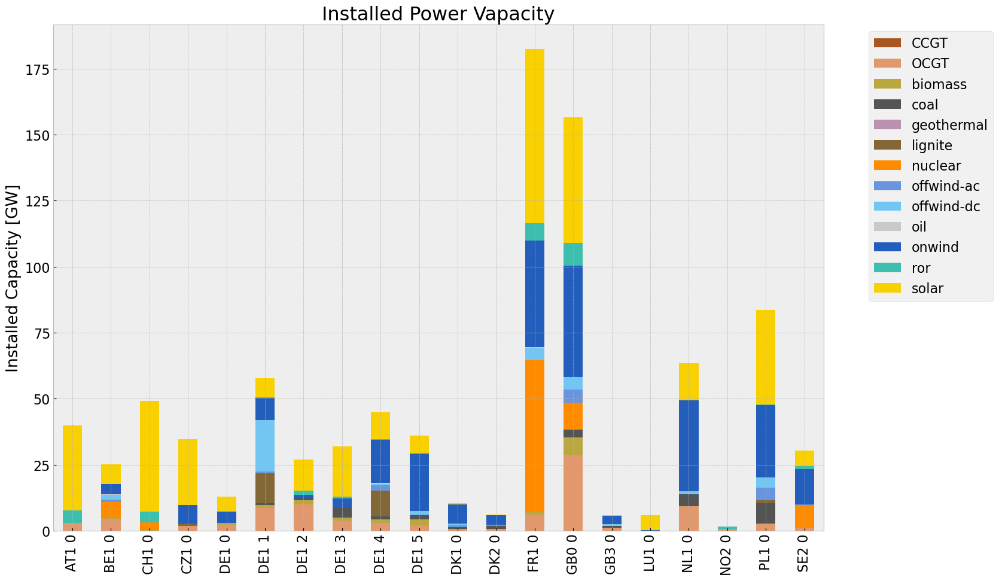

<Figure size 640x480 with 0 Axes>

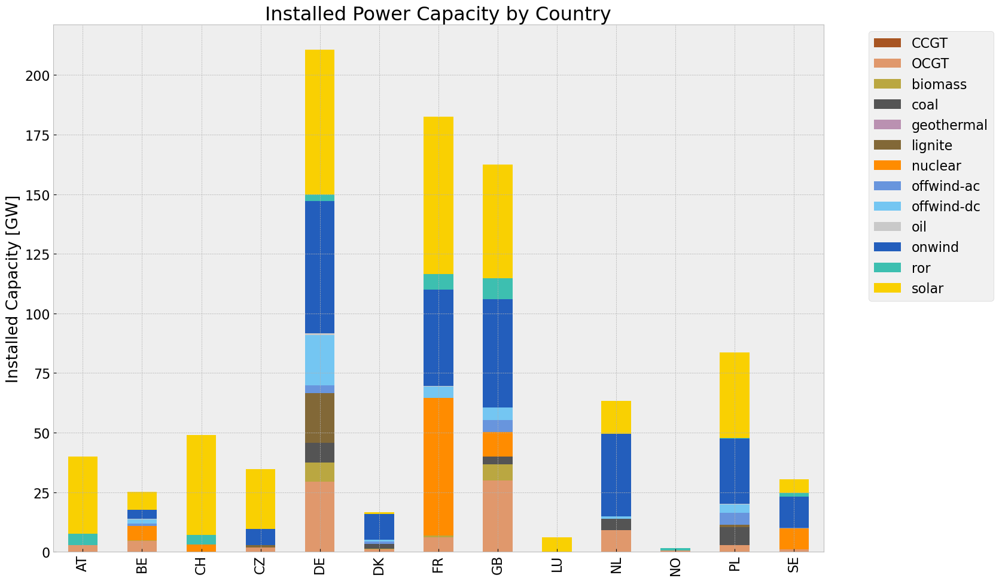

<Figure size 640x480 with 0 Axes>

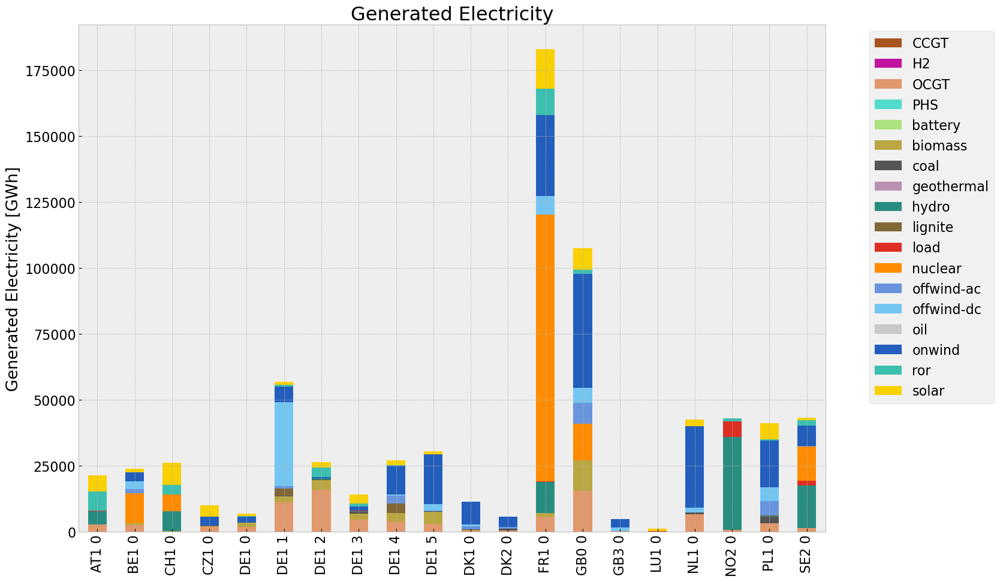

<Figure size 640x480 with 0 Axes>

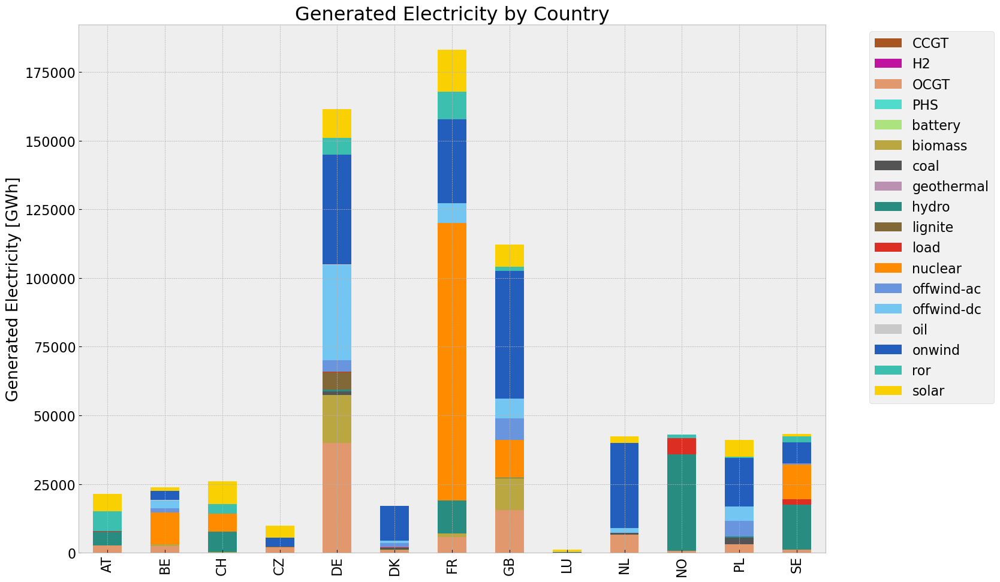

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.063134e+07,0.451621,0.1980,3.535046e+07
biomass,3.146080e+07,0.468000,0.0000,0.000000e+00
coal,5.221034e+06,0.329908,0.3361,5.319026e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.722300e+06,0.337285,0.4069,8.109777e+06
load,8.461545e+06,1.000000,0.0000,0.000000e+00
nuclear,1.456043e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.102942e+07,1.000000,0.0000,0.000000e+00


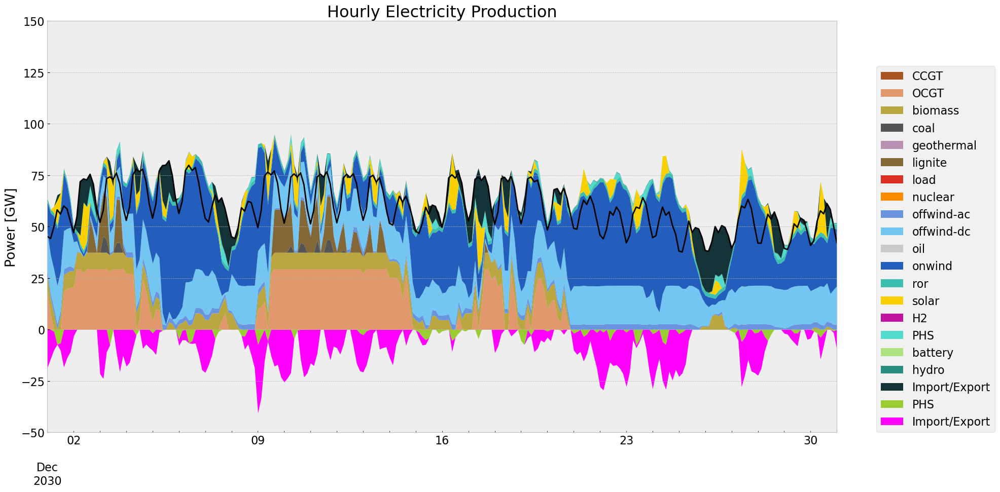

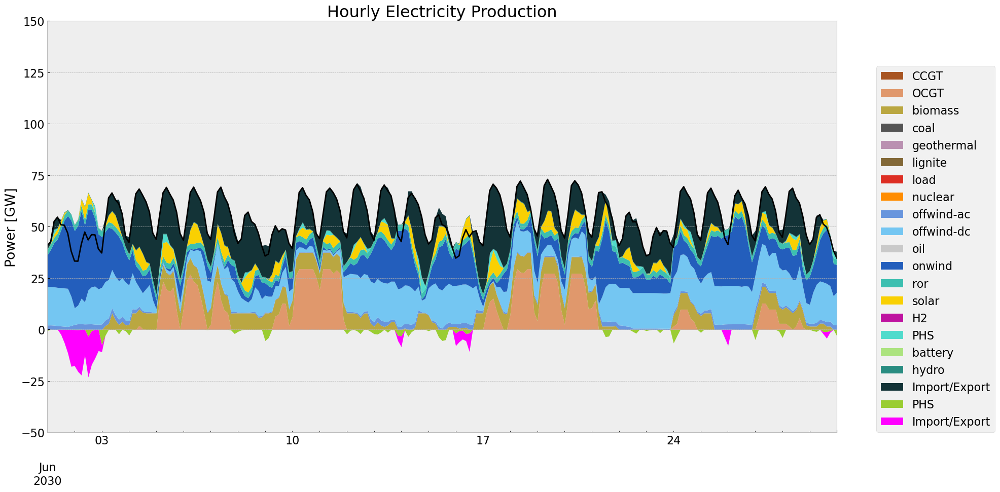

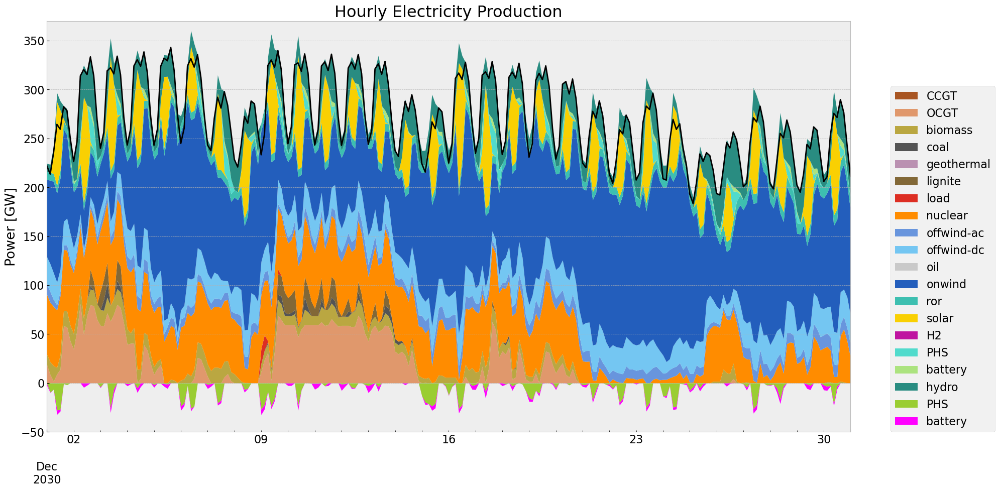

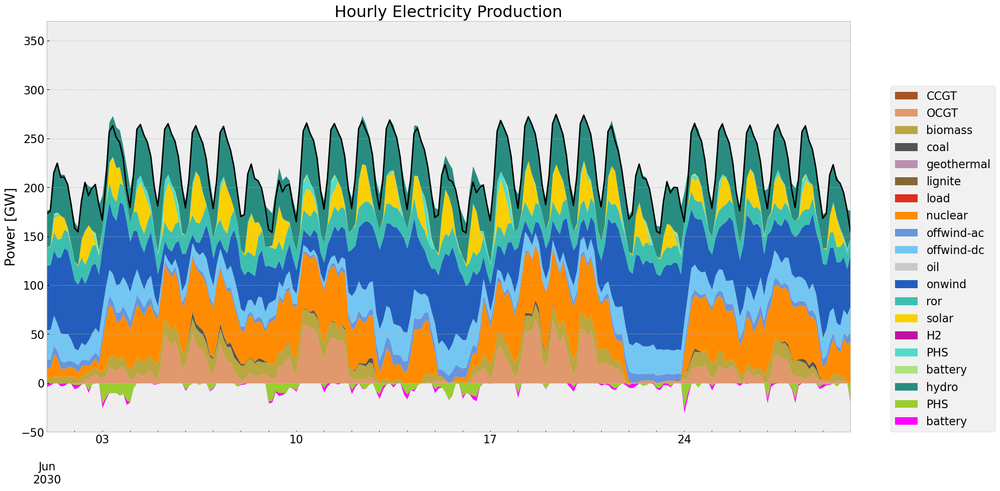

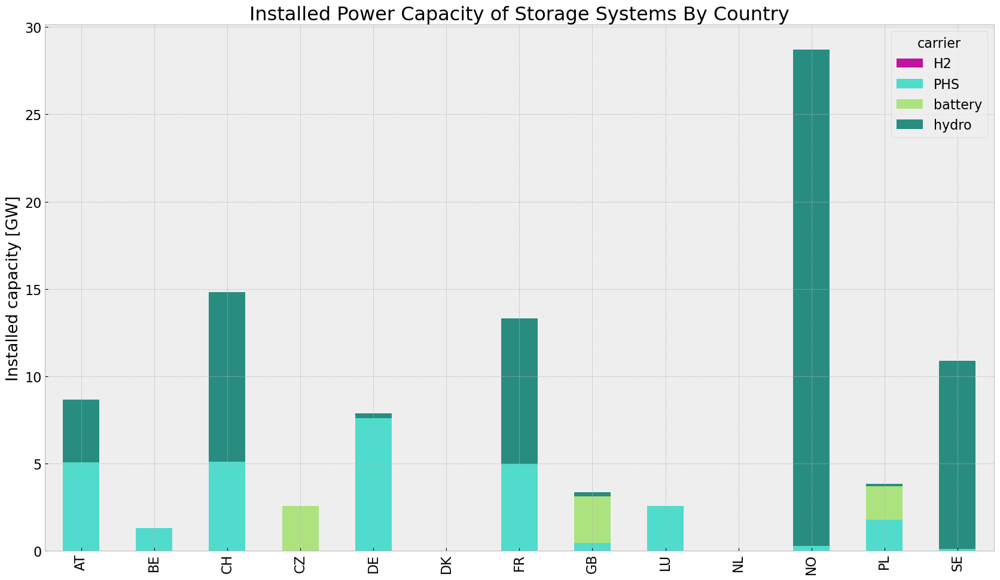

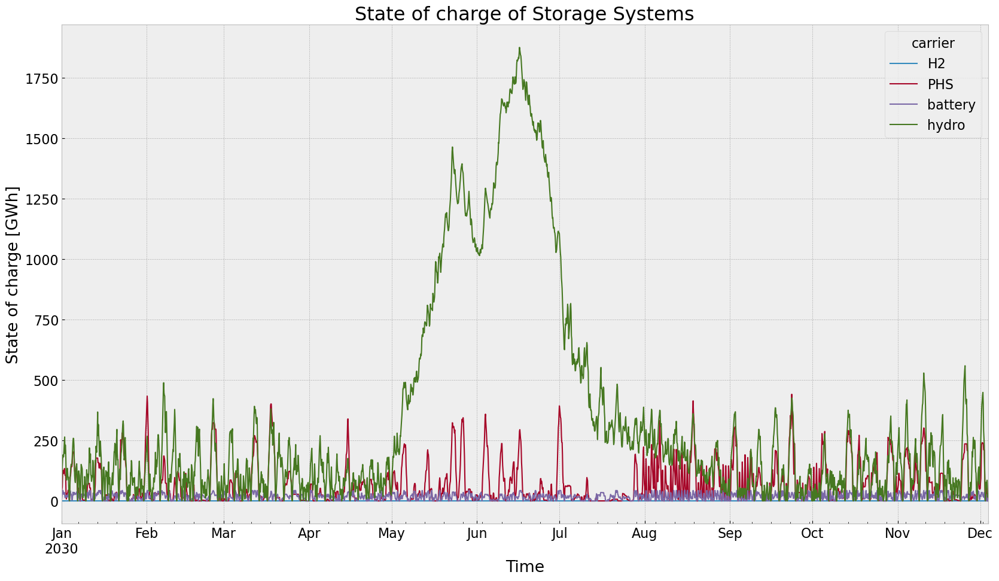

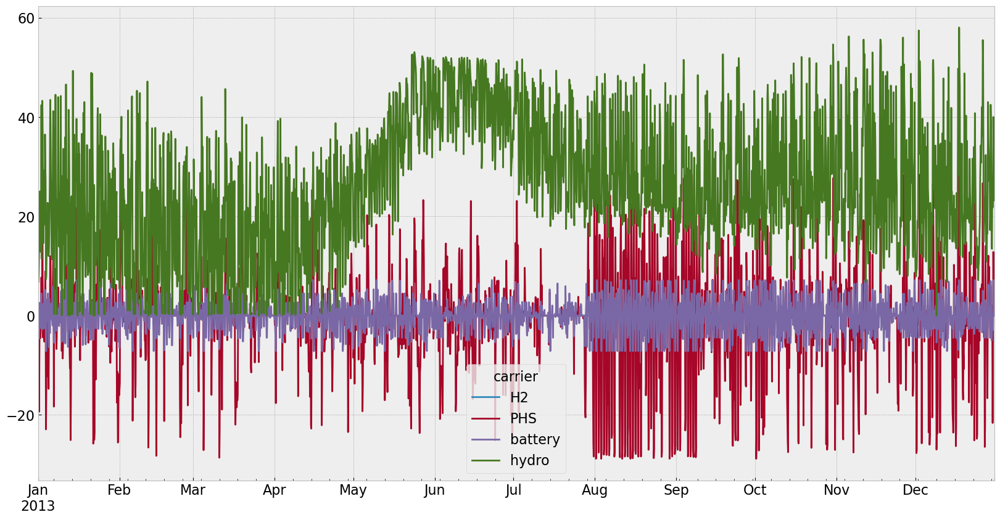

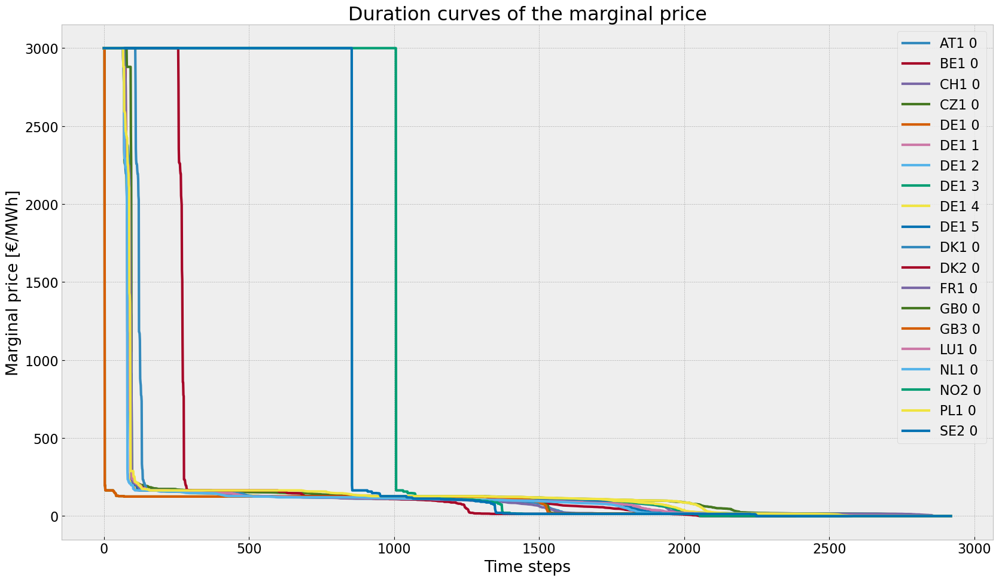

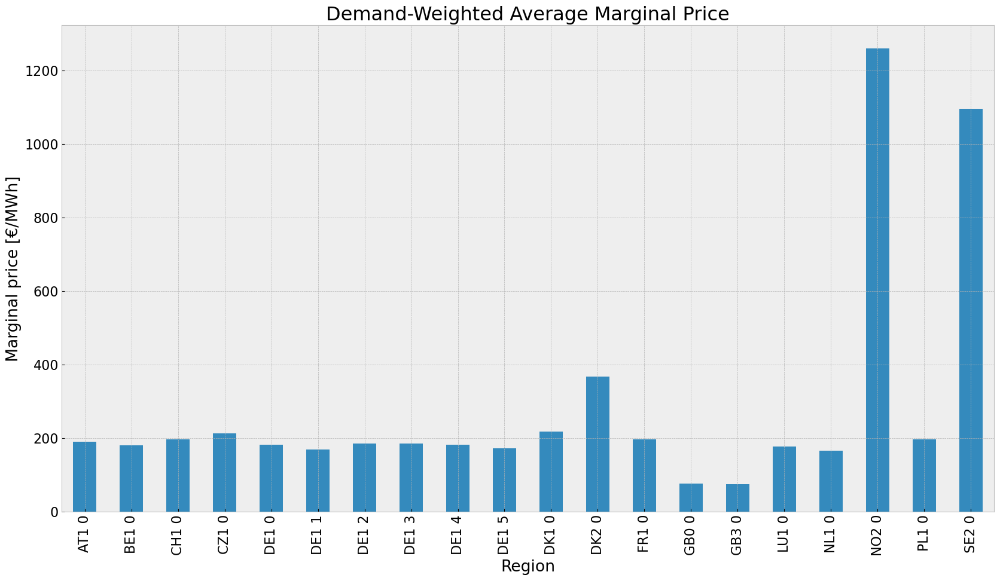

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


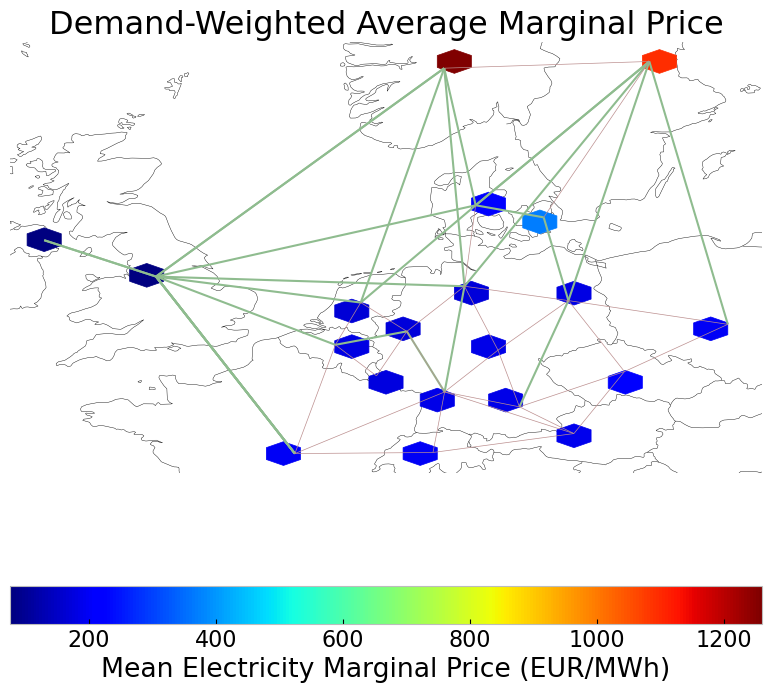

In [101]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-03 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [102]:
n4 = n1.copy()

horizon = 24

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8aeice1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8aeice1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4712f8f8


INFO:gurobipy:Model fingerprint: 0x4712f8f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25416 rows and 6432 columns


INFO:gurobipy:Presolve removed 25416 rows and 6432 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6072 columns, 10076 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6072 columns, 10076 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02489779e+11 -5.36202352e+11  9.09e+04 8.40e+03  4.78e+08     0s


INFO:gurobipy:   0   2.02489779e+11 -5.36202352e+11  9.09e+04 8.40e+03  4.78e+08     0s


   1   2.32989105e+10 -2.86063222e+11  6.00e+03 7.28e-11  4.95e+07     0s


INFO:gurobipy:   1   2.32989105e+10 -2.86063222e+11  6.00e+03 7.28e-11  4.95e+07     0s


   2   3.11229917e+09 -6.46539652e+10  3.62e+02 5.82e-11  6.47e+06     0s


INFO:gurobipy:   2   3.11229917e+09 -6.46539652e+10  3.62e+02 5.82e-11  6.47e+06     0s


   3   9.61708325e+08 -6.41714197e+09  1.74e+01 1.82e-10  6.21e+05     0s


INFO:gurobipy:   3   9.61708325e+08 -6.41714197e+09  1.74e+01 1.82e-10  6.21e+05     0s


   4   3.24081542e+08 -2.03621204e+09  2.87e+00 5.09e-11  1.95e+05     0s


INFO:gurobipy:   4   3.24081542e+08 -2.03621204e+09  2.87e+00 5.09e-11  1.95e+05     0s


   5   2.11925916e+08 -8.45717513e+08  1.64e+00 2.91e-11  8.72e+04     0s


INFO:gurobipy:   5   2.11925916e+08 -8.45717513e+08  1.64e+00 2.91e-11  8.72e+04     0s


   6   1.41526887e+08 -2.69587605e+08  9.22e-01 1.46e-11  3.39e+04     0s


INFO:gurobipy:   6   1.41526887e+08 -2.69587605e+08  9.22e-01 1.46e-11  3.39e+04     0s


   7   4.80321412e+07 -6.92109150e+07  8.02e-02 2.91e-11  9.64e+03     0s


INFO:gurobipy:   7   4.80321412e+07 -6.92109150e+07  8.02e-02 2.91e-11  9.64e+03     0s


   8   2.76586929e+07 -5.24391234e+06  1.45e-02 2.91e-11  2.71e+03     0s


INFO:gurobipy:   8   2.76586929e+07 -5.24391234e+06  1.45e-02 2.91e-11  2.71e+03     0s


   9   2.15586844e+07  8.94390931e+06  4.14e-03 2.91e-11  1.04e+03     0s


INFO:gurobipy:   9   2.15586844e+07  8.94390931e+06  4.14e-03 2.91e-11  1.04e+03     0s


  10   2.02925714e+07  1.18469573e+07  2.37e-03 2.91e-11  6.95e+02     0s


INFO:gurobipy:  10   2.02925714e+07  1.18469573e+07  2.37e-03 2.91e-11  6.95e+02     0s


  11   1.96804930e+07  1.52643882e+07  1.53e-03 1.46e-11  3.63e+02     0s


INFO:gurobipy:  11   1.96804930e+07  1.52643882e+07  1.53e-03 1.46e-11  3.63e+02     0s


  12   1.92036102e+07  1.67654373e+07  8.87e-04 1.46e-11  2.01e+02     0s


INFO:gurobipy:  12   1.92036102e+07  1.67654373e+07  8.87e-04 1.46e-11  2.01e+02     0s


  13   1.88337444e+07  1.75832091e+07  3.83e-04 1.46e-11  1.03e+02     0s


INFO:gurobipy:  13   1.88337444e+07  1.75832091e+07  3.83e-04 1.46e-11  1.03e+02     0s


  14   1.86853474e+07  1.79598636e+07  2.01e-04 1.46e-11  5.97e+01     0s


INFO:gurobipy:  14   1.86853474e+07  1.79598636e+07  2.01e-04 1.46e-11  5.97e+01     0s


  15   1.85903731e+07  1.82518273e+07  9.58e-05 1.46e-11  2.78e+01     0s


INFO:gurobipy:  15   1.85903731e+07  1.82518273e+07  9.58e-05 1.46e-11  2.78e+01     0s


  16   1.85610096e+07  1.83475100e+07  6.69e-05 1.46e-11  1.76e+01     0s


INFO:gurobipy:  16   1.85610096e+07  1.83475100e+07  6.69e-05 1.46e-11  1.76e+01     0s


  17   1.85463368e+07  1.84108239e+07  5.29e-05 1.46e-11  1.11e+01     0s


INFO:gurobipy:  17   1.85463368e+07  1.84108239e+07  5.29e-05 1.46e-11  1.11e+01     0s


  18   1.85251761e+07  1.84386081e+07  3.34e-05 2.91e-11  7.12e+00     0s


INFO:gurobipy:  18   1.85251761e+07  1.84386081e+07  3.34e-05 2.91e-11  7.12e+00     0s


  19   1.85064719e+07  1.84588384e+07  1.71e-05 1.46e-11  3.92e+00     0s


INFO:gurobipy:  19   1.85064719e+07  1.84588384e+07  1.71e-05 1.46e-11  3.92e+00     0s


  20   1.84952138e+07  1.84778183e+07  6.77e-06 2.91e-11  1.43e+00     0s


INFO:gurobipy:  20   1.84952138e+07  1.84778183e+07  6.77e-06 2.91e-11  1.43e+00     0s


  21   1.84892291e+07  1.84837382e+07  2.49e-06 2.91e-11  4.52e-01     0s


INFO:gurobipy:  21   1.84892291e+07  1.84837382e+07  2.49e-06 2.91e-11  4.52e-01     0s


  22   1.84878238e+07  1.84843342e+07  1.53e-06 1.78e-11  2.87e-01     0s


INFO:gurobipy:  22   1.84878238e+07  1.84843342e+07  1.53e-06 1.78e-11  2.87e-01     0s


  23   1.84865069e+07  1.84850386e+07  6.48e-07 1.58e-11  1.21e-01     0s


INFO:gurobipy:  23   1.84865069e+07  1.84850386e+07  6.48e-07 1.58e-11  1.21e-01     0s


  24   1.84858987e+07  1.84853474e+07  2.50e-07 2.91e-11  4.53e-02     0s


INFO:gurobipy:  24   1.84858987e+07  1.84853474e+07  2.50e-07 2.91e-11  4.53e-02     0s


  25   1.84856032e+07  1.84854363e+07  6.43e-08 1.46e-11  1.37e-02     0s


INFO:gurobipy:  25   1.84856032e+07  1.84854363e+07  6.43e-08 1.46e-11  1.37e-02     0s


  26   1.84855075e+07  1.84854912e+07  6.19e-09 2.91e-11  1.34e-03     0s


INFO:gurobipy:  26   1.84855075e+07  1.84854912e+07  6.19e-09 2.91e-11  1.34e-03     0s


  27   1.84854968e+07  1.84854959e+07  1.46e-09 2.91e-11  7.50e-05     0s


INFO:gurobipy:  27   1.84854968e+07  1.84854959e+07  1.46e-09 2.91e-11  7.50e-05     0s


  28   1.84854964e+07  1.84854963e+07  9.19e-10 2.91e-11  5.68e-06     0s


INFO:gurobipy:  28   1.84854964e+07  1.84854963e+07  9.19e-10 2.91e-11  5.68e-06     0s


  29   1.84854963e+07  1.84854963e+07  8.16e-10 2.91e-11  1.14e-09     0s


INFO:gurobipy:  29   1.84854963e+07  1.84854963e+07  8.16e-10 2.91e-11  1.14e-09     0s


INFO:gurobipy:


Barrier solved model in 29 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 29 iterations and 0.34 seconds (0.07 work units)


Optimal objective 1.84854963e+07


INFO:gurobipy:Optimal objective 1.84854963e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     147 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     147 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     163 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     163 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2395    1.8485496e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2395    1.8485496e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2395 iterations and 0.43 seconds (0.07 work units)


INFO:gurobipy:Solved in 2395 iterations and 0.43 seconds (0.07 work units)


Optimal objective  1.848549635e+07


INFO:gurobipy:Optimal objective  1.848549635e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yffwyfvi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yffwyfvi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x28a9fa75


INFO:gurobipy:Model fingerprint: 0x28a9fa75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25420 rows and 6371 columns


INFO:gurobipy:Presolve removed 25420 rows and 6371 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1412 rows, 6133 columns, 10133 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6133 columns, 10133 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 4.198e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.198e+04 (roughly 3 MB of memory)


 Factor Ops : 2.359e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.359e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.19297942e+11 -5.23436665e+11  9.15e+04 8.37e+03  4.78e+08     0s


INFO:gurobipy:   0   2.19297942e+11 -5.23436665e+11  9.15e+04 8.37e+03  4.78e+08     0s


   1   3.13926448e+10 -2.86416589e+11  6.98e+03 7.28e-11  5.39e+07     0s


INFO:gurobipy:   1   3.13926448e+10 -2.86416589e+11  6.98e+03 7.28e-11  5.39e+07     0s


   2   4.84882751e+09 -6.35730834e+10  4.33e+02 8.73e-11  6.69e+06     0s


INFO:gurobipy:   2   4.84882751e+09 -6.35730834e+10  4.33e+02 8.73e-11  6.69e+06     0s


   3   1.18574099e+09 -7.88115219e+09  1.89e+01 1.16e-10  7.57e+05     0s


INFO:gurobipy:   3   1.18574099e+09 -7.88115219e+09  1.89e+01 1.16e-10  7.57e+05     0s


   4   6.01846462e+08 -1.72249902e+09  3.67e+00 1.16e-10  1.90e+05     0s


INFO:gurobipy:   4   6.01846462e+08 -1.72249902e+09  3.67e+00 1.16e-10  1.90e+05     0s


   5   4.07929358e+08 -5.38287523e+08  1.53e+00 4.37e-11  7.73e+04     0s


INFO:gurobipy:   5   4.07929358e+08 -5.38287523e+08  1.53e+00 4.37e-11  7.73e+04     0s


   6   2.82324730e+08 -1.64582914e+08  7.93e-01 1.46e-11  3.65e+04     0s


INFO:gurobipy:   6   2.82324730e+08 -1.64582914e+08  7.93e-01 1.46e-11  3.65e+04     0s


   7   1.70126085e+08 -3.35579165e+07  1.98e-01 1.46e-11  1.66e+04     0s


INFO:gurobipy:   7   1.70126085e+08 -3.35579165e+07  1.98e-01 1.46e-11  1.66e+04     0s


   8   1.40854148e+08  4.96939062e+07  8.84e-02 1.46e-11  7.43e+03     0s


INFO:gurobipy:   8   1.40854148e+08  4.96939062e+07  8.84e-02 1.46e-11  7.43e+03     0s


   9   1.24547122e+08  8.51524422e+07  3.86e-02 1.46e-11  3.21e+03     0s


INFO:gurobipy:   9   1.24547122e+08  8.51524422e+07  3.86e-02 1.46e-11  3.21e+03     0s


  10   1.17875483e+08  9.66681738e+07  2.05e-02 9.09e-12  1.73e+03     0s


INFO:gurobipy:  10   1.17875483e+08  9.66681738e+07  2.05e-02 9.09e-12  1.73e+03     0s


  11   1.14110554e+08  1.02197222e+08  1.07e-02 5.46e-12  9.70e+02     0s


INFO:gurobipy:  11   1.14110554e+08  1.02197222e+08  1.07e-02 5.46e-12  9.70e+02     0s


  12   1.12621055e+08  1.04481535e+08  6.97e-03 3.64e-12  6.63e+02     0s


INFO:gurobipy:  12   1.12621055e+08  1.04481535e+08  6.97e-03 3.64e-12  6.63e+02     0s


  13   1.11036263e+08  1.07642173e+08  3.03e-03 1.96e-12  2.76e+02     0s


INFO:gurobipy:  13   1.11036263e+08  1.07642173e+08  3.03e-03 1.96e-12  2.76e+02     0s


  14   1.09919990e+08  1.09111739e+08  3.69e-04 1.11e-11  6.58e+01     0s


INFO:gurobipy:  14   1.09919990e+08  1.09111739e+08  3.69e-04 1.11e-11  6.58e+01     0s


  15   1.09787184e+08  1.09504929e+08  1.16e-04 1.29e-12  2.30e+01     0s


INFO:gurobipy:  15   1.09787184e+08  1.09504929e+08  1.16e-04 1.29e-12  2.30e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2026    1.0971571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2026    1.0971571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2026 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2026 iterations and 0.30 seconds (0.07 work units)


Optimal objective  1.097157055e+08


INFO:gurobipy:Optimal objective  1.097157055e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a3xaotxw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a3xaotxw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd06250fd


INFO:gurobipy:Model fingerprint: 0xd06250fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25421 rows and 6379 columns


INFO:gurobipy:Presolve removed 25421 rows and 6379 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1411 rows, 6125 columns, 10124 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6125 columns, 10124 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.143e+03


INFO:gurobipy: AA' NZ     : 4.143e+03


 Factor NZ  : 4.249e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.249e+04 (roughly 3 MB of memory)


 Factor Ops : 2.427e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.427e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.59354056e+11 -5.07848184e+11  9.86e+04 7.28e+03  5.12e+08     0s


INFO:gurobipy:   0   2.59354056e+11 -5.07848184e+11  9.86e+04 7.28e+03  5.12e+08     0s


   1   3.80345577e+10 -2.75383045e+11  6.51e+03 7.28e-11  5.17e+07     0s


INFO:gurobipy:   1   3.80345577e+10 -2.75383045e+11  6.51e+03 7.28e-11  5.17e+07     0s


   2   9.53133318e+09 -6.04460934e+10  3.75e+02 2.04e-10  6.69e+06     0s


INFO:gurobipy:   2   9.53133318e+09 -6.04460934e+10  3.75e+02 2.04e-10  6.69e+06     0s


   3   3.28414741e+09 -1.39843871e+10  8.90e+01 5.38e-10  1.53e+06     0s


INFO:gurobipy:   3   3.28414741e+09 -1.39843871e+10  8.90e+01 5.38e-10  1.53e+06     0s


   4   1.81327196e+09 -3.75573242e+09  3.06e+01 1.89e-10  4.75e+05     0s


INFO:gurobipy:   4   1.81327196e+09 -3.75573242e+09  3.06e+01 1.89e-10  4.75e+05     0s


   5   1.12410481e+09 -9.07199661e+08  4.76e+00 8.00e-11  1.67e+05     0s


INFO:gurobipy:   5   1.12410481e+09 -9.07199661e+08  4.76e+00 8.00e-11  1.67e+05     0s


   6   1.03259806e+09  2.78837617e+08  2.07e+00 2.91e-11  6.17e+04     0s


INFO:gurobipy:   6   1.03259806e+09  2.78837617e+08  2.07e+00 2.91e-11  6.17e+04     0s


   7   9.45155166e+08  5.95649982e+08  6.22e-01 1.46e-11  2.85e+04     0s


INFO:gurobipy:   7   9.45155166e+08  5.95649982e+08  6.22e-01 1.46e-11  2.85e+04     0s


   8   9.01230323e+08  7.62350444e+08  3.09e-01 2.91e-11  1.13e+04     0s


INFO:gurobipy:   8   9.01230323e+08  7.62350444e+08  3.09e-01 2.91e-11  1.13e+04     0s


   9   8.72063038e+08  7.87659392e+08  1.55e-01 1.96e-11  6.88e+03     0s


INFO:gurobipy:   9   8.72063038e+08  7.87659392e+08  1.55e-01 1.96e-11  6.88e+03     0s


  10   8.58265696e+08  8.10562325e+08  8.99e-02 2.91e-11  3.89e+03     0s


INFO:gurobipy:  10   8.58265696e+08  8.10562325e+08  8.99e-02 2.91e-11  3.89e+03     0s


  11   8.48562069e+08  8.23932422e+08  4.84e-02 2.91e-11  2.01e+03     0s


INFO:gurobipy:  11   8.48562069e+08  8.23932422e+08  4.84e-02 2.91e-11  2.01e+03     0s


  12   8.40916335e+08  8.31203060e+08  1.83e-02 2.91e-11  7.92e+02     0s


INFO:gurobipy:  12   8.40916335e+08  8.31203060e+08  1.83e-02 2.91e-11  7.92e+02     0s


  13   8.37761447e+08  8.34285332e+08  5.79e-03 2.91e-11  2.83e+02     0s


INFO:gurobipy:  13   8.37761447e+08  8.34285332e+08  5.79e-03 2.91e-11  2.83e+02     0s


  14   8.36405377e+08  8.35411750e+08  9.47e-04 2.03e-11  8.10e+01     0s


INFO:gurobipy:  14   8.36405377e+08  8.35411750e+08  9.47e-04 2.03e-11  8.10e+01     0s


  15   8.36162253e+08  8.35822106e+08  2.38e-04 3.01e-11  2.77e+01     0s


INFO:gurobipy:  15   8.36162253e+08  8.35822106e+08  2.38e-04 3.01e-11  2.77e+01     0s


  16   8.36108285e+08  8.35955606e+08  8.52e-05 2.91e-11  1.24e+01     0s


INFO:gurobipy:  16   8.36108285e+08  8.35955606e+08  8.52e-05 2.91e-11  1.24e+01     0s


  17   8.36086273e+08  8.36022771e+08  2.97e-05 1.46e-11  5.18e+00     0s


INFO:gurobipy:  17   8.36086273e+08  8.36022771e+08  2.97e-05 1.46e-11  5.18e+00     0s


  18   8.36077985e+08  8.36049404e+08  1.07e-05 1.95e-11  2.33e+00     0s


INFO:gurobipy:  18   8.36077985e+08  8.36049404e+08  1.07e-05 1.95e-11  2.33e+00     0s


  19   8.36073371e+08  8.36063193e+08  1.54e-06 2.91e-11  8.30e-01     0s


INFO:gurobipy:  19   8.36073371e+08  8.36063193e+08  1.54e-06 2.91e-11  8.30e-01     0s


  20   8.36072364e+08  8.36070485e+08  1.26e-07 2.91e-11  1.53e-01     0s


INFO:gurobipy:  20   8.36072364e+08  8.36070485e+08  1.26e-07 2.91e-11  1.53e-01     0s


  21   8.36072209e+08  8.36071698e+08  1.74e-08 1.95e-11  4.16e-02     0s


INFO:gurobipy:  21   8.36072209e+08  8.36071698e+08  1.74e-08 1.95e-11  4.16e-02     0s


  22   8.36072181e+08  8.36071985e+08  6.82e-09 2.91e-11  1.60e-02     0s


INFO:gurobipy:  22   8.36072181e+08  8.36071985e+08  6.82e-09 2.91e-11  1.60e-02     0s


  23   8.36072166e+08  8.36072110e+08  2.07e-09 2.91e-11  4.52e-03     0s


INFO:gurobipy:  23   8.36072166e+08  8.36072110e+08  2.07e-09 2.91e-11  4.52e-03     0s


  24   8.36072158e+08  8.36072148e+08  3.35e-10 2.91e-11  8.49e-04     0s


INFO:gurobipy:  24   8.36072158e+08  8.36072148e+08  3.35e-10 2.91e-11  8.49e-04     0s


  25   8.36072156e+08  8.36072156e+08  3.68e-10 2.91e-11  2.62e-05     0s


INFO:gurobipy:  25   8.36072156e+08  8.36072156e+08  3.68e-10 2.91e-11  2.62e-05     0s


  26   8.36072156e+08  8.36072156e+08  3.60e-10 2.91e-11  2.39e-07     0s


INFO:gurobipy:  26   8.36072156e+08  8.36072156e+08  3.60e-10 2.91e-11  2.39e-07     0s


  27   8.36072156e+08  8.36072156e+08  2.57e-11 2.91e-11  2.39e-10     0s


INFO:gurobipy:  27   8.36072156e+08  8.36072156e+08  2.57e-11 2.91e-11  2.39e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.31 seconds (0.06 work units)


Optimal objective 8.36072156e+08


INFO:gurobipy:Optimal objective 8.36072156e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2204    8.3607216e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2204    8.3607216e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2204 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 2204 iterations and 0.35 seconds (0.07 work units)


Optimal objective  8.360721564e+08


INFO:gurobipy:Optimal objective  8.360721564e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63q1d2oj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63q1d2oj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6e0f8294


INFO:gurobipy:Model fingerprint: 0x6e0f8294


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6361 columns


INFO:gurobipy:Presolve removed 25416 rows and 6361 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1416 rows, 6143 columns, 10147 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6143 columns, 10147 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59081522e+11 -5.05576951e+11  5.77e+04 9.37e+03  3.12e+08     0s


INFO:gurobipy:   0   1.59081522e+11 -5.05576951e+11  5.77e+04 9.37e+03  3.12e+08     0s


   1   2.61689173e+10 -2.33472508e+11  4.28e+03 8.73e-11  3.73e+07     0s


INFO:gurobipy:   1   2.61689173e+10 -2.33472508e+11  4.28e+03 8.73e-11  3.73e+07     0s


   2   6.60585536e+09 -4.97232238e+10  2.62e+02 3.06e-10  5.19e+06     0s


INFO:gurobipy:   2   6.60585536e+09 -4.97232238e+10  2.62e+02 3.06e-10  5.19e+06     0s


   3   2.39354574e+09 -1.32265326e+10  7.33e+01 4.80e-10  1.36e+06     0s


INFO:gurobipy:   3   2.39354574e+09 -1.32265326e+10  7.33e+01 4.80e-10  1.36e+06     0s


   4   1.36754843e+09 -1.77842807e+09  1.52e+01 2.47e-10  2.62e+05     0s


INFO:gurobipy:   4   1.36754843e+09 -1.77842807e+09  1.52e+01 2.47e-10  2.62e+05     0s


   5   1.00539329e+09 -3.58997372e+08  4.55e+00 7.28e-11  1.12e+05     0s


INFO:gurobipy:   5   1.00539329e+09 -3.58997372e+08  4.55e+00 7.28e-11  1.12e+05     0s


   6   8.60875336e+08  2.39930654e+08  1.88e+00 2.91e-11  5.07e+04     0s


INFO:gurobipy:   6   8.60875336e+08  2.39930654e+08  1.88e+00 2.91e-11  5.07e+04     0s


   7   7.69439165e+08  5.07849200e+08  6.87e-01 1.66e-11  2.13e+04     0s


INFO:gurobipy:   7   7.69439165e+08  5.07849200e+08  6.87e-01 1.66e-11  2.13e+04     0s


   8   7.09649140e+08  6.24968622e+08  1.40e-01 1.58e-11  6.89e+03     0s


INFO:gurobipy:   8   7.09649140e+08  6.24968622e+08  1.40e-01 1.58e-11  6.89e+03     0s


   9   6.93049943e+08  6.57110445e+08  5.73e-02 1.94e-11  2.92e+03     0s


INFO:gurobipy:   9   6.93049943e+08  6.57110445e+08  5.73e-02 1.94e-11  2.92e+03     0s


  10   6.88447199e+08  6.67904191e+08  3.75e-02 2.55e-11  1.67e+03     0s


INFO:gurobipy:  10   6.88447199e+08  6.67904191e+08  3.75e-02 2.55e-11  1.67e+03     0s


  11   6.84555268e+08  6.72937176e+08  2.13e-02 1.97e-11  9.45e+02     0s


INFO:gurobipy:  11   6.84555268e+08  6.72937176e+08  2.13e-02 1.97e-11  9.45e+02     0s


  12   6.82804424e+08  6.75321424e+08  1.44e-02 1.55e-11  6.09e+02     0s


INFO:gurobipy:  12   6.82804424e+08  6.75321424e+08  1.44e-02 1.55e-11  6.09e+02     0s


  13   6.81750812e+08  6.76863294e+08  1.03e-02 2.40e-11  3.97e+02     0s


INFO:gurobipy:  13   6.81750812e+08  6.76863294e+08  1.03e-02 2.40e-11  3.97e+02     0s


  14   6.79898197e+08  6.78263368e+08  2.72e-03 2.19e-11  1.33e+02     0s


INFO:gurobipy:  14   6.79898197e+08  6.78263368e+08  2.72e-03 2.19e-11  1.33e+02     0s


  15   6.79549172e+08  6.78556705e+08  1.49e-03 1.20e-11  8.07e+01     0s


INFO:gurobipy:  15   6.79549172e+08  6.78556705e+08  1.49e-03 1.20e-11  8.07e+01     0s


  16   6.79317063e+08  6.78798994e+08  7.24e-04 1.46e-11  4.21e+01     0s


INFO:gurobipy:  16   6.79317063e+08  6.78798994e+08  7.24e-04 1.46e-11  4.21e+01     0s


  17   6.79162460e+08  6.78988473e+08  2.51e-04 1.96e-11  1.41e+01     0s


INFO:gurobipy:  17   6.79162460e+08  6.78988473e+08  2.51e-04 1.96e-11  1.41e+01     0s


  18   6.79122401e+08  6.79018977e+08  1.37e-04 1.81e-11  8.41e+00     0s


INFO:gurobipy:  18   6.79122401e+08  6.79018977e+08  1.37e-04 1.81e-11  8.41e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1958    6.7907157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1958    6.7907157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1958 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1958 iterations and 0.30 seconds (0.06 work units)


Optimal objective  6.790715683e+08


INFO:gurobipy:Optimal objective  6.790715683e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92uvzvcc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92uvzvcc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67305ca0


INFO:gurobipy:Model fingerprint: 0x67305ca0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25419 rows and 6387 columns


INFO:gurobipy:Presolve removed 25419 rows and 6387 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1413 rows, 6117 columns, 10118 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 6117 columns, 10118 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.145e+03


INFO:gurobipy: AA' NZ     : 4.145e+03


 Factor NZ  : 3.956e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.956e+04 (roughly 3 MB of memory)


 Factor Ops : 2.069e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.069e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.56116419e+11 -4.99923033e+11  9.49e+04 9.37e+03  4.92e+08     0s


INFO:gurobipy:   0   2.56116419e+11 -4.99923033e+11  9.49e+04 9.37e+03  4.92e+08     0s


   1   3.85201071e+10 -2.74920684e+11  6.27e+03 7.28e-11  5.07e+07     0s


INFO:gurobipy:   1   3.85201071e+10 -2.74920684e+11  6.27e+03 7.28e-11  5.07e+07     0s


   2   1.01826447e+10 -6.19785308e+10  3.75e+02 2.91e-10  6.88e+06     0s


INFO:gurobipy:   2   1.01826447e+10 -6.19785308e+10  3.75e+02 2.91e-10  6.88e+06     0s


   3   3.11950997e+09 -1.09317820e+10  7.23e+01 2.04e-10  1.24e+06     0s


INFO:gurobipy:   3   3.11950997e+09 -1.09317820e+10  7.23e+01 2.04e-10  1.24e+06     0s


   4   1.79758383e+09 -2.31791168e+09  1.47e+01 1.02e-10  3.44e+05     0s


INFO:gurobipy:   4   1.79758383e+09 -2.31791168e+09  1.47e+01 1.02e-10  3.44e+05     0s


   5   1.21696592e+09  3.58355105e+07  7.63e-01 4.37e-11  9.66e+04     0s


INFO:gurobipy:   5   1.21696592e+09  3.58355105e+07  7.63e-01 4.37e-11  9.66e+04     0s


   6   1.14996097e+09  6.44108878e+08  2.79e-01 2.91e-11  4.13e+04     0s


INFO:gurobipy:   6   1.14996097e+09  6.44108878e+08  2.79e-01 2.91e-11  4.13e+04     0s


   7   1.09143489e+09  8.58584038e+08  5.04e-02 1.46e-11  1.90e+04     0s


INFO:gurobipy:   7   1.09143489e+09  8.58584038e+08  5.04e-02 1.46e-11  1.90e+04     0s


   8   1.06899875e+09  9.54380850e+08  2.25e-02 1.79e-11  9.36e+03     0s


INFO:gurobipy:   8   1.06899875e+09  9.54380850e+08  2.25e-02 1.79e-11  9.36e+03     0s


   9   1.05030260e+09  1.01822429e+09  5.50e-03 2.91e-11  2.62e+03     0s


INFO:gurobipy:   9   1.05030260e+09  1.01822429e+09  5.50e-03 2.91e-11  2.62e+03     0s


  10   1.04486878e+09  1.03039184e+09  2.20e-03 2.91e-11  1.18e+03     0s


INFO:gurobipy:  10   1.04486878e+09  1.03039184e+09  2.20e-03 2.91e-11  1.18e+03     0s


  11   1.04403738e+09  1.03619990e+09  1.74e-03 1.55e-11  6.40e+02     0s


INFO:gurobipy:  11   1.04403738e+09  1.03619990e+09  1.74e-03 1.55e-11  6.40e+02     0s


  12   1.04253467e+09  1.03838709e+09  9.02e-04 1.52e-11  3.39e+02     0s


INFO:gurobipy:  12   1.04253467e+09  1.03838709e+09  9.02e-04 1.52e-11  3.39e+02     0s


  13   1.04164676e+09  1.03943618e+09  4.10e-04 2.91e-11  1.80e+02     0s


INFO:gurobipy:  13   1.04164676e+09  1.03943618e+09  4.10e-04 2.91e-11  1.80e+02     0s


  14   1.04140896e+09  1.04015393e+09  2.85e-04 1.46e-11  1.02e+02     0s


INFO:gurobipy:  14   1.04140896e+09  1.04015393e+09  2.85e-04 1.46e-11  1.02e+02     0s


  15   1.04119241e+09  1.04050246e+09  1.72e-04 2.01e-11  5.63e+01     0s


INFO:gurobipy:  15   1.04119241e+09  1.04050246e+09  1.72e-04 2.01e-11  5.63e+01     0s


  16   1.04093772e+09  1.04066794e+09  4.08e-05 2.91e-11  2.20e+01     0s


INFO:gurobipy:  16   1.04093772e+09  1.04066794e+09  4.08e-05 2.91e-11  2.20e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.29 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.29 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1898    1.0408430e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1898    1.0408430e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1898 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1898 iterations and 0.32 seconds (0.06 work units)


Optimal objective  1.040842953e+09


INFO:gurobipy:Optimal objective  1.040842953e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-utp6opmb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-utp6opmb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5e6186c8


INFO:gurobipy:Model fingerprint: 0x5e6186c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25422 rows and 6430 columns


INFO:gurobipy:Presolve removed 25422 rows and 6430 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1410 rows, 6074 columns, 10072 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6074 columns, 10072 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.54441741e+11 -4.99605658e+11  9.46e+04 9.43e+03  4.90e+08     0s


INFO:gurobipy:   0   2.54441741e+11 -4.99605658e+11  9.46e+04 9.43e+03  4.90e+08     0s


   1   3.93983543e+10 -2.73380405e+11  6.16e+03 7.28e-11  5.03e+07     0s


INFO:gurobipy:   1   3.93983543e+10 -2.73380405e+11  6.16e+03 7.28e-11  5.03e+07     0s


   2   1.30200173e+10 -5.14706227e+10  4.04e+02 3.46e-09  6.35e+06     0s


INFO:gurobipy:   2   1.30200173e+10 -5.14706227e+10  4.04e+02 3.46e-09  6.35e+06     0s


   3   6.18254138e+09 -8.69724910e+09  6.78e+01 7.28e-10  1.32e+06     0s


INFO:gurobipy:   3   6.18254138e+09 -8.69724910e+09  6.78e+01 7.28e-10  1.32e+06     0s


   4   4.02464663e+09 -5.35435461e+08  2.01e+01 3.35e-10  3.94e+05     0s


INFO:gurobipy:   4   4.02464663e+09 -5.35435461e+08  2.01e+01 3.35e-10  3.94e+05     0s


   5   3.41828042e+09  1.17981681e+09  9.20e+00 1.75e-10  1.91e+05     0s


INFO:gurobipy:   5   3.41828042e+09  1.17981681e+09  9.20e+00 1.75e-10  1.91e+05     0s


   6   3.17026388e+09  1.86286040e+09  4.71e+00 1.02e-10  1.11e+05     0s


INFO:gurobipy:   6   3.17026388e+09  1.86286040e+09  4.71e+00 1.02e-10  1.11e+05     0s


   7   3.02520582e+09  2.51375204e+09  2.37e+00 1.02e-10  4.34e+04     0s


INFO:gurobipy:   7   3.02520582e+09  2.51375204e+09  2.37e+00 1.02e-10  4.34e+04     0s


   8   2.87824121e+09  2.70433268e+09  4.14e-01 7.28e-11  1.45e+04     0s


INFO:gurobipy:   8   2.87824121e+09  2.70433268e+09  4.14e-01 7.28e-11  1.45e+04     0s


   9   2.84993829e+09  2.77027280e+09  1.94e-01 4.37e-11  6.65e+03     0s


INFO:gurobipy:   9   2.84993829e+09  2.77027280e+09  1.94e-01 4.37e-11  6.65e+03     0s


  10   2.84295440e+09  2.79620773e+09  1.46e-01 2.91e-11  3.92e+03     0s


INFO:gurobipy:  10   2.84295440e+09  2.79620773e+09  1.46e-01 2.91e-11  3.92e+03     0s


  11   2.83286257e+09  2.80840726e+09  8.13e-02 2.91e-11  2.05e+03     0s


INFO:gurobipy:  11   2.83286257e+09  2.80840726e+09  8.13e-02 2.91e-11  2.05e+03     0s


  12   2.82711190e+09  2.81477414e+09  4.48e-02 2.91e-11  1.04e+03     0s


INFO:gurobipy:  12   2.82711190e+09  2.81477414e+09  4.48e-02 2.91e-11  1.04e+03     0s


  13   2.82321031e+09  2.81853903e+09  1.96e-02 2.91e-11  3.94e+02     0s


INFO:gurobipy:  13   2.82321031e+09  2.81853903e+09  1.96e-02 2.91e-11  3.94e+02     0s


  14   2.82088371e+09  2.81886336e+09  5.89e-03 2.91e-11  1.69e+02     0s


INFO:gurobipy:  14   2.82088371e+09  2.81886336e+09  5.89e-03 2.91e-11  1.69e+02     0s


  15   2.82021747e+09  2.81971331e+09  1.99e-03 2.91e-11  4.24e+01     0s


INFO:gurobipy:  15   2.82021747e+09  2.81971331e+09  1.99e-03 2.91e-11  4.24e+01     0s


  16   2.82000519e+09  2.81976970e+09  8.58e-04 2.91e-11  1.98e+01     0s


INFO:gurobipy:  16   2.82000519e+09  2.81976970e+09  8.58e-04 2.91e-11  1.98e+01     0s


  17   2.81995012e+09  2.81980690e+09  5.69e-04 2.91e-11  1.21e+01     0s


INFO:gurobipy:  17   2.81995012e+09  2.81980690e+09  5.69e-04 2.91e-11  1.21e+01     0s


  18   2.81989867e+09  2.81982216e+09  3.03e-04 2.91e-11  6.44e+00     0s


INFO:gurobipy:  18   2.81989867e+09  2.81982216e+09  3.03e-04 2.91e-11  6.44e+00     0s


  19   2.81984670e+09  2.81983101e+09  3.94e-05 2.91e-11  1.31e+00     0s


INFO:gurobipy:  19   2.81984670e+09  2.81983101e+09  3.94e-05 2.91e-11  1.31e+00     0s


  20   2.81983911e+09  2.81983569e+09  1.99e-06 2.91e-11  2.83e-01     0s


INFO:gurobipy:  20   2.81983911e+09  2.81983569e+09  1.99e-06 2.91e-11  2.83e-01     0s


  21   2.81983861e+09  2.81983796e+09  1.79e-07 2.91e-11  5.29e-02     0s


INFO:gurobipy:  21   2.81983861e+09  2.81983796e+09  1.79e-07 2.91e-11  5.29e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2329    2.8198385e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2329    2.8198385e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2329 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2329 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.819838523e+09


INFO:gurobipy:Optimal objective  2.819838523e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6f10hj1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6f10hj1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4dba9389


INFO:gurobipy:Model fingerprint: 0x4dba9389


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6377 columns


INFO:gurobipy:Presolve removed 25416 rows and 6377 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6127 columns, 10131 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6127 columns, 10131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08823943e+11 -5.21179495e+11  8.62e+04 9.37e+03  4.57e+08     0s


INFO:gurobipy:   0   2.08823943e+11 -5.21179495e+11  8.62e+04 9.37e+03  4.57e+08     0s


   1   3.03098972e+10 -2.80824335e+11  5.64e+03 7.28e-11  4.81e+07     0s


INFO:gurobipy:   1   3.03098972e+10 -2.80824335e+11  5.64e+03 7.28e-11  4.81e+07     0s


   2   6.44466837e+09 -5.51932723e+10  3.34e+02 1.60e-10  5.86e+06     0s


INFO:gurobipy:   2   6.44466837e+09 -5.51932723e+10  3.34e+02 1.60e-10  5.86e+06     0s


   3   1.98785891e+09 -8.52513546e+09  8.00e+01 2.04e-10  9.30e+05     0s


INFO:gurobipy:   3   1.98785891e+09 -8.52513546e+09  8.00e+01 2.04e-10  9.30e+05     0s


   4   6.84746521e+08 -1.55314537e+09  4.17e+00 1.09e-10  1.84e+05     0s


INFO:gurobipy:   4   6.84746521e+08 -1.55314537e+09  4.17e+00 1.09e-10  1.84e+05     0s


   5   5.16321454e+08 -6.70891269e+08  1.98e+00 5.09e-11  9.72e+04     0s


INFO:gurobipy:   5   5.16321454e+08 -6.70891269e+08  1.98e+00 5.09e-11  9.72e+04     0s


   6   3.71722339e+08 -2.05258372e+08  7.55e-01 2.91e-11  4.71e+04     0s


INFO:gurobipy:   6   3.71722339e+08 -2.05258372e+08  7.55e-01 2.91e-11  4.71e+04     0s


   7   2.79936833e+08  1.76897245e+07  2.40e-01 1.46e-11  2.14e+04     0s


INFO:gurobipy:   7   2.79936833e+08  1.76897245e+07  2.40e-01 1.46e-11  2.14e+04     0s


   8   2.34724000e+08  1.23759992e+08  7.59e-02 7.28e-12  9.05e+03     0s


INFO:gurobipy:   8   2.34724000e+08  1.23759992e+08  7.59e-02 7.28e-12  9.05e+03     0s


   9   2.16072928e+08  1.61838068e+08  2.77e-02 7.28e-12  4.42e+03     0s


INFO:gurobipy:   9   2.16072928e+08  1.61838068e+08  2.77e-02 7.28e-12  4.42e+03     0s


  10   2.08794528e+08  1.82978680e+08  1.31e-02 1.28e-11  2.10e+03     0s


INFO:gurobipy:  10   2.08794528e+08  1.82978680e+08  1.31e-02 1.28e-11  2.10e+03     0s


  11   2.06003163e+08  1.91725749e+08  7.95e-03 2.13e-12  1.16e+03     0s


INFO:gurobipy:  11   2.06003163e+08  1.91725749e+08  7.95e-03 2.13e-12  1.16e+03     0s


  12   2.04329632e+08  1.96240659e+08  5.08e-03 4.35e-12  6.59e+02     0s


INFO:gurobipy:  12   2.04329632e+08  1.96240659e+08  5.08e-03 4.35e-12  6.59e+02     0s


  13   2.02190492e+08  1.98902686e+08  1.54e-03 7.51e-12  2.68e+02     0s


INFO:gurobipy:  13   2.02190492e+08  1.98902686e+08  1.54e-03 7.51e-12  2.68e+02     0s


  14   2.01392788e+08  2.00609344e+08  3.41e-04 1.24e-11  6.39e+01     0s


INFO:gurobipy:  14   2.01392788e+08  2.00609344e+08  3.41e-04 1.24e-11  6.39e+01     0s


  15   2.01183510e+08  2.00960230e+08  7.41e-05 1.46e-11  1.82e+01     0s


INFO:gurobipy:  15   2.01183510e+08  2.00960230e+08  7.41e-05 1.46e-11  1.82e+01     0s


  16   2.01129327e+08  2.01046734e+08  1.43e-05 6.36e-12  6.73e+00     0s


INFO:gurobipy:  16   2.01129327e+08  2.01046734e+08  1.43e-05 6.36e-12  6.73e+00     0s


  17   2.01119865e+08  2.01085267e+08  5.09e-06 8.05e-12  2.82e+00     0s


INFO:gurobipy:  17   2.01119865e+08  2.01085267e+08  5.09e-06 8.05e-12  2.82e+00     0s


  18   2.01116373e+08  2.01100975e+08  1.99e-06 1.04e-11  1.26e+00     0s


INFO:gurobipy:  18   2.01116373e+08  2.01100975e+08  1.99e-06 1.04e-11  1.26e+00     0s


  19   2.01114116e+08  2.01110564e+08  2.94e-07 1.68e-11  2.89e-01     0s


INFO:gurobipy:  19   2.01114116e+08  2.01110564e+08  2.94e-07 1.68e-11  2.89e-01     0s


  20   2.01113759e+08  2.01113066e+08  7.28e-08 1.55e-12  5.65e-02     0s


INFO:gurobipy:  20   2.01113759e+08  2.01113066e+08  7.28e-08 1.55e-12  5.65e-02     0s


  21   2.01113650e+08  2.01113485e+08  1.55e-08 2.16e-12  1.35e-02     0s


INFO:gurobipy:  21   2.01113650e+08  2.01113485e+08  1.55e-08 2.16e-12  1.35e-02     0s


  22   2.01113639e+08  2.01113559e+08  1.14e-08 4.91e-12  6.50e-03     0s


INFO:gurobipy:  22   2.01113639e+08  2.01113559e+08  1.14e-08 4.91e-12  6.50e-03     0s


  23   2.01113624e+08  2.01113594e+08  5.46e-09 1.46e-11  2.38e-03     0s


INFO:gurobipy:  23   2.01113624e+08  2.01113594e+08  5.46e-09 1.46e-11  2.38e-03     0s


  24   2.01113614e+08  2.01113603e+08  8.99e-09 1.46e-11  9.23e-04     0s


INFO:gurobipy:  24   2.01113614e+08  2.01113603e+08  8.99e-09 1.46e-11  9.23e-04     0s


  25   2.01113608e+08  2.01113607e+08  8.89e-09 2.91e-11  9.58e-05     0s


INFO:gurobipy:  25   2.01113608e+08  2.01113607e+08  8.89e-09 2.91e-11  9.58e-05     0s


  26   2.01113608e+08  2.01113608e+08  9.15e-09 2.91e-11  9.08e-07     0s


INFO:gurobipy:  26   2.01113608e+08  2.01113608e+08  9.15e-09 2.91e-11  9.08e-07     0s


  27   2.01113608e+08  2.01113608e+08  3.37e-08 2.91e-11  9.34e-10     0s


INFO:gurobipy:  27   2.01113608e+08  2.01113608e+08  3.37e-08 2.91e-11  9.34e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.31 seconds (0.06 work units)


Optimal objective 2.01113608e+08


INFO:gurobipy:Optimal objective 2.01113608e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2479    2.0111361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2479    2.0111361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2479 iterations and 0.34 seconds (0.09 work units)


INFO:gurobipy:Solved in 2479 iterations and 0.34 seconds (0.09 work units)


Optimal objective  2.011136080e+08


INFO:gurobipy:Optimal objective  2.011136080e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jar_fae0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jar_fae0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x13a510d4


INFO:gurobipy:Model fingerprint: 0x13a510d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6444 columns


INFO:gurobipy:Presolve removed 25418 rows and 6444 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1414 rows, 6060 columns, 10062 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6060 columns, 10062 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.056e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.056e+04 (roughly 3 MB of memory)


 Factor Ops : 2.271e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.271e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.07733714e+11 -4.98817786e+11  7.27e+04 7.08e+03  3.88e+08     0s


INFO:gurobipy:   0   2.07733714e+11 -4.98817786e+11  7.27e+04 7.08e+03  3.88e+08     0s


   1   3.71401204e+10 -2.47596990e+11  5.25e+03 5.82e-11  4.40e+07     0s


INFO:gurobipy:   1   3.71401204e+10 -2.47596990e+11  5.25e+03 5.82e-11  4.40e+07     0s


   2   1.23261344e+10 -4.94322409e+10  3.13e+02 2.23e-09  5.89e+06     0s


INFO:gurobipy:   2   1.23261344e+10 -4.94322409e+10  3.13e+02 2.23e-09  5.89e+06     0s


   3   5.81122866e+09 -8.67044883e+09  6.88e+01 1.05e-09  1.29e+06     0s


INFO:gurobipy:   3   5.81122866e+09 -8.67044883e+09  6.88e+01 1.05e-09  1.29e+06     0s


   4   3.25076330e+09 -1.11579886e+09  1.45e+01 3.49e-10  3.74e+05     0s


INFO:gurobipy:   4   3.25076330e+09 -1.11579886e+09  1.45e+01 3.49e-10  3.74e+05     0s


   5   2.72956036e+09  8.47928368e+08  6.62e+00 1.75e-10  1.60e+05     0s


INFO:gurobipy:   5   2.72956036e+09  8.47928368e+08  6.62e+00 1.75e-10  1.60e+05     0s


   6   2.48709529e+09  1.57435292e+09  3.07e+00 7.28e-11  7.75e+04     0s


INFO:gurobipy:   6   2.48709529e+09  1.57435292e+09  3.07e+00 7.28e-11  7.75e+04     0s


   7   2.37986802e+09  1.96770970e+09  1.42e+00 5.82e-11  3.49e+04     0s


INFO:gurobipy:   7   2.37986802e+09  1.96770970e+09  1.42e+00 5.82e-11  3.49e+04     0s


   8   2.30096324e+09  2.19627614e+09  3.17e-01 1.02e-10  8.83e+03     0s


INFO:gurobipy:   8   2.30096324e+09  2.19627614e+09  3.17e-01 1.02e-10  8.83e+03     0s


   9   2.28898572e+09  2.22274223e+09  1.76e-01 7.28e-11  5.57e+03     0s


INFO:gurobipy:   9   2.28898572e+09  2.22274223e+09  1.76e-01 7.28e-11  5.57e+03     0s


  10   2.28073122e+09  2.23740331e+09  8.57e-02 5.82e-11  3.62e+03     0s


INFO:gurobipy:  10   2.28073122e+09  2.23740331e+09  8.57e-02 5.82e-11  3.62e+03     0s


  11   2.27929576e+09  2.25136579e+09  7.27e-02 2.91e-11  2.35e+03     0s


INFO:gurobipy:  11   2.27929576e+09  2.25136579e+09  7.27e-02 2.91e-11  2.35e+03     0s


  12   2.27714788e+09  2.25666110e+09  5.30e-02 2.91e-11  1.72e+03     0s


INFO:gurobipy:  12   2.27714788e+09  2.25666110e+09  5.30e-02 2.91e-11  1.72e+03     0s


  13   2.27448813e+09  2.26498856e+09  2.86e-02 2.91e-11  8.00e+02     0s


INFO:gurobipy:  13   2.27448813e+09  2.26498856e+09  2.86e-02 2.91e-11  8.00e+02     0s


  14   2.27301343e+09  2.26937988e+09  1.61e-02 2.91e-11  3.09e+02     0s


INFO:gurobipy:  14   2.27301343e+09  2.26937988e+09  1.61e-02 2.91e-11  3.09e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2273    2.2710587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2273    2.2710587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2273 iterations and 0.29 seconds (0.08 work units)


INFO:gurobipy:Solved in 2273 iterations and 0.29 seconds (0.08 work units)


Optimal objective  2.271058679e+09


INFO:gurobipy:Optimal objective  2.271058679e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45evk59e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45evk59e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xff8b0973


INFO:gurobipy:Model fingerprint: 0xff8b0973


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25420 rows and 6442 columns


INFO:gurobipy:Presolve removed 25420 rows and 6442 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1412 rows, 6062 columns, 10062 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6062 columns, 10062 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


 Factor Ops : 2.156e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.156e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09676501e+11 -1.77150916e+11  8.76e+04 3.64e-12  1.69e+08     0s


INFO:gurobipy:   0   2.09676501e+11 -1.77150916e+11  8.76e+04 3.64e-12  1.69e+08     0s


   1   2.91478143e+10 -9.12409048e+10  1.08e+04 2.91e-11  2.47e+07     0s


INFO:gurobipy:   1   2.91478143e+10 -9.12409048e+10  1.08e+04 2.91e-11  2.47e+07     0s


   2   6.58024903e+09 -3.01486967e+10  1.67e+03 1.60e-10  4.76e+06     0s


INFO:gurobipy:   2   6.58024903e+09 -3.01486967e+10  1.67e+03 1.60e-10  4.76e+06     0s


   3   2.90945022e+09 -1.18933947e+10  5.30e+02 1.60e-10  1.61e+06     0s


INFO:gurobipy:   3   2.90945022e+09 -1.18933947e+10  5.30e+02 1.60e-10  1.61e+06     0s


   4   1.79643396e+09 -4.74078854e+09  2.21e+02 5.24e-10  6.58e+05     0s


INFO:gurobipy:   4   1.79643396e+09 -4.74078854e+09  2.21e+02 5.24e-10  6.58e+05     0s


   5   1.26478992e+09 -1.57577089e+09  8.81e+01 1.89e-10  2.70e+05     0s


INFO:gurobipy:   5   1.26478992e+09 -1.57577089e+09  8.81e+01 1.89e-10  2.70e+05     0s


   6   1.02456604e+09 -2.97301502e+08  4.09e+01 3.93e-10  1.21e+05     0s


INFO:gurobipy:   6   1.02456604e+09 -2.97301502e+08  4.09e+01 3.93e-10  1.21e+05     0s


   7   8.60294556e+08  2.35973377e+08  1.07e+01 1.89e-10  5.38e+04     0s


INFO:gurobipy:   7   8.60294556e+08  2.35973377e+08  1.07e+01 1.89e-10  5.38e+04     0s


   8   7.93235393e+08  6.24247743e+08  2.86e+00 2.91e-10  1.44e+04     0s


INFO:gurobipy:   8   7.93235393e+08  6.24247743e+08  2.86e+00 2.91e-10  1.44e+04     0s


   9   7.79038244e+08  6.86224093e+08  1.80e+00 1.60e-10  7.89e+03     0s


INFO:gurobipy:   9   7.79038244e+08  6.86224093e+08  1.80e+00 1.60e-10  7.89e+03     0s


  10   7.64205033e+08  7.19653267e+08  8.74e-01 1.31e-10  3.78e+03     0s


INFO:gurobipy:  10   7.64205033e+08  7.19653267e+08  8.74e-01 1.31e-10  3.78e+03     0s


  11   7.54472349e+08  7.33441895e+08  3.40e-01 1.16e-10  1.77e+03     0s


INFO:gurobipy:  11   7.54472349e+08  7.33441895e+08  3.40e-01 1.16e-10  1.77e+03     0s


  12   7.50194054e+08  7.39859021e+08  1.46e-01 8.73e-11  8.69e+02     0s


INFO:gurobipy:  12   7.50194054e+08  7.39859021e+08  1.46e-01 8.73e-11  8.69e+02     0s


  13   7.47696083e+08  7.43066446e+08  4.47e-02 1.02e-10  3.87e+02     0s


INFO:gurobipy:  13   7.47696083e+08  7.43066446e+08  4.47e-02 1.02e-10  3.87e+02     0s


  14   7.46989355e+08  7.45308945e+08  1.91e-02 1.02e-10  1.41e+02     0s


INFO:gurobipy:  14   7.46989355e+08  7.45308945e+08  1.91e-02 1.02e-10  1.41e+02     0s


  15   7.46519978e+08  7.46043729e+08  4.69e-03 5.82e-11  3.98e+01     0s


INFO:gurobipy:  15   7.46519978e+08  7.46043729e+08  4.69e-03 5.82e-11  3.98e+01     0s


  16   7.46406316e+08  7.46220571e+08  1.74e-03 5.82e-11  1.55e+01     0s


INFO:gurobipy:  16   7.46406316e+08  7.46220571e+08  1.74e-03 5.82e-11  1.55e+01     0s


  17   7.46365212e+08  7.46279810e+08  7.61e-04 4.37e-11  7.12e+00     0s


INFO:gurobipy:  17   7.46365212e+08  7.46279810e+08  7.61e-04 4.37e-11  7.12e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2336    7.4632996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2336    7.4632996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2336 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2336 iterations and 0.28 seconds (0.06 work units)


Optimal objective  7.463299582e+08


INFO:gurobipy:Optimal objective  7.463299582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x0_vtbtz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x0_vtbtz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb309dbbf


INFO:gurobipy:Model fingerprint: 0xb309dbbf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25422 rows and 6471 columns


INFO:gurobipy:Presolve removed 25422 rows and 6471 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1410 rows, 6033 columns, 10031 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6033 columns, 10031 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.058e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.058e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37077739e+11 -1.80554401e+11  6.12e+04 3.64e-12  1.21e+08     0s


INFO:gurobipy:   0   1.37077739e+11 -1.80554401e+11  6.12e+04 3.64e-12  1.21e+08     0s


   1   1.43707721e+10 -8.81652160e+10  5.43e+03 2.91e-11  1.57e+07     0s


INFO:gurobipy:   1   1.43707721e+10 -8.81652160e+10  5.43e+03 2.91e-11  1.57e+07     0s


   2   2.52536681e+09 -2.11722660e+10  5.79e+02 2.91e-11  2.45e+06     0s


INFO:gurobipy:   2   2.52536681e+09 -2.11722660e+10  5.79e+02 2.91e-11  2.45e+06     0s


   3   5.34454390e+08 -2.92482777e+09  3.25e+01 5.46e-10  2.97e+05     0s


INFO:gurobipy:   3   5.34454390e+08 -2.92482777e+09  3.25e+01 5.46e-10  2.97e+05     0s


   4   2.16504409e+08 -1.22709619e+09  5.00e+00 1.96e-10  1.20e+05     0s


INFO:gurobipy:   4   2.16504409e+08 -1.22709619e+09  5.00e+00 1.96e-10  1.20e+05     0s


   5   1.38752151e+08 -7.59748797e+08  2.61e+00 1.18e-10  7.47e+04     0s


INFO:gurobipy:   5   1.38752151e+08 -7.59748797e+08  2.61e+00 1.18e-10  7.47e+04     0s


   6   9.74487592e+07 -4.18416106e+08  1.56e+00 6.18e-11  4.28e+04     0s


INFO:gurobipy:   6   9.74487592e+07 -4.18416106e+08  1.56e+00 6.18e-11  4.28e+04     0s


   7   5.85118709e+07 -3.08621953e+08  6.20e-01 4.37e-11  3.04e+04     0s


INFO:gurobipy:   7   5.85118709e+07 -3.08621953e+08  6.20e-01 4.37e-11  3.04e+04     0s


   8   4.35416816e+07 -8.62959286e+07  3.38e-01 2.91e-11  1.08e+04     0s


INFO:gurobipy:   8   4.35416816e+07 -8.62959286e+07  3.38e-01 2.91e-11  1.08e+04     0s


   9   2.52883642e+07 -2.12999537e+07  1.16e-01 2.91e-11  3.86e+03     0s


INFO:gurobipy:   9   2.52883642e+07 -2.12999537e+07  1.16e-01 2.91e-11  3.86e+03     0s


  10   1.87984998e+07 -2.34172955e+06  5.53e-02 1.46e-11  1.75e+03     0s


INFO:gurobipy:  10   1.87984998e+07 -2.34172955e+06  5.53e-02 1.46e-11  1.75e+03     0s


  11   1.54038036e+07  4.81999576e+06  2.51e-02 2.91e-11  8.76e+02     0s


INFO:gurobipy:  11   1.54038036e+07  4.81999576e+06  2.51e-02 2.91e-11  8.76e+02     0s


  12   1.38941945e+07  8.99503793e+06  1.20e-02 1.46e-11  4.06e+02     0s


INFO:gurobipy:  12   1.38941945e+07  8.99503793e+06  1.20e-02 1.46e-11  4.06e+02     0s


  13   1.29821438e+07  1.08561199e+07  4.48e-03 2.91e-11  1.76e+02     0s


INFO:gurobipy:  13   1.29821438e+07  1.08561199e+07  4.48e-03 2.91e-11  1.76e+02     0s


  14   1.25321139e+07  1.18332955e+07  1.13e-03 2.91e-11  5.78e+01     0s


INFO:gurobipy:  14   1.25321139e+07  1.18332955e+07  1.13e-03 2.91e-11  5.78e+01     0s


  15   1.24028513e+07  1.21477013e+07  3.29e-04 1.46e-11  2.11e+01     0s


INFO:gurobipy:  15   1.24028513e+07  1.21477013e+07  3.29e-04 1.46e-11  2.11e+01     0s


  16   1.23659421e+07  1.22253401e+07  1.30e-04 2.91e-11  1.16e+01     0s


INFO:gurobipy:  16   1.23659421e+07  1.22253401e+07  1.30e-04 2.91e-11  1.16e+01     0s


  17   1.23497414e+07  1.23020587e+07  5.60e-05 1.46e-11  3.95e+00     0s


INFO:gurobipy:  17   1.23497414e+07  1.23020587e+07  5.60e-05 1.46e-11  3.95e+00     0s


  18   1.23422575e+07  1.23182324e+07  2.66e-05 1.46e-11  1.99e+00     0s


INFO:gurobipy:  18   1.23422575e+07  1.23182324e+07  2.66e-05 1.46e-11  1.99e+00     0s


  19   1.23375339e+07  1.23291030e+07  1.00e-05 1.46e-11  6.98e-01     0s


INFO:gurobipy:  19   1.23375339e+07  1.23291030e+07  1.00e-05 1.46e-11  6.98e-01     0s


  20   1.23347172e+07  1.23327425e+07  9.89e-07 1.46e-11  1.63e-01     0s


INFO:gurobipy:  20   1.23347172e+07  1.23327425e+07  9.89e-07 1.46e-11  1.63e-01     0s


  21   1.23343297e+07  1.23338949e+07  1.59e-07 2.91e-11  3.60e-02     0s


INFO:gurobipy:  21   1.23343297e+07  1.23338949e+07  1.59e-07 2.91e-11  3.60e-02     0s


  22   1.23342632e+07  1.23341077e+07  4.97e-08 1.46e-11  1.29e-02     0s


INFO:gurobipy:  22   1.23342632e+07  1.23341077e+07  4.97e-08 1.46e-11  1.29e-02     0s


  23   1.23342324e+07  1.23341869e+07  8.17e-09 2.91e-11  3.76e-03     0s


INFO:gurobipy:  23   1.23342324e+07  1.23341869e+07  8.17e-09 2.91e-11  3.76e-03     0s


  24   1.23342272e+07  1.23342102e+07  4.23e-09 1.46e-11  1.41e-03     0s


INFO:gurobipy:  24   1.23342272e+07  1.23342102e+07  4.23e-09 1.46e-11  1.41e-03     0s


  25   1.23342257e+07  1.23342246e+07  6.11e-09 2.91e-11  9.37e-05     0s


INFO:gurobipy:  25   1.23342257e+07  1.23342246e+07  6.11e-09 2.91e-11  9.37e-05     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2426    1.2334225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2426    1.2334225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2426 iterations and 0.33 seconds (0.07 work units)


INFO:gurobipy:Solved in 2426 iterations and 0.33 seconds (0.07 work units)


Optimal objective  1.233422550e+07


INFO:gurobipy:Optimal objective  1.233422550e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d87ezvbj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d87ezvbj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf53ba3cc


INFO:gurobipy:Model fingerprint: 0xf53ba3cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25438 rows and 6406 columns


INFO:gurobipy:Presolve removed 25438 rows and 6406 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1394 rows, 6098 columns, 10062 nonzeros


INFO:gurobipy:Presolved: 1394 rows, 6098 columns, 10062 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.108e+03


INFO:gurobipy: AA' NZ     : 4.108e+03


 Factor NZ  : 3.994e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.994e+04 (roughly 3 MB of memory)


 Factor Ops : 2.094e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.094e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83305960e+11 -5.18964750e+11  7.82e+04 9.04e+03  4.17e+08     0s


INFO:gurobipy:   0   1.83305960e+11 -5.18964750e+11  7.82e+04 9.04e+03  4.17e+08     0s


   1   2.84407531e+10 -2.82505246e+11  5.94e+03 5.82e-11  4.93e+07     0s


INFO:gurobipy:   1   2.84407531e+10 -2.82505246e+11  5.94e+03 5.82e-11  4.93e+07     0s


   2   4.88568028e+09 -5.91245351e+10  3.17e+02 1.31e-10  6.03e+06     0s


INFO:gurobipy:   2   4.88568028e+09 -5.91245351e+10  3.17e+02 1.31e-10  6.03e+06     0s


   3   1.64966930e+09 -1.02541717e+10  8.36e+01 1.75e-10  1.06e+06     0s


INFO:gurobipy:   3   1.64966930e+09 -1.02541717e+10  8.36e+01 1.75e-10  1.06e+06     0s


   4   6.65788978e+08 -1.75978315e+09  1.49e+01 2.18e-10  2.04e+05     0s


INFO:gurobipy:   4   6.65788978e+08 -1.75978315e+09  1.49e+01 2.18e-10  2.04e+05     0s


   5   4.71050872e+08 -7.87816474e+08  8.32e+00 1.06e-10  1.05e+05     0s


INFO:gurobipy:   5   4.71050872e+08 -7.87816474e+08  8.32e+00 1.06e-10  1.05e+05     0s


   6   3.36166677e+08 -4.45764872e+08  4.86e+00 5.82e-11  6.47e+04     0s


INFO:gurobipy:   6   3.36166677e+08 -4.45764872e+08  4.86e+00 5.82e-11  6.47e+04     0s


   7   2.13812741e+08 -1.75475185e+08  2.22e+00 2.91e-11  3.21e+04     0s


INFO:gurobipy:   7   2.13812741e+08 -1.75475185e+08  2.22e+00 2.91e-11  3.21e+04     0s


   8   1.78503207e+08 -6.42329188e+07  1.63e+00 1.46e-11  2.00e+04     0s


INFO:gurobipy:   8   1.78503207e+08 -6.42329188e+07  1.63e+00 1.46e-11  2.00e+04     0s


   9   1.37678254e+08 -5.34852233e+06  9.83e-01 2.18e-11  1.17e+04     0s


INFO:gurobipy:   9   1.37678254e+08 -5.34852233e+06  9.83e-01 2.18e-11  1.17e+04     0s


  10   1.08818239e+08  2.96337795e+07  5.16e-01 1.46e-11  6.49e+03     0s


INFO:gurobipy:  10   1.08818239e+08  2.96337795e+07  5.16e-01 1.46e-11  6.49e+03     0s


  11   9.53727555e+07  5.98329885e+07  2.79e-01 2.91e-11  2.91e+03     0s


INFO:gurobipy:  11   9.53727555e+07  5.98329885e+07  2.79e-01 2.91e-11  2.91e+03     0s


  12   8.86645694e+07  6.82086653e+07  1.68e-01 1.46e-11  1.68e+03     0s


INFO:gurobipy:  12   8.86645694e+07  6.82086653e+07  1.68e-01 1.46e-11  1.68e+03     0s


  13   8.54133188e+07  7.27819861e+07  1.17e-01 2.01e-11  1.03e+03     0s


INFO:gurobipy:  13   8.54133188e+07  7.27819861e+07  1.17e-01 2.01e-11  1.03e+03     0s


  14   8.36949626e+07  7.48394550e+07  9.07e-02 1.46e-11  7.26e+02     0s


INFO:gurobipy:  14   8.36949626e+07  7.48394550e+07  9.07e-02 1.46e-11  7.26e+02     0s


  15   8.12218227e+07  7.60794976e+07  5.39e-02 2.91e-11  4.21e+02     0s


INFO:gurobipy:  15   8.12218227e+07  7.60794976e+07  5.39e-02 2.91e-11  4.21e+02     0s


  16   7.93513106e+07  7.70650715e+07  2.58e-02 2.91e-11  1.87e+02     0s


INFO:gurobipy:  16   7.93513106e+07  7.70650715e+07  2.58e-02 2.91e-11  1.87e+02     0s


  17   7.89366939e+07  7.73378700e+07  2.02e-02 2.91e-11  1.31e+02     0s


INFO:gurobipy:  17   7.89366939e+07  7.73378700e+07  2.02e-02 2.91e-11  1.31e+02     0s


  18   7.83143017e+07  7.74341244e+07  1.11e-02 1.46e-11  7.21e+01     0s


INFO:gurobipy:  18   7.83143017e+07  7.74341244e+07  1.11e-02 1.46e-11  7.21e+01     0s


  19   7.80355849e+07  7.74747853e+07  7.16e-03 2.91e-11  4.59e+01     0s


INFO:gurobipy:  19   7.80355849e+07  7.74747853e+07  7.16e-03 2.91e-11  4.59e+01     0s


  20   7.77922305e+07  7.74989777e+07  3.68e-03 1.46e-11  2.40e+01     0s


INFO:gurobipy:  20   7.77922305e+07  7.74989777e+07  3.68e-03 1.46e-11  2.40e+01     0s


  21   7.77008843e+07  7.75126646e+07  2.39e-03 1.46e-11  1.54e+01     0s


INFO:gurobipy:  21   7.77008843e+07  7.75126646e+07  2.39e-03 1.46e-11  1.54e+01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2223    7.7533124e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2223    7.7533124e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2223 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2223 iterations and 0.32 seconds (0.07 work units)


Optimal objective  7.753312356e+07


INFO:gurobipy:Optimal objective  7.753312356e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryuzpns3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryuzpns3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39ba09c9


INFO:gurobipy:Model fingerprint: 0x39ba09c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25472 rows and 6535 columns


INFO:gurobipy:Presolve removed 25472 rows and 6535 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1360 rows, 5969 columns, 9871 nonzeros


INFO:gurobipy:Presolved: 1360 rows, 5969 columns, 9871 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.046e+03


INFO:gurobipy: AA' NZ     : 4.046e+03


 Factor NZ  : 3.999e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.999e+04 (roughly 3 MB of memory)


 Factor Ops : 2.191e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.191e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85788179e+11 -1.78976356e+11  8.13e+04 3.64e-12  1.57e+08     0s


INFO:gurobipy:   0   1.85788179e+11 -1.78976356e+11  8.13e+04 3.64e-12  1.57e+08     0s


   1   1.33591741e+10 -8.99157304e+10  4.78e+03 2.91e-11  1.51e+07     0s


INFO:gurobipy:   1   1.33591741e+10 -8.99157304e+10  4.78e+03 2.91e-11  1.51e+07     0s


   2   2.45574848e+09 -1.87194553e+10  5.46e+02 1.20e-10  2.22e+06     0s


INFO:gurobipy:   2   2.45574848e+09 -1.87194553e+10  5.46e+02 1.20e-10  2.22e+06     0s


   3   5.41126050e+08 -2.83832031e+09  3.13e+01 6.98e-10  2.94e+05     0s


INFO:gurobipy:   3   5.41126050e+08 -2.83832031e+09  3.13e+01 6.98e-10  2.94e+05     0s


   4   2.28503358e+08 -1.10277832e+09  6.10e+00 2.55e-10  1.12e+05     0s


INFO:gurobipy:   4   2.28503358e+08 -1.10277832e+09  6.10e+00 2.55e-10  1.12e+05     0s


   5   1.59368241e+08 -6.80047078e+08  3.76e+00 1.49e-10  7.07e+04     0s


INFO:gurobipy:   5   1.59368241e+08 -6.80047078e+08  3.76e+00 1.49e-10  7.07e+04     0s


   6   1.13278254e+08 -2.73854123e+08  2.29e+00 5.46e-11  3.25e+04     0s


INFO:gurobipy:   6   1.13278254e+08 -2.73854123e+08  2.29e+00 5.46e-11  3.25e+04     0s


   7   5.01815853e+07 -3.69301487e+07  4.23e-01 2.91e-11  7.30e+03     0s


INFO:gurobipy:   7   5.01815853e+07 -3.69301487e+07  4.23e-01 2.91e-11  7.30e+03     0s


   8   2.84472642e+07  4.50003443e+06  7.88e-02 2.91e-11  2.00e+03     0s


INFO:gurobipy:   8   2.84472642e+07  4.50003443e+06  7.88e-02 2.91e-11  2.00e+03     0s


   9   2.35768129e+07  1.43861273e+07  2.90e-02 1.46e-11  7.69e+02     0s


INFO:gurobipy:   9   2.35768129e+07  1.43861273e+07  2.90e-02 1.46e-11  7.69e+02     0s


  10   2.16681381e+07  1.79730920e+07  1.22e-02 1.46e-11  3.09e+02     0s


INFO:gurobipy:  10   2.16681381e+07  1.79730920e+07  1.22e-02 1.46e-11  3.09e+02     0s


  11   2.07555837e+07  1.93038447e+07  4.50e-03 1.46e-11  1.21e+02     0s


INFO:gurobipy:  11   2.07555837e+07  1.93038447e+07  4.50e-03 1.46e-11  1.21e+02     0s


  12   2.04319566e+07  1.97571362e+07  1.96e-03 1.46e-11  5.65e+01     0s


INFO:gurobipy:  12   2.04319566e+07  1.97571362e+07  1.96e-03 1.46e-11  5.65e+01     0s


  13   2.02824569e+07  2.00409620e+07  8.14e-04 2.91e-11  2.02e+01     0s


INFO:gurobipy:  13   2.02824569e+07  2.00409620e+07  8.14e-04 2.91e-11  2.02e+01     0s


  14   2.01789695e+07  2.01266827e+07  9.33e-05 2.91e-11  4.38e+00     0s


INFO:gurobipy:  14   2.01789695e+07  2.01266827e+07  9.33e-05 2.91e-11  4.38e+00     0s


  15   2.01667021e+07  2.01442530e+07  2.65e-05 1.46e-11  1.88e+00     0s


INFO:gurobipy:  15   2.01667021e+07  2.01442530e+07  2.65e-05 1.46e-11  1.88e+00     0s


  16   2.01648716e+07  2.01550411e+07  1.79e-05 1.46e-11  8.23e-01     0s


INFO:gurobipy:  16   2.01648716e+07  2.01550411e+07  1.79e-05 1.46e-11  8.23e-01     0s


  17   2.01619992e+07  2.01585970e+07  4.38e-06 1.46e-11  2.85e-01     0s


INFO:gurobipy:  17   2.01619992e+07  2.01585970e+07  4.38e-06 1.46e-11  2.85e-01     0s


  18   2.01612299e+07  2.01601810e+07  1.17e-06 2.91e-11  8.78e-02     0s


INFO:gurobipy:  18   2.01612299e+07  2.01601810e+07  1.17e-06 2.91e-11  8.78e-02     0s


  19   2.01610729e+07  2.01606465e+07  5.54e-07 2.91e-11  3.57e-02     0s


INFO:gurobipy:  19   2.01610729e+07  2.01606465e+07  5.54e-07 2.91e-11  3.57e-02     0s


  20   2.01609314e+07  2.01608914e+07  3.80e-08 2.91e-11  3.35e-03     0s


INFO:gurobipy:  20   2.01609314e+07  2.01608914e+07  3.80e-08 2.91e-11  3.35e-03     0s


  21   2.01609202e+07  2.01609183e+07  2.09e-09 2.91e-11  1.56e-04     0s


INFO:gurobipy:  21   2.01609202e+07  2.01609183e+07  2.09e-09 2.91e-11  1.56e-04     0s


  22   2.01609192e+07  2.01609191e+07  7.27e-10 2.91e-11  8.88e-06     0s


INFO:gurobipy:  22   2.01609192e+07  2.01609191e+07  7.27e-10 2.91e-11  8.88e-06     0s


  23   2.01609191e+07  2.01609191e+07  7.12e-09 2.91e-11  2.84e-07     0s


INFO:gurobipy:  23   2.01609191e+07  2.01609191e+07  7.12e-09 2.91e-11  2.84e-07     0s


  24   2.01609191e+07  2.01609191e+07  3.42e-09 2.91e-11  1.70e-09     0s


INFO:gurobipy:  24   2.01609191e+07  2.01609191e+07  3.42e-09 2.91e-11  1.70e-09     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.29 seconds (0.07 work units)


Optimal objective 2.01609191e+07


INFO:gurobipy:Optimal objective 2.01609191e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     219 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     219 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     228 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     228 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3338080e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3338080e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     450    2.0160919e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     450    2.0160919e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 450 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 450 iterations and 0.34 seconds (0.07 work units)


Optimal objective  2.016091914e+07


INFO:gurobipy:Optimal objective  2.016091914e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3huuejhj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3huuejhj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa9cddf5a


INFO:gurobipy:Model fingerprint: 0xa9cddf5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6318 columns


INFO:gurobipy:Presolve removed 25418 rows and 6318 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6186 columns, 10188 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6186 columns, 10188 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.103e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.103e+04 (roughly 3 MB of memory)


 Factor Ops : 2.222e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.222e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18421671e+11 -4.99157054e+11  8.22e+04 1.46e+04  4.33e+08     0s


INFO:gurobipy:   0   2.18421671e+11 -4.99157054e+11  8.22e+04 1.46e+04  4.33e+08     0s


   1   3.45347081e+10 -2.58479184e+11  5.52e+03 7.28e-11  4.56e+07     0s


INFO:gurobipy:   1   3.45347081e+10 -2.58479184e+11  5.52e+03 7.28e-11  4.56e+07     0s


   2   9.20904977e+09 -5.33442981e+10  3.32e+02 1.75e-10  5.90e+06     0s


INFO:gurobipy:   2   9.20904977e+09 -5.33442981e+10  3.32e+02 1.75e-10  5.90e+06     0s


   3   2.42979229e+09 -1.33726736e+10  5.96e+01 8.59e-10  1.36e+06     0s


INFO:gurobipy:   3   2.42979229e+09 -1.33726736e+10  5.96e+01 8.59e-10  1.36e+06     0s


   4   1.35416512e+09 -1.89409685e+09  8.80e+00 1.02e-10  2.66e+05     0s


INFO:gurobipy:   4   1.35416512e+09 -1.89409685e+09  8.80e+00 1.02e-10  2.66e+05     0s


   5   1.07513439e+09 -1.22772465e+08  2.88e+00 3.27e-11  9.73e+04     0s


INFO:gurobipy:   5   1.07513439e+09 -1.22772465e+08  2.88e+00 3.27e-11  9.73e+04     0s


   6   9.43671027e+08  4.16340188e+08  1.05e+00 2.91e-11  4.27e+04     0s


INFO:gurobipy:   6   9.43671027e+08  4.16340188e+08  1.05e+00 2.91e-11  4.27e+04     0s


   7   8.44153187e+08  6.38511681e+08  1.96e-01 2.91e-11  1.66e+04     0s


INFO:gurobipy:   7   8.44153187e+08  6.38511681e+08  1.96e-01 2.91e-11  1.66e+04     0s


   8   8.21407076e+08  7.22743382e+08  1.06e-01 2.16e-11  7.97e+03     0s


INFO:gurobipy:   8   8.21407076e+08  7.22743382e+08  1.06e-01 2.16e-11  7.97e+03     0s


   9   8.00444140e+08  7.54155041e+08  3.26e-02 2.91e-11  3.74e+03     0s


INFO:gurobipy:   9   8.00444140e+08  7.54155041e+08  3.26e-02 2.91e-11  3.74e+03     0s


  10   7.94329100e+08  7.75331535e+08  1.35e-02 1.46e-11  1.53e+03     0s


INFO:gurobipy:  10   7.94329100e+08  7.75331535e+08  1.35e-02 1.46e-11  1.53e+03     0s


  11   7.91177399e+08  7.82869136e+08  4.26e-03 2.13e-11  6.71e+02     0s


INFO:gurobipy:  11   7.91177399e+08  7.82869136e+08  4.26e-03 2.13e-11  6.71e+02     0s


  12   7.90249345e+08  7.86160881e+08  2.10e-03 1.85e-11  3.30e+02     0s


INFO:gurobipy:  12   7.90249345e+08  7.86160881e+08  2.10e-03 1.85e-11  3.30e+02     0s


  13   7.89772547e+08  7.87218383e+08  9.87e-04 1.46e-11  2.06e+02     0s


INFO:gurobipy:  13   7.89772547e+08  7.87218383e+08  9.87e-04 1.46e-11  2.06e+02     0s


  14   7.89465408e+08  7.88494765e+08  3.27e-04 1.86e-11  7.84e+01     0s


INFO:gurobipy:  14   7.89465408e+08  7.88494765e+08  3.27e-04 1.86e-11  7.84e+01     0s


  15   7.89388941e+08  7.88917822e+08  1.53e-04 1.69e-11  3.80e+01     0s


INFO:gurobipy:  15   7.89388941e+08  7.88917822e+08  1.53e-04 1.69e-11  3.80e+01     0s


  16   7.89343072e+08  7.89000251e+08  7.20e-05 2.91e-11  2.77e+01     0s


INFO:gurobipy:  16   7.89343072e+08  7.89000251e+08  7.20e-05 2.91e-11  2.77e+01     0s


  17   7.89312751e+08  7.89160483e+08  1.53e-05 1.46e-11  1.23e+01     0s


INFO:gurobipy:  17   7.89312751e+08  7.89160483e+08  1.53e-05 1.46e-11  1.23e+01     0s


  18   7.89304643e+08  7.89254351e+08  6.85e-06 1.46e-11  4.06e+00     0s


INFO:gurobipy:  18   7.89304643e+08  7.89254351e+08  6.85e-06 1.46e-11  4.06e+00     0s


  19   7.89300371e+08  7.89281642e+08  2.98e-06 2.91e-11  1.51e+00     0s


INFO:gurobipy:  19   7.89300371e+08  7.89281642e+08  2.98e-06 2.91e-11  1.51e+00     0s


  20   7.89297869e+08  7.89289962e+08  1.06e-06 1.75e-11  6.38e-01     0s


INFO:gurobipy:  20   7.89297869e+08  7.89289962e+08  1.06e-06 1.75e-11  6.38e-01     0s


  21   7.89296797e+08  7.89294846e+08  3.79e-07 2.91e-11  1.58e-01     0s


INFO:gurobipy:  21   7.89296797e+08  7.89294846e+08  3.79e-07 2.91e-11  1.58e-01     0s


  22   7.89296262e+08  7.89295815e+08  4.55e-08 2.91e-11  3.61e-02     0s


INFO:gurobipy:  22   7.89296262e+08  7.89295815e+08  4.55e-08 2.91e-11  3.61e-02     0s


  23   7.89296185e+08  7.89296122e+08  9.30e-09 2.91e-11  5.10e-03     0s


INFO:gurobipy:  23   7.89296185e+08  7.89296122e+08  9.30e-09 2.91e-11  5.10e-03     0s


  24   7.89296162e+08  7.89296153e+08  2.07e-09 2.91e-11  7.03e-04     0s


INFO:gurobipy:  24   7.89296162e+08  7.89296153e+08  2.07e-09 2.91e-11  7.03e-04     0s


  25   7.89296161e+08  7.89296160e+08  1.29e-09 2.91e-11  9.47e-05     0s


INFO:gurobipy:  25   7.89296161e+08  7.89296160e+08  1.29e-09 2.91e-11  9.47e-05     0s


  26   7.89296161e+08  7.89296161e+08  2.45e-09 2.91e-11  2.06e-06     0s


INFO:gurobipy:  26   7.89296161e+08  7.89296161e+08  2.45e-09 2.91e-11  2.06e-06     0s


  27   7.89296161e+08  7.89296161e+08  3.68e-10 2.91e-11  1.48e-11     0s


INFO:gurobipy:  27   7.89296161e+08  7.89296161e+08  3.68e-10 2.91e-11  1.48e-11     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.29 seconds (0.06 work units)


Optimal objective 7.89296161e+08


INFO:gurobipy:Optimal objective 7.89296161e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


      98 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:      98 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     133 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     133 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.5210567e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.5210567e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     234    7.8929616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    7.8929616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.36 seconds (0.07 work units)


INFO:gurobipy:Solved in 234 iterations and 0.36 seconds (0.07 work units)


Optimal objective  7.892961608e+08


INFO:gurobipy:Optimal objective  7.892961608e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npxeb160.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npxeb160.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1f7e659


INFO:gurobipy:Model fingerprint: 0xa1f7e659


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25425 rows and 6352 columns


INFO:gurobipy:Presolve removed 25425 rows and 6352 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1407 rows, 6152 columns, 10147 nonzeros


INFO:gurobipy:Presolved: 1407 rows, 6152 columns, 10147 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 4.355e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.355e+04 (roughly 3 MB of memory)


 Factor Ops : 2.678e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.678e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90963376e+11 -4.98606783e+11  7.39e+04 7.59e+03  3.97e+08     0s


INFO:gurobipy:   0   1.90963376e+11 -4.98606783e+11  7.39e+04 7.59e+03  3.97e+08     0s


   1   2.97238917e+10 -2.53717769e+11  4.68e+03 5.82e-11  4.17e+07     0s


INFO:gurobipy:   1   2.97238917e+10 -2.53717769e+11  4.68e+03 5.82e-11  4.17e+07     0s


   2   8.28249398e+09 -4.88536723e+10  3.13e+02 3.20e-10  5.42e+06     0s


INFO:gurobipy:   2   8.28249398e+09 -4.88536723e+10  3.13e+02 3.20e-10  5.42e+06     0s


   3   3.08024161e+09 -1.05706197e+10  7.11e+01 1.89e-10  1.20e+06     0s


INFO:gurobipy:   3   3.08024161e+09 -1.05706197e+10  7.11e+01 1.89e-10  1.20e+06     0s


   4   1.52507447e+09 -2.65041392e+09  1.67e+01 1.31e-10  3.50e+05     0s


INFO:gurobipy:   4   1.52507447e+09 -2.65041392e+09  1.67e+01 1.31e-10  3.50e+05     0s


   5   1.02665836e+09 -6.75279664e+08  6.03e+00 7.28e-11  1.41e+05     0s


INFO:gurobipy:   5   1.02665836e+09 -6.75279664e+08  6.03e+00 7.28e-11  1.41e+05     0s


   6   8.68388124e+08  1.00470443e+08  2.63e+00 5.09e-11  6.29e+04     0s


INFO:gurobipy:   6   8.68388124e+08  1.00470443e+08  2.63e+00 5.09e-11  6.29e+04     0s


   7   7.60123570e+08  4.49716443e+08  6.11e-01 2.91e-11  2.53e+04     0s


INFO:gurobipy:   7   7.60123570e+08  4.49716443e+08  6.11e-01 2.91e-11  2.53e+04     0s


   8   7.20835596e+08  5.67376480e+08  2.10e-01 2.18e-11  1.25e+04     0s


INFO:gurobipy:   8   7.20835596e+08  5.67376480e+08  2.10e-01 2.18e-11  1.25e+04     0s


   9   7.15624366e+08  6.16094933e+08  1.76e-01 1.09e-11  8.09e+03     0s


INFO:gurobipy:   9   7.15624366e+08  6.16094933e+08  1.76e-01 1.09e-11  8.09e+03     0s


  10   7.01325686e+08  6.46630177e+08  8.64e-02 1.85e-11  4.44e+03     0s


INFO:gurobipy:  10   7.01325686e+08  6.46630177e+08  8.64e-02 1.85e-11  4.44e+03     0s


  11   6.93990456e+08  6.63866121e+08  5.06e-02 3.87e-12  2.45e+03     0s


INFO:gurobipy:  11   6.93990456e+08  6.63866121e+08  5.06e-02 3.87e-12  2.45e+03     0s


  12   6.89447351e+08  6.71120076e+08  3.04e-02 1.99e-11  1.49e+03     0s


INFO:gurobipy:  12   6.89447351e+08  6.71120076e+08  3.04e-02 1.99e-11  1.49e+03     0s


  13   6.88476696e+08  6.74590056e+08  2.69e-02 1.21e-11  1.13e+03     0s


INFO:gurobipy:  13   6.88476696e+08  6.74590056e+08  2.69e-02 1.21e-11  1.13e+03     0s


  14   6.84033912e+08  6.78074132e+08  1.02e-02 1.21e-11  4.84e+02     0s


INFO:gurobipy:  14   6.84033912e+08  6.78074132e+08  1.02e-02 1.21e-11  4.84e+02     0s


  15   6.82926305e+08  6.79810102e+08  6.71e-03 2.79e-11  2.53e+02     0s


INFO:gurobipy:  15   6.82926305e+08  6.79810102e+08  6.71e-03 2.79e-11  2.53e+02     0s


  16   6.81512605e+08  6.80341838e+08  2.35e-03 9.60e-12  9.51e+01     0s


INFO:gurobipy:  16   6.81512605e+08  6.80341838e+08  2.35e-03 9.60e-12  9.51e+01     0s


  17   6.81054255e+08  6.80598408e+08  8.92e-04 9.27e-12  3.70e+01     0s


INFO:gurobipy:  17   6.81054255e+08  6.80598408e+08  8.92e-04 9.27e-12  3.70e+01     0s


  18   6.80919889e+08  6.80671364e+08  4.86e-04 1.14e-11  2.02e+01     0s


INFO:gurobipy:  18   6.80919889e+08  6.80671364e+08  4.86e-04 1.14e-11  2.02e+01     0s


  19   6.80807297e+08  6.80725521e+08  1.45e-04 8.92e-12  6.64e+00     0s


INFO:gurobipy:  19   6.80807297e+08  6.80725521e+08  1.45e-04 8.92e-12  6.64e+00     0s


  20   6.80764585e+08  6.80748826e+08  1.90e-05 1.95e-11  1.28e+00     0s


INFO:gurobipy:  20   6.80764585e+08  6.80748826e+08  1.90e-05 1.95e-11  1.28e+00     0s


  21   6.80759411e+08  6.80754525e+08  5.70e-06 1.16e-11  3.97e-01     0s


INFO:gurobipy:  21   6.80759411e+08  6.80754525e+08  5.70e-06 1.16e-11  3.97e-01     0s


  22   6.80758153e+08  6.80755984e+08  2.75e-06 1.46e-11  1.76e-01     0s


INFO:gurobipy:  22   6.80758153e+08  6.80755984e+08  2.75e-06 1.46e-11  1.76e-01     0s


  23   6.80757848e+08  6.80756323e+08  2.03e-06 1.63e-11  1.24e-01     0s


INFO:gurobipy:  23   6.80757848e+08  6.80756323e+08  2.03e-06 1.63e-11  1.24e-01     0s


  24   6.80757172e+08  6.80756725e+08  4.57e-07 1.42e-11  3.63e-02     0s


INFO:gurobipy:  24   6.80757172e+08  6.80756725e+08  4.57e-07 1.42e-11  3.63e-02     0s


  25   6.80757059e+08  6.80756831e+08  2.23e-07 7.67e-12  1.85e-02     0s


INFO:gurobipy:  25   6.80757059e+08  6.80756831e+08  2.23e-07 7.67e-12  1.85e-02     0s


  26   6.80756971e+08  6.80756921e+08  4.27e-08 1.72e-11  4.05e-03     0s


INFO:gurobipy:  26   6.80756971e+08  6.80756921e+08  4.27e-08 1.72e-11  4.05e-03     0s


  27   6.80756952e+08  6.80756945e+08  9.17e-09 1.68e-11  4.97e-04     0s


INFO:gurobipy:  27   6.80756952e+08  6.80756945e+08  9.17e-09 1.68e-11  4.97e-04     0s


  28   6.80756949e+08  6.80756948e+08  7.46e-09 2.91e-11  3.69e-05     0s


INFO:gurobipy:  28   6.80756949e+08  6.80756948e+08  7.46e-09 2.91e-11  3.69e-05     0s


  29   6.80756948e+08  6.80756948e+08  3.92e-09 2.91e-11  3.70e-06     0s


INFO:gurobipy:  29   6.80756948e+08  6.80756948e+08  3.92e-09 2.91e-11  3.70e-06     0s


  30   6.80756948e+08  6.80756948e+08  1.74e-09 2.91e-11  1.77e-07     0s


INFO:gurobipy:  30   6.80756948e+08  6.80756948e+08  1.74e-09 2.91e-11  1.77e-07     0s


  31   6.80756948e+08  6.80756948e+08  1.43e-10 2.91e-11  1.73e-11     0s


INFO:gurobipy:  31   6.80756948e+08  6.80756948e+08  1.43e-10 2.91e-11  1.73e-11     0s


INFO:gurobipy:


Barrier solved model in 31 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 31 iterations and 0.31 seconds (0.07 work units)


Optimal objective 6.80756948e+08


INFO:gurobipy:Optimal objective 6.80756948e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2365    6.8075695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2365    6.8075695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2365 iterations and 0.34 seconds (0.09 work units)


INFO:gurobipy:Solved in 2365 iterations and 0.34 seconds (0.09 work units)


Optimal objective  6.807569484e+08


INFO:gurobipy:Optimal objective  6.807569484e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vaur06hf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vaur06hf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7256f6d


INFO:gurobipy:Model fingerprint: 0xf7256f6d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25424 rows and 6432 columns


INFO:gurobipy:Presolve removed 25424 rows and 6432 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1408 rows, 6072 columns, 10068 nonzeros


INFO:gurobipy:Presolved: 1408 rows, 6072 columns, 10068 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.140e+03


INFO:gurobipy: AA' NZ     : 4.140e+03


 Factor NZ  : 4.105e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.105e+04 (roughly 3 MB of memory)


 Factor Ops : 2.253e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.253e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93339231e+11 -4.84891457e+11  7.47e+04 9.38e+03  3.94e+08     0s


INFO:gurobipy:   0   1.93339231e+11 -4.84891457e+11  7.47e+04 9.38e+03  3.94e+08     0s


   1   3.04105103e+10 -2.46615203e+11  5.36e+03 8.73e-11  4.38e+07     0s


INFO:gurobipy:   1   3.04105103e+10 -2.46615203e+11  5.36e+03 8.73e-11  4.38e+07     0s


   2   1.10018111e+10 -4.52824996e+10  4.45e+02 5.53e-10  5.76e+06     0s


INFO:gurobipy:   2   1.10018111e+10 -4.52824996e+10  4.45e+02 5.53e-10  5.76e+06     0s


   3   4.71651339e+09 -8.55931875e+09  8.44e+01 2.33e-10  1.21e+06     0s


INFO:gurobipy:   3   4.71651339e+09 -8.55931875e+09  8.44e+01 2.33e-10  1.21e+06     0s


   4   3.35699918e+09 -7.71676071e+08  4.00e+01 1.31e-10  3.77e+05     0s


INFO:gurobipy:   4   3.35699918e+09 -7.71676071e+08  4.00e+01 1.31e-10  3.77e+05     0s


   5   2.60309170e+09  8.75602821e+08  1.63e+01 8.73e-11  1.54e+05     0s


INFO:gurobipy:   5   2.60309170e+09  8.75602821e+08  1.63e+01 8.73e-11  1.54e+05     0s


   6   2.39884856e+09  1.44468142e+09  9.73e+00 5.82e-11  8.48e+04     0s


INFO:gurobipy:   6   2.39884856e+09  1.44468142e+09  9.73e+00 5.82e-11  8.48e+04     0s


   7   2.18922506e+09  1.78020681e+09  3.16e+00 7.28e-11  3.55e+04     0s


INFO:gurobipy:   7   2.18922506e+09  1.78020681e+09  3.16e+00 7.28e-11  3.55e+04     0s


   8   2.10749952e+09  1.95676923e+09  9.02e-01 5.82e-11  1.29e+04     0s


INFO:gurobipy:   8   2.10749952e+09  1.95676923e+09  9.02e-01 5.82e-11  1.29e+04     0s


   9   2.08462308e+09  2.01584638e+09  4.39e-01 4.37e-11  5.88e+03     0s


INFO:gurobipy:   9   2.08462308e+09  2.01584638e+09  4.39e-01 4.37e-11  5.88e+03     0s


  10   2.07230982e+09  2.03428984e+09  2.10e-01 2.91e-11  3.23e+03     0s


INFO:gurobipy:  10   2.07230982e+09  2.03428984e+09  2.10e-01 2.91e-11  3.23e+03     0s


  11   2.06685533e+09  2.04822261e+09  1.13e-01 2.91e-11  1.59e+03     0s


INFO:gurobipy:  11   2.06685533e+09  2.04822261e+09  1.13e-01 2.91e-11  1.59e+03     0s


  12   2.06423860e+09  2.05319621e+09  6.95e-02 2.91e-11  9.43e+02     0s


INFO:gurobipy:  12   2.06423860e+09  2.05319621e+09  6.95e-02 2.91e-11  9.43e+02     0s


  13   2.06151698e+09  2.05730525e+09  2.59e-02 2.95e-11  3.59e+02     0s


INFO:gurobipy:  13   2.06151698e+09  2.05730525e+09  2.59e-02 2.95e-11  3.59e+02     0s


  14   2.05996677e+09  2.05877732e+09  2.25e-03 2.91e-11  9.89e+01     0s


INFO:gurobipy:  14   2.05996677e+09  2.05877732e+09  2.25e-03 2.91e-11  9.89e+01     0s


  15   2.05980001e+09  2.05946915e+09  2.59e-04 2.91e-11  2.73e+01     0s


INFO:gurobipy:  15   2.05980001e+09  2.05946915e+09  2.59e-04 2.91e-11  2.73e+01     0s


  16   2.05977634e+09  2.05960788e+09  4.84e-05 2.91e-11  1.39e+01     0s


INFO:gurobipy:  16   2.05977634e+09  2.05960788e+09  4.84e-05 2.91e-11  1.39e+01     0s


  17   2.05977026e+09  2.05971489e+09  1.59e-05 2.91e-11  4.56e+00     0s


INFO:gurobipy:  17   2.05977026e+09  2.05971489e+09  1.59e-05 2.91e-11  4.56e+00     0s


  18   2.05976796e+09  2.05974042e+09  7.30e-06 2.91e-11  2.27e+00     0s


INFO:gurobipy:  18   2.05976796e+09  2.05974042e+09  7.30e-06 2.91e-11  2.27e+00     0s


  19   2.05976618e+09  2.05975481e+09  2.37e-06 2.91e-11  9.36e-01     0s


INFO:gurobipy:  19   2.05976618e+09  2.05975481e+09  2.37e-06 2.91e-11  9.36e-01     0s


  20   2.05976539e+09  2.05976093e+09  5.31e-07 2.91e-11  3.67e-01     0s


INFO:gurobipy:  20   2.05976539e+09  2.05976093e+09  5.31e-07 2.91e-11  3.67e-01     0s


  21   2.05976518e+09  2.05976403e+09  1.92e-07 2.91e-11  9.46e-02     0s


INFO:gurobipy:  21   2.05976518e+09  2.05976403e+09  1.92e-07 2.91e-11  9.46e-02     0s


  22   2.05976507e+09  2.05976459e+09  3.53e-08 2.91e-11  3.92e-02     0s


INFO:gurobipy:  22   2.05976507e+09  2.05976459e+09  3.53e-08 2.91e-11  3.92e-02     0s


  23   2.05976505e+09  2.05976487e+09  1.80e-08 2.91e-11  1.43e-02     0s


INFO:gurobipy:  23   2.05976505e+09  2.05976487e+09  1.80e-08 2.91e-11  1.43e-02     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2287    2.0597650e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2287    2.0597650e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2287 iterations and 0.31 seconds (0.08 work units)


INFO:gurobipy:Solved in 2287 iterations and 0.31 seconds (0.08 work units)


Optimal objective  2.059765025e+09


INFO:gurobipy:Optimal objective  2.059765025e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzjafit8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzjafit8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6d9c442f


INFO:gurobipy:Model fingerprint: 0x6d9c442f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25430 rows and 6463 columns


INFO:gurobipy:Presolve removed 25430 rows and 6463 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1402 rows, 6041 columns, 10031 nonzeros


INFO:gurobipy:Presolved: 1402 rows, 6041 columns, 10031 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.134e+03


INFO:gurobipy: AA' NZ     : 4.134e+03


 Factor NZ  : 3.976e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.976e+04 (roughly 3 MB of memory)


 Factor Ops : 2.002e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.002e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73737717e+11 -4.80760701e+11  6.50e+04 7.19e+03  3.50e+08     0s


INFO:gurobipy:   0   1.73737717e+11 -4.80760701e+11  6.50e+04 7.19e+03  3.50e+08     0s


   1   2.81912539e+10 -2.29732159e+11  4.53e+03 8.73e-11  3.90e+07     0s


INFO:gurobipy:   1   2.81912539e+10 -2.29732159e+11  4.53e+03 8.73e-11  3.90e+07     0s


   2   9.38442771e+09 -4.49565440e+10  2.84e+02 2.33e-10  5.21e+06     0s


INFO:gurobipy:   2   9.38442771e+09 -4.49565440e+10  2.84e+02 2.33e-10  5.21e+06     0s


   3   3.82093379e+09 -7.76677292e+09  4.33e+01 5.82e-10  1.02e+06     0s


INFO:gurobipy:   3   3.82093379e+09 -7.76677292e+09  4.33e+01 5.82e-10  1.02e+06     0s


   4   2.18473114e+09 -2.29927611e+09  1.24e+01 3.06e-10  3.81e+05     0s


INFO:gurobipy:   4   2.18473114e+09 -2.29927611e+09  1.24e+01 3.06e-10  3.81e+05     0s


   5   1.80457321e+09  7.86524603e+05  6.28e+00 1.31e-10  1.53e+05     0s


INFO:gurobipy:   5   1.80457321e+09  7.86524603e+05  6.28e+00 1.31e-10  1.53e+05     0s


   6   1.56951284e+09  8.85018609e+08  2.49e+00 8.73e-11  5.76e+04     0s


INFO:gurobipy:   6   1.56951284e+09  8.85018609e+08  2.49e+00 8.73e-11  5.76e+04     0s


   7   1.47555039e+09  1.15753893e+09  1.05e+00 5.82e-11  2.66e+04     0s


INFO:gurobipy:   7   1.47555039e+09  1.15753893e+09  1.05e+00 5.82e-11  2.66e+04     0s


   8   1.44967380e+09  1.25863535e+09  7.20e-01 4.37e-11  1.60e+04     0s


INFO:gurobipy:   8   1.44967380e+09  1.25863535e+09  7.20e-01 4.37e-11  1.60e+04     0s


   9   1.43500081e+09  1.32410261e+09  5.48e-01 2.91e-11  9.33e+03     0s


INFO:gurobipy:   9   1.43500081e+09  1.32410261e+09  5.48e-01 2.91e-11  9.33e+03     0s


  10   1.41976939e+09  1.34283973e+09  3.80e-01 2.91e-11  6.47e+03     0s


INFO:gurobipy:  10   1.41976939e+09  1.34283973e+09  3.80e-01 2.91e-11  6.47e+03     0s


  11   1.41269085e+09  1.35279649e+09  3.08e-01 2.91e-11  5.04e+03     0s


INFO:gurobipy:  11   1.41269085e+09  1.35279649e+09  3.08e-01 2.91e-11  5.04e+03     0s


  12   1.40602117e+09  1.36303740e+09  2.42e-01 2.91e-11  3.62e+03     0s


INFO:gurobipy:  12   1.40602117e+09  1.36303740e+09  2.42e-01 2.91e-11  3.62e+03     0s


  13   1.39008131e+09  1.37413539e+09  9.00e-02 2.91e-11  1.34e+03     0s


INFO:gurobipy:  13   1.39008131e+09  1.37413539e+09  9.00e-02 2.91e-11  1.34e+03     0s


  14   1.38185022e+09  1.37742081e+09  1.52e-02 2.91e-11  3.70e+02     0s


INFO:gurobipy:  14   1.38185022e+09  1.37742081e+09  1.52e-02 2.91e-11  3.70e+02     0s


  15   1.38056292e+09  1.37895983e+09  5.17e-03 2.91e-11  1.34e+02     0s


INFO:gurobipy:  15   1.38056292e+09  1.37895983e+09  5.17e-03 2.91e-11  1.34e+02     0s


  16   1.38037767e+09  1.37951204e+09  3.90e-03 2.91e-11  7.26e+01     0s


INFO:gurobipy:  16   1.38037767e+09  1.37951204e+09  3.90e-03 2.91e-11  7.26e+01     0s


  17   1.38005489e+09  1.37967341e+09  1.66e-03 2.91e-11  3.20e+01     0s


INFO:gurobipy:  17   1.38005489e+09  1.37967341e+09  1.66e-03 2.91e-11  3.20e+01     0s


  18   1.37993927e+09  1.37976134e+09  8.55e-04 2.91e-11  1.49e+01     0s


INFO:gurobipy:  18   1.37993927e+09  1.37976134e+09  8.55e-04 2.91e-11  1.49e+01     0s


  19   1.37986103e+09  1.37978432e+09  3.23e-04 2.91e-11  6.43e+00     0s


INFO:gurobipy:  19   1.37986103e+09  1.37978432e+09  3.23e-04 2.91e-11  6.43e+00     0s


  20   1.37982821e+09  1.37979720e+09  1.02e-04 2.91e-11  2.59e+00     0s


INFO:gurobipy:  20   1.37982821e+09  1.37979720e+09  1.02e-04 2.91e-11  2.59e+00     0s


  21   1.37981960e+09  1.37980381e+09  4.48e-05 2.91e-11  1.32e+00     0s


INFO:gurobipy:  21   1.37981960e+09  1.37980381e+09  4.48e-05 2.91e-11  1.32e+00     0s


  22   1.37981610e+09  1.37980631e+09  2.23e-05 2.91e-11  8.16e-01     0s


INFO:gurobipy:  22   1.37981610e+09  1.37980631e+09  2.23e-05 2.91e-11  8.16e-01     0s


  23   1.37981355e+09  1.37980779e+09  7.29e-06 2.91e-11  4.78e-01     0s


INFO:gurobipy:  23   1.37981355e+09  1.37980779e+09  7.29e-06 2.91e-11  4.78e-01     0s


  24   1.37981291e+09  1.37981083e+09  3.81e-06 1.97e-11  1.73e-01     0s


INFO:gurobipy:  24   1.37981291e+09  1.37981083e+09  3.81e-06 1.97e-11  1.73e-01     0s


  25   1.37981267e+09  1.37981184e+09  2.49e-06 2.91e-11  6.93e-02     0s


INFO:gurobipy:  25   1.37981267e+09  1.37981184e+09  2.49e-06 2.91e-11  6.93e-02     0s


  26   1.37981231e+09  1.37981215e+09  6.07e-07 2.91e-11  1.40e-02     0s


INFO:gurobipy:  26   1.37981231e+09  1.37981215e+09  6.07e-07 2.91e-11  1.40e-02     0s


  27   1.37981222e+09  1.37981219e+09  1.42e-07 2.91e-11  3.08e-03     0s


INFO:gurobipy:  27   1.37981222e+09  1.37981219e+09  1.42e-07 2.91e-11  3.08e-03     0s


  28   1.37981220e+09  1.37981219e+09  2.58e-08 2.91e-11  6.30e-04     0s


INFO:gurobipy:  28   1.37981220e+09  1.37981219e+09  2.58e-08 2.91e-11  6.30e-04     0s


  29   1.37981219e+09  1.37981219e+09  2.52e-09 2.91e-11  5.77e-05     0s


INFO:gurobipy:  29   1.37981219e+09  1.37981219e+09  2.52e-09 2.91e-11  5.77e-05     0s


  30   1.37981219e+09  1.37981219e+09  5.46e-10 2.91e-11  1.02e-05     0s


INFO:gurobipy:  30   1.37981219e+09  1.37981219e+09  5.46e-10 2.91e-11  1.02e-05     0s


  31   1.37981219e+09  1.37981219e+09  5.85e-11 2.91e-11  6.62e-08     0s


INFO:gurobipy:  31   1.37981219e+09  1.37981219e+09  5.85e-11 2.91e-11  6.62e-08     0s


  32   1.37981219e+09  1.37981219e+09  1.21e-11 2.91e-11  1.49e-10     0s


INFO:gurobipy:  32   1.37981219e+09  1.37981219e+09  1.21e-11 2.91e-11  1.49e-10     0s


INFO:gurobipy:


Barrier solved model in 32 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 32 iterations and 0.30 seconds (0.07 work units)


Optimal objective 1.37981219e+09


INFO:gurobipy:Optimal objective 1.37981219e+09


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     293 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     293 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4453829e-09      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4453829e-09      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     447    1.3798122e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     447    1.3798122e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 447 iterations and 0.37 seconds (0.08 work units)


INFO:gurobipy:Solved in 447 iterations and 0.37 seconds (0.08 work units)


Optimal objective  1.379812191e+09


INFO:gurobipy:Optimal objective  1.379812191e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-621artr_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-621artr_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfb9e8014


INFO:gurobipy:Model fingerprint: 0xfb9e8014


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6377 columns


INFO:gurobipy:Presolve removed 25416 rows and 6377 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 6127 columns, 10131 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6127 columns, 10131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90034521e+11 -4.92947216e+11  7.04e+04 9.39e+03  3.77e+08     0s


INFO:gurobipy:   0   1.90034521e+11 -4.92947216e+11  7.04e+04 9.39e+03  3.77e+08     0s


   1   2.97190864e+10 -2.47493972e+11  5.03e+03 7.28e-11  4.23e+07     0s


INFO:gurobipy:   1   2.97190864e+10 -2.47493972e+11  5.03e+03 7.28e-11  4.23e+07     0s


   2   8.16190883e+09 -4.87832390e+10  3.50e+02 1.89e-10  5.50e+06     0s


INFO:gurobipy:   2   8.16190883e+09 -4.87832390e+10  3.50e+02 1.89e-10  5.50e+06     0s


   3   2.90229012e+09 -1.35374165e+10  9.64e+01 1.89e-10  1.46e+06     0s


INFO:gurobipy:   3   2.90229012e+09 -1.35374165e+10  9.64e+01 1.89e-10  1.46e+06     0s


   4   1.84132804e+09 -3.86041928e+09  4.35e+01 8.73e-11  4.94e+05     0s


INFO:gurobipy:   4   1.84132804e+09 -3.86041928e+09  4.35e+01 8.73e-11  4.94e+05     0s


   5   1.08816280e+09 -8.15173635e+08  8.85e+00 5.09e-11  1.58e+05     0s


INFO:gurobipy:   5   1.08816280e+09 -8.15173635e+08  8.85e+00 5.09e-11  1.58e+05     0s


   6   9.44187566e+08  1.12599156e+08  3.21e+00 2.91e-11  6.83e+04     0s


INFO:gurobipy:   6   9.44187566e+08  1.12599156e+08  3.21e+00 2.91e-11  6.83e+04     0s


   7   8.62638855e+08  5.15734364e+08  1.36e+00 2.91e-11  2.84e+04     0s


INFO:gurobipy:   7   8.62638855e+08  5.15734364e+08  1.36e+00 2.91e-11  2.84e+04     0s


   8   8.15313640e+08  6.83919898e+08  6.21e-01 2.20e-11  1.07e+04     0s


INFO:gurobipy:   8   8.15313640e+08  6.83919898e+08  6.21e-01 2.20e-11  1.07e+04     0s


   9   7.77947101e+08  7.17542324e+08  1.84e-01 1.84e-11  4.93e+03     0s


INFO:gurobipy:   9   7.77947101e+08  7.17542324e+08  1.84e-01 1.84e-11  4.93e+03     0s


  10   7.69110468e+08  7.38753454e+08  1.05e-01 2.41e-11  2.48e+03     0s


INFO:gurobipy:  10   7.69110468e+08  7.38753454e+08  1.05e-01 2.41e-11  2.48e+03     0s


  11   7.62551207e+08  7.44370454e+08  5.22e-02 1.37e-11  1.48e+03     0s


INFO:gurobipy:  11   7.62551207e+08  7.44370454e+08  5.22e-02 1.37e-11  1.48e+03     0s


  12   7.59777007e+08  7.50449038e+08  3.17e-02 9.27e-12  7.61e+02     0s


INFO:gurobipy:  12   7.59777007e+08  7.50449038e+08  3.17e-02 9.27e-12  7.61e+02     0s


  13   7.56379111e+08  7.53438230e+08  7.36e-03 1.10e-11  2.40e+02     0s


INFO:gurobipy:  13   7.56379111e+08  7.53438230e+08  7.36e-03 1.10e-11  2.40e+02     0s


  14   7.55614485e+08  7.54821084e+08  2.06e-03 2.26e-11  6.47e+01     0s


INFO:gurobipy:  14   7.55614485e+08  7.54821084e+08  2.06e-03 2.26e-11  6.47e+01     0s


  15   7.55374282e+08  7.54993659e+08  6.75e-04 1.94e-11  3.10e+01     0s


INFO:gurobipy:  15   7.55374282e+08  7.54993659e+08  6.75e-04 1.94e-11  3.10e+01     0s


  16   7.55300369e+08  7.55127021e+08  2.56e-04 1.45e-11  1.41e+01     0s


INFO:gurobipy:  16   7.55300369e+08  7.55127021e+08  2.56e-04 1.45e-11  1.41e+01     0s


  17   7.55264477e+08  7.55191919e+08  1.03e-04 1.86e-11  5.91e+00     0s


INFO:gurobipy:  17   7.55264477e+08  7.55191919e+08  1.03e-04 1.86e-11  5.91e+00     0s


  18   7.55250947e+08  7.55216498e+08  4.33e-05 1.78e-11  2.81e+00     0s


INFO:gurobipy:  18   7.55250947e+08  7.55216498e+08  4.33e-05 1.78e-11  2.81e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2066    7.5524001e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2066    7.5524001e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2066 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2066 iterations and 0.30 seconds (0.07 work units)


Optimal objective  7.552400058e+08


INFO:gurobipy:Optimal objective  7.552400058e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uwed5pz_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uwed5pz_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe62fb90f


INFO:gurobipy:Model fingerprint: 0xe62fb90f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6291 columns


INFO:gurobipy:Presolve removed 25418 rows and 6291 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6213 columns, 10215 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6213 columns, 10215 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83308255e+11 -4.91542047e+11  7.12e+04 9.38e+03  3.62e+08     0s


INFO:gurobipy:   0   1.83308255e+11 -4.91542047e+11  7.12e+04 9.38e+03  3.62e+08     0s


   1   2.96578395e+10 -2.43451072e+11  4.69e+03 7.28e-11  3.94e+07     0s


INFO:gurobipy:   1   2.96578395e+10 -2.43451072e+11  4.69e+03 7.28e-11  3.94e+07     0s


   2   7.99162848e+09 -4.25139150e+10  3.89e+02 8.73e-11  4.94e+06     0s


INFO:gurobipy:   2   7.99162848e+09 -4.25139150e+10  3.89e+02 8.73e-11  4.94e+06     0s


   3   2.79740498e+09 -1.04232215e+10  9.22e+01 1.46e-10  1.16e+06     0s


INFO:gurobipy:   3   2.79740498e+09 -1.04232215e+10  9.22e+01 1.46e-10  1.16e+06     0s


   4   1.32116333e+09 -1.27455977e+09  1.35e+01 8.73e-11  2.14e+05     0s


INFO:gurobipy:   4   1.32116333e+09 -1.27455977e+09  1.35e+01 8.73e-11  2.14e+05     0s


   5   9.65079591e+08  4.92025094e+07  3.34e+00 3.64e-11  7.42e+04     0s


INFO:gurobipy:   5   9.65079591e+08  4.92025094e+07  3.34e+00 3.64e-11  7.42e+04     0s


   6   8.53184313e+08  4.17354764e+08  1.70e+00 1.95e-11  3.52e+04     0s


INFO:gurobipy:   6   8.53184313e+08  4.17354764e+08  1.70e+00 1.95e-11  3.52e+04     0s


   7   7.53059584e+08  5.95049771e+08  4.74e-01 2.18e-11  1.27e+04     0s


INFO:gurobipy:   7   7.53059584e+08  5.95049771e+08  4.74e-01 2.18e-11  1.27e+04     0s


   8   7.30628829e+08  6.34075212e+08  2.95e-01 1.46e-11  7.77e+03     0s


INFO:gurobipy:   8   7.30628829e+08  6.34075212e+08  2.95e-01 1.46e-11  7.77e+03     0s


   9   7.08622849e+08  6.68222090e+08  1.37e-01 1.19e-11  3.25e+03     0s


INFO:gurobipy:   9   7.08622849e+08  6.68222090e+08  1.37e-01 1.19e-11  3.25e+03     0s


  10   6.93432306e+08  6.81718127e+08  3.55e-02 1.92e-11  9.42e+02     0s


INFO:gurobipy:  10   6.93432306e+08  6.81718127e+08  3.55e-02 1.92e-11  9.42e+02     0s


  11   6.89441198e+08  6.85121022e+08  1.40e-02 1.74e-11  3.47e+02     0s


INFO:gurobipy:  11   6.89441198e+08  6.85121022e+08  1.40e-02 1.74e-11  3.47e+02     0s


  12   6.88496022e+08  6.86007587e+08  8.76e-03 1.63e-11  2.00e+02     0s


INFO:gurobipy:  12   6.88496022e+08  6.86007587e+08  8.76e-03 1.63e-11  2.00e+02     0s


  13   6.87672112e+08  6.86493680e+08  4.30e-03 2.16e-11  9.48e+01     0s


INFO:gurobipy:  13   6.87672112e+08  6.86493680e+08  4.30e-03 2.16e-11  9.48e+01     0s


  14   6.87222175e+08  6.86685176e+08  1.93e-03 1.82e-11  4.32e+01     0s


INFO:gurobipy:  14   6.87222175e+08  6.86685176e+08  1.93e-03 1.82e-11  4.32e+01     0s


  15   6.86923930e+08  6.86786120e+08  3.51e-04 2.23e-11  1.11e+01     0s


INFO:gurobipy:  15   6.86923930e+08  6.86786120e+08  3.51e-04 2.23e-11  1.11e+01     0s


  16   6.86908994e+08  6.86806116e+08  2.78e-04 2.21e-11  8.27e+00     0s


INFO:gurobipy:  16   6.86908994e+08  6.86806116e+08  2.78e-04 2.21e-11  8.27e+00     0s


  17   6.86876484e+08  6.86836046e+08  1.16e-04 1.74e-11  3.25e+00     0s


INFO:gurobipy:  17   6.86876484e+08  6.86836046e+08  1.16e-04 1.74e-11  3.25e+00     0s


  18   6.86872890e+08  6.86841060e+08  9.78e-05 1.79e-11  2.56e+00     0s


INFO:gurobipy:  18   6.86872890e+08  6.86841060e+08  9.78e-05 1.79e-11  2.56e+00     0s


  19   6.86871385e+08  6.86844617e+08  9.03e-05 9.76e-12  2.15e+00     0s


INFO:gurobipy:  19   6.86871385e+08  6.86844617e+08  9.03e-05 9.76e-12  2.15e+00     0s


  20   6.86857777e+08  6.86845459e+08  2.61e-05 1.77e-11  9.90e-01     0s


INFO:gurobipy:  20   6.86857777e+08  6.86845459e+08  2.61e-05 1.77e-11  9.90e-01     0s


  21   6.86852694e+08  6.86850380e+08  2.26e-06 1.07e-11  1.86e-01     0s


INFO:gurobipy:  21   6.86852694e+08  6.86850380e+08  2.26e-06 1.07e-11  1.86e-01     0s


  22   6.86852129e+08  6.86851720e+08  2.66e-07 1.49e-11  3.29e-02     0s


INFO:gurobipy:  22   6.86852129e+08  6.86851720e+08  2.66e-07 1.49e-11  3.29e-02     0s


  23   6.86852040e+08  6.86851904e+08  1.52e-08 1.53e-11  1.09e-02     0s


INFO:gurobipy:  23   6.86852040e+08  6.86851904e+08  1.52e-08 1.53e-11  1.09e-02     0s


  24   6.86852033e+08  6.86852014e+08  3.61e-09 2.10e-11  1.49e-03     0s


INFO:gurobipy:  24   6.86852033e+08  6.86852014e+08  3.61e-09 2.10e-11  1.49e-03     0s


  25   6.86852030e+08  6.86852027e+08  2.18e-09 2.45e-11  2.46e-04     0s


INFO:gurobipy:  25   6.86852030e+08  6.86852027e+08  2.18e-09 2.45e-11  2.46e-04     0s


  26   6.86852030e+08  6.86852030e+08  1.51e-09 2.91e-11  1.10e-05     0s


INFO:gurobipy:  26   6.86852030e+08  6.86852030e+08  1.51e-09 2.91e-11  1.10e-05     0s


  27   6.86852030e+08  6.86852030e+08  8.71e-07 3.14e-11  3.78e-07     0s


INFO:gurobipy:  27   6.86852030e+08  6.86852030e+08  8.71e-07 3.14e-11  3.78e-07     0s


  28   6.86852030e+08  6.86852030e+08  3.14e-09 2.91e-11  3.79e-10     0s


INFO:gurobipy:  28   6.86852030e+08  6.86852030e+08  3.14e-09 2.91e-11  3.79e-10     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.31 seconds (0.07 work units)


Optimal objective 6.86852030e+08


INFO:gurobipy:Optimal objective 6.86852030e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2171    6.8685203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2171    6.8685203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2171 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 2171 iterations and 0.35 seconds (0.07 work units)


Optimal objective  6.868520297e+08


INFO:gurobipy:Optimal objective  6.868520297e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc8km4g5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc8km4g5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x35a89d11


INFO:gurobipy:Model fingerprint: 0x35a89d11


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25422 rows and 6275 columns


INFO:gurobipy:Presolve removed 25422 rows and 6275 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1410 rows, 6229 columns, 10227 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6229 columns, 10227 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.061e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.061e+04 (roughly 3 MB of memory)


 Factor Ops : 2.105e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.105e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85623690e+11 -4.88670440e+11  7.12e+04 9.39e+03  3.60e+08     0s


INFO:gurobipy:   0   1.85623690e+11 -4.88670440e+11  7.12e+04 9.39e+03  3.60e+08     0s


   1   3.03129471e+10 -2.41620660e+11  4.97e+03 7.28e-11  4.01e+07     0s


INFO:gurobipy:   1   3.03129471e+10 -2.41620660e+11  4.97e+03 7.28e-11  4.01e+07     0s


   2   7.29691318e+09 -4.95934138e+10  3.52e+02 3.78e-10  5.38e+06     0s


INFO:gurobipy:   2   7.29691318e+09 -4.95934138e+10  3.52e+02 3.78e-10  5.38e+06     0s


   3   2.41712509e+09 -8.54301879e+09  7.91e+01 1.38e-10  9.61e+05     0s


INFO:gurobipy:   3   2.41712509e+09 -8.54301879e+09  7.91e+01 1.38e-10  9.61e+05     0s


   4   1.26442999e+09 -1.21979024e+09  1.64e+01 1.31e-10  2.06e+05     0s


INFO:gurobipy:   4   1.26442999e+09 -1.21979024e+09  1.64e+01 1.31e-10  2.06e+05     0s


   5   9.52359333e+08  1.81228962e+07  5.33e+00 5.09e-11  7.60e+04     0s


INFO:gurobipy:   5   9.52359333e+08  1.81228962e+07  5.33e+00 5.09e-11  7.60e+04     0s


   6   8.52615534e+08  3.72464803e+08  2.91e+00 2.91e-11  3.88e+04     0s


INFO:gurobipy:   6   8.52615534e+08  3.72464803e+08  2.91e+00 2.91e-11  3.88e+04     0s


   7   7.64871136e+08  5.12462237e+08  1.29e+00 2.18e-11  2.03e+04     0s


INFO:gurobipy:   7   7.64871136e+08  5.12462237e+08  1.29e+00 2.18e-11  2.03e+04     0s


   8   7.37282081e+08  5.82352926e+08  9.48e-01 2.18e-11  1.25e+04     0s


INFO:gurobipy:   8   7.37282081e+08  5.82352926e+08  9.48e-01 2.18e-11  1.25e+04     0s


   9   6.87771138e+08  6.16061007e+08  3.38e-01 2.18e-11  5.76e+03     0s


INFO:gurobipy:   9   6.87771138e+08  6.16061007e+08  3.38e-01 2.18e-11  5.76e+03     0s


  10   6.68699732e+08  6.40935377e+08  1.37e-01 1.13e-11  2.23e+03     0s


INFO:gurobipy:  10   6.68699732e+08  6.40935377e+08  1.37e-01 1.13e-11  2.23e+03     0s


  11   6.60520051e+08  6.50160607e+08  6.00e-02 1.74e-11  8.31e+02     0s


INFO:gurobipy:  11   6.60520051e+08  6.50160607e+08  6.00e-02 1.74e-11  8.31e+02     0s


  12   6.57085273e+08  6.52463146e+08  2.97e-02 1.77e-11  3.71e+02     0s


INFO:gurobipy:  12   6.57085273e+08  6.52463146e+08  2.97e-02 1.77e-11  3.71e+02     0s


  13   6.55148390e+08  6.53082795e+08  1.27e-02 2.23e-11  1.66e+02     0s


INFO:gurobipy:  13   6.55148390e+08  6.53082795e+08  1.27e-02 2.23e-11  1.66e+02     0s


  14   6.54176063e+08  6.53468285e+08  4.22e-03 1.20e-11  5.68e+01     0s


INFO:gurobipy:  14   6.54176063e+08  6.53468285e+08  4.22e-03 1.20e-11  5.68e+01     0s


  15   6.53748713e+08  6.53610485e+08  7.04e-04 1.84e-11  1.11e+01     0s


INFO:gurobipy:  15   6.53748713e+08  6.53610485e+08  7.04e-04 1.84e-11  1.11e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1969    6.5365655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1969    6.5365655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1969 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1969 iterations and 0.26 seconds (0.06 work units)


Optimal objective  6.536565533e+08


INFO:gurobipy:Optimal objective  6.536565533e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8dmv2qlw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8dmv2qlw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7f31bb10


INFO:gurobipy:Model fingerprint: 0x7f31bb10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25422 rows and 6308 columns


INFO:gurobipy:Presolve removed 25422 rows and 6308 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1410 rows, 6196 columns, 10194 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6196 columns, 10194 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.184e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.184e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86111875e+11 -4.72284491e+11  6.58e+04 9.37e+03  3.45e+08     0s


INFO:gurobipy:   0   1.86111875e+11 -4.72284491e+11  6.58e+04 9.37e+03  3.45e+08     0s


   1   3.19407141e+10 -2.30141097e+11  4.74e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   3.19407141e+10 -2.30141097e+11  4.74e+03 7.28e-11  3.92e+07     0s


   2   9.11226207e+09 -4.25660742e+10  2.73e+02 1.48e-09  4.83e+06     0s


INFO:gurobipy:   2   9.11226207e+09 -4.25660742e+10  2.73e+02 1.48e-09  4.83e+06     0s


   3   4.39377304e+09 -7.74315720e+09  6.78e+01 5.53e-10  1.06e+06     0s


INFO:gurobipy:   3   4.39377304e+09 -7.74315720e+09  6.78e+01 5.53e-10  1.06e+06     0s


   4   2.91464437e+09 -1.12189650e+09  3.07e+01 6.84e-10  3.48e+05     0s


INFO:gurobipy:   4   2.91464437e+09 -1.12189650e+09  3.07e+01 6.84e-10  3.48e+05     0s


   5   2.40167216e+09  5.45822410e+08  1.52e+01 3.64e-10  1.58e+05     0s


INFO:gurobipy:   5   2.40167216e+09  5.45822410e+08  1.52e+01 3.64e-10  1.58e+05     0s


   6   2.18453370e+09  1.24253900e+09  8.50e+00 2.62e-10  7.96e+04     0s


INFO:gurobipy:   6   2.18453370e+09  1.24253900e+09  8.50e+00 2.62e-10  7.96e+04     0s


   7   1.99014116e+09  1.61610698e+09  3.09e+00 4.95e-10  3.12e+04     0s


INFO:gurobipy:   7   1.99014116e+09  1.61610698e+09  3.09e+00 4.95e-10  3.12e+04     0s


   8   1.90031732e+09  1.75536607e+09  9.95e-01 7.28e-11  1.20e+04     0s


INFO:gurobipy:   8   1.90031732e+09  1.75536607e+09  9.95e-01 7.28e-11  1.20e+04     0s


   9   1.86212809e+09  1.80116504e+09  3.03e-01 5.82e-11  5.00e+03     0s


INFO:gurobipy:   9   1.86212809e+09  1.80116504e+09  3.03e-01 5.82e-11  5.00e+03     0s


  10   1.85261937e+09  1.81982256e+09  1.66e-01 5.82e-11  2.69e+03     0s


INFO:gurobipy:  10   1.85261937e+09  1.81982256e+09  1.66e-01 5.82e-11  2.69e+03     0s


  11   1.84708639e+09  1.82911748e+09  9.50e-02 4.37e-11  1.47e+03     0s


INFO:gurobipy:  11   1.84708639e+09  1.82911748e+09  9.50e-02 4.37e-11  1.47e+03     0s


  12   1.84225850e+09  1.83518996e+09  3.71e-02 5.82e-11  5.80e+02     0s


INFO:gurobipy:  12   1.84225850e+09  1.83518996e+09  3.71e-02 5.82e-11  5.80e+02     0s


  13   1.84057912e+09  1.83837396e+09  1.71e-02 5.82e-11  1.82e+02     0s


INFO:gurobipy:  13   1.84057912e+09  1.83837396e+09  1.71e-02 5.82e-11  1.82e+02     0s


  14   1.83938376e+09  1.83884327e+09  3.48e-03 2.91e-11  4.45e+01     0s


INFO:gurobipy:  14   1.83938376e+09  1.83884327e+09  3.48e-03 2.91e-11  4.45e+01     0s


  15   1.83916819e+09  1.83895561e+09  1.09e-03 4.37e-11  1.74e+01     0s


INFO:gurobipy:  15   1.83916819e+09  1.83895561e+09  1.09e-03 4.37e-11  1.74e+01     0s


  16   1.83913619e+09  1.83899233e+09  7.65e-04 2.91e-11  1.18e+01     0s


INFO:gurobipy:  16   1.83913619e+09  1.83899233e+09  7.65e-04 2.91e-11  1.18e+01     0s


  17   1.83908844e+09  1.83903524e+09  2.67e-04 2.91e-11  4.36e+00     0s


INFO:gurobipy:  17   1.83908844e+09  1.83903524e+09  2.67e-04 2.91e-11  4.36e+00     0s


  18   1.83907408e+09  1.83904511e+09  1.28e-04 2.91e-11  2.37e+00     0s


INFO:gurobipy:  18   1.83907408e+09  1.83904511e+09  1.28e-04 2.91e-11  2.37e+00     0s


  19   1.83906461e+09  1.83905703e+09  3.83e-05 2.91e-11  6.21e-01     0s


INFO:gurobipy:  19   1.83906461e+09  1.83905703e+09  3.83e-05 2.91e-11  6.21e-01     0s


  20   1.83906047e+09  1.83905907e+09  1.21e-06 2.91e-11  1.13e-01     0s


INFO:gurobipy:  20   1.83906047e+09  1.83905907e+09  1.21e-06 2.91e-11  1.13e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2194    1.8390601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2194    1.8390601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2194 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 2194 iterations and 0.31 seconds (0.07 work units)


Optimal objective  1.839060137e+09


INFO:gurobipy:Optimal objective  1.839060137e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ypgvpcr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ypgvpcr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66a66d6a


INFO:gurobipy:Model fingerprint: 0x66a66d6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25420 rows and 6316 columns


INFO:gurobipy:Presolve removed 25420 rows and 6316 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 6188 columns, 10188 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6188 columns, 10188 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 4.257e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.257e+04 (roughly 3 MB of memory)


 Factor Ops : 2.417e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.417e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.75027294e+11 -4.82342977e+11  6.74e+04 7.55e+03  3.39e+08     0s


INFO:gurobipy:   0   1.75027294e+11 -4.82342977e+11  6.74e+04 7.55e+03  3.39e+08     0s


   1   2.82370839e+10 -2.34466056e+11  4.77e+03 7.28e-11  3.85e+07     0s


INFO:gurobipy:   1   2.82370839e+10 -2.34466056e+11  4.77e+03 7.28e-11  3.85e+07     0s


   2   6.00544067e+09 -4.94714507e+10  2.62e+02 8.73e-11  5.07e+06     0s


INFO:gurobipy:   2   6.00544067e+09 -4.94714507e+10  2.62e+02 8.73e-11  5.07e+06     0s


   3   1.71672702e+09 -7.21981064e+09  3.48e+01 3.27e-10  7.51e+05     0s


INFO:gurobipy:   3   1.71672702e+09 -7.21981064e+09  3.48e+01 3.27e-10  7.51e+05     0s


   4   1.05790560e+09 -5.95890324e+08  6.43e+00 6.55e-11  1.35e+05     0s


INFO:gurobipy:   4   1.05790560e+09 -5.95890324e+08  6.43e+00 6.55e-11  1.35e+05     0s


   5   8.36418802e+08 -2.57698753e+07  2.22e+00 4.37e-11  6.99e+04     0s


INFO:gurobipy:   5   8.36418802e+08 -2.57698753e+07  2.22e+00 4.37e-11  6.99e+04     0s


   6   7.37687821e+08  3.01921918e+08  1.01e+00 2.91e-11  3.53e+04     0s


INFO:gurobipy:   6   7.37687821e+08  3.01921918e+08  1.01e+00 2.91e-11  3.53e+04     0s


   7   6.66867515e+08  4.64337339e+08  3.98e-01 1.46e-11  1.64e+04     0s


INFO:gurobipy:   7   6.66867515e+08  4.64337339e+08  3.98e-01 1.46e-11  1.64e+04     0s


   8   6.35835540e+08  5.29107931e+08  2.06e-01 1.44e-11  8.62e+03     0s


INFO:gurobipy:   8   6.35835540e+08  5.29107931e+08  2.06e-01 1.44e-11  8.62e+03     0s


   9   6.10199076e+08  5.64442011e+08  5.63e-02 1.27e-11  3.69e+03     0s


INFO:gurobipy:   9   6.10199076e+08  5.64442011e+08  5.63e-02 1.27e-11  3.69e+03     0s


  10   6.04975975e+08  5.79829796e+08  3.32e-02 1.26e-11  2.03e+03     0s


INFO:gurobipy:  10   6.04975975e+08  5.79829796e+08  3.32e-02 1.26e-11  2.03e+03     0s


  11   6.01633750e+08  5.87863140e+08  1.98e-02 1.30e-11  1.11e+03     0s


INFO:gurobipy:  11   6.01633750e+08  5.87863140e+08  1.98e-02 1.30e-11  1.11e+03     0s


  12   5.99477146e+08  5.92450918e+08  1.15e-02 2.01e-11  5.67e+02     0s


INFO:gurobipy:  12   5.99477146e+08  5.92450918e+08  1.15e-02 2.01e-11  5.67e+02     0s


  13   5.97826992e+08  5.94112188e+08  5.40e-03 2.25e-11  3.00e+02     0s


INFO:gurobipy:  13   5.97826992e+08  5.94112188e+08  5.40e-03 2.25e-11  3.00e+02     0s


  14   5.96954519e+08  5.95797295e+08  2.11e-03 1.06e-11  9.34e+01     0s


INFO:gurobipy:  14   5.96954519e+08  5.95797295e+08  2.11e-03 1.06e-11  9.34e+01     0s


  15   5.96683351e+08  5.96070615e+08  1.14e-03 1.12e-11  4.95e+01     0s


INFO:gurobipy:  15   5.96683351e+08  5.96070615e+08  1.14e-03 1.12e-11  4.95e+01     0s


  16   5.96487382e+08  5.96126210e+08  4.64e-04 1.63e-11  2.92e+01     0s


INFO:gurobipy:  16   5.96487382e+08  5.96126210e+08  4.64e-04 1.63e-11  2.92e+01     0s


  17   5.96415233e+08  5.96254297e+08  2.21e-04 2.11e-11  1.30e+01     0s


INFO:gurobipy:  17   5.96415233e+08  5.96254297e+08  2.21e-04 2.11e-11  1.30e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2174    5.9634220e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2174    5.9634220e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2174 iterations and 0.28 seconds (0.08 work units)


INFO:gurobipy:Solved in 2174 iterations and 0.28 seconds (0.08 work units)


Optimal objective  5.963421976e+08


INFO:gurobipy:Optimal objective  5.963421976e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9m80egqg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9m80egqg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x839b8abd


INFO:gurobipy:Model fingerprint: 0x839b8abd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25420 rows and 6304 columns


INFO:gurobipy:Presolve removed 25420 rows and 6304 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1412 rows, 6200 columns, 10200 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6200 columns, 10200 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 4.191e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.191e+04 (roughly 3 MB of memory)


 Factor Ops : 2.367e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.367e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.77944571e+11 -4.94038824e+11  6.79e+04 8.41e+03  3.65e+08     0s


INFO:gurobipy:   0   1.77944571e+11 -4.94038824e+11  6.79e+04 8.41e+03  3.65e+08     0s


   1   2.62814065e+10 -2.46625976e+11  4.79e+03 7.28e-11  4.08e+07     0s


INFO:gurobipy:   1   2.62814065e+10 -2.46625976e+11  4.79e+03 7.28e-11  4.08e+07     0s


   2   6.34601024e+09 -4.71992155e+10  3.03e+02 1.46e-10  5.05e+06     0s


INFO:gurobipy:   2   6.34601024e+09 -4.71992155e+10  3.03e+02 1.46e-10  5.05e+06     0s


   3   2.13973257e+09 -8.96103964e+09  6.87e+01 2.47e-10  9.66e+05     0s


INFO:gurobipy:   3   2.13973257e+09 -8.96103964e+09  6.87e+01 2.47e-10  9.66e+05     0s


   4   1.09347816e+09 -1.23908095e+09  1.22e+01 1.53e-10  1.93e+05     0s


INFO:gurobipy:   4   1.09347816e+09 -1.23908095e+09  1.22e+01 1.53e-10  1.93e+05     0s


   5   8.65010271e+08 -2.67231026e+08  5.65e+00 8.73e-11  9.25e+04     0s


INFO:gurobipy:   5   8.65010271e+08 -2.67231026e+08  5.65e+00 8.73e-11  9.25e+04     0s


   6   7.45495427e+08  1.51790709e+08  3.15e+00 2.91e-11  4.82e+04     0s


INFO:gurobipy:   6   7.45495427e+08  1.51790709e+08  3.15e+00 2.91e-11  4.82e+04     0s


   7   6.01831710e+08  3.95844221e+08  9.11e-01 4.37e-11  1.66e+04     0s


INFO:gurobipy:   7   6.01831710e+08  3.95844221e+08  9.11e-01 4.37e-11  1.66e+04     0s


   8   5.53138967e+08  4.62586657e+08  3.89e-01 2.91e-11  7.31e+03     0s


INFO:gurobipy:   8   5.53138967e+08  4.62586657e+08  3.89e-01 2.91e-11  7.31e+03     0s


   9   5.39598559e+08  4.93158575e+08  2.49e-01 2.06e-11  3.75e+03     0s


INFO:gurobipy:   9   5.39598559e+08  4.93158575e+08  2.49e-01 2.06e-11  3.75e+03     0s


  10   5.29097656e+08  5.01340644e+08  1.37e-01 1.37e-11  2.24e+03     0s


INFO:gurobipy:  10   5.29097656e+08  5.01340644e+08  1.37e-01 1.37e-11  2.24e+03     0s


  11   5.25005430e+08  5.06123872e+08  9.48e-02 1.80e-11  1.52e+03     0s


INFO:gurobipy:  11   5.25005430e+08  5.06123872e+08  9.48e-02 1.80e-11  1.52e+03     0s


  12   5.22670191e+08  5.09648822e+08  7.20e-02 1.86e-11  1.05e+03     0s


INFO:gurobipy:  12   5.22670191e+08  5.09648822e+08  7.20e-02 1.86e-11  1.05e+03     0s


  13   5.19086132e+08  5.11275296e+08  3.70e-02 1.06e-11  6.30e+02     0s


INFO:gurobipy:  13   5.19086132e+08  5.11275296e+08  3.70e-02 1.06e-11  6.30e+02     0s


  14   5.16418224e+08  5.13943144e+08  1.21e-02 1.41e-11  1.99e+02     0s


INFO:gurobipy:  14   5.16418224e+08  5.13943144e+08  1.21e-02 1.41e-11  1.99e+02     0s


  15   5.15861814e+08  5.14505193e+08  7.29e-03 1.13e-11  1.09e+02     0s


INFO:gurobipy:  15   5.15861814e+08  5.14505193e+08  7.29e-03 1.13e-11  1.09e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2073    5.1500982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2073    5.1500982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2073 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2073 iterations and 0.23 seconds (0.06 work units)


Optimal objective  5.150098168e+08


INFO:gurobipy:Optimal objective  5.150098168e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-htm1kqa0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-htm1kqa0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7d2fdd60


INFO:gurobipy:Model fingerprint: 0x7d2fdd60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25422 rows and 6389 columns


INFO:gurobipy:Presolve removed 25422 rows and 6389 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1410 rows, 6115 columns, 10107 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6115 columns, 10107 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.136e+03


INFO:gurobipy: AA' NZ     : 4.136e+03


 Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


 Factor Ops : 2.335e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.335e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70667344e+11 -1.74700958e+11  7.31e+04 3.64e-12  1.42e+08     0s


INFO:gurobipy:   0   1.70667344e+11 -1.74700958e+11  7.31e+04 3.64e-12  1.42e+08     0s


   1   1.31806198e+10 -8.94089901e+10  4.59e+03 2.91e-11  1.46e+07     0s


INFO:gurobipy:   1   1.31806198e+10 -8.94089901e+10  4.59e+03 2.91e-11  1.46e+07     0s


   2   2.70971410e+09 -2.06246421e+10  5.71e+02 8.00e-11  2.40e+06     0s


INFO:gurobipy:   2   2.70971410e+09 -2.06246421e+10  5.71e+02 8.00e-11  2.40e+06     0s


   3   5.99247642e+08 -2.79028283e+09  3.17e+01 6.18e-11  2.88e+05     0s


INFO:gurobipy:   3   5.99247642e+08 -2.79028283e+09  3.17e+01 6.18e-11  2.88e+05     0s


   4   2.50004504e+08 -1.02930653e+09  5.09e+00 2.09e-11  1.05e+05     0s


INFO:gurobipy:   4   2.50004504e+08 -1.02930653e+09  5.09e+00 2.09e-11  1.05e+05     0s


   5   1.69365078e+08 -5.54007954e+08  2.84e+00 1.46e-11  5.93e+04     0s


INFO:gurobipy:   5   1.69365078e+08 -5.54007954e+08  2.84e+00 1.46e-11  5.93e+04     0s


   6   1.23280063e+08 -2.15938341e+08  1.73e+00 1.46e-11  2.78e+04     0s


INFO:gurobipy:   6   1.23280063e+08 -2.15938341e+08  1.73e+00 1.46e-11  2.78e+04     0s


   7   6.21842169e+07 -2.76268292e+07  2.46e-01 2.91e-11  7.34e+03     0s


INFO:gurobipy:   7   6.21842169e+07 -2.76268292e+07  2.46e-01 2.91e-11  7.34e+03     0s


   8   4.59052305e+07  2.27109810e+07  7.12e-02 2.91e-11  1.89e+03     0s


INFO:gurobipy:   8   4.59052305e+07  2.27109810e+07  7.12e-02 2.91e-11  1.89e+03     0s


   9   3.86822184e+07  2.89367016e+07  1.82e-02 2.91e-11  7.96e+02     0s


INFO:gurobipy:   9   3.86822184e+07  2.89367016e+07  1.82e-02 2.91e-11  7.96e+02     0s


  10   3.70254930e+07  3.29649255e+07  8.40e-03 2.91e-11  3.32e+02     0s


INFO:gurobipy:  10   3.70254930e+07  3.29649255e+07  8.40e-03 2.91e-11  3.32e+02     0s


  11   3.63394904e+07  3.44792289e+07  4.55e-03 2.91e-11  1.52e+02     0s


INFO:gurobipy:  11   3.63394904e+07  3.44792289e+07  4.55e-03 2.91e-11  1.52e+02     0s


  12   3.60359525e+07  3.50169657e+07  2.96e-03 1.46e-11  8.32e+01     0s


INFO:gurobipy:  12   3.60359525e+07  3.50169657e+07  2.96e-03 1.46e-11  8.32e+01     0s


  13   3.56591463e+07  3.52015266e+07  9.83e-04 2.91e-11  3.74e+01     0s


INFO:gurobipy:  13   3.56591463e+07  3.52015266e+07  9.83e-04 2.91e-11  3.74e+01     0s


  14   3.54994256e+07  3.53882818e+07  1.90e-04 2.91e-11  9.08e+00     0s


INFO:gurobipy:  14   3.54994256e+07  3.53882818e+07  1.90e-04 2.91e-11  9.08e+00     0s


  15   3.54783701e+07  3.54315718e+07  1.03e-04 2.91e-11  3.82e+00     0s


INFO:gurobipy:  15   3.54783701e+07  3.54315718e+07  1.03e-04 2.91e-11  3.82e+00     0s


  16   3.54651310e+07  3.54410223e+07  5.09e-05 2.91e-11  1.97e+00     0s


INFO:gurobipy:  16   3.54651310e+07  3.54410223e+07  5.09e-05 2.91e-11  1.97e+00     0s


  17   3.54557742e+07  3.54467444e+07  1.45e-05 1.46e-11  7.37e-01     0s


INFO:gurobipy:  17   3.54557742e+07  3.54467444e+07  1.45e-05 1.46e-11  7.37e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2380    3.5451640e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2380    3.5451640e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2380 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2380 iterations and 0.28 seconds (0.07 work units)


Optimal objective  3.545163963e+07


INFO:gurobipy:Optimal objective  3.545163963e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7aw17ocb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7aw17ocb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66d7099f


INFO:gurobipy:Model fingerprint: 0x66d7099f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25474 rows and 6432 columns


INFO:gurobipy:Presolve removed 25474 rows and 6432 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1358 rows, 6072 columns, 9972 nonzeros


INFO:gurobipy:Presolved: 1358 rows, 6072 columns, 9972 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.044e+03


INFO:gurobipy: AA' NZ     : 4.044e+03


 Factor NZ  : 3.983e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.983e+04 (roughly 3 MB of memory)


 Factor Ops : 2.115e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.115e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18953232e+11 -4.92719985e+11  8.62e+04 8.33e+03  4.56e+08     0s


INFO:gurobipy:   0   2.18953232e+11 -4.92719985e+11  8.62e+04 8.33e+03  4.56e+08     0s


   1   3.30832461e+10 -2.61281557e+11  5.76e+03 6.55e-11  4.74e+07     0s


INFO:gurobipy:   1   3.30832461e+10 -2.61281557e+11  5.76e+03 6.55e-11  4.74e+07     0s


   2   8.97827238e+09 -5.15444207e+10  3.48e+02 1.60e-10  5.88e+06     0s


INFO:gurobipy:   2   8.97827238e+09 -5.15444207e+10  3.48e+02 1.60e-10  5.88e+06     0s


   3   2.52343991e+09 -1.03477413e+10  6.95e+01 1.85e-09  1.15e+06     0s


INFO:gurobipy:   3   2.52343991e+09 -1.03477413e+10  6.95e+01 1.85e-09  1.15e+06     0s


   4   1.39237329e+09 -1.40539341e+09  1.03e+01 1.67e-10  2.36e+05     0s


INFO:gurobipy:   4   1.39237329e+09 -1.40539341e+09  1.03e+01 1.67e-10  2.36e+05     0s


   5   1.07465127e+09 -1.23904085e+08  3.98e+00 7.28e-11  9.97e+04     0s


INFO:gurobipy:   5   1.07465127e+09 -1.23904085e+08  3.98e+00 7.28e-11  9.97e+04     0s


   6   9.69003824e+08  3.90034899e+08  2.16e+00 3.09e-11  4.79e+04     0s


INFO:gurobipy:   6   9.69003824e+08  3.90034899e+08  2.16e+00 3.09e-11  4.79e+04     0s


   7   8.49811578e+08  6.05930218e+08  6.19e-01 2.25e-11  2.01e+04     0s


INFO:gurobipy:   7   8.49811578e+08  6.05930218e+08  6.19e-01 2.25e-11  2.01e+04     0s


   8   8.08602727e+08  6.85311675e+08  3.11e-01 2.91e-11  1.02e+04     0s


INFO:gurobipy:   8   8.08602727e+08  6.85311675e+08  3.11e-01 2.91e-11  1.02e+04     0s


   9   7.70406789e+08  7.28173411e+08  7.77e-02 1.93e-11  3.48e+03     0s


INFO:gurobipy:   9   7.70406789e+08  7.28173411e+08  7.77e-02 1.93e-11  3.48e+03     0s


  10   7.56268492e+08  7.40630667e+08  1.72e-02 2.91e-11  1.29e+03     0s


INFO:gurobipy:  10   7.56268492e+08  7.40630667e+08  1.72e-02 2.91e-11  1.29e+03     0s


  11   7.52488804e+08  7.47748966e+08  3.78e-03 2.35e-11  3.90e+02     0s


INFO:gurobipy:  11   7.52488804e+08  7.47748966e+08  3.78e-03 2.35e-11  3.90e+02     0s


  12   7.51511801e+08  7.49209444e+08  1.27e-03 1.76e-11  1.89e+02     0s


INFO:gurobipy:  12   7.51511801e+08  7.49209444e+08  1.27e-03 1.76e-11  1.89e+02     0s


  13   7.51282481e+08  7.50354848e+08  7.11e-04 2.91e-11  7.63e+01     0s


INFO:gurobipy:  13   7.51282481e+08  7.50354848e+08  7.11e-04 2.91e-11  7.63e+01     0s


  14   7.51079457e+08  7.50658650e+08  2.47e-04 1.46e-11  3.46e+01     0s


INFO:gurobipy:  14   7.51079457e+08  7.50658650e+08  2.47e-04 1.46e-11  3.46e+01     0s


  15   7.50977256e+08  7.50916129e+08  2.40e-05 2.91e-11  5.03e+00     0s


INFO:gurobipy:  15   7.50977256e+08  7.50916129e+08  2.40e-05 2.91e-11  5.03e+00     0s


  16   7.50966882e+08  7.50947121e+08  6.80e-06 1.68e-11  1.63e+00     0s


INFO:gurobipy:  16   7.50966882e+08  7.50947121e+08  6.80e-06 1.68e-11  1.63e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2236    7.5096203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2236    7.5096203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2236 iterations and 0.23 seconds (0.09 work units)


INFO:gurobipy:Solved in 2236 iterations and 0.23 seconds (0.09 work units)


Optimal objective  7.509620257e+08


INFO:gurobipy:Optimal objective  7.509620257e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9pn3hzri.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9pn3hzri.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x210f2db8


INFO:gurobipy:Model fingerprint: 0x210f2db8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25423 rows and 6314 columns


INFO:gurobipy:Presolve removed 25423 rows and 6314 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6190 columns, 10187 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6190 columns, 10187 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.181e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.181e+04 (roughly 3 MB of memory)


 Factor Ops : 2.333e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.333e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81544769e+11 -4.89816259e+11  6.85e+04 1.07e+04  3.65e+08     0s


INFO:gurobipy:   0   1.81544769e+11 -4.89816259e+11  6.85e+04 1.07e+04  3.65e+08     0s


   1   2.94675004e+10 -2.50634445e+11  4.61e+03 8.00e-11  4.07e+07     0s


INFO:gurobipy:   1   2.94675004e+10 -2.50634445e+11  4.61e+03 8.00e-11  4.07e+07     0s


   2   7.48371959e+09 -4.73057289e+10  2.68e+02 2.33e-10  5.07e+06     0s


INFO:gurobipy:   2   7.48371959e+09 -4.73057289e+10  2.68e+02 2.33e-10  5.07e+06     0s


   3   2.85765755e+09 -8.44262320e+09  4.51e+01 3.35e-10  9.62e+05     0s


INFO:gurobipy:   3   2.85765755e+09 -8.44262320e+09  4.51e+01 3.35e-10  9.62e+05     0s


   4   1.73551183e+09 -2.41757789e+09  1.92e+01 3.06e-10  3.47e+05     0s


INFO:gurobipy:   4   1.73551183e+09 -2.41757789e+09  1.92e+01 3.06e-10  3.47e+05     0s


   5   1.03221011e+09 -6.74651611e+08  7.31e+00 2.33e-10  1.41e+05     0s


INFO:gurobipy:   5   1.03221011e+09 -6.74651611e+08  7.31e+00 2.33e-10  1.41e+05     0s


   6   8.44911317e+08  3.63027809e+07  3.67e+00 1.02e-10  6.60e+04     0s


INFO:gurobipy:   6   8.44911317e+08  3.63027809e+07  3.67e+00 1.02e-10  6.60e+04     0s


   7   7.25598026e+08  3.58750311e+08  1.32e+00 5.46e-11  2.97e+04     0s


INFO:gurobipy:   7   7.25598026e+08  3.58750311e+08  1.32e+00 5.46e-11  2.97e+04     0s


   8   6.64972955e+08  4.95333668e+08  3.18e-01 3.09e-11  1.37e+04     0s


INFO:gurobipy:   8   6.64972955e+08  4.95333668e+08  3.18e-01 3.09e-11  1.37e+04     0s


   9   6.60294063e+08  5.45339888e+08  2.67e-01 2.00e-11  9.29e+03     0s


INFO:gurobipy:   9   6.60294063e+08  5.45339888e+08  2.67e-01 2.00e-11  9.29e+03     0s


  10   6.53620391e+08  5.78634212e+08  2.05e-01 1.51e-11  6.06e+03     0s


INFO:gurobipy:  10   6.53620391e+08  5.78634212e+08  2.05e-01 1.51e-11  6.06e+03     0s


  11   6.40787621e+08  5.97411072e+08  9.24e-02 1.56e-11  3.50e+03     0s


INFO:gurobipy:  11   6.40787621e+08  5.97411072e+08  9.24e-02 1.56e-11  3.50e+03     0s


  12   6.33648924e+08  6.11109303e+08  4.69e-02 1.79e-11  1.82e+03     0s


INFO:gurobipy:  12   6.33648924e+08  6.11109303e+08  4.69e-02 1.79e-11  1.82e+03     0s


  13   6.26213130e+08  6.17926136e+08  7.74e-03 2.02e-11  6.69e+02     0s


INFO:gurobipy:  13   6.26213130e+08  6.17926136e+08  7.74e-03 2.02e-11  6.69e+02     0s


  14   6.24565544e+08  6.22481006e+08  1.47e-03 1.93e-11  1.68e+02     0s


INFO:gurobipy:  14   6.24565544e+08  6.22481006e+08  1.47e-03 1.93e-11  1.68e+02     0s


  15   6.24213086e+08  6.23482758e+08  5.80e-04 2.86e-11  5.89e+01     0s


INFO:gurobipy:  15   6.24213086e+08  6.23482758e+08  5.80e-04 2.86e-11  5.89e+01     0s


  16   6.24046393e+08  6.23753246e+08  1.92e-04 2.17e-11  2.37e+01     0s


INFO:gurobipy:  16   6.24046393e+08  6.23753246e+08  1.92e-04 2.17e-11  2.37e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2174    6.2395501e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2174    6.2395501e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2174 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2174 iterations and 0.27 seconds (0.06 work units)


Optimal objective  6.239550090e+08


INFO:gurobipy:Optimal objective  6.239550090e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-quqospch.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-quqospch.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7366a5b7


INFO:gurobipy:Model fingerprint: 0x7366a5b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6320 columns


INFO:gurobipy:Presolve removed 25416 rows and 6320 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 6184 columns, 10188 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6184 columns, 10188 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64037098e+11 -4.97617802e+11  6.64e+04 9.38e+03  3.58e+08     0s


INFO:gurobipy:   0   1.64037098e+11 -4.97617802e+11  6.64e+04 9.38e+03  3.58e+08     0s


   1   2.53322987e+10 -2.50735211e+11  4.86e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.53322987e+10 -2.50735211e+11  4.86e+03 7.28e-11  4.13e+07     0s


   2   4.47895368e+09 -4.81134349e+10  2.93e+02 8.73e-11  4.94e+06     0s


INFO:gurobipy:   2   4.47895368e+09 -4.81134349e+10  2.93e+02 8.73e-11  4.94e+06     0s


   3   1.63836206e+09 -5.82928675e+09  1.87e+01 2.11e-10  6.18e+05     0s


INFO:gurobipy:   3   1.63836206e+09 -5.82928675e+09  1.87e+01 2.11e-10  6.18e+05     0s


   4   5.07817995e+08 -1.01840228e+09  1.80e+00 7.28e-11  1.24e+05     0s


INFO:gurobipy:   4   5.07817995e+08 -1.01840228e+09  1.80e+00 7.28e-11  1.24e+05     0s


   5   3.22791401e+08 -3.86025990e+08  8.41e-01 2.91e-11  5.74e+04     0s


INFO:gurobipy:   5   3.22791401e+08 -3.86025990e+08  8.41e-01 2.91e-11  5.74e+04     0s


   6   2.18260711e+08 -1.22853517e+08  4.09e-01 2.12e-11  2.76e+04     0s


INFO:gurobipy:   6   2.18260711e+08 -1.22853517e+08  4.09e-01 2.12e-11  2.76e+04     0s


   7   1.43424178e+08 -9.62187008e+06  1.33e-01 8.98e-12  1.24e+04     0s


INFO:gurobipy:   7   1.43424178e+08 -9.62187008e+06  1.33e-01 8.98e-12  1.24e+04     0s


   8   1.14833546e+08  6.45369862e+07  3.60e-02 8.62e-12  4.06e+03     0s


INFO:gurobipy:   8   1.14833546e+08  6.45369862e+07  3.60e-02 8.62e-12  4.06e+03     0s


   9   1.05927537e+08  8.67716957e+07  1.32e-02 1.21e-11  1.55e+03     0s


INFO:gurobipy:   9   1.05927537e+08  8.67716957e+07  1.32e-02 1.21e-11  1.55e+03     0s


  10   1.02939349e+08  9.11255769e+07  6.76e-03 1.34e-11  9.54e+02     0s


INFO:gurobipy:  10   1.02939349e+08  9.11255769e+07  6.76e-03 1.34e-11  9.54e+02     0s


  11   1.01385039e+08  9.60724750e+07  3.55e-03 1.30e-11  4.29e+02     0s


INFO:gurobipy:  11   1.01385039e+08  9.60724750e+07  3.55e-03 1.30e-11  4.29e+02     0s


  12   1.00302691e+08  9.81776603e+07  1.44e-03 1.39e-11  1.72e+02     0s


INFO:gurobipy:  12   1.00302691e+08  9.81776603e+07  1.44e-03 1.39e-11  1.72e+02     0s


  13   9.97357452e+07  9.90289656e+07  3.90e-04 2.05e-11  5.71e+01     0s


INFO:gurobipy:  13   9.97357452e+07  9.90289656e+07  3.90e-04 2.05e-11  5.71e+01     0s


  14   9.95707856e+07  9.93191194e+07  1.18e-04 2.51e-11  2.03e+01     0s


INFO:gurobipy:  14   9.95707856e+07  9.93191194e+07  1.18e-04 2.51e-11  2.03e+01     0s


  15   9.95007348e+07  9.94355841e+07  9.80e-06 1.34e-11  5.26e+00     0s


INFO:gurobipy:  15   9.95007348e+07  9.94355841e+07  9.80e-06 1.34e-11  5.26e+00     0s


  16   9.94945772e+07  9.94662875e+07  4.06e-06 9.66e-12  2.28e+00     0s


INFO:gurobipy:  16   9.94945772e+07  9.94662875e+07  4.06e-06 9.66e-12  2.28e+00     0s


  17   9.94914504e+07  9.94809271e+07  1.41e-06 1.08e-11  8.50e-01     0s


INFO:gurobipy:  17   9.94914504e+07  9.94809271e+07  1.41e-06 1.08e-11  8.50e-01     0s


  18   9.94904618e+07  9.94855139e+07  7.09e-07 1.26e-11  4.00e-01     0s


INFO:gurobipy:  18   9.94904618e+07  9.94855139e+07  7.09e-07 1.26e-11  4.00e-01     0s


  19   9.94896345e+07  9.94880334e+07  1.57e-07 6.50e-12  1.29e-01     0s


INFO:gurobipy:  19   9.94896345e+07  9.94880334e+07  1.57e-07 6.50e-12  1.29e-01     0s


  20   9.94894079e+07  9.94890626e+07  3.42e-08 1.61e-11  2.79e-02     0s


INFO:gurobipy:  20   9.94894079e+07  9.94890626e+07  3.42e-08 1.61e-11  2.79e-02     0s


  21   9.94893484e+07  9.94892732e+07  9.37e-09 1.97e-11  6.07e-03     0s


INFO:gurobipy:  21   9.94893484e+07  9.94892732e+07  9.37e-09 1.97e-11  6.07e-03     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2289    9.9489318e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2289    9.9489318e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2289 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 2289 iterations and 0.29 seconds (0.07 work units)


Optimal objective  9.948931835e+07


INFO:gurobipy:Optimal objective  9.948931835e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3693zsdo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3693zsdo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe75f13c8


INFO:gurobipy:Model fingerprint: 0xe75f13c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25420 rows and 6367 columns


INFO:gurobipy:Presolve removed 25420 rows and 6367 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1412 rows, 6137 columns, 10137 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6137 columns, 10137 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 4.084e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.084e+04 (roughly 3 MB of memory)


 Factor Ops : 2.190e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.190e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68578731e+11 -4.81232280e+11  6.66e+04 1.49e+04  3.58e+08     0s


INFO:gurobipy:   0   1.68578731e+11 -4.81232280e+11  6.66e+04 1.49e+04  3.58e+08     0s


   1   2.49053770e+10 -2.25411099e+11  4.46e+03 5.82e-11  3.77e+07     0s


INFO:gurobipy:   1   2.49053770e+10 -2.25411099e+11  4.46e+03 5.82e-11  3.77e+07     0s


   2   5.90250790e+09 -4.48056684e+10  2.65e+02 1.31e-10  4.76e+06     0s


INFO:gurobipy:   2   5.90250790e+09 -4.48056684e+10  2.65e+02 1.31e-10  4.76e+06     0s


   3   2.09439511e+09 -7.98831008e+09  6.62e+01 1.89e-10  8.82e+05     0s


INFO:gurobipy:   3   2.09439511e+09 -7.98831008e+09  6.62e+01 1.89e-10  8.82e+05     0s


   4   9.41870934e+08 -1.09339720e+09  2.47e+00 1.75e-10  1.66e+05     0s


INFO:gurobipy:   4   9.41870934e+08 -1.09339720e+09  2.47e+00 1.75e-10  1.66e+05     0s


   5   7.70149325e+08 -2.13492136e+08  1.05e+00 4.37e-11  8.02e+04     0s


INFO:gurobipy:   5   7.70149325e+08 -2.13492136e+08  1.05e+00 4.37e-11  8.02e+04     0s


   6   6.47411892e+08  2.11084831e+08  4.02e-01 5.82e-11  3.55e+04     0s


INFO:gurobipy:   6   6.47411892e+08  2.11084831e+08  4.02e-01 5.82e-11  3.55e+04     0s


   7   5.57793098e+08  4.01044820e+08  1.03e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   7   5.57793098e+08  4.01044820e+08  1.03e-01 1.46e-11  1.28e+04     0s


   8   5.27726121e+08  4.73759022e+08  3.99e-02 1.76e-11  4.39e+03     0s


INFO:gurobipy:   8   5.27726121e+08  4.73759022e+08  3.99e-02 1.76e-11  4.39e+03     0s


   9   5.11973305e+08  4.87515076e+08  1.44e-02 9.09e-12  1.99e+03     0s


INFO:gurobipy:   9   5.11973305e+08  4.87515076e+08  1.44e-02 9.09e-12  1.99e+03     0s


  10   5.07064124e+08  4.93730695e+08  7.16e-03 1.50e-11  1.08e+03     0s


INFO:gurobipy:  10   5.07064124e+08  4.93730695e+08  7.16e-03 1.50e-11  1.08e+03     0s


  11   5.04320480e+08  4.97306057e+08  3.13e-03 1.11e-11  5.71e+02     0s


INFO:gurobipy:  11   5.04320480e+08  4.97306057e+08  3.13e-03 1.11e-11  5.71e+02     0s


  12   5.03117853e+08  4.99090448e+08  1.49e-03 1.46e-11  3.28e+02     0s


INFO:gurobipy:  12   5.03117853e+08  4.99090448e+08  1.49e-03 1.46e-11  3.28e+02     0s


  13   5.02269745e+08  5.00857699e+08  4.14e-04 1.98e-11  1.15e+02     0s


INFO:gurobipy:  13   5.02269745e+08  5.00857699e+08  4.14e-04 1.98e-11  1.15e+02     0s


  14   5.01944386e+08  5.01530545e+08  7.29e-05 1.39e-11  3.37e+01     0s


INFO:gurobipy:  14   5.01944386e+08  5.01530545e+08  7.29e-05 1.39e-11  3.37e+01     0s


  15   5.01901154e+08  5.01705614e+08  4.00e-05 1.04e-11  1.59e+01     0s


INFO:gurobipy:  15   5.01901154e+08  5.01705614e+08  4.00e-05 1.04e-11  1.59e+01     0s


  16   5.01883950e+08  5.01788321e+08  2.84e-05 6.63e-12  7.78e+00     0s


INFO:gurobipy:  16   5.01883950e+08  5.01788321e+08  2.84e-05 6.63e-12  7.78e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2108    5.0183974e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2108    5.0183974e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2108 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2108 iterations and 0.27 seconds (0.06 work units)


Optimal objective  5.018397374e+08


INFO:gurobipy:Optimal objective  5.018397374e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77ohrqv2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77ohrqv2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb58507d4


INFO:gurobipy:Model fingerprint: 0xb58507d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25418 rows and 6387 columns


INFO:gurobipy:Presolve removed 25418 rows and 6387 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 6117 columns, 10119 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6117 columns, 10119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.103e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.103e+04 (roughly 3 MB of memory)


 Factor Ops : 2.222e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.222e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.44094590e+11 -1.69655142e+11  6.25e+04 3.64e-12  1.23e+08     0s


INFO:gurobipy:   0   1.44094590e+11 -1.69655142e+11  6.25e+04 3.64e-12  1.23e+08     0s


   1   1.42393351e+10 -8.16483566e+10  5.13e+03 2.91e-11  1.47e+07     0s


INFO:gurobipy:   1   1.42393351e+10 -8.16483566e+10  5.13e+03 2.91e-11  1.47e+07     0s


   2   2.43538064e+09 -1.66220948e+10  5.42e+02 7.64e-11  2.00e+06     0s


INFO:gurobipy:   2   2.43538064e+09 -1.66220948e+10  5.42e+02 7.64e-11  2.00e+06     0s


   3   5.32775086e+08 -2.30672359e+09  2.08e+01 6.91e-10  2.39e+05     0s


INFO:gurobipy:   3   5.32775086e+08 -2.30672359e+09  2.08e+01 6.91e-10  2.39e+05     0s


   4   2.34579101e+08 -9.97813141e+08  3.93e+00 2.69e-10  1.01e+05     0s


INFO:gurobipy:   4   2.34579101e+08 -9.97813141e+08  3.93e+00 2.69e-10  1.01e+05     0s


   5   1.60923789e+08 -5.27296021e+08  2.36e+00 1.36e-10  5.64e+04     0s


INFO:gurobipy:   5   1.60923789e+08 -5.27296021e+08  2.36e+00 1.36e-10  5.64e+04     0s


   6   1.07541096e+08 -3.05327891e+08  1.26e+00 8.19e-11  3.38e+04     0s


INFO:gurobipy:   6   1.07541096e+08 -3.05327891e+08  1.26e+00 8.19e-11  3.38e+04     0s


   7   6.21964971e+07 -5.51490006e+07  2.27e-01 1.86e-11  9.59e+03     0s


INFO:gurobipy:   7   6.21964971e+07 -5.51490006e+07  2.27e-01 1.86e-11  9.59e+03     0s


   8   4.45796429e+07  1.98404213e+07  4.30e-02 2.91e-11  2.02e+03     0s


INFO:gurobipy:   8   4.45796429e+07  1.98404213e+07  4.30e-02 2.91e-11  2.02e+03     0s


   9   3.82994835e+07  3.00447694e+07  8.63e-03 2.91e-11  6.74e+02     0s


INFO:gurobipy:   9   3.82994835e+07  3.00447694e+07  8.63e-03 2.91e-11  6.74e+02     0s


  10   3.69903886e+07  3.35004399e+07  4.21e-03 1.46e-11  2.85e+02     0s


INFO:gurobipy:  10   3.69903886e+07  3.35004399e+07  4.21e-03 1.46e-11  2.85e+02     0s


  11   3.63106708e+07  3.47685724e+07  2.12e-03 1.46e-11  1.26e+02     0s


INFO:gurobipy:  11   3.63106708e+07  3.47685724e+07  2.12e-03 1.46e-11  1.26e+02     0s


  12   3.59584293e+07  3.51274976e+07  1.06e-03 1.46e-11  6.78e+01     0s


INFO:gurobipy:  12   3.59584293e+07  3.51274976e+07  1.06e-03 1.46e-11  6.78e+01     0s


  13   3.57655889e+07  3.54632038e+07  4.94e-04 2.91e-11  2.47e+01     0s


INFO:gurobipy:  13   3.57655889e+07  3.54632038e+07  4.94e-04 2.91e-11  2.47e+01     0s


  14   3.56026906e+07  3.55552804e+07  4.75e-05 2.91e-11  3.87e+00     0s


INFO:gurobipy:  14   3.56026906e+07  3.55552804e+07  4.75e-05 2.91e-11  3.87e+00     0s


  15   3.55878354e+07  3.55701954e+07  1.63e-05 1.46e-11  1.44e+00     0s


INFO:gurobipy:  15   3.55878354e+07  3.55701954e+07  1.63e-05 1.46e-11  1.44e+00     0s


  16   3.55834306e+07  3.55753003e+07  7.72e-06 1.46e-11  6.64e-01     0s


INFO:gurobipy:  16   3.55834306e+07  3.55753003e+07  7.72e-06 1.46e-11  6.64e-01     0s


  17   3.55809063e+07  3.55778597e+07  3.13e-06 2.91e-11  2.49e-01     0s


INFO:gurobipy:  17   3.55809063e+07  3.55778597e+07  3.13e-06 2.91e-11  2.49e-01     0s


  18   3.55797858e+07  3.55785738e+07  1.11e-06 2.91e-11  9.90e-02     0s


INFO:gurobipy:  18   3.55797858e+07  3.55785738e+07  1.11e-06 2.91e-11  9.90e-02     0s


  19   3.55791909e+07  3.55790136e+07  8.82e-08 2.91e-11  1.45e-02     0s


INFO:gurobipy:  19   3.55791909e+07  3.55790136e+07  8.82e-08 2.91e-11  1.45e-02     0s


  20   3.55791469e+07  3.55791234e+07  1.90e-08 2.91e-11  1.92e-03     0s


INFO:gurobipy:  20   3.55791469e+07  3.55791234e+07  1.90e-08 2.91e-11  1.92e-03     0s


  21   3.55791346e+07  3.55791323e+07  6.61e-09 2.91e-11  1.83e-04     0s


INFO:gurobipy:  21   3.55791346e+07  3.55791323e+07  6.61e-09 2.91e-11  1.83e-04     0s


  22   3.55791336e+07  3.55791332e+07  2.89e-09 2.91e-11  3.17e-05     0s


INFO:gurobipy:  22   3.55791336e+07  3.55791332e+07  2.89e-09 2.91e-11  3.17e-05     0s


  23   3.55791334e+07  3.55791334e+07  5.93e-09 2.91e-11  1.10e-06     0s


INFO:gurobipy:  23   3.55791334e+07  3.55791334e+07  5.93e-09 2.91e-11  1.10e-06     0s


  24   3.55791334e+07  3.55791334e+07  8.17e-10 2.91e-11  6.13e-11     0s


INFO:gurobipy:  24   3.55791334e+07  3.55791334e+07  8.17e-10 2.91e-11  6.13e-11     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.27 seconds (0.06 work units)


Optimal objective 3.55791334e+07


INFO:gurobipy:Optimal objective 3.55791334e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     273 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     273 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     123 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     123 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1386852e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1386852e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     399    3.5579133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     399    3.5579133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 399 iterations and 0.36 seconds (0.06 work units)


INFO:gurobipy:Solved in 399 iterations and 0.36 seconds (0.06 work units)


Optimal objective  3.557913336e+07


INFO:gurobipy:Optimal objective  3.557913336e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tdbb8s25.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tdbb8s25.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcdb1f6f6


INFO:gurobipy:Model fingerprint: 0xcdb1f6f6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6251 columns


INFO:gurobipy:Presolve removed 25416 rows and 6251 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6253 columns, 10257 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6253 columns, 10257 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84559647e+11 -4.86017792e+11  7.12e+04 9.38e+03  3.82e+08     0s


INFO:gurobipy:   0   1.84559647e+11 -4.86017792e+11  7.12e+04 9.38e+03  3.82e+08     0s


   1   2.91823114e+10 -2.43321020e+11  4.67e+03 7.28e-11  4.03e+07     0s


INFO:gurobipy:   1   2.91823114e+10 -2.43321020e+11  4.67e+03 7.28e-11  4.03e+07     0s


   2   7.04261836e+09 -4.41518977e+10  3.59e+02 1.75e-10  4.95e+06     0s


INFO:gurobipy:   2   7.04261836e+09 -4.41518977e+10  3.59e+02 1.75e-10  4.95e+06     0s


   3   2.38266870e+09 -7.27552597e+09  7.57e+01 2.26e-10  8.42e+05     0s


INFO:gurobipy:   3   2.38266870e+09 -7.27552597e+09  7.57e+01 2.26e-10  8.42e+05     0s


   4   9.10162388e+08 -8.18691171e+08  4.82e+00 8.00e-11  1.40e+05     0s


INFO:gurobipy:   4   9.10162388e+08 -8.18691171e+08  4.82e+00 8.00e-11  1.40e+05     0s


   5   7.49644202e+08  8.57303083e+07  2.03e+00 2.93e-11  5.33e+04     0s


INFO:gurobipy:   5   7.49644202e+08  8.57303083e+07  2.03e+00 2.93e-11  5.33e+04     0s


   6   6.58910467e+08  3.57571006e+08  1.01e+00 2.11e-11  2.41e+04     0s


INFO:gurobipy:   6   6.58910467e+08  3.57571006e+08  1.01e+00 2.11e-11  2.41e+04     0s


   7   5.76111819e+08  4.73144051e+08  3.06e-01 2.02e-11  8.23e+03     0s


INFO:gurobipy:   7   5.76111819e+08  4.73144051e+08  3.06e-01 2.02e-11  8.23e+03     0s


   8   5.42471697e+08  5.14631890e+08  7.66e-02 2.65e-11  2.22e+03     0s


INFO:gurobipy:   8   5.42471697e+08  5.14631890e+08  7.66e-02 2.65e-11  2.22e+03     0s


   9   5.32469569e+08  5.20314090e+08  2.25e-02 1.49e-11  9.71e+02     0s


INFO:gurobipy:   9   5.32469569e+08  5.20314090e+08  2.25e-02 1.49e-11  9.71e+02     0s


  10   5.30035564e+08  5.23908888e+08  1.06e-02 1.97e-11  4.89e+02     0s


INFO:gurobipy:  10   5.30035564e+08  5.23908888e+08  1.06e-02 1.97e-11  4.89e+02     0s


  11   5.29560397e+08  5.25829234e+08  8.36e-03 2.42e-11  2.98e+02     0s


INFO:gurobipy:  11   5.29560397e+08  5.25829234e+08  8.36e-03 2.42e-11  2.98e+02     0s


  12   5.28571526e+08  5.26790656e+08  3.24e-03 1.60e-11  1.42e+02     0s


INFO:gurobipy:  12   5.28571526e+08  5.26790656e+08  3.24e-03 1.60e-11  1.42e+02     0s


  13   5.27976347e+08  5.27050668e+08  7.49e-04 1.72e-11  7.39e+01     0s


INFO:gurobipy:  13   5.27976347e+08  5.27050668e+08  7.49e-04 1.72e-11  7.39e+01     0s


  14   5.27793215e+08  5.27504008e+08  1.00e-04 1.80e-11  2.31e+01     0s


INFO:gurobipy:  14   5.27793215e+08  5.27504008e+08  1.00e-04 1.80e-11  2.31e+01     0s


  15   5.27762270e+08  5.27695821e+08  1.68e-05 2.81e-11  5.31e+00     0s


INFO:gurobipy:  15   5.27762270e+08  5.27695821e+08  1.68e-05 2.81e-11  5.31e+00     0s


  16   5.27755916e+08  5.27729771e+08  8.06e-06 1.63e-11  2.09e+00     0s


INFO:gurobipy:  16   5.27755916e+08  5.27729771e+08  8.06e-06 1.63e-11  2.09e+00     0s


  17   5.27751361e+08  5.27741659e+08  2.24e-06 1.66e-11  7.75e-01     0s


INFO:gurobipy:  17   5.27751361e+08  5.27741659e+08  2.24e-06 1.66e-11  7.75e-01     0s


  18   5.27750366e+08  5.27746396e+08  1.15e-06 1.46e-11  3.17e-01     0s


INFO:gurobipy:  18   5.27750366e+08  5.27746396e+08  1.15e-06 1.46e-11  3.17e-01     0s


  19   5.27749668e+08  5.27748335e+08  4.09e-07 2.91e-11  1.06e-01     0s


INFO:gurobipy:  19   5.27749668e+08  5.27748335e+08  4.09e-07 2.91e-11  1.06e-01     0s


  20   5.27749353e+08  5.27749041e+08  1.20e-07 2.91e-11  2.49e-02     0s


INFO:gurobipy:  20   5.27749353e+08  5.27749041e+08  1.20e-07 2.91e-11  2.49e-02     0s


  21   5.27749230e+08  5.27749168e+08  1.87e-08 2.91e-11  4.90e-03     0s


INFO:gurobipy:  21   5.27749230e+08  5.27749168e+08  1.87e-08 2.91e-11  4.90e-03     0s


  22   5.27749214e+08  5.27749197e+08  7.12e-09 1.46e-11  1.37e-03     0s


INFO:gurobipy:  22   5.27749214e+08  5.27749197e+08  7.12e-09 1.46e-11  1.37e-03     0s


  23   5.27749208e+08  5.27749201e+08  3.19e-09 2.91e-11  5.55e-04     0s


INFO:gurobipy:  23   5.27749208e+08  5.27749201e+08  3.19e-09 2.91e-11  5.55e-04     0s


  24   5.27749206e+08  5.27749203e+08  1.82e-09 2.91e-11  2.50e-04     0s


INFO:gurobipy:  24   5.27749206e+08  5.27749203e+08  1.82e-09 2.91e-11  2.50e-04     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.35 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.35 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1911    5.2774920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1911    5.2774920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1911 iterations and 0.38 seconds (0.07 work units)


INFO:gurobipy:Solved in 1911 iterations and 0.38 seconds (0.07 work units)


Optimal objective  5.277492038e+08


INFO:gurobipy:Optimal objective  5.277492038e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xowlzdbg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xowlzdbg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf49f5fd7


INFO:gurobipy:Model fingerprint: 0xf49f5fd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25421 rows and 6247 columns


INFO:gurobipy:Presolve removed 25421 rows and 6247 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1411 rows, 6257 columns, 10256 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6257 columns, 10256 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.143e+03


INFO:gurobipy: AA' NZ     : 4.143e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83803422e+11 -4.80615476e+11  7.18e+04 9.38e+03  3.65e+08     0s


INFO:gurobipy:   0   1.83803422e+11 -4.80615476e+11  7.18e+04 9.38e+03  3.65e+08     0s


   1   2.88524747e+10 -2.31218757e+11  4.74e+03 7.28e-11  3.85e+07     0s


INFO:gurobipy:   1   2.88524747e+10 -2.31218757e+11  4.74e+03 7.28e-11  3.85e+07     0s


   2   6.15355449e+09 -4.32702678e+10  2.66e+02 1.89e-10  4.55e+06     0s


INFO:gurobipy:   2   6.15355449e+09 -4.32702678e+10  2.66e+02 1.89e-10  4.55e+06     0s


   3   2.00664841e+09 -4.25773883e+09  4.14e+01 3.42e-10  5.32e+05     0s


INFO:gurobipy:   3   2.00664841e+09 -4.25773883e+09  4.14e+01 3.42e-10  5.32e+05     0s


   4   1.00177952e+09 -2.16709406e+08  2.26e+00 9.46e-11  9.79e+04     0s


INFO:gurobipy:   4   1.00177952e+09 -2.16709406e+08  2.26e+00 9.46e-11  9.79e+04     0s


   5   8.46308661e+08  3.33831246e+08  8.34e-01 4.00e-11  4.10e+04     0s


INFO:gurobipy:   5   8.46308661e+08  3.33831246e+08  8.34e-01 4.00e-11  4.10e+04     0s


   6   7.93361932e+08  4.98672983e+08  4.95e-01 2.30e-11  2.36e+04     0s


INFO:gurobipy:   6   7.93361932e+08  4.98672983e+08  4.95e-01 2.30e-11  2.36e+04     0s


   7   7.41669949e+08  5.75083853e+08  2.26e-01 1.81e-11  1.33e+04     0s


INFO:gurobipy:   7   7.41669949e+08  5.75083853e+08  2.26e-01 1.81e-11  1.33e+04     0s


   8   7.26757191e+08  6.20824754e+08  1.62e-01 1.57e-11  8.46e+03     0s


INFO:gurobipy:   8   7.26757191e+08  6.20824754e+08  1.62e-01 1.57e-11  8.46e+03     0s


   9   7.09916829e+08  6.49463842e+08  9.40e-02 1.59e-11  4.83e+03     0s


INFO:gurobipy:   9   7.09916829e+08  6.49463842e+08  9.40e-02 1.59e-11  4.83e+03     0s


  10   6.94633663e+08  6.68584764e+08  3.31e-02 1.75e-11  2.08e+03     0s


INFO:gurobipy:  10   6.94633663e+08  6.68584764e+08  3.31e-02 1.75e-11  2.08e+03     0s


  11   6.88179870e+08  6.77719405e+08  1.22e-02 2.91e-11  8.35e+02     0s


INFO:gurobipy:  11   6.88179870e+08  6.77719405e+08  1.22e-02 2.91e-11  8.35e+02     0s


  12   6.85702569e+08  6.80794782e+08  5.30e-03 2.91e-11  3.92e+02     0s


INFO:gurobipy:  12   6.85702569e+08  6.80794782e+08  5.30e-03 2.91e-11  3.92e+02     0s


  13   6.84466205e+08  6.82699471e+08  1.98e-03 2.98e-11  1.41e+02     0s


INFO:gurobipy:  13   6.84466205e+08  6.82699471e+08  1.98e-03 2.98e-11  1.41e+02     0s


  14   6.83836357e+08  6.83333173e+08  3.36e-04 2.91e-11  4.02e+01     0s


INFO:gurobipy:  14   6.83836357e+08  6.83333173e+08  3.36e-04 2.91e-11  4.02e+01     0s


  15   6.83731842e+08  6.83548344e+08  1.07e-04 3.84e-11  1.46e+01     0s


INFO:gurobipy:  15   6.83731842e+08  6.83548344e+08  1.07e-04 3.84e-11  1.46e+01     0s


  16   6.83694846e+08  6.83634289e+08  3.21e-05 2.91e-11  4.83e+00     0s


INFO:gurobipy:  16   6.83694846e+08  6.83634289e+08  3.21e-05 2.91e-11  4.83e+00     0s


  17   6.83683013e+08  6.83667826e+08  1.03e-05 2.91e-11  1.21e+00     0s


INFO:gurobipy:  17   6.83683013e+08  6.83667826e+08  1.03e-05 2.91e-11  1.21e+00     0s


  18   6.83678846e+08  6.83672432e+08  3.85e-06 2.20e-11  5.12e-01     0s


INFO:gurobipy:  18   6.83678846e+08  6.83672432e+08  3.85e-06 2.20e-11  5.12e-01     0s


  19   6.83677296e+08  6.83673772e+08  1.58e-06 1.78e-11  2.81e-01     0s


INFO:gurobipy:  19   6.83677296e+08  6.83673772e+08  1.58e-06 1.78e-11  2.81e-01     0s


  20   6.83676810e+08  6.83674796e+08  8.67e-07 1.46e-11  1.61e-01     0s


INFO:gurobipy:  20   6.83676810e+08  6.83674796e+08  8.67e-07 1.46e-11  1.61e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2064    6.8367614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2064    6.8367614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2064 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 2064 iterations and 0.34 seconds (0.07 work units)


Optimal objective  6.836761406e+08


INFO:gurobipy:Optimal objective  6.836761406e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmtgj1gj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmtgj1gj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf9143f08


INFO:gurobipy:Model fingerprint: 0xf9143f08


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25425 rows and 6243 columns


INFO:gurobipy:Presolve removed 25425 rows and 6243 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1407 rows, 6261 columns, 10256 nonzeros


INFO:gurobipy:Presolved: 1407 rows, 6261 columns, 10256 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 3.947e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.947e+04 (roughly 3 MB of memory)


 Factor Ops : 2.068e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.068e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.67558635e+11 -4.84647456e+11  6.56e+04 8.57e+03  3.53e+08     0s


INFO:gurobipy:   0   1.67558635e+11 -4.84647456e+11  6.56e+04 8.57e+03  3.53e+08     0s


   1   2.60290488e+10 -2.32470221e+11  4.54e+03 8.73e-11  3.84e+07     0s


INFO:gurobipy:   1   2.60290488e+10 -2.32470221e+11  4.54e+03 8.73e-11  3.84e+07     0s


   2   5.61080372e+09 -4.43831449e+10  2.90e+02 7.28e-11  4.68e+06     0s


INFO:gurobipy:   2   5.61080372e+09 -4.43831449e+10  2.90e+02 7.28e-11  4.68e+06     0s


   3   2.43195258e+09 -1.27683501e+10  9.19e+01 1.02e-10  1.32e+06     0s


INFO:gurobipy:   3   2.43195258e+09 -1.27683501e+10  9.19e+01 1.02e-10  1.32e+06     0s


   4   8.74701715e+08 -1.55112152e+09  3.19e+00 9.46e-11  1.95e+05     0s


INFO:gurobipy:   4   8.74701715e+08 -1.55112152e+09  3.19e+00 9.46e-11  1.95e+05     0s


   5   6.94717023e+08 -2.67546500e+08  1.10e+00 4.37e-11  7.70e+04     0s


INFO:gurobipy:   5   6.94717023e+08 -2.67546500e+08  1.10e+00 4.37e-11  7.70e+04     0s


   6   6.01422475e+08  1.20504854e+08  5.35e-01 2.91e-11  3.84e+04     0s


INFO:gurobipy:   6   6.01422475e+08  1.20504854e+08  5.35e-01 2.91e-11  3.84e+04     0s


   7   5.48609243e+08  2.80349680e+08  3.06e-01 2.18e-11  2.14e+04     0s


INFO:gurobipy:   7   5.48609243e+08  2.80349680e+08  3.06e-01 2.18e-11  2.14e+04     0s


   8   5.27282154e+08  3.42140737e+08  2.33e-01 2.91e-11  1.48e+04     0s


INFO:gurobipy:   8   5.27282154e+08  3.42140737e+08  2.33e-01 2.91e-11  1.48e+04     0s


   9   4.97015411e+08  4.04493100e+08  1.43e-01 2.18e-11  7.38e+03     0s


INFO:gurobipy:   9   4.97015411e+08  4.04493100e+08  1.43e-01 2.18e-11  7.38e+03     0s


  10   4.70428915e+08  4.27484052e+08  6.90e-02 1.50e-11  3.43e+03     0s


INFO:gurobipy:  10   4.70428915e+08  4.27484052e+08  6.90e-02 1.50e-11  3.43e+03     0s


  11   4.59947236e+08  4.34918734e+08  3.97e-02 1.53e-11  2.00e+03     0s


INFO:gurobipy:  11   4.59947236e+08  4.34918734e+08  3.97e-02 1.53e-11  2.00e+03     0s


  12   4.55336536e+08  4.39219695e+08  2.72e-02 1.40e-11  1.29e+03     0s


INFO:gurobipy:  12   4.55336536e+08  4.39219695e+08  2.72e-02 1.40e-11  1.29e+03     0s


  13   4.52156323e+08  4.40926903e+08  1.87e-02 1.04e-11  8.96e+02     0s


INFO:gurobipy:  13   4.52156323e+08  4.40926903e+08  1.87e-02 1.04e-11  8.96e+02     0s


  14   4.50671854e+08  4.41858524e+08  1.49e-02 1.27e-11  7.03e+02     0s


INFO:gurobipy:  14   4.50671854e+08  4.41858524e+08  1.49e-02 1.27e-11  7.03e+02     0s


  15   4.47476043e+08  4.43145394e+08  6.65e-03 2.58e-11  3.46e+02     0s


INFO:gurobipy:  15   4.47476043e+08  4.43145394e+08  6.65e-03 2.58e-11  3.46e+02     0s


  16   4.45300571e+08  4.44183704e+08  7.67e-04 1.39e-11  8.91e+01     0s


INFO:gurobipy:  16   4.45300571e+08  4.44183704e+08  7.67e-04 1.39e-11  8.91e+01     0s


  17   4.44978045e+08  4.44682900e+08  1.39e-04 1.70e-11  2.35e+01     0s


INFO:gurobipy:  17   4.44978045e+08  4.44682900e+08  1.39e-04 1.70e-11  2.35e+01     0s


  18   4.44933100e+08  4.44808432e+08  6.96e-05 2.12e-11  9.95e+00     0s


INFO:gurobipy:  18   4.44933100e+08  4.44808432e+08  6.96e-05 2.12e-11  9.95e+00     0s


  19   4.44901114e+08  4.44846987e+08  2.31e-05 1.32e-11  4.32e+00     0s


INFO:gurobipy:  19   4.44901114e+08  4.44846987e+08  2.31e-05 1.32e-11  4.32e+00     0s


  20   4.44896135e+08  4.44868264e+08  1.65e-05 5.27e-12  2.22e+00     0s


INFO:gurobipy:  20   4.44896135e+08  4.44868264e+08  1.65e-05 5.27e-12  2.22e+00     0s


  21   4.44891754e+08  4.44871971e+08  1.08e-05 4.39e-12  1.58e+00     0s


INFO:gurobipy:  21   4.44891754e+08  4.44871971e+08  1.08e-05 4.39e-12  1.58e+00     0s


  22   4.44886518e+08  4.44877468e+08  4.02e-06 2.21e-12  7.22e-01     0s


INFO:gurobipy:  22   4.44886518e+08  4.44877468e+08  4.02e-06 2.21e-12  7.22e-01     0s


  23   4.44885194e+08  4.44880622e+08  2.43e-06 9.71e-12  3.65e-01     0s


INFO:gurobipy:  23   4.44885194e+08  4.44880622e+08  2.43e-06 9.71e-12  3.65e-01     0s


  24   4.44883951e+08  4.44882304e+08  9.44e-07 8.66e-12  1.31e-01     0s


INFO:gurobipy:  24   4.44883951e+08  4.44882304e+08  9.44e-07 8.66e-12  1.31e-01     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.31 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2098    4.4488313e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2098    4.4488313e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2098 iterations and 0.38 seconds (0.07 work units)


INFO:gurobipy:Solved in 2098 iterations and 0.38 seconds (0.07 work units)


Optimal objective  4.448831283e+08


INFO:gurobipy:Optimal objective  4.448831283e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uucj_md4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uucj_md4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x576e7b32


INFO:gurobipy:Model fingerprint: 0x576e7b32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25432 rows and 6257 columns


INFO:gurobipy:Presolve removed 25432 rows and 6257 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1400 rows, 6247 columns, 10222 nonzeros


INFO:gurobipy:Presolved: 1400 rows, 6247 columns, 10222 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.119e+03


INFO:gurobipy: AA' NZ     : 4.119e+03


 Factor NZ  : 4.095e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.095e+04 (roughly 3 MB of memory)


 Factor Ops : 2.275e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.275e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97495385e+11 -4.70421755e+11  7.38e+04 9.38e+03  3.85e+08     0s


INFO:gurobipy:   0   1.97495385e+11 -4.70421755e+11  7.38e+04 9.38e+03  3.85e+08     0s


   1   2.91363570e+10 -2.38079311e+11  5.16e+03 7.28e-11  4.14e+07     0s


INFO:gurobipy:   1   2.91363570e+10 -2.38079311e+11  5.16e+03 7.28e-11  4.14e+07     0s


   2   6.69431355e+09 -4.79344565e+10  3.59e+02 5.82e-11  5.25e+06     0s


INFO:gurobipy:   2   6.69431355e+09 -4.79344565e+10  3.59e+02 5.82e-11  5.25e+06     0s


   3   2.28095925e+09 -1.03549865e+10  8.95e+01 2.33e-10  1.11e+06     0s


INFO:gurobipy:   3   2.28095925e+09 -1.03549865e+10  8.95e+01 2.33e-10  1.11e+06     0s


   4   1.04182705e+09 -1.07639973e+09  4.69e+00 1.09e-10  1.71e+05     0s


INFO:gurobipy:   4   1.04182705e+09 -1.07639973e+09  4.69e+00 1.09e-10  1.71e+05     0s


   5   8.89376969e+08 -1.39143178e+07  2.08e+00 3.27e-11  7.26e+04     0s


INFO:gurobipy:   5   8.89376969e+08 -1.39143178e+07  2.08e+00 3.27e-11  7.26e+04     0s


   6   8.08913075e+08  2.77883505e+08  1.21e+00 1.64e-11  4.26e+04     0s


INFO:gurobipy:   6   8.08913075e+08  2.77883505e+08  1.21e+00 1.64e-11  4.26e+04     0s


   7   7.01541678e+08  4.88860445e+08  3.49e-01 2.91e-11  1.70e+04     0s


INFO:gurobipy:   7   7.01541678e+08  4.88860445e+08  3.49e-01 2.91e-11  1.70e+04     0s


   8   6.70826551e+08  5.39580175e+08  2.03e-01 1.49e-11  1.05e+04     0s


INFO:gurobipy:   8   6.70826551e+08  5.39580175e+08  2.03e-01 1.49e-11  1.05e+04     0s


   9   6.57399417e+08  5.86489454e+08  1.37e-01 1.69e-11  5.67e+03     0s


INFO:gurobipy:   9   6.57399417e+08  5.86489454e+08  1.37e-01 1.69e-11  5.67e+03     0s


  10   6.40853935e+08  6.08773770e+08  6.26e-02 2.20e-11  2.57e+03     0s


INFO:gurobipy:  10   6.40853935e+08  6.08773770e+08  6.26e-02 2.20e-11  2.57e+03     0s


  11   6.32014567e+08  6.15292499e+08  2.66e-02 2.91e-11  1.34e+03     0s


INFO:gurobipy:  11   6.32014567e+08  6.15292499e+08  2.66e-02 2.91e-11  1.34e+03     0s


  12   6.30264858e+08  6.19708748e+08  2.02e-02 1.46e-11  8.44e+02     0s


INFO:gurobipy:  12   6.30264858e+08  6.19708748e+08  2.02e-02 1.46e-11  8.44e+02     0s


  13   6.28412792e+08  6.21870608e+08  1.37e-02 1.46e-11  5.23e+02     0s


INFO:gurobipy:  13   6.28412792e+08  6.21870608e+08  1.37e-02 1.46e-11  5.23e+02     0s


  14   6.26715467e+08  6.22808561e+08  8.08e-03 1.46e-11  3.12e+02     0s


INFO:gurobipy:  14   6.26715467e+08  6.22808561e+08  8.08e-03 1.46e-11  3.12e+02     0s


  15   6.25375035e+08  6.23485532e+08  3.62e-03 2.91e-11  1.51e+02     0s


INFO:gurobipy:  15   6.25375035e+08  6.23485532e+08  3.62e-03 2.91e-11  1.51e+02     0s


  16   6.25043327e+08  6.23853429e+08  2.53e-03 1.80e-11  9.51e+01     0s


INFO:gurobipy:  16   6.25043327e+08  6.23853429e+08  2.53e-03 1.80e-11  9.51e+01     0s


  17   6.24801271e+08  6.24013347e+08  1.72e-03 1.46e-11  6.30e+01     0s


INFO:gurobipy:  17   6.24801271e+08  6.24013347e+08  1.72e-03 1.46e-11  6.30e+01     0s


  18   6.24678446e+08  6.24111991e+08  1.33e-03 2.00e-11  4.53e+01     0s


INFO:gurobipy:  18   6.24678446e+08  6.24111991e+08  1.33e-03 2.00e-11  4.53e+01     0s


  19   6.24380765e+08  6.24201689e+08  3.98e-04 2.91e-11  1.43e+01     0s


INFO:gurobipy:  19   6.24380765e+08  6.24201689e+08  3.98e-04 2.91e-11  1.43e+01     0s


  20   6.24311610e+08  6.24233965e+08  1.83e-04 1.46e-11  6.21e+00     0s


INFO:gurobipy:  20   6.24311610e+08  6.24233965e+08  1.83e-04 1.46e-11  6.21e+00     0s


  21   6.24278194e+08  6.24243739e+08  8.38e-05 2.91e-11  2.75e+00     0s


INFO:gurobipy:  21   6.24278194e+08  6.24243739e+08  8.38e-05 2.91e-11  2.75e+00     0s


  22   6.24253912e+08  6.24250295e+08  6.77e-06 2.91e-11  2.89e-01     0s


INFO:gurobipy:  22   6.24253912e+08  6.24250295e+08  6.77e-06 2.91e-11  2.89e-01     0s


  23   6.24252573e+08  6.24251318e+08  2.69e-06 2.91e-11  1.00e-01     0s


INFO:gurobipy:  23   6.24252573e+08  6.24251318e+08  2.69e-06 2.91e-11  1.00e-01     0s


  24   6.24251803e+08  6.24251563e+08  4.29e-07 2.91e-11  1.92e-02     0s


INFO:gurobipy:  24   6.24251803e+08  6.24251563e+08  4.29e-07 2.91e-11  1.92e-02     0s


  25   6.24251674e+08  6.24251640e+08  5.35e-08 2.91e-11  2.67e-03     0s


INFO:gurobipy:  25   6.24251674e+08  6.24251640e+08  5.35e-08 2.91e-11  2.67e-03     0s


  26   6.24251654e+08  6.24251653e+08  4.70e-08 2.91e-11  1.26e-04     0s


INFO:gurobipy:  26   6.24251654e+08  6.24251653e+08  4.70e-08 2.91e-11  1.26e-04     0s


  27   6.24251653e+08  6.24251653e+08  2.56e-08 2.91e-11  1.32e-06     0s


INFO:gurobipy:  27   6.24251653e+08  6.24251653e+08  2.56e-08 2.91e-11  1.32e-06     0s


  28   6.24251653e+08  6.24251653e+08  1.25e-09 2.93e-11  1.32e-09     0s


INFO:gurobipy:  28   6.24251653e+08  6.24251653e+08  1.25e-09 2.93e-11  1.32e-09     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.34 seconds (0.07 work units)


Optimal objective 6.24251653e+08


INFO:gurobipy:Optimal objective 6.24251653e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     385 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     385 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      60 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      60 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2421    6.2425165e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2421    6.2425165e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2421 iterations and 0.38 seconds (0.10 work units)


INFO:gurobipy:Solved in 2421 iterations and 0.38 seconds (0.10 work units)


Optimal objective  6.242516529e+08


INFO:gurobipy:Optimal objective  6.242516529e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2k6uhq7g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2k6uhq7g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1a731d0d


INFO:gurobipy:Model fingerprint: 0x1a731d0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25434 rows and 6303 columns


INFO:gurobipy:Presolve removed 25434 rows and 6303 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1398 rows, 6201 columns, 10174 nonzeros


INFO:gurobipy:Presolved: 1398 rows, 6201 columns, 10174 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.117e+03


INFO:gurobipy: AA' NZ     : 4.117e+03


 Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


 Factor Ops : 2.290e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.290e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80006258e+11 -4.77235899e+11  6.98e+04 9.38e+03  3.72e+08     0s


INFO:gurobipy:   0   1.80006258e+11 -4.77235899e+11  6.98e+04 9.38e+03  3.72e+08     0s


   1   2.74153098e+10 -2.36967251e+11  4.72e+03 5.82e-11  3.98e+07     0s


INFO:gurobipy:   1   2.74153098e+10 -2.36967251e+11  4.72e+03 5.82e-11  3.98e+07     0s


   2   5.95754281e+09 -4.56242732e+10  3.09e+02 7.28e-11  4.91e+06     0s


INFO:gurobipy:   2   5.95754281e+09 -4.56242732e+10  3.09e+02 7.28e-11  4.91e+06     0s


   3   1.70553656e+09 -1.31678545e+10  6.43e+01 1.46e-10  1.28e+06     0s


INFO:gurobipy:   3   1.70553656e+09 -1.31678545e+10  6.43e+01 1.46e-10  1.28e+06     0s


   4   9.29534701e+08 -1.83630042e+09  2.23e+00 1.02e-10  2.24e+05     0s


INFO:gurobipy:   4   9.29534701e+08 -1.83630042e+09  2.23e+00 1.02e-10  2.24e+05     0s


   5   7.74372987e+08 -3.33581840e+08  1.00e+00 4.37e-11  8.94e+04     0s


INFO:gurobipy:   5   7.74372987e+08 -3.33581840e+08  1.00e+00 4.37e-11  8.94e+04     0s


   6   6.80978254e+08  1.07124921e+08  5.19e-01 1.48e-11  4.63e+04     0s


INFO:gurobipy:   6   6.80978254e+08  1.07124921e+08  5.19e-01 1.48e-11  4.63e+04     0s


   7   5.78440409e+08  3.32761915e+08  1.39e-01 1.46e-11  1.98e+04     0s


INFO:gurobipy:   7   5.78440409e+08  3.32761915e+08  1.39e-01 1.46e-11  1.98e+04     0s


   8   5.36085990e+08  4.39763621e+08  4.73e-02 1.46e-11  7.76e+03     0s


INFO:gurobipy:   8   5.36085990e+08  4.39763621e+08  4.73e-02 1.46e-11  7.76e+03     0s


   9   5.15822368e+08  4.70646202e+08  1.72e-02 1.80e-11  3.64e+03     0s


INFO:gurobipy:   9   5.15822368e+08  4.70646202e+08  1.72e-02 1.80e-11  3.64e+03     0s


  10   5.09538729e+08  4.86117557e+08  9.29e-03 1.84e-11  1.89e+03     0s


INFO:gurobipy:  10   5.09538729e+08  4.86117557e+08  9.29e-03 1.84e-11  1.89e+03     0s


  11   5.05789199e+08  4.93588373e+08  4.72e-03 1.69e-11  9.83e+02     0s


INFO:gurobipy:  11   5.05789199e+08  4.93588373e+08  4.72e-03 1.69e-11  9.83e+02     0s


  12   5.03902461e+08  4.96709609e+08  2.60e-03 1.56e-11  5.79e+02     0s


INFO:gurobipy:  12   5.03902461e+08  4.96709609e+08  2.60e-03 1.56e-11  5.79e+02     0s


  13   5.02043129e+08  4.99332486e+08  5.71e-04 1.30e-11  2.18e+02     0s


INFO:gurobipy:  13   5.02043129e+08  4.99332486e+08  5.71e-04 1.30e-11  2.18e+02     0s


  14   5.01629316e+08  5.00586562e+08  1.77e-04 1.59e-11  8.40e+01     0s


INFO:gurobipy:  14   5.01629316e+08  5.00586562e+08  1.77e-04 1.59e-11  8.40e+01     0s


  15   5.01482814e+08  5.01111332e+08  6.07e-05 1.92e-11  2.99e+01     0s


INFO:gurobipy:  15   5.01482814e+08  5.01111332e+08  6.07e-05 1.92e-11  2.99e+01     0s


  16   5.01420502e+08  5.01298217e+08  1.30e-05 1.11e-11  9.85e+00     0s


INFO:gurobipy:  16   5.01420502e+08  5.01298217e+08  1.30e-05 1.11e-11  9.85e+00     0s


  17   5.01408057e+08  5.01359233e+08  5.60e-06 1.69e-11  3.93e+00     0s


INFO:gurobipy:  17   5.01408057e+08  5.01359233e+08  5.60e-06 1.69e-11  3.93e+00     0s


  18   5.01402454e+08  5.01380163e+08  2.73e-06 8.96e-12  1.80e+00     0s


INFO:gurobipy:  18   5.01402454e+08  5.01380163e+08  2.73e-06 8.96e-12  1.80e+00     0s


  19   5.01397335e+08  5.01391586e+08  2.97e-07 8.83e-12  4.63e-01     0s


INFO:gurobipy:  19   5.01397335e+08  5.01391586e+08  2.97e-07 8.83e-12  4.63e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2076    5.0139643e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2076    5.0139643e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2076 iterations and 0.33 seconds (0.07 work units)


INFO:gurobipy:Solved in 2076 iterations and 0.33 seconds (0.07 work units)


Optimal objective  5.013964261e+08


INFO:gurobipy:Optimal objective  5.013964261e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 69.30it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pvx7sndm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pvx7sndm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe19af561


INFO:gurobipy:Model fingerprint: 0xe19af561


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25433 rows and 6239 columns


INFO:gurobipy:Presolve removed 25433 rows and 6239 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1399 rows, 6265 columns, 10239 nonzeros


INFO:gurobipy:Presolved: 1399 rows, 6265 columns, 10239 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.118e+03


INFO:gurobipy: AA' NZ     : 4.118e+03


 Factor NZ  : 4.196e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.196e+04 (roughly 3 MB of memory)


 Factor Ops : 2.437e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.437e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81626437e+11 -4.77810664e+11  7.17e+04 8.11e+03  3.59e+08     0s


INFO:gurobipy:   0   1.81626437e+11 -4.77810664e+11  7.17e+04 8.11e+03  3.59e+08     0s


   1   2.76012763e+10 -2.33662377e+11  4.94e+03 7.28e-11  3.89e+07     0s


INFO:gurobipy:   1   2.76012763e+10 -2.33662377e+11  4.94e+03 7.28e-11  3.89e+07     0s


   2   5.33148409e+09 -4.50304100e+10  2.44e+02 1.16e-10  4.56e+06     0s


INFO:gurobipy:   2   5.33148409e+09 -4.50304100e+10  2.44e+02 1.16e-10  4.56e+06     0s


   3   1.88813563e+09 -4.46282032e+09  3.58e+01 8.51e-10  5.32e+05     0s


INFO:gurobipy:   3   1.88813563e+09 -4.46282032e+09  3.58e+01 8.51e-10  5.32e+05     0s


   4   8.57443994e+08 -5.41453827e+08  3.51e+00 1.31e-10  1.12e+05     0s


INFO:gurobipy:   4   8.57443994e+08 -5.41453827e+08  3.51e+00 1.31e-10  1.12e+05     0s


   5   7.04663066e+08  6.33264319e+07  1.66e+00 5.09e-11  5.13e+04     0s


INFO:gurobipy:   5   7.04663066e+08  6.33264319e+07  1.66e+00 5.09e-11  5.13e+04     0s


   6   6.20424783e+08  2.46494871e+08  9.11e-01 2.73e-11  2.99e+04     0s


INFO:gurobipy:   6   6.20424783e+08  2.46494871e+08  9.11e-01 2.73e-11  2.99e+04     0s


   7   5.47484293e+08  3.75445142e+08  3.55e-01 2.06e-11  1.37e+04     0s


INFO:gurobipy:   7   5.47484293e+08  3.75445142e+08  3.55e-01 2.06e-11  1.37e+04     0s


   8   5.03312347e+08  4.35769894e+08  9.35e-02 2.18e-11  5.39e+03     0s


INFO:gurobipy:   8   5.03312347e+08  4.35769894e+08  9.35e-02 2.18e-11  5.39e+03     0s


   9   4.90400341e+08  4.62026343e+08  3.71e-02 1.63e-11  2.26e+03     0s


INFO:gurobipy:   9   4.90400341e+08  4.62026343e+08  3.71e-02 1.63e-11  2.26e+03     0s


  10   4.86079061e+08  4.71005355e+08  2.14e-02 2.11e-11  1.20e+03     0s


INFO:gurobipy:  10   4.86079061e+08  4.71005355e+08  2.14e-02 2.11e-11  1.20e+03     0s


  11   4.83255448e+08  4.75192640e+08  1.17e-02 1.91e-11  6.43e+02     0s


INFO:gurobipy:  11   4.83255448e+08  4.75192640e+08  1.17e-02 1.91e-11  6.43e+02     0s


  12   4.81252875e+08  4.77235953e+08  5.15e-03 1.03e-11  3.20e+02     0s


INFO:gurobipy:  12   4.81252875e+08  4.77235953e+08  5.15e-03 1.03e-11  3.20e+02     0s


  13   4.80146034e+08  4.78648121e+08  1.60e-03 1.50e-11  1.19e+02     0s


INFO:gurobipy:  13   4.80146034e+08  4.78648121e+08  1.60e-03 1.50e-11  1.19e+02     0s


  14   4.79794594e+08  4.79262100e+08  5.33e-04 1.36e-11  4.25e+01     0s


INFO:gurobipy:  14   4.79794594e+08  4.79262100e+08  5.33e-04 1.36e-11  4.25e+01     0s


  15   4.79677551e+08  4.79479179e+08  2.22e-04 2.13e-11  1.58e+01     0s


INFO:gurobipy:  15   4.79677551e+08  4.79479179e+08  2.22e-04 2.13e-11  1.58e+01     0s


  16   4.79620759e+08  4.79537959e+08  8.95e-05 2.31e-11  6.60e+00     0s


INFO:gurobipy:  16   4.79620759e+08  4.79537959e+08  8.95e-05 2.31e-11  6.60e+00     0s


  17   4.79602165e+08  4.79559138e+08  4.85e-05 2.04e-11  3.43e+00     0s


INFO:gurobipy:  17   4.79602165e+08  4.79559138e+08  4.85e-05 2.04e-11  3.43e+00     0s


  18   4.79589698e+08  4.79566547e+08  2.07e-05 1.69e-11  1.85e+00     0s


INFO:gurobipy:  18   4.79589698e+08  4.79566547e+08  2.07e-05 1.69e-11  1.85e+00     0s


  19   4.79584047e+08  4.79576981e+08  8.74e-06 1.21e-11  5.63e-01     0s


INFO:gurobipy:  19   4.79584047e+08  4.79576981e+08  8.74e-06 1.21e-11  5.63e-01     0s


  20   4.79581441e+08  4.79579225e+08  3.32e-06 1.20e-11  1.77e-01     0s


INFO:gurobipy:  20   4.79581441e+08  4.79579225e+08  3.32e-06 1.20e-11  1.77e-01     0s


  21   4.79580758e+08  4.79579388e+08  1.99e-06 1.10e-11  1.09e-01     0s


INFO:gurobipy:  21   4.79580758e+08  4.79579388e+08  1.99e-06 1.10e-11  1.09e-01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.19 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.19 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2077    4.7957967e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2077    4.7957967e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2077 iterations and 0.22 seconds (0.08 work units)


INFO:gurobipy:Solved in 2077 iterations and 0.22 seconds (0.08 work units)


Optimal objective  4.795796722e+08


INFO:gurobipy:Optimal objective  4.795796722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0zwxqt64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0zwxqt64.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7965d96


INFO:gurobipy:Model fingerprint: 0xf7965d96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25462 rows and 6400 columns


INFO:gurobipy:Presolve removed 25462 rows and 6400 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1370 rows, 6104 columns, 10024 nonzeros


INFO:gurobipy:Presolved: 1370 rows, 6104 columns, 10024 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.064e+03


INFO:gurobipy: AA' NZ     : 4.064e+03


 Factor NZ  : 4.045e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.045e+04 (roughly 3 MB of memory)


 Factor Ops : 2.290e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.290e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43356558e+11 -4.80795468e+11  6.36e+04 1.10e+04  3.18e+08     0s


INFO:gurobipy:   0   1.43356558e+11 -4.80795468e+11  6.36e+04 1.10e+04  3.18e+08     0s


   1   1.89472936e+10 -2.26132497e+11  4.82e+03 7.28e-11  3.72e+07     0s


INFO:gurobipy:   1   1.89472936e+10 -2.26132497e+11  4.82e+03 7.28e-11  3.72e+07     0s


   2   2.90111164e+09 -4.22594173e+10  2.93e+02 7.28e-11  4.31e+06     0s


INFO:gurobipy:   2   2.90111164e+09 -4.22594173e+10  2.93e+02 7.28e-11  4.31e+06     0s


   3   9.59652051e+08 -4.15834674e+09  2.85e+01 4.22e-10  4.38e+05     0s


INFO:gurobipy:   3   9.59652051e+08 -4.15834674e+09  2.85e+01 4.22e-10  4.38e+05     0s


   4   3.38144743e+08 -1.13631439e+09  5.14e-01 1.31e-10  1.21e+05     0s


INFO:gurobipy:   4   3.38144743e+08 -1.13631439e+09  5.14e-01 1.31e-10  1.21e+05     0s


   5   2.53811419e+08 -5.25888246e+08  3.04e-01 5.82e-11  6.39e+04     0s


INFO:gurobipy:   5   2.53811419e+08 -5.25888246e+08  3.04e-01 5.82e-11  6.39e+04     0s


   6   1.62092366e+08 -1.76942164e+08  1.58e-01 1.46e-11  2.78e+04     0s


INFO:gurobipy:   6   1.62092366e+08 -1.76942164e+08  1.58e-01 1.46e-11  2.78e+04     0s


   7   1.12655849e+08 -4.18443523e+06  6.89e-02 1.82e-11  9.56e+03     0s


INFO:gurobipy:   7   1.12655849e+08 -4.18443523e+06  6.89e-02 1.82e-11  9.56e+03     0s


   8   7.76457965e+07  4.03450409e+07  1.32e-02 1.34e-11  3.05e+03     0s


INFO:gurobipy:   8   7.76457965e+07  4.03450409e+07  1.32e-02 1.34e-11  3.05e+03     0s


   9   6.98430105e+07  5.51299178e+07  5.38e-03 4.35e-12  1.20e+03     0s


INFO:gurobipy:   9   6.98430105e+07  5.51299178e+07  5.38e-03 4.35e-12  1.20e+03     0s


  10   6.74045962e+07  5.97060813e+07  3.27e-03 1.46e-11  6.30e+02     0s


INFO:gurobipy:  10   6.74045962e+07  5.97060813e+07  3.27e-03 1.46e-11  6.30e+02     0s


  11   6.54935637e+07  6.17605794e+07  1.69e-03 9.39e-12  3.05e+02     0s


INFO:gurobipy:  11   6.54935637e+07  6.17605794e+07  1.69e-03 9.39e-12  3.05e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2081    6.3374029e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2081    6.3374029e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2081 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 2081 iterations and 0.23 seconds (0.07 work units)


Optimal objective  6.337402895e+07


INFO:gurobipy:Optimal objective  6.337402895e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0o73w3nr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0o73w3nr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f8927da


INFO:gurobipy:Model fingerprint: 0x2f8927da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6518 columns


INFO:gurobipy:Presolve removed 25494 rows and 6518 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1338 rows, 5986 columns, 9843 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5986 columns, 9843 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.001e+03


INFO:gurobipy: AA' NZ     : 4.001e+03


 Factor NZ  : 4.032e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.032e+04 (roughly 3 MB of memory)


 Factor Ops : 2.256e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.256e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.29456909e+11 -1.78868907e+11  1.01e+05 3.64e-12  1.92e+08     0s


INFO:gurobipy:   0   2.29456909e+11 -1.78868907e+11  1.01e+05 3.64e-12  1.92e+08     0s


   1   1.68355803e+10 -9.88182339e+10  6.38e+03 2.91e-11  1.85e+07     0s


INFO:gurobipy:   1   1.68355803e+10 -9.88182339e+10  6.38e+03 2.91e-11  1.85e+07     0s


   2   3.02584239e+09 -2.07072154e+10  7.25e+02 3.09e-11  2.61e+06     0s


INFO:gurobipy:   2   3.02584239e+09 -2.07072154e+10  7.25e+02 3.09e-11  2.61e+06     0s


   3   6.12274682e+08 -2.61402345e+09  3.19e+01 8.37e-11  2.81e+05     0s


INFO:gurobipy:   3   6.12274682e+08 -2.61402345e+09  3.19e+01 8.37e-11  2.81e+05     0s


   4   2.52835545e+08 -1.30745898e+09  2.66e+00 4.00e-11  1.31e+05     0s


INFO:gurobipy:   4   2.52835545e+08 -1.30745898e+09  2.66e+00 4.00e-11  1.31e+05     0s


   5   1.85564378e+08 -5.87343116e+08  1.55e+00 2.18e-11  6.47e+04     0s


INFO:gurobipy:   5   1.85564378e+08 -5.87343116e+08  1.55e+00 2.18e-11  6.47e+04     0s


   6   1.35912758e+08 -2.85668220e+08  9.03e-01 1.46e-11  3.52e+04     0s


INFO:gurobipy:   6   1.35912758e+08 -2.85668220e+08  9.03e-01 1.46e-11  3.52e+04     0s


   7   8.89485499e+07 -7.17258016e+07  4.40e-01 2.91e-11  1.34e+04     0s


INFO:gurobipy:   7   8.89485499e+07 -7.17258016e+07  4.40e-01 2.91e-11  1.34e+04     0s


   8   5.50485285e+07 -8.50437687e+06  1.39e-01 2.91e-11  5.31e+03     0s


INFO:gurobipy:   8   5.50485285e+07 -8.50437687e+06  1.39e-01 2.91e-11  5.31e+03     0s


   9   4.68517858e+07  1.86093448e+07  7.26e-02 1.46e-11  2.36e+03     0s


INFO:gurobipy:   9   4.68517858e+07  1.86093448e+07  7.26e-02 1.46e-11  2.36e+03     0s


  10   4.21647407e+07  2.62743596e+07  3.82e-02 2.91e-11  1.33e+03     0s


INFO:gurobipy:  10   4.21647407e+07  2.62743596e+07  3.82e-02 2.91e-11  1.33e+03     0s


  11   4.00419898e+07  3.00107553e+07  2.28e-02 1.46e-11  8.37e+02     0s


INFO:gurobipy:  11   4.00419898e+07  3.00107553e+07  2.28e-02 1.46e-11  8.37e+02     0s


  12   3.84937841e+07  3.37951986e+07  1.20e-02 1.46e-11  3.92e+02     0s


INFO:gurobipy:  12   3.84937841e+07  3.37951986e+07  1.20e-02 1.46e-11  3.92e+02     0s


  13   3.76761433e+07  3.51450662e+07  6.75e-03 1.46e-11  2.11e+02     0s


INFO:gurobipy:  13   3.76761433e+07  3.51450662e+07  6.75e-03 1.46e-11  2.11e+02     0s


  14   3.69716235e+07  3.60379828e+07  2.32e-03 1.46e-11  7.79e+01     0s


INFO:gurobipy:  14   3.69716235e+07  3.60379828e+07  2.32e-03 1.46e-11  7.79e+01     0s


  15   3.67676507e+07  3.62628263e+07  1.15e-03 1.46e-11  4.21e+01     0s


INFO:gurobipy:  15   3.67676507e+07  3.62628263e+07  1.15e-03 1.46e-11  4.21e+01     0s


  16   3.66372185e+07  3.63927207e+07  4.67e-04 1.46e-11  2.04e+01     0s


INFO:gurobipy:  16   3.66372185e+07  3.63927207e+07  4.67e-04 1.46e-11  2.04e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2226    3.6530971e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2226    3.6530971e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2226 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Solved in 2226 iterations and 0.26 seconds (0.07 work units)


Optimal objective  3.653097132e+07


INFO:gurobipy:Optimal objective  3.653097132e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06vn34pd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06vn34pd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x35b84f57


INFO:gurobipy:Model fingerprint: 0x35b84f57


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25493 rows and 6371 columns


INFO:gurobipy:Presolve removed 25493 rows and 6371 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1339 rows, 6133 columns, 9991 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 6133 columns, 9991 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 4.072e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.072e+04 (roughly 3 MB of memory)


 Factor Ops : 2.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32477393e+11 -5.19666463e+11  5.59e+04 9.78e+03  2.93e+08     0s


INFO:gurobipy:   0   1.32477393e+11 -5.19666463e+11  5.59e+04 9.78e+03  2.93e+08     0s


   1   2.02493653e+10 -2.31601384e+11  4.02e+03 7.28e-11  3.49e+07     0s


INFO:gurobipy:   1   2.02493653e+10 -2.31601384e+11  4.02e+03 7.28e-11  3.49e+07     0s


   2   2.81822373e+09 -3.69781969e+10  2.19e+02 7.28e-11  3.67e+06     0s


INFO:gurobipy:   2   2.81822373e+09 -3.69781969e+10  2.19e+02 7.28e-11  3.67e+06     0s


   3   9.55810835e+08 -4.02351032e+09  1.97e+01 1.67e-10  4.19e+05     0s


INFO:gurobipy:   3   9.55810835e+08 -4.02351032e+09  1.97e+01 1.67e-10  4.19e+05     0s


   4   5.39607957e+08 -1.42429279e+09  5.50e+00 5.09e-11  1.62e+05     0s


INFO:gurobipy:   4   5.39607957e+08 -1.42429279e+09  5.50e+00 5.09e-11  1.62e+05     0s


   5   4.10605759e+08 -5.96826550e+08  3.47e+00 2.00e-11  8.26e+04     0s


INFO:gurobipy:   5   4.10605759e+08 -5.96826550e+08  3.47e+00 2.00e-11  8.26e+04     0s


   6   2.74680462e+08 -2.06182374e+08  1.99e+00 2.91e-11  3.93e+04     0s


INFO:gurobipy:   6   2.74680462e+08 -2.06182374e+08  1.99e+00 2.91e-11  3.93e+04     0s


   7   1.70916199e+08 -7.37021779e+07  9.69e-01 2.91e-11  2.00e+04     0s


INFO:gurobipy:   7   1.70916199e+08 -7.37021779e+07  9.69e-01 2.91e-11  2.00e+04     0s


   8   1.29821938e+08 -7.16096162e+06  6.33e-01 2.18e-11  1.12e+04     0s


INFO:gurobipy:   8   1.29821938e+08 -7.16096162e+06  6.33e-01 2.18e-11  1.12e+04     0s


   9   1.12529879e+08  1.81818469e+07  4.95e-01 1.46e-11  7.70e+03     0s


INFO:gurobipy:   9   1.12529879e+08  1.81818469e+07  4.95e-01 1.46e-11  7.70e+03     0s


  10   9.85923125e+07  3.91021633e+07  3.63e-01 1.66e-11  4.85e+03     0s


INFO:gurobipy:  10   9.85923125e+07  3.91021633e+07  3.63e-01 1.66e-11  4.85e+03     0s


  11   8.14507056e+07  4.93095122e+07  1.68e-01 2.18e-11  2.62e+03     0s


INFO:gurobipy:  11   8.14507056e+07  4.93095122e+07  1.68e-01 2.18e-11  2.62e+03     0s


  12   7.77760481e+07  5.86392008e+07  1.07e-01 1.44e-11  1.56e+03     0s


INFO:gurobipy:  12   7.77760481e+07  5.86392008e+07  1.07e-01 1.44e-11  1.56e+03     0s


  13   7.36998139e+07  6.37454398e+07  4.36e-02 7.43e-12  8.11e+02     0s


INFO:gurobipy:  13   7.36998139e+07  6.37454398e+07  4.36e-02 7.43e-12  8.11e+02     0s


  14   7.21318991e+07  6.62417305e+07  2.58e-02 1.38e-11  4.80e+02     0s


INFO:gurobipy:  14   7.21318991e+07  6.62417305e+07  2.58e-02 1.38e-11  4.80e+02     0s


  15   7.13378110e+07  6.67099386e+07  1.87e-02 1.03e-11  3.77e+02     0s


INFO:gurobipy:  15   7.13378110e+07  6.67099386e+07  1.87e-02 1.03e-11  3.77e+02     0s


  16   7.10292738e+07  6.73448827e+07  1.61e-02 1.59e-11  3.00e+02     0s


INFO:gurobipy:  16   7.10292738e+07  6.73448827e+07  1.61e-02 1.59e-11  3.00e+02     0s


  17   7.06751033e+07  6.78358091e+07  1.30e-02 1.77e-12  2.31e+02     0s


INFO:gurobipy:  17   7.06751033e+07  6.78358091e+07  1.30e-02 1.77e-12  2.31e+02     0s


  18   7.03488081e+07  6.83987787e+07  1.04e-02 5.22e-12  1.59e+02     0s


INFO:gurobipy:  18   7.03488081e+07  6.83987787e+07  1.04e-02 5.22e-12  1.59e+02     0s


  19   6.99444328e+07  6.85918839e+07  7.45e-03 1.18e-11  1.10e+02     0s


INFO:gurobipy:  19   6.99444328e+07  6.85918839e+07  7.45e-03 1.18e-11  1.10e+02     0s


  20   6.96207309e+07  6.87653931e+07  4.91e-03 1.20e-11  6.97e+01     0s


INFO:gurobipy:  20   6.96207309e+07  6.87653931e+07  4.91e-03 1.20e-11  6.97e+01     0s


  21   6.94717525e+07  6.88699021e+07  3.69e-03 1.59e-11  4.90e+01     0s


INFO:gurobipy:  21   6.94717525e+07  6.88699021e+07  3.69e-03 1.59e-11  4.90e+01     0s


  22   6.94362336e+07  6.88930410e+07  3.39e-03 9.84e-12  4.43e+01     0s


INFO:gurobipy:  22   6.94362336e+07  6.88930410e+07  3.39e-03 9.84e-12  4.43e+01     0s


  23   6.93906490e+07  6.89440802e+07  3.00e-03 8.78e-12  3.64e+01     0s


INFO:gurobipy:  23   6.93906490e+07  6.89440802e+07  3.00e-03 8.78e-12  3.64e+01     0s


  24   6.93387097e+07  6.89571429e+07  2.54e-03 1.91e-11  3.11e+01     0s


INFO:gurobipy:  24   6.93387097e+07  6.89571429e+07  2.54e-03 1.91e-11  3.11e+01     0s


  25   6.92159499e+07  6.89882345e+07  1.46e-03 1.12e-11  1.86e+01     0s


INFO:gurobipy:  25   6.92159499e+07  6.89882345e+07  1.46e-03 1.12e-11  1.86e+01     0s


  26   6.91245541e+07  6.90033842e+07  6.13e-04 9.72e-12  9.87e+00     0s


INFO:gurobipy:  26   6.91245541e+07  6.90033842e+07  6.13e-04 9.72e-12  9.87e+00     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.34 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.34 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2077    6.9050316e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2077    6.9050316e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2077 iterations and 0.36 seconds (0.08 work units)


INFO:gurobipy:Solved in 2077 iterations and 0.36 seconds (0.08 work units)


Optimal objective  6.905031576e+07


INFO:gurobipy:Optimal objective  6.905031576e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0gv7wc9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0gv7wc9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3936c692


INFO:gurobipy:Model fingerprint: 0x3936c692


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25490 rows and 6453 columns


INFO:gurobipy:Presolve removed 25490 rows and 6453 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1342 rows, 6051 columns, 9912 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 6051 columns, 9912 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.005e+03


INFO:gurobipy: AA' NZ     : 4.005e+03


 Factor NZ  : 4.068e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.068e+04 (roughly 3 MB of memory)


 Factor Ops : 2.338e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.338e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.20876304e+11 -5.16606900e+11  9.05e+04 7.66e+03  4.70e+08     0s


INFO:gurobipy:   0   2.20876304e+11 -5.16606900e+11  9.05e+04 7.66e+03  4.70e+08     0s


   1   3.03515804e+10 -2.76061565e+11  6.79e+03 7.28e-11  5.20e+07     0s


INFO:gurobipy:   1   3.03515804e+10 -2.76061565e+11  6.79e+03 7.28e-11  5.20e+07     0s


   2   4.33431783e+09 -5.89348564e+10  3.69e+02 5.82e-11  6.14e+06     0s


INFO:gurobipy:   2   4.33431783e+09 -5.89348564e+10  3.69e+02 5.82e-11  6.14e+06     0s


   3   1.21978491e+09 -8.16376101e+09  3.32e+01 8.29e-10  8.05e+05     0s


INFO:gurobipy:   3   1.21978491e+09 -8.16376101e+09  3.32e+01 8.29e-10  8.05e+05     0s


   4   5.30744520e+08 -1.40996977e+09  3.70e+00 2.18e-10  1.61e+05     0s


INFO:gurobipy:   4   5.30744520e+08 -1.40996977e+09  3.70e+00 2.18e-10  1.61e+05     0s


   5   3.39001752e+08 -5.61662843e+08  1.77e+00 8.73e-11  7.46e+04     0s


INFO:gurobipy:   5   3.39001752e+08 -5.61662843e+08  1.77e+00 8.73e-11  7.46e+04     0s


   6   2.40206095e+08 -1.87419679e+08  9.86e-01 3.37e-11  3.54e+04     0s


INFO:gurobipy:   6   2.40206095e+08 -1.87419679e+08  9.86e-01 3.37e-11  3.54e+04     0s


   7   1.52882399e+08 -1.88141704e+07  2.41e-01 2.91e-11  1.42e+04     0s


INFO:gurobipy:   7   1.52882399e+08 -1.88141704e+07  2.41e-01 2.91e-11  1.42e+04     0s


   8   1.27359318e+08  7.74413893e+07  7.58e-02 2.91e-11  4.12e+03     0s


INFO:gurobipy:   8   1.27359318e+08  7.74413893e+07  7.58e-02 2.91e-11  4.12e+03     0s


   9   1.13135331e+08  9.56224237e+07  1.21e-02 1.58e-11  1.45e+03     0s


INFO:gurobipy:   9   1.13135331e+08  9.56224237e+07  1.21e-02 1.58e-11  1.45e+03     0s


  10   1.10867241e+08  1.02488811e+08  6.49e-03 1.46e-11  6.92e+02     0s


INFO:gurobipy:  10   1.10867241e+08  1.02488811e+08  6.49e-03 1.46e-11  6.92e+02     0s


  11   1.09714916e+08  1.05892177e+08  3.86e-03 1.46e-11  3.16e+02     0s


INFO:gurobipy:  11   1.09714916e+08  1.05892177e+08  3.86e-03 1.46e-11  3.16e+02     0s


  12   1.09242059e+08  1.06967748e+08  2.86e-03 2.91e-11  1.88e+02     0s


INFO:gurobipy:  12   1.09242059e+08  1.06967748e+08  2.86e-03 2.91e-11  1.88e+02     0s


  13   1.08172394e+08  1.07672302e+08  6.34e-04 2.91e-11  4.13e+01     0s


INFO:gurobipy:  13   1.08172394e+08  1.07672302e+08  6.34e-04 2.91e-11  4.13e+01     0s


  14   1.07945082e+08  1.07768090e+08  1.92e-04 2.91e-11  1.46e+01     0s


INFO:gurobipy:  14   1.07945082e+08  1.07768090e+08  1.92e-04 2.91e-11  1.46e+01     0s


  15   1.07898677e+08  1.07810817e+08  1.01e-04 2.91e-11  7.26e+00     0s


INFO:gurobipy:  15   1.07898677e+08  1.07810817e+08  1.01e-04 2.91e-11  7.26e+00     0s


  16   1.07873019e+08  1.07828464e+08  5.19e-05 2.91e-11  3.68e+00     0s


INFO:gurobipy:  16   1.07873019e+08  1.07828464e+08  5.19e-05 2.91e-11  3.68e+00     0s


  17   1.07855153e+08  1.07835854e+08  1.88e-05 1.46e-11  1.59e+00     0s


INFO:gurobipy:  17   1.07855153e+08  1.07835854e+08  1.88e-05 1.46e-11  1.59e+00     0s


  18   1.07851380e+08  1.07839074e+08  1.20e-05 1.46e-11  1.02e+00     0s


INFO:gurobipy:  18   1.07851380e+08  1.07839074e+08  1.20e-05 1.46e-11  1.02e+00     0s


  19   1.07848945e+08  1.07840101e+08  7.95e-06 1.55e-11  7.30e-01     0s


INFO:gurobipy:  19   1.07848945e+08  1.07840101e+08  7.95e-06 1.55e-11  7.30e-01     0s


  20   1.07844853e+08  1.07842559e+08  1.08e-06 1.46e-11  1.89e-01     0s


INFO:gurobipy:  20   1.07844853e+08  1.07842559e+08  1.08e-06 1.46e-11  1.89e-01     0s


  21   1.07844486e+08  1.07843359e+08  6.25e-07 2.91e-11  9.31e-02     0s


INFO:gurobipy:  21   1.07844486e+08  1.07843359e+08  6.25e-07 2.91e-11  9.31e-02     0s


  22   1.07844129e+08  1.07843462e+08  1.79e-07 2.91e-11  5.51e-02     0s


INFO:gurobipy:  22   1.07844129e+08  1.07843462e+08  1.79e-07 2.91e-11  5.51e-02     0s


  23   1.07843973e+08  1.07843870e+08  1.42e-08 2.91e-11  8.49e-03     0s


INFO:gurobipy:  23   1.07843973e+08  1.07843870e+08  1.42e-08 2.91e-11  8.49e-03     0s


  24   1.07843956e+08  1.07843930e+08  7.29e-10 2.91e-11  2.14e-03     0s


INFO:gurobipy:  24   1.07843956e+08  1.07843930e+08  7.29e-10 2.91e-11  2.14e-03     0s


  25   1.07843955e+08  1.07843952e+08  7.84e-10 2.91e-11  2.36e-04     0s


INFO:gurobipy:  25   1.07843955e+08  1.07843952e+08  7.84e-10 2.91e-11  2.36e-04     0s


  26   1.07843954e+08  1.07843954e+08  2.21e-10 2.91e-11  1.93e-05     0s


INFO:gurobipy:  26   1.07843954e+08  1.07843954e+08  2.21e-10 2.91e-11  1.93e-05     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.35 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.35 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2124    1.0784395e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2124    1.0784395e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2124 iterations and 0.37 seconds (0.07 work units)


INFO:gurobipy:Solved in 2124 iterations and 0.37 seconds (0.07 work units)


Optimal objective  1.078439543e+08


INFO:gurobipy:Optimal objective  1.078439543e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4y77a0c2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4y77a0c2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfe434e3c


INFO:gurobipy:Model fingerprint: 0xfe434e3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25496 rows and 6368 columns


INFO:gurobipy:Presolve removed 25496 rows and 6368 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1336 rows, 6136 columns, 9991 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 6136 columns, 9991 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.999e+03


INFO:gurobipy: AA' NZ     : 3.999e+03


 Factor NZ  : 3.879e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.879e+04 (roughly 3 MB of memory)


 Factor Ops : 2.071e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.071e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26325601e+11 -5.04284952e+11  9.44e+04 9.35e+03  4.68e+08     0s


INFO:gurobipy:   0   2.26325601e+11 -5.04284952e+11  9.44e+04 9.35e+03  4.68e+08     0s


   1   3.16668080e+10 -2.61254140e+11  6.88e+03 7.28e-11  4.98e+07     0s


INFO:gurobipy:   1   3.16668080e+10 -2.61254140e+11  6.88e+03 7.28e-11  4.98e+07     0s


   2   5.17224139e+09 -5.33860183e+10  3.48e+02 5.82e-11  5.59e+06     0s


INFO:gurobipy:   2   5.17224139e+09 -5.33860183e+10  3.48e+02 5.82e-11  5.59e+06     0s


   3   1.51129910e+09 -6.61607725e+09  4.11e+01 5.09e-10  6.98e+05     0s


INFO:gurobipy:   3   1.51129910e+09 -6.61607725e+09  4.11e+01 5.09e-10  6.98e+05     0s


   4   7.50178766e+08 -9.58250448e+08  2.52e+00 2.00e-10  1.40e+05     0s


INFO:gurobipy:   4   7.50178766e+08 -9.58250448e+08  2.52e+00 2.00e-10  1.40e+05     0s


   5   5.98813634e+08 -1.35101799e+08  1.20e+00 8.00e-11  5.99e+04     0s


INFO:gurobipy:   5   5.98813634e+08 -1.35101799e+08  1.20e+00 8.00e-11  5.99e+04     0s


   6   5.15878518e+08  1.04291523e+08  6.60e-01 4.00e-11  3.36e+04     0s


INFO:gurobipy:   6   5.15878518e+08  1.04291523e+08  6.60e-01 4.00e-11  3.36e+04     0s


   7   4.39389963e+08  2.73822203e+08  2.67e-01 1.46e-11  1.35e+04     0s


INFO:gurobipy:   7   4.39389963e+08  2.73822203e+08  2.67e-01 1.46e-11  1.35e+04     0s


   8   4.09459294e+08  3.11077069e+08  1.50e-01 1.46e-11  8.02e+03     0s


INFO:gurobipy:   8   4.09459294e+08  3.11077069e+08  1.50e-01 1.46e-11  8.02e+03     0s


   9   3.95853330e+08  3.37445607e+08  1.01e-01 1.46e-11  4.76e+03     0s


INFO:gurobipy:   9   3.95853330e+08  3.37445607e+08  1.01e-01 1.46e-11  4.76e+03     0s


  10   3.76914650e+08  3.53429618e+08  3.21e-02 2.91e-11  1.91e+03     0s


INFO:gurobipy:  10   3.76914650e+08  3.53429618e+08  3.21e-02 2.91e-11  1.91e+03     0s


  11   3.70215910e+08  3.60905669e+08  1.14e-02 2.91e-11  7.58e+02     0s


INFO:gurobipy:  11   3.70215910e+08  3.60905669e+08  1.14e-02 2.91e-11  7.58e+02     0s


  12   3.68028453e+08  3.63916038e+08  5.36e-03 1.46e-11  3.35e+02     0s


INFO:gurobipy:  12   3.68028453e+08  3.63916038e+08  5.36e-03 1.46e-11  3.35e+02     0s


  13   3.66948436e+08  3.64952983e+08  2.51e-03 1.46e-11  1.63e+02     0s


INFO:gurobipy:  13   3.66948436e+08  3.64952983e+08  2.51e-03 1.46e-11  1.63e+02     0s


  14   3.66532621e+08  3.65557187e+08  1.44e-03 1.46e-11  7.94e+01     0s


INFO:gurobipy:  14   3.66532621e+08  3.65557187e+08  1.44e-03 1.46e-11  7.94e+01     0s


  15   3.66239604e+08  3.65809977e+08  6.93e-04 2.91e-11  3.50e+01     0s


INFO:gurobipy:  15   3.66239604e+08  3.65809977e+08  6.93e-04 2.91e-11  3.50e+01     0s


  16   3.66053972e+08  3.65901821e+08  2.33e-04 2.91e-11  1.24e+01     0s


INFO:gurobipy:  16   3.66053972e+08  3.65901821e+08  2.33e-04 2.91e-11  1.24e+01     0s


  17   3.66021958e+08  3.65938117e+08  1.56e-04 1.46e-11  6.83e+00     0s


INFO:gurobipy:  17   3.66021958e+08  3.65938117e+08  1.56e-04 1.46e-11  6.83e+00     0s


  18   3.66008580e+08  3.65942860e+08  1.24e-04 2.91e-11  5.35e+00     0s


INFO:gurobipy:  18   3.66008580e+08  3.65942860e+08  1.24e-04 2.91e-11  5.35e+00     0s


  19   3.65995988e+08  3.65945341e+08  9.29e-05 2.91e-11  4.12e+00     0s


INFO:gurobipy:  19   3.65995988e+08  3.65945341e+08  9.29e-05 2.91e-11  4.12e+00     0s


  20   3.65977367e+08  3.65952081e+08  4.81e-05 2.91e-11  2.06e+00     0s


INFO:gurobipy:  20   3.65977367e+08  3.65952081e+08  4.81e-05 2.91e-11  2.06e+00     0s


  21   3.65967840e+08  3.65954718e+08  2.55e-05 2.91e-11  1.07e+00     0s


INFO:gurobipy:  21   3.65967840e+08  3.65954718e+08  2.55e-05 2.91e-11  1.07e+00     0s


  22   3.65959233e+08  3.65956136e+08  4.42e-06 2.91e-11  2.52e-01     0s


INFO:gurobipy:  22   3.65959233e+08  3.65956136e+08  4.42e-06 2.91e-11  2.52e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2125    3.6595705e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2125    3.6595705e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2125 iterations and 0.35 seconds (0.08 work units)


INFO:gurobipy:Solved in 2125 iterations and 0.35 seconds (0.08 work units)


Optimal objective  3.659570490e+08


INFO:gurobipy:Optimal objective  3.659570490e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nluo2s4p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nluo2s4p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcf7e5b96


INFO:gurobipy:Model fingerprint: 0xcf7e5b96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 6436 columns


INFO:gurobipy:Presolve removed 25499 rows and 6436 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 6068 columns, 9911 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 6068 columns, 9911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.987e+03


INFO:gurobipy: AA' NZ     : 3.987e+03


 Factor NZ  : 3.930e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.930e+04 (roughly 3 MB of memory)


 Factor Ops : 2.117e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.117e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48674167e+11 -5.03953601e+11  6.03e+04 8.39e+03  3.29e+08     0s


INFO:gurobipy:   0   1.48674167e+11 -5.03953601e+11  6.03e+04 8.39e+03  3.29e+08     0s


   1   2.36309847e+10 -2.46046706e+11  4.56e+03 8.73e-11  3.99e+07     0s


INFO:gurobipy:   1   2.36309847e+10 -2.46046706e+11  4.56e+03 8.73e-11  3.99e+07     0s


   2   3.32103240e+09 -4.42584387e+10  2.63e+02 1.02e-10  4.52e+06     0s


INFO:gurobipy:   2   3.32103240e+09 -4.42584387e+10  2.63e+02 1.02e-10  4.52e+06     0s


   3   9.95049194e+08 -3.98598009e+09  2.80e+01 1.24e-10  4.31e+05     0s


INFO:gurobipy:   3   9.95049194e+08 -3.98598009e+09  2.80e+01 1.24e-10  4.31e+05     0s


   4   4.08001083e+08 -1.26968201e+09  3.44e+00 4.37e-11  1.39e+05     0s


INFO:gurobipy:   4   4.08001083e+08 -1.26968201e+09  3.44e+00 4.37e-11  1.39e+05     0s


   5   2.63505036e+08 -4.92696628e+08  1.82e+00 2.18e-11  6.25e+04     0s


INFO:gurobipy:   5   2.63505036e+08 -4.92696628e+08  1.82e+00 2.18e-11  6.25e+04     0s


   6   1.77883221e+08 -2.27141322e+08  1.04e+00 1.46e-11  3.34e+04     0s


INFO:gurobipy:   6   1.77883221e+08 -2.27141322e+08  1.04e+00 1.46e-11  3.34e+04     0s


   7   1.04778186e+08 -5.58550590e+07  2.98e-01 1.59e-11  1.32e+04     0s


INFO:gurobipy:   7   1.04778186e+08 -5.58550590e+07  2.98e-01 1.59e-11  1.32e+04     0s


   8   8.33370783e+07  1.79978439e+07  1.32e-01 8.11e-12  5.38e+03     0s


INFO:gurobipy:   8   8.33370783e+07  1.79978439e+07  1.32e-01 8.11e-12  5.38e+03     0s


   9   7.35102989e+07  5.13280142e+07  6.73e-02 1.84e-11  1.83e+03     0s


INFO:gurobipy:   9   7.35102989e+07  5.13280142e+07  6.73e-02 1.84e-11  1.83e+03     0s


  10   6.37199938e+07  5.82599315e+07  1.13e-02 1.26e-11  4.50e+02     0s


INFO:gurobipy:  10   6.37199938e+07  5.82599315e+07  1.13e-02 1.26e-11  4.50e+02     0s


  11   6.18948378e+07  5.99888607e+07  3.30e-03 1.02e-11  1.57e+02     0s


INFO:gurobipy:  11   6.18948378e+07  5.99888607e+07  3.30e-03 1.02e-11  1.57e+02     0s


  12   6.13967403e+07  6.06926359e+07  1.39e-03 1.82e-11  5.80e+01     0s


INFO:gurobipy:  12   6.13967403e+07  6.06926359e+07  1.39e-03 1.82e-11  5.80e+01     0s


  13   6.11309758e+07  6.08335923e+07  4.14e-04 1.50e-11  2.45e+01     0s


INFO:gurobipy:  13   6.11309758e+07  6.08335923e+07  4.14e-04 1.50e-11  2.45e+01     0s


  14   6.10610963e+07  6.09225211e+07  1.68e-04 6.92e-12  1.14e+01     0s


INFO:gurobipy:  14   6.10610963e+07  6.09225211e+07  1.68e-04 6.92e-12  1.14e+01     0s


  15   6.10388787e+07  6.09676186e+07  9.30e-05 2.14e-11  5.87e+00     0s


INFO:gurobipy:  15   6.10388787e+07  6.09676186e+07  9.30e-05 2.14e-11  5.87e+00     0s


  16   6.10242908e+07  6.09998310e+07  4.64e-05 8.18e-12  2.01e+00     0s


INFO:gurobipy:  16   6.10242908e+07  6.09998310e+07  4.64e-05 8.18e-12  2.01e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2103    6.1009106e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2103    6.1009106e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2103 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2103 iterations and 0.27 seconds (0.07 work units)


Optimal objective  6.100910601e+07


INFO:gurobipy:Optimal objective  6.100910601e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uuvmvqx7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uuvmvqx7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x954ccdd4


INFO:gurobipy:Model fingerprint: 0x954ccdd4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25524 rows and 6456 columns


INFO:gurobipy:Presolve removed 25524 rows and 6456 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1308 rows, 6048 columns, 9852 nonzeros


INFO:gurobipy:Presolved: 1308 rows, 6048 columns, 9852 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.948e+03


INFO:gurobipy: AA' NZ     : 3.948e+03


 Factor NZ  : 3.885e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.885e+04 (roughly 3 MB of memory)


 Factor Ops : 2.141e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.141e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47017970e+11 -4.86025775e+11  6.16e+04 9.53e+03  3.19e+08     0s


INFO:gurobipy:   0   1.47017970e+11 -4.86025775e+11  6.16e+04 9.53e+03  3.19e+08     0s


   1   2.38036467e+10 -2.33039215e+11  4.56e+03 8.73e-11  3.80e+07     0s


INFO:gurobipy:   1   2.38036467e+10 -2.33039215e+11  4.56e+03 8.73e-11  3.80e+07     0s


   2   3.87776574e+09 -4.18659582e+10  2.18e+02 7.28e-11  4.26e+06     0s


INFO:gurobipy:   2   3.87776574e+09 -4.18659582e+10  2.18e+02 7.28e-11  4.26e+06     0s


   3   1.45307193e+09 -4.13575794e+09  2.49e+01 6.40e-10  4.80e+05     0s


INFO:gurobipy:   3   1.45307193e+09 -4.13575794e+09  2.49e+01 6.40e-10  4.80e+05     0s


   4   8.32299310e+08 -7.90329748e+08  7.63e+00 6.55e-11  1.36e+05     0s


INFO:gurobipy:   4   8.32299310e+08 -7.90329748e+08  7.63e+00 6.55e-11  1.36e+05     0s


   5   6.42449887e+08 -2.44388652e+08  4.57e+00 3.27e-11  7.40e+04     0s


INFO:gurobipy:   5   6.42449887e+08 -2.44388652e+08  4.57e+00 3.27e-11  7.40e+04     0s


   6   5.29909892e+08 -8.03625117e+06  2.95e+00 2.91e-11  4.47e+04     0s


INFO:gurobipy:   6   5.29909892e+08 -8.03625117e+06  2.95e+00 2.91e-11  4.47e+04     0s


   7   3.77912736e+08  1.32494832e+08  1.05e+00 4.37e-11  2.03e+04     0s


INFO:gurobipy:   7   3.77912736e+08  1.32494832e+08  1.05e+00 4.37e-11  2.03e+04     0s


   8   3.39049637e+08  2.03258565e+08  6.33e-01 2.02e-11  1.12e+04     0s


INFO:gurobipy:   8   3.39049637e+08  2.03258565e+08  6.33e-01 2.02e-11  1.12e+04     0s


   9   3.08690542e+08  2.35965297e+08  3.41e-01 1.21e-11  6.02e+03     0s


INFO:gurobipy:   9   3.08690542e+08  2.35965297e+08  3.41e-01 1.21e-11  6.02e+03     0s


  10   2.90144656e+08  2.55206576e+08  1.63e-01 1.56e-11  2.89e+03     0s


INFO:gurobipy:  10   2.90144656e+08  2.55206576e+08  1.63e-01 1.56e-11  2.89e+03     0s


  11   2.83762234e+08  2.63806598e+08  1.08e-01 1.71e-11  1.65e+03     0s


INFO:gurobipy:  11   2.83762234e+08  2.63806598e+08  1.08e-01 1.71e-11  1.65e+03     0s


  12   2.79128430e+08  2.67588111e+08  6.85e-02 9.80e-12  9.54e+02     0s


INFO:gurobipy:  12   2.79128430e+08  2.67588111e+08  6.85e-02 9.80e-12  9.54e+02     0s


  13   2.75564868e+08  2.69327339e+08  3.83e-02 1.92e-11  5.16e+02     0s


INFO:gurobipy:  13   2.75564868e+08  2.69327339e+08  3.83e-02 1.92e-11  5.16e+02     0s


  14   2.74282854e+08  2.70045442e+08  2.73e-02 1.36e-11  3.50e+02     0s


INFO:gurobipy:  14   2.74282854e+08  2.70045442e+08  2.73e-02 1.36e-11  3.50e+02     0s


  15   2.72156144e+08  2.70646678e+08  9.34e-03 1.10e-11  1.25e+02     0s


INFO:gurobipy:  15   2.72156144e+08  2.70646678e+08  9.34e-03 1.10e-11  1.25e+02     0s


  16   2.71303350e+08  2.70797835e+08  2.17e-03 2.11e-11  4.18e+01     0s


INFO:gurobipy:  16   2.71303350e+08  2.70797835e+08  2.17e-03 2.11e-11  4.18e+01     0s


  17   2.71094380e+08  2.70965504e+08  4.98e-04 1.01e-11  1.06e+01     0s


INFO:gurobipy:  17   2.71094380e+08  2.70965504e+08  4.98e-04 1.01e-11  1.06e+01     0s


  18   2.71066080e+08  2.71002355e+08  2.89e-04 1.74e-11  5.27e+00     0s


INFO:gurobipy:  18   2.71066080e+08  2.71002355e+08  2.89e-04 1.74e-11  5.27e+00     0s


  19   2.71046165e+08  2.71012805e+08  1.42e-04 2.09e-11  2.76e+00     0s


INFO:gurobipy:  19   2.71046165e+08  2.71012805e+08  1.42e-04 2.09e-11  2.76e+00     0s


  20   2.71040365e+08  2.71018234e+08  1.01e-04 3.95e-12  1.83e+00     0s


INFO:gurobipy:  20   2.71040365e+08  2.71018234e+08  1.01e-04 3.95e-12  1.83e+00     0s


  21   2.71030248e+08  2.71023817e+08  2.88e-05 2.33e-11  5.31e-01     0s


INFO:gurobipy:  21   2.71030248e+08  2.71023817e+08  2.88e-05 2.33e-11  5.31e-01     0s


  22   2.71026812e+08  2.71025624e+08  5.45e-06 1.61e-11  9.82e-02     0s


INFO:gurobipy:  22   2.71026812e+08  2.71025624e+08  5.45e-06 1.61e-11  9.82e-02     0s


  23   2.71026268e+08  2.71025801e+08  1.95e-06 5.44e-12  3.86e-02     0s


INFO:gurobipy:  23   2.71026268e+08  2.71025801e+08  1.95e-06 5.44e-12  3.86e-02     0s


  24   2.71026064e+08  2.71025913e+08  6.84e-07 7.12e-12  1.25e-02     0s


INFO:gurobipy:  24   2.71026064e+08  2.71025913e+08  6.84e-07 7.12e-12  1.25e-02     0s


  25   2.71025973e+08  2.71025936e+08  1.21e-07 1.46e-11  3.12e-03     0s


INFO:gurobipy:  25   2.71025973e+08  2.71025936e+08  1.21e-07 1.46e-11  3.12e-03     0s


  26   2.71025957e+08  2.71025950e+08  2.31e-08 2.91e-11  6.25e-04     0s


INFO:gurobipy:  26   2.71025957e+08  2.71025950e+08  2.31e-08 2.91e-11  6.25e-04     0s


  27   2.71025952e+08  2.71025952e+08  5.15e-09 2.91e-11  8.03e-06     0s


INFO:gurobipy:  27   2.71025952e+08  2.71025952e+08  5.15e-09 2.91e-11  8.03e-06     0s


INFO:gurobipy:


Barrier performed 27 iterations in 0.33 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 27 iterations in 0.33 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1917    2.7102595e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1917    2.7102595e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1917 iterations and 0.39 seconds (0.08 work units)


INFO:gurobipy:Solved in 1917 iterations and 0.39 seconds (0.08 work units)


Optimal objective  2.710259524e+08


INFO:gurobipy:Optimal objective  2.710259524e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ba2ezhxx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ba2ezhxx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd1ddc177


INFO:gurobipy:Model fingerprint: 0xd1ddc177


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25528 rows and 6455 columns


INFO:gurobipy:Presolve removed 25528 rows and 6455 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1304 rows, 6049 columns, 9840 nonzeros


INFO:gurobipy:Presolved: 1304 rows, 6049 columns, 9840 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.935e+03


INFO:gurobipy: AA' NZ     : 3.935e+03


 Factor NZ  : 3.732e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.732e+04 (roughly 3 MB of memory)


 Factor Ops : 1.957e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.957e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.28417632e+11 -4.79921556e+11  5.50e+04 9.52e+03  2.87e+08     0s


INFO:gurobipy:   0   1.28417632e+11 -4.79921556e+11  5.50e+04 9.52e+03  2.87e+08     0s


   1   2.09911444e+10 -2.20639033e+11  4.34e+03 7.28e-11  3.57e+07     0s


INFO:gurobipy:   1   2.09911444e+10 -2.20639033e+11  4.34e+03 7.28e-11  3.57e+07     0s


   2   3.02634258e+09 -4.26210574e+10  2.10e+02 5.82e-11  4.22e+06     0s


INFO:gurobipy:   2   3.02634258e+09 -4.26210574e+10  2.10e+02 5.82e-11  4.22e+06     0s


   3   1.06001105e+09 -3.31181788e+09  2.04e+01 2.91e-10  3.75e+05     0s


INFO:gurobipy:   3   1.06001105e+09 -3.31181788e+09  2.04e+01 2.91e-10  3.75e+05     0s


   4   4.17922769e+08 -9.38428605e+08  3.31e-01 6.55e-11  1.12e+05     0s


INFO:gurobipy:   4   4.17922769e+08 -9.38428605e+08  3.31e-01 6.55e-11  1.12e+05     0s


   5   3.09091459e+08 -3.21219606e+08  1.79e-01 2.73e-11  5.21e+04     0s


INFO:gurobipy:   5   3.09091459e+08 -3.21219606e+08  1.79e-01 2.73e-11  5.21e+04     0s


   6   2.28358822e+08 -6.50465715e+07  9.26e-02 1.84e-11  2.42e+04     0s


INFO:gurobipy:   6   2.28358822e+08 -6.50465715e+07  9.26e-02 1.84e-11  2.42e+04     0s


   7   1.64448182e+08  3.09237238e+07  2.81e-02 1.49e-11  1.10e+04     0s


INFO:gurobipy:   7   1.64448182e+08  3.09237238e+07  2.81e-02 1.49e-11  1.10e+04     0s


   8   1.45157841e+08  8.09059500e+07  1.51e-02 1.82e-11  5.31e+03     0s


INFO:gurobipy:   8   1.45157841e+08  8.09059500e+07  1.51e-02 1.82e-11  5.31e+03     0s


   9   1.30194962e+08  1.04436988e+08  5.66e-03 7.28e-12  2.13e+03     0s


INFO:gurobipy:   9   1.30194962e+08  1.04436988e+08  5.66e-03 7.28e-12  2.13e+03     0s


  10   1.22965408e+08  1.13851479e+08  1.41e-03 8.30e-12  7.53e+02     0s


INFO:gurobipy:  10   1.22965408e+08  1.13851479e+08  1.41e-03 8.30e-12  7.53e+02     0s


  11   1.21341470e+08  1.17908536e+08  6.26e-04 1.76e-11  2.84e+02     0s


INFO:gurobipy:  11   1.21341470e+08  1.17908536e+08  6.26e-04 1.76e-11  2.84e+02     0s


  12   1.20510482e+08  1.18888539e+08  2.77e-04 2.98e-11  1.34e+02     0s


INFO:gurobipy:  12   1.20510482e+08  1.18888539e+08  2.77e-04 2.98e-11  1.34e+02     0s


  13   1.20228060e+08  1.19373453e+08  1.58e-04 4.41e-12  7.06e+01     0s


INFO:gurobipy:  13   1.20228060e+08  1.19373453e+08  1.58e-04 4.41e-12  7.06e+01     0s


  14   1.20083015e+08  1.19500283e+08  1.00e-04 3.75e-12  4.81e+01     0s


INFO:gurobipy:  14   1.20083015e+08  1.19500283e+08  1.00e-04 3.75e-12  4.81e+01     0s


  15   1.19939279e+08  1.19722733e+08  4.28e-05 6.76e-12  1.79e+01     0s


INFO:gurobipy:  15   1.19939279e+08  1.19722733e+08  4.28e-05 6.76e-12  1.79e+01     0s


  16   1.19837041e+08  1.19773170e+08  3.02e-06 1.46e-11  5.28e+00     0s


INFO:gurobipy:  16   1.19837041e+08  1.19773170e+08  3.02e-06 1.46e-11  5.28e+00     0s


  17   1.19834748e+08  1.19798188e+08  2.38e-06 1.56e-12  3.02e+00     0s


INFO:gurobipy:  17   1.19834748e+08  1.19798188e+08  2.38e-06 1.56e-12  3.02e+00     0s


  18   1.19829469e+08  1.19808901e+08  1.12e-06 4.76e-12  1.70e+00     0s


INFO:gurobipy:  18   1.19829469e+08  1.19808901e+08  1.12e-06 4.76e-12  1.70e+00     0s


  19   1.19827622e+08  1.19817744e+08  6.95e-07 7.39e-12  8.16e-01     0s


INFO:gurobipy:  19   1.19827622e+08  1.19817744e+08  6.95e-07 7.39e-12  8.16e-01     0s


  20   1.19826597e+08  1.19820447e+08  4.77e-07 6.83e-12  5.08e-01     0s


INFO:gurobipy:  20   1.19826597e+08  1.19820447e+08  4.77e-07 6.83e-12  5.08e-01     0s


  21   1.19825287e+08  1.19822928e+08  1.99e-07 9.24e-12  1.95e-01     0s


INFO:gurobipy:  21   1.19825287e+08  1.19822928e+08  1.99e-07 9.24e-12  1.95e-01     0s


  22   1.19824595e+08  1.19824024e+08  6.44e-08 6.86e-12  4.72e-02     0s


INFO:gurobipy:  22   1.19824595e+08  1.19824024e+08  6.44e-08 6.86e-12  4.72e-02     0s


  23   1.19824331e+08  1.19824161e+08  1.10e-07 4.51e-12  1.41e-02     0s


INFO:gurobipy:  23   1.19824331e+08  1.19824161e+08  1.10e-07 4.51e-12  1.41e-02     0s


  24   1.19824265e+08  1.19824190e+08  6.67e-08 2.93e-12  6.23e-03     0s


INFO:gurobipy:  24   1.19824265e+08  1.19824190e+08  6.67e-08 2.93e-12  6.23e-03     0s


  25   1.19824238e+08  1.19824219e+08  4.27e-08 1.52e-11  1.54e-03     0s


INFO:gurobipy:  25   1.19824238e+08  1.19824219e+08  4.27e-08 1.52e-11  1.54e-03     0s


  26   1.19824226e+08  1.19824221e+08  9.62e-08 2.91e-11  3.60e-04     0s


INFO:gurobipy:  26   1.19824226e+08  1.19824221e+08  9.62e-08 2.91e-11  3.60e-04     0s


  27   1.19824222e+08  1.19824221e+08  4.52e-07 2.91e-11  7.87e-06     0s


INFO:gurobipy:  27   1.19824222e+08  1.19824221e+08  4.52e-07 2.91e-11  7.87e-06     0s


  28   1.19824222e+08  1.19824222e+08  4.38e-08 2.91e-11  7.88e-09     0s


INFO:gurobipy:  28   1.19824222e+08  1.19824222e+08  4.38e-08 2.91e-11  7.88e-09     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.31 seconds (0.07 work units)


Optimal objective 1.19824222e+08


INFO:gurobipy:Optimal objective 1.19824222e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     177 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     177 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      99 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      99 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.1203550e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.1203550e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     279    1.1982422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    1.1982422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.39 seconds (0.08 work units)


INFO:gurobipy:Solved in 279 iterations and 0.39 seconds (0.08 work units)


Optimal objective  1.198242215e+08


INFO:gurobipy:Optimal objective  1.198242215e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvlxc3jy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvlxc3jy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xac5f0bba


INFO:gurobipy:Model fingerprint: 0xac5f0bba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25542 rows and 6516 columns


INFO:gurobipy:Presolve removed 25542 rows and 6516 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1290 rows, 5988 columns, 9751 nonzeros


INFO:gurobipy:Presolved: 1290 rows, 5988 columns, 9751 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.907e+03


INFO:gurobipy: AA' NZ     : 3.907e+03


 Factor NZ  : 3.752e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.752e+04 (roughly 3 MB of memory)


 Factor Ops : 1.993e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.993e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12996034e+11 -4.91269376e+11  4.89e+04 7.41e+03  2.64e+08     0s


INFO:gurobipy:   0   1.12996034e+11 -4.91269376e+11  4.89e+04 7.41e+03  2.64e+08     0s


   1   1.85754428e+10 -2.06880774e+11  3.62e+03 8.73e-11  3.19e+07     0s


INFO:gurobipy:   1   1.85754428e+10 -2.06880774e+11  3.62e+03 8.73e-11  3.19e+07     0s


   2   2.96604596e+09 -3.76280713e+10  2.10e+02 5.82e-11  3.81e+06     0s


INFO:gurobipy:   2   2.96604596e+09 -3.76280713e+10  2.10e+02 5.82e-11  3.81e+06     0s


   3   1.06808625e+09 -3.76108789e+09  3.18e+01 7.06e-10  4.26e+05     0s


INFO:gurobipy:   3   1.06808625e+09 -3.76108789e+09  3.18e+01 7.06e-10  4.26e+05     0s


   4   5.16810565e+08 -1.45299500e+09  3.03e+00 3.02e-10  1.66e+05     0s


INFO:gurobipy:   4   5.16810565e+08 -1.45299500e+09  3.03e+00 3.02e-10  1.66e+05     0s


   5   4.20565501e+08 -5.39358515e+08  1.96e+00 1.35e-10  8.05e+04     0s


INFO:gurobipy:   5   4.20565501e+08 -5.39358515e+08  1.96e+00 1.35e-10  8.05e+04     0s


   6   3.41704977e+08 -2.31480382e+08  1.31e+00 7.55e-11  4.80e+04     0s


INFO:gurobipy:   6   3.41704977e+08 -2.31480382e+08  1.31e+00 7.55e-11  4.80e+04     0s


   7   2.69811566e+08 -6.55631905e+07  7.81e-01 4.27e-11  2.80e+04     0s


INFO:gurobipy:   7   2.69811566e+08 -6.55631905e+07  7.81e-01 4.27e-11  2.80e+04     0s


   8   2.32567344e+08  2.77899971e+07  5.12e-01 2.36e-11  1.71e+04     0s


INFO:gurobipy:   8   2.32567344e+08  2.77899971e+07  5.12e-01 2.36e-11  1.71e+04     0s


   9   2.17294965e+08  1.23096440e+08  4.00e-01 7.28e-12  7.87e+03     0s


INFO:gurobipy:   9   2.17294965e+08  1.23096440e+08  4.00e-01 7.28e-12  7.87e+03     0s


  10   1.84345333e+08  1.45747061e+08  1.38e-01 5.46e-12  3.22e+03     0s


INFO:gurobipy:  10   1.84345333e+08  1.45747061e+08  1.38e-01 5.46e-12  3.22e+03     0s


  11   1.74517220e+08  1.55519910e+08  7.41e-02 8.01e-12  1.59e+03     0s


INFO:gurobipy:  11   1.74517220e+08  1.55519910e+08  7.41e-02 8.01e-12  1.59e+03     0s


  12   1.71162691e+08  1.57606681e+08  5.27e-02 2.90e-12  1.13e+03     0s


INFO:gurobipy:  12   1.71162691e+08  1.57606681e+08  5.27e-02 2.90e-12  1.13e+03     0s


  13   1.68830287e+08  1.59570252e+08  3.83e-02 2.37e-11  7.73e+02     0s


INFO:gurobipy:  13   1.68830287e+08  1.59570252e+08  3.83e-02 2.37e-11  7.73e+02     0s


  14   1.67294988e+08  1.60883103e+08  2.90e-02 1.44e-12  5.35e+02     0s


INFO:gurobipy:  14   1.67294988e+08  1.60883103e+08  2.90e-02 1.44e-12  5.35e+02     0s


  15   1.66341706e+08  1.61450011e+08  2.33e-02 7.80e-12  4.08e+02     0s


INFO:gurobipy:  15   1.66341706e+08  1.61450011e+08  2.33e-02 7.80e-12  4.08e+02     0s


  16   1.65257160e+08  1.61829234e+08  1.69e-02 1.09e-11  2.86e+02     0s


INFO:gurobipy:  16   1.65257160e+08  1.61829234e+08  1.69e-02 1.09e-11  2.86e+02     0s


  17   1.63139710e+08  1.62139063e+08  4.44e-03 1.93e-12  8.35e+01     0s


INFO:gurobipy:  17   1.63139710e+08  1.62139063e+08  4.44e-03 1.93e-12  8.35e+01     0s


  18   1.62758729e+08  1.62244308e+08  2.32e-03 5.93e-12  4.29e+01     0s


INFO:gurobipy:  18   1.62758729e+08  1.62244308e+08  2.32e-03 5.93e-12  4.29e+01     0s


  19   1.62508377e+08  1.62293892e+08  9.42e-04 1.13e-11  1.79e+01     0s


INFO:gurobipy:  19   1.62508377e+08  1.62293892e+08  9.42e-04 1.13e-11  1.79e+01     0s


  20   1.62390516e+08  1.62316787e+08  3.01e-04 4.53e-12  6.15e+00     0s


INFO:gurobipy:  20   1.62390516e+08  1.62316787e+08  3.01e-04 4.53e-12  6.15e+00     0s


  21   1.62359162e+08  1.62328554e+08  1.36e-04 1.30e-11  2.55e+00     0s


INFO:gurobipy:  21   1.62359162e+08  1.62328554e+08  1.36e-04 1.30e-11  2.55e+00     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1956    1.6233235e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1956    1.6233235e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1956 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 1956 iterations and 0.27 seconds (0.07 work units)


Optimal objective  1.623323497e+08


INFO:gurobipy:Optimal objective  1.623323497e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_jzsl6t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_jzsl6t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x768cfa74


INFO:gurobipy:Model fingerprint: 0x768cfa74


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25483 rows and 6403 columns


INFO:gurobipy:Presolve removed 25483 rows and 6403 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1349 rows, 6101 columns, 9973 nonzeros


INFO:gurobipy:Presolved: 1349 rows, 6101 columns, 9973 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.016e+03


INFO:gurobipy: AA' NZ     : 4.016e+03


 Factor NZ  : 3.855e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.855e+04 (roughly 3 MB of memory)


 Factor Ops : 2.007e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.007e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04686738e+11 -1.79228833e+11  9.21e+04 3.64e-12  1.76e+08     0s


INFO:gurobipy:   0   2.04686738e+11 -1.79228833e+11  9.21e+04 3.64e-12  1.76e+08     0s


   1   1.44809706e+10 -9.60449700e+10  5.74e+03 2.91e-11  1.71e+07     0s


INFO:gurobipy:   1   1.44809706e+10 -9.60449700e+10  5.74e+03 2.91e-11  1.71e+07     0s


   2   2.37102399e+09 -1.82182211e+10  5.77e+02 3.27e-11  2.18e+06     0s


INFO:gurobipy:   2   2.37102399e+09 -1.82182211e+10  5.77e+02 3.27e-11  2.18e+06     0s


   3   5.12537571e+08 -2.43777988e+09  2.63e+01 9.46e-10  2.51e+05     0s


INFO:gurobipy:   3   5.12537571e+08 -2.43777988e+09  2.63e+01 9.46e-10  2.51e+05     0s


   4   2.07029105e+08 -8.90248471e+08  4.00e+00 3.02e-10  9.05e+04     0s


INFO:gurobipy:   4   2.07029105e+08 -8.90248471e+08  4.00e+00 3.02e-10  9.05e+04     0s


   5   1.15411887e+08 -5.24785977e+08  1.89e+00 1.75e-10  5.26e+04     0s


INFO:gurobipy:   5   1.15411887e+08 -5.24785977e+08  1.89e+00 1.75e-10  5.26e+04     0s


   6   7.75635594e+07 -2.00015170e+08  1.11e+00 6.55e-11  2.28e+04     0s


INFO:gurobipy:   6   7.75635594e+07 -2.00015170e+08  1.11e+00 6.55e-11  2.28e+04     0s


   7   3.92614514e+07 -5.44994677e+07  3.39e-01 1.73e-11  7.69e+03     0s


INFO:gurobipy:   7   3.92614514e+07 -5.44994677e+07  3.39e-01 1.73e-11  7.69e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1850    1.0015675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1850    1.0015675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1850 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 1850 iterations and 0.18 seconds (0.07 work units)


Optimal objective  1.001567518e+07


INFO:gurobipy:Optimal objective  1.001567518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ga15wlaf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ga15wlaf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe3d2fa08


INFO:gurobipy:Model fingerprint: 0xe3d2fa08


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25466 rows and 6395 columns


INFO:gurobipy:Presolve removed 25466 rows and 6395 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1366 rows, 6109 columns, 10017 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 6109 columns, 10017 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.052e+03


INFO:gurobipy: AA' NZ     : 4.052e+03


 Factor NZ  : 3.984e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.984e+04 (roughly 3 MB of memory)


 Factor Ops : 2.106e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.106e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.15115187e+11 -5.46922881e+11  9.30e+04 7.80e+03  4.90e+08     0s


INFO:gurobipy:   0   2.15115187e+11 -5.46922881e+11  9.30e+04 7.80e+03  4.90e+08     0s


   1   2.63105500e+10 -2.92733600e+11  7.00e+03 7.28e-11  5.45e+07     0s


INFO:gurobipy:   1   2.63105500e+10 -2.92733600e+11  7.00e+03 7.28e-11  5.45e+07     0s


   2   3.57043104e+09 -6.93724129e+10  3.70e+02 7.28e-11  6.93e+06     0s


INFO:gurobipy:   2   3.57043104e+09 -6.93724129e+10  3.70e+02 7.28e-11  6.93e+06     0s


   3   9.21000436e+08 -5.67004744e+09  1.17e+01 2.26e-10  5.49e+05     0s


INFO:gurobipy:   3   9.21000436e+08 -5.67004744e+09  1.17e+01 2.26e-10  5.49e+05     0s


   4   3.70109695e+08 -1.61970248e+09  1.65e+00 6.55e-11  1.63e+05     0s


INFO:gurobipy:   4   3.70109695e+08 -1.61970248e+09  1.65e+00 6.55e-11  1.63e+05     0s


   5   2.29844534e+08 -7.60266973e+08  7.64e-01 3.64e-11  8.11e+04     0s


INFO:gurobipy:   5   2.29844534e+08 -7.60266973e+08  7.64e-01 3.64e-11  8.11e+04     0s


   6   1.38171635e+08 -3.71144963e+08  3.55e-01 1.82e-11  4.17e+04     0s


INFO:gurobipy:   6   1.38171635e+08 -3.71144963e+08  3.55e-01 1.82e-11  4.17e+04     0s


   7   8.46850803e+07 -1.72054277e+08  1.54e-01 1.46e-11  2.10e+04     0s


INFO:gurobipy:   7   8.46850803e+07 -1.72054277e+08  1.54e-01 1.46e-11  2.10e+04     0s


   8   6.53962949e+07 -3.63354819e+07  8.92e-02 9.55e-12  8.32e+03     0s


INFO:gurobipy:   8   6.53962949e+07 -3.63354819e+07  8.92e-02 9.55e-12  8.32e+03     0s


   9   4.40980111e+07  7.07081787e+06  2.82e-02 3.87e-12  3.03e+03     0s


INFO:gurobipy:   9   4.40980111e+07  7.07081787e+06  2.82e-02 3.87e-12  3.03e+03     0s


  10   3.50882783e+07  2.23798642e+07  8.95e-03 4.35e-12  1.04e+03     0s


INFO:gurobipy:  10   3.50882783e+07  2.23798642e+07  8.95e-03 4.35e-12  1.04e+03     0s


  11   3.22331121e+07  2.51993649e+07  4.16e-03 3.00e-12  5.75e+02     0s


INFO:gurobipy:  11   3.22331121e+07  2.51993649e+07  4.16e-03 3.00e-12  5.75e+02     0s


  12   3.07493180e+07  2.67138617e+07  1.77e-03 7.95e-12  3.30e+02     0s


INFO:gurobipy:  12   3.07493180e+07  2.67138617e+07  1.77e-03 7.95e-12  3.30e+02     0s


  13   3.03799716e+07  2.82879217e+07  1.20e-03 1.85e-12  1.71e+02     0s


INFO:gurobipy:  13   3.03799716e+07  2.82879217e+07  1.20e-03 1.85e-12  1.71e+02     0s


  14   2.99113230e+07  2.90875533e+07  5.28e-04 1.46e-12  6.74e+01     0s


INFO:gurobipy:  14   2.99113230e+07  2.90875533e+07  5.28e-04 1.46e-12  6.74e+01     0s


  15   2.96675607e+07  2.93619324e+07  1.94e-04 6.76e-12  2.50e+01     0s


INFO:gurobipy:  15   2.96675607e+07  2.93619324e+07  1.94e-04 6.76e-12  2.50e+01     0s


  16   2.95806863e+07  2.94789863e+07  7.53e-05 1.62e-11  8.32e+00     0s


INFO:gurobipy:  16   2.95806863e+07  2.94789863e+07  7.53e-05 1.62e-11  8.32e+00     0s


  17   2.95360751e+07  2.95034167e+07  2.35e-05 1.98e-11  2.67e+00     0s


INFO:gurobipy:  17   2.95360751e+07  2.95034167e+07  2.35e-05 1.98e-11  2.67e+00     0s


  18   2.95239217e+07  2.95090345e+07  9.98e-06 1.47e-11  1.22e+00     0s


INFO:gurobipy:  18   2.95239217e+07  2.95090345e+07  9.98e-06 1.47e-11  1.22e+00     0s


  19   2.95187175e+07  2.95115241e+07  4.40e-06 1.77e-11  5.88e-01     0s


INFO:gurobipy:  19   2.95187175e+07  2.95115241e+07  4.40e-06 1.77e-11  5.88e-01     0s


  20   2.95162626e+07  2.95126793e+07  1.81e-06 6.79e-12  2.93e-01     0s


INFO:gurobipy:  20   2.95162626e+07  2.95126793e+07  1.81e-06 6.79e-12  2.93e-01     0s


  21   2.95150595e+07  2.95138971e+07  5.92e-07 8.34e-12  9.50e-02     0s


INFO:gurobipy:  21   2.95150595e+07  2.95138971e+07  5.92e-07 8.34e-12  9.50e-02     0s


  22   2.95145126e+07  2.95143254e+07  7.19e-08 1.28e-11  1.53e-02     0s


INFO:gurobipy:  22   2.95145126e+07  2.95143254e+07  7.19e-08 1.28e-11  1.53e-02     0s


  23   2.95144410e+07  2.95143980e+07  1.21e-08 2.10e-12  3.52e-03     0s


INFO:gurobipy:  23   2.95144410e+07  2.95143980e+07  1.21e-08 2.10e-12  3.52e-03     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.31 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2308    2.9514424e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2308    2.9514424e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2308 iterations and 0.35 seconds (0.08 work units)


INFO:gurobipy:Solved in 2308 iterations and 0.35 seconds (0.08 work units)


Optimal objective  2.951442417e+07


INFO:gurobipy:Optimal objective  2.951442417e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-une1jjh8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-une1jjh8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x12cd9f3a


INFO:gurobipy:Model fingerprint: 0x12cd9f3a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25464 rows and 6315 columns


INFO:gurobipy:Presolve removed 25464 rows and 6315 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1368 rows, 6189 columns, 10099 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 6189 columns, 10099 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.054e+03


INFO:gurobipy: AA' NZ     : 4.054e+03


 Factor NZ  : 3.972e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.972e+04 (roughly 3 MB of memory)


 Factor Ops : 2.140e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.140e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.42543763e+11 -5.35394118e+11  9.46e+04 9.03e+03  4.90e+08     0s


INFO:gurobipy:   0   2.42543763e+11 -5.35394118e+11  9.46e+04 9.03e+03  4.90e+08     0s


   1   3.31086101e+10 -2.85085704e+11  7.28e+03 7.28e-11  5.47e+07     0s


INFO:gurobipy:   1   3.31086101e+10 -2.85085704e+11  7.28e+03 7.28e-11  5.47e+07     0s


   2   3.88047568e+09 -7.80080887e+10  3.42e+02 1.09e-10  7.53e+06     0s


INFO:gurobipy:   2   3.88047568e+09 -7.80080887e+10  3.42e+02 1.09e-10  7.53e+06     0s


   3   1.04237630e+09 -7.02341712e+09  1.37e+01 4.15e-10  6.63e+05     0s


INFO:gurobipy:   3   1.04237630e+09 -7.02341712e+09  1.37e+01 4.15e-10  6.63e+05     0s


   4   5.20736465e+08 -1.11464647e+09  2.11e+00 8.00e-11  1.32e+05     0s


INFO:gurobipy:   4   5.20736465e+08 -1.11464647e+09  2.11e+00 8.00e-11  1.32e+05     0s


   5   3.38149298e+08 -4.05192716e+08  9.20e-01 3.18e-11  6.01e+04     0s


INFO:gurobipy:   5   3.38149298e+08 -4.05192716e+08  9.20e-01 3.18e-11  6.01e+04     0s


   6   2.58563516e+08 -8.09005200e+07  5.00e-01 1.47e-11  2.74e+04     0s


INFO:gurobipy:   6   2.58563516e+08 -8.09005200e+07  5.00e-01 1.47e-11  2.74e+04     0s


   7   1.74070644e+08  6.62636801e+07  1.24e-01 2.91e-11  8.70e+03     0s


INFO:gurobipy:   7   1.74070644e+08  6.62636801e+07  1.24e-01 2.91e-11  8.70e+03     0s


   8   1.52324417e+08  1.07387936e+08  5.18e-02 2.91e-11  3.63e+03     0s


INFO:gurobipy:   8   1.52324417e+08  1.07387936e+08  5.18e-02 2.91e-11  3.63e+03     0s


   9   1.41724807e+08  1.18884117e+08  1.90e-02 1.46e-11  1.84e+03     0s


INFO:gurobipy:   9   1.41724807e+08  1.18884117e+08  1.90e-02 1.46e-11  1.84e+03     0s


  10   1.37798887e+08  1.28055467e+08  7.58e-03 2.25e-11  7.86e+02     0s


INFO:gurobipy:  10   1.37798887e+08  1.28055467e+08  7.58e-03 2.25e-11  7.86e+02     0s


  11   1.35720556e+08  1.30311973e+08  2.08e-03 2.91e-11  4.37e+02     0s


INFO:gurobipy:  11   1.35720556e+08  1.30311973e+08  2.08e-03 2.91e-11  4.37e+02     0s


  12   1.35435191e+08  1.32706303e+08  1.53e-03 1.83e-11  2.20e+02     0s


INFO:gurobipy:  12   1.35435191e+08  1.32706303e+08  1.53e-03 1.83e-11  2.20e+02     0s


  13   1.35180106e+08  1.33472203e+08  1.05e-03 2.26e-11  1.38e+02     0s


INFO:gurobipy:  13   1.35180106e+08  1.33472203e+08  1.05e-03 2.26e-11  1.38e+02     0s


  14   1.34921175e+08  1.34101010e+08  5.10e-04 1.46e-11  6.62e+01     0s


INFO:gurobipy:  14   1.34921175e+08  1.34101010e+08  5.10e-04 1.46e-11  6.62e+01     0s


  15   1.34773703e+08  1.34266022e+08  2.24e-04 1.60e-11  4.10e+01     0s


INFO:gurobipy:  15   1.34773703e+08  1.34266022e+08  2.24e-04 1.60e-11  4.10e+01     0s


  16   1.34682367e+08  1.34405486e+08  7.56e-05 2.91e-11  2.23e+01     0s


INFO:gurobipy:  16   1.34682367e+08  1.34405486e+08  7.56e-05 2.91e-11  2.23e+01     0s


  17   1.34647217e+08  1.34554561e+08  2.79e-05 1.46e-11  7.48e+00     0s


INFO:gurobipy:  17   1.34647217e+08  1.34554561e+08  2.79e-05 1.46e-11  7.48e+00     0s


  18   1.34639870e+08  1.34597703e+08  1.90e-05 1.46e-11  3.40e+00     0s


INFO:gurobipy:  18   1.34639870e+08  1.34597703e+08  1.90e-05 1.46e-11  3.40e+00     0s


  19   1.34633957e+08  1.34606132e+08  1.07e-05 2.91e-11  2.25e+00     0s


INFO:gurobipy:  19   1.34633957e+08  1.34606132e+08  1.07e-05 2.91e-11  2.25e+00     0s


  20   1.34629355e+08  1.34611735e+08  5.76e-06 2.91e-11  1.42e+00     0s


INFO:gurobipy:  20   1.34629355e+08  1.34611735e+08  5.76e-06 2.91e-11  1.42e+00     0s


  21   1.34627353e+08  1.34620988e+08  3.58e-06 2.91e-11  5.14e-01     0s


INFO:gurobipy:  21   1.34627353e+08  1.34620988e+08  3.58e-06 2.91e-11  5.14e-01     0s


  22   1.34625714e+08  1.34622955e+08  1.91e-06 2.91e-11  2.23e-01     0s


INFO:gurobipy:  22   1.34625714e+08  1.34622955e+08  1.91e-06 2.91e-11  2.23e-01     0s


  23   1.34625207e+08  1.34623420e+08  1.34e-06 1.46e-11  1.44e-01     0s


INFO:gurobipy:  23   1.34625207e+08  1.34623420e+08  1.34e-06 1.46e-11  1.44e-01     0s


  24   1.34624778e+08  1.34623474e+08  9.35e-07 1.68e-11  1.05e-01     0s


INFO:gurobipy:  24   1.34624778e+08  1.34623474e+08  9.35e-07 1.68e-11  1.05e-01     0s


  25   1.34624219e+08  1.34623683e+08  2.42e-06 2.91e-11  4.32e-02     0s


INFO:gurobipy:  25   1.34624219e+08  1.34623683e+08  2.42e-06 2.91e-11  4.32e-02     0s


  26   1.34623870e+08  1.34623792e+08  7.86e-07 2.91e-11  6.31e-03     0s


INFO:gurobipy:  26   1.34623870e+08  1.34623792e+08  7.86e-07 2.91e-11  6.31e-03     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.28 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.28 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2148    1.3462382e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2148    1.3462382e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2148 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 2148 iterations and 0.31 seconds (0.07 work units)


Optimal objective  1.346238166e+08


INFO:gurobipy:Optimal objective  1.346238166e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ymnqrstw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ymnqrstw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0c851bee


INFO:gurobipy:Model fingerprint: 0x0c851bee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25480 rows and 6313 columns


INFO:gurobipy:Presolve removed 25480 rows and 6313 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1352 rows, 6191 columns, 10085 nonzeros


INFO:gurobipy:Presolved: 1352 rows, 6191 columns, 10085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.038e+03


INFO:gurobipy: AA' NZ     : 4.038e+03


 Factor NZ  : 3.955e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.955e+04 (roughly 3 MB of memory)


 Factor Ops : 2.139e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.139e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04891231e+11 -5.51545928e+11  8.58e+04 9.75e+03  4.38e+08     0s


INFO:gurobipy:   0   2.04891231e+11 -5.51545928e+11  8.58e+04 9.75e+03  4.38e+08     0s


   1   2.97898167e+10 -2.74598004e+11  6.73e+03 7.28e-11  5.05e+07     0s


INFO:gurobipy:   1   2.97898167e+10 -2.74598004e+11  6.73e+03 7.28e-11  5.05e+07     0s


   2   3.73675177e+09 -6.52350248e+10  3.09e+02 5.82e-11  6.34e+06     0s


INFO:gurobipy:   2   3.73675177e+09 -6.52350248e+10  3.09e+02 5.82e-11  6.34e+06     0s


   3   1.12669935e+09 -4.27224919e+09  1.99e+01 3.42e-10  4.51e+05     0s


INFO:gurobipy:   3   1.12669935e+09 -4.27224919e+09  1.99e+01 3.42e-10  4.51e+05     0s


   4   4.71638211e+08 -7.75995803e+08  1.95e+00 6.91e-11  1.01e+05     0s


INFO:gurobipy:   4   4.71638211e+08 -7.75995803e+08  1.95e+00 6.91e-11  1.01e+05     0s


   5   3.20070432e+08 -2.69905387e+08  8.65e-01 3.00e-11  4.77e+04     0s


INFO:gurobipy:   5   3.20070432e+08 -2.69905387e+08  8.65e-01 3.00e-11  4.77e+04     0s


   6   2.25169388e+08 -3.64254804e+07  3.49e-01 2.18e-11  2.11e+04     0s


INFO:gurobipy:   6   2.25169388e+08 -3.64254804e+07  3.49e-01 2.18e-11  2.11e+04     0s


   7   1.65449897e+08  8.27373177e+07  6.82e-02 1.46e-11  6.67e+03     0s


INFO:gurobipy:   7   1.65449897e+08  8.27373177e+07  6.82e-02 1.46e-11  6.67e+03     0s


   8   1.54515532e+08  1.08610558e+08  3.41e-02 1.09e-11  3.70e+03     0s


INFO:gurobipy:   8   1.54515532e+08  1.08610558e+08  3.41e-02 1.09e-11  3.70e+03     0s


   9   1.48696002e+08  1.28700228e+08  1.79e-02 1.27e-11  1.61e+03     0s


INFO:gurobipy:   9   1.48696002e+08  1.28700228e+08  1.79e-02 1.27e-11  1.61e+03     0s


  10   1.43345544e+08  1.38046489e+08  3.81e-03 1.63e-11  4.28e+02     0s


INFO:gurobipy:  10   1.43345544e+08  1.38046489e+08  3.81e-03 1.63e-11  4.28e+02     0s


  11   1.42238136e+08  1.40326493e+08  1.60e-03 2.08e-11  1.54e+02     0s


INFO:gurobipy:  11   1.42238136e+08  1.40326493e+08  1.60e-03 2.08e-11  1.54e+02     0s


  12   1.41752481e+08  1.40686906e+08  6.86e-04 1.63e-11  8.60e+01     0s


INFO:gurobipy:  12   1.41752481e+08  1.40686906e+08  6.86e-04 1.63e-11  8.60e+01     0s


  13   1.41574685e+08  1.40996621e+08  3.74e-04 1.27e-11  4.66e+01     0s


INFO:gurobipy:  13   1.41574685e+08  1.40996621e+08  3.74e-04 1.27e-11  4.66e+01     0s


  14   1.41462236e+08  1.41154576e+08  1.66e-04 1.52e-11  2.48e+01     0s


INFO:gurobipy:  14   1.41462236e+08  1.41154576e+08  1.66e-04 1.52e-11  2.48e+01     0s


  15   1.41394436e+08  1.41276420e+08  5.33e-05 1.89e-11  9.52e+00     0s


INFO:gurobipy:  15   1.41394436e+08  1.41276420e+08  5.33e-05 1.89e-11  9.52e+00     0s


  16   1.41362166e+08  1.41332863e+08  8.55e-06 1.76e-11  2.36e+00     0s


INFO:gurobipy:  16   1.41362166e+08  1.41332863e+08  8.55e-06 1.76e-11  2.36e+00     0s


  17   1.41356458e+08  1.41346622e+08  2.67e-06 1.84e-11  7.94e-01     0s


INFO:gurobipy:  17   1.41356458e+08  1.41346622e+08  2.67e-06 1.84e-11  7.94e-01     0s


  18   1.41354724e+08  1.41350761e+08  1.09e-06 5.99e-12  3.20e-01     0s


INFO:gurobipy:  18   1.41354724e+08  1.41350761e+08  1.09e-06 5.99e-12  3.20e-01     0s


  19   1.41353939e+08  1.41352761e+08  4.11e-07 2.34e-11  9.51e-02     0s


INFO:gurobipy:  19   1.41353939e+08  1.41352761e+08  4.11e-07 2.34e-11  9.51e-02     0s


  20   1.41353724e+08  1.41353020e+08  2.39e-07 2.38e-11  5.68e-02     0s


INFO:gurobipy:  20   1.41353724e+08  1.41353020e+08  2.39e-07 2.38e-11  5.68e-02     0s


  21   1.41353452e+08  1.41353330e+08  3.04e-08 2.01e-11  9.87e-03     0s


INFO:gurobipy:  21   1.41353452e+08  1.41353330e+08  3.04e-08 2.01e-11  9.87e-03     0s


  22   1.41353408e+08  1.41353402e+08  3.10e-09 1.46e-11  4.68e-04     0s


INFO:gurobipy:  22   1.41353408e+08  1.41353402e+08  3.10e-09 1.46e-11  4.68e-04     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.31 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2203    1.4135341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2203    1.4135341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2203 iterations and 0.34 seconds (0.09 work units)


INFO:gurobipy:Solved in 2203 iterations and 0.34 seconds (0.09 work units)


Optimal objective  1.413534074e+08


INFO:gurobipy:Optimal objective  1.413534074e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hiu9hqmo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hiu9hqmo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xba401e34


INFO:gurobipy:Model fingerprint: 0xba401e34


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25467 rows and 6408 columns


INFO:gurobipy:Presolve removed 25467 rows and 6408 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1365 rows, 6096 columns, 10003 nonzeros


INFO:gurobipy:Presolved: 1365 rows, 6096 columns, 10003 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.051e+03


INFO:gurobipy: AA' NZ     : 4.051e+03


 Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


 Factor Ops : 1.988e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.988e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.36511183e+10 -5.78340474e+11  3.44e+04 7.19e+03  2.10e+08     0s


INFO:gurobipy:   0   8.36511183e+10 -5.78340474e+11  3.44e+04 7.19e+03  2.10e+08     0s


   1   1.34993263e+10 -1.94900069e+11  2.23e+03 7.28e-11  2.51e+07     0s


INFO:gurobipy:   1   1.34993263e+10 -1.94900069e+11  2.23e+03 7.28e-11  2.51e+07     0s


   2   2.51033797e+09 -3.70590749e+10  1.84e+02 5.82e-11  3.60e+06     0s


INFO:gurobipy:   2   2.51033797e+09 -3.70590749e+10  1.84e+02 5.82e-11  3.60e+06     0s


   3   9.60601473e+08 -3.66342916e+09  2.00e+01 1.02e-10  3.92e+05     0s


INFO:gurobipy:   3   9.60601473e+08 -3.66342916e+09  2.00e+01 1.02e-10  3.92e+05     0s


   4   3.62524564e+08 -1.30449621e+09  1.15e+00 3.27e-11  1.37e+05     0s


INFO:gurobipy:   4   3.62524564e+08 -1.30449621e+09  1.15e+00 3.27e-11  1.37e+05     0s


   5   2.27369514e+08 -5.57148995e+08  5.42e-01 1.82e-11  6.44e+04     0s


INFO:gurobipy:   5   2.27369514e+08 -5.57148995e+08  5.42e-01 1.82e-11  6.44e+04     0s


   6   1.60133328e+08 -2.36852098e+08  3.06e-01 1.46e-11  3.26e+04     0s


INFO:gurobipy:   6   1.60133328e+08 -2.36852098e+08  3.06e-01 1.46e-11  3.26e+04     0s


   7   9.30452930e+07 -6.98644322e+07  8.43e-02 1.46e-11  1.34e+04     0s


INFO:gurobipy:   7   9.30452930e+07 -6.98644322e+07  8.43e-02 1.46e-11  1.34e+04     0s


   8   7.60456694e+07  6.57094815e+05  4.66e-02 7.28e-12  6.18e+03     0s


INFO:gurobipy:   8   7.60456694e+07  6.57094815e+05  4.66e-02 7.28e-12  6.18e+03     0s


   9   6.44517324e+07  3.51140334e+07  2.17e-02 3.64e-12  2.40e+03     0s


INFO:gurobipy:   9   6.44517324e+07  3.51140334e+07  2.17e-02 3.64e-12  2.40e+03     0s


  10   5.70522817e+07  4.76298099e+07  6.44e-03 1.11e-11  7.72e+02     0s


INFO:gurobipy:  10   5.70522817e+07  4.76298099e+07  6.44e-03 1.11e-11  7.72e+02     0s


  11   5.49393953e+07  5.06284439e+07  2.77e-03 1.55e-12  3.53e+02     0s


INFO:gurobipy:  11   5.49393953e+07  5.06284439e+07  2.77e-03 1.55e-12  3.53e+02     0s


  12   5.42195433e+07  5.18105675e+07  1.68e-03 1.57e-12  1.97e+02     0s


INFO:gurobipy:  12   5.42195433e+07  5.18105675e+07  1.68e-03 1.57e-12  1.97e+02     0s


  13   5.37522575e+07  5.22083414e+07  1.01e-03 1.69e-12  1.27e+02     0s


INFO:gurobipy:  13   5.37522575e+07  5.22083414e+07  1.01e-03 1.69e-12  1.27e+02     0s


  14   5.34222761e+07  5.25493618e+07  5.36e-04 1.66e-12  7.15e+01     0s


INFO:gurobipy:  14   5.34222761e+07  5.25493618e+07  5.36e-04 1.66e-12  7.15e+01     0s


  15   5.32959487e+07  5.28328296e+07  3.61e-04 1.64e-12  3.80e+01     0s


INFO:gurobipy:  15   5.32959487e+07  5.28328296e+07  3.61e-04 1.64e-12  3.80e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2058    5.3025064e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2058    5.3025064e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2058 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2058 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.302506435e+07


INFO:gurobipy:Optimal objective  5.302506435e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xkyt_rt_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xkyt_rt_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfc0eeb97


INFO:gurobipy:Model fingerprint: 0xfc0eeb97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25468 rows and 6287 columns


INFO:gurobipy:Presolve removed 25468 rows and 6287 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1364 rows, 6217 columns, 10123 nonzeros


INFO:gurobipy:Presolved: 1364 rows, 6217 columns, 10123 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.050e+03


INFO:gurobipy: AA' NZ     : 4.050e+03


 Factor NZ  : 4.037e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.037e+04 (roughly 3 MB of memory)


 Factor Ops : 2.248e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.248e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.27526442e+11 -6.06214222e+11  2.60e+05 1.05e+04  1.32e+09     0s


INFO:gurobipy:   0   6.27526442e+11 -6.06214222e+11  2.60e+05 1.05e+04  1.32e+09     0s


   1   8.47128971e+10 -3.97208433e+11  2.08e+04 8.73e-11  1.30e+08     0s


INFO:gurobipy:   1   8.47128971e+10 -3.97208433e+11  2.08e+04 8.73e-11  1.30e+08     0s


   2   6.83932791e+09 -1.20306095e+11  9.65e+02 1.02e-10  1.34e+07     0s


INFO:gurobipy:   2   6.83932791e+09 -1.20306095e+11  9.65e+02 1.02e-10  1.34e+07     0s


   3   1.18025294e+09 -1.42921299e+10  9.00e+01 1.16e-10  1.36e+06     0s


INFO:gurobipy:   3   1.18025294e+09 -1.42921299e+10  9.00e+01 1.16e-10  1.36e+06     0s


   4   5.71391980e+08 -2.72395235e+09  1.01e+01 5.82e-11  2.70e+05     0s


INFO:gurobipy:   4   5.71391980e+08 -2.72395235e+09  1.01e+01 5.82e-11  2.70e+05     0s


   5   3.64986669e+08 -1.08669146e+09  4.71e+00 2.91e-11  1.18e+05     0s


INFO:gurobipy:   5   3.64986669e+08 -1.08669146e+09  4.71e+00 2.91e-11  1.18e+05     0s


   6   2.29746871e+08 -5.24872123e+08  2.49e+00 2.91e-11  6.10e+04     0s


INFO:gurobipy:   6   2.29746871e+08 -5.24872123e+08  2.49e+00 2.91e-11  6.10e+04     0s


   7   1.20839956e+08 -2.17920936e+08  9.08e-01 2.91e-11  2.73e+04     0s


INFO:gurobipy:   7   1.20839956e+08 -2.17920936e+08  9.08e-01 2.91e-11  2.73e+04     0s


   8   8.45284709e+07 -7.31755997e+07  4.87e-01 1.46e-11  1.27e+04     0s


INFO:gurobipy:   8   8.45284709e+07 -7.31755997e+07  4.87e-01 1.46e-11  1.27e+04     0s


   9   5.26532047e+07 -1.01085490e+07  1.53e-01 2.91e-11  5.04e+03     0s


INFO:gurobipy:   9   5.26532047e+07 -1.01085490e+07  1.53e-01 2.91e-11  5.04e+03     0s


  10   4.41241024e+07  2.83050664e+06  8.68e-02 1.71e-11  3.32e+03     0s


INFO:gurobipy:  10   4.41241024e+07  2.83050664e+06  8.68e-02 1.71e-11  3.32e+03     0s


  11   3.91112428e+07  1.95806170e+07  5.01e-02 2.91e-11  1.57e+03     0s


INFO:gurobipy:  11   3.91112428e+07  1.95806170e+07  5.01e-02 2.91e-11  1.57e+03     0s


  12   3.59746305e+07  2.60080357e+07  2.94e-02 2.91e-11  8.01e+02     0s


INFO:gurobipy:  12   3.59746305e+07  2.60080357e+07  2.94e-02 2.91e-11  8.01e+02     0s


  13   3.39289215e+07  2.93322604e+07  1.59e-02 1.46e-11  3.69e+02     0s


INFO:gurobipy:  13   3.39289215e+07  2.93322604e+07  1.59e-02 1.46e-11  3.69e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2104    3.1408729e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2104    3.1408729e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2104 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 2104 iterations and 0.31 seconds (0.06 work units)


Optimal objective  3.140872884e+07


INFO:gurobipy:Optimal objective  3.140872884e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0c98rgky.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0c98rgky.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd3784775


INFO:gurobipy:Model fingerprint: 0xd3784775


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25464 rows and 6307 columns


INFO:gurobipy:Presolve removed 25464 rows and 6307 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1368 rows, 6197 columns, 10107 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 6197 columns, 10107 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.054e+03


INFO:gurobipy: AA' NZ     : 4.054e+03


 Factor NZ  : 3.972e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.972e+04 (roughly 3 MB of memory)


 Factor Ops : 2.140e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.140e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.72935735e+10 -5.97542467e+11  2.91e+04 9.58e+03  1.89e+08     0s


INFO:gurobipy:   0   7.72935735e+10 -5.97542467e+11  2.91e+04 9.58e+03  1.89e+08     0s


   1   1.41609945e+10 -1.95749564e+11  1.99e+03 8.73e-11  2.41e+07     0s


INFO:gurobipy:   1   1.41609945e+10 -1.95749564e+11  1.99e+03 8.73e-11  2.41e+07     0s


   2   2.26723745e+09 -3.07717693e+10  1.77e+02 5.82e-11  2.99e+06     0s


INFO:gurobipy:   2   2.26723745e+09 -3.07717693e+10  1.77e+02 5.82e-11  2.99e+06     0s


   3   9.35440484e+08 -3.18063555e+09  1.02e+01 1.02e-10  3.39e+05     0s


INFO:gurobipy:   3   9.35440484e+08 -3.18063555e+09  1.02e+01 1.02e-10  3.39e+05     0s


   4   4.69793672e+08 -1.00672122e+09  2.09e+00 3.64e-11  1.20e+05     0s


INFO:gurobipy:   4   4.69793672e+08 -1.00672122e+09  2.09e+00 3.64e-11  1.20e+05     0s


   5   2.92595092e+08 -3.92835499e+08  9.79e-01 2.18e-11  5.54e+04     0s


INFO:gurobipy:   5   2.92595092e+08 -3.92835499e+08  9.79e-01 2.18e-11  5.54e+04     0s


   6   1.90885414e+08 -1.70814677e+08  5.04e-01 1.84e-11  2.92e+04     0s


INFO:gurobipy:   6   1.90885414e+08 -1.70814677e+08  5.04e-01 1.84e-11  2.92e+04     0s


   7   1.22685252e+08 -5.98249324e+07  1.99e-01 1.40e-11  1.47e+04     0s


INFO:gurobipy:   7   1.22685252e+08 -5.98249324e+07  1.99e-01 1.40e-11  1.47e+04     0s


   8   1.04980297e+08 -8.18124564e+06  1.32e-01 1.87e-11  9.13e+03     0s


INFO:gurobipy:   8   1.04980297e+08 -8.18124564e+06  1.32e-01 1.87e-11  9.13e+03     0s


   9   8.87098065e+07  3.56798550e+07  6.65e-02 2.16e-11  4.28e+03     0s


INFO:gurobipy:   9   8.87098065e+07  3.56798550e+07  6.65e-02 2.16e-11  4.28e+03     0s


  10   8.18408993e+07  6.04052173e+07  3.22e-02 8.51e-12  1.73e+03     0s


INFO:gurobipy:  10   8.18408993e+07  6.04052173e+07  3.22e-02 8.51e-12  1.73e+03     0s


  11   8.07492192e+07  6.47381115e+07  2.73e-02 7.64e-12  1.29e+03     0s


INFO:gurobipy:  11   8.07492192e+07  6.47381115e+07  2.73e-02 7.64e-12  1.29e+03     0s


  12   7.88139255e+07  6.94929176e+07  1.86e-02 6.00e-12  7.52e+02     0s


INFO:gurobipy:  12   7.88139255e+07  6.94929176e+07  1.86e-02 6.00e-12  7.52e+02     0s


  13   7.73477683e+07  7.13732339e+07  1.22e-02 1.37e-11  4.82e+02     0s


INFO:gurobipy:  13   7.73477683e+07  7.13732339e+07  1.22e-02 1.37e-11  4.82e+02     0s


  14   7.62541739e+07  7.29384844e+07  7.55e-03 2.51e-11  2.67e+02     0s


INFO:gurobipy:  14   7.62541739e+07  7.29384844e+07  7.55e-03 2.51e-11  2.67e+02     0s


  15   7.54649255e+07  7.30583985e+07  4.49e-03 2.53e-11  1.94e+02     0s


INFO:gurobipy:  15   7.54649255e+07  7.30583985e+07  4.49e-03 2.53e-11  1.94e+02     0s


  16   7.50113584e+07  7.33516940e+07  2.86e-03 1.60e-11  1.34e+02     0s


INFO:gurobipy:  16   7.50113584e+07  7.33516940e+07  2.86e-03 1.60e-11  1.34e+02     0s


  17   7.49233260e+07  7.35513377e+07  2.54e-03 2.22e-11  1.11e+02     0s


INFO:gurobipy:  17   7.49233260e+07  7.35513377e+07  2.54e-03 2.22e-11  1.11e+02     0s


  18   7.45958772e+07  7.38067562e+07  1.35e-03 7.80e-12  6.36e+01     0s


INFO:gurobipy:  18   7.45958772e+07  7.38067562e+07  1.35e-03 7.80e-12  6.36e+01     0s


  19   7.44414992e+07  7.39617662e+07  7.74e-04 1.48e-11  3.87e+01     0s


INFO:gurobipy:  19   7.44414992e+07  7.39617662e+07  7.74e-04 1.48e-11  3.87e+01     0s


  20   7.43773016e+07  7.41031035e+07  5.53e-04 1.40e-11  2.21e+01     0s


INFO:gurobipy:  20   7.43773016e+07  7.41031035e+07  5.53e-04 1.40e-11  2.21e+01     0s


  21   7.43260368e+07  7.41353909e+07  3.84e-04 1.22e-11  1.54e+01     0s


INFO:gurobipy:  21   7.43260368e+07  7.41353909e+07  3.84e-04 1.22e-11  1.54e+01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2114    7.4213991e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2114    7.4213991e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2114 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2114 iterations and 0.32 seconds (0.07 work units)


Optimal objective  7.421399124e+07


INFO:gurobipy:Optimal objective  7.421399124e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3hj5jlo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3hj5jlo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x50d38c26


INFO:gurobipy:Model fingerprint: 0x50d38c26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25523 rows and 6350 columns


INFO:gurobipy:Presolve removed 25523 rows and 6350 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1309 rows, 6154 columns, 9950 nonzeros


INFO:gurobipy:Presolved: 1309 rows, 6154 columns, 9950 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.940e+03


INFO:gurobipy: AA' NZ     : 3.940e+03


 Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


 Factor Ops : 1.973e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.973e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.46378397e+11 -6.09726605e+11  1.46e+05 1.05e+04  7.53e+08     0s


INFO:gurobipy:   0   3.46378397e+11 -6.09726605e+11  1.46e+05 1.05e+04  7.53e+08     0s


   1   4.68207186e+10 -3.48097040e+11  1.13e+04 7.28e-11  8.00e+07     0s


INFO:gurobipy:   1   4.68207186e+10 -3.48097040e+11  1.13e+04 7.28e-11  8.00e+07     0s


   2   3.85857314e+09 -7.79081947e+10  5.95e+02 5.82e-11  8.33e+06     0s


INFO:gurobipy:   2   3.85857314e+09 -7.79081947e+10  5.95e+02 5.82e-11  8.33e+06     0s


   3   8.32315608e+08 -6.50186443e+09  3.37e+01 8.00e-11  6.30e+05     0s


INFO:gurobipy:   3   8.32315608e+08 -6.50186443e+09  3.37e+01 8.00e-11  6.30e+05     0s


   4   2.98932723e+08 -1.36201270e+09  6.23e+00 3.64e-11  1.37e+05     0s


INFO:gurobipy:   4   2.98932723e+08 -1.36201270e+09  6.23e+00 3.64e-11  1.37e+05     0s


   5   1.72500207e+08 -6.28382127e+08  3.19e+00 2.18e-11  6.56e+04     0s


INFO:gurobipy:   5   1.72500207e+08 -6.28382127e+08  3.19e+00 2.18e-11  6.56e+04     0s


   6   1.07972719e+08 -1.94736161e+08  1.75e+00 2.18e-11  2.47e+04     0s


INFO:gurobipy:   6   1.07972719e+08 -1.94736161e+08  1.75e+00 2.18e-11  2.47e+04     0s


   7   4.27441125e+07 -5.61471757e+07  4.09e-01 1.46e-11  8.04e+03     0s


INFO:gurobipy:   7   4.27441125e+07 -5.61471757e+07  4.09e-01 1.46e-11  8.04e+03     0s


   8   2.41781912e+07 -1.73302616e+07  1.72e-01 1.40e-11  3.37e+03     0s


INFO:gurobipy:   8   2.41781912e+07 -1.73302616e+07  1.72e-01 1.40e-11  3.37e+03     0s


   9   1.50671795e+07  1.68225441e+06  6.73e-02 9.39e-12  1.09e+03     0s


INFO:gurobipy:   9   1.50671795e+07  1.68225441e+06  6.73e-02 9.39e-12  1.09e+03     0s


  10   1.15409810e+07  5.73793413e+06  2.97e-02 7.54e-12  4.71e+02     0s


INFO:gurobipy:  10   1.15409810e+07  5.73793413e+06  2.97e-02 7.54e-12  4.71e+02     0s


  11   1.02453034e+07  6.69678376e+06  1.73e-02 4.29e-12  2.88e+02     0s


INFO:gurobipy:  11   1.02453034e+07  6.69678376e+06  1.73e-02 4.29e-12  2.88e+02     0s


  12   9.67815733e+06  7.59891513e+06  1.16e-02 1.64e-11  1.69e+02     0s


INFO:gurobipy:  12   9.67815733e+06  7.59891513e+06  1.16e-02 1.64e-11  1.69e+02     0s


  13   9.28402744e+06  8.08760213e+06  7.68e-03 1.16e-11  9.71e+01     0s


INFO:gurobipy:  13   9.28402744e+06  8.08760213e+06  7.68e-03 1.16e-11  9.71e+01     0s


  14   8.88135865e+06  8.26684966e+06  3.74e-03 1.21e-11  4.99e+01     0s


INFO:gurobipy:  14   8.88135865e+06  8.26684966e+06  3.74e-03 1.21e-11  4.99e+01     0s


  15   8.69544714e+06  8.36557122e+06  2.01e-03 1.32e-11  2.68e+01     0s


INFO:gurobipy:  15   8.69544714e+06  8.36557122e+06  2.01e-03 1.32e-11  2.68e+01     0s


  16   8.60621305e+06  8.42145335e+06  1.31e-03 1.50e-11  1.50e+01     0s


INFO:gurobipy:  16   8.60621305e+06  8.42145335e+06  1.31e-03 1.50e-11  1.50e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2362    8.4720610e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2362    8.4720610e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2362 iterations and 0.28 seconds (0.08 work units)


INFO:gurobipy:Solved in 2362 iterations and 0.28 seconds (0.08 work units)


Optimal objective  8.472060951e+06


INFO:gurobipy:Optimal objective  8.472060951e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.47e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vsl2z0af.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vsl2z0af.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7315b92b


INFO:gurobipy:Model fingerprint: 0x7315b92b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25540 rows and 6394 columns


INFO:gurobipy:Presolve removed 25540 rows and 6394 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1292 rows, 6110 columns, 9875 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 6110 columns, 9875 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


 Factor Ops : 1.781e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.781e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.50450931e+10 -6.23307350e+11  3.43e+04 9.55e+03  2.18e+08     0s


INFO:gurobipy:   0   9.50450931e+10 -6.23307350e+11  3.43e+04 9.55e+03  2.18e+08     0s


   1   1.59056057e+10 -1.89572527e+11  2.16e+03 7.28e-11  2.47e+07     0s


INFO:gurobipy:   1   1.59056057e+10 -1.89572527e+11  2.16e+03 7.28e-11  2.47e+07     0s


   2   2.24796335e+09 -3.48783875e+10  1.29e+02 5.82e-11  3.28e+06     0s


INFO:gurobipy:   2   2.24796335e+09 -3.48783875e+10  1.29e+02 5.82e-11  3.28e+06     0s


   3   8.34415223e+08 -3.24629353e+09  3.76e+00 1.89e-10  3.36e+05     0s


INFO:gurobipy:   3   8.34415223e+08 -3.24629353e+09  3.76e+00 1.89e-10  3.36e+05     0s


   4   4.16097522e+08 -1.14680240e+09  7.89e-01 6.55e-11  1.28e+05     0s


INFO:gurobipy:   4   4.16097522e+08 -1.14680240e+09  7.89e-01 6.55e-11  1.28e+05     0s


   5   2.82888833e+08 -5.70932124e+08  4.33e-01 3.27e-11  6.99e+04     0s


INFO:gurobipy:   5   2.82888833e+08 -5.70932124e+08  4.33e-01 3.27e-11  6.99e+04     0s


   6   2.09031675e+08 -2.43852747e+08  2.71e-01 2.97e-11  3.71e+04     0s


INFO:gurobipy:   6   2.09031675e+08 -2.43852747e+08  2.71e-01 2.97e-11  3.71e+04     0s


   7   1.34616646e+08 -5.53541504e+07  1.14e-01 2.91e-11  1.55e+04     0s


INFO:gurobipy:   7   1.34616646e+08 -5.53541504e+07  1.14e-01 2.91e-11  1.55e+04     0s


   8   1.10660870e+08  1.43537485e+07  6.73e-02 3.26e-11  7.88e+03     0s


INFO:gurobipy:   8   1.10660870e+08  1.43537485e+07  6.73e-02 3.26e-11  7.88e+03     0s


   9   9.16425046e+07  5.08732828e+07  3.32e-02 1.46e-11  3.34e+03     0s


INFO:gurobipy:   9   9.16425046e+07  5.08732828e+07  3.32e-02 1.46e-11  3.34e+03     0s


  10   8.19788668e+07  6.36545216e+07  1.82e-02 2.25e-11  1.50e+03     0s


INFO:gurobipy:  10   8.19788668e+07  6.36545216e+07  1.82e-02 2.25e-11  1.50e+03     0s


  11   7.60154443e+07  6.77792042e+07  8.92e-03 2.76e-11  6.74e+02     0s


INFO:gurobipy:  11   7.60154443e+07  6.77792042e+07  8.92e-03 2.76e-11  6.74e+02     0s


  12   7.32248157e+07  6.89162181e+07  4.83e-03 2.22e-11  3.52e+02     0s


INFO:gurobipy:  12   7.32248157e+07  6.89162181e+07  4.83e-03 2.22e-11  3.52e+02     0s


  13   7.17779364e+07  6.93422038e+07  2.72e-03 1.56e-11  1.99e+02     0s


INFO:gurobipy:  13   7.17779364e+07  6.93422038e+07  2.72e-03 1.56e-11  1.99e+02     0s


  14   7.07846158e+07  6.96267041e+07  1.28e-03 1.59e-11  9.47e+01     0s


INFO:gurobipy:  14   7.07846158e+07  6.96267041e+07  1.28e-03 1.59e-11  9.47e+01     0s


  15   7.02129293e+07  6.97759712e+07  4.48e-04 1.23e-11  3.57e+01     0s


INFO:gurobipy:  15   7.02129293e+07  6.97759712e+07  4.48e-04 1.23e-11  3.57e+01     0s


  16   7.00048728e+07  6.98447044e+07  1.54e-04 2.73e-11  1.31e+01     0s


INFO:gurobipy:  16   7.00048728e+07  6.98447044e+07  1.54e-04 2.73e-11  1.31e+01     0s


  17   6.99331612e+07  6.98715500e+07  5.86e-05 1.85e-11  5.04e+00     0s


INFO:gurobipy:  17   6.99331612e+07  6.98715500e+07  5.86e-05 1.85e-11  5.04e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1951    6.9887071e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1951    6.9887071e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1951 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1951 iterations and 0.25 seconds (0.07 work units)


Optimal objective  6.988707086e+07


INFO:gurobipy:Optimal objective  6.988707086e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lyutreio.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lyutreio.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc97f1ca4


INFO:gurobipy:Model fingerprint: 0xc97f1ca4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25550 rows and 6440 columns


INFO:gurobipy:Presolve removed 25550 rows and 6440 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1282 rows, 6064 columns, 9819 nonzeros


INFO:gurobipy:Presolved: 1282 rows, 6064 columns, 9819 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 4.010e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.010e+04 (roughly 3 MB of memory)


 Factor Ops : 2.354e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.354e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.48746438e+11 -6.01454975e+11  3.72e+05 1.24e+04  1.83e+09     0s


INFO:gurobipy:   0   9.48746438e+11 -6.01454975e+11  3.72e+05 1.24e+04  1.83e+09     0s


   1   1.24656717e+11 -4.12862131e+11  3.09e+04 7.28e-11  1.79e+08     0s


INFO:gurobipy:   1   1.24656717e+11 -4.12862131e+11  3.09e+04 7.28e-11  1.79e+08     0s


   2   1.01396245e+10 -1.46186776e+11  1.49e+03 5.82e-11  1.81e+07     0s


INFO:gurobipy:   2   1.01396245e+10 -1.46186776e+11  1.49e+03 5.82e-11  1.81e+07     0s


   3   1.64869303e+09 -2.26937355e+10  8.37e+01 8.73e-11  2.15e+06     0s


INFO:gurobipy:   3   1.64869303e+09 -2.26937355e+10  8.37e+01 8.73e-11  2.15e+06     0s


   4   9.75074677e+08 -3.42570851e+09  1.75e+01 6.91e-11  3.73e+05     0s


INFO:gurobipy:   4   9.75074677e+08 -3.42570851e+09  1.75e+01 6.91e-11  3.73e+05     0s


   5   6.16971827e+08 -1.31299392e+09  6.34e+00 3.15e-11  1.61e+05     0s


INFO:gurobipy:   5   6.16971827e+08 -1.31299392e+09  6.34e+00 3.15e-11  1.61e+05     0s


   6   4.14120397e+08 -4.56439003e+08  2.93e+00 2.91e-11  7.22e+04     0s


INFO:gurobipy:   6   4.14120397e+08 -4.56439003e+08  2.93e+00 2.91e-11  7.22e+04     0s


   7   2.17679437e+08 -1.68504493e+08  6.22e-01 2.91e-11  3.19e+04     0s


INFO:gurobipy:   7   2.17679437e+08 -1.68504493e+08  6.22e-01 2.91e-11  3.19e+04     0s


   8   1.56617097e+08  4.77544749e+07  1.53e-01 2.91e-11  8.97e+03     0s


INFO:gurobipy:   8   1.56617097e+08  4.77544749e+07  1.53e-01 2.91e-11  8.97e+03     0s


   9   1.35737514e+08  9.14565414e+07  5.07e-02 2.91e-11  3.65e+03     0s


INFO:gurobipy:   9   1.35737514e+08  9.14565414e+07  5.07e-02 2.91e-11  3.65e+03     0s


  10   1.28977365e+08  1.06630533e+08  2.43e-02 2.91e-11  1.84e+03     0s


INFO:gurobipy:  10   1.28977365e+08  1.06630533e+08  2.43e-02 2.91e-11  1.84e+03     0s


  11   1.25538687e+08  1.15806937e+08  1.18e-02 2.91e-11  8.02e+02     0s


INFO:gurobipy:  11   1.25538687e+08  1.15806937e+08  1.18e-02 2.91e-11  8.02e+02     0s


  12   1.24427197e+08  1.19266175e+08  8.21e-03 2.91e-11  4.25e+02     0s


INFO:gurobipy:  12   1.24427197e+08  1.19266175e+08  8.21e-03 2.91e-11  4.25e+02     0s


  13   1.22411935e+08  1.20802524e+08  1.77e-03 1.58e-11  1.33e+02     0s


INFO:gurobipy:  13   1.22411935e+08  1.20802524e+08  1.77e-03 1.58e-11  1.33e+02     0s


  14   1.22044263e+08  1.21610642e+08  6.97e-04 2.91e-11  3.57e+01     0s


INFO:gurobipy:  14   1.22044263e+08  1.21610642e+08  6.97e-04 2.91e-11  3.57e+01     0s


  15   1.21918333e+08  1.21720124e+08  3.56e-04 2.91e-11  1.63e+01     0s


INFO:gurobipy:  15   1.21918333e+08  1.21720124e+08  3.56e-04 2.91e-11  1.63e+01     0s


  16   1.21825299e+08  1.21743766e+08  1.15e-04 2.56e-11  6.72e+00     0s


INFO:gurobipy:  16   1.21825299e+08  1.21743766e+08  1.15e-04 2.56e-11  6.72e+00     0s


  17   1.21796898e+08  1.21762739e+08  4.22e-05 1.66e-11  2.81e+00     0s


INFO:gurobipy:  17   1.21796898e+08  1.21762739e+08  4.22e-05 1.66e-11  2.81e+00     0s


  18   1.21789152e+08  1.21773248e+08  2.37e-05 1.46e-11  1.31e+00     0s


INFO:gurobipy:  18   1.21789152e+08  1.21773248e+08  2.37e-05 1.46e-11  1.31e+00     0s


  19   1.21783825e+08  1.21776445e+08  1.12e-05 2.91e-11  6.08e-01     0s


INFO:gurobipy:  19   1.21783825e+08  1.21776445e+08  1.12e-05 2.91e-11  6.08e-01     0s


  20   1.21781582e+08  1.21778346e+08  5.95e-06 2.91e-11  2.67e-01     0s


INFO:gurobipy:  20   1.21781582e+08  1.21778346e+08  5.95e-06 2.91e-11  2.67e-01     0s


  21   1.21779572e+08  1.21778691e+08  1.29e-06 1.46e-11  7.25e-02     0s


INFO:gurobipy:  21   1.21779572e+08  1.21778691e+08  1.29e-06 1.46e-11  7.25e-02     0s


  22   1.21779464e+08  1.21778836e+08  1.05e-06 1.51e-11  5.17e-02     0s


INFO:gurobipy:  22   1.21779464e+08  1.21778836e+08  1.05e-06 1.51e-11  5.17e-02     0s


  23   1.21779104e+08  1.21778923e+08  2.75e-07 2.91e-11  1.50e-02     0s


INFO:gurobipy:  23   1.21779104e+08  1.21778923e+08  2.75e-07 2.91e-11  1.50e-02     0s


  24   1.21779000e+08  1.21778957e+08  5.74e-08 2.91e-11  3.48e-03     0s


INFO:gurobipy:  24   1.21779000e+08  1.21778957e+08  5.74e-08 2.91e-11  3.48e-03     0s


  25   1.21778971e+08  1.21778969e+08  3.54e-09 2.91e-11  1.60e-04     0s


INFO:gurobipy:  25   1.21778971e+08  1.21778969e+08  3.54e-09 2.91e-11  1.60e-04     0s


  26   1.21778971e+08  1.21778971e+08  3.77e-09 2.91e-11  4.91e-07     0s


INFO:gurobipy:  26   1.21778971e+08  1.21778971e+08  3.77e-09 2.91e-11  4.91e-07     0s


  27   1.21778971e+08  1.21778971e+08  2.71e-10 2.92e-11  4.91e-10     0s


INFO:gurobipy:  27   1.21778971e+08  1.21778971e+08  2.71e-10 2.92e-11  4.91e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.33 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.33 seconds (0.07 work units)


Optimal objective 1.21778971e+08


INFO:gurobipy:Optimal objective 1.21778971e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2502    1.2177897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2502    1.2177897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2502 iterations and 0.36 seconds (0.09 work units)


INFO:gurobipy:Solved in 2502 iterations and 0.36 seconds (0.09 work units)


Optimal objective  1.217789708e+08


INFO:gurobipy:Optimal objective  1.217789708e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-79p7ov3w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-79p7ov3w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x95550538


INFO:gurobipy:Model fingerprint: 0x95550538


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25546 rows and 6426 columns


INFO:gurobipy:Presolve removed 25546 rows and 6426 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1286 rows, 6078 columns, 9837 nonzeros


INFO:gurobipy:Presolved: 1286 rows, 6078 columns, 9837 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


 Factor Ops : 1.702e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.702e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.88505373e+11 -6.04004424e+11  1.21e+05 9.88e+03  6.07e+08     0s


INFO:gurobipy:   0   2.88505373e+11 -6.04004424e+11  1.21e+05 9.88e+03  6.07e+08     0s


   1   3.98272746e+10 -3.05972753e+11  9.37e+03 7.28e-11  6.55e+07     0s


INFO:gurobipy:   1   3.98272746e+10 -3.05972753e+11  9.37e+03 7.28e-11  6.55e+07     0s


   2   5.06115675e+09 -8.09287662e+10  4.37e+02 5.82e-11  8.28e+06     0s


INFO:gurobipy:   2   5.06115675e+09 -8.09287662e+10  4.37e+02 5.82e-11  8.28e+06     0s


   3   1.31751731e+09 -8.29614053e+09  4.92e+01 1.27e-09  8.44e+05     0s


INFO:gurobipy:   3   1.31751731e+09 -8.29614053e+09  4.92e+01 1.27e-09  8.44e+05     0s


   4   7.28229479e+08 -1.32373541e+09  9.27e+00 3.27e-10  1.73e+05     0s


INFO:gurobipy:   4   7.28229479e+08 -1.32373541e+09  9.27e+00 3.27e-10  1.73e+05     0s


   5   5.22698496e+08 -4.11633145e+08  4.39e+00 1.15e-10  7.78e+04     0s


INFO:gurobipy:   5   5.22698496e+08 -4.11633145e+08  4.39e+00 1.15e-10  7.78e+04     0s


   6   3.87477200e+08 -1.31221981e+08  2.37e+00 5.37e-11  4.30e+04     0s


INFO:gurobipy:   6   3.87477200e+08 -1.31221981e+08  2.37e+00 5.37e-11  4.30e+04     0s


   7   2.34998314e+08  3.27737510e+07  4.18e-01 2.23e-11  1.67e+04     0s


INFO:gurobipy:   7   2.34998314e+08  3.27737510e+07  4.18e-01 2.23e-11  1.67e+04     0s


   8   2.13482510e+08  1.10933911e+08  2.70e-01 1.78e-11  8.44e+03     0s


INFO:gurobipy:   8   2.13482510e+08  1.10933911e+08  2.70e-01 1.78e-11  8.44e+03     0s


   9   1.89437785e+08  1.44162068e+08  1.16e-01 1.80e-11  3.72e+03     0s


INFO:gurobipy:   9   1.89437785e+08  1.44162068e+08  1.16e-01 1.80e-11  3.72e+03     0s


  10   1.77178780e+08  1.61605935e+08  4.12e-02 1.34e-11  1.28e+03     0s


INFO:gurobipy:  10   1.77178780e+08  1.61605935e+08  4.12e-02 1.34e-11  1.28e+03     0s


  11   1.74469728e+08  1.64936584e+08  2.64e-02 2.00e-11  7.84e+02     0s


INFO:gurobipy:  11   1.74469728e+08  1.64936584e+08  2.64e-02 2.00e-11  7.84e+02     0s


  12   1.72951589e+08  1.67007925e+08  1.79e-02 1.43e-11  4.89e+02     0s


INFO:gurobipy:  12   1.72951589e+08  1.67007925e+08  1.79e-02 1.43e-11  4.89e+02     0s


  13   1.71598507e+08  1.68194276e+08  1.03e-02 3.30e-11  2.80e+02     0s


INFO:gurobipy:  13   1.71598507e+08  1.68194276e+08  1.03e-02 3.30e-11  2.80e+02     0s


  14   1.70656883e+08  1.68837586e+08  5.07e-03 1.98e-11  1.50e+02     0s


INFO:gurobipy:  14   1.70656883e+08  1.68837586e+08  5.07e-03 1.98e-11  1.50e+02     0s


  15   1.70478877e+08  1.69010094e+08  4.09e-03 1.15e-11  1.21e+02     0s


INFO:gurobipy:  15   1.70478877e+08  1.69010094e+08  4.09e-03 1.15e-11  1.21e+02     0s


  16   1.70000105e+08  1.69262891e+08  1.50e-03 9.83e-12  6.06e+01     0s


INFO:gurobipy:  16   1.70000105e+08  1.69262891e+08  1.50e-03 9.83e-12  6.06e+01     0s


  17   1.69837082e+08  1.69435454e+08  6.50e-04 1.91e-11  3.30e+01     0s


INFO:gurobipy:  17   1.69837082e+08  1.69435454e+08  6.50e-04 1.91e-11  3.30e+01     0s


  18   1.69797840e+08  1.69588757e+08  4.52e-04 1.87e-11  1.72e+01     0s


INFO:gurobipy:  18   1.69797840e+08  1.69588757e+08  4.52e-04 1.87e-11  1.72e+01     0s


  19   1.69751572e+08  1.69636028e+08  2.16e-04 1.20e-11  9.50e+00     0s


INFO:gurobipy:  19   1.69751572e+08  1.69636028e+08  2.16e-04 1.20e-11  9.50e+00     0s


  20   1.69725363e+08  1.69676306e+08  8.78e-05 1.41e-11  4.03e+00     0s


INFO:gurobipy:  20   1.69725363e+08  1.69676306e+08  8.78e-05 1.41e-11  4.03e+00     0s


  21   1.69715941e+08  1.69692313e+08  4.42e-05 1.09e-11  1.94e+00     0s


INFO:gurobipy:  21   1.69715941e+08  1.69692313e+08  4.42e-05 1.09e-11  1.94e+00     0s


  22   1.69710077e+08  1.69698557e+08  1.90e-05 1.18e-11  9.47e-01     0s


INFO:gurobipy:  22   1.69710077e+08  1.69698557e+08  1.90e-05 1.18e-11  9.47e-01     0s


  23   1.69707409e+08  1.69702220e+08  9.13e-06 6.36e-12  4.27e-01     0s


INFO:gurobipy:  23   1.69707409e+08  1.69702220e+08  9.13e-06 6.36e-12  4.27e-01     0s


  24   1.69705968e+08  1.69704143e+08  3.73e-06 1.63e-11  1.50e-01     0s


INFO:gurobipy:  24   1.69705968e+08  1.69704143e+08  3.73e-06 1.63e-11  1.50e-01     0s


  25   1.69705514e+08  1.69704404e+08  2.09e-06 1.93e-11  9.13e-02     0s


INFO:gurobipy:  25   1.69705514e+08  1.69704404e+08  2.09e-06 1.93e-11  9.13e-02     0s


  26   1.69705352e+08  1.69704524e+08  1.50e-06 1.94e-11  6.80e-02     0s


INFO:gurobipy:  26   1.69705352e+08  1.69704524e+08  1.50e-06 1.94e-11  6.80e-02     0s


  27   1.69705167e+08  1.69704735e+08  8.77e-07 1.81e-11  3.56e-02     0s


INFO:gurobipy:  27   1.69705167e+08  1.69704735e+08  8.77e-07 1.81e-11  3.56e-02     0s


  28   1.69705032e+08  1.69704827e+08  4.17e-07 1.33e-11  1.69e-02     0s


INFO:gurobipy:  28   1.69705032e+08  1.69704827e+08  4.17e-07 1.33e-11  1.69e-02     0s


  29   1.69704929e+08  1.69704883e+08  8.05e-08 1.47e-11  3.80e-03     0s


INFO:gurobipy:  29   1.69704929e+08  1.69704883e+08  8.05e-08 1.47e-11  3.80e-03     0s


  30   1.69704907e+08  1.69704897e+08  5.09e-07 1.69e-11  8.11e-04     0s


INFO:gurobipy:  30   1.69704907e+08  1.69704897e+08  5.09e-07 1.69e-11  8.11e-04     0s


  31   1.69704904e+08  1.69704903e+08  1.56e-07 2.91e-11  3.46e-05     0s


INFO:gurobipy:  31   1.69704904e+08  1.69704903e+08  1.56e-07 2.91e-11  3.46e-05     0s


  32   1.69704903e+08  1.69704903e+08  2.15e-07 2.91e-11  1.76e-06     0s


INFO:gurobipy:  32   1.69704903e+08  1.69704903e+08  2.15e-07 2.91e-11  1.76e-06     0s


  33   1.69704903e+08  1.69704903e+08  1.14e-08 2.91e-11  1.47e-10     0s


INFO:gurobipy:  33   1.69704903e+08  1.69704903e+08  1.14e-08 2.91e-11  1.47e-10     0s


INFO:gurobipy:


Barrier solved model in 33 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 33 iterations and 0.31 seconds (0.07 work units)


Optimal objective 1.69704903e+08


INFO:gurobipy:Optimal objective 1.69704903e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     173 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     173 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      66 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      66 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3228042e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3228042e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2300    1.6970490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2300    1.6970490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2300 iterations and 0.40 seconds (0.10 work units)


INFO:gurobipy:Solved in 2300 iterations and 0.40 seconds (0.10 work units)


Optimal objective  1.697049034e+08


INFO:gurobipy:Optimal objective  1.697049034e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a4lylep1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a4lylep1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6999e2aa


INFO:gurobipy:Model fingerprint: 0x6999e2aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25539 rows and 6481 columns


INFO:gurobipy:Presolve removed 25539 rows and 6481 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1293 rows, 6023 columns, 9789 nonzeros


INFO:gurobipy:Presolved: 1293 rows, 6023 columns, 9789 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.910e+03


INFO:gurobipy: AA' NZ     : 3.910e+03


 Factor NZ  : 3.671e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.671e+04 (roughly 3 MB of memory)


 Factor Ops : 1.783e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.783e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.12865736e+11 -2.08975778e+11  3.09e+05 3.64e-12  5.63e+08     0s


INFO:gurobipy:   0   7.12865736e+11 -2.08975778e+11  3.09e+05 3.64e-12  5.63e+08     0s


   1   5.00048691e+10 -1.40510774e+11  2.09e+04 2.91e-11  4.71e+07     0s


INFO:gurobipy:   1   5.00048691e+10 -1.40510774e+11  2.09e+04 2.91e-11  4.71e+07     0s


   2   4.76807992e+09 -4.37419269e+10  1.44e+03 2.91e-11  5.65e+06     0s


INFO:gurobipy:   2   4.76807992e+09 -4.37419269e+10  1.44e+03 2.91e-11  5.65e+06     0s


   3   8.71596909e+08 -6.67481072e+09  8.61e+01 1.13e-10  6.74e+05     0s


INFO:gurobipy:   3   8.71596909e+08 -6.67481072e+09  8.61e+01 1.13e-10  6.74e+05     0s


   4   3.52908025e+08 -1.50489704e+09  1.31e+01 2.91e-11  1.57e+05     0s


INFO:gurobipy:   4   3.52908025e+08 -1.50489704e+09  1.31e+01 2.91e-11  1.57e+05     0s


   5   2.10563344e+08 -7.84836562e+08  6.62e+00 2.91e-11  8.35e+04     0s


INFO:gurobipy:   5   2.10563344e+08 -7.84836562e+08  6.62e+00 2.91e-11  8.35e+04     0s


   6   1.25491161e+08 -3.50145474e+08  3.34e+00 1.46e-11  3.97e+04     0s


INFO:gurobipy:   6   1.25491161e+08 -3.50145474e+08  3.34e+00 1.46e-11  3.97e+04     0s


   7   5.46111196e+07 -8.86313975e+07  8.22e-01 1.46e-11  1.19e+04     0s


INFO:gurobipy:   7   5.46111196e+07 -8.86313975e+07  8.22e-01 1.46e-11  1.19e+04     0s


   8   3.72071510e+07 -3.20865663e+07  4.16e-01 1.46e-11  5.76e+03     0s


INFO:gurobipy:   8   3.72071510e+07 -3.20865663e+07  4.16e-01 1.46e-11  5.76e+03     0s


   9   2.66624815e+07  1.03263154e+05  1.98e-01 2.91e-11  2.20e+03     0s


INFO:gurobipy:   9   2.66624815e+07  1.03263154e+05  1.98e-01 2.91e-11  2.20e+03     0s


  10   1.84354246e+07  9.82530577e+06  4.26e-02 1.46e-11  7.14e+02     0s


INFO:gurobipy:  10   1.84354246e+07  9.82530577e+06  4.26e-02 1.46e-11  7.14e+02     0s


  11   1.75475667e+07  1.33519211e+07  2.98e-02 1.46e-11  3.48e+02     0s


INFO:gurobipy:  11   1.75475667e+07  1.33519211e+07  2.98e-02 1.46e-11  3.48e+02     0s


  12   1.67530696e+07  1.40293751e+07  1.93e-02 2.91e-11  2.26e+02     0s


INFO:gurobipy:  12   1.67530696e+07  1.40293751e+07  1.93e-02 2.91e-11  2.26e+02     0s


  13   1.60628078e+07  1.44546283e+07  1.02e-02 1.46e-11  1.33e+02     0s


INFO:gurobipy:  13   1.60628078e+07  1.44546283e+07  1.02e-02 1.46e-11  1.33e+02     0s


  14   1.57767672e+07  1.48226943e+07  6.52e-03 1.46e-11  7.92e+01     0s


INFO:gurobipy:  14   1.57767672e+07  1.48226943e+07  6.52e-03 1.46e-11  7.92e+01     0s


  15   1.55183966e+07  1.49901221e+07  3.22e-03 1.46e-11  4.38e+01     0s


INFO:gurobipy:  15   1.55183966e+07  1.49901221e+07  3.22e-03 1.46e-11  4.38e+01     0s


  16   1.53049325e+07  1.51767502e+07  5.56e-04 2.91e-11  1.06e+01     0s


INFO:gurobipy:  16   1.53049325e+07  1.51767502e+07  5.56e-04 2.91e-11  1.06e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2383    1.5246204e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2383    1.5246204e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2383 iterations and 0.22 seconds (0.08 work units)


INFO:gurobipy:Solved in 2383 iterations and 0.22 seconds (0.08 work units)


Optimal objective  1.524620384e+07


INFO:gurobipy:Optimal objective  1.524620384e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm3t6b1k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm3t6b1k.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d6bde8c


INFO:gurobipy:Model fingerprint: 0x1d6bde8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25541 rows and 6446 columns


INFO:gurobipy:Presolve removed 25541 rows and 6446 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1291 rows, 6058 columns, 9822 nonzeros


INFO:gurobipy:Presolved: 1291 rows, 6058 columns, 9822 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.751e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.751e+04 (roughly 3 MB of memory)


 Factor Ops : 1.994e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.994e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.01528125e+11 -6.01891742e+11  2.95e+05 1.07e+04  1.47e+09     0s


INFO:gurobipy:   0   7.01528125e+11 -6.01891742e+11  2.95e+05 1.07e+04  1.47e+09     0s


   1   8.68969778e+10 -4.00442902e+11  2.54e+04 7.28e-11  1.51e+08     0s


INFO:gurobipy:   1   8.68969778e+10 -4.00442902e+11  2.54e+04 7.28e-11  1.51e+08     0s


   2   6.26339849e+09 -1.33841410e+11  1.18e+03 7.28e-11  1.55e+07     0s


INFO:gurobipy:   2   6.26339849e+09 -1.33841410e+11  1.18e+03 7.28e-11  1.55e+07     0s


   3   1.08964210e+09 -1.58645461e+10  9.07e+01 8.73e-11  1.53e+06     0s


INFO:gurobipy:   3   1.08964210e+09 -1.58645461e+10  9.07e+01 8.73e-11  1.53e+06     0s


   4   5.86744433e+08 -2.89798594e+09  1.34e+01 5.09e-11  2.95e+05     0s


INFO:gurobipy:   4   5.86744433e+08 -2.89798594e+09  1.34e+01 5.09e-11  2.95e+05     0s


   5   3.81674657e+08 -1.33762269e+09  6.34e+00 4.37e-11  1.44e+05     0s


INFO:gurobipy:   5   3.81674657e+08 -1.33762269e+09  6.34e+00 4.37e-11  1.44e+05     0s


   6   2.56987994e+08 -5.81283884e+08  3.56e+00 2.91e-11  6.98e+04     0s


INFO:gurobipy:   6   2.56987994e+08 -5.81283884e+08  3.56e+00 2.91e-11  6.98e+04     0s


   7   1.37246315e+08 -2.69883672e+08  1.35e+00 2.91e-11  3.37e+04     0s


INFO:gurobipy:   7   1.37246315e+08 -2.69883672e+08  1.35e+00 2.91e-11  3.37e+04     0s


   8   9.72951894e+07 -1.15183538e+08  8.20e-01 1.46e-11  1.76e+04     0s


INFO:gurobipy:   8   9.72951894e+07 -1.15183538e+08  8.20e-01 1.46e-11  1.76e+04     0s


   9   6.91380426e+07 -2.82285676e+07  4.35e-01 1.94e-11  8.04e+03     0s


INFO:gurobipy:   9   6.91380426e+07 -2.82285676e+07  4.35e-01 1.94e-11  8.04e+03     0s


  10   4.81428353e+07  1.03404567e+07  1.96e-01 2.13e-11  3.12e+03     0s


INFO:gurobipy:  10   4.81428353e+07  1.03404567e+07  1.96e-01 2.13e-11  3.12e+03     0s


  11   3.98359966e+07  2.16776204e+07  1.06e-01 2.91e-11  1.50e+03     0s


INFO:gurobipy:  11   3.98359966e+07  2.16776204e+07  1.06e-01 2.91e-11  1.50e+03     0s


  12   3.54292969e+07  2.56799920e+07  5.67e-02 2.21e-11  8.04e+02     0s


INFO:gurobipy:  12   3.54292969e+07  2.56799920e+07  5.67e-02 2.21e-11  8.04e+02     0s


  13   3.37314742e+07  2.78853228e+07  3.67e-02 2.91e-11  4.82e+02     0s


INFO:gurobipy:  13   3.37314742e+07  2.78853228e+07  3.67e-02 2.91e-11  4.82e+02     0s


  14   3.22462511e+07  2.89777405e+07  2.01e-02 2.54e-11  2.70e+02     0s


INFO:gurobipy:  14   3.22462511e+07  2.89777405e+07  2.01e-02 2.54e-11  2.70e+02     0s


  15   3.13631769e+07  2.99026836e+07  1.02e-02 2.91e-11  1.20e+02     0s


INFO:gurobipy:  15   3.13631769e+07  2.99026836e+07  1.02e-02 2.91e-11  1.20e+02     0s


  16   3.08596862e+07  3.01495036e+07  4.57e-03 2.91e-11  5.86e+01     0s


INFO:gurobipy:  16   3.08596862e+07  3.01495036e+07  4.57e-03 2.91e-11  5.86e+01     0s


  17   3.05557971e+07  3.03184393e+07  1.42e-03 1.46e-11  1.96e+01     0s


INFO:gurobipy:  17   3.05557971e+07  3.03184393e+07  1.42e-03 1.46e-11  1.96e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1997    3.0406167e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1997    3.0406167e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1997 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1997 iterations and 0.20 seconds (0.06 work units)


Optimal objective  3.040616745e+07


INFO:gurobipy:Optimal objective  3.040616745e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g3kf8lib.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g3kf8lib.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8d6efce9


INFO:gurobipy:Model fingerprint: 0x8d6efce9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25547 rows and 6427 columns


INFO:gurobipy:Presolve removed 25547 rows and 6427 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1285 rows, 6077 columns, 9835 nonzeros


INFO:gurobipy:Presolved: 1285 rows, 6077 columns, 9835 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.902e+03


INFO:gurobipy: AA' NZ     : 3.902e+03


 Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


 Factor Ops : 1.956e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.956e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.66622165e+11 -5.83647028e+11  9.87e+04 9.45e+03  5.22e+08     0s


INFO:gurobipy:   0   2.66622165e+11 -5.83647028e+11  9.87e+04 9.45e+03  5.22e+08     0s


   1   3.80193971e+10 -2.87796069e+11  7.57e+03 7.28e-11  5.76e+07     0s


INFO:gurobipy:   1   3.80193971e+10 -2.87796069e+11  7.57e+03 7.28e-11  5.76e+07     0s


   2   5.18256159e+09 -6.74095306e+10  3.88e+02 5.82e-11  7.02e+06     0s


INFO:gurobipy:   2   5.18256159e+09 -6.74095306e+10  3.88e+02 5.82e-11  7.02e+06     0s


   3   1.43931246e+09 -5.93472411e+09  4.22e+01 7.42e-10  6.48e+05     0s


INFO:gurobipy:   3   1.43931246e+09 -5.93472411e+09  4.22e+01 7.42e-10  6.48e+05     0s


   4   7.36878836e+08 -8.12241498e+08  8.00e+00 1.46e-10  1.30e+05     0s


INFO:gurobipy:   4   7.36878836e+08 -8.12241498e+08  8.00e+00 1.46e-10  1.30e+05     0s


   5   5.30909754e+08 -2.04322206e+08  3.48e+00 7.09e-11  6.12e+04     0s


INFO:gurobipy:   5   5.30909754e+08 -2.04322206e+08  3.48e+00 7.09e-11  6.12e+04     0s


   6   4.24628496e+08  3.47118761e+07  1.86e+00 3.27e-11  3.23e+04     0s


INFO:gurobipy:   6   4.24628496e+08  3.47118761e+07  1.86e+00 3.27e-11  3.23e+04     0s


   7   3.47926138e+08  1.96348711e+08  7.94e-01 2.18e-11  1.25e+04     0s


INFO:gurobipy:   7   3.47926138e+08  1.96348711e+08  7.94e-01 2.18e-11  1.25e+04     0s


   8   3.11740287e+08  2.33578011e+08  3.76e-01 1.50e-11  6.44e+03     0s


INFO:gurobipy:   8   3.11740287e+08  2.33578011e+08  3.76e-01 1.50e-11  6.44e+03     0s


   9   2.87868662e+08  2.59033508e+08  1.13e-01 2.25e-11  2.37e+03     0s


INFO:gurobipy:   9   2.87868662e+08  2.59033508e+08  1.13e-01 2.25e-11  2.37e+03     0s


  10   2.79166195e+08  2.71358042e+08  3.03e-02 2.27e-11  6.42e+02     0s


INFO:gurobipy:  10   2.79166195e+08  2.71358042e+08  3.03e-02 2.27e-11  6.42e+02     0s


  11   2.76808962e+08  2.73825480e+08  1.13e-02 1.44e-11  2.45e+02     0s


INFO:gurobipy:  11   2.76808962e+08  2.73825480e+08  1.13e-02 1.44e-11  2.45e+02     0s


  12   2.75777086e+08  2.74520859e+08  3.50e-03 9.12e-12  1.03e+02     0s


INFO:gurobipy:  12   2.75777086e+08  2.74520859e+08  3.50e-03 9.12e-12  1.03e+02     0s


  13   2.75452530e+08  2.75041707e+08  1.17e-03 1.59e-11  3.38e+01     0s


INFO:gurobipy:  13   2.75452530e+08  2.75041707e+08  1.17e-03 1.59e-11  3.38e+01     0s


  14   2.75350763e+08  2.75165516e+08  4.81e-04 2.09e-11  1.52e+01     0s


INFO:gurobipy:  14   2.75350763e+08  2.75165516e+08  4.81e-04 2.09e-11  1.52e+01     0s


  15   2.75290898e+08  2.75240859e+08  1.00e-04 2.19e-11  4.12e+00     0s


INFO:gurobipy:  15   2.75290898e+08  2.75240859e+08  1.00e-04 2.19e-11  4.12e+00     0s


  16   2.75273560e+08  2.75262990e+08  7.44e-06 1.59e-11  8.69e-01     0s


INFO:gurobipy:  16   2.75273560e+08  2.75262990e+08  7.44e-06 1.59e-11  8.69e-01     0s


  17   2.75272348e+08  2.75270692e+08  1.90e-06 2.20e-11  1.36e-01     0s


INFO:gurobipy:  17   2.75272348e+08  2.75270692e+08  1.90e-06 2.20e-11  1.36e-01     0s


  18   2.75271997e+08  2.75271397e+08  6.19e-07 1.62e-11  4.93e-02     0s


INFO:gurobipy:  18   2.75271997e+08  2.75271397e+08  6.19e-07 1.62e-11  4.93e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1889    2.7527181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1889    2.7527181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1889 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1889 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.752718110e+08


INFO:gurobipy:Optimal objective  2.752718110e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5b96dhn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5b96dhn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e6a1988


INFO:gurobipy:Model fingerprint: 0x1e6a1988


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25537 rows and 6450 columns


INFO:gurobipy:Presolve removed 25537 rows and 6450 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1295 rows, 6054 columns, 9845 nonzeros


INFO:gurobipy:Presolved: 1295 rows, 6054 columns, 9845 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.935e+03


INFO:gurobipy: AA' NZ     : 3.935e+03


 Factor NZ  : 3.576e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.576e+04 (roughly 3 MB of memory)


 Factor Ops : 1.753e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.753e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.02214639e+11 -6.13023474e+11  4.68e+05 8.06e+03  1.56e+09     0s


INFO:gurobipy:   0   7.02214639e+11 -6.13023474e+11  4.68e+05 8.06e+03  1.56e+09     0s


   1   8.05879205e+10 -4.16472561e+11  4.08e+04 7.28e-11  1.61e+08     0s


INFO:gurobipy:   1   8.05879205e+10 -4.16472561e+11  4.08e+04 7.28e-11  1.61e+08     0s


   2   5.58448732e+09 -1.44091707e+11  1.84e+03 7.28e-11  1.66e+07     0s


INFO:gurobipy:   2   5.58448732e+09 -1.44091707e+11  1.84e+03 7.28e-11  1.66e+07     0s


   3   9.60881750e+08 -1.77974946e+10  1.40e+02 8.73e-11  1.69e+06     0s


INFO:gurobipy:   3   9.60881750e+08 -1.77974946e+10  1.40e+02 8.73e-11  1.69e+06     0s


   4   4.73653834e+08 -2.63285057e+09  1.78e+01 1.75e-10  2.63e+05     0s


INFO:gurobipy:   4   4.73653834e+08 -2.63285057e+09  1.78e+01 1.75e-10  2.63e+05     0s


   5   2.89865016e+08 -1.24760424e+09  8.17e+00 7.28e-11  1.29e+05     0s


INFO:gurobipy:   5   2.89865016e+08 -1.24760424e+09  8.17e+00 7.28e-11  1.29e+05     0s


   6   1.75013313e+08 -5.68999846e+08  4.22e+00 4.37e-11  6.19e+04     0s


INFO:gurobipy:   6   1.75013313e+08 -5.68999846e+08  4.22e+00 4.37e-11  6.19e+04     0s


   7   8.01623615e+07 -2.67593148e+08  1.50e+00 2.91e-11  2.88e+04     0s


INFO:gurobipy:   7   8.01623615e+07 -2.67593148e+08  1.50e+00 2.91e-11  2.88e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.22 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.22 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1876    1.4029116e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1876    1.4029116e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1876 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1876 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.402911556e+07


INFO:gurobipy:Optimal objective  1.402911556e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.21it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tzrpcig3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tzrpcig3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb79b5b7b


INFO:gurobipy:Model fingerprint: 0xb79b5b7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25512 rows and 6288 columns


INFO:gurobipy:Presolve removed 25512 rows and 6288 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 6216 columns, 10032 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 6216 columns, 10032 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.960e+03


INFO:gurobipy: AA' NZ     : 3.960e+03


 Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


 Factor Ops : 2.133e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.133e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.17915501e+10 -6.27899200e+11  3.34e+04 8.79e+03  2.12e+08     0s


INFO:gurobipy:   0   9.17915501e+10 -6.27899200e+11  3.34e+04 8.79e+03  2.12e+08     0s


   1   1.48479967e+10 -2.01493947e+11  1.99e+03 7.28e-11  2.47e+07     0s


INFO:gurobipy:   1   1.48479967e+10 -2.01493947e+11  1.99e+03 7.28e-11  2.47e+07     0s


   2   2.25231108e+09 -2.91094701e+10  2.00e+02 9.46e-11  2.88e+06     0s


INFO:gurobipy:   2   2.25231108e+09 -2.91094701e+10  2.00e+02 9.46e-11  2.88e+06     0s


   3   8.15724277e+08 -3.45952900e+09  1.52e+01 5.82e-11  3.55e+05     0s


INFO:gurobipy:   3   8.15724277e+08 -3.45952900e+09  1.52e+01 5.82e-11  3.55e+05     0s


   4   4.00769514e+08 -1.23150701e+09  3.72e+00 2.91e-11  1.33e+05     0s


INFO:gurobipy:   4   4.00769514e+08 -1.23150701e+09  3.72e+00 2.91e-11  1.33e+05     0s


   5   2.96448649e+08 -7.84504447e+08  2.55e+00 2.18e-11  8.75e+04     0s


INFO:gurobipy:   5   2.96448649e+08 -7.84504447e+08  2.55e+00 2.18e-11  8.75e+04     0s


   6   2.17104412e+08 -4.24528080e+08  1.66e+00 1.46e-11  5.18e+04     0s


INFO:gurobipy:   6   2.17104412e+08 -4.24528080e+08  1.66e+00 1.46e-11  5.18e+04     0s


   7   1.23358186e+08 -1.69352817e+08  6.84e-01 2.29e-11  2.36e+04     0s


INFO:gurobipy:   7   1.23358186e+08 -1.69352817e+08  6.84e-01 2.29e-11  2.36e+04     0s


   8   9.72575164e+07 -8.21567135e+07  4.33e-01 1.46e-11  1.44e+04     0s


INFO:gurobipy:   8   9.72575164e+07 -8.21567135e+07  4.33e-01 1.46e-11  1.44e+04     0s


   9   7.88385708e+07  7.99903951e+06  2.33e-01 2.25e-11  5.70e+03     0s


INFO:gurobipy:   9   7.88385708e+07  7.99903951e+06  2.33e-01 2.25e-11  5.70e+03     0s


  10   6.36733342e+07  3.94918759e+07  8.26e-02 2.03e-11  1.94e+03     0s


INFO:gurobipy:  10   6.36733342e+07  3.94918759e+07  8.26e-02 2.03e-11  1.94e+03     0s


  11   5.84573970e+07  4.69323128e+07  4.41e-02 2.86e-11  9.27e+02     0s


INFO:gurobipy:  11   5.84573970e+07  4.69323128e+07  4.41e-02 2.86e-11  9.27e+02     0s


  12   5.55266229e+07  4.94369918e+07  2.33e-02 1.95e-11  4.90e+02     0s


INFO:gurobipy:  12   5.55266229e+07  4.94369918e+07  2.33e-02 1.95e-11  4.90e+02     0s


  13   5.36760927e+07  5.08301645e+07  1.09e-02 1.97e-11  2.29e+02     0s


INFO:gurobipy:  13   5.36760927e+07  5.08301645e+07  1.09e-02 1.97e-11  2.29e+02     0s


  14   5.29489892e+07  5.14327837e+07  6.12e-03 1.45e-11  1.22e+02     0s


INFO:gurobipy:  14   5.29489892e+07  5.14327837e+07  6.12e-03 1.45e-11  1.22e+02     0s


  15   5.26331130e+07  5.17300999e+07  4.10e-03 1.43e-11  7.26e+01     0s


INFO:gurobipy:  15   5.26331130e+07  5.17300999e+07  4.10e-03 1.43e-11  7.26e+01     0s


  16   5.22759622e+07  5.18259824e+07  1.84e-03 1.32e-11  3.62e+01     0s


INFO:gurobipy:  16   5.22759622e+07  5.18259824e+07  1.84e-03 1.32e-11  3.62e+01     0s


  17   5.21445631e+07  5.19005134e+07  1.03e-03 2.13e-11  1.96e+01     0s


INFO:gurobipy:  17   5.21445631e+07  5.19005134e+07  1.03e-03 2.13e-11  1.96e+01     0s


  18   5.20588203e+07  5.19467836e+07  4.79e-04 1.78e-11  9.01e+00     0s


INFO:gurobipy:  18   5.20588203e+07  5.19467836e+07  4.79e-04 1.78e-11  9.01e+00     0s


  19   5.20242328e+07  5.19551420e+07  2.63e-04 1.96e-11  5.55e+00     0s


INFO:gurobipy:  19   5.20242328e+07  5.19551420e+07  2.63e-04 1.96e-11  5.55e+00     0s


  20   5.20054330e+07  5.19668990e+07  1.48e-04 1.53e-11  3.10e+00     0s


INFO:gurobipy:  20   5.20054330e+07  5.19668990e+07  1.48e-04 1.53e-11  3.10e+00     0s


  21   5.19924935e+07  5.19748558e+07  6.99e-05 1.41e-11  1.42e+00     0s


INFO:gurobipy:  21   5.19924935e+07  5.19748558e+07  6.99e-05 1.41e-11  1.42e+00     0s


  22   5.19820947e+07  5.19787293e+07  9.15e-06 1.72e-11  2.71e-01     0s


INFO:gurobipy:  22   5.19820947e+07  5.19787293e+07  9.15e-06 1.72e-11  2.71e-01     0s


  23   5.19806982e+07  5.19798512e+07  1.89e-06 1.43e-11  6.81e-02     0s


INFO:gurobipy:  23   5.19806982e+07  5.19798512e+07  1.89e-06 1.43e-11  6.81e-02     0s


  24   5.19805837e+07  5.19801479e+07  1.34e-06 1.14e-11  3.50e-02     0s


INFO:gurobipy:  24   5.19805837e+07  5.19801479e+07  1.34e-06 1.14e-11  3.50e-02     0s


  25   5.19803556e+07  5.19802469e+07  2.64e-07 2.53e-11  8.74e-03     0s


INFO:gurobipy:  25   5.19803556e+07  5.19802469e+07  2.64e-07 2.53e-11  8.74e-03     0s


  26   5.19803037e+07  5.19802845e+07  3.27e-08 2.50e-11  1.55e-03     0s


INFO:gurobipy:  26   5.19803037e+07  5.19802845e+07  3.27e-08 2.50e-11  1.55e-03     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.35 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.35 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2133    5.1980295e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2133    5.1980295e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2133 iterations and 0.38 seconds (0.06 work units)


INFO:gurobipy:Solved in 2133 iterations and 0.38 seconds (0.06 work units)


Optimal objective  5.198029528e+07


INFO:gurobipy:Optimal objective  5.198029528e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se9g7klc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se9g7klc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8401221


INFO:gurobipy:Model fingerprint: 0xb8401221


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25510 rows and 6322 columns


INFO:gurobipy:Presolve removed 25510 rows and 6322 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1322 rows, 6182 columns, 10023 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 6182 columns, 10023 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.985e+03


INFO:gurobipy: AA' NZ     : 3.985e+03


 Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


 Factor Ops : 2.083e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.083e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06774473e+11 -6.17401233e+11  1.26e+05 1.11e+04  4.54e+08     0s


INFO:gurobipy:   0   2.06774473e+11 -6.17401233e+11  1.26e+05 1.11e+04  4.54e+08     0s


   1   3.02938393e+10 -2.89406134e+11  1.06e+04 7.28e-11  5.42e+07     0s


INFO:gurobipy:   1   3.02938393e+10 -2.89406134e+11  1.06e+04 7.28e-11  5.42e+07     0s


   2   3.64627905e+09 -5.83526373e+10  6.12e+02 5.82e-11  6.05e+06     0s


INFO:gurobipy:   2   3.64627905e+09 -5.83526373e+10  6.12e+02 5.82e-11  6.05e+06     0s


   3   9.68515966e+08 -5.91430011e+09  3.50e+01 1.75e-10  5.79e+05     0s


INFO:gurobipy:   3   9.68515966e+08 -5.91430011e+09  3.50e+01 1.75e-10  5.79e+05     0s


   4   4.34611502e+08 -1.35873974e+09  6.74e+00 4.37e-11  1.47e+05     0s


INFO:gurobipy:   4   4.34611502e+08 -1.35873974e+09  6.74e+00 4.37e-11  1.47e+05     0s


   5   3.22039203e+08 -6.43589519e+08  4.24e+00 3.64e-11  7.86e+04     0s


INFO:gurobipy:   5   3.22039203e+08 -6.43589519e+08  4.24e+00 3.64e-11  7.86e+04     0s


   6   1.91024987e+08 -2.57983174e+08  2.12e+00 1.66e-11  3.64e+04     0s


INFO:gurobipy:   6   1.91024987e+08 -2.57983174e+08  2.12e+00 1.66e-11  3.64e+04     0s


   7   1.04106223e+08 -7.02152701e+07  7.94e-01 2.18e-11  1.41e+04     0s


INFO:gurobipy:   7   1.04106223e+08 -7.02152701e+07  7.94e-01 2.18e-11  1.41e+04     0s


   8   8.17950641e+07 -1.21855269e+07  4.92e-01 1.46e-11  7.60e+03     0s


INFO:gurobipy:   8   8.17950641e+07 -1.21855269e+07  4.92e-01 1.46e-11  7.60e+03     0s


   9   6.06164888e+07  9.94794303e+06  2.19e-01 1.46e-11  4.10e+03     0s


INFO:gurobipy:   9   6.06164888e+07  9.94794303e+06  2.19e-01 1.46e-11  4.10e+03     0s


  10   5.14121585e+07  2.71038181e+07  9.57e-02 7.28e-12  1.97e+03     0s


INFO:gurobipy:  10   5.14121585e+07  2.71038181e+07  9.57e-02 7.28e-12  1.97e+03     0s


  11   4.69864909e+07  3.75993175e+07  4.53e-02 9.75e-12  7.59e+02     0s


INFO:gurobipy:  11   4.69864909e+07  3.75993175e+07  4.53e-02 9.75e-12  7.59e+02     0s


  12   4.56309862e+07  3.91361599e+07  3.09e-02 4.65e-12  5.25e+02     0s


INFO:gurobipy:  12   4.56309862e+07  3.91361599e+07  3.09e-02 4.65e-12  5.25e+02     0s


  13   4.45770368e+07  4.04451794e+07  2.03e-02 3.23e-12  3.34e+02     0s


INFO:gurobipy:  13   4.45770368e+07  4.04451794e+07  2.03e-02 3.23e-12  3.34e+02     0s


  14   4.38025914e+07  4.12123999e+07  1.34e-02 1.22e-11  2.09e+02     0s


INFO:gurobipy:  14   4.38025914e+07  4.12123999e+07  1.34e-02 1.22e-11  2.09e+02     0s


  15   4.33104165e+07  4.17197736e+07  8.65e-03 1.62e-11  1.29e+02     0s


INFO:gurobipy:  15   4.33104165e+07  4.17197736e+07  8.65e-03 1.62e-11  1.29e+02     0s


  16   4.27941233e+07  4.21420650e+07  3.97e-03 2.01e-12  5.27e+01     0s


INFO:gurobipy:  16   4.27941233e+07  4.21420650e+07  3.97e-03 2.01e-12  5.27e+01     0s


  17   4.25212482e+07  4.22475465e+07  1.55e-03 5.59e-12  2.21e+01     0s


INFO:gurobipy:  17   4.25212482e+07  4.22475465e+07  1.55e-03 5.59e-12  2.21e+01     0s


  18   4.24338136e+07  4.22832050e+07  8.13e-04 6.20e-12  1.22e+01     0s


INFO:gurobipy:  18   4.24338136e+07  4.22832050e+07  8.13e-04 6.20e-12  1.22e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2406    4.2330590e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2406    4.2330590e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2406 iterations and 0.26 seconds (0.08 work units)


INFO:gurobipy:Solved in 2406 iterations and 0.26 seconds (0.08 work units)


Optimal objective  4.233059019e+07


INFO:gurobipy:Optimal objective  4.233059019e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulmdug_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulmdug_1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x067a2c17


INFO:gurobipy:Model fingerprint: 0x067a2c17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6319 columns


INFO:gurobipy:Presolve removed 25492 rows and 6319 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 6185 columns, 10044 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 6185 columns, 10044 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.854e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.854e+04 (roughly 3 MB of memory)


 Factor Ops : 1.950e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.950e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04128434e+11 -5.94472447e+11  8.80e+04 8.31e+03  4.42e+08     0s


INFO:gurobipy:   0   2.04128434e+11 -5.94472447e+11  8.80e+04 8.31e+03  4.42e+08     0s


   1   2.64930759e+10 -2.91240332e+11  7.02e+03 7.28e-11  5.21e+07     0s


INFO:gurobipy:   1   2.64930759e+10 -2.91240332e+11  7.02e+03 7.28e-11  5.21e+07     0s


   2   3.44535394e+09 -6.44104586e+10  4.03e+02 4.55e-11  6.45e+06     0s


INFO:gurobipy:   2   3.44535394e+09 -6.44104586e+10  4.03e+02 4.55e-11  6.45e+06     0s


   3   1.01776983e+09 -5.83492083e+09  2.64e+01 2.26e-10  5.76e+05     0s


INFO:gurobipy:   3   1.01776983e+09 -5.83492083e+09  2.64e+01 2.26e-10  5.76e+05     0s


   4   4.24532298e+08 -1.13516414e+09  3.18e+00 4.00e-11  1.27e+05     0s


INFO:gurobipy:   4   4.24532298e+08 -1.13516414e+09  3.18e+00 4.00e-11  1.27e+05     0s


   5   2.61647537e+08 -4.89646269e+08  1.39e+00 4.37e-11  6.09e+04     0s


INFO:gurobipy:   5   2.61647537e+08 -4.89646269e+08  1.39e+00 4.37e-11  6.09e+04     0s


   6   1.62643218e+08 -1.82077854e+08  6.32e-01 1.46e-11  2.79e+04     0s


INFO:gurobipy:   6   1.62643218e+08 -1.82077854e+08  6.32e-01 1.46e-11  2.79e+04     0s


   7   9.75792023e+07 -6.63824149e+07  2.13e-01 1.46e-11  1.33e+04     0s


INFO:gurobipy:   7   9.75792023e+07 -6.63824149e+07  2.13e-01 1.46e-11  1.33e+04     0s


   8   7.79744099e+07 -9.37765836e+06  1.11e-01 7.28e-12  7.06e+03     0s


INFO:gurobipy:   8   7.79744099e+07 -9.37765836e+06  1.11e-01 7.28e-12  7.06e+03     0s


   9   6.58898577e+07  3.84976859e+07  4.64e-02 3.64e-12  2.21e+03     0s


INFO:gurobipy:   9   6.58898577e+07  3.84976859e+07  4.64e-02 3.64e-12  2.21e+03     0s


  10   5.80067465e+07  4.84934792e+07  1.07e-02 1.13e-11  7.69e+02     0s


INFO:gurobipy:  10   5.80067465e+07  4.84934792e+07  1.07e-02 1.13e-11  7.69e+02     0s


  11   5.67393959e+07  5.14077236e+07  6.01e-03 8.99e-12  4.31e+02     0s


INFO:gurobipy:  11   5.67393959e+07  5.14077236e+07  6.01e-03 8.99e-12  4.31e+02     0s


  12   5.60085175e+07  5.30059882e+07  3.47e-03 1.53e-12  2.43e+02     0s


INFO:gurobipy:  12   5.60085175e+07  5.30059882e+07  3.47e-03 1.53e-12  2.43e+02     0s


  13   5.54795146e+07  5.35489788e+07  1.79e-03 3.10e-12  1.56e+02     0s


INFO:gurobipy:  13   5.54795146e+07  5.35489788e+07  1.79e-03 3.10e-12  1.56e+02     0s


  14   5.51824085e+07  5.41848931e+07  9.02e-04 1.34e-11  8.06e+01     0s


INFO:gurobipy:  14   5.51824085e+07  5.41848931e+07  9.02e-04 1.34e-11  8.06e+01     0s


  15   5.50304941e+07  5.46330310e+07  4.82e-04 7.22e-12  3.21e+01     0s


INFO:gurobipy:  15   5.50304941e+07  5.46330310e+07  4.82e-04 7.22e-12  3.21e+01     0s


  16   5.48668167e+07  5.47830467e+07  5.90e-05 1.68e-12  6.77e+00     0s


INFO:gurobipy:  16   5.48668167e+07  5.47830467e+07  5.90e-05 1.68e-12  6.77e+00     0s


  17   5.48555855e+07  5.48055911e+07  3.48e-05 6.38e-12  4.04e+00     0s


INFO:gurobipy:  17   5.48555855e+07  5.48055911e+07  3.48e-05 6.38e-12  4.04e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2072    5.4835956e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2072    5.4835956e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2072 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 2072 iterations and 0.20 seconds (0.07 work units)


Optimal objective  5.483595554e+07


INFO:gurobipy:Optimal objective  5.483595554e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4jyx2gj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4jyx2gj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf44d9c82


INFO:gurobipy:Model fingerprint: 0xf44d9c82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25492 rows and 6310 columns


INFO:gurobipy:Presolve removed 25492 rows and 6310 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1340 rows, 6194 columns, 10053 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 6194 columns, 10053 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


 Factor Ops : 2.072e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.072e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.39499220e+11 -5.92829748e+11  2.71e+05 8.92e+03  1.28e+09     0s


INFO:gurobipy:   0   6.39499220e+11 -5.92829748e+11  2.71e+05 8.92e+03  1.28e+09     0s


   1   8.72387405e+10 -3.91276569e+11  2.18e+04 7.28e-11  1.27e+08     0s


INFO:gurobipy:   1   8.72387405e+10 -3.91276569e+11  2.18e+04 7.28e-11  1.27e+08     0s


   2   8.99130524e+09 -1.14419306e+11  1.12e+03 1.16e-10  1.34e+07     0s


INFO:gurobipy:   2   8.99130524e+09 -1.14419306e+11  1.12e+03 1.16e-10  1.34e+07     0s


   3   1.61643350e+09 -1.72313763e+10  1.12e+02 8.00e-11  1.68e+06     0s


INFO:gurobipy:   3   1.61643350e+09 -1.72313763e+10  1.12e+02 8.00e-11  1.68e+06     0s


   4   9.14897260e+08 -2.33726279e+09  2.18e+01 4.37e-11  2.74e+05     0s


INFO:gurobipy:   4   9.14897260e+08 -2.33726279e+09  2.18e+01 4.37e-11  2.74e+05     0s


   5   6.39566609e+08 -8.36237303e+08  9.73e+00 2.91e-11  1.22e+05     0s


INFO:gurobipy:   5   6.39566609e+08 -8.36237303e+08  9.73e+00 2.91e-11  1.22e+05     0s


   6   4.36602787e+08 -4.16308835e+08  4.53e+00 2.91e-11  6.97e+04     0s


INFO:gurobipy:   6   4.36602787e+08 -4.16308835e+08  4.53e+00 2.91e-11  6.97e+04     0s


   7   3.05231126e+08 -1.84431224e+08  2.02e+00 1.46e-11  3.98e+04     0s


INFO:gurobipy:   7   3.05231126e+08 -1.84431224e+08  2.02e+00 1.46e-11  3.98e+04     0s


   8   2.40362336e+08  2.66313103e+07  1.02e+00 2.91e-11  1.73e+04     0s


INFO:gurobipy:   8   2.40362336e+08  2.66313103e+07  1.02e+00 2.91e-11  1.73e+04     0s


   9   1.89348245e+08  1.01135467e+08  3.16e-01 1.82e-11  7.13e+03     0s


INFO:gurobipy:   9   1.89348245e+08  1.01135467e+08  3.16e-01 1.82e-11  7.13e+03     0s


  10   1.73820519e+08  1.42201149e+08  1.33e-01 1.46e-11  2.55e+03     0s


INFO:gurobipy:  10   1.73820519e+08  1.42201149e+08  1.33e-01 1.46e-11  2.55e+03     0s


  11   1.63569857e+08  1.51579151e+08  2.91e-02 1.46e-11  9.68e+02     0s


INFO:gurobipy:  11   1.63569857e+08  1.51579151e+08  2.91e-02 1.46e-11  9.68e+02     0s


  12   1.62590401e+08  1.55896825e+08  2.10e-02 1.46e-11  5.40e+02     0s


INFO:gurobipy:  12   1.62590401e+08  1.55896825e+08  2.10e-02 1.46e-11  5.40e+02     0s


  13   1.61355172e+08  1.56919531e+08  1.13e-02 1.46e-11  3.58e+02     0s


INFO:gurobipy:  13   1.61355172e+08  1.56919531e+08  1.13e-02 1.46e-11  3.58e+02     0s


  14   1.61308023e+08  1.58393206e+08  1.09e-02 1.46e-11  2.35e+02     0s


INFO:gurobipy:  14   1.61308023e+08  1.58393206e+08  1.09e-02 1.46e-11  2.35e+02     0s


  15   1.60919158e+08  1.59045288e+08  7.96e-03 1.46e-11  1.51e+02     0s


INFO:gurobipy:  15   1.60919158e+08  1.59045288e+08  7.96e-03 1.46e-11  1.51e+02     0s


  16   1.60218301e+08  1.59642895e+08  2.56e-03 2.91e-11  4.64e+01     0s


INFO:gurobipy:  16   1.60218301e+08  1.59642895e+08  2.56e-03 2.91e-11  4.64e+01     0s


  17   1.59999753e+08  1.59787161e+08  9.85e-04 2.91e-11  1.72e+01     0s


INFO:gurobipy:  17   1.59999753e+08  1.59787161e+08  9.85e-04 2.91e-11  1.72e+01     0s


  18   1.59931562e+08  1.59823556e+08  5.19e-04 2.91e-11  8.72e+00     0s


INFO:gurobipy:  18   1.59931562e+08  1.59823556e+08  5.19e-04 2.91e-11  8.72e+00     0s


  19   1.59885470e+08  1.59842331e+08  1.98e-04 2.91e-11  3.48e+00     0s


INFO:gurobipy:  19   1.59885470e+08  1.59842331e+08  1.98e-04 2.91e-11  3.48e+00     0s


  20   1.59871709e+08  1.59847562e+08  1.06e-04 1.46e-11  1.95e+00     0s


INFO:gurobipy:  20   1.59871709e+08  1.59847562e+08  1.06e-04 1.46e-11  1.95e+00     0s


  21   1.59865855e+08  1.59849748e+08  6.61e-05 2.91e-11  1.30e+00     0s


INFO:gurobipy:  21   1.59865855e+08  1.59849748e+08  6.61e-05 2.91e-11  1.30e+00     0s


  22   1.59860033e+08  1.59853467e+08  2.87e-05 1.46e-11  5.30e-01     0s


INFO:gurobipy:  22   1.59860033e+08  1.59853467e+08  2.87e-05 1.46e-11  5.30e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.26 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2250    1.5985535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2250    1.5985535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2250 iterations and 0.30 seconds (0.09 work units)


INFO:gurobipy:Solved in 2250 iterations and 0.30 seconds (0.09 work units)


Optimal objective  1.598553511e+08


INFO:gurobipy:Optimal objective  1.598553511e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gkeh8jv8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gkeh8jv8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x62fc449d


INFO:gurobipy:Model fingerprint: 0x62fc449d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25501 rows and 6241 columns


INFO:gurobipy:Presolve removed 25501 rows and 6241 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 6263 columns, 10113 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 6263 columns, 10113 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.994e+03


INFO:gurobipy: AA' NZ     : 3.994e+03


 Factor NZ  : 3.984e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.984e+04 (roughly 3 MB of memory)


 Factor Ops : 2.204e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.204e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.23654488e+11 -5.85279915e+11  2.44e+05 1.18e+04  1.22e+09     0s


INFO:gurobipy:   0   6.23654488e+11 -5.85279915e+11  2.44e+05 1.18e+04  1.22e+09     0s


   1   8.36667059e+10 -3.85813183e+11  1.96e+04 7.28e-11  1.22e+08     0s


INFO:gurobipy:   1   8.36667059e+10 -3.85813183e+11  1.96e+04 7.28e-11  1.22e+08     0s


   2   6.76617525e+09 -1.11974152e+11  7.82e+02 1.46e-10  1.20e+07     0s


INFO:gurobipy:   2   6.76617525e+09 -1.11974152e+11  7.82e+02 1.46e-10  1.20e+07     0s


   3   1.27293034e+09 -1.41877902e+10  6.88e+01 1.02e-10  1.33e+06     0s


INFO:gurobipy:   3   1.27293034e+09 -1.41877902e+10  6.88e+01 1.02e-10  1.33e+06     0s


   4   6.67554025e+08 -1.94284844e+09  2.96e+00 4.37e-11  2.10e+05     0s


INFO:gurobipy:   4   6.67554025e+08 -1.94284844e+09  2.96e+00 4.37e-11  2.10e+05     0s


   5   4.63033850e+08 -6.77953814e+08  1.29e+00 2.91e-11  9.13e+04     0s


INFO:gurobipy:   5   4.63033850e+08 -6.77953814e+08  1.29e+00 2.91e-11  9.13e+04     0s


   6   3.47795547e+08 -2.87671242e+08  8.03e-01 1.46e-11  5.08e+04     0s


INFO:gurobipy:   6   3.47795547e+08 -2.87671242e+08  8.03e-01 1.46e-11  5.08e+04     0s


   7   2.51293673e+08 -7.77591055e+07  4.26e-01 2.91e-11  2.63e+04     0s


INFO:gurobipy:   7   2.51293673e+08 -7.77591055e+07  4.26e-01 2.91e-11  2.63e+04     0s


   8   1.96248869e+08  3.28295244e+07  2.47e-01 2.91e-11  1.30e+04     0s


INFO:gurobipy:   8   1.96248869e+08  3.28295244e+07  2.47e-01 2.91e-11  1.30e+04     0s


   9   1.44788472e+08  7.58990229e+07  8.94e-02 1.46e-11  5.50e+03     0s


INFO:gurobipy:   9   1.44788472e+08  7.58990229e+07  8.94e-02 1.46e-11  5.50e+03     0s


  10   1.25144751e+08  9.69879392e+07  3.63e-02 2.91e-11  2.25e+03     0s


INFO:gurobipy:  10   1.25144751e+08  9.69879392e+07  3.63e-02 2.91e-11  2.25e+03     0s


  11   1.16606932e+08  1.05602896e+08  1.52e-02 1.46e-11  8.78e+02     0s


INFO:gurobipy:  11   1.16606932e+08  1.05602896e+08  1.52e-02 1.46e-11  8.78e+02     0s


  12   1.13270817e+08  1.07333971e+08  7.54e-03 2.91e-11  4.74e+02     0s


INFO:gurobipy:  12   1.13270817e+08  1.07333971e+08  7.54e-03 2.91e-11  4.74e+02     0s


  13   1.12302270e+08  1.08602398e+08  5.40e-03 1.46e-11  2.95e+02     0s


INFO:gurobipy:  13   1.12302270e+08  1.08602398e+08  5.40e-03 1.46e-11  2.95e+02     0s


  14   1.10538319e+08  1.09237749e+08  1.59e-03 2.91e-11  1.04e+02     0s


INFO:gurobipy:  14   1.10538319e+08  1.09237749e+08  1.59e-03 2.91e-11  1.04e+02     0s


  15   1.10127172e+08  1.09590664e+08  7.34e-04 2.91e-11  4.28e+01     0s


INFO:gurobipy:  15   1.10127172e+08  1.09590664e+08  7.34e-04 2.91e-11  4.28e+01     0s


  16   1.09837779e+08  1.09713136e+08  1.60e-04 2.91e-11  9.94e+00     0s


INFO:gurobipy:  16   1.09837779e+08  1.09713136e+08  1.60e-04 2.91e-11  9.94e+00     0s


  17   1.09785655e+08  1.09734253e+08  6.34e-05 2.20e-11  4.10e+00     0s


INFO:gurobipy:  17   1.09785655e+08  1.09734253e+08  6.34e-05 2.20e-11  4.10e+00     0s


  18   1.09768932e+08  1.09739186e+08  3.35e-05 2.16e-11  2.37e+00     0s


INFO:gurobipy:  18   1.09768932e+08  1.09739186e+08  3.35e-05 2.16e-11  2.37e+00     0s


  19   1.09758185e+08  1.09745405e+08  1.44e-05 2.91e-11  1.02e+00     0s


INFO:gurobipy:  19   1.09758185e+08  1.09745405e+08  1.44e-05 2.91e-11  1.02e+00     0s


  20   1.09753418e+08  1.09747991e+08  6.11e-06 1.46e-11  4.33e-01     0s


INFO:gurobipy:  20   1.09753418e+08  1.09747991e+08  6.11e-06 1.46e-11  4.33e-01     0s


  21   1.09750034e+08  1.09749258e+08  4.24e-07 2.91e-11  6.19e-02     0s


INFO:gurobipy:  21   1.09750034e+08  1.09749258e+08  4.24e-07 2.91e-11  6.19e-02     0s


  22   1.09749771e+08  1.09749688e+08  4.69e-08 2.91e-11  6.62e-03     0s


INFO:gurobipy:  22   1.09749771e+08  1.09749688e+08  4.69e-08 2.91e-11  6.62e-03     0s


  23   1.09749734e+08  1.09749723e+08  8.21e-09 2.91e-11  8.74e-04     0s


INFO:gurobipy:  23   1.09749734e+08  1.09749723e+08  8.21e-09 2.91e-11  8.74e-04     0s


  24   1.09749729e+08  1.09749726e+08  4.76e-09 2.91e-11  2.06e-04     0s


INFO:gurobipy:  24   1.09749729e+08  1.09749726e+08  4.76e-09 2.91e-11  2.06e-04     0s


  25   1.09749726e+08  1.09749726e+08  1.40e-08 2.91e-11  4.41e-06     0s


INFO:gurobipy:  25   1.09749726e+08  1.09749726e+08  1.40e-08 2.91e-11  4.41e-06     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.31 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2356    1.0974973e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2356    1.0974973e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2356 iterations and 0.34 seconds (0.09 work units)


INFO:gurobipy:Solved in 2356 iterations and 0.34 seconds (0.09 work units)


Optimal objective  1.097497264e+08


INFO:gurobipy:Optimal objective  1.097497264e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lw40ijaw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lw40ijaw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc39d0853


INFO:gurobipy:Model fingerprint: 0xc39d0853


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25493 rows and 6262 columns


INFO:gurobipy:Presolve removed 25493 rows and 6262 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 6242 columns, 10100 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 6242 columns, 10100 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


 Factor Ops : 2.283e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.283e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49040189e+11 -5.89440501e+11  5.41e+04 1.18e+04  3.07e+08     0s


INFO:gurobipy:   0   1.49040189e+11 -5.89440501e+11  5.41e+04 1.18e+04  3.07e+08     0s


   1   2.42539364e+10 -2.40572018e+11  4.01e+03 5.82e-11  3.66e+07     0s


INFO:gurobipy:   1   2.42539364e+10 -2.40572018e+11  4.01e+03 5.82e-11  3.66e+07     0s


   2   3.48651055e+09 -5.16624652e+10  2.40e+02 7.28e-11  4.96e+06     0s


INFO:gurobipy:   2   3.48651055e+09 -5.16624652e+10  2.40e+02 7.28e-11  4.96e+06     0s


   3   1.27060197e+09 -4.75327991e+09  1.61e+01 1.46e-10  4.95e+05     0s


INFO:gurobipy:   3   1.27060197e+09 -4.75327991e+09  1.61e+01 1.46e-10  4.95e+05     0s


   4   5.35337639e+08 -1.16061789e+09  1.58e+00 1.09e-10  1.36e+05     0s


INFO:gurobipy:   4   5.35337639e+08 -1.16061789e+09  1.58e+00 1.09e-10  1.36e+05     0s


   5   3.91095951e+08 -3.72159286e+08  8.54e-01 3.64e-11  6.12e+04     0s


INFO:gurobipy:   5   3.91095951e+08 -3.72159286e+08  8.54e-01 3.64e-11  6.12e+04     0s


   6   2.81547294e+08 -6.51564302e+07  4.05e-01 1.46e-11  2.78e+04     0s


INFO:gurobipy:   6   2.81547294e+08 -6.51564302e+07  4.05e-01 1.46e-11  2.78e+04     0s


   7   2.11464675e+08  5.07976511e+07  1.76e-01 1.63e-11  1.29e+04     0s


INFO:gurobipy:   7   2.11464675e+08  5.07976511e+07  1.76e-01 1.63e-11  1.29e+04     0s


   8   1.77968597e+08  9.90429951e+07  8.26e-02 1.48e-11  6.32e+03     0s


INFO:gurobipy:   8   1.77968597e+08  9.90429951e+07  8.26e-02 1.48e-11  6.32e+03     0s


   9   1.62895052e+08  1.24630150e+08  3.84e-02 1.60e-11  3.06e+03     0s


INFO:gurobipy:   9   1.62895052e+08  1.24630150e+08  3.84e-02 1.60e-11  3.06e+03     0s


  10   1.54645845e+08  1.41668263e+08  9.70e-03 2.14e-11  1.04e+03     0s


INFO:gurobipy:  10   1.54645845e+08  1.41668263e+08  9.70e-03 2.14e-11  1.04e+03     0s


  11   1.53529487e+08  1.45319305e+08  7.38e-03 1.76e-11  6.57e+02     0s


INFO:gurobipy:  11   1.53529487e+08  1.45319305e+08  7.38e-03 1.76e-11  6.57e+02     0s


  12   1.51482095e+08  1.46917584e+08  3.25e-03 2.21e-11  3.65e+02     0s


INFO:gurobipy:  12   1.51482095e+08  1.46917584e+08  3.25e-03 2.21e-11  3.65e+02     0s


  13   1.50686323e+08  1.48164857e+08  1.67e-03 2.73e-11  2.02e+02     0s


INFO:gurobipy:  13   1.50686323e+08  1.48164857e+08  1.67e-03 2.73e-11  2.02e+02     0s


  14   1.50135049e+08  1.49340726e+08  6.45e-04 2.86e-11  6.36e+01     0s


INFO:gurobipy:  14   1.50135049e+08  1.49340726e+08  6.45e-04 2.86e-11  6.36e+01     0s


  15   1.49921593e+08  1.49603358e+08  2.88e-04 1.59e-11  2.55e+01     0s


INFO:gurobipy:  15   1.49921593e+08  1.49603358e+08  2.88e-04 1.59e-11  2.55e+01     0s


  16   1.49825694e+08  1.49681230e+08  1.31e-04 1.12e-11  1.16e+01     0s


INFO:gurobipy:  16   1.49825694e+08  1.49681230e+08  1.31e-04 1.12e-11  1.16e+01     0s


  17   1.49763090e+08  1.49724125e+08  3.27e-05 1.12e-11  3.12e+00     0s


INFO:gurobipy:  17   1.49763090e+08  1.49724125e+08  3.27e-05 1.12e-11  3.12e+00     0s


  18   1.49749635e+08  1.49732528e+08  1.21e-05 1.01e-11  1.37e+00     0s


INFO:gurobipy:  18   1.49749635e+08  1.49732528e+08  1.21e-05 1.01e-11  1.37e+00     0s


  19   1.49746457e+08  1.49735735e+08  7.52e-06 1.31e-11  8.58e-01     0s


INFO:gurobipy:  19   1.49746457e+08  1.49735735e+08  7.52e-06 1.31e-11  8.58e-01     0s


  20   1.49743929e+08  1.49738624e+08  4.03e-06 1.84e-11  4.25e-01     0s


INFO:gurobipy:  20   1.49743929e+08  1.49738624e+08  4.03e-06 1.84e-11  4.25e-01     0s


  21   1.49742562e+08  1.49739824e+08  2.23e-06 1.11e-11  2.19e-01     0s


INFO:gurobipy:  21   1.49742562e+08  1.49739824e+08  2.23e-06 1.11e-11  2.19e-01     0s


  22   1.49741556e+08  1.49740374e+08  9.36e-07 1.69e-11  9.46e-02     0s


INFO:gurobipy:  22   1.49741556e+08  1.49740374e+08  9.36e-07 1.69e-11  9.46e-02     0s


  23   1.49741054e+08  1.49740660e+08  2.87e-07 1.73e-11  3.15e-02     0s


INFO:gurobipy:  23   1.49741054e+08  1.49740660e+08  2.87e-07 1.73e-11  3.15e-02     0s


  24   1.49740910e+08  1.49740791e+08  1.07e-07 6.78e-12  9.50e-03     0s


INFO:gurobipy:  24   1.49740910e+08  1.49740791e+08  1.07e-07 6.78e-12  9.50e-03     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2488    1.4974082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2488    1.4974082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2488 iterations and 0.25 seconds (0.09 work units)


INFO:gurobipy:Solved in 2488 iterations and 0.25 seconds (0.09 work units)


Optimal objective  1.497408181e+08


INFO:gurobipy:Optimal objective  1.497408181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-upmv3sw5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-upmv3sw5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3df28c88


INFO:gurobipy:Model fingerprint: 0x3df28c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25496 rows and 6255 columns


INFO:gurobipy:Presolve removed 25496 rows and 6255 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1336 rows, 6249 columns, 10104 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 6249 columns, 10104 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.999e+03


INFO:gurobipy: AA' NZ     : 3.999e+03


 Factor NZ  : 3.813e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.813e+04 (roughly 3 MB of memory)


 Factor Ops : 1.942e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.942e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.94743739e+11 -5.70548805e+11  2.41e+05 1.12e+04  1.14e+09     0s


INFO:gurobipy:   0   5.94743739e+11 -5.70548805e+11  2.41e+05 1.12e+04  1.14e+09     0s


   1   8.07232352e+10 -3.74967150e+11  1.99e+04 7.28e-11  1.17e+08     0s


INFO:gurobipy:   1   8.07232352e+10 -3.74967150e+11  1.99e+04 7.28e-11  1.17e+08     0s


   2   8.25397207e+09 -1.09191415e+11  1.24e+03 7.28e-11  1.32e+07     0s


INFO:gurobipy:   2   8.25397207e+09 -1.09191415e+11  1.24e+03 7.28e-11  1.32e+07     0s


   3   1.44599639e+09 -1.59030371e+10  1.08e+02 7.28e-11  1.54e+06     0s


INFO:gurobipy:   3   1.44599639e+09 -1.59030371e+10  1.08e+02 7.28e-11  1.54e+06     0s


   4   7.74330270e+08 -1.96909196e+09  1.64e+01 5.82e-11  2.28e+05     0s


INFO:gurobipy:   4   7.74330270e+08 -1.96909196e+09  1.64e+01 5.82e-11  2.28e+05     0s


   5   5.28722495e+08 -6.06707278e+08  7.16e+00 2.91e-11  9.28e+04     0s


INFO:gurobipy:   5   5.28722495e+08 -6.06707278e+08  7.16e+00 2.91e-11  9.28e+04     0s


   6   3.62721386e+08 -1.11645823e+08  3.17e+00 2.91e-11  3.83e+04     0s


INFO:gurobipy:   6   3.62721386e+08 -1.11645823e+08  3.17e+00 2.91e-11  3.83e+04     0s


   7   2.56431177e+08  8.27328524e+07  9.98e-01 2.91e-11  1.39e+04     0s


INFO:gurobipy:   7   2.56431177e+08  8.27328524e+07  9.98e-01 2.91e-11  1.39e+04     0s


   8   2.31925999e+08  1.35837474e+08  6.23e-01 1.87e-11  7.70e+03     0s


INFO:gurobipy:   8   2.31925999e+08  1.35837474e+08  6.23e-01 1.87e-11  7.70e+03     0s


   9   2.03802586e+08  1.67883135e+08  2.03e-01 2.91e-11  2.87e+03     0s


INFO:gurobipy:   9   2.03802586e+08  1.67883135e+08  2.03e-01 2.91e-11  2.87e+03     0s


  10   1.92625128e+08  1.81027625e+08  6.94e-02 2.91e-11  9.28e+02     0s


INFO:gurobipy:  10   1.92625128e+08  1.81027625e+08  6.94e-02 2.91e-11  9.28e+02     0s


  11   1.89380346e+08  1.83463312e+08  3.70e-02 2.28e-11  4.73e+02     0s


INFO:gurobipy:  11   1.89380346e+08  1.83463312e+08  3.70e-02 2.28e-11  4.73e+02     0s


  12   1.86995172e+08  1.84555404e+08  1.39e-02 2.91e-11  1.95e+02     0s


INFO:gurobipy:  12   1.86995172e+08  1.84555404e+08  1.39e-02 2.91e-11  1.95e+02     0s


  13   1.86108384e+08  1.85209294e+08  5.45e-03 2.91e-11  7.19e+01     0s


INFO:gurobipy:  13   1.86108384e+08  1.85209294e+08  5.45e-03 2.91e-11  7.19e+01     0s


  14   1.85744148e+08  1.85364693e+08  2.12e-03 1.83e-11  3.03e+01     0s


INFO:gurobipy:  14   1.85744148e+08  1.85364693e+08  2.12e-03 1.83e-11  3.03e+01     0s


  15   1.85578251e+08  1.85464221e+08  6.55e-04 3.18e-11  9.12e+00     0s


INFO:gurobipy:  15   1.85578251e+08  1.85464221e+08  6.55e-04 3.18e-11  9.12e+00     0s


  16   1.85515266e+08  1.85488785e+08  1.37e-04 2.91e-11  2.12e+00     0s


INFO:gurobipy:  16   1.85515266e+08  1.85488785e+08  1.37e-04 2.91e-11  2.12e+00     0s


  17   1.85500905e+08  1.85492711e+08  2.19e-05 1.94e-11  6.55e-01     0s


INFO:gurobipy:  17   1.85500905e+08  1.85492711e+08  2.19e-05 1.94e-11  6.55e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2056    1.8549760e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2056    1.8549760e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2056 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 2056 iterations and 0.34 seconds (0.06 work units)


Optimal objective  1.854976049e+08


INFO:gurobipy:Optimal objective  1.854976049e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k2_q_4n9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k2_q_4n9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x344bad06


INFO:gurobipy:Model fingerprint: 0x344bad06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6343 columns


INFO:gurobipy:Presolve removed 25488 rows and 6343 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 6161 columns, 10024 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 6161 columns, 10024 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.007e+03


INFO:gurobipy: AA' NZ     : 4.007e+03


 Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


 Factor Ops : 1.997e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.997e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.14659748e+11 -5.58326864e+11  2.35e+05 1.11e+04  1.15e+09     0s


INFO:gurobipy:   0   6.14659748e+11 -5.58326864e+11  2.35e+05 1.11e+04  1.15e+09     0s


   1   8.23255186e+10 -3.67182025e+11  1.90e+04 7.28e-11  1.16e+08     0s


INFO:gurobipy:   1   8.23255186e+10 -3.67182025e+11  1.90e+04 7.28e-11  1.16e+08     0s


   2   8.88070235e+09 -1.05709941e+11  1.03e+03 8.73e-11  1.25e+07     0s


INFO:gurobipy:   2   8.88070235e+09 -1.05709941e+11  1.03e+03 8.73e-11  1.25e+07     0s


   3   1.58335486e+09 -1.58929935e+10  1.05e+02 7.28e-11  1.57e+06     0s


INFO:gurobipy:   3   1.58335486e+09 -1.58929935e+10  1.05e+02 7.28e-11  1.57e+06     0s


   4   8.91292779e+08 -1.81951926e+09  1.41e+01 5.82e-11  2.27e+05     0s


INFO:gurobipy:   4   8.91292779e+08 -1.81951926e+09  1.41e+01 5.82e-11  2.27e+05     0s


   5   6.29606080e+08 -4.34573919e+08  5.77e+00 2.91e-11  8.77e+04     0s


INFO:gurobipy:   5   6.29606080e+08 -4.34573919e+08  5.77e+00 2.91e-11  8.77e+04     0s


   6   5.00317103e+08 -1.03014204e+08  3.30e+00 2.91e-11  4.94e+04     0s


INFO:gurobipy:   6   5.00317103e+08 -1.03014204e+08  3.30e+00 2.91e-11  4.94e+04     0s


   7   3.66010716e+08  1.22830882e+08  9.57e-01 1.68e-11  1.98e+04     0s


INFO:gurobipy:   7   3.66010716e+08  1.22830882e+08  9.57e-01 1.68e-11  1.98e+04     0s


   8   3.25735819e+08  2.11460787e+08  4.92e-01 2.91e-11  9.28e+03     0s


INFO:gurobipy:   8   3.25735819e+08  2.11460787e+08  4.92e-01 2.91e-11  9.28e+03     0s


   9   3.01192353e+08  2.49127050e+08  2.34e-01 1.46e-11  4.23e+03     0s


INFO:gurobipy:   9   3.01192353e+08  2.49127050e+08  2.34e-01 1.46e-11  4.23e+03     0s


  10   2.86057711e+08  2.66533329e+08  8.52e-02 2.91e-11  1.58e+03     0s


INFO:gurobipy:  10   2.86057711e+08  2.66533329e+08  8.52e-02 2.91e-11  1.58e+03     0s


  11   2.81266499e+08  2.72312633e+08  4.38e-02 2.91e-11  7.26e+02     0s


INFO:gurobipy:  11   2.81266499e+08  2.72312633e+08  4.38e-02 2.91e-11  7.26e+02     0s


  12   2.78559181e+08  2.74300938e+08  2.11e-02 1.46e-11  3.45e+02     0s


INFO:gurobipy:  12   2.78559181e+08  2.74300938e+08  2.11e-02 1.46e-11  3.45e+02     0s


  13   2.76482370e+08  2.75056143e+08  4.36e-03 2.91e-11  1.16e+02     0s


INFO:gurobipy:  13   2.76482370e+08  2.75056143e+08  4.36e-03 2.91e-11  1.16e+02     0s


  14   2.76166134e+08  2.75593133e+08  1.97e-03 1.58e-11  4.65e+01     0s


INFO:gurobipy:  14   2.76166134e+08  2.75593133e+08  1.97e-03 1.58e-11  4.65e+01     0s


  15   2.75899288e+08  2.75817841e+08  3.18e-05 2.91e-11  6.60e+00     0s


INFO:gurobipy:  15   2.75899288e+08  2.75817841e+08  3.18e-05 2.91e-11  6.60e+00     0s


  16   2.75888583e+08  2.75868677e+08  3.86e-06 2.91e-11  1.61e+00     0s


INFO:gurobipy:  16   2.75888583e+08  2.75868677e+08  3.86e-06 2.91e-11  1.61e+00     0s


  17   2.75886590e+08  2.75881779e+08  5.49e-07 2.91e-11  3.90e-01     0s


INFO:gurobipy:  17   2.75886590e+08  2.75881779e+08  5.49e-07 2.91e-11  3.90e-01     0s


  18   2.75886146e+08  2.75884042e+08  1.69e-07 2.91e-11  1.71e-01     0s


INFO:gurobipy:  18   2.75886146e+08  2.75884042e+08  1.69e-07 2.91e-11  1.71e-01     0s


  19   2.75886008e+08  2.75885306e+08  6.71e-08 2.59e-11  5.69e-02     0s


INFO:gurobipy:  19   2.75886008e+08  2.75885306e+08  6.71e-08 2.59e-11  5.69e-02     0s


  20   2.75885925e+08  2.75885584e+08  1.92e-08 1.70e-11  2.76e-02     0s


INFO:gurobipy:  20   2.75885925e+08  2.75885584e+08  1.92e-08 1.70e-11  2.76e-02     0s


  21   2.75885895e+08  2.75885839e+08  3.24e-09 2.91e-11  4.60e-03     0s


INFO:gurobipy:  21   2.75885895e+08  2.75885839e+08  3.24e-09 2.91e-11  4.60e-03     0s


  22   2.75885887e+08  2.75885881e+08  3.55e-09 2.91e-11  5.16e-04     0s


INFO:gurobipy:  22   2.75885887e+08  2.75885881e+08  3.55e-09 2.91e-11  5.16e-04     0s


  23   2.75885886e+08  2.75885885e+08  3.80e-08 2.91e-11  8.15e-05     0s


INFO:gurobipy:  23   2.75885886e+08  2.75885885e+08  3.80e-08 2.91e-11  8.15e-05     0s


  24   2.75885886e+08  2.75885886e+08  2.43e-08 1.81e-11  1.67e-05     0s


INFO:gurobipy:  24   2.75885886e+08  2.75885886e+08  2.43e-08 1.81e-11  1.67e-05     0s


  25   2.75885886e+08  2.75885886e+08  4.26e-08 2.91e-11  8.18e-07     0s


INFO:gurobipy:  25   2.75885886e+08  2.75885886e+08  4.26e-08 2.91e-11  8.18e-07     0s


  26   2.75885886e+08  2.75885886e+08  6.33e-09 2.91e-11  5.60e-08     0s


INFO:gurobipy:  26   2.75885886e+08  2.75885886e+08  6.33e-09 2.91e-11  5.60e-08     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2002    2.7588589e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2002    2.7588589e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2002 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2002 iterations and 0.30 seconds (0.07 work units)


Optimal objective  2.758858857e+08


INFO:gurobipy:Optimal objective  2.758858857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45q3rlwk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45q3rlwk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0ab85ba5


INFO:gurobipy:Model fingerprint: 0x0ab85ba5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25491 rows and 6257 columns


INFO:gurobipy:Presolve removed 25491 rows and 6257 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 6247 columns, 10107 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 6247 columns, 10107 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.004e+03


INFO:gurobipy: AA' NZ     : 4.004e+03


 Factor NZ  : 3.963e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.963e+04 (roughly 3 MB of memory)


 Factor Ops : 2.163e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.163e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71334642e+11 -5.81077000e+11  6.71e+04 1.12e+04  3.52e+08     0s


INFO:gurobipy:   0   1.71334642e+11 -5.81077000e+11  6.71e+04 1.12e+04  3.52e+08     0s


   1   2.55959403e+10 -2.57195101e+11  4.82e+03 7.28e-11  4.06e+07     0s


INFO:gurobipy:   1   2.55959403e+10 -2.57195101e+11  4.82e+03 7.28e-11  4.06e+07     0s


   2   3.36683701e+09 -5.56110617e+10  2.70e+02 1.38e+02  5.32e+06     0s


INFO:gurobipy:   2   3.36683701e+09 -5.56110617e+10  2.70e+02 1.38e+02  5.32e+06     0s


   3   1.26298266e+09 -4.14081768e+09  3.03e+01 2.04e-10  4.54e+05     0s


INFO:gurobipy:   3   1.26298266e+09 -4.14081768e+09  3.03e+01 2.04e-10  4.54e+05     0s


   4   4.51993216e+08 -1.02344330e+09  3.10e+00 1.24e-10  1.19e+05     0s


INFO:gurobipy:   4   4.51993216e+08 -1.02344330e+09  3.10e+00 1.24e-10  1.19e+05     0s


   5   2.85037476e+08 -3.52670489e+08  1.37e+00 4.73e-11  5.12e+04     0s


INFO:gurobipy:   5   2.85037476e+08 -3.52670489e+08  1.37e+00 4.73e-11  5.12e+04     0s


   6   2.10631624e+08 -1.05892426e+08  7.71e-01 2.18e-11  2.54e+04     0s


INFO:gurobipy:   6   2.10631624e+08 -1.05892426e+08  7.71e-01 2.18e-11  2.54e+04     0s


   7   1.58628696e+08  1.35881888e+07  3.19e-01 1.67e-11  1.16e+04     0s


INFO:gurobipy:   7   1.58628696e+08  1.35881888e+07  3.19e-01 1.67e-11  1.16e+04     0s


   8   1.41412616e+08  7.46403481e+07  1.64e-01 1.64e-11  5.34e+03     0s


INFO:gurobipy:   8   1.41412616e+08  7.46403481e+07  1.64e-01 1.64e-11  5.34e+03     0s


   9   1.26360804e+08  9.84924598e+07  4.31e-02 1.31e-11  2.23e+03     0s


INFO:gurobipy:   9   1.26360804e+08  9.84924598e+07  4.31e-02 1.31e-11  2.23e+03     0s


  10   1.20962647e+08  1.14185413e+08  1.15e-02 2.14e-11  5.42e+02     0s


INFO:gurobipy:  10   1.20962647e+08  1.14185413e+08  1.15e-02 2.14e-11  5.42e+02     0s


  11   1.19329302e+08  1.16793809e+08  5.44e-03 3.32e-11  2.03e+02     0s


INFO:gurobipy:  11   1.19329302e+08  1.16793809e+08  5.44e-03 3.32e-11  2.03e+02     0s


  12   1.18578536e+08  1.17391765e+08  2.79e-03 1.86e-11  9.49e+01     0s


INFO:gurobipy:  12   1.18578536e+08  1.17391765e+08  2.79e-03 1.86e-11  9.49e+01     0s


  13   1.18257887e+08  1.17618693e+08  1.67e-03 2.25e-11  5.11e+01     0s


INFO:gurobipy:  13   1.18257887e+08  1.17618693e+08  1.67e-03 2.25e-11  5.11e+01     0s


  14   1.17982912e+08  1.17690856e+08  7.27e-04 1.77e-11  2.34e+01     0s


INFO:gurobipy:  14   1.17982912e+08  1.17690856e+08  7.27e-04 1.77e-11  2.34e+01     0s


  15   1.17796423e+08  1.17742532e+08  1.02e-04 2.42e-11  4.31e+00     0s


INFO:gurobipy:  15   1.17796423e+08  1.17742532e+08  1.02e-04 2.42e-11  4.31e+00     0s


  16   1.17770409e+08  1.17759251e+08  1.92e-05 1.43e-11  8.92e-01     0s


INFO:gurobipy:  16   1.17770409e+08  1.17759251e+08  1.92e-05 1.43e-11  8.92e-01     0s


  17   1.17767240e+08  1.17762088e+08  9.63e-06 1.77e-11  4.12e-01     0s


INFO:gurobipy:  17   1.17767240e+08  1.17762088e+08  9.63e-06 1.77e-11  4.12e-01     0s


  18   1.17766208e+08  1.17762796e+08  6.66e-06 1.16e-11  2.73e-01     0s


INFO:gurobipy:  18   1.17766208e+08  1.17762796e+08  6.66e-06 1.16e-11  2.73e-01     0s


  19   1.17765098e+08  1.17763257e+08  3.38e-06 1.55e-11  1.47e-01     0s


INFO:gurobipy:  19   1.17765098e+08  1.17763257e+08  3.38e-06 1.55e-11  1.47e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2174    1.1776387e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2174    1.1776387e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2174 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 2174 iterations and 0.23 seconds (0.07 work units)


Optimal objective  1.177638704e+08


INFO:gurobipy:Optimal objective  1.177638704e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-456naw__.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-456naw__.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x94aab0bc


INFO:gurobipy:Model fingerprint: 0x94aab0bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 6397 columns


INFO:gurobipy:Presolve removed 25499 rows and 6397 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 6107 columns, 9959 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 6107 columns, 9959 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.996e+03


INFO:gurobipy: AA' NZ     : 3.996e+03


 Factor NZ  : 3.945e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.945e+04 (roughly 3 MB of memory)


 Factor Ops : 2.119e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.119e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.51834548e+11 -5.61409688e+11  2.23e+05 9.54e+03  1.07e+09     0s


INFO:gurobipy:   0   5.51834548e+11 -5.61409688e+11  2.23e+05 9.54e+03  1.07e+09     0s


   1   7.61198021e+10 -3.60671860e+11  1.73e+04 7.28e-11  1.06e+08     0s


INFO:gurobipy:   1   7.61198021e+10 -3.60671860e+11  1.73e+04 7.28e-11  1.06e+08     0s


   2   8.07774603e+09 -9.92455330e+10  8.41e+02 7.28e-11  1.13e+07     0s


INFO:gurobipy:   2   8.07774603e+09 -9.92455330e+10  8.41e+02 7.28e-11  1.13e+07     0s


   3   1.49478212e+09 -1.18933556e+10  6.71e+01 1.16e-10  1.18e+06     0s


INFO:gurobipy:   3   1.49478212e+09 -1.18933556e+10  6.71e+01 1.16e-10  1.18e+06     0s


   4   8.21407552e+08 -1.22976246e+09  5.86e+00 7.28e-11  1.70e+05     0s


INFO:gurobipy:   4   8.21407552e+08 -1.22976246e+09  5.86e+00 7.28e-11  1.70e+05     0s


   5   6.30810359e+08 -3.19561851e+08  3.07e+00 2.91e-11  7.84e+04     0s


INFO:gurobipy:   5   6.30810359e+08 -3.19561851e+08  3.07e+00 2.91e-11  7.84e+04     0s


   6   5.20700876e+08 -8.50492431e+07  1.67e+00 1.82e-11  4.98e+04     0s


INFO:gurobipy:   6   5.20700876e+08 -8.50492431e+07  1.67e+00 1.82e-11  4.98e+04     0s


   7   4.33380435e+08  2.10938900e+08  7.70e-01 2.91e-11  1.82e+04     0s


INFO:gurobipy:   7   4.33380435e+08  2.10938900e+08  7.70e-01 2.91e-11  1.82e+04     0s


   8   3.77559609e+08  2.68195045e+08  3.32e-01 2.18e-11  8.96e+03     0s


INFO:gurobipy:   8   3.77559609e+08  2.68195045e+08  3.32e-01 2.18e-11  8.96e+03     0s


   9   3.54738908e+08  3.09303345e+08  1.71e-01 3.04e-11  3.72e+03     0s


INFO:gurobipy:   9   3.54738908e+08  3.09303345e+08  1.71e-01 3.04e-11  3.72e+03     0s


  10   3.34746262e+08  3.20019579e+08  3.81e-02 3.18e-11  1.20e+03     0s


INFO:gurobipy:  10   3.34746262e+08  3.20019579e+08  3.81e-02 3.18e-11  1.20e+03     0s


  11   3.31247372e+08  3.24482990e+08  1.87e-02 2.91e-11  5.53e+02     0s


INFO:gurobipy:  11   3.31247372e+08  3.24482990e+08  1.87e-02 2.91e-11  5.53e+02     0s


  12   3.29207610e+08  3.26245319e+08  8.12e-03 2.03e-11  2.42e+02     0s


INFO:gurobipy:  12   3.29207610e+08  3.26245319e+08  8.12e-03 2.03e-11  2.42e+02     0s


  13   3.28114139e+08  3.26910558e+08  2.53e-03 3.40e-11  9.85e+01     0s


INFO:gurobipy:  13   3.28114139e+08  3.26910558e+08  2.53e-03 3.40e-11  9.85e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1732    3.2756030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1732    3.2756030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1732 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1732 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.275602951e+08


INFO:gurobipy:Optimal objective  3.275602951e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ir3a4boy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ir3a4boy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3be506c


INFO:gurobipy:Model fingerprint: 0xa3be506c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25510 rows and 6529 columns


INFO:gurobipy:Presolve removed 25510 rows and 6529 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1322 rows, 5975 columns, 9816 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5975 columns, 9816 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.985e+03


INFO:gurobipy: AA' NZ     : 3.985e+03


 Factor NZ  : 3.830e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.830e+04 (roughly 3 MB of memory)


 Factor Ops : 1.991e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.991e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.81626815e+11 -5.40928809e+11  1.93e+05 1.09e+04  9.20e+08     0s


INFO:gurobipy:   0   4.81626815e+11 -5.40928809e+11  1.93e+05 1.09e+04  9.20e+08     0s


   1   6.91543620e+10 -3.34542085e+11  1.51e+04 5.82e-11  9.35e+07     0s


INFO:gurobipy:   1   6.91543620e+10 -3.34542085e+11  1.51e+04 5.82e-11  9.35e+07     0s


   2   8.92156897e+09 -8.27983916e+10  6.80e+02 7.28e-11  9.60e+06     0s


INFO:gurobipy:   2   8.92156897e+09 -8.27983916e+10  6.80e+02 7.28e-11  9.60e+06     0s


   3   1.79991037e+09 -1.13310100e+10  5.75e+01 3.06e-10  1.17e+06     0s


INFO:gurobipy:   3   1.79991037e+09 -1.13310100e+10  5.75e+01 3.06e-10  1.17e+06     0s


   4   1.11683757e+09 -9.70786789e+08  5.56e+00 8.73e-11  1.77e+05     0s


INFO:gurobipy:   4   1.11683757e+09 -9.70786789e+08  5.56e+00 8.73e-11  1.77e+05     0s


   5   9.51022784e+08 -5.37247122e+07  2.76e+00 3.82e-11  8.47e+04     0s


INFO:gurobipy:   5   9.51022784e+08 -5.37247122e+07  2.76e+00 3.82e-11  8.47e+04     0s


   6   8.57667729e+08  2.76352321e+08  1.58e+00 2.91e-11  4.89e+04     0s


INFO:gurobipy:   6   8.57667729e+08  2.76352321e+08  1.58e+00 2.91e-11  4.89e+04     0s


   7   7.44236197e+08  4.95435197e+08  3.90e-01 2.91e-11  2.08e+04     0s


INFO:gurobipy:   7   7.44236197e+08  4.95435197e+08  3.90e-01 2.91e-11  2.08e+04     0s


   8   7.16907779e+08  5.71541317e+08  2.41e-01 2.91e-11  1.22e+04     0s


INFO:gurobipy:   8   7.16907779e+08  5.71541317e+08  2.41e-01 2.91e-11  1.22e+04     0s


   9   6.89809936e+08  6.21323974e+08  9.59e-02 2.91e-11  5.73e+03     0s


INFO:gurobipy:   9   6.89809936e+08  6.21323974e+08  9.59e-02 2.91e-11  5.73e+03     0s


  10   6.74862389e+08  6.50642632e+08  2.65e-02 2.60e-11  2.03e+03     0s


INFO:gurobipy:  10   6.74862389e+08  6.50642632e+08  2.65e-02 2.60e-11  2.03e+03     0s


  11   6.70563629e+08  6.59964058e+08  1.17e-02 1.46e-11  8.86e+02     0s


INFO:gurobipy:  11   6.70563629e+08  6.59964058e+08  1.17e-02 1.46e-11  8.86e+02     0s


  12   6.69112505e+08  6.61701839e+08  7.42e-03 2.91e-11  6.20e+02     0s


INFO:gurobipy:  12   6.69112505e+08  6.61701839e+08  7.42e-03 2.91e-11  6.20e+02     0s


  13   6.68161366e+08  6.64120673e+08  4.68e-03 2.91e-11  3.38e+02     0s


INFO:gurobipy:  13   6.68161366e+08  6.64120673e+08  4.68e-03 2.91e-11  3.38e+02     0s


  14   6.67439936e+08  6.64576234e+08  2.60e-03 2.91e-11  2.39e+02     0s


INFO:gurobipy:  14   6.67439936e+08  6.64576234e+08  2.60e-03 2.91e-11  2.39e+02     0s


  15   6.66648048e+08  6.65851915e+08  4.33e-04 2.91e-11  6.66e+01     0s


INFO:gurobipy:  15   6.66648048e+08  6.65851915e+08  4.33e-04 2.91e-11  6.66e+01     0s


  16   6.66489553e+08  6.66335139e+08  7.67e-05 2.91e-11  1.29e+01     0s


INFO:gurobipy:  16   6.66489553e+08  6.66335139e+08  7.67e-05 2.91e-11  1.29e+01     0s


  17   6.66456839e+08  6.66403545e+08  1.99e-05 2.12e-11  4.46e+00     0s


INFO:gurobipy:  17   6.66456839e+08  6.66403545e+08  1.99e-05 2.12e-11  4.46e+00     0s


  18   6.66448808e+08  6.66424899e+08  7.92e-06 1.63e-11  2.00e+00     0s


INFO:gurobipy:  18   6.66448808e+08  6.66424899e+08  7.92e-06 1.63e-11  2.00e+00     0s


  19   6.66445972e+08  6.66434297e+08  3.96e-06 1.46e-11  9.76e-01     0s


INFO:gurobipy:  19   6.66445972e+08  6.66434297e+08  3.96e-06 1.46e-11  9.76e-01     0s


  20   6.66444065e+08  6.66438235e+08  1.63e-06 1.48e-11  4.87e-01     0s


INFO:gurobipy:  20   6.66444065e+08  6.66438235e+08  1.63e-06 1.48e-11  4.87e-01     0s


  21   6.66443329e+08  6.66440037e+08  7.87e-07 1.46e-11  2.75e-01     0s


INFO:gurobipy:  21   6.66443329e+08  6.66440037e+08  7.87e-07 1.46e-11  2.75e-01     0s


  22   6.66442848e+08  6.66441677e+08  2.51e-07 1.53e-11  9.79e-02     0s


INFO:gurobipy:  22   6.66442848e+08  6.66441677e+08  2.51e-07 1.53e-11  9.79e-02     0s


  23   6.66442635e+08  6.66442351e+08  4.97e-08 2.91e-11  2.37e-02     0s


INFO:gurobipy:  23   6.66442635e+08  6.66442351e+08  4.97e-08 2.91e-11  2.37e-02     0s


  24   6.66442600e+08  6.66442501e+08  2.21e-08 1.61e-11  8.30e-03     0s


INFO:gurobipy:  24   6.66442600e+08  6.66442501e+08  2.21e-08 1.61e-11  8.30e-03     0s


  25   6.66442580e+08  6.66442550e+08  6.55e-09 2.91e-11  2.47e-03     0s


INFO:gurobipy:  25   6.66442580e+08  6.66442550e+08  6.55e-09 2.91e-11  2.47e-03     0s


  26   6.66442572e+08  6.66442565e+08  1.55e-09 2.91e-11  6.06e-04     0s


INFO:gurobipy:  26   6.66442572e+08  6.66442565e+08  1.55e-09 2.91e-11  6.06e-04     0s


  27   6.66442570e+08  6.66442570e+08  1.61e-09 2.95e-11  3.97e-05     0s


INFO:gurobipy:  27   6.66442570e+08  6.66442570e+08  1.61e-09 2.95e-11  3.97e-05     0s


  28   6.66442570e+08  6.66442570e+08  2.78e-08 2.91e-11  3.45e-06     0s


INFO:gurobipy:  28   6.66442570e+08  6.66442570e+08  2.78e-08 2.91e-11  3.45e-06     0s


  29   6.66442570e+08  6.66442570e+08  1.47e-09 2.91e-11  4.93e-08     0s


INFO:gurobipy:  29   6.66442570e+08  6.66442570e+08  1.47e-09 2.91e-11  4.93e-08     0s


  30   6.66442570e+08  6.66442570e+08  2.99e-11 2.91e-11  4.01e-12     0s


INFO:gurobipy:  30   6.66442570e+08  6.66442570e+08  2.99e-11 2.91e-11  4.01e-12     0s


INFO:gurobipy:


Barrier solved model in 30 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 30 iterations and 0.28 seconds (0.07 work units)


Optimal objective 6.66442570e+08


INFO:gurobipy:Optimal objective 6.66442570e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     367 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     367 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      30 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      30 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.5237601e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.5237601e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     400    6.6644257e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     400    6.6644257e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 400 iterations and 0.37 seconds (0.07 work units)


INFO:gurobipy:Solved in 400 iterations and 0.37 seconds (0.07 work units)


Optimal objective  6.664425701e+08


INFO:gurobipy:Optimal objective  6.664425701e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1dfrlxnv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1dfrlxnv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9d2f9a89


INFO:gurobipy:Model fingerprint: 0x9d2f9a89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25498 rows and 6296 columns


INFO:gurobipy:Presolve removed 25498 rows and 6296 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 6208 columns, 10061 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 6208 columns, 10061 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.997e+03


INFO:gurobipy: AA' NZ     : 3.997e+03


 Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


 Factor Ops : 1.944e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.944e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.34819533e+11 -5.41367283e+11  1.71e+05 1.05e+04  8.57e+08     0s


INFO:gurobipy:   0   4.34819533e+11 -5.41367283e+11  1.71e+05 1.05e+04  8.57e+08     0s


   1   5.85088739e+10 -3.34928533e+11  1.34e+04 7.28e-11  8.79e+07     0s


INFO:gurobipy:   1   5.85088739e+10 -3.34928533e+11  1.34e+04 7.28e-11  8.79e+07     0s


   2   5.76806824e+09 -8.85587329e+10  6.05e+02 8.73e-11  9.40e+06     0s


INFO:gurobipy:   2   5.76806824e+09 -8.85587329e+10  6.05e+02 8.73e-11  9.40e+06     0s


   3   1.31824368e+09 -1.12342070e+10  6.51e+01 1.46e-10  1.09e+06     0s


INFO:gurobipy:   3   1.31824368e+09 -1.12342070e+10  6.51e+01 1.46e-10  1.09e+06     0s


   4   6.45257372e+08 -1.59017366e+09  7.76e+00 4.37e-11  1.83e+05     0s


INFO:gurobipy:   4   6.45257372e+08 -1.59017366e+09  7.76e+00 4.37e-11  1.83e+05     0s


   5   4.59084391e+08 -5.89670252e+08  3.45e+00 2.91e-11  8.52e+04     0s


INFO:gurobipy:   5   4.59084391e+08 -5.89670252e+08  3.45e+00 2.91e-11  8.52e+04     0s


   6   3.29382666e+08 -1.63221366e+08  1.63e+00 2.18e-11  3.98e+04     0s


INFO:gurobipy:   6   3.29382666e+08 -1.63221366e+08  1.63e+00 2.18e-11  3.98e+04     0s


   7   2.44637150e+08 -5.27972708e+06  7.91e-01 2.91e-11  2.02e+04     0s


INFO:gurobipy:   7   2.44637150e+08 -5.27972708e+06  7.91e-01 2.91e-11  2.02e+04     0s


   8   2.14291548e+08  8.81654638e+07  5.16e-01 1.46e-11  1.02e+04     0s


INFO:gurobipy:   8   2.14291548e+08  8.81654638e+07  5.16e-01 1.46e-11  1.02e+04     0s


   9   1.79542396e+08  1.23338125e+08  1.79e-01 2.91e-11  4.53e+03     0s


INFO:gurobipy:   9   1.79542396e+08  1.23338125e+08  1.79e-01 2.91e-11  4.53e+03     0s


  10   1.67433312e+08  1.43103029e+08  7.76e-02 1.46e-11  1.96e+03     0s


INFO:gurobipy:  10   1.67433312e+08  1.43103029e+08  7.76e-02 1.46e-11  1.96e+03     0s


  11   1.61915161e+08  1.50794131e+08  3.37e-02 1.46e-11  8.95e+02     0s


INFO:gurobipy:  11   1.61915161e+08  1.50794131e+08  3.37e-02 1.46e-11  8.95e+02     0s


  12   1.59813326e+08  1.53859937e+08  1.86e-02 1.71e-11  4.79e+02     0s


INFO:gurobipy:  12   1.59813326e+08  1.53859937e+08  1.86e-02 1.71e-11  4.79e+02     0s


  13   1.58873729e+08  1.55192991e+08  1.24e-02 1.46e-11  2.96e+02     0s


INFO:gurobipy:  13   1.58873729e+08  1.55192991e+08  1.24e-02 1.46e-11  2.96e+02     0s


  14   1.58123882e+08  1.56017084e+08  7.76e-03 1.46e-11  1.70e+02     0s


INFO:gurobipy:  14   1.58123882e+08  1.56017084e+08  7.76e-03 1.46e-11  1.70e+02     0s


  15   1.57444597e+08  1.56510425e+08  3.70e-03 2.91e-11  7.52e+01     0s


INFO:gurobipy:  15   1.57444597e+08  1.56510425e+08  3.70e-03 2.91e-11  7.52e+01     0s


  16   1.57080298e+08  1.56605518e+08  1.55e-03 2.91e-11  3.82e+01     0s


INFO:gurobipy:  16   1.57080298e+08  1.56605518e+08  1.55e-03 2.91e-11  3.82e+01     0s


  17   1.56982447e+08  1.56722673e+08  9.95e-04 1.46e-11  2.09e+01     0s


INFO:gurobipy:  17   1.56982447e+08  1.56722673e+08  9.95e-04 1.46e-11  2.09e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2038    1.5679817e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2038    1.5679817e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2038 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2038 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.567981712e+08


INFO:gurobipy:Optimal objective  1.567981712e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4qba7ed4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4qba7ed4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfb6ac606


INFO:gurobipy:Model fingerprint: 0xfb6ac606


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25493 rows and 6331 columns


INFO:gurobipy:Presolve removed 25493 rows and 6331 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1339 rows, 6173 columns, 10031 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 6173 columns, 10031 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 3.835e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.835e+04 (roughly 3 MB of memory)


 Factor Ops : 1.975e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.975e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.39267828e+11 -5.67934047e+11  1.91e+05 1.11e+04  9.19e+08     0s


INFO:gurobipy:   0   4.39267828e+11 -5.67934047e+11  1.91e+05 1.11e+04  9.19e+08     0s


   1   5.95670854e+10 -3.58386013e+11  1.49e+04 7.28e-11  9.37e+07     0s


INFO:gurobipy:   1   5.95670854e+10 -3.58386013e+11  1.49e+04 7.28e-11  9.37e+07     0s


   2   5.07991666e+09 -9.36603717e+10  6.53e+02 6.55e-11  9.83e+06     0s


INFO:gurobipy:   2   5.07991666e+09 -9.36603717e+10  6.53e+02 6.55e-11  9.83e+06     0s


   3   1.20457404e+09 -1.06096055e+10  7.72e+01 8.73e-11  1.04e+06     0s


INFO:gurobipy:   3   1.20457404e+09 -1.06096055e+10  7.72e+01 8.73e-11  1.04e+06     0s


   4   4.95033134e+08 -2.01013780e+09  1.33e+01 4.37e-11  2.09e+05     0s


INFO:gurobipy:   4   4.95033134e+08 -2.01013780e+09  1.33e+01 4.37e-11  2.09e+05     0s


   5   3.15333229e+08 -8.72973028e+08  6.59e+00 2.91e-11  9.77e+04     0s


INFO:gurobipy:   5   3.15333229e+08 -8.72973028e+08  6.59e+00 2.91e-11  9.77e+04     0s


   6   2.01672064e+08 -3.97749867e+08  3.71e+00 2.91e-11  4.90e+04     0s


INFO:gurobipy:   6   2.01672064e+08 -3.97749867e+08  3.71e+00 2.91e-11  4.90e+04     0s


   7   1.06921279e+08 -1.44273882e+08  1.44e+00 2.91e-11  2.04e+04     0s


INFO:gurobipy:   7   1.06921279e+08 -1.44273882e+08  1.44e+00 2.91e-11  2.04e+04     0s


   8   8.04018980e+07 -3.88403788e+07  8.07e-01 2.91e-11  9.68e+03     0s


INFO:gurobipy:   8   8.04018980e+07 -3.88403788e+07  8.07e-01 2.91e-11  9.68e+03     0s


   9   5.39124539e+07  1.00760266e+07  2.31e-01 2.91e-11  3.55e+03     0s


INFO:gurobipy:   9   5.39124539e+07  1.00760266e+07  2.31e-01 2.91e-11  3.55e+03     0s


  10   4.28315185e+07  2.95830646e+07  5.25e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:  10   4.28315185e+07  2.95830646e+07  5.25e-02 2.91e-11  1.07e+03     0s


  11   3.98131026e+07  3.29984827e+07  2.04e-02 2.91e-11  5.52e+02     0s


INFO:gurobipy:  11   3.98131026e+07  3.29984827e+07  2.04e-02 2.91e-11  5.52e+02     0s


  12   3.88594671e+07  3.52113831e+07  1.17e-02 2.91e-11  2.95e+02     0s


INFO:gurobipy:  12   3.88594671e+07  3.52113831e+07  1.17e-02 2.91e-11  2.95e+02     0s


  13   3.83862247e+07  3.64552743e+07  7.64e-03 2.91e-11  1.56e+02     0s


INFO:gurobipy:  13   3.83862247e+07  3.64552743e+07  7.64e-03 2.91e-11  1.56e+02     0s


  14   3.79078116e+07  3.71524649e+07  3.84e-03 2.91e-11  6.11e+01     0s


INFO:gurobipy:  14   3.79078116e+07  3.71524649e+07  3.84e-03 2.91e-11  6.11e+01     0s


  15   3.75927324e+07  3.73236325e+07  1.44e-03 2.91e-11  2.18e+01     0s


INFO:gurobipy:  15   3.75927324e+07  3.73236325e+07  1.44e-03 2.91e-11  2.18e+01     0s


  16   3.74995667e+07  3.73614807e+07  7.76e-04 2.91e-11  1.12e+01     0s


INFO:gurobipy:  16   3.74995667e+07  3.73614807e+07  7.76e-04 2.91e-11  1.12e+01     0s


  17   3.74317542e+07  3.73818307e+07  2.84e-04 2.91e-11  4.04e+00     0s


INFO:gurobipy:  17   3.74317542e+07  3.73818307e+07  2.84e-04 2.91e-11  4.04e+00     0s


  18   3.74129714e+07  3.73867734e+07  1.52e-04 1.46e-11  2.12e+00     0s


INFO:gurobipy:  18   3.74129714e+07  3.73867734e+07  1.52e-04 1.46e-11  2.12e+00     0s


  19   3.73997839e+07  3.73885658e+07  5.88e-05 1.46e-11  9.08e-01     0s


INFO:gurobipy:  19   3.73997839e+07  3.73885658e+07  5.88e-05 1.46e-11  9.08e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2061    3.7390857e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2061    3.7390857e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2061 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2061 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.739085711e+07


INFO:gurobipy:Optimal objective  3.739085711e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwa8fklq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwa8fklq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x579047b5


INFO:gurobipy:Model fingerprint: 0x579047b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25494 rows and 6444 columns


INFO:gurobipy:Presolve removed 25494 rows and 6444 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 6060 columns, 9917 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 6060 columns, 9917 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.001e+03


INFO:gurobipy: AA' NZ     : 4.001e+03


 Factor NZ  : 3.886e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.886e+04 (roughly 3 MB of memory)


 Factor Ops : 2.072e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.072e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87726961e+11 -1.95310283e+11  8.12e+04 3.64e-12  1.58e+08     0s


INFO:gurobipy:   0   1.87726961e+11 -1.95310283e+11  8.12e+04 3.64e-12  1.58e+08     0s


   1   1.33656754e+10 -1.00114832e+11  5.15e+03 2.91e-11  1.64e+07     0s


INFO:gurobipy:   1   1.33656754e+10 -1.00114832e+11  5.15e+03 2.91e-11  1.64e+07     0s


   2   2.31001161e+09 -1.75886974e+10  5.84e+02 3.82e-11  2.11e+06     0s


INFO:gurobipy:   2   2.31001161e+09 -1.75886974e+10  5.84e+02 3.82e-11  2.11e+06     0s


   3   4.71350913e+08 -2.50920080e+09  2.15e+01 3.82e-11  2.53e+05     0s


INFO:gurobipy:   3   4.71350913e+08 -2.50920080e+09  2.15e+01 3.82e-11  2.53e+05     0s


   4   2.22561277e+08 -9.71678619e+08  5.37e+00 2.91e-11  9.94e+04     0s


INFO:gurobipy:   4   2.22561277e+08 -9.71678619e+08  5.37e+00 2.91e-11  9.94e+04     0s


   5   1.42935383e+08 -6.18174182e+08  3.07e+00 1.46e-11  6.31e+04     0s


INFO:gurobipy:   5   1.42935383e+08 -6.18174182e+08  3.07e+00 1.46e-11  6.31e+04     0s


   6   9.15901527e+07 -2.87410310e+08  1.67e+00 1.46e-11  3.14e+04     0s


INFO:gurobipy:   6   9.15901527e+07 -2.87410310e+08  1.67e+00 1.46e-11  3.14e+04     0s


   7   4.57434653e+07 -5.97668589e+07  5.16e-01 2.91e-11  8.71e+03     0s


INFO:gurobipy:   7   4.57434653e+07 -5.97668589e+07  5.16e-01 2.91e-11  8.71e+03     0s


   8   3.12471292e+07 -1.32141646e+07  2.61e-01 2.91e-11  3.67e+03     0s


INFO:gurobipy:   8   3.12471292e+07 -1.32141646e+07  2.61e-01 2.91e-11  3.67e+03     0s


   9   2.12218141e+07  5.24241262e+06  1.18e-01 2.91e-11  1.32e+03     0s


INFO:gurobipy:   9   2.12218141e+07  5.24241262e+06  1.18e-01 2.91e-11  1.32e+03     0s


  10   1.52828051e+07  8.88526444e+06  3.76e-02 2.91e-11  5.27e+02     0s


INFO:gurobipy:  10   1.52828051e+07  8.88526444e+06  3.76e-02 2.91e-11  5.27e+02     0s


  11   1.32794320e+07  1.09085485e+07  1.03e-02 2.91e-11  1.95e+02     0s


INFO:gurobipy:  11   1.32794320e+07  1.09085485e+07  1.03e-02 2.91e-11  1.95e+02     0s


  12   1.27936599e+07  1.18793550e+07  4.63e-03 2.91e-11  7.54e+01     0s


INFO:gurobipy:  12   1.27936599e+07  1.18793550e+07  4.63e-03 2.91e-11  7.54e+01     0s


  13   1.25413240e+07  1.21714829e+07  1.65e-03 1.46e-11  3.05e+01     0s


INFO:gurobipy:  13   1.25413240e+07  1.21714829e+07  1.65e-03 1.46e-11  3.05e+01     0s


  14   1.24657909e+07  1.22828945e+07  8.43e-04 2.91e-11  1.51e+01     0s


INFO:gurobipy:  14   1.24657909e+07  1.22828945e+07  8.43e-04 2.91e-11  1.51e+01     0s


  15   1.24220307e+07  1.23418026e+07  3.98e-04 2.91e-11  6.61e+00     0s


INFO:gurobipy:  15   1.24220307e+07  1.23418026e+07  3.98e-04 2.91e-11  6.61e+00     0s


  16   1.23941723e+07  1.23620333e+07  1.26e-04 1.46e-11  2.65e+00     0s


INFO:gurobipy:  16   1.23941723e+07  1.23620333e+07  1.26e-04 1.46e-11  2.65e+00     0s


  17   1.23886121e+07  1.23739456e+07  7.50e-05 1.46e-11  1.21e+00     0s


INFO:gurobipy:  17   1.23886121e+07  1.23739456e+07  7.50e-05 1.46e-11  1.21e+00     0s


  18   1.23847092e+07  1.23766941e+07  4.21e-05 2.91e-11  6.61e-01     0s


INFO:gurobipy:  18   1.23847092e+07  1.23766941e+07  4.21e-05 2.91e-11  6.61e-01     0s


  19   1.23814843e+07  1.23781459e+07  1.55e-05 2.91e-11  2.75e-01     0s


INFO:gurobipy:  19   1.23814843e+07  1.23781459e+07  1.55e-05 2.91e-11  2.75e-01     0s


  20   1.23803565e+07  1.23786962e+07  6.44e-06 1.46e-11  1.37e-01     0s


INFO:gurobipy:  20   1.23803565e+07  1.23786962e+07  6.44e-06 1.46e-11  1.37e-01     0s


  21   1.23799564e+07  1.23793493e+07  3.28e-06 2.91e-11  5.00e-02     0s


INFO:gurobipy:  21   1.23799564e+07  1.23793493e+07  3.28e-06 2.91e-11  5.00e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1817    1.2379513e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1817    1.2379513e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1817 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1817 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.237951350e+07


INFO:gurobipy:Optimal objective  1.237951350e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sooso3zx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sooso3zx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7041a3bb


INFO:gurobipy:Model fingerprint: 0x7041a3bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25497 rows and 6349 columns


INFO:gurobipy:Presolve removed 25497 rows and 6349 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 6155 columns, 10009 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 6155 columns, 10009 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


 Factor Ops : 2.064e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.064e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.98847677e+11 -5.61097458e+11  2.08e+05 9.65e+03  9.97e+08     0s


INFO:gurobipy:   0   4.98847677e+11 -5.61097458e+11  2.08e+05 9.65e+03  9.97e+08     0s


   1   6.67979501e+10 -3.61483589e+11  1.61e+04 7.28e-11  1.00e+08     0s


INFO:gurobipy:   1   6.67979501e+10 -3.61483589e+11  1.61e+04 7.28e-11  1.00e+08     0s


   2   5.85404671e+09 -8.92515987e+10  7.21e+02 5.82e-11  9.76e+06     0s


INFO:gurobipy:   2   5.85404671e+09 -8.92515987e+10  7.21e+02 5.82e-11  9.76e+06     0s


   3   1.40690241e+09 -1.07691902e+10  9.20e+01 8.73e-11  1.10e+06     0s


INFO:gurobipy:   3   1.40690241e+09 -1.07691902e+10  9.20e+01 8.73e-11  1.10e+06     0s


   4   6.10501384e+08 -1.58606938e+09  1.71e+01 4.37e-11  1.86e+05     0s


INFO:gurobipy:   4   6.10501384e+08 -1.58606938e+09  1.71e+01 4.37e-11  1.86e+05     0s


   5   4.10664463e+08 -7.71153529e+08  9.39e+00 2.91e-11  9.84e+04     0s


INFO:gurobipy:   5   4.10664463e+08 -7.71153529e+08  9.39e+00 2.91e-11  9.84e+04     0s


   6   2.51273264e+08 -3.31639251e+08  4.58e+00 1.46e-11  4.80e+04     0s


INFO:gurobipy:   6   2.51273264e+08 -3.31639251e+08  4.58e+00 1.46e-11  4.80e+04     0s


   7   1.42534781e+08 -1.20097181e+08  1.88e+00 2.42e-11  2.15e+04     0s


INFO:gurobipy:   7   1.42534781e+08 -1.20097181e+08  1.88e+00 2.42e-11  2.15e+04     0s


   8   1.15021339e+08 -2.62728420e+07  1.21e+00 1.69e-11  1.15e+04     0s


INFO:gurobipy:   8   1.15021339e+08 -2.62728420e+07  1.21e+00 1.69e-11  1.15e+04     0s


   9   8.38560565e+07  2.92463626e+07  3.75e-01 1.90e-11  4.44e+03     0s


INFO:gurobipy:   9   8.38560565e+07  2.92463626e+07  3.75e-01 1.90e-11  4.44e+03     0s


  10   7.00016712e+07  5.17884791e+07  1.03e-01 2.91e-11  1.48e+03     0s


INFO:gurobipy:  10   7.00016712e+07  5.17884791e+07  1.03e-01 2.91e-11  1.48e+03     0s


  11   6.56245528e+07  5.72317835e+07  3.71e-02 2.91e-11  6.81e+02     0s


INFO:gurobipy:  11   6.56245528e+07  5.72317835e+07  3.71e-02 2.91e-11  6.81e+02     0s


  12   6.46095801e+07  6.01783211e+07  2.47e-02 1.46e-11  3.60e+02     0s


INFO:gurobipy:  12   6.46095801e+07  6.01783211e+07  2.47e-02 1.46e-11  3.60e+02     0s


  13   6.35247314e+07  6.11625019e+07  1.24e-02 2.01e-11  1.92e+02     0s


INFO:gurobipy:  13   6.35247314e+07  6.11625019e+07  1.24e-02 2.01e-11  1.92e+02     0s


  14   6.29077616e+07  6.18828712e+07  5.79e-03 1.46e-11  8.32e+01     0s


INFO:gurobipy:  14   6.29077616e+07  6.18828712e+07  5.79e-03 1.46e-11  8.32e+01     0s


  15   6.26169846e+07  6.21524744e+07  2.89e-03 2.02e-11  3.77e+01     0s


INFO:gurobipy:  15   6.26169846e+07  6.21524744e+07  2.89e-03 2.02e-11  3.77e+01     0s


  16   6.23667066e+07  6.22782219e+07  4.69e-04 2.91e-11  7.18e+00     0s


INFO:gurobipy:  16   6.23667066e+07  6.22782219e+07  4.69e-04 2.91e-11  7.18e+00     0s


  17   6.23286308e+07  6.22979234e+07  1.41e-04 2.91e-11  2.49e+00     0s


INFO:gurobipy:  17   6.23286308e+07  6.22979234e+07  1.41e-04 2.91e-11  2.49e+00     0s


  18   6.23175123e+07  6.23064958e+07  5.26e-05 2.91e-11  8.94e-01     0s


INFO:gurobipy:  18   6.23175123e+07  6.23064958e+07  5.26e-05 2.91e-11  8.94e-01     0s


  19   6.23134830e+07  6.23089824e+07  2.21e-05 2.91e-11  3.65e-01     0s


INFO:gurobipy:  19   6.23134830e+07  6.23089824e+07  2.21e-05 2.91e-11  3.65e-01     0s


  20   6.23117214e+07  6.23098012e+07  8.86e-06 1.61e-11  1.56e-01     0s


INFO:gurobipy:  20   6.23117214e+07  6.23098012e+07  8.86e-06 1.61e-11  1.56e-01     0s


  21   6.23107384e+07  6.23103586e+07  1.60e-06 2.91e-11  3.08e-02     0s


INFO:gurobipy:  21   6.23107384e+07  6.23103586e+07  1.60e-06 2.91e-11  3.08e-02     0s


  22   6.23104921e+07  6.23104810e+07  2.80e-08 2.91e-11  9.03e-04     0s


INFO:gurobipy:  22   6.23104921e+07  6.23104810e+07  2.80e-08 2.91e-11  9.03e-04     0s


  23   6.23104853e+07  6.23104834e+07  2.09e-08 2.91e-11  1.55e-04     0s


INFO:gurobipy:  23   6.23104853e+07  6.23104834e+07  2.09e-08 2.91e-11  1.55e-04     0s


  24   6.23104851e+07  6.23104847e+07  1.32e-08 2.91e-11  3.22e-05     0s


INFO:gurobipy:  24   6.23104851e+07  6.23104847e+07  1.32e-08 2.91e-11  3.22e-05     0s


  25   6.23104850e+07  6.23104850e+07  2.60e-08 2.91e-11  2.00e-06     0s


INFO:gurobipy:  25   6.23104850e+07  6.23104850e+07  2.60e-08 2.91e-11  2.00e-06     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1963    6.2310485e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1963    6.2310485e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1963 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1963 iterations and 0.32 seconds (0.06 work units)


Optimal objective  6.231048500e+07


INFO:gurobipy:Optimal objective  6.231048500e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2y18jxbz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2y18jxbz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa0e89484


INFO:gurobipy:Model fingerprint: 0xa0e89484


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25493 rows and 6325 columns


INFO:gurobipy:Presolve removed 25493 rows and 6325 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 6179 columns, 10037 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 6179 columns, 10037 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 3.908e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.908e+04 (roughly 3 MB of memory)


 Factor Ops : 2.191e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.191e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78958516e+11 -5.61719119e+11  7.65e+04 9.15e+03  3.93e+08     0s


INFO:gurobipy:   0   1.78958516e+11 -5.61719119e+11  7.65e+04 9.15e+03  3.93e+08     0s


   1   2.50766314e+10 -2.70638721e+11  5.67e+03 7.28e-11  4.52e+07     0s


INFO:gurobipy:   1   2.50766314e+10 -2.70638721e+11  5.67e+03 7.28e-11  4.52e+07     0s


   2   3.08262038e+09 -5.85562929e+10  2.74e+02 5.82e-11  5.62e+06     0s


INFO:gurobipy:   2   3.08262038e+09 -5.85562929e+10  2.74e+02 5.82e-11  5.62e+06     0s


   3   1.00173870e+09 -4.36446669e+09  2.86e+01 2.04e-10  4.55e+05     0s


INFO:gurobipy:   3   1.00173870e+09 -4.36446669e+09  2.86e+01 2.04e-10  4.55e+05     0s


   4   3.70528492e+08 -1.08663509e+09  3.30e+00 4.73e-11  1.19e+05     0s


INFO:gurobipy:   4   3.70528492e+08 -1.08663509e+09  3.30e+00 4.73e-11  1.19e+05     0s


   5   2.19348799e+08 -5.42265711e+08  1.51e+00 2.55e-11  6.19e+04     0s


INFO:gurobipy:   5   2.19348799e+08 -5.42265711e+08  1.51e+00 2.55e-11  6.19e+04     0s


   6   1.38113930e+08 -1.65668553e+08  7.30e-01 1.46e-11  2.46e+04     0s


INFO:gurobipy:   6   1.38113930e+08 -1.65668553e+08  7.30e-01 1.46e-11  2.46e+04     0s


   7   1.04244059e+08 -3.61168510e+07  4.06e-01 1.09e-11  1.14e+04     0s


INFO:gurobipy:   7   1.04244059e+08 -3.61168510e+07  4.06e-01 1.09e-11  1.14e+04     0s


   8   7.86343156e+07  1.37939316e+07  1.65e-01 7.28e-12  5.25e+03     0s


INFO:gurobipy:   8   7.86343156e+07  1.37939316e+07  1.65e-01 7.28e-12  5.25e+03     0s


   9   6.35939711e+07  4.04085120e+07  2.54e-02 5.46e-12  1.88e+03     0s


INFO:gurobipy:   9   6.35939711e+07  4.04085120e+07  2.54e-02 5.46e-12  1.88e+03     0s


  10   5.99161702e+07  5.26108828e+07  7.74e-03 7.20e-12  5.91e+02     0s


INFO:gurobipy:  10   5.99161702e+07  5.26108828e+07  7.74e-03 7.20e-12  5.91e+02     0s


  11   5.83102408e+07  5.54802795e+07  2.37e-03 7.27e-12  2.29e+02     0s


INFO:gurobipy:  11   5.83102408e+07  5.54802795e+07  2.37e-03 7.27e-12  2.29e+02     0s


  12   5.78181980e+07  5.64233828e+07  1.16e-03 1.22e-11  1.13e+02     0s


INFO:gurobipy:  12   5.78181980e+07  5.64233828e+07  1.16e-03 1.22e-11  1.13e+02     0s


  13   5.75499067e+07  5.68048797e+07  5.19e-04 1.10e-11  6.02e+01     0s


INFO:gurobipy:  13   5.75499067e+07  5.68048797e+07  5.19e-04 1.10e-11  6.02e+01     0s


  14   5.74757138e+07  5.69906438e+07  3.48e-04 9.92e-12  3.92e+01     0s


INFO:gurobipy:  14   5.74757138e+07  5.69906438e+07  3.48e-04 9.92e-12  3.92e+01     0s


  15   5.73842184e+07  5.72050801e+07  1.48e-04 1.65e-12  1.45e+01     0s


INFO:gurobipy:  15   5.73842184e+07  5.72050801e+07  1.48e-04 1.65e-12  1.45e+01     0s


  16   5.73265610e+07  5.72789815e+07  3.42e-05 1.80e-11  3.85e+00     0s


INFO:gurobipy:  16   5.73265610e+07  5.72789815e+07  3.42e-05 1.80e-11  3.85e+00     0s


  17   5.73187748e+07  5.72932039e+07  2.06e-05 1.62e-11  2.07e+00     0s


INFO:gurobipy:  17   5.73187748e+07  5.72932039e+07  2.06e-05 1.62e-11  2.07e+00     0s


  18   5.73156594e+07  5.72968570e+07  1.51e-05 8.33e-12  1.52e+00     0s


INFO:gurobipy:  18   5.73156594e+07  5.72968570e+07  1.51e-05 8.33e-12  1.52e+00     0s


  19   5.73120424e+07  5.72996747e+07  8.43e-06 1.81e-11  1.00e+00     0s


INFO:gurobipy:  19   5.73120424e+07  5.72996747e+07  8.43e-06 1.81e-11  1.00e+00     0s


  20   5.73101228e+07  5.73026309e+07  5.39e-06 1.47e-11  6.06e-01     0s


INFO:gurobipy:  20   5.73101228e+07  5.73026309e+07  5.39e-06 1.47e-11  6.06e-01     0s


  21   5.73076059e+07  5.73043901e+07  1.25e-06 8.35e-12  2.60e-01     0s


INFO:gurobipy:  21   5.73076059e+07  5.73043901e+07  1.25e-06 8.35e-12  2.60e-01     0s


  22   5.73070846e+07  5.73054615e+07  5.09e-07 1.15e-11  1.31e-01     0s


INFO:gurobipy:  22   5.73070846e+07  5.73054615e+07  5.09e-07 1.15e-11  1.31e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2078    5.7306652e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2078    5.7306652e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2078 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2078 iterations and 0.23 seconds (0.06 work units)


Optimal objective  5.730665241e+07


INFO:gurobipy:Optimal objective  5.730665241e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45zr6uvy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45zr6uvy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x43567c7b


INFO:gurobipy:Model fingerprint: 0x43567c7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25488 rows and 6330 columns


INFO:gurobipy:Presolve removed 25488 rows and 6330 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 6174 columns, 10037 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 6174 columns, 10037 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.007e+03


INFO:gurobipy: AA' NZ     : 4.007e+03


 Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


 Factor Ops : 1.997e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.997e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49665609e+11 -5.76695533e+11  6.34e+04 9.36e+03  3.49e+08     0s


INFO:gurobipy:   0   1.49665609e+11 -5.76695533e+11  6.34e+04 9.36e+03  3.49e+08     0s


   1   2.07121252e+10 -2.65170068e+11  4.68e+03 7.28e-11  4.14e+07     0s


INFO:gurobipy:   1   2.07121252e+10 -2.65170068e+11  4.68e+03 7.28e-11  4.14e+07     0s


   2   2.15994147e+09 -5.26198223e+10  2.63e+02 5.82e-11  5.03e+06     0s


INFO:gurobipy:   2   2.15994147e+09 -5.26198223e+10  2.63e+02 5.82e-11  5.03e+06     0s


   3   8.05822892e+08 -4.18747556e+09  3.44e+01 1.16e-10  4.28e+05     0s


INFO:gurobipy:   3   8.05822892e+08 -4.18747556e+09  3.44e+01 1.16e-10  4.28e+05     0s


   4   2.37384876e+08 -1.13843304e+09  3.00e+00 3.64e-11  1.12e+05     0s


INFO:gurobipy:   4   2.37384876e+08 -1.13843304e+09  3.00e+00 3.64e-11  1.12e+05     0s


   5   1.33977572e+08 -6.11747329e+08  1.53e+00 2.18e-11  6.06e+04     0s


INFO:gurobipy:   5   1.33977572e+08 -6.11747329e+08  1.53e+00 2.18e-11  6.06e+04     0s


   6   7.19749842e+07 -1.87890206e+08  5.73e-01 2.91e-11  2.11e+04     0s


INFO:gurobipy:   6   7.19749842e+07 -1.87890206e+08  5.73e-01 2.91e-11  2.11e+04     0s


   7   3.03855115e+07 -5.71093396e+07  1.08e-01 1.46e-11  7.08e+03     0s


INFO:gurobipy:   7   3.03855115e+07 -5.71093396e+07  1.08e-01 1.46e-11  7.08e+03     0s


   8   1.84785534e+07 -2.26846942e+07  4.99e-02 1.17e-11  3.33e+03     0s


INFO:gurobipy:   8   1.84785534e+07 -2.26846942e+07  4.99e-02 1.17e-11  3.33e+03     0s


   9   1.17095132e+07 -2.75117633e+06  2.17e-02 1.25e-11  1.17e+03     0s


INFO:gurobipy:   9   1.17095132e+07 -2.75117633e+06  2.17e-02 1.25e-11  1.17e+03     0s


  10   8.49260455e+06  2.81773287e+06  8.50e-03 4.20e-12  4.59e+02     0s


INFO:gurobipy:  10   8.49260455e+06  2.81773287e+06  8.50e-03 4.20e-12  4.59e+02     0s


  11   7.21102994e+06  4.86439229e+06  3.60e-03 1.60e-12  1.90e+02     0s


INFO:gurobipy:  11   7.21102994e+06  4.86439229e+06  3.60e-03 1.60e-12  1.90e+02     0s


  12   7.14188304e+06  5.33484974e+06  3.32e-03 1.78e-12  1.46e+02     0s


INFO:gurobipy:  12   7.14188304e+06  5.33484974e+06  3.32e-03 1.78e-12  1.46e+02     0s


  13   6.75747909e+06  5.79442635e+06  1.89e-03 1.12e-12  7.79e+01     0s


INFO:gurobipy:  13   6.75747909e+06  5.79442635e+06  1.89e-03 1.12e-12  7.79e+01     0s


  14   6.52020589e+06  6.03520477e+06  1.04e-03 4.97e-12  3.93e+01     0s


INFO:gurobipy:  14   6.52020589e+06  6.03520477e+06  1.04e-03 4.97e-12  3.93e+01     0s


  15   6.46937273e+06  6.14547221e+06  8.46e-04 5.51e-12  2.62e+01     0s


INFO:gurobipy:  15   6.46937273e+06  6.14547221e+06  8.46e-04 5.51e-12  2.62e+01     0s


  16   6.32256013e+06  6.19504934e+06  2.67e-04 8.33e-12  1.03e+01     0s


INFO:gurobipy:  16   6.32256013e+06  6.19504934e+06  2.67e-04 8.33e-12  1.03e+01     0s


  17   6.28307834e+06  6.21639123e+06  1.38e-04 2.78e-11  5.40e+00     0s


INFO:gurobipy:  17   6.28307834e+06  6.21639123e+06  1.38e-04 2.78e-11  5.40e+00     0s


  18   6.27702446e+06  6.22010375e+06  1.17e-04 1.88e-11  4.61e+00     0s


INFO:gurobipy:  18   6.27702446e+06  6.22010375e+06  1.17e-04 1.88e-11  4.61e+00     0s


  19   6.26551781e+06  6.22627600e+06  7.71e-05 7.12e-12  3.18e+00     0s


INFO:gurobipy:  19   6.26551781e+06  6.22627600e+06  7.71e-05 7.12e-12  3.18e+00     0s


  20   6.26032801e+06  6.23152329e+06  6.06e-05 7.33e-12  2.33e+00     0s


INFO:gurobipy:  20   6.26032801e+06  6.23152329e+06  6.06e-05 7.33e-12  2.33e+00     0s


  21   6.25292647e+06  6.23517156e+06  3.79e-05 4.31e-12  1.44e+00     0s


INFO:gurobipy:  21   6.25292647e+06  6.23517156e+06  3.79e-05 4.31e-12  1.44e+00     0s


  22   6.25010795e+06  6.23579833e+06  2.89e-05 1.47e-12  1.16e+00     0s


INFO:gurobipy:  22   6.25010795e+06  6.23579833e+06  2.89e-05 1.47e-12  1.16e+00     0s


  23   6.24586074e+06  6.23871230e+06  1.56e-05 1.90e-12  5.79e-01     0s


INFO:gurobipy:  23   6.24586074e+06  6.23871230e+06  1.56e-05 1.90e-12  5.79e-01     0s


  24   6.24354675e+06  6.23938257e+06  8.45e-06 1.60e-12  3.37e-01     0s


INFO:gurobipy:  24   6.24354675e+06  6.23938257e+06  8.45e-06 1.60e-12  3.37e-01     0s


  25   6.24139784e+06  6.23992079e+06  2.05e-06 1.49e-12  1.20e-01     0s


INFO:gurobipy:  25   6.24139784e+06  6.23992079e+06  2.05e-06 1.49e-12  1.20e-01     0s


  26   6.24101473e+06  6.24042471e+06  9.87e-07 4.89e-12  4.78e-02     0s


INFO:gurobipy:  26   6.24101473e+06  6.24042471e+06  9.87e-07 4.89e-12  4.78e-02     0s


  27   6.24073211e+06  6.24062465e+06  2.01e-07 6.74e-12  8.70e-03     0s


INFO:gurobipy:  27   6.24073211e+06  6.24062465e+06  2.01e-07 6.74e-12  8.70e-03     0s


  28   6.24065116e+06  6.24064088e+06  1.03e-08 2.91e-11  8.32e-04     0s


INFO:gurobipy:  28   6.24065116e+06  6.24064088e+06  1.03e-08 2.91e-11  8.32e-04     0s


  29   6.24064470e+06  6.24064422e+06  8.25e-10 2.91e-11  3.90e-05     0s


INFO:gurobipy:  29   6.24064470e+06  6.24064422e+06  8.25e-10 2.91e-11  3.90e-05     0s


INFO:gurobipy:


Barrier performed 29 iterations in 0.24 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 29 iterations in 0.24 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2102    6.2406444e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2102    6.2406444e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2102 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Solved in 2102 iterations and 0.26 seconds (0.07 work units)


Optimal objective  6.240644373e+06


INFO:gurobipy:Optimal objective  6.240644373e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.24e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wy5hy5oy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wy5hy5oy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa687c898


INFO:gurobipy:Model fingerprint: 0xa687c898


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6365 columns


INFO:gurobipy:Presolve removed 25488 rows and 6365 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 6139 columns, 10002 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 6139 columns, 10002 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.007e+03


INFO:gurobipy: AA' NZ     : 4.007e+03


 Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


 Factor Ops : 1.997e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.997e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.27629195e+10 -5.69878266e+11  3.74e+04 8.82e+03  2.28e+08     0s


INFO:gurobipy:   0   9.27629195e+10 -5.69878266e+11  3.74e+04 8.82e+03  2.28e+08     0s


   1   1.55937178e+10 -2.08221281e+11  2.65e+03 7.28e-11  2.80e+07     0s


INFO:gurobipy:   1   1.55937178e+10 -2.08221281e+11  2.65e+03 7.28e-11  2.80e+07     0s


   2   2.15033307e+09 -3.80554232e+10  1.97e+02 7.28e-11  3.66e+06     0s


INFO:gurobipy:   2   2.15033307e+09 -3.80554232e+10  1.97e+02 7.28e-11  3.66e+06     0s


   3   7.83572731e+08 -3.97796125e+09  1.45e+01 1.24e-10  3.98e+05     0s


INFO:gurobipy:   3   7.83572731e+08 -3.97796125e+09  1.45e+01 1.24e-10  3.98e+05     0s


   4   2.71536001e+08 -1.16367141e+09  9.62e-01 3.82e-11  1.17e+05     0s


INFO:gurobipy:   4   2.71536001e+08 -1.16367141e+09  9.62e-01 3.82e-11  1.17e+05     0s


   5   1.77416143e+08 -5.58378858e+08  5.50e-01 2.18e-11  6.00e+04     0s


INFO:gurobipy:   5   1.77416143e+08 -5.58378858e+08  5.50e-01 2.18e-11  6.00e+04     0s


   6   1.21104422e+08 -1.88663923e+08  3.42e-01 1.46e-11  2.52e+04     0s


INFO:gurobipy:   6   1.21104422e+08 -1.88663923e+08  3.42e-01 1.46e-11  2.52e+04     0s


   7   6.19198934e+07 -4.00561400e+07  8.85e-02 1.64e-11  8.30e+03     0s


INFO:gurobipy:   7   6.19198934e+07 -4.00561400e+07  8.85e-02 1.64e-11  8.30e+03     0s


   8   4.80600645e+07 -3.81622207e+06  4.82e-02 8.84e-12  4.22e+03     0s


INFO:gurobipy:   8   4.80600645e+07 -3.81622207e+06  4.82e-02 8.84e-12  4.22e+03     0s


   9   3.48232669e+07  1.67137447e+07  1.17e-02 9.53e-12  1.47e+03     0s


INFO:gurobipy:   9   3.48232669e+07  1.67137447e+07  1.17e-02 9.53e-12  1.47e+03     0s


  10   3.15336704e+07  2.40358761e+07  5.29e-03 2.73e-12  6.10e+02     0s


INFO:gurobipy:  10   3.15336704e+07  2.40358761e+07  5.29e-03 2.73e-12  6.10e+02     0s


  11   2.93535600e+07  2.65007740e+07  1.48e-03 1.24e-11  2.32e+02     0s


INFO:gurobipy:  11   2.93535600e+07  2.65007740e+07  1.48e-03 1.24e-11  2.32e+02     0s


  12   2.88097974e+07  2.74315372e+07  6.23e-04 7.64e-12  1.12e+02     0s


INFO:gurobipy:  12   2.88097974e+07  2.74315372e+07  6.23e-04 7.64e-12  1.12e+02     0s


  13   2.86682514e+07  2.79435493e+07  4.09e-04 1.26e-11  5.90e+01     0s


INFO:gurobipy:  13   2.86682514e+07  2.79435493e+07  4.09e-04 1.26e-11  5.90e+01     0s


  14   2.84922552e+07  2.82098856e+07  1.52e-04 1.66e-12  2.30e+01     0s


INFO:gurobipy:  14   2.84922552e+07  2.82098856e+07  1.52e-04 1.66e-12  2.30e+01     0s


  15   2.84099776e+07  2.83018113e+07  4.04e-05 1.56e-12  8.80e+00     0s


INFO:gurobipy:  15   2.84099776e+07  2.83018113e+07  4.04e-05 1.56e-12  8.80e+00     0s


  16   2.83843590e+07  2.83477947e+07  9.46e-06 8.96e-12  2.98e+00     0s


INFO:gurobipy:  16   2.83843590e+07  2.83477947e+07  9.46e-06 8.96e-12  2.98e+00     0s


  17   2.83795011e+07  2.83655919e+07  4.47e-06 1.47e-11  1.13e+00     0s


INFO:gurobipy:  17   2.83795011e+07  2.83655919e+07  4.47e-06 1.47e-11  1.13e+00     0s


  18   2.83772081e+07  2.83701890e+07  2.35e-06 6.82e-12  5.71e-01     0s


INFO:gurobipy:  18   2.83772081e+07  2.83701890e+07  2.35e-06 6.82e-12  5.71e-01     0s


  19   2.83764664e+07  2.83718777e+07  1.74e-06 1.69e-11  3.73e-01     0s


INFO:gurobipy:  19   2.83764664e+07  2.83718777e+07  1.74e-06 1.69e-11  3.73e-01     0s


  20   2.83756021e+07  2.83728016e+07  1.01e-06 1.80e-11  2.28e-01     0s


INFO:gurobipy:  20   2.83756021e+07  2.83728016e+07  1.01e-06 1.80e-11  2.28e-01     0s


  21   2.83747610e+07  2.83739113e+07  3.11e-07 1.08e-11  6.92e-02     0s


INFO:gurobipy:  21   2.83747610e+07  2.83739113e+07  3.11e-07 1.08e-11  6.92e-02     0s


  22   2.83744066e+07  2.83742574e+07  5.85e-08 2.17e-12  1.22e-02     0s


INFO:gurobipy:  22   2.83744066e+07  2.83742574e+07  5.85e-08 2.17e-12  1.22e-02     0s


  23   2.83743298e+07  2.83743005e+07  9.96e-09 2.16e-11  2.38e-03     0s


INFO:gurobipy:  23   2.83743298e+07  2.83743005e+07  9.96e-09 2.16e-11  2.38e-03     0s


  24   2.83743190e+07  2.83743080e+07  3.70e-09 2.04e-11  8.90e-04     0s


INFO:gurobipy:  24   2.83743190e+07  2.83743080e+07  3.70e-09 2.04e-11  8.90e-04     0s


  25   2.83743141e+07  2.83743114e+07  8.82e-10 1.29e-11  2.20e-04     0s


INFO:gurobipy:  25   2.83743141e+07  2.83743114e+07  8.82e-10 1.29e-11  2.20e-04     0s


  26   2.83743128e+07  2.83743122e+07  9.16e-10 1.49e-11  4.97e-05     0s


INFO:gurobipy:  26   2.83743128e+07  2.83743122e+07  9.16e-10 1.49e-11  4.97e-05     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1965    2.8374312e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1965    2.8374312e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1965 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1965 iterations and 0.27 seconds (0.06 work units)


Optimal objective  2.837431241e+07


INFO:gurobipy:Optimal objective  2.837431241e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5jll7di3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5jll7di3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1537c191


INFO:gurobipy:Model fingerprint: 0x1537c191


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25494 rows and 6416 columns


INFO:gurobipy:Presolve removed 25494 rows and 6416 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 6088 columns, 9945 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 6088 columns, 9945 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.001e+03


INFO:gurobipy: AA' NZ     : 4.001e+03


 Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


 Factor Ops : 2.141e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.141e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66051557e+11 -1.89268403e+11  7.26e+04 3.64e-12  1.42e+08     0s


INFO:gurobipy:   0   1.66051557e+11 -1.89268403e+11  7.26e+04 3.64e-12  1.42e+08     0s


   1   1.16014235e+10 -9.32065396e+10  4.33e+03 2.91e-11  1.45e+07     0s


INFO:gurobipy:   1   1.16014235e+10 -9.32065396e+10  4.33e+03 2.91e-11  1.45e+07     0s


   2   2.20950991e+09 -1.88041629e+10  5.17e+02 2.91e-11  2.14e+06     0s


INFO:gurobipy:   2   2.20950991e+09 -1.88041629e+10  5.17e+02 2.91e-11  2.14e+06     0s


   3   5.17290175e+08 -2.85316731e+09  1.27e+01 5.82e-11  2.81e+05     0s


INFO:gurobipy:   3   5.17290175e+08 -2.85316731e+09  1.27e+01 5.82e-11  2.81e+05     0s


   4   2.57255943e+08 -9.97920648e+08  3.79e+00 2.91e-11  1.04e+05     0s


INFO:gurobipy:   4   2.57255943e+08 -9.97920648e+08  3.79e+00 2.91e-11  1.04e+05     0s


   5   1.57664258e+08 -5.12851270e+08  1.98e+00 1.46e-11  5.52e+04     0s


INFO:gurobipy:   5   1.57664258e+08 -5.12851270e+08  1.98e+00 1.46e-11  5.52e+04     0s


   6   1.07173986e+08 -2.20872296e+08  1.15e+00 1.46e-11  2.70e+04     0s


INFO:gurobipy:   6   1.07173986e+08 -2.20872296e+08  1.15e+00 1.46e-11  2.70e+04     0s


   7   5.82949890e+07 -4.28410353e+07  3.76e-01 1.46e-11  8.31e+03     0s


INFO:gurobipy:   7   5.82949890e+07 -4.28410353e+07  3.76e-01 1.46e-11  8.31e+03     0s


   8   4.18264417e+07 -4.06804456e+06  1.57e-01 1.46e-11  3.77e+03     0s


INFO:gurobipy:   8   4.18264417e+07 -4.06804456e+06  1.57e-01 1.46e-11  3.77e+03     0s


   9   3.42630273e+07  1.80414383e+07  6.97e-02 2.91e-11  1.33e+03     0s


INFO:gurobipy:   9   3.42630273e+07  1.80414383e+07  6.97e-02 2.91e-11  1.33e+03     0s


  10   2.86476886e+07  2.46200124e+07  1.19e-02 2.91e-11  3.31e+02     0s


INFO:gurobipy:  10   2.86476886e+07  2.46200124e+07  1.19e-02 2.91e-11  3.31e+02     0s


  11   2.84438014e+07  2.51529497e+07  1.03e-02 1.46e-11  2.70e+02     0s


INFO:gurobipy:  11   2.84438014e+07  2.51529497e+07  1.03e-02 1.46e-11  2.70e+02     0s


  12   2.76835118e+07  2.58556903e+07  4.54e-03 2.91e-11  1.50e+02     0s


INFO:gurobipy:  12   2.76835118e+07  2.58556903e+07  4.54e-03 2.91e-11  1.50e+02     0s


  13   2.74114686e+07  2.65012662e+07  2.56e-03 2.91e-11  7.47e+01     0s


INFO:gurobipy:  13   2.74114686e+07  2.65012662e+07  2.56e-03 2.91e-11  7.47e+01     0s


  14   2.73173572e+07  2.67443575e+07  1.89e-03 1.46e-11  4.70e+01     0s


INFO:gurobipy:  14   2.73173572e+07  2.67443575e+07  1.89e-03 1.46e-11  4.70e+01     0s


  15   2.71662043e+07  2.69230772e+07  8.64e-04 2.91e-11  2.00e+01     0s


INFO:gurobipy:  15   2.71662043e+07  2.69230772e+07  8.64e-04 2.91e-11  2.00e+01     0s


  16   2.71130252e+07  2.69846807e+07  5.05e-04 1.46e-11  1.05e+01     0s


INFO:gurobipy:  16   2.71130252e+07  2.69846807e+07  5.05e-04 1.46e-11  1.05e+01     0s


  17   2.70618641e+07  2.70075210e+07  1.87e-04 1.46e-11  4.46e+00     0s


INFO:gurobipy:  17   2.70618641e+07  2.70075210e+07  1.87e-04 1.46e-11  4.46e+00     0s


  18   2.70558131e+07  2.70140996e+07  1.47e-04 1.46e-11  3.42e+00     0s


INFO:gurobipy:  18   2.70558131e+07  2.70140996e+07  1.47e-04 1.46e-11  3.42e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1978    2.7029947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1978    2.7029947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1978 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1978 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.702994652e+07


INFO:gurobipy:Optimal objective  2.702994652e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rqtyn03v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rqtyn03v.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xec6f467a


INFO:gurobipy:Model fingerprint: 0xec6f467a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 6447 columns


INFO:gurobipy:Presolve removed 25499 rows and 6447 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 6057 columns, 9909 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 6057 columns, 9909 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.996e+03


INFO:gurobipy: AA' NZ     : 3.996e+03


 Factor NZ  : 3.958e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.958e+04 (roughly 3 MB of memory)


 Factor Ops : 2.166e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.166e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.56335126e+11 -5.41688168e+11  2.23e+05 9.37e+03  1.10e+09     0s


INFO:gurobipy:   0   5.56335126e+11 -5.41688168e+11  2.23e+05 9.37e+03  1.10e+09     0s


   1   7.51679603e+10 -3.58186488e+11  1.77e+04 7.28e-11  1.10e+08     0s


INFO:gurobipy:   1   7.51679603e+10 -3.58186488e+11  1.77e+04 7.28e-11  1.10e+08     0s


   2   7.83865443e+09 -1.00750078e+11  8.31e+02 7.28e-11  1.15e+07     0s


INFO:gurobipy:   2   7.83865443e+09 -1.00750078e+11  8.31e+02 7.28e-11  1.15e+07     0s


   3   1.38662162e+09 -1.50899569e+10  6.85e+01 8.73e-11  1.45e+06     0s


INFO:gurobipy:   3   1.38662162e+09 -1.50899569e+10  6.85e+01 8.73e-11  1.45e+06     0s


   4   7.67520568e+08 -1.71674959e+09  2.93e+00 1.16e-10  2.06e+05     0s


INFO:gurobipy:   4   7.67520568e+08 -1.71674959e+09  2.93e+00 1.16e-10  2.06e+05     0s


   5   5.74523729e+08 -8.71656981e+08  1.34e+00 7.28e-11  1.20e+05     0s


INFO:gurobipy:   5   5.74523729e+08 -8.71656981e+08  1.34e+00 7.28e-11  1.20e+05     0s


   6   4.22839238e+08 -3.57730380e+08  6.38e-01 4.00e-11  6.45e+04     0s


INFO:gurobipy:   6   4.22839238e+08 -3.57730380e+08  6.38e-01 4.00e-11  6.45e+04     0s


   7   3.01310944e+08 -1.69225786e+07  1.45e-01 1.82e-11  2.63e+04     0s


INFO:gurobipy:   7   3.01310944e+08 -1.69225786e+07  1.45e-01 1.82e-11  2.63e+04     0s


   8   2.67249058e+08  1.16353284e+08  7.26e-02 2.91e-11  1.24e+04     0s


INFO:gurobipy:   8   2.67249058e+08  1.16353284e+08  7.26e-02 2.91e-11  1.24e+04     0s


   9   2.39177177e+08  1.76109941e+08  2.63e-02 2.91e-11  5.20e+03     0s


INFO:gurobipy:   9   2.39177177e+08  1.76109941e+08  2.63e-02 2.91e-11  5.20e+03     0s


  10   2.24560822e+08  2.03922299e+08  7.35e-03 1.48e-11  1.70e+03     0s


INFO:gurobipy:  10   2.24560822e+08  2.03922299e+08  7.35e-03 1.48e-11  1.70e+03     0s


  11   2.19961030e+08  2.12580841e+08  2.75e-03 1.82e-11  6.09e+02     0s


INFO:gurobipy:  11   2.19961030e+08  2.12580841e+08  2.75e-03 1.82e-11  6.09e+02     0s


  12   2.18654014e+08  2.14905237e+08  1.59e-03 2.91e-11  3.09e+02     0s


INFO:gurobipy:  12   2.18654014e+08  2.14905237e+08  1.59e-03 2.91e-11  3.09e+02     0s


  13   2.17528306e+08  2.15978549e+08  6.16e-04 2.91e-11  1.28e+02     0s


INFO:gurobipy:  13   2.17528306e+08  2.15978549e+08  6.16e-04 2.91e-11  1.28e+02     0s


  14   2.17145840e+08  2.16475415e+08  2.84e-04 1.89e-11  5.53e+01     0s


INFO:gurobipy:  14   2.17145840e+08  2.16475415e+08  2.84e-04 1.89e-11  5.53e+01     0s


  15   2.16871164e+08  2.16730166e+08  5.23e-05 2.91e-11  1.16e+01     0s


INFO:gurobipy:  15   2.16871164e+08  2.16730166e+08  5.23e-05 2.91e-11  1.16e+01     0s


  16   2.16814327e+08  2.16784630e+08  1.27e-05 2.91e-11  2.45e+00     0s


INFO:gurobipy:  16   2.16814327e+08  2.16784630e+08  1.27e-05 2.91e-11  2.45e+00     0s


  17   2.16799318e+08  2.16790700e+08  2.65e-06 2.91e-11  7.11e-01     0s


INFO:gurobipy:  17   2.16799318e+08  2.16790700e+08  2.65e-06 2.91e-11  7.11e-01     0s


  18   2.16796707e+08  2.16793529e+08  1.02e-06 2.91e-11  2.62e-01     0s


INFO:gurobipy:  18   2.16796707e+08  2.16793529e+08  1.02e-06 2.91e-11  2.62e-01     0s


  19   2.16795623e+08  2.16794392e+08  3.95e-07 2.91e-11  1.02e-01     0s


INFO:gurobipy:  19   2.16795623e+08  2.16794392e+08  3.95e-07 2.91e-11  1.02e-01     0s


  20   2.16795105e+08  2.16794806e+08  9.94e-08 2.91e-11  2.47e-02     0s


INFO:gurobipy:  20   2.16795105e+08  2.16794806e+08  9.94e-08 2.91e-11  2.47e-02     0s


  21   2.16794953e+08  2.16794900e+08  1.79e-08 2.91e-11  4.40e-03     0s


INFO:gurobipy:  21   2.16794953e+08  2.16794900e+08  1.79e-08 2.91e-11  4.40e-03     0s


  22   2.16794918e+08  2.16794914e+08  3.13e-09 2.91e-11  3.63e-04     0s


INFO:gurobipy:  22   2.16794918e+08  2.16794914e+08  3.13e-09 2.91e-11  3.63e-04     0s


  23   2.16794916e+08  2.16794915e+08  7.08e-09 2.91e-11  4.15e-05     0s


INFO:gurobipy:  23   2.16794916e+08  2.16794915e+08  7.08e-09 2.91e-11  4.15e-05     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.21 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2100    2.1679492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2100    2.1679492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2100 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Solved in 2100 iterations and 0.26 seconds (0.07 work units)


Optimal objective  2.167949156e+08


INFO:gurobipy:Optimal objective  2.167949156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8bsmjz2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8bsmjz2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc3e321d8


INFO:gurobipy:Model fingerprint: 0xc3e321d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25489 rows and 6282 columns


INFO:gurobipy:Presolve removed 25489 rows and 6282 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 6222 columns, 10084 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 6222 columns, 10084 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.006e+03


INFO:gurobipy: AA' NZ     : 4.006e+03


 Factor NZ  : 3.894e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.894e+04 (roughly 3 MB of memory)


 Factor Ops : 2.084e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.084e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.93609803e+10 -5.64561985e+11  4.13e+04 1.18e+04  2.34e+08     0s


INFO:gurobipy:   0   9.93609803e+10 -5.64561985e+11  4.13e+04 1.18e+04  2.34e+08     0s


   1   1.62103853e+10 -2.09940892e+11  2.94e+03 7.28e-11  2.85e+07     0s


INFO:gurobipy:   1   1.62103853e+10 -2.09940892e+11  2.94e+03 7.28e-11  2.85e+07     0s


   2   2.17674764e+09 -3.91830439e+10  2.05e+02 7.28e-11  3.72e+06     0s


INFO:gurobipy:   2   2.17674764e+09 -3.91830439e+10  2.05e+02 7.28e-11  3.72e+06     0s


   3   8.38792461e+08 -3.51972759e+09  2.12e+01 2.11e-10  3.63e+05     0s


INFO:gurobipy:   3   8.38792461e+08 -3.51972759e+09  2.12e+01 2.11e-10  3.63e+05     0s


   4   2.97101387e+08 -1.09076162e+09  2.00e+00 7.28e-11  1.12e+05     0s


INFO:gurobipy:   4   2.97101387e+08 -1.09076162e+09  2.00e+00 7.28e-11  1.12e+05     0s


   5   1.86817788e+08 -5.35108670e+08  1.03e+00 3.46e-11  5.81e+04     0s


INFO:gurobipy:   5   1.86817788e+08 -5.35108670e+08  1.03e+00 3.46e-11  5.81e+04     0s


   6   1.35443654e+08 -1.88994965e+08  5.94e-01 1.41e-11  2.61e+04     0s


INFO:gurobipy:   6   1.35443654e+08 -1.88994965e+08  5.94e-01 1.41e-11  2.61e+04     0s


   7   8.01495403e+07 -2.35274412e+07  1.14e-01 2.49e-11  8.33e+03     0s


INFO:gurobipy:   7   8.01495403e+07 -2.35274412e+07  1.14e-01 2.49e-11  8.33e+03     0s


   8   6.35686650e+07  1.50854337e+07  4.82e-02 1.46e-11  3.89e+03     0s


INFO:gurobipy:   8   6.35686650e+07  1.50854337e+07  4.82e-02 1.46e-11  3.89e+03     0s


   9   5.09451784e+07  3.79665660e+07  6.71e-03 2.62e-11  1.04e+03     0s


INFO:gurobipy:   9   5.09451784e+07  3.79665660e+07  6.71e-03 2.62e-11  1.04e+03     0s


  10   4.75269459e+07  4.35101788e+07  1.34e-03 7.25e-12  3.23e+02     0s


INFO:gurobipy:  10   4.75269459e+07  4.35101788e+07  1.34e-03 7.25e-12  3.23e+02     0s


  11   4.67059611e+07  4.52932737e+07  4.71e-04 3.28e-11  1.13e+02     0s


INFO:gurobipy:  11   4.67059611e+07  4.52932737e+07  4.71e-04 3.28e-11  1.13e+02     0s


  12   4.63976540e+07  4.57744967e+07  1.79e-04 2.03e-11  5.00e+01     0s


INFO:gurobipy:  12   4.63976540e+07  4.57744967e+07  1.79e-04 2.03e-11  5.00e+01     0s


  13   4.62869276e+07  4.59586975e+07  8.03e-05 1.32e-11  2.64e+01     0s


INFO:gurobipy:  13   4.62869276e+07  4.59586975e+07  8.03e-05 1.32e-11  2.64e+01     0s


  14   4.62330849e+07  4.60953631e+07  3.47e-05 1.83e-11  1.11e+01     0s


INFO:gurobipy:  14   4.62330849e+07  4.60953631e+07  3.47e-05 1.83e-11  1.11e+01     0s


  15   4.61980131e+07  4.61517102e+07  8.15e-06 1.77e-11  3.72e+00     0s


INFO:gurobipy:  15   4.61980131e+07  4.61517102e+07  8.15e-06 1.77e-11  3.72e+00     0s


  16   4.61907659e+07  4.61640396e+07  3.41e-06 2.03e-11  2.15e+00     0s


INFO:gurobipy:  16   4.61907659e+07  4.61640396e+07  3.41e-06 2.03e-11  2.15e+00     0s


  17   4.61877838e+07  4.61785652e+07  1.56e-06 1.02e-11  7.40e-01     0s


INFO:gurobipy:  17   4.61877838e+07  4.61785652e+07  1.56e-06 1.02e-11  7.40e-01     0s


  18   4.61870368e+07  4.61800150e+07  1.17e-06 1.36e-11  5.64e-01     0s


INFO:gurobipy:  18   4.61870368e+07  4.61800150e+07  1.17e-06 1.36e-11  5.64e-01     0s


  19   4.61863141e+07  4.61826960e+07  8.01e-07 9.69e-12  2.91e-01     0s


INFO:gurobipy:  19   4.61863141e+07  4.61826960e+07  8.01e-07 9.69e-12  2.91e-01     0s


  20   4.61853218e+07  4.61836582e+07  2.98e-07 9.60e-12  1.34e-01     0s


INFO:gurobipy:  20   4.61853218e+07  4.61836582e+07  2.98e-07 9.60e-12  1.34e-01     0s


  21   4.61847379e+07  4.61844794e+07  2.41e-08 7.31e-12  2.08e-02     0s


INFO:gurobipy:  21   4.61847379e+07  4.61844794e+07  2.41e-08 7.31e-12  2.08e-02     0s


  22   4.61846784e+07  4.61846510e+07  6.08e-10 1.52e-11  2.20e-03     0s


INFO:gurobipy:  22   4.61846784e+07  4.61846510e+07  6.08e-10 1.52e-11  2.20e-03     0s


  23   4.61846763e+07  4.61846718e+07  1.05e-09 7.92e-12  3.60e-04     0s


INFO:gurobipy:  23   4.61846763e+07  4.61846718e+07  1.05e-09 7.92e-12  3.60e-04     0s


  24   4.61846755e+07  4.61846743e+07  3.92e-09 1.19e-11  9.80e-05     0s


INFO:gurobipy:  24   4.61846755e+07  4.61846743e+07  3.92e-09 1.19e-11  9.80e-05     0s


  25   4.61846753e+07  4.61846751e+07  2.59e-09 2.79e-11  1.27e-05     0s


INFO:gurobipy:  25   4.61846753e+07  4.61846751e+07  2.59e-09 2.79e-11  1.27e-05     0s


  26   4.61846753e+07  4.61846752e+07  5.81e-09 1.71e-11  2.49e-06     0s


INFO:gurobipy:  26   4.61846753e+07  4.61846752e+07  5.81e-09 1.71e-11  2.49e-06     0s


  27   4.61846753e+07  4.61846753e+07  1.81e-08 2.91e-11  1.40e-07     0s


INFO:gurobipy:  27   4.61846753e+07  4.61846753e+07  1.81e-08 2.91e-11  1.40e-07     0s


  28   4.61846753e+07  4.61846753e+07  1.48e-09 2.91e-11  2.30e-09     0s


INFO:gurobipy:  28   4.61846753e+07  4.61846753e+07  1.48e-09 2.91e-11  2.30e-09     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.26 seconds (0.07 work units)


Optimal objective 4.61846753e+07


INFO:gurobipy:Optimal objective 4.61846753e+07


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2426    4.6184675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2426    4.6184675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2426 iterations and 0.29 seconds (0.08 work units)


INFO:gurobipy:Solved in 2426 iterations and 0.29 seconds (0.08 work units)


Optimal objective  4.618467525e+07


INFO:gurobipy:Optimal objective  4.618467525e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc8vi4kd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc8vi4kd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd8a04d7


INFO:gurobipy:Model fingerprint: 0xfd8a04d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25497 rows and 6327 columns


INFO:gurobipy:Presolve removed 25497 rows and 6327 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1335 rows, 6177 columns, 10054 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 6177 columns, 10054 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.021e+03


INFO:gurobipy: AA' NZ     : 4.021e+03


 Factor NZ  : 3.927e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.927e+04 (roughly 3 MB of memory)


 Factor Ops : 2.151e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.151e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05378634e+11 -5.42088767e+11  5.60e+04 1.11e+04  2.31e+08     0s


INFO:gurobipy:   0   1.05378634e+11 -5.42088767e+11  5.60e+04 1.11e+04  2.31e+08     0s


   1   1.84932872e+10 -2.01896968e+11  3.91e+03 7.28e-11  2.79e+07     0s


INFO:gurobipy:   1   1.84932872e+10 -2.01896968e+11  3.91e+03 7.28e-11  2.79e+07     0s


   2   3.28732806e+09 -4.06603168e+10  2.39e+02 1.46e-10  3.90e+06     0s


INFO:gurobipy:   2   3.28732806e+09 -4.06603168e+10  2.39e+02 1.46e-10  3.90e+06     0s


   3   1.11728444e+09 -3.66845501e+09  2.16e+01 6.40e-10  3.98e+05     0s


INFO:gurobipy:   3   1.11728444e+09 -3.66845501e+09  2.16e+01 6.40e-10  3.98e+05     0s


   4   5.72546853e+08 -9.80579965e+08  1.52e+00 2.04e-10  1.26e+05     0s


INFO:gurobipy:   4   5.72546853e+08 -9.80579965e+08  1.52e+00 2.04e-10  1.26e+05     0s


   5   4.41755123e+08 -3.09426098e+08  8.06e-01 8.73e-11  6.09e+04     0s


INFO:gurobipy:   5   4.41755123e+08 -3.09426098e+08  8.06e-01 8.73e-11  6.09e+04     0s


   6   3.85780595e+08 -4.27932217e+07  5.44e-01 4.37e-11  3.47e+04     0s


INFO:gurobipy:   6   3.85780595e+08 -4.27932217e+07  5.44e-01 4.37e-11  3.47e+04     0s


   7   2.80625984e+08  1.26425018e+08  1.14e-01 1.64e-11  1.25e+04     0s


INFO:gurobipy:   7   2.80625984e+08  1.26425018e+08  1.14e-01 1.64e-11  1.25e+04     0s


   8   2.60779780e+08  1.63979625e+08  6.63e-02 1.47e-11  7.83e+03     0s


INFO:gurobipy:   8   2.60779780e+08  1.63979625e+08  6.63e-02 1.47e-11  7.83e+03     0s


   9   2.45475700e+08  1.92898869e+08  3.19e-02 1.46e-11  4.25e+03     0s


INFO:gurobipy:   9   2.45475700e+08  1.92898869e+08  3.19e-02 1.46e-11  4.25e+03     0s


  10   2.35914688e+08  2.16587399e+08  1.16e-02 2.67e-11  1.56e+03     0s


INFO:gurobipy:  10   2.35914688e+08  2.16587399e+08  1.16e-02 2.67e-11  1.56e+03     0s


  11   2.32921171e+08  2.23433871e+08  6.21e-03 1.70e-11  7.68e+02     0s


INFO:gurobipy:  11   2.32921171e+08  2.23433871e+08  6.21e-03 1.70e-11  7.68e+02     0s


  12   2.30882009e+08  2.26043820e+08  2.68e-03 1.47e-11  3.91e+02     0s


INFO:gurobipy:  12   2.30882009e+08  2.26043820e+08  2.68e-03 1.47e-11  3.91e+02     0s


  13   2.30142756e+08  2.27057859e+08  1.45e-03 1.16e-11  2.50e+02     0s


INFO:gurobipy:  13   2.30142756e+08  2.27057859e+08  1.45e-03 1.16e-11  2.50e+02     0s


  14   2.29886674e+08  2.28155189e+08  1.02e-03 1.29e-11  1.40e+02     0s


INFO:gurobipy:  14   2.29886674e+08  2.28155189e+08  1.02e-03 1.29e-11  1.40e+02     0s


  15   2.29638822e+08  2.28637720e+08  6.23e-04 7.63e-12  8.10e+01     0s


INFO:gurobipy:  15   2.29638822e+08  2.28637720e+08  6.23e-04 7.63e-12  8.10e+01     0s


  16   2.29448336e+08  2.29040398e+08  3.37e-04 2.52e-11  3.30e+01     0s


INFO:gurobipy:  16   2.29448336e+08  2.29040398e+08  3.37e-04 2.52e-11  3.30e+01     0s


  17   2.29324141e+08  2.29159165e+08  1.43e-04 1.50e-11  1.33e+01     0s


INFO:gurobipy:  17   2.29324141e+08  2.29159165e+08  1.43e-04 1.50e-11  1.33e+01     0s


  18   2.29286503e+08  2.29186112e+08  8.93e-05 2.09e-11  8.12e+00     0s


INFO:gurobipy:  18   2.29286503e+08  2.29186112e+08  8.93e-05 2.09e-11  8.12e+00     0s


  19   2.29241382e+08  2.29205344e+08  2.78e-05 1.71e-11  2.92e+00     0s


INFO:gurobipy:  19   2.29241382e+08  2.29205344e+08  2.78e-05 1.71e-11  2.92e+00     0s


  20   2.29228095e+08  2.29215029e+08  1.04e-05 1.02e-11  1.06e+00     0s


INFO:gurobipy:  20   2.29228095e+08  2.29215029e+08  1.04e-05 1.02e-11  1.06e+00     0s


  21   2.29222356e+08  2.29218660e+08  2.94e-06 2.05e-11  2.99e-01     0s


INFO:gurobipy:  21   2.29222356e+08  2.29218660e+08  2.94e-06 2.05e-11  2.99e-01     0s


  22   2.29220881e+08  2.29219538e+08  1.17e-06 8.79e-12  1.09e-01     0s


INFO:gurobipy:  22   2.29220881e+08  2.29219538e+08  1.17e-06 8.79e-12  1.09e-01     0s


  23   2.29220094e+08  2.29219658e+08  2.32e-07 1.62e-11  3.53e-02     0s


INFO:gurobipy:  23   2.29220094e+08  2.29219658e+08  2.32e-07 1.62e-11  3.53e-02     0s


  24   2.29219980e+08  2.29219735e+08  1.07e-07 1.35e-11  1.99e-02     0s


INFO:gurobipy:  24   2.29219980e+08  2.29219735e+08  1.07e-07 1.35e-11  1.99e-02     0s


  25   2.29219962e+08  2.29219801e+08  8.74e-08 1.98e-11  1.30e-02     0s


INFO:gurobipy:  25   2.29219962e+08  2.29219801e+08  8.74e-08 1.98e-11  1.30e-02     0s


  26   2.29219919e+08  2.29219829e+08  4.53e-08 1.56e-11  7.24e-03     0s


INFO:gurobipy:  26   2.29219919e+08  2.29219829e+08  4.53e-08 1.56e-11  7.24e-03     0s


  27   2.29219880e+08  2.29219861e+08  7.22e-09 1.52e-11  1.49e-03     0s


INFO:gurobipy:  27   2.29219880e+08  2.29219861e+08  7.22e-09 1.52e-11  1.49e-03     0s


  28   2.29219872e+08  2.29219871e+08  1.26e-09 2.06e-11  9.31e-05     0s


INFO:gurobipy:  28   2.29219872e+08  2.29219871e+08  1.26e-09 2.06e-11  9.31e-05     0s


INFO:gurobipy:


Barrier performed 28 iterations in 0.25 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 28 iterations in 0.25 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1894    2.2921987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1894    2.2921987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1894 iterations and 0.28 seconds (0.08 work units)


INFO:gurobipy:Solved in 1894 iterations and 0.28 seconds (0.08 work units)


Optimal objective  2.292198719e+08


INFO:gurobipy:Optimal objective  2.292198719e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjszha1z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjszha1z.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc12a897c


INFO:gurobipy:Model fingerprint: 0xc12a897c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25460 rows and 6378 columns


INFO:gurobipy:Presolve removed 25460 rows and 6378 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1372 rows, 6126 columns, 10063 nonzeros


INFO:gurobipy:Presolved: 1372 rows, 6126 columns, 10063 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.081e+03


INFO:gurobipy: AA' NZ     : 4.081e+03


 Factor NZ  : 4.166e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.166e+04 (roughly 3 MB of memory)


 Factor Ops : 2.363e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.363e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.12179664e+11 -5.32576469e+11  2.37e+05 9.38e+03  8.48e+08     0s


INFO:gurobipy:   0   4.12179664e+11 -5.32576469e+11  2.37e+05 9.38e+03  8.48e+08     0s


   1   5.18785537e+10 -3.35296576e+11  1.95e+04 7.28e-11  8.98e+07     0s


INFO:gurobipy:   1   5.18785537e+10 -3.35296576e+11  1.95e+04 7.28e-11  8.98e+07     0s


   2   5.86168800e+09 -1.11267426e+11  1.21e+03 5.82e-11  1.22e+07     0s


INFO:gurobipy:   2   5.86168800e+09 -1.11267426e+11  1.21e+03 5.82e-11  1.22e+07     0s


   3   1.29908674e+09 -1.88457116e+10  1.45e+02 1.75e-10  1.79e+06     0s


INFO:gurobipy:   3   1.29908674e+09 -1.88457116e+10  1.45e+02 1.75e-10  1.79e+06     0s


   4   6.54756324e+08 -2.56513457e+09  1.34e+01 5.09e-11  2.68e+05     0s


INFO:gurobipy:   4   6.54756324e+08 -2.56513457e+09  1.34e+01 5.09e-11  2.68e+05     0s


   5   4.20840993e+08 -1.00337702e+09  4.77e+00 4.37e-11  1.17e+05     0s


INFO:gurobipy:   5   4.20840993e+08 -1.00337702e+09  4.77e+00 4.37e-11  1.17e+05     0s


   6   2.97341662e+08 -4.16110304e+08  2.38e+00 2.18e-11  5.84e+04     0s


INFO:gurobipy:   6   2.97341662e+08 -4.16110304e+08  2.38e+00 2.18e-11  5.84e+04     0s


   7   1.83774770e+08 -1.69288883e+08  6.69e-01 2.18e-11  2.88e+04     0s


INFO:gurobipy:   7   1.83774770e+08 -1.69288883e+08  6.69e-01 2.18e-11  2.88e+04     0s


   8   1.44940282e+08 -1.63836174e+06  2.96e-01 2.91e-11  1.20e+04     0s


INFO:gurobipy:   8   1.44940282e+08 -1.63836174e+06  2.96e-01 2.91e-11  1.20e+04     0s


   9   1.25137347e+08  6.72532639e+07  1.31e-01 2.51e-11  4.72e+03     0s


INFO:gurobipy:   9   1.25137347e+08  6.72532639e+07  1.31e-01 2.51e-11  4.72e+03     0s


  10   1.16916603e+08  8.76564828e+07  7.48e-02 1.46e-11  2.39e+03     0s


INFO:gurobipy:  10   1.16916603e+08  8.76564828e+07  7.48e-02 1.46e-11  2.39e+03     0s


  11   1.12009128e+08  9.49197428e+07  4.23e-02 1.46e-11  1.39e+03     0s


INFO:gurobipy:  11   1.12009128e+08  9.49197428e+07  4.23e-02 1.46e-11  1.39e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2088    1.0529257e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2088    1.0529257e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2088 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 2088 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.052925710e+08


INFO:gurobipy:Optimal objective  1.052925710e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwb484_9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwb484_9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa0aa85c3


INFO:gurobipy:Model fingerprint: 0xa0aa85c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25441 rows and 6403 columns


INFO:gurobipy:Presolve removed 25441 rows and 6403 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1391 rows, 6101 columns, 10057 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 6101 columns, 10057 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 3.956e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.956e+04 (roughly 3 MB of memory)


 Factor Ops : 2.142e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.142e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.40109375e+10 -5.57520617e+11  4.17e+04 9.37e+03  2.46e+08     0s


INFO:gurobipy:   0   9.40109375e+10 -5.57520617e+11  4.17e+04 9.37e+03  2.46e+08     0s


   1   1.30678833e+10 -2.17348102e+11  2.78e+03 8.00e-11  2.92e+07     0s


INFO:gurobipy:   1   1.30678833e+10 -2.17348102e+11  2.78e+03 8.00e-11  2.92e+07     0s


   2   1.78811854e+09 -3.57312111e+10  2.17e+02 5.82e-11  3.49e+06     0s


INFO:gurobipy:   2   1.78811854e+09 -3.57312111e+10  2.17e+02 5.82e-11  3.49e+06     0s


   3   6.43119588e+08 -3.97344099e+09  2.10e+01 8.73e-11  3.92e+05     0s


INFO:gurobipy:   3   6.43119588e+08 -3.97344099e+09  2.10e+01 8.73e-11  3.92e+05     0s


   4   2.74286436e+08 -1.29266386e+09  3.94e+00 2.91e-11  1.30e+05     0s


INFO:gurobipy:   4   2.74286436e+08 -1.29266386e+09  3.94e+00 2.91e-11  1.30e+05     0s


   5   1.83952829e+08 -5.59853107e+08  2.31e+00 1.46e-11  6.13e+04     0s


INFO:gurobipy:   5   1.83952829e+08 -5.59853107e+08  2.31e+00 1.46e-11  6.13e+04     0s


   6   1.14178130e+08 -2.29488880e+08  1.14e+00 1.46e-11  2.82e+04     0s


INFO:gurobipy:   6   1.14178130e+08 -2.29488880e+08  1.14e+00 1.46e-11  2.82e+04     0s


   7   6.50768077e+07 -6.51472041e+07  4.51e-01 8.19e-12  1.07e+04     0s


INFO:gurobipy:   7   6.50768077e+07 -6.51472041e+07  4.51e-01 8.19e-12  1.07e+04     0s


   8   4.70855890e+07 -1.49247489e+07  2.40e-01 7.28e-12  5.08e+03     0s


INFO:gurobipy:   8   4.70855890e+07 -1.49247489e+07  2.40e-01 7.28e-12  5.08e+03     0s


   9   3.25227541e+07  8.83932548e+06  6.56e-02 3.64e-12  1.94e+03     0s


INFO:gurobipy:   9   3.25227541e+07  8.83932548e+06  6.56e-02 3.64e-12  1.94e+03     0s


  10   2.72873934e+07  1.97787131e+07  1.59e-02 2.73e-12  6.15e+02     0s


INFO:gurobipy:  10   2.72873934e+07  1.97787131e+07  1.59e-02 2.73e-12  6.15e+02     0s


  11   2.57866409e+07  2.40086193e+07  4.50e-03 3.01e-12  1.46e+02     0s


INFO:gurobipy:  11   2.57866409e+07  2.40086193e+07  4.50e-03 3.01e-12  1.46e+02     0s


  12   2.54670946e+07  2.44992704e+07  2.40e-03 1.71e-12  7.92e+01     0s


INFO:gurobipy:  12   2.54670946e+07  2.44992704e+07  2.40e-03 1.71e-12  7.92e+01     0s


  13   2.52800769e+07  2.48149197e+07  1.18e-03 1.00e-11  3.81e+01     0s


INFO:gurobipy:  13   2.52800769e+07  2.48149197e+07  1.18e-03 1.00e-11  3.81e+01     0s


  14   2.51704643e+07  2.49624822e+07  5.18e-04 5.24e-12  1.70e+01     0s


INFO:gurobipy:  14   2.51704643e+07  2.49624822e+07  5.18e-04 5.24e-12  1.70e+01     0s


  15   2.51050034e+07  2.50395087e+07  1.42e-04 1.57e-12  5.36e+00     0s


INFO:gurobipy:  15   2.51050034e+07  2.50395087e+07  1.42e-04 1.57e-12  5.36e+00     0s


  16   2.50789404e+07  2.50649934e+07  8.78e-06 9.66e-12  1.14e+00     0s


INFO:gurobipy:  16   2.50789404e+07  2.50649934e+07  8.78e-06 9.66e-12  1.14e+00     0s


  17   2.50769836e+07  2.50721354e+07  2.84e-06 1.78e-11  3.97e-01     0s


INFO:gurobipy:  17   2.50769836e+07  2.50721354e+07  2.84e-06 1.78e-11  3.97e-01     0s


  18   2.50761341e+07  2.50745838e+07  8.84e-07 1.10e-11  1.27e-01     0s


INFO:gurobipy:  18   2.50761341e+07  2.50745838e+07  8.84e-07 1.10e-11  1.27e-01     0s


  19   2.50758895e+07  2.50752744e+07  3.89e-07 1.52e-12  5.04e-02     0s


INFO:gurobipy:  19   2.50758895e+07  2.50752744e+07  3.89e-07 1.52e-12  5.04e-02     0s


  20   2.50757531e+07  2.50755977e+07  1.27e-07 2.55e-12  1.27e-02     0s


INFO:gurobipy:  20   2.50757531e+07  2.50755977e+07  1.27e-07 2.55e-12  1.27e-02     0s


  21   2.50757041e+07  2.50756585e+07  4.24e-08 1.74e-11  3.73e-03     0s


INFO:gurobipy:  21   2.50757041e+07  2.50756585e+07  4.24e-08 1.74e-11  3.73e-03     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2077    2.5075678e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2077    2.5075678e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2077 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 2077 iterations and 0.32 seconds (0.06 work units)


Optimal objective  2.507567783e+07


INFO:gurobipy:Optimal objective  2.507567783e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xii093vc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xii093vc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x84129266


INFO:gurobipy:Model fingerprint: 0x84129266


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25448 rows and 6350 columns


INFO:gurobipy:Presolve removed 25448 rows and 6350 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1384 rows, 6154 columns, 10103 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 6154 columns, 10103 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.212e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.212e+04 (roughly 3 MB of memory)


 Factor Ops : 2.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12374630e+11 -5.34332410e+11  4.40e+04 8.95e+03  2.52e+08     0s


INFO:gurobipy:   0   1.12374630e+11 -5.34332410e+11  4.40e+04 8.95e+03  2.52e+08     0s


   1   1.87266581e+10 -2.13148993e+11  3.28e+03 7.28e-11  3.10e+07     0s


INFO:gurobipy:   1   1.87266581e+10 -2.13148993e+11  3.28e+03 7.28e-11  3.10e+07     0s


   2   3.01105879e+09 -4.64069990e+10  2.09e+02 5.82e-11  4.47e+06     0s


INFO:gurobipy:   2   3.01105879e+09 -4.64069990e+10  2.09e+02 5.82e-11  4.47e+06     0s


   3   1.21185892e+09 -4.21386255e+09  2.63e+01 2.76e-10  4.61e+05     0s


INFO:gurobipy:   3   1.21185892e+09 -4.21386255e+09  2.63e+01 2.76e-10  4.61e+05     0s


   4   4.74997217e+08 -1.40223228e+09  9.84e-01 1.38e-10  1.53e+05     0s


INFO:gurobipy:   4   4.74997217e+08 -1.40223228e+09  9.84e-01 1.38e-10  1.53e+05     0s


   5   3.89323871e+08 -5.91528080e+08  6.09e-01 7.28e-11  7.98e+04     0s


INFO:gurobipy:   5   3.89323871e+08 -5.91528080e+08  6.09e-01 7.28e-11  7.98e+04     0s


   6   3.10497319e+08 -1.96090300e+08  3.58e-01 3.64e-11  4.12e+04     0s


INFO:gurobipy:   6   3.10497319e+08 -1.96090300e+08  3.58e-01 3.64e-11  4.12e+04     0s


   7   2.31160982e+08 -9.66698691e+06  1.48e-01 1.80e-11  1.96e+04     0s


INFO:gurobipy:   7   2.31160982e+08 -9.66698691e+06  1.48e-01 1.80e-11  1.96e+04     0s


   8   1.97523815e+08  1.00098567e+08  7.53e-02 1.96e-11  7.91e+03     0s


INFO:gurobipy:   8   1.97523815e+08  1.00098567e+08  7.53e-02 1.96e-11  7.91e+03     0s


   9   1.76690077e+08  1.23721244e+08  3.59e-02 1.03e-11  4.30e+03     0s


INFO:gurobipy:   9   1.76690077e+08  1.23721244e+08  3.59e-02 1.03e-11  4.30e+03     0s


  10   1.70100740e+08  1.40581692e+08  2.40e-02 7.28e-12  2.40e+03     0s


INFO:gurobipy:  10   1.70100740e+08  1.40581692e+08  2.40e-02 7.28e-12  2.40e+03     0s


  11   1.63473352e+08  1.46590978e+08  1.26e-02 7.28e-12  1.37e+03     0s


INFO:gurobipy:  11   1.63473352e+08  1.46590978e+08  1.26e-02 7.28e-12  1.37e+03     0s


  12   1.61157687e+08  1.49695253e+08  8.80e-03 8.16e-12  9.31e+02     0s


INFO:gurobipy:  12   1.61157687e+08  1.49695253e+08  8.80e-03 8.16e-12  9.31e+02     0s


  13   1.58527014e+08  1.52509044e+08  4.59e-03 2.70e-12  4.89e+02     0s


INFO:gurobipy:  13   1.58527014e+08  1.52509044e+08  4.59e-03 2.70e-12  4.89e+02     0s


  14   1.57021070e+08  1.54410756e+08  2.29e-03 6.17e-12  2.12e+02     0s


INFO:gurobipy:  14   1.57021070e+08  1.54410756e+08  2.29e-03 6.17e-12  2.12e+02     0s


  15   1.56177147e+08  1.54855213e+08  1.07e-03 1.12e-11  1.07e+02     0s


INFO:gurobipy:  15   1.56177147e+08  1.54855213e+08  1.07e-03 1.12e-11  1.07e+02     0s


  16   1.55943115e+08  1.55169765e+08  7.45e-04 3.12e-11  6.28e+01     0s


INFO:gurobipy:  16   1.55943115e+08  1.55169765e+08  7.45e-04 3.12e-11  6.28e+01     0s


  17   1.55694594e+08  1.55274002e+08  4.06e-04 5.62e-12  3.41e+01     0s


INFO:gurobipy:  17   1.55694594e+08  1.55274002e+08  4.06e-04 5.62e-12  3.41e+01     0s


  18   1.55547942e+08  1.55334837e+08  2.07e-04 2.10e-12  1.73e+01     0s


INFO:gurobipy:  18   1.55547942e+08  1.55334837e+08  2.07e-04 2.10e-12  1.73e+01     0s


  19   1.55441048e+08  1.55365748e+08  6.19e-05 2.00e-11  6.11e+00     0s


INFO:gurobipy:  19   1.55441048e+08  1.55365748e+08  6.19e-05 2.00e-11  6.11e+00     0s


  20   1.55411938e+08  1.55383002e+08  2.34e-05 7.62e-12  2.35e+00     0s


INFO:gurobipy:  20   1.55411938e+08  1.55383002e+08  2.34e-05 7.62e-12  2.35e+00     0s


  21   1.55396888e+08  1.55389946e+08  4.62e-06 2.25e-12  5.64e-01     0s


INFO:gurobipy:  21   1.55396888e+08  1.55389946e+08  4.62e-06 2.25e-12  5.64e-01     0s


  22   1.55394956e+08  1.55391799e+08  2.37e-06 7.18e-12  2.56e-01     0s


INFO:gurobipy:  22   1.55394956e+08  1.55391799e+08  2.37e-06 7.18e-12  2.56e-01     0s


  23   1.55393337e+08  1.55392289e+08  5.04e-07 2.32e-12  8.51e-02     0s


INFO:gurobipy:  23   1.55393337e+08  1.55392289e+08  5.04e-07 2.32e-12  8.51e-02     0s


  24   1.55393037e+08  1.55392648e+08  1.94e-07 1.78e-11  3.16e-02     0s


INFO:gurobipy:  24   1.55393037e+08  1.55392648e+08  1.94e-07 1.78e-11  3.16e-02     0s


  25   1.55392928e+08  1.55392811e+08  8.53e-08 1.79e-11  9.55e-03     0s


INFO:gurobipy:  25   1.55392928e+08  1.55392811e+08  8.53e-08 1.79e-11  9.55e-03     0s


  26   1.55392843e+08  1.55392836e+08  2.57e-08 1.15e-11  5.70e-04     0s


INFO:gurobipy:  26   1.55392843e+08  1.55392836e+08  2.57e-08 1.15e-11  5.70e-04     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2332    1.5539284e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2332    1.5539284e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2332 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2332 iterations and 0.28 seconds (0.07 work units)


Optimal objective  1.553928384e+08


INFO:gurobipy:Optimal objective  1.553928384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a6xdgal2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a6xdgal2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x326b5984


INFO:gurobipy:Model fingerprint: 0x326b5984


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25436 rows and 6239 columns


INFO:gurobipy:Presolve removed 25436 rows and 6239 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1396 rows, 6265 columns, 10249 nonzeros


INFO:gurobipy:Presolved: 1396 rows, 6265 columns, 10249 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.128e+03


INFO:gurobipy: AA' NZ     : 4.128e+03


 Factor NZ  : 4.162e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.162e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.81149992e+11 -5.40526156e+11  2.12e+05 9.39e+03  7.91e+08     0s


INFO:gurobipy:   0   3.81149992e+11 -5.40526156e+11  2.12e+05 9.39e+03  7.91e+08     0s


   1   5.05156426e+10 -3.30968464e+11  1.78e+04 7.28e-11  8.51e+07     0s


INFO:gurobipy:   1   5.05156426e+10 -3.30968464e+11  1.78e+04 7.28e-11  8.51e+07     0s


   2   4.46576243e+09 -9.79741015e+10  7.23e+02 5.82e-11  9.78e+06     0s


INFO:gurobipy:   2   4.46576243e+09 -9.79741015e+10  7.23e+02 5.82e-11  9.78e+06     0s


   3   1.15740219e+09 -1.17052002e+10  8.14e+01 1.38e-10  1.10e+06     0s


INFO:gurobipy:   3   1.15740219e+09 -1.17052002e+10  8.14e+01 1.38e-10  1.10e+06     0s


   4   5.60159146e+08 -1.79067379e+09  1.37e+01 5.09e-11  1.92e+05     0s


INFO:gurobipy:   4   5.60159146e+08 -1.79067379e+09  1.37e+01 5.09e-11  1.92e+05     0s


   5   3.58256052e+08 -7.12116051e+08  6.55e+00 2.91e-11  8.64e+04     0s


INFO:gurobipy:   5   3.58256052e+08 -7.12116051e+08  6.55e+00 2.91e-11  8.64e+04     0s


   6   2.07125256e+08 -3.24829405e+08  2.94e+00 2.91e-11  4.27e+04     0s


INFO:gurobipy:   6   2.07125256e+08 -3.24829405e+08  2.94e+00 2.91e-11  4.27e+04     0s


   7   1.29335497e+08 -1.37755974e+08  1.46e+00 1.90e-11  2.14e+04     0s


INFO:gurobipy:   7   1.29335497e+08 -1.37755974e+08  1.46e+00 1.90e-11  2.14e+04     0s


   8   8.62380083e+07 -7.80576049e+06  5.60e-01 2.91e-11  7.51e+03     0s


INFO:gurobipy:   8   8.62380083e+07 -7.80576049e+06  5.60e-01 2.91e-11  7.51e+03     0s


   9   7.12906000e+07  3.28042893e+07  2.45e-01 2.91e-11  3.07e+03     0s


INFO:gurobipy:   9   7.12906000e+07  3.28042893e+07  2.45e-01 2.91e-11  3.07e+03     0s


  10   6.72701958e+07  4.11110532e+07  1.80e-01 1.60e-11  2.09e+03     0s


INFO:gurobipy:  10   6.72701958e+07  4.11110532e+07  1.80e-01 1.60e-11  2.09e+03     0s


  11   6.49553651e+07  4.53192980e+07  1.43e-01 2.91e-11  1.57e+03     0s


INFO:gurobipy:  11   6.49553651e+07  4.53192980e+07  1.43e-01 2.91e-11  1.57e+03     0s


  12   5.98980353e+07  4.95988626e+07  6.62e-02 2.91e-11  8.21e+02     0s


INFO:gurobipy:  12   5.98980353e+07  4.95988626e+07  6.62e-02 2.91e-11  8.21e+02     0s


  13   5.71305293e+07  5.23718356e+07  2.94e-02 1.46e-11  3.79e+02     0s


INFO:gurobipy:  13   5.71305293e+07  5.23718356e+07  2.94e-02 1.46e-11  3.79e+02     0s


  14   5.60043590e+07  5.35210269e+07  1.63e-02 1.46e-11  1.98e+02     0s


INFO:gurobipy:  14   5.60043590e+07  5.35210269e+07  1.63e-02 1.46e-11  1.98e+02     0s


  15   5.56815943e+07  5.40618570e+07  1.29e-02 2.91e-11  1.29e+02     0s


INFO:gurobipy:  15   5.56815943e+07  5.40618570e+07  1.29e-02 2.91e-11  1.29e+02     0s


  16   5.52054566e+07  5.41652875e+07  7.62e-03 1.46e-11  8.29e+01     0s


INFO:gurobipy:  16   5.52054566e+07  5.41652875e+07  7.62e-03 1.46e-11  8.29e+01     0s


  17   5.51624458e+07  5.42372131e+07  7.11e-03 1.46e-11  7.38e+01     0s


INFO:gurobipy:  17   5.51624458e+07  5.42372131e+07  7.11e-03 1.46e-11  7.38e+01     0s


  18   5.48622747e+07  5.43456955e+07  3.71e-03 1.46e-11  4.12e+01     0s


INFO:gurobipy:  18   5.48622747e+07  5.43456955e+07  3.71e-03 1.46e-11  4.12e+01     0s


  19   5.47066541e+07  5.44028267e+07  1.94e-03 1.46e-11  2.42e+01     0s


INFO:gurobipy:  19   5.47066541e+07  5.44028267e+07  1.94e-03 1.46e-11  2.42e+01     0s


  20   5.46366899e+07  5.44703395e+07  1.18e-03 2.91e-11  1.33e+01     0s


INFO:gurobipy:  20   5.46366899e+07  5.44703395e+07  1.18e-03 2.91e-11  1.33e+01     0s


  21   5.45941250e+07  5.44812773e+07  7.46e-04 2.91e-11  9.00e+00     0s


INFO:gurobipy:  21   5.45941250e+07  5.44812773e+07  7.46e-04 2.91e-11  9.00e+00     0s


  22   5.45727196e+07  5.44959504e+07  5.05e-04 1.80e-11  6.12e+00     0s


INFO:gurobipy:  22   5.45727196e+07  5.44959504e+07  5.05e-04 1.80e-11  6.12e+00     0s


  23   5.45564299e+07  5.45002352e+07  3.28e-04 2.91e-11  4.48e+00     0s


INFO:gurobipy:  23   5.45564299e+07  5.45002352e+07  3.28e-04 2.91e-11  4.48e+00     0s


  24   5.45410964e+07  5.45121393e+07  1.72e-04 2.79e-11  2.31e+00     0s


INFO:gurobipy:  24   5.45410964e+07  5.45121393e+07  1.72e-04 2.79e-11  2.31e+00     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.22 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2140    5.4523965e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2140    5.4523965e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2140 iterations and 0.37 seconds (0.07 work units)


INFO:gurobipy:Solved in 2140 iterations and 0.37 seconds (0.07 work units)


Optimal objective  5.452396519e+07


INFO:gurobipy:Optimal objective  5.452396519e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfae2on6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfae2on6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x05dffccc


INFO:gurobipy:Model fingerprint: 0x05dffccc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25429 rows and 6232 columns


INFO:gurobipy:Presolve removed 25429 rows and 6232 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1403 rows, 6272 columns, 10263 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 6272 columns, 10263 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 3.940e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.940e+04 (roughly 3 MB of memory)


 Factor Ops : 2.066e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.066e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.67383925e+11 -5.40266626e+11  6.88e+04 9.39e+03  3.59e+08     0s


INFO:gurobipy:   0   1.67383925e+11 -5.40266626e+11  6.88e+04 9.39e+03  3.59e+08     0s


   1   2.68339340e+10 -2.56535895e+11  5.33e+03 7.28e-11  4.27e+07     0s


INFO:gurobipy:   1   2.68339340e+10 -2.56535895e+11  5.33e+03 7.28e-11  4.27e+07     0s


   2   4.82343311e+09 -6.04586858e+10  2.87e+02 5.82e-11  5.89e+06     0s


INFO:gurobipy:   2   4.82343311e+09 -6.04586858e+10  2.87e+02 5.82e-11  5.89e+06     0s


   3   1.33411327e+09 -6.08528878e+09  2.99e+01 7.13e-10  6.17e+05     0s


INFO:gurobipy:   3   1.33411327e+09 -6.08528878e+09  2.99e+01 7.13e-10  6.17e+05     0s


   4   7.15442564e+08 -1.11632154e+09  4.70e+00 1.67e-10  1.47e+05     0s


INFO:gurobipy:   4   7.15442564e+08 -1.11632154e+09  4.70e+00 1.67e-10  1.47e+05     0s


   5   5.33179082e+08 -2.86115976e+08  2.06e+00 6.37e-11  6.56e+04     0s


INFO:gurobipy:   5   5.33179082e+08 -2.86115976e+08  2.06e+00 6.37e-11  6.56e+04     0s


   6   4.47198346e+08  2.74635351e+05  1.24e+00 2.91e-11  3.57e+04     0s


INFO:gurobipy:   6   4.47198346e+08  2.74635351e+05  1.24e+00 2.91e-11  3.57e+04     0s


   7   3.52272635e+08  1.44976369e+08  5.25e-01 1.46e-11  1.65e+04     0s


INFO:gurobipy:   7   3.52272635e+08  1.44976369e+08  5.25e-01 1.46e-11  1.65e+04     0s


   8   3.23504870e+08  2.05978220e+08  3.37e-01 1.05e-11  9.37e+03     0s


INFO:gurobipy:   8   3.23504870e+08  2.05978220e+08  3.37e-01 1.05e-11  9.37e+03     0s


   9   2.86672280e+08  2.37308816e+08  9.98e-02 1.43e-11  3.93e+03     0s


INFO:gurobipy:   9   2.86672280e+08  2.37308816e+08  9.98e-02 1.43e-11  3.93e+03     0s


  10   2.74849392e+08  2.56720422e+08  3.81e-02 1.33e-11  1.44e+03     0s


INFO:gurobipy:  10   2.74849392e+08  2.56720422e+08  3.81e-02 1.33e-11  1.44e+03     0s


  11   2.69144278e+08  2.62423313e+08  1.15e-02 2.56e-11  5.35e+02     0s


INFO:gurobipy:  11   2.69144278e+08  2.62423313e+08  1.15e-02 2.56e-11  5.35e+02     0s


  12   2.67890893e+08  2.64500121e+08  6.21e-03 1.20e-11  2.70e+02     0s


INFO:gurobipy:  12   2.67890893e+08  2.64500121e+08  6.21e-03 1.20e-11  2.70e+02     0s


  13   2.67110167e+08  2.65492259e+08  3.06e-03 1.92e-11  1.29e+02     0s


INFO:gurobipy:  13   2.67110167e+08  2.65492259e+08  3.06e-03 1.92e-11  1.29e+02     0s


  14   2.66601790e+08  2.65965530e+08  1.07e-03 2.30e-11  5.07e+01     0s


INFO:gurobipy:  14   2.66601790e+08  2.65965530e+08  1.07e-03 2.30e-11  5.07e+01     0s


  15   2.66457768e+08  2.66239494e+08  5.13e-04 2.52e-11  1.74e+01     0s


INFO:gurobipy:  15   2.66457768e+08  2.66239494e+08  5.13e-04 2.52e-11  1.74e+01     0s


  16   2.66320034e+08  2.66289719e+08  3.25e-05 2.81e-11  2.41e+00     0s


INFO:gurobipy:  16   2.66320034e+08  2.66289719e+08  3.25e-05 2.81e-11  2.41e+00     0s


  17   2.66310836e+08  2.66303268e+08  4.80e-06 1.88e-11  6.03e-01     0s


INFO:gurobipy:  17   2.66310836e+08  2.66303268e+08  4.80e-06 1.88e-11  6.03e-01     0s


  18   2.66309620e+08  2.66307160e+08  1.75e-06 1.23e-11  1.96e-01     0s


INFO:gurobipy:  18   2.66309620e+08  2.66307160e+08  1.75e-06 1.23e-11  1.96e-01     0s


  19   2.66309001e+08  2.66308502e+08  4.28e-07 1.26e-11  3.97e-02     0s


INFO:gurobipy:  19   2.66309001e+08  2.66308502e+08  4.28e-07 1.26e-11  3.97e-02     0s


  20   2.66308823e+08  2.66308675e+08  6.40e-08 9.34e-12  1.18e-02     0s


INFO:gurobipy:  20   2.66308823e+08  2.66308675e+08  6.40e-08 9.34e-12  1.18e-02     0s


  21   2.66308792e+08  2.66308783e+08  1.26e-08 2.16e-11  6.62e-04     0s


INFO:gurobipy:  21   2.66308792e+08  2.66308783e+08  1.26e-08 2.16e-11  6.62e-04     0s


  22   2.66308784e+08  2.66308784e+08  1.06e-08 4.37e-11  1.43e-05     0s


INFO:gurobipy:  22   2.66308784e+08  2.66308784e+08  1.06e-08 4.37e-11  1.43e-05     0s


  23   2.66308784e+08  2.66308784e+08  1.41e-09 2.91e-11  1.43e-08     0s


INFO:gurobipy:  23   2.66308784e+08  2.66308784e+08  1.41e-09 2.91e-11  1.43e-08     0s


  24   2.66308784e+08  2.66308784e+08  5.46e-12 2.91e-11  2.02e-12     0s


INFO:gurobipy:  24   2.66308784e+08  2.66308784e+08  5.46e-12 2.91e-11  2.02e-12     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.22 seconds (0.06 work units)


Optimal objective 2.66308784e+08


INFO:gurobipy:Optimal objective 2.66308784e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     203 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     203 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      31 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      31 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0097627e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0097627e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     237    2.6630878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.6630878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 237 iterations and 0.35 seconds (0.06 work units)


Optimal objective  2.663087841e+08


INFO:gurobipy:Optimal objective  2.663087841e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md91o7_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md91o7_0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9cb6c993


INFO:gurobipy:Model fingerprint: 0x9cb6c993


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25432 rows and 6285 columns


INFO:gurobipy:Presolve removed 25432 rows and 6285 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1400 rows, 6219 columns, 10207 nonzeros


INFO:gurobipy:Presolved: 1400 rows, 6219 columns, 10207 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.096e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.096e+04 (roughly 3 MB of memory)


 Factor Ops : 2.174e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.174e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.24039260e+10 -5.31446681e+11  3.86e+04 9.08e+03  2.15e+08     0s


INFO:gurobipy:   0   9.24039260e+10 -5.31446681e+11  3.86e+04 9.08e+03  2.15e+08     0s


   1   1.42313680e+10 -2.01698645e+11  2.71e+03 7.28e-11  2.67e+07     0s


INFO:gurobipy:   1   1.42313680e+10 -2.01698645e+11  2.71e+03 7.28e-11  2.67e+07     0s


   2   2.35403935e+09 -4.31227664e+10  1.88e+02 7.28e-11  4.02e+06     0s


INFO:gurobipy:   2   2.35403935e+09 -4.31227664e+10  1.88e+02 7.28e-11  4.02e+06     0s


   3   1.18038979e+09 -4.15301175e+09  3.77e+01 3.35e-10  4.53e+05     0s


INFO:gurobipy:   3   1.18038979e+09 -4.15301175e+09  3.77e+01 3.35e-10  4.53e+05     0s


   4   5.17602849e+08 -1.12829549e+09  6.95e+00 2.11e-10  1.34e+05     0s


INFO:gurobipy:   4   5.17602849e+08 -1.12829549e+09  6.95e+00 2.11e-10  1.34e+05     0s


   5   3.75236189e+08 -4.96294873e+08  3.82e+00 1.09e-10  7.07e+04     0s


INFO:gurobipy:   5   3.75236189e+08 -4.96294873e+08  3.82e+00 1.09e-10  7.07e+04     0s


   6   2.91983391e+08 -1.11812383e+08  2.11e+00 3.64e-11  3.26e+04     0s


INFO:gurobipy:   6   2.91983391e+08 -1.11812383e+08  2.11e+00 3.64e-11  3.26e+04     0s


   7   2.20278863e+08  2.67062240e+07  7.65e-01 2.00e-11  1.56e+04     0s


INFO:gurobipy:   7   2.20278863e+08  2.67062240e+07  7.65e-01 2.00e-11  1.56e+04     0s


   8   2.04477248e+08  8.74243926e+07  5.26e-01 1.11e-11  9.42e+03     0s


INFO:gurobipy:   8   2.04477248e+08  8.74243926e+07  5.26e-01 1.11e-11  9.42e+03     0s


   9   1.83213579e+08  1.31318570e+08  2.18e-01 1.22e-11  4.17e+03     0s


INFO:gurobipy:   9   1.83213579e+08  1.31318570e+08  2.18e-01 1.22e-11  4.17e+03     0s


  10   1.70834127e+08  1.53674981e+08  5.94e-02 8.53e-12  1.38e+03     0s


INFO:gurobipy:  10   1.70834127e+08  1.53674981e+08  5.94e-02 8.53e-12  1.38e+03     0s


  11   1.67759963e+08  1.58342110e+08  2.73e-02 2.05e-11  7.56e+02     0s


INFO:gurobipy:  11   1.67759963e+08  1.58342110e+08  2.73e-02 2.05e-11  7.56e+02     0s


  12   1.66778777e+08  1.60866612e+08  1.79e-02 1.11e-11  4.75e+02     0s


INFO:gurobipy:  12   1.66778777e+08  1.60866612e+08  1.79e-02 1.11e-11  4.75e+02     0s


  13   1.65966167e+08  1.62904905e+08  1.05e-02 3.98e-12  2.46e+02     0s


INFO:gurobipy:  13   1.65966167e+08  1.62904905e+08  1.05e-02 3.98e-12  2.46e+02     0s


  14   1.65282711e+08  1.63870549e+08  4.49e-03 3.81e-12  1.13e+02     0s


INFO:gurobipy:  14   1.65282711e+08  1.63870549e+08  4.49e-03 3.81e-12  1.13e+02     0s


  15   1.64895126e+08  1.64546605e+08  1.09e-03 1.83e-11  2.80e+01     0s


INFO:gurobipy:  15   1.64895126e+08  1.64546605e+08  1.09e-03 1.83e-11  2.80e+01     0s


  16   1.64818658e+08  1.64665237e+08  5.04e-04 2.04e-11  1.23e+01     0s


INFO:gurobipy:  16   1.64818658e+08  1.64665237e+08  5.04e-04 2.04e-11  1.23e+01     0s


  17   1.64765127e+08  1.64713098e+08  1.38e-04 3.08e-11  4.18e+00     0s


INFO:gurobipy:  17   1.64765127e+08  1.64713098e+08  1.38e-04 3.08e-11  4.18e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2314    1.6474154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2314    1.6474154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2314 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2314 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.647415435e+08


INFO:gurobipy:Optimal objective  1.647415435e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-re82l5su.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-re82l5su.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8aabbb88


INFO:gurobipy:Model fingerprint: 0x8aabbb88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25424 rows and 6339 columns


INFO:gurobipy:Presolve removed 25424 rows and 6339 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1408 rows, 6165 columns, 10161 nonzeros


INFO:gurobipy:Presolved: 1408 rows, 6165 columns, 10161 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.140e+03


INFO:gurobipy: AA' NZ     : 4.140e+03


 Factor NZ  : 4.086e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.086e+04 (roughly 3 MB of memory)


 Factor Ops : 2.165e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.165e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62221720e+11 -5.49545726e+11  7.04e+04 8.39e+03  3.81e+08     0s


INFO:gurobipy:   0   1.62221720e+11 -5.49545726e+11  7.04e+04 8.39e+03  3.81e+08     0s


   1   2.51609981e+10 -2.75664148e+11  5.47e+03 7.28e-11  4.61e+07     0s


INFO:gurobipy:   1   2.51609981e+10 -2.75664148e+11  5.47e+03 7.28e-11  4.61e+07     0s


   2   3.56727801e+09 -6.50270883e+10  2.69e+02 5.82e-11  6.23e+06     0s


INFO:gurobipy:   2   3.56727801e+09 -6.50270883e+10  2.69e+02 5.82e-11  6.23e+06     0s


   3   1.05627400e+09 -5.16714760e+09  2.37e+01 1.16e-09  5.22e+05     0s


INFO:gurobipy:   3   1.05627400e+09 -5.16714760e+09  2.37e+01 1.16e-09  5.22e+05     0s


   4   4.44221247e+08 -1.29929608e+09  5.01e+00 1.93e-10  1.43e+05     0s


INFO:gurobipy:   4   4.44221247e+08 -1.29929608e+09  5.01e+00 1.93e-10  1.43e+05     0s


   5   2.79580472e+08 -5.95190076e+08  2.54e+00 8.37e-11  7.13e+04     0s


INFO:gurobipy:   5   2.79580472e+08 -5.95190076e+08  2.54e+00 8.37e-11  7.13e+04     0s


   6   1.77034441e+08 -3.38741391e+08  1.39e+00 4.64e-11  4.19e+04     0s


INFO:gurobipy:   6   1.77034441e+08 -3.38741391e+08  1.39e+00 4.64e-11  4.19e+04     0s


   7   8.44783540e+07 -1.58810848e+08  4.33e-01 2.91e-11  1.97e+04     0s


INFO:gurobipy:   7   8.44783540e+07 -1.58810848e+08  4.33e-01 2.91e-11  1.97e+04     0s


   8   6.47644384e+07 -7.01677844e+07  2.69e-01 1.66e-11  1.09e+04     0s


INFO:gurobipy:   8   6.47644384e+07 -7.01677844e+07  2.69e-01 1.66e-11  1.09e+04     0s


   9   4.85976404e+07 -4.90318179e+06  1.40e-01 2.18e-11  4.34e+03     0s


INFO:gurobipy:   9   4.85976404e+07 -4.90318179e+06  1.40e-01 2.18e-11  4.34e+03     0s


  10   3.42669758e+07  1.83728000e+07  3.05e-02 1.90e-11  1.29e+03     0s


INFO:gurobipy:  10   3.42669758e+07  1.83728000e+07  3.05e-02 1.90e-11  1.29e+03     0s


  11   3.12550950e+07  2.39913081e+07  1.28e-02 2.19e-11  5.88e+02     0s


INFO:gurobipy:  11   3.12550950e+07  2.39913081e+07  1.28e-02 2.19e-11  5.88e+02     0s


  12   3.02589502e+07  2.61630800e+07  7.68e-03 2.82e-12  3.32e+02     0s


INFO:gurobipy:  12   3.02589502e+07  2.61630800e+07  7.68e-03 2.82e-12  3.32e+02     0s


  13   2.98107594e+07  2.69939673e+07  5.45e-03 9.05e-12  2.28e+02     0s


INFO:gurobipy:  13   2.98107594e+07  2.69939673e+07  5.45e-03 9.05e-12  2.28e+02     0s


  14   2.92654353e+07  2.77828248e+07  2.88e-03 8.06e-12  1.20e+02     0s


INFO:gurobipy:  14   2.92654353e+07  2.77828248e+07  2.88e-03 8.06e-12  1.20e+02     0s


  15   2.89004254e+07  2.82991525e+07  1.27e-03 1.76e-12  4.87e+01     0s


INFO:gurobipy:  15   2.89004254e+07  2.82991525e+07  1.27e-03 1.76e-12  4.87e+01     0s


  16   2.86547949e+07  2.85136995e+07  2.28e-04 1.33e-11  1.14e+01     0s


INFO:gurobipy:  16   2.86547949e+07  2.85136995e+07  2.28e-04 1.33e-11  1.14e+01     0s


  17   2.86041122e+07  2.85530524e+07  4.40e-05 2.72e-11  4.14e+00     0s


INFO:gurobipy:  17   2.86041122e+07  2.85530524e+07  4.40e-05 2.72e-11  4.14e+00     0s


  18   2.85976889e+07  2.85732603e+07  2.37e-05 1.84e-12  1.98e+00     0s


INFO:gurobipy:  18   2.85976889e+07  2.85732603e+07  2.37e-05 1.84e-12  1.98e+00     0s


  19   2.85929997e+07  2.85837433e+07  9.84e-06 1.58e-11  7.50e-01     0s


INFO:gurobipy:  19   2.85929997e+07  2.85837433e+07  9.84e-06 1.58e-11  7.50e-01     0s


  20   2.85916913e+07  2.85849861e+07  6.35e-06 4.23e-12  5.43e-01     0s


INFO:gurobipy:  20   2.85916913e+07  2.85849861e+07  6.35e-06 4.23e-12  5.43e-01     0s


  21   2.85899083e+07  2.85879661e+07  1.81e-06 1.47e-12  1.57e-01     0s


INFO:gurobipy:  21   2.85899083e+07  2.85879661e+07  1.81e-06 1.47e-12  1.57e-01     0s


  22   2.85891954e+07  2.85889613e+07  1.27e-07 3.13e-12  1.90e-02     0s


INFO:gurobipy:  22   2.85891954e+07  2.85889613e+07  1.27e-07 3.13e-12  1.90e-02     0s


  23   2.85891248e+07  2.85890940e+07  2.95e-08 2.43e-12  2.49e-03     0s


INFO:gurobipy:  23   2.85891248e+07  2.85890940e+07  2.95e-08 2.43e-12  2.49e-03     0s


  24   2.85891163e+07  2.85891089e+07  1.15e-08 1.11e-11  6.01e-04     0s


INFO:gurobipy:  24   2.85891163e+07  2.85891089e+07  1.15e-08 1.11e-11  6.01e-04     0s


  25   2.85891142e+07  2.85891135e+07  2.50e-08 2.89e-12  6.36e-05     0s


INFO:gurobipy:  25   2.85891142e+07  2.85891135e+07  2.50e-08 2.89e-12  6.36e-05     0s


  26   2.85891142e+07  2.85891141e+07  8.31e-09 1.46e-11  9.10e-06     0s


INFO:gurobipy:  26   2.85891142e+07  2.85891141e+07  8.31e-09 1.46e-11  9.10e-06     0s


  27   2.85891142e+07  2.85891142e+07  8.83e-09 2.91e-11  2.32e-07     0s


INFO:gurobipy:  27   2.85891142e+07  2.85891142e+07  8.83e-09 2.91e-11  2.32e-07     0s


  28   2.85891142e+07  2.85891142e+07  1.70e-10 2.91e-11  2.32e-10     0s


INFO:gurobipy:  28   2.85891142e+07  2.85891142e+07  1.70e-10 2.91e-11  2.32e-10     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.26 seconds (0.07 work units)


Optimal objective 2.85891142e+07


INFO:gurobipy:Optimal objective 2.85891142e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     114 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     114 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      87 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      87 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.7228695e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.7228695e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     204    2.8589114e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.8589114e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 204 iterations and 0.34 seconds (0.07 work units)


Optimal objective  2.858911421e+07


INFO:gurobipy:Optimal objective  2.858911421e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mnhmmwmy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mnhmmwmy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4b25aaf


INFO:gurobipy:Model fingerprint: 0xd4b25aaf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25428 rows and 6252 columns


INFO:gurobipy:Presolve removed 25428 rows and 6252 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1404 rows, 6252 columns, 10244 nonzeros


INFO:gurobipy:Presolved: 1404 rows, 6252 columns, 10244 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.136e+03


INFO:gurobipy: AA' NZ     : 4.136e+03


 Factor NZ  : 4.097e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.097e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.80508551e+10 -5.57407642e+11  4.15e+04 9.38e+03  2.34e+08     0s


INFO:gurobipy:   0   9.80508551e+10 -5.57407642e+11  4.15e+04 9.38e+03  2.34e+08     0s


   1   1.55619766e+10 -2.15465311e+11  2.86e+03 5.82e-11  2.87e+07     0s


INFO:gurobipy:   1   1.55619766e+10 -2.15465311e+11  2.86e+03 5.82e-11  2.87e+07     0s


   2   2.70934037e+09 -4.32621205e+10  1.93e+02 7.28e-11  4.06e+06     0s


INFO:gurobipy:   2   2.70934037e+09 -4.32621205e+10  1.93e+02 7.28e-11  4.06e+06     0s


   3   1.03579273e+09 -4.09425595e+09  1.84e+01 1.21e-09  4.22e+05     0s


INFO:gurobipy:   3   1.03579273e+09 -4.09425595e+09  1.84e+01 1.21e-09  4.22e+05     0s


   4   4.53497414e+08 -1.31150632e+09  9.51e-01 4.00e-10  1.41e+05     0s


INFO:gurobipy:   4   4.53497414e+08 -1.31150632e+09  9.51e-01 4.00e-10  1.41e+05     0s


   5   3.20131510e+08 -4.16066094e+08  4.24e-01 1.38e-10  5.89e+04     0s


INFO:gurobipy:   5   3.20131510e+08 -4.16066094e+08  4.24e-01 1.38e-10  5.89e+04     0s


   6   2.21335838e+08 -1.15681560e+08  2.06e-01 5.64e-11  2.69e+04     0s


INFO:gurobipy:   6   2.21335838e+08 -1.15681560e+08  2.06e-01 5.64e-11  2.69e+04     0s


   7   1.53207638e+08  4.11682348e+06  6.48e-02 2.46e-11  1.19e+04     0s


INFO:gurobipy:   7   1.53207638e+08  4.11682348e+06  6.48e-02 2.46e-11  1.19e+04     0s


   8   1.36460431e+08  6.54769816e+07  3.68e-02 1.00e-11  5.67e+03     0s


INFO:gurobipy:   8   1.36460431e+08  6.54769816e+07  3.68e-02 1.00e-11  5.67e+03     0s


   9   1.18422458e+08  8.87574785e+07  9.49e-03 1.37e-11  2.37e+03     0s


INFO:gurobipy:   9   1.18422458e+08  8.87574785e+07  9.49e-03 1.37e-11  2.37e+03     0s


  10   1.12416696e+08  1.04052793e+08  2.48e-03 6.35e-12  6.68e+02     0s


INFO:gurobipy:  10   1.12416696e+08  1.04052793e+08  2.48e-03 6.35e-12  6.68e+02     0s


  11   1.10818337e+08  1.07509696e+08  1.06e-03 2.31e-11  2.64e+02     0s


INFO:gurobipy:  11   1.10818337e+08  1.07509696e+08  1.06e-03 2.31e-11  2.64e+02     0s


  12   1.10233109e+08  1.08355450e+08  5.64e-04 7.00e-12  1.50e+02     0s


INFO:gurobipy:  12   1.10233109e+08  1.08355450e+08  5.64e-04 7.00e-12  1.50e+02     0s


  13   1.09925400e+08  1.09022476e+08  3.11e-04 1.74e-11  7.21e+01     0s


INFO:gurobipy:  13   1.09925400e+08  1.09022476e+08  3.11e-04 1.74e-11  7.21e+01     0s


  14   1.09675946e+08  1.09284628e+08  1.15e-04 1.25e-12  3.13e+01     0s


INFO:gurobipy:  14   1.09675946e+08  1.09284628e+08  1.15e-04 1.25e-12  3.13e+01     0s


  15   1.09548099e+08  1.09452157e+08  1.94e-05 1.18e-11  7.66e+00     0s


INFO:gurobipy:  15   1.09548099e+08  1.09452157e+08  1.94e-05 1.18e-11  7.66e+00     0s


  16   1.09524094e+08  1.09502064e+08  3.28e-06 7.09e-12  1.76e+00     0s


INFO:gurobipy:  16   1.09524094e+08  1.09502064e+08  3.28e-06 7.09e-12  1.76e+00     0s


  17   1.09520404e+08  1.09513855e+08  1.30e-06 1.63e-12  5.23e-01     0s


INFO:gurobipy:  17   1.09520404e+08  1.09513855e+08  1.30e-06 1.63e-12  5.23e-01     0s


  18   1.09518904e+08  1.09515981e+08  5.68e-07 1.70e-12  2.34e-01     0s


INFO:gurobipy:  18   1.09518904e+08  1.09515981e+08  5.68e-07 1.70e-12  2.34e-01     0s


  19   1.09518254e+08  1.09516567e+08  2.64e-07 1.51e-12  1.35e-01     0s


INFO:gurobipy:  19   1.09518254e+08  1.09516567e+08  2.64e-07 1.51e-12  1.35e-01     0s


  20   1.09517821e+08  1.09517179e+08  7.20e-08 1.53e-11  5.13e-02     0s


INFO:gurobipy:  20   1.09517821e+08  1.09517179e+08  7.20e-08 1.53e-11  5.13e-02     0s


  21   1.09517692e+08  1.09517440e+08  2.03e-08 1.83e-12  2.01e-02     0s


INFO:gurobipy:  21   1.09517692e+08  1.09517440e+08  2.03e-08 1.83e-12  2.01e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2191    1.0951763e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2191    1.0951763e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2191 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 2191 iterations and 0.25 seconds (0.07 work units)


Optimal objective  1.095176334e+08


INFO:gurobipy:Optimal objective  1.095176334e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w9wrpnax.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w9wrpnax.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe58e7aaa


INFO:gurobipy:Model fingerprint: 0xe58e7aaa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25418 rows and 6319 columns


INFO:gurobipy:Presolve removed 25418 rows and 6319 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6185 columns, 10187 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6185 columns, 10187 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.056e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.056e+04 (roughly 3 MB of memory)


 Factor Ops : 2.272e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.272e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.98754176e+11 -5.69240445e+11  1.71e+05 9.40e+03  8.28e+08     0s


INFO:gurobipy:   0   3.98754176e+11 -5.69240445e+11  1.71e+05 9.40e+03  8.28e+08     0s


   1   5.21138293e+10 -3.45796534e+11  1.38e+04 7.28e-11  8.73e+07     0s


INFO:gurobipy:   1   5.21138293e+10 -3.45796534e+11  1.38e+04 7.28e-11  8.73e+07     0s


   2   4.41989082e+09 -8.68120877e+10  5.33e+02 7.28e-11  8.83e+06     0s


INFO:gurobipy:   2   4.41989082e+09 -8.68120877e+10  5.33e+02 7.28e-11  8.83e+06     0s


   3   9.95288833e+08 -6.70957453e+09  2.75e+01 1.75e-10  6.48e+05     0s


INFO:gurobipy:   3   9.95288833e+08 -6.70957453e+09  2.75e+01 1.75e-10  6.48e+05     0s


   4   4.14113125e+08 -1.12166678e+09  3.00e+00 4.37e-11  1.25e+05     0s


INFO:gurobipy:   4   4.14113125e+08 -1.12166678e+09  3.00e+00 4.37e-11  1.25e+05     0s


   5   2.41537927e+08 -4.27361865e+08  1.30e+00 2.91e-11  5.42e+04     0s


INFO:gurobipy:   5   2.41537927e+08 -4.27361865e+08  1.30e+00 2.91e-11  5.42e+04     0s


   6   1.53409461e+08 -1.32207738e+08  5.88e-01 2.18e-11  2.31e+04     0s


INFO:gurobipy:   6   1.53409461e+08 -1.32207738e+08  5.88e-01 2.18e-11  2.31e+04     0s


   7   9.45584037e+07 -6.34315054e+06  1.86e-01 1.72e-11  8.15e+03     0s


INFO:gurobipy:   7   9.45584037e+07 -6.34315054e+06  1.86e-01 1.72e-11  8.15e+03     0s


   8   7.99800580e+07  2.29022163e+07  1.07e-01 1.46e-11  4.61e+03     0s


INFO:gurobipy:   8   7.99800580e+07  2.29022163e+07  1.07e-01 1.46e-11  4.61e+03     0s


   9   7.16576034e+07  4.22205319e+07  6.30e-02 1.76e-11  2.38e+03     0s


INFO:gurobipy:   9   7.16576034e+07  4.22205319e+07  6.30e-02 1.76e-11  2.38e+03     0s


  10   6.36763829e+07  5.24062904e+07  2.09e-02 2.91e-11  9.10e+02     0s


INFO:gurobipy:  10   6.36763829e+07  5.24062904e+07  2.09e-02 2.91e-11  9.10e+02     0s


  11   6.22126982e+07  5.57178840e+07  1.37e-02 2.91e-11  5.24e+02     0s


INFO:gurobipy:  11   6.22126982e+07  5.57178840e+07  1.37e-02 2.91e-11  5.24e+02     0s


  12   6.15028442e+07  5.71231340e+07  1.03e-02 2.91e-11  3.54e+02     0s


INFO:gurobipy:  12   6.15028442e+07  5.71231340e+07  1.03e-02 2.91e-11  3.54e+02     0s


  13   6.08944453e+07  5.77276243e+07  7.46e-03 1.67e-11  2.56e+02     0s


INFO:gurobipy:  13   6.08944453e+07  5.77276243e+07  7.46e-03 1.67e-11  2.56e+02     0s


  14   6.04198674e+07  5.83373375e+07  5.18e-03 1.46e-11  1.68e+02     0s


INFO:gurobipy:  14   6.04198674e+07  5.83373375e+07  5.18e-03 1.46e-11  1.68e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2114    5.9242591e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2114    5.9242591e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2114 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2114 iterations and 0.19 seconds (0.06 work units)


Optimal objective  5.924259140e+07


INFO:gurobipy:Optimal objective  5.924259140e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o6wpgmo1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o6wpgmo1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x25fa9072


INFO:gurobipy:Model fingerprint: 0x25fa9072


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25425 rows and 6232 columns


INFO:gurobipy:Presolve removed 25425 rows and 6232 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1407 rows, 6272 columns, 10267 nonzeros


INFO:gurobipy:Presolved: 1407 rows, 6272 columns, 10267 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


 Factor Ops : 2.108e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.108e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15897785e+11 -5.42423627e+11  4.48e+04 8.57e+03  2.48e+08     0s


INFO:gurobipy:   0   1.15897785e+11 -5.42423627e+11  4.48e+04 8.57e+03  2.48e+08     0s


   1   2.00621318e+10 -2.10038501e+11  3.47e+03 7.28e-11  3.08e+07     0s


INFO:gurobipy:   1   2.00621318e+10 -2.10038501e+11  3.47e+03 7.28e-11  3.08e+07     0s


   2   4.14634756e+09 -4.33077738e+10  2.54e+02 7.28e-11  4.32e+06     0s


INFO:gurobipy:   2   4.14634756e+09 -4.33077738e+10  2.54e+02 7.28e-11  4.32e+06     0s


   3   1.53004681e+09 -4.19213626e+09  2.26e+01 8.73e-11  4.75e+05     0s


INFO:gurobipy:   3   1.53004681e+09 -4.19213626e+09  2.26e+01 8.73e-11  4.75e+05     0s


   4   7.64639053e+08 -1.29497483e+09  7.48e-01 5.82e-11  1.64e+05     0s


INFO:gurobipy:   4   7.64639053e+08 -1.29497483e+09  7.48e-01 5.82e-11  1.64e+05     0s


   5   6.53248687e+08 -2.68488877e+08  4.20e-01 2.91e-11  7.35e+04     0s


INFO:gurobipy:   5   6.53248687e+08 -2.68488877e+08  4.20e-01 2.91e-11  7.35e+04     0s


   6   5.81948892e+08  8.86431176e+07  2.58e-01 1.68e-11  3.93e+04     0s


INFO:gurobipy:   6   5.81948892e+08  8.86431176e+07  2.58e-01 1.68e-11  3.93e+04     0s


   7   5.11899888e+08  2.49256628e+08  1.28e-01 2.18e-11  2.09e+04     0s


INFO:gurobipy:   7   5.11899888e+08  2.49256628e+08  1.28e-01 2.18e-11  2.09e+04     0s


   8   4.76510340e+08  3.21466537e+08  7.88e-02 1.46e-11  1.23e+04     0s


INFO:gurobipy:   8   4.76510340e+08  3.21466537e+08  7.88e-02 1.46e-11  1.23e+04     0s


   9   4.50431182e+08  3.72102422e+08  4.61e-02 1.90e-11  6.24e+03     0s


INFO:gurobipy:   9   4.50431182e+08  3.72102422e+08  4.61e-02 1.90e-11  6.24e+03     0s


  10   4.25522490e+08  3.94447820e+08  1.56e-02 1.74e-11  2.47e+03     0s


INFO:gurobipy:  10   4.25522490e+08  3.94447820e+08  1.56e-02 1.74e-11  2.47e+03     0s


  11   4.18801870e+08  4.03471192e+08  8.24e-03 2.42e-11  1.22e+03     0s


INFO:gurobipy:  11   4.18801870e+08  4.03471192e+08  8.24e-03 2.42e-11  1.22e+03     0s


  12   4.14367979e+08  4.06268720e+08  3.62e-03 1.55e-11  6.45e+02     0s


INFO:gurobipy:  12   4.14367979e+08  4.06268720e+08  3.62e-03 1.55e-11  6.45e+02     0s


  13   4.12049539e+08  4.07894332e+08  1.29e-03 1.04e-11  3.31e+02     0s


INFO:gurobipy:  13   4.12049539e+08  4.07894332e+08  1.29e-03 1.04e-11  3.31e+02     0s


  14   4.11394013e+08  4.09359483e+08  6.54e-04 1.35e-11  1.62e+02     0s


INFO:gurobipy:  14   4.11394013e+08  4.09359483e+08  6.54e-04 1.35e-11  1.62e+02     0s


  15   4.10977579e+08  4.10198170e+08  2.77e-04 2.42e-11  6.21e+01     0s


INFO:gurobipy:  15   4.10977579e+08  4.10198170e+08  2.77e-04 2.42e-11  6.21e+01     0s


  16   4.10737878e+08  4.10565797e+08  6.88e-05 1.89e-11  1.37e+01     0s


INFO:gurobipy:  16   4.10737878e+08  4.10565797e+08  6.88e-05 1.89e-11  1.37e+01     0s


  17   4.10675255e+08  4.10612484e+08  2.19e-05 1.55e-11  5.00e+00     0s


INFO:gurobipy:  17   4.10675255e+08  4.10612484e+08  2.19e-05 1.55e-11  5.00e+00     0s


  18   4.10660275e+08  4.10631862e+08  1.17e-05 1.49e-11  2.26e+00     0s


INFO:gurobipy:  18   4.10660275e+08  4.10631862e+08  1.17e-05 1.49e-11  2.26e+00     0s


  19   4.10650968e+08  4.10638016e+08  5.73e-06 1.43e-11  1.03e+00     0s


INFO:gurobipy:  19   4.10650968e+08  4.10638016e+08  5.73e-06 1.43e-11  1.03e+00     0s


  20   4.10647388e+08  4.10640269e+08  3.44e-06 7.82e-12  5.67e-01     0s


INFO:gurobipy:  20   4.10647388e+08  4.10640269e+08  3.44e-06 7.82e-12  5.67e-01     0s


  21   4.10643639e+08  4.10641496e+08  1.10e-06 1.97e-11  1.71e-01     0s


INFO:gurobipy:  21   4.10643639e+08  4.10641496e+08  1.10e-06 1.97e-11  1.71e-01     0s


  22   4.10642313e+08  4.10641671e+08  3.04e-07 2.03e-11  5.11e-02     0s


INFO:gurobipy:  22   4.10642313e+08  4.10641671e+08  3.04e-07 2.03e-11  5.11e-02     0s


  23   4.10641814e+08  4.10641739e+08  4.41e-08 1.59e-11  5.97e-03     0s


INFO:gurobipy:  23   4.10641814e+08  4.10641739e+08  4.41e-08 1.59e-11  5.97e-03     0s


  24   4.10641776e+08  4.10641762e+08  8.87e-09 2.79e-11  1.13e-03     0s


INFO:gurobipy:  24   4.10641776e+08  4.10641762e+08  8.87e-09 2.79e-11  1.13e-03     0s


  25   4.10641769e+08  4.10641765e+08  2.45e-09 1.26e-11  2.71e-04     0s


INFO:gurobipy:  25   4.10641769e+08  4.10641765e+08  2.45e-09 1.26e-11  2.71e-04     0s


  26   4.10641767e+08  4.10641766e+08  4.50e-08 1.46e-11  7.94e-05     0s


INFO:gurobipy:  26   4.10641767e+08  4.10641766e+08  4.50e-08 1.46e-11  7.94e-05     0s


  27   4.10641766e+08  4.10641766e+08  3.05e-08 2.91e-11  1.95e-06     0s


INFO:gurobipy:  27   4.10641766e+08  4.10641766e+08  3.05e-08 2.91e-11  1.95e-06     0s


  28   4.10641766e+08  4.10641766e+08  3.05e-09 2.91e-11  2.84e-09     0s


INFO:gurobipy:  28   4.10641766e+08  4.10641766e+08  3.05e-09 2.91e-11  2.84e-09     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.25 seconds (0.07 work units)


Optimal objective 4.10641766e+08


INFO:gurobipy:Optimal objective 4.10641766e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2070    4.1064177e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2070    4.1064177e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2070 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2070 iterations and 0.28 seconds (0.07 work units)


Optimal objective  4.106417661e+08


INFO:gurobipy:Optimal objective  4.106417661e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0a7y9ejz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0a7y9ejz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3118f8dc


INFO:gurobipy:Model fingerprint: 0x3118f8dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25421 rows and 6236 columns


INFO:gurobipy:Presolve removed 25421 rows and 6236 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 6268 columns, 10267 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6268 columns, 10267 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.143e+03


INFO:gurobipy: AA' NZ     : 4.143e+03


 Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.69895416e+11 -1.85739219e+11  1.17e+05 3.64e-12  2.19e+08     0s


INFO:gurobipy:   0   2.69895416e+11 -1.85739219e+11  1.17e+05 3.64e-12  2.19e+08     0s


   1   1.81020486e+10 -1.06443028e+11  6.99e+03 2.91e-11  1.98e+07     0s


INFO:gurobipy:   1   1.81020486e+10 -1.06443028e+11  6.99e+03 2.91e-11  1.98e+07     0s


   2   2.84739187e+09 -2.57133798e+10  6.92e+02 2.91e-11  2.92e+06     0s


INFO:gurobipy:   2   2.84739187e+09 -2.57133798e+10  6.92e+02 2.91e-11  2.92e+06     0s


   3   6.41134993e+08 -2.84261295e+09  3.67e+01 2.87e-10  2.91e+05     0s


INFO:gurobipy:   3   6.41134993e+08 -2.84261295e+09  3.67e+01 2.87e-10  2.91e+05     0s


   4   2.34070350e+08 -9.96826817e+08  3.49e+00 7.82e-11  9.87e+04     0s


INFO:gurobipy:   4   2.34070350e+08 -9.96826817e+08  3.49e+00 7.82e-11  9.87e+04     0s


   5   1.57859700e+08 -5.52433828e+08  1.90e+00 4.27e-11  5.68e+04     0s


INFO:gurobipy:   5   1.57859700e+08 -5.52433828e+08  1.90e+00 4.27e-11  5.68e+04     0s


   6   1.15826994e+08 -2.51016034e+08  1.09e+00 2.05e-11  2.93e+04     0s


INFO:gurobipy:   6   1.15826994e+08 -2.51016034e+08  1.09e+00 2.05e-11  2.93e+04     0s


   7   6.54602878e+07 -4.89498819e+07  2.36e-01 2.91e-11  9.12e+03     0s


INFO:gurobipy:   7   6.54602878e+07 -4.89498819e+07  2.36e-01 2.91e-11  9.12e+03     0s


   8   5.04104219e+07  2.89081565e+06  9.24e-02 2.91e-11  3.79e+03     0s


INFO:gurobipy:   8   5.04104219e+07  2.89081565e+06  9.24e-02 2.91e-11  3.79e+03     0s


   9   4.01969067e+07  2.44847715e+07  1.12e-02 2.91e-11  1.25e+03     0s


INFO:gurobipy:   9   4.01969067e+07  2.44847715e+07  1.12e-02 2.91e-11  1.25e+03     0s


  10   3.79363975e+07  3.23309216e+07  3.08e-03 1.46e-11  4.47e+02     0s


INFO:gurobipy:  10   3.79363975e+07  3.23309216e+07  3.08e-03 1.46e-11  4.47e+02     0s


  11   3.70607244e+07  3.51222083e+07  7.65e-04 2.91e-11  1.54e+02     0s


INFO:gurobipy:  11   3.70607244e+07  3.51222083e+07  7.65e-04 2.91e-11  1.54e+02     0s


  12   3.69101648e+07  3.59375045e+07  4.90e-04 2.91e-11  7.75e+01     0s


INFO:gurobipy:  12   3.69101648e+07  3.59375045e+07  4.90e-04 2.91e-11  7.75e+01     0s


  13   3.67251662e+07  3.63085367e+07  1.60e-04 2.91e-11  3.32e+01     0s


INFO:gurobipy:  13   3.67251662e+07  3.63085367e+07  1.60e-04 2.91e-11  3.32e+01     0s


  14   3.66768084e+07  3.64918078e+07  7.44e-05 2.91e-11  1.47e+01     0s


INFO:gurobipy:  14   3.66768084e+07  3.64918078e+07  7.44e-05 2.91e-11  1.47e+01     0s


  15   3.66382829e+07  3.65790155e+07  1.95e-05 1.46e-11  4.72e+00     0s


INFO:gurobipy:  15   3.66382829e+07  3.65790155e+07  1.95e-05 1.46e-11  4.72e+00     0s


  16   3.66271203e+07  3.66083689e+07  6.40e-06 2.91e-11  1.49e+00     0s


INFO:gurobipy:  16   3.66271203e+07  3.66083689e+07  6.40e-06 2.91e-11  1.49e+00     0s


  17   3.66236239e+07  3.66157930e+07  2.67e-06 2.91e-11  6.24e-01     0s


INFO:gurobipy:  17   3.66236239e+07  3.66157930e+07  2.67e-06 2.91e-11  6.24e-01     0s


  18   3.66218160e+07  3.66183919e+07  8.90e-07 1.46e-11  2.73e-01     0s


INFO:gurobipy:  18   3.66218160e+07  3.66183919e+07  8.90e-07 1.46e-11  2.73e-01     0s


  19   3.66211260e+07  3.66192160e+07  2.70e-07 1.46e-11  1.52e-01     0s


INFO:gurobipy:  19   3.66211260e+07  3.66192160e+07  2.70e-07 1.46e-11  1.52e-01     0s


  20   3.66208834e+07  3.66198489e+07  6.71e-08 1.46e-11  8.24e-02     0s


INFO:gurobipy:  20   3.66208834e+07  3.66198489e+07  6.71e-08 1.46e-11  8.24e-02     0s


  21   3.66208221e+07  3.66205136e+07  2.16e-08 2.91e-11  2.46e-02     0s


INFO:gurobipy:  21   3.66208221e+07  3.66205136e+07  2.16e-08 2.91e-11  2.46e-02     0s


  22   3.66207738e+07  3.66207537e+07  1.02e-09 2.91e-11  1.60e-03     0s


INFO:gurobipy:  22   3.66207738e+07  3.66207537e+07  1.02e-09 2.91e-11  1.60e-03     0s


  23   3.66207709e+07  3.66207672e+07  1.27e-09 2.91e-11  3.01e-04     0s


INFO:gurobipy:  23   3.66207709e+07  3.66207672e+07  1.27e-09 2.91e-11  3.01e-04     0s


  24   3.66207702e+07  3.66207701e+07  1.09e-09 2.91e-11  1.34e-05     0s


INFO:gurobipy:  24   3.66207702e+07  3.66207701e+07  1.09e-09 2.91e-11  1.34e-05     0s


  25   3.66207702e+07  3.66207702e+07  5.74e-10 2.91e-11  3.25e-07     0s


INFO:gurobipy:  25   3.66207702e+07  3.66207702e+07  5.74e-10 2.91e-11  3.25e-07     0s


  26   3.66207702e+07  3.66207702e+07  1.94e-10 2.91e-11  4.99e-12     0s


INFO:gurobipy:  26   3.66207702e+07  3.66207702e+07  1.94e-10 2.91e-11  4.99e-12     0s


INFO:gurobipy:


Barrier solved model in 26 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 26 iterations and 0.25 seconds (0.06 work units)


Optimal objective 3.66207702e+07


INFO:gurobipy:Optimal objective 3.66207702e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2495    3.6620770e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2495    3.6620770e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2495 iterations and 0.28 seconds (0.08 work units)


INFO:gurobipy:Solved in 2495 iterations and 0.28 seconds (0.08 work units)


Optimal objective  3.662077022e+07


INFO:gurobipy:Optimal objective  3.662077022e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9fm44vc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9fm44vc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3f51ea58


INFO:gurobipy:Model fingerprint: 0x3f51ea58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25417 rows and 6295 columns


INFO:gurobipy:Presolve removed 25417 rows and 6295 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6209 columns, 10212 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6209 columns, 10212 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.147e+03


INFO:gurobipy: AA' NZ     : 4.147e+03


 Factor NZ  : 4.239e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.239e+04 (roughly 3 MB of memory)


 Factor Ops : 2.431e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.431e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.46714407e+11 -1.90646611e+11  1.09e+05 3.64e-12  2.06e+08     0s


INFO:gurobipy:   0   2.46714407e+11 -1.90646611e+11  1.09e+05 3.64e-12  2.06e+08     0s


   1   1.76335264e+10 -1.06444429e+11  6.92e+03 2.91e-11  1.97e+07     0s


INFO:gurobipy:   1   1.76335264e+10 -1.06444429e+11  6.92e+03 2.91e-11  1.97e+07     0s


   2   3.10273416e+09 -2.56135202e+10  8.06e+02 2.91e-11  3.05e+06     0s


INFO:gurobipy:   2   3.10273416e+09 -2.56135202e+10  8.06e+02 2.91e-11  3.05e+06     0s


   3   5.96897307e+08 -3.16187454e+09  2.36e+01 3.93e-10  3.11e+05     0s


INFO:gurobipy:   3   5.96897307e+08 -3.16187454e+09  2.36e+01 3.93e-10  3.11e+05     0s


   4   2.23656268e+08 -1.38780676e+09  1.52e+00 1.75e-10  1.30e+05     0s


INFO:gurobipy:   4   2.23656268e+08 -1.38780676e+09  1.52e+00 1.75e-10  1.30e+05     0s


   5   1.62651647e+08 -7.68732184e+08  9.50e-01 9.46e-11  7.50e+04     0s


INFO:gurobipy:   5   1.62651647e+08 -7.68732184e+08  9.50e-01 9.46e-11  7.50e+04     0s


   6   1.09332732e+08 -3.27229045e+08  5.16e-01 3.82e-11  3.52e+04     0s


INFO:gurobipy:   6   1.09332732e+08 -3.27229045e+08  5.16e-01 3.82e-11  3.52e+04     0s


   7   7.87854604e+07 -1.07748843e+08  3.09e-01 1.46e-11  1.50e+04     0s


INFO:gurobipy:   7   7.87854604e+07 -1.07748843e+08  3.09e-01 1.46e-11  1.50e+04     0s


   8   3.59663791e+07 -1.37104830e+07  6.58e-02 2.91e-11  4.00e+03     0s


INFO:gurobipy:   8   3.59663791e+07 -1.37104830e+07  6.58e-02 2.91e-11  4.00e+03     0s


   9   2.76494185e+07  5.21737490e+06  3.43e-02 1.46e-11  1.80e+03     0s


INFO:gurobipy:   9   2.76494185e+07  5.21737490e+06  3.43e-02 1.46e-11  1.80e+03     0s


  10   2.34264415e+07  1.05805343e+07  1.92e-02 2.91e-11  1.03e+03     0s


INFO:gurobipy:  10   2.34264415e+07  1.05805343e+07  1.92e-02 2.91e-11  1.03e+03     0s


  11   2.14176269e+07  1.37292361e+07  1.20e-02 2.91e-11  6.18e+02     0s


INFO:gurobipy:  11   2.14176269e+07  1.37292361e+07  1.20e-02 2.91e-11  6.18e+02     0s


  12   2.03349388e+07  1.60658464e+07  8.11e-03 1.46e-11  3.43e+02     0s


INFO:gurobipy:  12   2.03349388e+07  1.60658464e+07  8.11e-03 1.46e-11  3.43e+02     0s


  13   1.93803494e+07  1.71179122e+07  4.79e-03 1.46e-11  1.82e+02     0s


INFO:gurobipy:  13   1.93803494e+07  1.71179122e+07  4.79e-03 1.46e-11  1.82e+02     0s


  14   1.88813771e+07  1.76028302e+07  3.04e-03 2.91e-11  1.03e+02     0s


INFO:gurobipy:  14   1.88813771e+07  1.76028302e+07  3.04e-03 2.91e-11  1.03e+02     0s


  15   1.82458620e+07  1.77996729e+07  8.57e-04 1.46e-11  3.59e+01     0s


INFO:gurobipy:  15   1.82458620e+07  1.77996729e+07  8.57e-04 1.46e-11  3.59e+01     0s


  16   1.81629857e+07  1.78743720e+07  5.62e-04 2.91e-11  2.32e+01     0s


INFO:gurobipy:  16   1.81629857e+07  1.78743720e+07  5.62e-04 2.91e-11  2.32e+01     0s


  17   1.81144020e+07  1.79332095e+07  3.90e-04 1.46e-11  1.46e+01     0s


INFO:gurobipy:  17   1.81144020e+07  1.79332095e+07  3.90e-04 1.46e-11  1.46e+01     0s


  18   1.80841667e+07  1.79643907e+07  2.87e-04 1.46e-11  9.63e+00     0s


INFO:gurobipy:  18   1.80841667e+07  1.79643907e+07  2.87e-04 1.46e-11  9.63e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2443    1.7996726e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2443    1.7996726e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2443 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2443 iterations and 0.21 seconds (0.07 work units)


Optimal objective  1.799672649e+07


INFO:gurobipy:Optimal objective  1.799672649e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-37vwz6yp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-37vwz6yp.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfa8733df


INFO:gurobipy:Model fingerprint: 0xfa8733df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6252 columns


INFO:gurobipy:Presolve removed 25416 rows and 6252 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6252 columns, 10256 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6252 columns, 10256 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.80546547e+11 -5.50214923e+11  1.18e+05 1.11e+04  6.11e+08     0s


INFO:gurobipy:   0   2.80546547e+11 -5.50214923e+11  1.18e+05 1.11e+04  6.11e+08     0s


   1   3.82967637e+10 -3.13495019e+11  9.83e+03 7.28e-11  6.88e+07     0s


INFO:gurobipy:   1   3.82967637e+10 -3.13495019e+11  9.83e+03 7.28e-11  6.88e+07     0s


   2   3.82057755e+09 -1.01868385e+11  4.37e+02 5.82e-11  9.76e+06     0s


INFO:gurobipy:   2   3.82057755e+09 -1.01868385e+11  4.37e+02 5.82e-11  9.76e+06     0s


   3   1.00201517e+09 -7.13685759e+09  3.76e+01 1.16e-10  6.87e+05     0s


INFO:gurobipy:   3   1.00201517e+09 -7.13685759e+09  3.76e+01 1.16e-10  6.87e+05     0s


   4   4.17141397e+08 -1.57292344e+09  6.13e+00 5.09e-11  1.61e+05     0s


INFO:gurobipy:   4   4.17141397e+08 -1.57292344e+09  6.13e+00 5.09e-11  1.61e+05     0s


   5   2.65989012e+08 -7.64753603e+08  3.14e+00 2.91e-11  8.30e+04     0s


INFO:gurobipy:   5   2.65989012e+08 -7.64753603e+08  3.14e+00 2.91e-11  8.30e+04     0s


   6   1.47482957e+08 -3.47868018e+08  1.37e+00 2.18e-11  3.97e+04     0s


INFO:gurobipy:   6   1.47482957e+08 -3.47868018e+08  1.37e+00 2.18e-11  3.97e+04     0s


   7   9.24136057e+07 -5.28358696e+07  5.94e-01 2.91e-11  1.16e+04     0s


INFO:gurobipy:   7   9.24136057e+07 -5.28358696e+07  5.94e-01 2.91e-11  1.16e+04     0s


   8   5.87240855e+07  2.05530728e+07  1.03e-01 2.91e-11  3.05e+03     0s


INFO:gurobipy:   8   5.87240855e+07  2.05530728e+07  1.03e-01 2.91e-11  3.05e+03     0s


   9   4.87825236e+07  3.28555522e+07  2.84e-02 1.76e-11  1.27e+03     0s


INFO:gurobipy:   9   4.87825236e+07  3.28555522e+07  2.84e-02 1.76e-11  1.27e+03     0s


  10   4.73418624e+07  3.76958345e+07  2.04e-02 2.00e-11  7.71e+02     0s


INFO:gurobipy:  10   4.73418624e+07  3.76958345e+07  2.04e-02 2.00e-11  7.71e+02     0s


  11   4.60597849e+07  3.99841260e+07  1.39e-02 2.13e-11  4.85e+02     0s


INFO:gurobipy:  11   4.60597849e+07  3.99841260e+07  1.39e-02 2.13e-11  4.85e+02     0s


  12   4.50095266e+07  4.14440398e+07  8.66e-03 1.49e-11  2.85e+02     0s


INFO:gurobipy:  12   4.50095266e+07  4.14440398e+07  8.66e-03 1.49e-11  2.85e+02     0s


  13   4.42624286e+07  4.22374628e+07  5.06e-03 1.95e-11  1.62e+02     0s


INFO:gurobipy:  13   4.42624286e+07  4.22374628e+07  5.06e-03 1.95e-11  1.62e+02     0s


  14   4.35383257e+07  4.29407734e+07  1.41e-03 2.91e-11  4.77e+01     0s


INFO:gurobipy:  14   4.35383257e+07  4.29407734e+07  1.41e-03 2.91e-11  4.77e+01     0s


  15   4.32548434e+07  4.30920751e+07  1.75e-04 2.91e-11  1.30e+01     0s


INFO:gurobipy:  15   4.32548434e+07  4.30920751e+07  1.75e-04 2.91e-11  1.30e+01     0s


  16   4.32305603e+07  4.31491655e+07  9.35e-05 2.52e-11  6.50e+00     0s


INFO:gurobipy:  16   4.32305603e+07  4.31491655e+07  9.35e-05 2.52e-11  6.50e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.34 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2075    4.3199401e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2075    4.3199401e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2075 iterations and 0.36 seconds (0.07 work units)


INFO:gurobipy:Solved in 2075 iterations and 0.36 seconds (0.07 work units)


Optimal objective  4.319940096e+07


INFO:gurobipy:Optimal objective  4.319940096e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.32e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45iihpxo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45iihpxo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd74060b


INFO:gurobipy:Model fingerprint: 0xfd74060b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6302 columns


INFO:gurobipy:Presolve removed 25416 rows and 6302 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6202 columns, 10206 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6202 columns, 10206 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.72315504e+10 -1.89258077e+11  3.92e+04 3.64e-12  8.30e+07     0s


INFO:gurobipy:   0   9.72315504e+10 -1.89258077e+11  3.92e+04 3.64e-12  8.30e+07     0s


   1   9.44170190e+09 -6.92148017e+10  2.86e+03 2.91e-11  9.89e+06     0s


INFO:gurobipy:   1   9.44170190e+09 -6.92148017e+10  2.86e+03 2.91e-11  9.89e+06     0s


   2   2.08198114e+09 -1.53505095e+10  3.64e+02 7.13e-10  1.68e+06     0s


INFO:gurobipy:   2   2.08198114e+09 -1.53505095e+10  3.64e+02 7.13e-10  1.68e+06     0s


   3   6.49145479e+08 -2.31051736e+09  1.22e+01 7.20e-10  2.42e+05     0s


INFO:gurobipy:   3   6.49145479e+08 -2.31051736e+09  1.22e+01 7.20e-10  2.42e+05     0s


   4   3.87099982e+08 -8.88997724e+08  2.39e+00 2.87e-10  1.03e+05     0s


INFO:gurobipy:   4   3.87099982e+08 -8.88997724e+08  2.39e+00 2.87e-10  1.03e+05     0s


   5   3.03833961e+08 -4.16582480e+08  1.40e+00 1.46e-10  5.82e+04     0s


INFO:gurobipy:   5   3.03833961e+08 -4.16582480e+08  1.40e+00 1.46e-10  5.82e+04     0s


   6   2.36861062e+08 -1.46999487e+08  8.05e-01 6.55e-11  3.10e+04     0s


INFO:gurobipy:   6   2.36861062e+08 -1.46999487e+08  8.05e-01 6.55e-11  3.10e+04     0s


   7   1.57151793e+08  1.56413718e+06  2.17e-01 2.27e-11  1.25e+04     0s


INFO:gurobipy:   7   1.57151793e+08  1.56413718e+06  2.17e-01 2.27e-11  1.25e+04     0s


   8   1.32224042e+08  7.12853411e+07  8.56e-02 1.46e-11  4.91e+03     0s


INFO:gurobipy:   8   1.32224042e+08  7.12853411e+07  8.56e-02 1.46e-11  4.91e+03     0s


   9   1.18528782e+08  9.40886649e+07  2.63e-02 1.46e-11  1.97e+03     0s


INFO:gurobipy:   9   1.18528782e+08  9.40886649e+07  2.63e-02 1.46e-11  1.97e+03     0s


  10   1.15923516e+08  1.03226747e+08  1.70e-02 1.46e-11  1.02e+03     0s


INFO:gurobipy:  10   1.15923516e+08  1.03226747e+08  1.70e-02 1.46e-11  1.02e+03     0s


  11   1.14295983e+08  1.05531672e+08  1.16e-02 1.46e-11  7.06e+02     0s


INFO:gurobipy:  11   1.14295983e+08  1.05531672e+08  1.16e-02 1.46e-11  7.06e+02     0s


  12   1.12715655e+08  1.08073182e+08  6.50e-03 1.46e-11  3.74e+02     0s


INFO:gurobipy:  12   1.12715655e+08  1.08073182e+08  6.50e-03 1.46e-11  3.74e+02     0s


  13   1.11318212e+08  1.09605270e+08  2.20e-03 2.91e-11  1.38e+02     0s


INFO:gurobipy:  13   1.11318212e+08  1.09605270e+08  2.20e-03 2.91e-11  1.38e+02     0s


  14   1.10797493e+08  1.10310770e+08  7.63e-04 2.91e-11  3.92e+01     0s


INFO:gurobipy:  14   1.10797493e+08  1.10310770e+08  7.63e-04 2.91e-11  3.92e+01     0s


  15   1.10593802e+08  1.10410672e+08  2.33e-04 2.91e-11  1.47e+01     0s


INFO:gurobipy:  15   1.10593802e+08  1.10410672e+08  2.33e-04 2.91e-11  1.47e+01     0s


  16   1.10540314e+08  1.10463165e+08  1.03e-04 2.91e-11  6.21e+00     0s


INFO:gurobipy:  16   1.10540314e+08  1.10463165e+08  1.03e-04 2.91e-11  6.21e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2350    1.1049789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2350    1.1049789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2350 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2350 iterations and 0.22 seconds (0.07 work units)


Optimal objective  1.104978882e+08


INFO:gurobipy:Optimal objective  1.104978882e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8soad4j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8soad4j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x06c68aa5


INFO:gurobipy:Model fingerprint: 0x06c68aa5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25419 rows and 6259 columns


INFO:gurobipy:Presolve removed 25419 rows and 6259 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1413 rows, 6245 columns, 10246 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 6245 columns, 10246 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.145e+03


INFO:gurobipy: AA' NZ     : 4.145e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.64619650e+10 -1.93345823e+11  3.85e+04 3.64e-12  8.17e+07     0s


INFO:gurobipy:   0   9.64619650e+10 -1.93345823e+11  3.85e+04 3.64e-12  8.17e+07     0s


   1   9.37673440e+09 -6.94486012e+10  2.97e+03 2.91e-11  9.96e+06     0s


INFO:gurobipy:   1   9.37673440e+09 -6.94486012e+10  2.97e+03 2.91e-11  9.96e+06     0s


   2   1.96279082e+09 -1.53126463e+10  3.72e+02 1.24e-10  1.66e+06     0s


INFO:gurobipy:   2   1.96279082e+09 -1.53126463e+10  3.72e+02 1.24e-10  1.66e+06     0s


   3   5.37593589e+08 -2.68395641e+09  1.30e+01 8.00e-11  2.62e+05     0s


INFO:gurobipy:   3   5.37593589e+08 -2.68395641e+09  1.30e+01 8.00e-11  2.62e+05     0s


   4   2.83988096e+08 -1.05023327e+09  3.52e+00 2.91e-11  1.07e+05     0s


INFO:gurobipy:   4   2.83988096e+08 -1.05023327e+09  3.52e+00 2.91e-11  1.07e+05     0s


   5   2.10997511e+08 -4.84622774e+08  2.09e+00 2.91e-11  5.58e+04     0s


INFO:gurobipy:   5   2.10997511e+08 -4.84622774e+08  2.09e+00 2.91e-11  5.58e+04     0s


   6   1.47706604e+08 -2.18341579e+08  1.03e+00 1.46e-11  2.93e+04     0s


INFO:gurobipy:   6   1.47706604e+08 -2.18341579e+08  1.03e+00 1.46e-11  2.93e+04     0s


   7   9.69040068e+07 -3.63438001e+07  2.30e-01 2.91e-11  1.07e+04     0s


INFO:gurobipy:   7   9.69040068e+07 -3.63438001e+07  2.30e-01 2.91e-11  1.07e+04     0s


   8   8.33065516e+07  2.08516070e+07  1.06e-01 1.46e-11  5.00e+03     0s


INFO:gurobipy:   8   8.33065516e+07  2.08516070e+07  1.06e-01 1.46e-11  5.00e+03     0s


   9   7.40783077e+07  5.40852455e+07  4.10e-02 2.91e-11  1.60e+03     0s


INFO:gurobipy:   9   7.40783077e+07  5.40852455e+07  4.10e-02 2.91e-11  1.60e+03     0s


  10   6.87427257e+07  6.31527494e+07  1.03e-02 2.91e-11  4.47e+02     0s


INFO:gurobipy:  10   6.87427257e+07  6.31527494e+07  1.03e-02 2.91e-11  4.47e+02     0s


  11   6.72740425e+07  6.52987796e+07  3.70e-03 2.91e-11  1.58e+02     0s


INFO:gurobipy:  11   6.72740425e+07  6.52987796e+07  3.70e-03 2.91e-11  1.58e+02     0s


  12   6.67856257e+07  6.58428925e+07  1.73e-03 2.91e-11  7.54e+01     0s


INFO:gurobipy:  12   6.67856257e+07  6.58428925e+07  1.73e-03 2.91e-11  7.54e+01     0s


  13   6.66119902e+07  6.60782268e+07  1.05e-03 1.46e-11  4.27e+01     0s


INFO:gurobipy:  13   6.66119902e+07  6.60782268e+07  1.05e-03 1.46e-11  4.27e+01     0s


  14   6.65043085e+07  6.62613935e+07  6.30e-04 2.91e-11  1.94e+01     0s


INFO:gurobipy:  14   6.65043085e+07  6.62613935e+07  6.30e-04 2.91e-11  1.94e+01     0s


  15   6.64322948e+07  6.62968208e+07  3.58e-04 2.91e-11  1.08e+01     0s


INFO:gurobipy:  15   6.64322948e+07  6.62968208e+07  3.58e-04 2.91e-11  1.08e+01     0s


  16   6.64009705e+07  6.63156099e+07  2.40e-04 2.91e-11  6.83e+00     0s


INFO:gurobipy:  16   6.64009705e+07  6.63156099e+07  2.40e-04 2.91e-11  6.83e+00     0s


  17   6.63650488e+07  6.63237219e+07  1.06e-04 1.46e-11  3.30e+00     0s


INFO:gurobipy:  17   6.63650488e+07  6.63237219e+07  1.06e-04 1.46e-11  3.30e+00     0s


  18   6.63526622e+07  6.63319831e+07  6.04e-05 2.91e-11  1.65e+00     0s


INFO:gurobipy:  18   6.63526622e+07  6.63319831e+07  6.04e-05 2.91e-11  1.65e+00     0s


  19   6.63434488e+07  6.63336700e+07  2.69e-05 2.91e-11  7.82e-01     0s


INFO:gurobipy:  19   6.63434488e+07  6.63336700e+07  2.69e-05 2.91e-11  7.82e-01     0s


  20   6.63381147e+07  6.63347800e+07  8.11e-06 1.46e-11  2.67e-01     0s


INFO:gurobipy:  20   6.63381147e+07  6.63347800e+07  8.11e-06 1.46e-11  2.67e-01     0s


  21   6.63363803e+07  6.63354416e+07  2.34e-06 2.91e-11  7.51e-02     0s


INFO:gurobipy:  21   6.63363803e+07  6.63354416e+07  2.34e-06 2.91e-11  7.51e-02     0s


  22   6.63357272e+07  6.63356297e+07  2.10e-07 2.91e-11  7.80e-03     0s


INFO:gurobipy:  22   6.63357272e+07  6.63356297e+07  2.10e-07 2.91e-11  7.80e-03     0s


  23   6.63356538e+07  6.63356520e+07  9.90e-10 4.37e-11  1.42e-04     0s


INFO:gurobipy:  23   6.63356538e+07  6.63356520e+07  9.90e-10 4.37e-11  1.42e-04     0s


  24   6.63356532e+07  6.63356532e+07  2.62e-10 2.91e-11  2.80e-06     0s


INFO:gurobipy:  24   6.63356532e+07  6.63356532e+07  2.62e-10 2.91e-11  2.80e-06     0s


  25   6.63356532e+07  6.63356532e+07  8.41e-11 2.91e-11  5.61e-08     0s


INFO:gurobipy:  25   6.63356532e+07  6.63356532e+07  8.41e-11 2.91e-11  5.61e-08     0s


  26   6.63356532e+07  6.63356532e+07  8.19e-12 4.37e-11  1.96e-12     0s


INFO:gurobipy:  26   6.63356532e+07  6.63356532e+07  8.19e-12 4.37e-11  1.96e-12     0s


INFO:gurobipy:


Barrier solved model in 26 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 26 iterations and 0.26 seconds (0.06 work units)


Optimal objective 6.63356532e+07


INFO:gurobipy:Optimal objective 6.63356532e+07


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2318    6.6335653e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2318    6.6335653e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2318 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 2318 iterations and 0.29 seconds (0.07 work units)


Optimal objective  6.633565318e+07


INFO:gurobipy:Optimal objective  6.633565318e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9b286fjx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9b286fjx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb0d23b81


INFO:gurobipy:Model fingerprint: 0xb0d23b81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25423 rows and 6210 columns


INFO:gurobipy:Presolve removed 25423 rows and 6210 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6294 columns, 10291 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6294 columns, 10291 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.062e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.062e+04 (roughly 3 MB of memory)


 Factor Ops : 2.278e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.278e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.39183339e+11 -5.56346049e+11  9.92e+04 9.52e+03  4.93e+08     0s


INFO:gurobipy:   0   2.39183339e+11 -5.56346049e+11  9.92e+04 9.52e+03  4.93e+08     0s


   1   3.39407956e+10 -2.94921567e+11  8.09e+03 5.82e-11  5.72e+07     0s


INFO:gurobipy:   1   3.39407956e+10 -2.94921567e+11  8.09e+03 5.82e-11  5.72e+07     0s


   2   4.97927107e+09 -7.29133456e+10  4.79e+02 8.73e-11  7.41e+06     0s


INFO:gurobipy:   2   4.97927107e+09 -7.29133456e+10  4.79e+02 8.73e-11  7.41e+06     0s


   3   1.50148711e+09 -1.10613159e+10  8.72e+01 6.98e-10  1.09e+06     0s


INFO:gurobipy:   3   1.50148711e+09 -1.10613159e+10  8.72e+01 6.98e-10  1.09e+06     0s


   4   6.30635539e+08 -1.54325189e+09  7.10e+00 7.28e-11  1.76e+05     0s


INFO:gurobipy:   4   6.30635539e+08 -1.54325189e+09  7.10e+00 7.28e-11  1.76e+05     0s


   5   4.31893614e+08 -5.71498819e+08  3.22e+00 2.91e-11  8.03e+04     0s


INFO:gurobipy:   5   4.31893614e+08 -5.71498819e+08  3.22e+00 2.91e-11  8.03e+04     0s


   6   3.17861232e+08 -2.55714591e+08  1.79e+00 2.91e-11  4.57e+04     0s


INFO:gurobipy:   6   3.17861232e+08 -2.55714591e+08  1.79e+00 2.91e-11  4.57e+04     0s


   7   1.90914419e+08 -4.11053988e+07  4.67e-01 2.02e-11  1.84e+04     0s


INFO:gurobipy:   7   1.90914419e+08 -4.11053988e+07  4.67e-01 2.02e-11  1.84e+04     0s


   8   1.64023906e+08  4.46599973e+07  2.83e-01 1.40e-11  9.48e+03     0s


INFO:gurobipy:   8   1.64023906e+08  4.46599973e+07  2.83e-01 1.40e-11  9.48e+03     0s


   9   1.35907618e+08  7.96760178e+07  1.04e-01 1.91e-11  4.46e+03     0s


INFO:gurobipy:   9   1.35907618e+08  7.96760178e+07  1.04e-01 1.91e-11  4.46e+03     0s


  10   1.22231676e+08  1.04266917e+08  2.62e-02 6.76e-12  1.43e+03     0s


INFO:gurobipy:  10   1.22231676e+08  1.04266917e+08  2.62e-02 6.76e-12  1.43e+03     0s


  11   1.19706416e+08  1.09314464e+08  1.49e-02 5.71e-12  8.24e+02     0s


INFO:gurobipy:  11   1.19706416e+08  1.09314464e+08  1.49e-02 5.71e-12  8.24e+02     0s


  12   1.18097106e+08  1.12516606e+08  8.03e-03 3.96e-12  4.43e+02     0s


INFO:gurobipy:  12   1.18097106e+08  1.12516606e+08  8.03e-03 3.96e-12  4.43e+02     0s


  13   1.17051813e+08  1.13905867e+08  3.62e-03 1.34e-11  2.50e+02     0s


INFO:gurobipy:  13   1.17051813e+08  1.13905867e+08  3.62e-03 1.34e-11  2.50e+02     0s


  14   1.16523467e+08  1.14959551e+08  1.59e-03 9.16e-12  1.24e+02     0s


INFO:gurobipy:  14   1.16523467e+08  1.14959551e+08  1.59e-03 9.16e-12  1.24e+02     0s


  15   1.16260660e+08  1.15867869e+08  6.32e-04 9.93e-12  3.12e+01     0s


INFO:gurobipy:  15   1.16260660e+08  1.15867869e+08  6.32e-04 9.93e-12  3.12e+01     0s


  16   1.16153519e+08  1.15991681e+08  2.69e-04 7.11e-12  1.28e+01     0s


INFO:gurobipy:  16   1.16153519e+08  1.15991681e+08  2.69e-04 7.11e-12  1.28e+01     0s


  17   1.16087533e+08  1.16041522e+08  6.85e-05 1.04e-11  3.65e+00     0s


INFO:gurobipy:  17   1.16087533e+08  1.16041522e+08  6.85e-05 1.04e-11  3.65e+00     0s


  18   1.16074744e+08  1.16056070e+08  3.28e-05 1.32e-11  1.48e+00     0s


INFO:gurobipy:  18   1.16074744e+08  1.16056070e+08  3.28e-05 1.32e-11  1.48e+00     0s


  19   1.16067346e+08  1.16060763e+08  1.21e-05 2.27e-11  5.22e-01     0s


INFO:gurobipy:  19   1.16067346e+08  1.16060763e+08  1.21e-05 2.27e-11  5.22e-01     0s


  20   1.16064124e+08  1.16062286e+08  3.35e-06 1.31e-11  1.46e-01     0s


INFO:gurobipy:  20   1.16064124e+08  1.16062286e+08  3.35e-06 1.31e-11  1.46e-01     0s


  21   1.16063134e+08  1.16062690e+08  6.63e-07 1.32e-11  3.53e-02     0s


INFO:gurobipy:  21   1.16063134e+08  1.16062690e+08  6.63e-07 1.32e-11  3.53e-02     0s


  22   1.16062891e+08  1.16062850e+08  3.30e-08 1.23e-11  3.23e-03     0s


INFO:gurobipy:  22   1.16062891e+08  1.16062850e+08  3.30e-08 1.23e-11  3.23e-03     0s


  23   1.16062878e+08  1.16062870e+08  1.95e-08 1.53e-12  5.64e-04     0s


INFO:gurobipy:  23   1.16062878e+08  1.16062870e+08  1.95e-08 1.53e-12  5.64e-04     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2342    1.1606287e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2342    1.1606287e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2342 iterations and 0.27 seconds (0.08 work units)


INFO:gurobipy:Solved in 2342 iterations and 0.27 seconds (0.08 work units)


Optimal objective  1.160628749e+08


INFO:gurobipy:Optimal objective  1.160628749e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jem8a2yb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jem8a2yb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc3796fde


INFO:gurobipy:Model fingerprint: 0xc3796fde


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25425 rows and 6319 columns


INFO:gurobipy:Presolve removed 25425 rows and 6319 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1407 rows, 6185 columns, 10180 nonzeros


INFO:gurobipy:Presolved: 1407 rows, 6185 columns, 10180 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 4.105e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.105e+04 (roughly 3 MB of memory)


 Factor Ops : 2.253e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.253e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.31528725e+11 -5.55255574e+11  1.01e+05 8.98e+03  5.01e+08     0s


INFO:gurobipy:   0   2.31528725e+11 -5.55255574e+11  1.01e+05 8.98e+03  5.01e+08     0s


   1   3.15931327e+10 -3.04676257e+11  8.19e+03 7.28e-11  5.88e+07     0s


INFO:gurobipy:   1   3.15931327e+10 -3.04676257e+11  8.19e+03 7.28e-11  5.88e+07     0s


   2   5.14510255e+09 -7.33732585e+10  4.54e+02 7.28e-11  7.50e+06     0s


INFO:gurobipy:   2   5.14510255e+09 -7.33732585e+10  4.54e+02 7.28e-11  7.50e+06     0s


   3   1.57704758e+09 -1.26599222e+10  8.51e+01 8.88e-10  1.24e+06     0s


INFO:gurobipy:   3   1.57704758e+09 -1.26599222e+10  8.51e+01 8.88e-10  1.24e+06     0s


   4   6.90330882e+08 -2.11225069e+09  4.70e+00 3.20e-10  2.28e+05     0s


INFO:gurobipy:   4   6.90330882e+08 -2.11225069e+09  4.70e+00 3.20e-10  2.28e+05     0s


   5   5.23075784e+08 -7.50153169e+08  2.29e+00 1.35e-10  1.03e+05     0s


INFO:gurobipy:   5   5.23075784e+08 -7.50153169e+08  2.29e+00 1.35e-10  1.03e+05     0s


   6   3.82898918e+08 -2.37147636e+08  1.12e+00 5.28e-11  5.02e+04     0s


INFO:gurobipy:   6   3.82898918e+08 -2.37147636e+08  1.12e+00 5.28e-11  5.02e+04     0s


   7   2.57515731e+08  8.62401228e+06  2.98e-01 2.18e-11  2.01e+04     0s


INFO:gurobipy:   7   2.57515731e+08  8.62401228e+06  2.98e-01 2.18e-11  2.01e+04     0s


   8   2.10398042e+08  1.19414322e+08  8.77e-02 1.97e-11  7.35e+03     0s


INFO:gurobipy:   8   2.10398042e+08  1.19414322e+08  8.77e-02 1.97e-11  7.35e+03     0s


   9   1.93329115e+08  1.54212345e+08  2.67e-02 1.82e-11  3.16e+03     0s


INFO:gurobipy:   9   1.93329115e+08  1.54212345e+08  2.67e-02 1.82e-11  3.16e+03     0s


  10   1.90282285e+08  1.69962878e+08  1.81e-02 9.16e-12  1.64e+03     0s


INFO:gurobipy:  10   1.90282285e+08  1.69962878e+08  1.81e-02 9.16e-12  1.64e+03     0s


  11   1.87794703e+08  1.76118121e+08  1.20e-02 2.46e-11  9.43e+02     0s


INFO:gurobipy:  11   1.87794703e+08  1.76118121e+08  1.20e-02 2.46e-11  9.43e+02     0s


  12   1.85567630e+08  1.78592783e+08  6.71e-03 2.81e-11  5.63e+02     0s


INFO:gurobipy:  12   1.85567630e+08  1.78592783e+08  6.71e-03 2.81e-11  5.63e+02     0s


  13   1.83266472e+08  1.80465427e+08  1.54e-03 1.87e-11  2.26e+02     0s


INFO:gurobipy:  13   1.83266472e+08  1.80465427e+08  1.54e-03 1.87e-11  2.26e+02     0s


  14   1.82678321e+08  1.81922877e+08  4.34e-04 7.36e-12  6.10e+01     0s


INFO:gurobipy:  14   1.82678321e+08  1.81922877e+08  4.34e-04 7.36e-12  6.10e+01     0s


  15   1.82546434e+08  1.82246966e+08  2.23e-04 1.34e-11  2.42e+01     0s


INFO:gurobipy:  15   1.82546434e+08  1.82246966e+08  2.23e-04 1.34e-11  2.42e+01     0s


  16   1.82472248e+08  1.82326665e+08  1.17e-04 1.32e-11  1.18e+01     0s


INFO:gurobipy:  16   1.82472248e+08  1.82326665e+08  1.17e-04 1.32e-11  1.18e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2122    1.8238699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2122    1.8238699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2122 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 2122 iterations and 0.20 seconds (0.07 work units)


Optimal objective  1.823869925e+08


INFO:gurobipy:Optimal objective  1.823869925e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2pmkr5uz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2pmkr5uz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xce64830a


INFO:gurobipy:Model fingerprint: 0xce64830a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6221 columns


INFO:gurobipy:Presolve removed 25416 rows and 6221 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6283 columns, 10287 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6283 columns, 10287 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.94117812e+11 -5.51024518e+11  1.29e+05 1.04e+04  6.59e+08     0s


INFO:gurobipy:   0   2.94117812e+11 -5.51024518e+11  1.29e+05 1.04e+04  6.59e+08     0s


   1   4.11687809e+10 -3.26961499e+11  1.01e+04 7.28e-11  7.10e+07     0s


INFO:gurobipy:   1   4.11687809e+10 -3.26961499e+11  1.01e+04 7.28e-11  7.10e+07     0s


   2   4.13516111e+09 -9.23201125e+10  4.69e+02 7.28e-11  9.03e+06     0s


INFO:gurobipy:   2   4.13516111e+09 -9.23201125e+10  4.69e+02 7.28e-11  9.03e+06     0s


   3   1.07617374e+09 -8.50515646e+09  5.78e+01 4.58e-10  8.20e+05     0s


INFO:gurobipy:   3   1.07617374e+09 -8.50515646e+09  5.78e+01 4.58e-10  8.20e+05     0s


   4   3.83263620e+08 -1.80918470e+09  7.87e+00 7.28e-11  1.78e+05     0s


INFO:gurobipy:   4   3.83263620e+08 -1.80918470e+09  7.87e+00 7.28e-11  1.78e+05     0s


   5   2.51311174e+08 -9.41983801e+08  4.31e+00 3.64e-11  9.59e+04     0s


INFO:gurobipy:   5   2.51311174e+08 -9.41983801e+08  4.31e+00 3.64e-11  9.59e+04     0s


   6   1.65798701e+08 -5.21327301e+08  2.48e+00 1.91e-11  5.50e+04     0s


INFO:gurobipy:   6   1.65798701e+08 -5.21327301e+08  2.48e+00 1.91e-11  5.50e+04     0s


   7   8.99177981e+07 -2.10927074e+08  9.17e-01 2.91e-11  2.40e+04     0s


INFO:gurobipy:   7   8.99177981e+07 -2.10927074e+08  9.17e-01 2.91e-11  2.40e+04     0s


   8   3.94426865e+07 -3.20432570e+07  9.41e-02 2.91e-11  5.68e+03     0s


INFO:gurobipy:   8   3.94426865e+07 -3.20432570e+07  9.41e-02 2.91e-11  5.68e+03     0s


   9   2.57604664e+07  3.79067090e+06  2.53e-02 2.91e-11  1.75e+03     0s


INFO:gurobipy:   9   2.57604664e+07  3.79067090e+06  2.53e-02 2.91e-11  1.75e+03     0s


  10   2.17162345e+07  1.11543924e+07  1.29e-02 1.46e-11  8.39e+02     0s


INFO:gurobipy:  10   2.17162345e+07  1.11543924e+07  1.29e-02 1.46e-11  8.39e+02     0s


  11   1.93265928e+07  1.42084659e+07  6.01e-03 1.46e-11  4.07e+02     0s


INFO:gurobipy:  11   1.93265928e+07  1.42084659e+07  6.01e-03 1.46e-11  4.07e+02     0s


  12   1.83863081e+07  1.57820041e+07  3.42e-03 2.91e-11  2.07e+02     0s


INFO:gurobipy:  12   1.83863081e+07  1.57820041e+07  3.42e-03 2.91e-11  2.07e+02     0s


  13   1.75399242e+07  1.65733866e+07  1.09e-03 2.91e-11  7.68e+01     0s


INFO:gurobipy:  13   1.75399242e+07  1.65733866e+07  1.09e-03 2.91e-11  7.68e+01     0s


  14   1.72031926e+07  1.69272519e+07  2.23e-04 2.91e-11  2.19e+01     0s


INFO:gurobipy:  14   1.72031926e+07  1.69272519e+07  2.23e-04 2.91e-11  2.19e+01     0s


  15   1.71563110e+07  1.70320975e+07  1.21e-04 2.91e-11  9.87e+00     0s


INFO:gurobipy:  15   1.71563110e+07  1.70320975e+07  1.21e-04 2.91e-11  9.87e+00     0s


  16   1.71310062e+07  1.70657346e+07  6.93e-05 1.46e-11  5.19e+00     0s


INFO:gurobipy:  16   1.71310062e+07  1.70657346e+07  6.93e-05 1.46e-11  5.19e+00     0s


  17   1.71109555e+07  1.70778272e+07  3.01e-05 1.46e-11  2.63e+00     0s


INFO:gurobipy:  17   1.71109555e+07  1.70778272e+07  3.01e-05 1.46e-11  2.63e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2207    1.7094524e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2207    1.7094524e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2207 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2207 iterations and 0.21 seconds (0.07 work units)


Optimal objective  1.709452387e+07


INFO:gurobipy:Optimal objective  1.709452387e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8er0372.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8er0372.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x526c66b9


INFO:gurobipy:Model fingerprint: 0x526c66b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6330 columns


INFO:gurobipy:Presolve removed 25416 rows and 6330 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6174 columns, 10178 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6174 columns, 10178 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.80105647e+10 -5.62939945e+11  3.85e+04 9.37e+03  2.29e+08     0s


INFO:gurobipy:   0   8.80105647e+10 -5.62939945e+11  3.85e+04 9.37e+03  2.29e+08     0s


   1   1.54292720e+10 -2.12419419e+11  2.93e+03 7.28e-11  2.92e+07     0s


INFO:gurobipy:   1   1.54292720e+10 -2.12419419e+11  2.93e+03 7.28e-11  2.92e+07     0s


   2   2.20411553e+09 -3.90520463e+10  2.14e+02 5.82e-11  3.76e+06     0s


INFO:gurobipy:   2   2.20411553e+09 -3.90520463e+10  2.14e+02 5.82e-11  3.76e+06     0s


   3   7.74971824e+08 -4.05822274e+09  1.75e+01 7.28e-11  4.04e+05     0s


INFO:gurobipy:   3   7.74971824e+08 -4.05822274e+09  1.75e+01 7.28e-11  4.04e+05     0s


   4   2.91843855e+08 -1.72936107e+09  2.61e+00 2.91e-11  1.65e+05     0s


INFO:gurobipy:   4   2.91843855e+08 -1.72936107e+09  2.61e+00 2.91e-11  1.65e+05     0s


   5   2.14317832e+08 -8.58096473e+08  1.81e+00 1.82e-11  8.71e+04     0s


INFO:gurobipy:   5   2.14317832e+08 -8.58096473e+08  1.81e+00 1.82e-11  8.71e+04     0s


   6   1.45282124e+08 -4.75433176e+08  1.15e+00 1.46e-11  5.04e+04     0s


INFO:gurobipy:   6   1.45282124e+08 -4.75433176e+08  1.15e+00 1.46e-11  5.04e+04     0s


   7   9.43472474e+07 -2.21901784e+08  6.54e-01 1.46e-11  2.56e+04     0s


INFO:gurobipy:   7   9.43472474e+07 -2.21901784e+08  6.54e-01 1.46e-11  2.56e+04     0s


   8   4.50865914e+07 -3.86279623e+07  2.16e-01 8.96e-12  6.78e+03     0s


INFO:gurobipy:   8   4.50865914e+07 -3.86279623e+07  2.16e-01 8.96e-12  6.78e+03     0s


   9   2.80358838e+07 -1.26147680e+07  1.08e-01 7.28e-12  3.29e+03     0s


INFO:gurobipy:   9   2.80358838e+07 -1.26147680e+07  1.08e-01 7.28e-12  3.29e+03     0s


  10   2.17415893e+07 -1.43301393e+06  6.90e-02 3.64e-12  1.88e+03     0s


INFO:gurobipy:  10   2.17415893e+07 -1.43301393e+06  6.90e-02 3.64e-12  1.88e+03     0s


  11   1.67940700e+07  3.92132416e+06  3.86e-02 1.82e-12  1.04e+03     0s


INFO:gurobipy:  11   1.67940700e+07  3.92132416e+06  3.86e-02 1.82e-12  1.04e+03     0s


  12   1.44245479e+07  6.75900341e+06  2.44e-02 6.54e-12  6.20e+02     0s


INFO:gurobipy:  12   1.44245479e+07  6.75900341e+06  2.44e-02 6.54e-12  6.20e+02     0s


  13   1.23761075e+07  8.99919159e+06  1.18e-02 7.81e-12  2.73e+02     0s


INFO:gurobipy:  13   1.23761075e+07  8.99919159e+06  1.18e-02 7.81e-12  2.73e+02     0s


  14   1.11503405e+07  9.67925976e+06  4.56e-03 2.98e-12  1.19e+02     0s


INFO:gurobipy:  14   1.11503405e+07  9.67925976e+06  4.56e-03 2.98e-12  1.19e+02     0s


  15   1.06828381e+07  1.01179550e+07  1.94e-03 5.04e-12  4.57e+01     0s


INFO:gurobipy:  15   1.06828381e+07  1.01179550e+07  1.94e-03 5.04e-12  4.57e+01     0s


  16   1.05915735e+07  1.01824030e+07  1.45e-03 8.97e-12  3.31e+01     0s


INFO:gurobipy:  16   1.05915735e+07  1.01824030e+07  1.45e-03 8.97e-12  3.31e+01     0s


  17   1.04278657e+07  1.02415598e+07  5.81e-04 8.71e-12  1.51e+01     0s


INFO:gurobipy:  17   1.04278657e+07  1.02415598e+07  5.81e-04 8.71e-12  1.51e+01     0s


  18   1.03821366e+07  1.02821368e+07  3.48e-04 1.58e-11  8.09e+00     0s


INFO:gurobipy:  18   1.03821366e+07  1.02821368e+07  3.48e-04 1.58e-11  8.09e+00     0s


  19   1.03377454e+07  1.02950939e+07  1.28e-04 8.75e-12  3.45e+00     0s


INFO:gurobipy:  19   1.03377454e+07  1.02950939e+07  1.28e-04 8.75e-12  3.45e+00     0s


  20   1.03198251e+07  1.03044291e+07  4.21e-05 1.86e-12  1.25e+00     0s


INFO:gurobipy:  20   1.03198251e+07  1.03044291e+07  4.21e-05 1.86e-12  1.25e+00     0s


  21   1.03149501e+07  1.03080015e+07  1.85e-05 1.78e-12  5.62e-01     0s


INFO:gurobipy:  21   1.03149501e+07  1.03080015e+07  1.85e-05 1.78e-12  5.62e-01     0s


  22   1.03143288e+07  1.03088983e+07  1.56e-05 1.40e-12  4.39e-01     0s


INFO:gurobipy:  22   1.03143288e+07  1.03088983e+07  1.56e-05 1.40e-12  4.39e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2131    1.0310756e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2131    1.0310756e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2131 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 2131 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.031075601e+07


INFO:gurobipy:Optimal objective  1.031075601e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhk08xdr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhk08xdr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa7502eb0


INFO:gurobipy:Model fingerprint: 0xa7502eb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6417 columns


INFO:gurobipy:Presolve removed 25418 rows and 6417 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6087 columns, 10089 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6087 columns, 10089 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.45775055e+11 -1.98712094e+11  1.75e+05 3.64e-12  3.06e+08     0s


INFO:gurobipy:   0   3.45775055e+11 -1.98712094e+11  1.75e+05 3.64e-12  3.06e+08     0s


   1   2.49100725e+10 -1.22765324e+11  1.18e+04 2.91e-11  2.83e+07     0s


INFO:gurobipy:   1   2.49100725e+10 -1.22765324e+11  1.18e+04 2.91e-11  2.83e+07     0s


   2   3.99353227e+09 -3.38399208e+10  1.46e+03 3.46e-11  4.49e+06     0s


INFO:gurobipy:   2   3.99353227e+09 -3.38399208e+10  1.46e+03 3.46e-11  4.49e+06     0s


   3   6.06053047e+08 -5.40959795e+09  6.70e+01 1.24e-10  5.25e+05     0s


INFO:gurobipy:   3   6.06053047e+08 -5.40959795e+09  6.70e+01 1.24e-10  5.25e+05     0s


   4   2.29359554e+08 -1.46488932e+09  7.77e+00 3.27e-11  1.41e+05     0s


INFO:gurobipy:   4   2.29359554e+08 -1.46488932e+09  7.77e+00 3.27e-11  1.41e+05     0s


   5   1.63533323e+08 -7.49083429e+08  4.68e+00 1.64e-11  7.54e+04     0s


INFO:gurobipy:   5   1.63533323e+08 -7.49083429e+08  4.68e+00 1.64e-11  7.54e+04     0s


   6   1.03513214e+08 -4.54453864e+08  2.68e+00 1.46e-11  4.60e+04     0s


INFO:gurobipy:   6   1.03513214e+08 -4.54453864e+08  2.68e+00 1.46e-11  4.60e+04     0s


   7   5.15019253e+07 -2.59403147e+08  1.05e+00 1.46e-11  2.56e+04     0s


INFO:gurobipy:   7   5.15019253e+07 -2.59403147e+08  1.05e+00 1.46e-11  2.56e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2043    6.9646429e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2043    6.9646429e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2043 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 2043 iterations and 0.16 seconds (0.05 work units)


Optimal objective  6.964642866e+06


INFO:gurobipy:Optimal objective  6.964642866e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzxag2on.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzxag2on.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa307abf3


INFO:gurobipy:Model fingerprint: 0xa307abf3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6386 columns


INFO:gurobipy:Presolve removed 25416 rows and 6386 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6118 columns, 10122 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6118 columns, 10122 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15336909e+11 -1.98845335e+11  5.28e+04 3.64e-12  1.07e+08     0s


INFO:gurobipy:   0   1.15336909e+11 -1.98845335e+11  5.28e+04 3.64e-12  1.07e+08     0s


   1   9.31661019e+09 -8.64332844e+10  3.50e+03 1.82e-11  1.24e+07     0s


INFO:gurobipy:   1   9.31661019e+09 -8.64332844e+10  3.50e+03 1.82e-11  1.24e+07     0s


   2   1.70417617e+09 -1.71612787e+10  3.79e+02 5.82e-11  1.83e+06     0s


INFO:gurobipy:   2   1.70417617e+09 -1.71612787e+10  3.79e+02 5.82e-11  1.83e+06     0s


   3   4.12232088e+08 -2.48048025e+09  1.80e+01 3.24e-10  2.42e+05     0s


INFO:gurobipy:   3   4.12232088e+08 -2.48048025e+09  1.80e+01 3.24e-10  2.42e+05     0s


   4   1.74453931e+08 -1.15736648e+09  3.44e+00 1.60e-10  1.09e+05     0s


INFO:gurobipy:   4   1.74453931e+08 -1.15736648e+09  3.44e+00 1.60e-10  1.09e+05     0s


   5   1.03146091e+08 -5.56257350e+08  1.74e+00 7.09e-11  5.40e+04     0s


INFO:gurobipy:   5   1.03146091e+08 -5.56257350e+08  1.74e+00 7.09e-11  5.40e+04     0s


   6   4.30462017e+07 -1.85686029e+08  4.46e-01 2.91e-11  1.87e+04     0s


INFO:gurobipy:   6   4.30462017e+07 -1.85686029e+08  4.46e-01 2.91e-11  1.87e+04     0s


   7   1.89107424e+07 -6.28842661e+07  1.14e-01 1.46e-11  6.68e+03     0s


INFO:gurobipy:   7   1.89107424e+07 -6.28842661e+07  1.14e-01 1.46e-11  6.68e+03     0s


   8   1.06299047e+07 -1.41064246e+07  4.45e-02 2.91e-11  2.02e+03     0s


INFO:gurobipy:   8   1.06299047e+07 -1.41064246e+07  4.45e-02 2.91e-11  2.02e+03     0s


   9   7.00378368e+06 -1.88404907e+06  1.96e-02 2.91e-11  7.26e+02     0s


INFO:gurobipy:   9   7.00378368e+06 -1.88404907e+06  1.96e-02 2.91e-11  7.26e+02     0s


  10   6.28127278e+06  1.18061690e+05  1.47e-02 1.46e-11  5.03e+02     0s


INFO:gurobipy:  10   6.28127278e+06  1.18061690e+05  1.47e-02 1.46e-11  5.03e+02     0s


  11   5.57222974e+06  1.53906348e+06  9.32e-03 2.91e-11  3.29e+02     0s


INFO:gurobipy:  11   5.57222974e+06  1.53906348e+06  9.32e-03 2.91e-11  3.29e+02     0s


  12   5.33484162e+06  2.25202577e+06  7.60e-03 2.91e-11  2.52e+02     0s


INFO:gurobipy:  12   5.33484162e+06  2.25202577e+06  7.60e-03 2.91e-11  2.52e+02     0s


  13   4.83676406e+06  3.77881560e+06  3.26e-03 2.91e-11  8.64e+01     0s


INFO:gurobipy:  13   4.83676406e+06  3.77881560e+06  3.26e-03 2.91e-11  8.64e+01     0s


  14   4.65621392e+06  4.02086309e+06  2.05e-03 2.91e-11  5.19e+01     0s


INFO:gurobipy:  14   4.65621392e+06  4.02086309e+06  2.05e-03 2.91e-11  5.19e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1994    4.3212939e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1994    4.3212939e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1994 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1994 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.321293889e+06


INFO:gurobipy:Optimal objective  4.321293889e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.32e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-br6ee72h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-br6ee72h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf2fc5a49


INFO:gurobipy:Model fingerprint: 0xf2fc5a49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25422 rows and 6357 columns


INFO:gurobipy:Presolve removed 25422 rows and 6357 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6147 columns, 10145 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6147 columns, 10145 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


 Factor Ops : 2.156e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.156e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.56457076e+11 -5.71960917e+11  1.66e+05 9.40e+03  8.17e+08     0s


INFO:gurobipy:   0   3.56457076e+11 -5.71960917e+11  1.66e+05 9.40e+03  8.17e+08     0s


   1   4.54203842e+10 -3.49980059e+11  1.24e+04 7.28e-11  8.25e+07     0s


INFO:gurobipy:   1   4.54203842e+10 -3.49980059e+11  1.24e+04 7.28e-11  8.25e+07     0s


   2   4.58059824e+09 -9.60606422e+10  5.70e+02 5.82e-11  9.79e+06     0s


INFO:gurobipy:   2   4.58059824e+09 -9.60606422e+10  5.70e+02 5.82e-11  9.79e+06     0s


   3   1.17782593e+09 -1.14952499e+10  7.92e+01 3.35e-10  1.12e+06     0s


INFO:gurobipy:   3   1.17782593e+09 -1.14952499e+10  7.92e+01 3.35e-10  1.12e+06     0s


   4   4.46398952e+08 -2.02348190e+09  1.26e+01 5.82e-11  2.06e+05     0s


INFO:gurobipy:   4   4.46398952e+08 -2.02348190e+09  1.26e+01 5.82e-11  2.06e+05     0s


   5   3.02599744e+08 -9.85777427e+08  7.34e+00 2.91e-11  1.07e+05     0s


INFO:gurobipy:   5   3.02599744e+08 -9.85777427e+08  7.34e+00 2.91e-11  1.07e+05     0s


   6   1.76344227e+08 -6.16101572e+08  4.06e+00 2.18e-11  6.51e+04     0s


INFO:gurobipy:   6   1.76344227e+08 -6.16101572e+08  4.06e+00 2.18e-11  6.51e+04     0s


   7   1.04238076e+08 -4.11444848e+08  1.99e+00 1.66e-11  4.21e+04     0s


INFO:gurobipy:   7   1.04238076e+08 -4.11444848e+08  1.99e+00 1.66e-11  4.21e+04     0s


   8   7.01453867e+07 -1.31401269e+08  9.85e-01 2.91e-11  1.64e+04     0s


INFO:gurobipy:   8   7.01453867e+07 -1.31401269e+08  9.85e-01 2.91e-11  1.64e+04     0s


   9   4.03123112e+07 -4.72320299e+07  3.56e-01 1.46e-11  7.12e+03     0s


INFO:gurobipy:   9   4.03123112e+07 -4.72320299e+07  3.56e-01 1.46e-11  7.12e+03     0s


  10   2.44960040e+07 -3.48085145e+06  1.08e-01 2.91e-11  2.27e+03     0s


INFO:gurobipy:  10   2.44960040e+07 -3.48085145e+06  1.08e-01 2.91e-11  2.27e+03     0s


  11   1.80029963e+07  1.01329518e+07  2.83e-02 2.91e-11  6.39e+02     0s


INFO:gurobipy:  11   1.80029963e+07  1.01329518e+07  2.83e-02 2.91e-11  6.39e+02     0s


  12   1.62047630e+07  1.30770255e+07  1.08e-02 2.91e-11  2.54e+02     0s


INFO:gurobipy:  12   1.62047630e+07  1.30770255e+07  1.08e-02 2.91e-11  2.54e+02     0s


  13   1.56658217e+07  1.41852379e+07  5.67e-03 1.46e-11  1.20e+02     0s


INFO:gurobipy:  13   1.56658217e+07  1.41852379e+07  5.67e-03 1.46e-11  1.20e+02     0s


  14   1.53671537e+07  1.46426249e+07  2.92e-03 1.46e-11  5.89e+01     0s


INFO:gurobipy:  14   1.53671537e+07  1.46426249e+07  2.92e-03 1.46e-11  5.89e+01     0s


  15   1.51391026e+07  1.48773344e+07  8.57e-04 2.91e-11  2.13e+01     0s


INFO:gurobipy:  15   1.51391026e+07  1.48773344e+07  8.57e-04 2.91e-11  2.13e+01     0s


  16   1.50845623e+07  1.49705073e+07  4.01e-04 1.46e-11  9.27e+00     0s


INFO:gurobipy:  16   1.50845623e+07  1.49705073e+07  4.01e-04 1.46e-11  9.27e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2256    1.5028843e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2256    1.5028843e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2256 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 2256 iterations and 0.20 seconds (0.07 work units)


Optimal objective  1.502884328e+07


INFO:gurobipy:Optimal objective  1.502884328e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82t4j1l9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82t4j1l9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc53f3f26


INFO:gurobipy:Model fingerprint: 0xc53f3f26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25417 rows and 6352 columns


INFO:gurobipy:Presolve removed 25417 rows and 6352 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6152 columns, 10155 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6152 columns, 10155 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.147e+03


INFO:gurobipy: AA' NZ     : 4.147e+03


 Factor NZ  : 4.175e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.175e+04 (roughly 3 MB of memory)


 Factor Ops : 2.308e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.308e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13112910e+11 -5.78844240e+11  4.92e+04 1.08e+04  2.84e+08     0s


INFO:gurobipy:   0   1.13112910e+11 -5.78844240e+11  4.92e+04 1.08e+04  2.84e+08     0s


   1   1.76714746e+10 -2.42262123e+11  3.39e+03 7.28e-11  3.41e+07     0s


INFO:gurobipy:   1   1.76714746e+10 -2.42262123e+11  3.39e+03 7.28e-11  3.41e+07     0s


   2   2.79493395e+09 -5.64471655e+10  2.57e+02 7.28e-11  5.38e+06     0s


INFO:gurobipy:   2   2.79493395e+09 -5.64471655e+10  2.57e+02 7.28e-11  5.38e+06     0s


   3   1.00093740e+09 -4.95763249e+09  2.15e+01 1.16e-10  4.99e+05     0s


INFO:gurobipy:   3   1.00093740e+09 -4.95763249e+09  2.15e+01 1.16e-10  4.99e+05     0s


   4   2.79180944e+08 -1.56428732e+09  1.69e+00 4.37e-11  1.50e+05     0s


INFO:gurobipy:   4   2.79180944e+08 -1.56428732e+09  1.69e+00 4.37e-11  1.50e+05     0s


   5   1.80896891e+08 -8.43177590e+08  9.76e-01 2.18e-11  8.33e+04     0s


INFO:gurobipy:   5   1.80896891e+08 -8.43177590e+08  9.76e-01 2.18e-11  8.33e+04     0s


   6   1.19002840e+08 -4.33600319e+08  5.73e-01 1.18e-11  4.49e+04     0s


INFO:gurobipy:   6   1.19002840e+08 -4.33600319e+08  5.73e-01 1.18e-11  4.49e+04     0s


   7   7.33542524e+07 -2.44327187e+08  2.71e-01 1.00e-11  2.58e+04     0s


INFO:gurobipy:   7   7.33542524e+07 -2.44327187e+08  2.71e-01 1.00e-11  2.58e+04     0s


   8   5.14799373e+07 -1.17428109e+08  1.46e-01 1.82e-11  1.37e+04     0s


INFO:gurobipy:   8   5.14799373e+07 -1.17428109e+08  1.46e-01 1.82e-11  1.37e+04     0s


   9   2.82327067e+07 -2.99661669e+07  4.03e-02 1.30e-11  4.72e+03     0s


INFO:gurobipy:   9   2.82327067e+07 -2.99661669e+07  4.03e-02 1.30e-11  4.72e+03     0s


  10   2.12928695e+07 -4.28500938e+06  2.13e-02 8.83e-12  2.08e+03     0s


INFO:gurobipy:  10   2.12928695e+07 -4.28500938e+06  2.13e-02 8.83e-12  2.08e+03     0s


  11   1.74752937e+07  3.14476364e+06  1.21e-02 1.26e-11  1.16e+03     0s


INFO:gurobipy:  11   1.74752937e+07  3.14476364e+06  1.21e-02 1.26e-11  1.16e+03     0s


  12   1.55228221e+07  7.79864961e+06  7.64e-03 9.22e-12  6.27e+02     0s


INFO:gurobipy:  12   1.55228221e+07  7.79864961e+06  7.64e-03 9.22e-12  6.27e+02     0s


  13   1.30781480e+07  1.00828138e+07  2.19e-03 2.04e-11  2.43e+02     0s


INFO:gurobipy:  13   1.30781480e+07  1.00828138e+07  2.19e-03 2.04e-11  2.43e+02     0s


  14   1.23975155e+07  1.13924197e+07  8.00e-04 7.55e-12  8.16e+01     0s


INFO:gurobipy:  14   1.23975155e+07  1.13924197e+07  8.00e-04 7.55e-12  8.16e+01     0s


  15   1.22400136e+07  1.16643409e+07  5.27e-04 1.71e-11  4.67e+01     0s


INFO:gurobipy:  15   1.22400136e+07  1.16643409e+07  5.27e-04 1.71e-11  4.67e+01     0s


  16   1.21696941e+07  1.17728359e+07  3.93e-04 2.50e-12  3.22e+01     0s


INFO:gurobipy:  16   1.21696941e+07  1.17728359e+07  3.93e-04 2.50e-12  3.22e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2325    1.1942439e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2325    1.1942439e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2325 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2325 iterations and 0.27 seconds (0.07 work units)


Optimal objective  1.194243931e+07


INFO:gurobipy:Optimal objective  1.194243931e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-esz1pclz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-esz1pclz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc86bcc2


INFO:gurobipy:Model fingerprint: 0xcc86bcc2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25418 rows and 6281 columns


INFO:gurobipy:Presolve removed 25418 rows and 6281 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6223 columns, 10225 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6223 columns, 10225 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.57026533e+11 -5.67376731e+11  1.57e+05 8.15e+03  7.60e+08     0s


INFO:gurobipy:   0   3.57026533e+11 -5.67376731e+11  1.57e+05 8.15e+03  7.60e+08     0s


   1   4.45016328e+10 -3.36462306e+11  1.08e+04 7.28e-11  7.33e+07     0s


INFO:gurobipy:   1   4.45016328e+10 -3.36462306e+11  1.08e+04 7.28e-11  7.33e+07     0s


   2   5.85494567e+09 -7.60731794e+10  5.23e+02 6.55e-11  7.94e+06     0s


INFO:gurobipy:   2   5.85494567e+09 -7.60731794e+10  5.23e+02 6.55e-11  7.94e+06     0s


   3   1.50763572e+09 -7.96504367e+09  7.10e+01 3.06e-10  8.27e+05     0s


INFO:gurobipy:   3   1.50763572e+09 -7.96504367e+09  7.10e+01 3.06e-10  8.27e+05     0s


   4   5.32828035e+08 -1.38995090e+09  7.10e+00 5.09e-11  1.57e+05     0s


INFO:gurobipy:   4   5.32828035e+08 -1.38995090e+09  7.10e+00 5.09e-11  1.57e+05     0s


   5   3.42096000e+08 -7.05213593e+08  3.70e+00 2.73e-11  8.49e+04     0s


INFO:gurobipy:   5   3.42096000e+08 -7.05213593e+08  3.70e+00 2.73e-11  8.49e+04     0s


   6   2.45702375e+08 -3.42651042e+08  2.32e+00 2.91e-11  4.75e+04     0s


INFO:gurobipy:   6   2.45702375e+08 -3.42651042e+08  2.32e+00 2.91e-11  4.75e+04     0s


   7   1.52713897e+08 -1.25017762e+08  1.08e+00 2.91e-11  2.24e+04     0s


INFO:gurobipy:   7   1.52713897e+08 -1.25017762e+08  1.08e+00 2.91e-11  2.24e+04     0s


   8   1.15613307e+08 -2.06648070e+07  6.08e-01 2.18e-11  1.10e+04     0s


INFO:gurobipy:   8   1.15613307e+08 -2.06648070e+07  6.08e-01 2.18e-11  1.10e+04     0s


   9   7.94369706e+07  3.52489406e+07  1.32e-01 2.91e-11  3.55e+03     0s


INFO:gurobipy:   9   7.94369706e+07  3.52489406e+07  1.32e-01 2.91e-11  3.55e+03     0s


  10   7.01931597e+07  5.67662282e+07  4.68e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:  10   7.01931597e+07  5.67662282e+07  4.68e-02 2.91e-11  1.08e+03     0s


  11   6.58387436e+07  6.03307415e+07  1.45e-02 1.97e-11  4.42e+02     0s


INFO:gurobipy:  11   6.58387436e+07  6.03307415e+07  1.45e-02 1.97e-11  4.42e+02     0s


  12   6.50391595e+07  6.19386053e+07  9.38e-03 2.91e-11  2.49e+02     0s


INFO:gurobipy:  12   6.50391595e+07  6.19386053e+07  9.38e-03 2.91e-11  2.49e+02     0s


  13   6.44950154e+07  6.27083367e+07  6.08e-03 1.46e-11  1.43e+02     0s


INFO:gurobipy:  13   6.44950154e+07  6.27083367e+07  6.08e-03 1.46e-11  1.43e+02     0s


  14   6.40651387e+07  6.29184773e+07  3.41e-03 1.46e-11  9.20e+01     0s


INFO:gurobipy:  14   6.40651387e+07  6.29184773e+07  3.41e-03 1.46e-11  9.20e+01     0s


  15   6.38553758e+07  6.33534274e+07  2.09e-03 1.90e-11  4.03e+01     0s


INFO:gurobipy:  15   6.38553758e+07  6.33534274e+07  2.09e-03 1.90e-11  4.03e+01     0s


  16   6.36161246e+07  6.34466394e+07  5.91e-04 2.91e-11  1.36e+01     0s


INFO:gurobipy:  16   6.36161246e+07  6.34466394e+07  5.91e-04 2.91e-11  1.36e+01     0s


  17   6.35582068e+07  6.34907897e+07  2.42e-04 1.72e-11  5.41e+00     0s


INFO:gurobipy:  17   6.35582068e+07  6.34907897e+07  2.42e-04 1.72e-11  5.41e+00     0s


  18   6.35438774e+07  6.34966624e+07  1.61e-04 2.91e-11  3.79e+00     0s


INFO:gurobipy:  18   6.35438774e+07  6.34966624e+07  1.61e-04 2.91e-11  3.79e+00     0s


  19   6.35335734e+07  6.35024470e+07  1.03e-04 2.18e-11  2.50e+00     0s


INFO:gurobipy:  19   6.35335734e+07  6.35024470e+07  1.03e-04 2.18e-11  2.50e+00     0s


  20   6.35259786e+07  6.35077625e+07  6.05e-05 1.72e-11  1.46e+00     0s


INFO:gurobipy:  20   6.35259786e+07  6.35077625e+07  6.05e-05 1.72e-11  1.46e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2268    6.3514635e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2268    6.3514635e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2268 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2268 iterations and 0.30 seconds (0.07 work units)


Optimal objective  6.351463486e+07


INFO:gurobipy:Optimal objective  6.351463486e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr2sr6p4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr2sr6p4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc7dba7e


INFO:gurobipy:Model fingerprint: 0xdc7dba7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25420 rows and 6293 columns


INFO:gurobipy:Presolve removed 25420 rows and 6293 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 6211 columns, 10211 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6211 columns, 10211 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 3.958e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.958e+04 (roughly 3 MB of memory)


 Factor Ops : 2.074e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.074e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.37667324e+11 -5.57339355e+11  1.50e+05 9.39e+03  7.16e+08     0s


INFO:gurobipy:   0   3.37667324e+11 -5.57339355e+11  1.50e+05 9.39e+03  7.16e+08     0s


   1   4.35187051e+10 -3.27127346e+11  1.21e+04 8.73e-11  7.67e+07     0s


INFO:gurobipy:   1   4.35187051e+10 -3.27127346e+11  1.21e+04 8.73e-11  7.67e+07     0s


   2   4.87585313e+09 -9.32184459e+10  5.95e+02 5.82e-11  9.51e+06     0s


INFO:gurobipy:   2   4.87585313e+09 -9.32184459e+10  5.95e+02 5.82e-11  9.51e+06     0s


   3   1.19726023e+09 -1.09491408e+10  8.36e+01 1.60e-10  1.06e+06     0s


INFO:gurobipy:   3   1.19726023e+09 -1.09491408e+10  8.36e+01 1.60e-10  1.06e+06     0s


   4   4.83134750e+08 -1.81571260e+09  1.13e+01 4.37e-11  1.89e+05     0s


INFO:gurobipy:   4   4.83134750e+08 -1.81571260e+09  1.13e+01 4.37e-11  1.89e+05     0s


   5   3.11411639e+08 -8.50097022e+08  5.87e+00 2.18e-11  9.46e+04     0s


INFO:gurobipy:   5   3.11411639e+08 -8.50097022e+08  5.87e+00 2.18e-11  9.46e+04     0s


   6   1.72818513e+08 -4.65870264e+08  2.66e+00 2.18e-11  5.17e+04     0s


INFO:gurobipy:   6   1.72818513e+08 -4.65870264e+08  2.66e+00 2.18e-11  5.17e+04     0s


   7   8.99452104e+07 -2.39904733e+08  8.32e-01 1.46e-11  2.66e+04     0s


INFO:gurobipy:   7   8.99452104e+07 -2.39904733e+08  8.32e-01 1.46e-11  2.66e+04     0s


   8   7.84598617e+07 -1.09007915e+08  6.15e-01 1.46e-11  1.51e+04     0s


INFO:gurobipy:   8   7.84598617e+07 -1.09007915e+08  6.15e-01 1.46e-11  1.51e+04     0s


   9   5.94581726e+07 -2.24333289e+07  2.79e-01 2.91e-11  6.59e+03     0s


INFO:gurobipy:   9   5.94581726e+07 -2.24333289e+07  2.79e-01 2.91e-11  6.59e+03     0s


  10   4.16013203e+07  2.20034742e+07  3.67e-02 2.91e-11  1.58e+03     0s


INFO:gurobipy:  10   4.16013203e+07  2.20034742e+07  3.67e-02 2.91e-11  1.58e+03     0s


  11   3.78419114e+07  2.97155564e+07  1.12e-02 1.91e-11  6.53e+02     0s


INFO:gurobipy:  11   3.78419114e+07  2.97155564e+07  1.12e-02 1.91e-11  6.53e+02     0s


  12   3.67561339e+07  3.23162445e+07  5.53e-03 2.91e-11  3.57e+02     0s


INFO:gurobipy:  12   3.67561339e+07  3.23162445e+07  5.53e-03 2.91e-11  3.57e+02     0s


  13   3.62704636e+07  3.33694975e+07  3.27e-03 2.91e-11  2.33e+02     0s


INFO:gurobipy:  13   3.62704636e+07  3.33694975e+07  3.27e-03 2.91e-11  2.33e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2236    3.5461403e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2236    3.5461403e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2236 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 2236 iterations and 0.31 seconds (0.07 work units)


Optimal objective  3.546140323e+07


INFO:gurobipy:Optimal objective  3.546140323e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtb5iwbn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtb5iwbn.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe5f1d8df


INFO:gurobipy:Model fingerprint: 0xe5f1d8df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25420 rows and 6385 columns


INFO:gurobipy:Presolve removed 25420 rows and 6385 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 6119 columns, 10119 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6119 columns, 10119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.144e+03


INFO:gurobipy: AA' NZ     : 4.144e+03


 Factor NZ  : 4.205e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.205e+04 (roughly 3 MB of memory)


 Factor Ops : 2.357e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.357e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.01610223e+11 -1.92928378e+11  8.25e+04 3.64e-12  1.61e+08     0s


INFO:gurobipy:   0   2.01610223e+11 -1.92928378e+11  8.25e+04 3.64e-12  1.61e+08     0s


   1   1.80098524e+10 -9.81441306e+10  6.18e+03 2.91e-11  1.80e+07     0s


INFO:gurobipy:   1   1.80098524e+10 -9.81441306e+10  6.18e+03 2.91e-11  1.80e+07     0s


   2   3.54163641e+09 -2.23435714e+10  7.19e+02 4.37e-10  2.75e+06     0s


INFO:gurobipy:   2   3.54163641e+09 -2.23435714e+10  7.19e+02 4.37e-10  2.75e+06     0s


   3   8.10233101e+08 -2.78076606e+09  3.92e+01 1.94e-10  3.07e+05     0s


INFO:gurobipy:   3   8.10233101e+08 -2.78076606e+09  3.92e+01 1.94e-10  3.07e+05     0s


   4   3.51176994e+08 -1.04075998e+09  2.27e+00 6.98e-11  1.14e+05     0s


INFO:gurobipy:   4   3.51176994e+08 -1.04075998e+09  2.27e+00 6.98e-11  1.14e+05     0s


   5   2.73305046e+08 -5.54265472e+08  1.31e+00 3.76e-11  6.77e+04     0s


INFO:gurobipy:   5   2.73305046e+08 -5.54265472e+08  1.31e+00 3.76e-11  6.77e+04     0s


   6   1.88208429e+08 -2.16986465e+08  5.49e-01 1.55e-11  3.31e+04     0s


INFO:gurobipy:   6   1.88208429e+08 -2.16986465e+08  5.49e-01 1.55e-11  3.31e+04     0s


   7   1.39883599e+08 -7.76394305e+07  2.79e-01 1.46e-11  1.78e+04     0s


INFO:gurobipy:   7   1.39883599e+08 -7.76394305e+07  2.79e-01 1.46e-11  1.78e+04     0s


   8   9.80073351e+07  3.67868545e+06  8.86e-02 1.46e-11  7.70e+03     0s


INFO:gurobipy:   8   9.80073351e+07  3.67868545e+06  8.86e-02 1.46e-11  7.70e+03     0s


   9   8.97740110e+07  3.88589796e+07  6.22e-02 1.46e-11  4.16e+03     0s


INFO:gurobipy:   9   8.97740110e+07  3.88589796e+07  6.22e-02 1.46e-11  4.16e+03     0s


  10   8.25743352e+07  5.16140298e+07  3.85e-02 1.46e-11  2.53e+03     0s


INFO:gurobipy:  10   8.25743352e+07  5.16140298e+07  3.85e-02 1.46e-11  2.53e+03     0s


  11   7.97189170e+07  6.09710365e+07  2.81e-02 2.91e-11  1.53e+03     0s


INFO:gurobipy:  11   7.97189170e+07  6.09710365e+07  2.81e-02 2.91e-11  1.53e+03     0s


  12   7.77307389e+07  6.53393183e+07  2.06e-02 1.46e-11  1.01e+03     0s


INFO:gurobipy:  12   7.77307389e+07  6.53393183e+07  2.06e-02 1.46e-11  1.01e+03     0s


  13   7.49372027e+07  6.79836670e+07  1.03e-02 2.91e-11  5.67e+02     0s


INFO:gurobipy:  13   7.49372027e+07  6.79836670e+07  1.03e-02 2.91e-11  5.67e+02     0s


  14   7.36503131e+07  7.05151144e+07  5.37e-03 2.91e-11  2.56e+02     0s


INFO:gurobipy:  14   7.36503131e+07  7.05151144e+07  5.37e-03 2.91e-11  2.56e+02     0s


  15   7.31189325e+07  7.11224533e+07  3.49e-03 2.91e-11  1.63e+02     0s


INFO:gurobipy:  15   7.31189325e+07  7.11224533e+07  3.49e-03 2.91e-11  1.63e+02     0s


  16   7.28802156e+07  7.14410272e+07  2.68e-03 1.46e-11  1.17e+02     0s


INFO:gurobipy:  16   7.28802156e+07  7.14410272e+07  2.68e-03 1.46e-11  1.17e+02     0s


  17   7.24759206e+07  7.16350875e+07  1.34e-03 2.91e-11  6.86e+01     0s


INFO:gurobipy:  17   7.24759206e+07  7.16350875e+07  1.34e-03 2.91e-11  6.86e+01     0s


  18   7.23576990e+07  7.18224693e+07  9.67e-04 1.46e-11  4.37e+01     0s


INFO:gurobipy:  18   7.23576990e+07  7.18224693e+07  9.67e-04 1.46e-11  4.37e+01     0s


  19   7.22028266e+07  7.19225903e+07  4.90e-04 1.46e-11  2.29e+01     0s


INFO:gurobipy:  19   7.22028266e+07  7.19225903e+07  4.90e-04 1.46e-11  2.29e+01     0s


  20   7.21368018e+07  7.19774014e+07  2.98e-04 1.46e-11  1.30e+01     0s


INFO:gurobipy:  20   7.21368018e+07  7.19774014e+07  2.98e-04 1.46e-11  1.30e+01     0s


  21   7.21082507e+07  7.19922461e+07  2.24e-04 1.46e-11  9.47e+00     0s


INFO:gurobipy:  21   7.21082507e+07  7.19922461e+07  2.24e-04 1.46e-11  9.47e+00     0s


  22   7.21067203e+07  7.19949361e+07  2.19e-04 1.46e-11  9.12e+00     0s


INFO:gurobipy:  22   7.21067203e+07  7.19949361e+07  2.19e-04 1.46e-11  9.12e+00     0s


  23   7.20863476e+07  7.20006673e+07  1.57e-04 2.91e-11  6.99e+00     0s


INFO:gurobipy:  23   7.20863476e+07  7.20006673e+07  1.57e-04 2.91e-11  6.99e+00     0s


  24   7.20705461e+07  7.20139486e+07  1.11e-04 2.91e-11  4.62e+00     0s


INFO:gurobipy:  24   7.20705461e+07  7.20139486e+07  1.11e-04 2.91e-11  4.62e+00     0s


  25   7.20536465e+07  7.20176793e+07  6.18e-05 1.46e-11  2.93e+00     0s


INFO:gurobipy:  25   7.20536465e+07  7.20176793e+07  6.18e-05 1.46e-11  2.93e+00     0s


  26   7.20395602e+07  7.20206419e+07  2.26e-05 2.91e-11  1.54e+00     0s


INFO:gurobipy:  26   7.20395602e+07  7.20206419e+07  2.26e-05 2.91e-11  1.54e+00     0s


  27   7.20342401e+07  7.20261969e+07  8.47e-06 1.46e-11  6.56e-01     0s


INFO:gurobipy:  27   7.20342401e+07  7.20261969e+07  8.47e-06 1.46e-11  6.56e-01     0s


  28   7.20319849e+07  7.20287947e+07  2.90e-06 1.46e-11  2.60e-01     0s


INFO:gurobipy:  28   7.20319849e+07  7.20287947e+07  2.90e-06 1.46e-11  2.60e-01     0s


  29   7.20311959e+07  7.20299215e+07  1.11e-06 1.46e-11  1.04e-01     0s


INFO:gurobipy:  29   7.20311959e+07  7.20299215e+07  1.11e-06 1.46e-11  1.04e-01     0s


  30   7.20309094e+07  7.20304714e+07  4.97e-07 2.91e-11  3.57e-02     0s


INFO:gurobipy:  30   7.20309094e+07  7.20304714e+07  4.97e-07 2.91e-11  3.57e-02     0s


  31   7.20307374e+07  7.20306245e+07  1.28e-07 2.91e-11  9.21e-03     0s


INFO:gurobipy:  31   7.20307374e+07  7.20306245e+07  1.28e-07 2.91e-11  9.21e-03     0s


  32   7.20306756e+07  7.20306708e+07  1.57e-09 2.91e-11  3.93e-04     0s


INFO:gurobipy:  32   7.20306756e+07  7.20306708e+07  1.57e-09 2.91e-11  3.93e-04     0s


  33   7.20306735e+07  7.20306733e+07  7.81e-09 2.91e-11  1.51e-05     0s


INFO:gurobipy:  33   7.20306735e+07  7.20306733e+07  7.81e-09 2.91e-11  1.51e-05     0s


INFO:gurobipy:


Barrier performed 33 iterations in 0.31 seconds (0.08 work units)


INFO:gurobipy:Barrier performed 33 iterations in 0.31 seconds (0.08 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2311    7.2030673e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2311    7.2030673e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2311 iterations and 0.36 seconds (0.09 work units)


INFO:gurobipy:Solved in 2311 iterations and 0.36 seconds (0.09 work units)


Optimal objective  7.203067336e+07


INFO:gurobipy:Optimal objective  7.203067336e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfhs3kaj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfhs3kaj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x268510a4


INFO:gurobipy:Model fingerprint: 0x268510a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25419 rows and 6332 columns


INFO:gurobipy:Presolve removed 25419 rows and 6332 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1413 rows, 6172 columns, 10173 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 6172 columns, 10173 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.145e+03


INFO:gurobipy: AA' NZ     : 4.145e+03


 Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09609201e+11 -5.40474728e+11  8.15e+04 8.41e+03  4.26e+08     0s


INFO:gurobipy:   0   2.09609201e+11 -5.40474728e+11  8.15e+04 8.41e+03  4.26e+08     0s


   1   3.10134337e+10 -2.74134141e+11  6.21e+03 5.82e-11  4.90e+07     0s


INFO:gurobipy:   1   3.10134337e+10 -2.74134141e+11  6.21e+03 5.82e-11  4.90e+07     0s


   2   5.40992285e+09 -6.22627828e+10  4.35e+02 7.28e-11  6.57e+06     0s


INFO:gurobipy:   2   5.40992285e+09 -6.22627828e+10  4.35e+02 7.28e-11  6.57e+06     0s


   3   1.65957699e+09 -1.31049455e+10  8.23e+01 1.16e-10  1.29e+06     0s


INFO:gurobipy:   3   1.65957699e+09 -1.31049455e+10  8.23e+01 1.16e-10  1.29e+06     0s


   4   7.80996376e+08 -1.76804688e+09  5.65e+00 7.28e-11  2.09e+05     0s


INFO:gurobipy:   4   7.80996376e+08 -1.76804688e+09  5.65e+00 7.28e-11  2.09e+05     0s


   5   5.93004275e+08 -5.16275537e+08  2.48e+00 4.37e-11  9.03e+04     0s


INFO:gurobipy:   5   5.93004275e+08 -5.16275537e+08  2.48e+00 4.37e-11  9.03e+04     0s


   6   4.78030329e+08 -1.35397647e+08  1.35e+00 2.18e-11  4.98e+04     0s


INFO:gurobipy:   6   4.78030329e+08 -1.35397647e+08  1.35e+00 2.18e-11  4.98e+04     0s


   7   3.49573999e+08  6.21490865e+07  3.68e-01 2.42e-11  2.33e+04     0s


INFO:gurobipy:   7   3.49573999e+08  6.21490865e+07  3.68e-01 2.42e-11  2.33e+04     0s


   8   2.99909045e+08  2.22990901e+08  1.28e-01 2.18e-11  6.23e+03     0s


INFO:gurobipy:   8   2.99909045e+08  2.22990901e+08  1.28e-01 2.18e-11  6.23e+03     0s


   9   2.79703062e+08  2.43958383e+08  5.44e-02 1.46e-11  2.89e+03     0s


INFO:gurobipy:   9   2.79703062e+08  2.43958383e+08  5.44e-02 1.46e-11  2.89e+03     0s


  10   2.75112227e+08  2.50993795e+08  3.89e-02 9.97e-12  1.95e+03     0s


INFO:gurobipy:  10   2.75112227e+08  2.50993795e+08  3.89e-02 9.97e-12  1.95e+03     0s


  11   2.71485412e+08  2.56169530e+08  2.71e-02 2.78e-11  1.24e+03     0s


INFO:gurobipy:  11   2.71485412e+08  2.56169530e+08  2.71e-02 2.78e-11  1.24e+03     0s


  12   2.66682339e+08  2.59900943e+08  1.19e-02 1.37e-11  5.49e+02     0s


INFO:gurobipy:  12   2.66682339e+08  2.59900943e+08  1.19e-02 1.37e-11  5.49e+02     0s


  13   2.64003615e+08  2.61736954e+08  3.71e-03 1.38e-11  1.83e+02     0s


INFO:gurobipy:  13   2.64003615e+08  2.61736954e+08  3.71e-03 1.38e-11  1.83e+02     0s


  14   2.63098358e+08  2.62509980e+08  1.02e-03 2.00e-11  4.76e+01     0s


INFO:gurobipy:  14   2.63098358e+08  2.62509980e+08  1.02e-03 2.00e-11  4.76e+01     0s


  15   2.62775127e+08  2.62667605e+08  1.17e-04 1.61e-11  8.70e+00     0s


INFO:gurobipy:  15   2.62775127e+08  2.62667605e+08  1.17e-04 1.61e-11  8.70e+00     0s


  16   2.62740327e+08  2.62703632e+08  3.60e-05 9.60e-12  2.97e+00     0s


INFO:gurobipy:  16   2.62740327e+08  2.62703632e+08  3.60e-05 9.60e-12  2.97e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2010    2.6272401e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2010    2.6272401e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2010 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2010 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.627240144e+08


INFO:gurobipy:Optimal objective  2.627240144e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v602bxm1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v602bxm1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa01b0b5e


INFO:gurobipy:Model fingerprint: 0xa01b0b5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25421 rows and 6366 columns


INFO:gurobipy:Presolve removed 25421 rows and 6366 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 6138 columns, 10137 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6138 columns, 10137 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.143e+03


INFO:gurobipy: AA' NZ     : 4.143e+03


 Factor NZ  : 4.058e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.058e+04 (roughly 3 MB of memory)


 Factor Ops : 2.272e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.272e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.94689394e+11 -5.41736910e+11  1.66e+05 7.45e+03  7.96e+08     0s


INFO:gurobipy:   0   3.94689394e+11 -5.41736910e+11  1.66e+05 7.45e+03  7.96e+08     0s


   1   5.41820142e+10 -3.27366064e+11  1.17e+04 7.28e-11  7.75e+07     0s


INFO:gurobipy:   1   5.41820142e+10 -3.27366064e+11  1.17e+04 7.28e-11  7.75e+07     0s


   2   9.39092128e+09 -8.62441521e+10  6.18e+02 1.31e-10  9.50e+06     0s


INFO:gurobipy:   2   9.39092128e+09 -8.62441521e+10  6.18e+02 1.31e-10  9.50e+06     0s


   3   2.03175015e+09 -2.14706339e+10  8.42e+01 2.98e-10  2.03e+06     0s


INFO:gurobipy:   3   2.03175015e+09 -2.14706339e+10  8.42e+01 2.98e-10  2.03e+06     0s


   4   1.28592807e+09 -2.51136057e+09  2.26e+01 1.13e-10  3.21e+05     0s


INFO:gurobipy:   4   1.28592807e+09 -2.51136057e+09  2.26e+01 1.13e-10  3.21e+05     0s


   5   9.01559779e+08 -9.64875326e+08  8.39e+00 5.64e-11  1.54e+05     0s


INFO:gurobipy:   5   9.01559779e+08 -9.64875326e+08  8.39e+00 5.64e-11  1.54e+05     0s


   6   7.18306317e+08 -5.98185132e+07  3.35e+00 3.64e-11  6.38e+04     0s


INFO:gurobipy:   6   7.18306317e+08 -5.98185132e+07  3.35e+00 3.64e-11  6.38e+04     0s


   7   5.74976917e+08  2.43701161e+08  8.95e-01 2.91e-11  2.70e+04     0s


INFO:gurobipy:   7   5.74976917e+08  2.43701161e+08  8.95e-01 2.91e-11  2.70e+04     0s


   8   5.24477996e+08  4.15375601e+08  3.68e-01 2.91e-11  8.89e+03     0s


INFO:gurobipy:   8   5.24477996e+08  4.15375601e+08  3.68e-01 2.91e-11  8.89e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2022    4.7492214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2022    4.7492214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2022 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 2022 iterations and 0.18 seconds (0.07 work units)


Optimal objective  4.749221374e+08


INFO:gurobipy:Optimal objective  4.749221374e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr_6ndil.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr_6ndil.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0be4ced0


INFO:gurobipy:Model fingerprint: 0x0be4ced0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25423 rows and 6285 columns


INFO:gurobipy:Presolve removed 25423 rows and 6285 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6219 columns, 10216 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6219 columns, 10216 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.085e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.085e+04 (roughly 3 MB of memory)


 Factor Ops : 2.167e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.167e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.38331548e+11 -5.36325221e+11  5.27e+04 9.40e+03  2.79e+08     0s


INFO:gurobipy:   0   1.38331548e+11 -5.36325221e+11  5.27e+04 9.40e+03  2.79e+08     0s


   1   2.34231252e+10 -2.22210477e+11  3.34e+03 7.28e-11  3.17e+07     0s


INFO:gurobipy:   1   2.34231252e+10 -2.22210477e+11  3.34e+03 7.28e-11  3.17e+07     0s


   2   6.01181051e+09 -4.93544538e+10  2.54e+02 1.89e-10  5.00e+06     0s


INFO:gurobipy:   2   6.01181051e+09 -4.93544538e+10  2.54e+02 1.89e-10  5.00e+06     0s


   3   1.84097931e+09 -1.45710821e+10  6.04e+01 2.33e-10  1.39e+06     0s


INFO:gurobipy:   3   1.84097931e+09 -1.45710821e+10  6.04e+01 2.33e-10  1.39e+06     0s


   4   1.07382393e+09 -1.69412074e+09  5.07e+00 1.02e-10  2.24e+05     0s


INFO:gurobipy:   4   1.07382393e+09 -1.69412074e+09  5.07e+00 1.02e-10  2.24e+05     0s


   5   9.10168735e+08 -3.18675834e+08  2.39e+00 3.09e-11  9.92e+04     0s


INFO:gurobipy:   5   9.10168735e+08 -3.18675834e+08  2.39e+00 3.09e-11  9.92e+04     0s


   6   7.68721316e+08  1.59188751e+08  9.77e-01 2.04e-11  4.91e+04     0s


INFO:gurobipy:   6   7.68721316e+08  1.59188751e+08  9.77e-01 2.04e-11  4.91e+04     0s


   7   6.65206533e+08  3.82278552e+08  2.68e-01 1.46e-11  2.27e+04     0s


INFO:gurobipy:   7   6.65206533e+08  3.82278552e+08  2.68e-01 1.46e-11  2.27e+04     0s


   8   6.41881058e+08  4.56235916e+08  1.81e-01 2.91e-11  1.49e+04     0s


INFO:gurobipy:   8   6.41881058e+08  4.56235916e+08  1.81e-01 2.91e-11  1.49e+04     0s


   9   6.24326797e+08  5.04751516e+08  1.27e-01 1.46e-11  9.61e+03     0s


INFO:gurobipy:   9   6.24326797e+08  5.04751516e+08  1.27e-01 1.46e-11  9.61e+03     0s


  10   6.06380251e+08  5.45212156e+08  7.08e-02 1.63e-11  4.91e+03     0s


INFO:gurobipy:  10   6.06380251e+08  5.45212156e+08  7.08e-02 1.63e-11  4.91e+03     0s


  11   5.99468845e+08  5.60880296e+08  4.93e-02 1.64e-11  3.10e+03     0s


INFO:gurobipy:  11   5.99468845e+08  5.60880296e+08  4.93e-02 1.64e-11  3.10e+03     0s


  12   5.93998667e+08  5.68906521e+08  3.34e-02 1.65e-11  2.02e+03     0s


INFO:gurobipy:  12   5.93998667e+08  5.68906521e+08  3.34e-02 1.65e-11  2.02e+03     0s


  13   5.88845135e+08  5.71762781e+08  1.87e-02 1.81e-11  1.37e+03     0s


INFO:gurobipy:  13   5.88845135e+08  5.71762781e+08  1.87e-02 1.81e-11  1.37e+03     0s


  14   5.87828820e+08  5.73249346e+08  1.58e-02 2.12e-11  1.17e+03     0s


INFO:gurobipy:  14   5.87828820e+08  5.73249346e+08  1.58e-02 2.12e-11  1.17e+03     0s


  15   5.86294714e+08  5.77614973e+08  1.17e-02 2.56e-11  6.97e+02     0s


INFO:gurobipy:  15   5.86294714e+08  5.77614973e+08  1.17e-02 2.56e-11  6.97e+02     0s


  16   5.84068195e+08  5.80385165e+08  5.78e-03 2.81e-11  2.96e+02     0s


INFO:gurobipy:  16   5.84068195e+08  5.80385165e+08  5.78e-03 2.81e-11  2.96e+02     0s


  17   5.83403959e+08  5.80781073e+08  4.04e-03 1.94e-11  2.11e+02     0s


INFO:gurobipy:  17   5.83403959e+08  5.80781073e+08  4.04e-03 1.94e-11  2.11e+02     0s


  18   5.82655645e+08  5.81022223e+08  2.12e-03 1.28e-11  1.31e+02     0s


INFO:gurobipy:  18   5.82655645e+08  5.81022223e+08  2.12e-03 1.28e-11  1.31e+02     0s


  19   5.82163507e+08  5.81384375e+08  9.05e-04 1.96e-11  6.26e+01     0s


INFO:gurobipy:  19   5.82163507e+08  5.81384375e+08  9.05e-04 1.96e-11  6.26e+01     0s


  20   5.82070599e+08  5.81579553e+08  6.84e-04 1.76e-11  3.94e+01     0s


INFO:gurobipy:  20   5.82070599e+08  5.81579553e+08  6.84e-04 1.76e-11  3.94e+01     0s


  21   5.81842540e+08  5.81684191e+08  1.63e-04 1.63e-11  1.27e+01     0s


INFO:gurobipy:  21   5.81842540e+08  5.81684191e+08  1.63e-04 1.63e-11  1.27e+01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2253    5.8176415e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2253    5.8176415e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2253 iterations and 0.25 seconds (0.08 work units)


INFO:gurobipy:Solved in 2253 iterations and 0.25 seconds (0.08 work units)


Optimal objective  5.817641534e+08


INFO:gurobipy:Optimal objective  5.817641534e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tmtf1ugn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tmtf1ugn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x176c0bdd


INFO:gurobipy:Model fingerprint: 0x176c0bdd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25416 rows and 6287 columns


INFO:gurobipy:Presolve removed 25416 rows and 6287 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 6217 columns, 10221 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6217 columns, 10221 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.148e+03


INFO:gurobipy: AA' NZ     : 4.148e+03


 Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.291e+04 (roughly 3 MB of memory)


 Factor Ops : 2.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41803090e+11 -5.42004370e+11  5.17e+04 9.50e+03  2.90e+08     0s


INFO:gurobipy:   0   1.41803090e+11 -5.42004370e+11  5.17e+04 9.50e+03  2.90e+08     0s


   1   2.46403642e+10 -2.33277621e+11  3.76e+03 7.28e-11  3.50e+07     0s


INFO:gurobipy:   1   2.46403642e+10 -2.33277621e+11  3.76e+03 7.28e-11  3.50e+07     0s


   2   5.04161470e+09 -5.46643563e+10  2.72e+02 1.46e-10  5.42e+06     0s


INFO:gurobipy:   2   5.04161470e+09 -5.46643563e+10  2.72e+02 1.46e-10  5.42e+06     0s


   3   1.99259866e+09 -8.59535647e+09  6.57e+01 8.73e-11  9.09e+05     0s


INFO:gurobipy:   3   1.99259866e+09 -8.59535647e+09  6.57e+01 8.73e-11  9.09e+05     0s


   4   7.82601440e+08 -1.20105444e+09  4.32e+00 3.64e-11  1.61e+05     0s


INFO:gurobipy:   4   7.82601440e+08 -1.20105444e+09  4.32e+00 3.64e-11  1.61e+05     0s


   5   5.76287945e+08 -1.89601784e+08  1.76e+00 2.46e-11  6.18e+04     0s


INFO:gurobipy:   5   5.76287945e+08 -1.89601784e+08  1.76e+00 2.46e-11  6.18e+04     0s


   6   4.75803339e+08  1.00441748e+08  8.13e-01 1.66e-11  3.02e+04     0s


INFO:gurobipy:   6   4.75803339e+08  1.00441748e+08  8.13e-01 1.66e-11  3.02e+04     0s


   7   3.85490256e+08  2.41604596e+08  1.17e-01 1.47e-11  1.16e+04     0s


INFO:gurobipy:   7   3.85490256e+08  2.41604596e+08  1.17e-01 1.47e-11  1.16e+04     0s


   8   3.61410261e+08  3.21328023e+08  3.09e-02 1.26e-11  3.22e+03     0s


INFO:gurobipy:   8   3.61410261e+08  3.21328023e+08  3.09e-02 1.26e-11  3.22e+03     0s


   9   3.52289196e+08  3.37431301e+08  6.74e-03 1.35e-11  1.19e+03     0s


INFO:gurobipy:   9   3.52289196e+08  3.37431301e+08  6.74e-03 1.35e-11  1.19e+03     0s


  10   3.51144050e+08  3.42587876e+08  4.42e-03 1.60e-11  6.87e+02     0s


INFO:gurobipy:  10   3.51144050e+08  3.42587876e+08  4.42e-03 1.60e-11  6.87e+02     0s


  11   3.50328708e+08  3.45324107e+08  2.80e-03 1.25e-11  4.02e+02     0s


INFO:gurobipy:  11   3.50328708e+08  3.45324107e+08  2.80e-03 1.25e-11  4.02e+02     0s


  12   3.49887096e+08  3.47347045e+08  2.02e-03 9.73e-12  2.04e+02     0s


INFO:gurobipy:  12   3.49887096e+08  3.47347045e+08  2.02e-03 9.73e-12  2.04e+02     0s


  13   3.49042515e+08  3.48373145e+08  4.77e-04 1.97e-11  5.38e+01     0s


INFO:gurobipy:  13   3.49042515e+08  3.48373145e+08  4.77e-04 1.97e-11  5.38e+01     0s


  14   3.48771262e+08  3.48678493e+08  3.13e-05 2.04e-11  7.45e+00     0s


INFO:gurobipy:  14   3.48771262e+08  3.48678493e+08  3.13e-05 2.04e-11  7.45e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2000    3.4873919e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2000    3.4873919e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2000 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 2000 iterations and 0.23 seconds (0.07 work units)


Optimal objective  3.487391878e+08


INFO:gurobipy:Optimal objective  3.487391878e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yt6hd5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yt6hd5d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82c74c66


INFO:gurobipy:Model fingerprint: 0x82c74c66


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6447 columns


INFO:gurobipy:Presolve removed 25417 rows and 6447 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6057 columns, 10060 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6057 columns, 10060 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.147e+03


INFO:gurobipy: AA' NZ     : 4.147e+03


 Factor NZ  : 4.109e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.109e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22048826e+11 -5.42578860e+11  8.89e+04 9.41e+03  4.67e+08     0s


INFO:gurobipy:   0   2.22048826e+11 -5.42578860e+11  8.89e+04 9.41e+03  4.67e+08     0s


   1   3.39687114e+10 -2.88380461e+11  6.68e+03 7.28e-11  5.32e+07     0s


INFO:gurobipy:   1   3.39687114e+10 -2.88380461e+11  6.68e+03 7.28e-11  5.32e+07     0s


   2   7.09464034e+09 -6.69510299e+10  4.09e+02 3.64e-10  7.16e+06     0s


INFO:gurobipy:   2   7.09464034e+09 -6.69510299e+10  4.09e+02 3.64e-10  7.16e+06     0s


   3   1.99322529e+09 -1.76973613e+10  8.04e+01 3.78e-10  1.72e+06     0s


INFO:gurobipy:   3   1.99322529e+09 -1.76973613e+10  8.04e+01 3.78e-10  1.72e+06     0s


   4   1.10384815e+09 -3.35157853e+09  2.89e+01 1.96e-10  3.83e+05     0s


INFO:gurobipy:   4   1.10384815e+09 -3.35157853e+09  2.89e+01 1.96e-10  3.83e+05     0s


   5   7.45276621e+08 -1.20975300e+09  1.24e+01 5.09e-11  1.65e+05     0s


INFO:gurobipy:   5   7.45276621e+08 -1.20975300e+09  1.24e+01 5.09e-11  1.65e+05     0s


   6   5.74975548e+08 -4.74904415e+08  6.87e+00 2.27e-11  8.77e+04     0s


INFO:gurobipy:   6   5.74975548e+08 -4.74904415e+08  6.87e+00 2.27e-11  8.77e+04     0s


   7   4.11024401e+08 -1.52454822e+08  2.70e+00 2.91e-11  4.67e+04     0s


INFO:gurobipy:   7   4.11024401e+08 -1.52454822e+08  2.70e+00 2.91e-11  4.67e+04     0s


   8   3.38757988e+08  2.80340161e+07  1.46e+00 1.46e-11  2.57e+04     0s


INFO:gurobipy:   8   3.38757988e+08  2.80340161e+07  1.46e+00 1.46e-11  2.57e+04     0s


   9   2.83104616e+08  1.34916339e+08  5.13e-01 1.46e-11  1.22e+04     0s


INFO:gurobipy:   9   2.83104616e+08  1.34916339e+08  5.13e-01 1.46e-11  1.22e+04     0s


  10   2.62082669e+08  1.69478815e+08  2.40e-01 1.46e-11  7.64e+03     0s


INFO:gurobipy:  10   2.62082669e+08  1.69478815e+08  2.40e-01 1.46e-11  7.64e+03     0s


  11   2.50674962e+08  2.00181004e+08  1.11e-01 1.46e-11  4.16e+03     0s


INFO:gurobipy:  11   2.50674962e+08  2.00181004e+08  1.11e-01 1.46e-11  4.16e+03     0s


  12   2.44377440e+08  2.20122797e+08  5.19e-02 1.03e-11  2.00e+03     0s


INFO:gurobipy:  12   2.44377440e+08  2.20122797e+08  5.19e-02 1.03e-11  2.00e+03     0s


  13   2.40793427e+08  2.31347867e+08  2.08e-02 1.65e-11  7.79e+02     0s


INFO:gurobipy:  13   2.40793427e+08  2.31347867e+08  2.08e-02 1.65e-11  7.79e+02     0s


  14   2.38937607e+08  2.35812495e+08  6.61e-03 1.39e-11  2.58e+02     0s


INFO:gurobipy:  14   2.38937607e+08  2.35812495e+08  6.61e-03 1.39e-11  2.58e+02     0s


  15   2.38240964e+08  2.36916885e+08  1.91e-03 2.35e-11  1.09e+02     0s


INFO:gurobipy:  15   2.38240964e+08  2.36916885e+08  1.91e-03 2.35e-11  1.09e+02     0s


  16   2.38059902e+08  2.37462964e+08  7.73e-04 7.74e-12  4.92e+01     0s


INFO:gurobipy:  16   2.38059902e+08  2.37462964e+08  7.73e-04 7.74e-12  4.92e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2165    2.3792111e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2165    2.3792111e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2165 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 2165 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.379211107e+08


INFO:gurobipy:Optimal objective  2.379211107e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdrw_b3n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdrw_b3n.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8b586ea7


INFO:gurobipy:Model fingerprint: 0x8b586ea7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25417 rows and 6324 columns


INFO:gurobipy:Presolve removed 25417 rows and 6324 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6180 columns, 10183 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6180 columns, 10183 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.147e+03


INFO:gurobipy: AA' NZ     : 4.147e+03


 Factor NZ  : 4.159e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.159e+04 (roughly 3 MB of memory)


 Factor Ops : 2.263e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.263e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32511978e+11 -5.36563162e+11  5.08e+04 9.38e+03  2.86e+08     0s


INFO:gurobipy:   0   1.32511978e+11 -5.36563162e+11  5.08e+04 9.38e+03  2.86e+08     0s


   1   2.07287144e+10 -2.30836102e+11  3.58e+03 5.82e-11  3.39e+07     0s


INFO:gurobipy:   1   2.07287144e+10 -2.30836102e+11  3.58e+03 5.82e-11  3.39e+07     0s


   2   4.16534907e+09 -5.65186643e+10  3.28e+02 1.89e-10  5.67e+06     0s


INFO:gurobipy:   2   4.16534907e+09 -5.65186643e+10  3.28e+02 1.89e-10  5.67e+06     0s


   3   1.72040427e+09 -9.26463854e+09  7.66e+01 1.16e-10  9.60e+05     0s


INFO:gurobipy:   3   1.72040427e+09 -9.26463854e+09  7.66e+01 1.16e-10  9.60e+05     0s


   4   6.80590116e+08 -1.47387083e+09  6.44e+00 4.37e-11  1.77e+05     0s


INFO:gurobipy:   4   6.80590116e+08 -1.47387083e+09  6.44e+00 4.37e-11  1.77e+05     0s


   5   5.00918450e+08 -4.72689262e+08  2.71e+00 2.27e-11  7.92e+04     0s


INFO:gurobipy:   5   5.00918450e+08 -4.72689262e+08  2.71e+00 2.27e-11  7.92e+04     0s


   6   3.71561987e+08 -5.82100858e+07  1.03e+00 1.51e-11  3.48e+04     0s


INFO:gurobipy:   6   3.71561987e+08 -5.82100858e+07  1.03e+00 1.51e-11  3.48e+04     0s


   7   2.89266342e+08  8.85992831e+07  2.88e-01 1.41e-11  1.62e+04     0s


INFO:gurobipy:   7   2.89266342e+08  8.85992831e+07  2.88e-01 1.41e-11  1.62e+04     0s


   8   2.56168463e+08  1.95022922e+08  7.71e-02 2.24e-11  4.94e+03     0s


INFO:gurobipy:   8   2.56168463e+08  1.95022922e+08  7.71e-02 2.24e-11  4.94e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1868    2.3705652e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1868    2.3705652e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1868 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1868 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.370565189e+08


INFO:gurobipy:Optimal objective  2.370565189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvv1isil.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvv1isil.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8a0a18eb


INFO:gurobipy:Model fingerprint: 0x8a0a18eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6460 columns


INFO:gurobipy:Presolve removed 25418 rows and 6460 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6044 columns, 10046 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6044 columns, 10046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.109e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.109e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55725011e+11 -5.41543375e+11  6.49e+04 1.11e+04  3.53e+08     0s


INFO:gurobipy:   0   1.55725011e+11 -5.41543375e+11  6.49e+04 1.11e+04  3.53e+08     0s


   1   2.46967459e+10 -2.57032549e+11  5.23e+03 7.28e-11  4.36e+07     0s


INFO:gurobipy:   1   2.46967459e+10 -2.57032549e+11  5.23e+03 7.28e-11  4.36e+07     0s


   2   5.79760423e+09 -5.18345820e+10  3.47e+02 9.75e-10  5.58e+06     0s


INFO:gurobipy:   2   5.79760423e+09 -5.18345820e+10  3.47e+02 9.75e-10  5.58e+06     0s


   3   1.98662448e+09 -1.31675223e+10  8.82e+01 2.33e-10  1.35e+06     0s


INFO:gurobipy:   3   1.98662448e+09 -1.31675223e+10  8.82e+01 2.33e-10  1.35e+06     0s


   4   1.40515581e+09 -3.60596663e+09  5.61e+01 1.16e-10  4.47e+05     0s


INFO:gurobipy:   4   1.40515581e+09 -3.60596663e+09  5.61e+01 1.16e-10  4.47e+05     0s


   5   7.51728849e+08 -1.58406256e+09  1.90e+01 8.73e-11  2.00e+05     0s


INFO:gurobipy:   5   7.51728849e+08 -1.58406256e+09  1.90e+01 8.73e-11  2.00e+05     0s


   6   5.53398412e+08 -6.51006388e+08  9.94e+00 7.28e-11  1.02e+05     0s


INFO:gurobipy:   6   5.53398412e+08 -6.51006388e+08  9.94e+00 7.28e-11  1.02e+05     0s


   7   4.80350167e+08 -2.91884347e+08  7.30e+00 5.09e-11  6.48e+04     0s


INFO:gurobipy:   7   4.80350167e+08 -2.91884347e+08  7.30e+00 5.09e-11  6.48e+04     0s


   8   3.35168632e+08 -3.13538050e+07  2.50e+00 2.91e-11  3.05e+04     0s


INFO:gurobipy:   8   3.35168632e+08 -3.13538050e+07  2.50e+00 2.91e-11  3.05e+04     0s


   9   2.98474954e+08  5.49089420e+07  1.65e+00 2.18e-11  2.02e+04     0s


INFO:gurobipy:   9   2.98474954e+08  5.49089420e+07  1.65e+00 2.18e-11  2.02e+04     0s


  10   2.73120011e+08  1.27529054e+08  1.10e+00 1.46e-11  1.21e+04     0s


INFO:gurobipy:  10   2.73120011e+08  1.27529054e+08  1.10e+00 1.46e-11  1.21e+04     0s


  11   2.64499932e+08  1.37891389e+08  9.35e-01 1.46e-11  1.05e+04     0s


INFO:gurobipy:  11   2.64499932e+08  1.37891389e+08  9.35e-01 1.46e-11  1.05e+04     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2171    2.1209528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2171    2.1209528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2171 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2171 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.120952807e+08


INFO:gurobipy:Optimal objective  2.120952807e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-il5ey3yx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-il5ey3yx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xccdc3fca


INFO:gurobipy:Model fingerprint: 0xccdc3fca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25417 rows and 6488 columns


INFO:gurobipy:Presolve removed 25417 rows and 6488 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6016 columns, 10019 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6016 columns, 10019 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.147e+03


INFO:gurobipy: AA' NZ     : 4.147e+03


 Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19133220e+11 -5.54958059e+11  5.17e+04 9.38e+03  2.97e+08     0s


INFO:gurobipy:   0   1.19133220e+11 -5.54958059e+11  5.17e+04 9.38e+03  2.97e+08     0s


   1   1.78314698e+10 -2.48615407e+11  3.33e+03 7.28e-11  3.51e+07     0s


INFO:gurobipy:   1   1.78314698e+10 -2.48615407e+11  3.33e+03 7.28e-11  3.51e+07     0s


   2   3.55766647e+09 -5.80749856e+10  2.83e+02 2.62e-10  5.76e+06     0s


INFO:gurobipy:   2   3.55766647e+09 -5.80749856e+10  2.83e+02 2.62e-10  5.76e+06     0s


   3   1.11056596e+09 -5.11704136e+09  1.85e+01 2.95e-10  5.31e+05     0s


INFO:gurobipy:   3   1.11056596e+09 -5.11704136e+09  1.85e+01 2.95e-10  5.31e+05     0s


   4   4.33269236e+08 -1.71410937e+09  3.95e+00 9.37e-11  1.80e+05     0s


INFO:gurobipy:   4   4.33269236e+08 -1.71410937e+09  3.95e+00 9.37e-11  1.80e+05     0s


   5   2.93247050e+08 -9.85300401e+08  2.17e+00 5.28e-11  1.07e+05     0s


INFO:gurobipy:   5   2.93247050e+08 -9.85300401e+08  2.17e+00 5.28e-11  1.07e+05     0s


   6   1.91110703e+08 -4.26048236e+08  1.08e+00 2.23e-11  5.13e+04     0s


INFO:gurobipy:   6   1.91110703e+08 -4.26048236e+08  1.08e+00 2.23e-11  5.13e+04     0s


   7   1.11476014e+08 -1.67916183e+08  4.20e-01 1.82e-11  2.32e+04     0s


INFO:gurobipy:   7   1.11476014e+08 -1.67916183e+08  4.20e-01 1.82e-11  2.32e+04     0s


   8   8.26302748e+07 -8.50356504e+07  2.12e-01 1.01e-11  1.39e+04     0s


INFO:gurobipy:   8   8.26302748e+07 -8.50356504e+07  2.12e-01 1.01e-11  1.39e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2132    4.5626063e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2132    4.5626063e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2132 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2132 iterations and 0.17 seconds (0.06 work units)


Optimal objective  4.562606327e+07


INFO:gurobipy:Optimal objective  4.562606327e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uzq41fv_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uzq41fv_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcd56cc85


INFO:gurobipy:Model fingerprint: 0xcd56cc85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6471 columns


INFO:gurobipy:Presolve removed 25417 rows and 6471 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6033 columns, 10036 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6033 columns, 10036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.147e+03


INFO:gurobipy: AA' NZ     : 4.147e+03


 Factor NZ  : 4.109e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.109e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58730190e+11 -1.83688850e+11  6.32e+04 3.64e-12  1.26e+08     0s


INFO:gurobipy:   0   1.58730190e+11 -1.83688850e+11  6.32e+04 3.64e-12  1.26e+08     0s


   1   2.56103920e+10 -8.55538762e+10  8.81e+03 2.91e-11  2.09e+07     0s


INFO:gurobipy:   1   2.56103920e+10 -8.55538762e+10  8.81e+03 2.91e-11  2.09e+07     0s


   2   5.63012570e+09 -2.49242091e+10  1.19e+03 8.73e-11  3.69e+06     0s


INFO:gurobipy:   2   5.63012570e+09 -2.49242091e+10  1.19e+03 8.73e-11  3.69e+06     0s


   3   1.16234796e+09 -5.67582638e+09  7.25e+01 6.91e-10  6.04e+05     0s


INFO:gurobipy:   3   1.16234796e+09 -5.67582638e+09  7.25e+01 6.91e-10  6.04e+05     0s


   4   7.64263295e+08 -8.04494112e+08  1.26e+01 1.39e-10  1.32e+05     0s


INFO:gurobipy:   4   7.64263295e+08 -8.04494112e+08  1.26e+01 1.39e-10  1.32e+05     0s


   5   6.02681646e+08 -1.07689077e+08  4.15e+00 5.78e-11  5.92e+04     0s


INFO:gurobipy:   5   6.02681646e+08 -1.07689077e+08  4.15e+00 5.78e-11  5.92e+04     0s


   6   5.25861064e+08  1.38471494e+08  2.00e+00 2.82e-11  3.22e+04     0s


INFO:gurobipy:   6   5.25861064e+08  1.38471494e+08  2.00e+00 2.82e-11  3.22e+04     0s


   7   4.54953362e+08  2.58404170e+08  5.40e-01 2.91e-11  1.63e+04     0s


INFO:gurobipy:   7   4.54953362e+08  2.58404170e+08  5.40e-01 2.91e-11  1.63e+04     0s


   8   4.27262878e+08  3.56782913e+08  1.87e-01 2.91e-11  5.84e+03     0s


INFO:gurobipy:   8   4.27262878e+08  3.56782913e+08  1.87e-01 2.91e-11  5.84e+03     0s


   9   4.17232376e+08  3.81566376e+08  9.47e-02 1.46e-11  2.95e+03     0s


INFO:gurobipy:   9   4.17232376e+08  3.81566376e+08  9.47e-02 1.46e-11  2.95e+03     0s


  10   4.11797806e+08  3.91700906e+08  4.92e-02 2.91e-11  1.66e+03     0s


INFO:gurobipy:  10   4.11797806e+08  3.91700906e+08  4.92e-02 2.91e-11  1.66e+03     0s


  11   4.10092618e+08  3.98447607e+08  3.57e-02 1.46e-11  9.64e+02     0s


INFO:gurobipy:  11   4.10092618e+08  3.98447607e+08  3.57e-02 1.46e-11  9.64e+02     0s


  12   4.07881195e+08  4.01202087e+08  1.87e-02 1.46e-11  5.53e+02     0s


INFO:gurobipy:  12   4.07881195e+08  4.01202087e+08  1.87e-02 1.46e-11  5.53e+02     0s


  13   4.06917688e+08  4.03293208e+08  1.15e-02 2.91e-11  3.00e+02     0s


INFO:gurobipy:  13   4.06917688e+08  4.03293208e+08  1.15e-02 2.91e-11  3.00e+02     0s


  14   4.05674632e+08  4.04719726e+08  2.31e-03 2.91e-11  7.91e+01     0s


INFO:gurobipy:  14   4.05674632e+08  4.04719726e+08  2.31e-03 2.91e-11  7.91e+01     0s


  15   4.05383513e+08  4.05115357e+08  3.71e-04 2.91e-11  2.22e+01     0s


INFO:gurobipy:  15   4.05383513e+08  4.05115357e+08  3.71e-04 2.91e-11  2.22e+01     0s


  16   4.05336637e+08  4.05237029e+08  1.09e-04 1.46e-11  8.25e+00     0s


INFO:gurobipy:  16   4.05336637e+08  4.05237029e+08  1.09e-04 1.46e-11  8.25e+00     0s


  17   4.05324053e+08  4.05281014e+08  4.56e-05 1.46e-11  3.56e+00     0s


INFO:gurobipy:  17   4.05324053e+08  4.05281014e+08  4.56e-05 1.46e-11  3.56e+00     0s


  18   4.05317979e+08  4.05296327e+08  1.80e-05 1.46e-11  1.79e+00     0s


INFO:gurobipy:  18   4.05317979e+08  4.05296327e+08  1.80e-05 1.46e-11  1.79e+00     0s


  19   4.05314531e+08  4.05303334e+08  3.81e-06 1.46e-11  9.27e-01     0s


INFO:gurobipy:  19   4.05314531e+08  4.05303334e+08  3.81e-06 1.46e-11  9.27e-01     0s


  20   4.05313623e+08  4.05310460e+08  4.42e-07 2.91e-11  2.62e-01     0s


INFO:gurobipy:  20   4.05313623e+08  4.05310460e+08  4.42e-07 2.91e-11  2.62e-01     0s


  21   4.05313522e+08  4.05312489e+08  2.92e-07 2.91e-11  8.55e-02     0s


INFO:gurobipy:  21   4.05313522e+08  4.05312489e+08  2.92e-07 2.91e-11  8.55e-02     0s


  22   4.05313442e+08  4.05313029e+08  1.79e-07 1.46e-11  3.42e-02     0s


INFO:gurobipy:  22   4.05313442e+08  4.05313029e+08  1.79e-07 1.46e-11  3.42e-02     0s


  23   4.05313368e+08  4.05313132e+08  7.34e-08 1.46e-11  1.96e-02     0s


INFO:gurobipy:  23   4.05313368e+08  4.05313132e+08  7.34e-08 1.46e-11  1.96e-02     0s


  24   4.05313329e+08  4.05313248e+08  2.02e-08 1.46e-11  6.71e-03     0s


INFO:gurobipy:  24   4.05313329e+08  4.05313248e+08  2.02e-08 1.46e-11  6.71e-03     0s


  25   4.05313318e+08  4.05313277e+08  7.86e-09 1.46e-11  3.36e-03     0s


INFO:gurobipy:  25   4.05313318e+08  4.05313277e+08  7.86e-09 1.46e-11  3.36e-03     0s


  26   4.05313313e+08  4.05313303e+08  2.30e-09 2.91e-11  8.87e-04     0s


INFO:gurobipy:  26   4.05313313e+08  4.05313303e+08  2.30e-09 2.91e-11  8.87e-04     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2256    4.0531331e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2256    4.0531331e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2256 iterations and 0.25 seconds (0.09 work units)


INFO:gurobipy:Solved in 2256 iterations and 0.25 seconds (0.09 work units)


Optimal objective  4.053133110e+08


INFO:gurobipy:Optimal objective  4.053133110e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhwsakkg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhwsakkg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7d612f27


INFO:gurobipy:Model fingerprint: 0x7d612f27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25423 rows and 6448 columns


INFO:gurobipy:Presolve removed 25423 rows and 6448 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6056 columns, 10053 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6056 columns, 10053 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.106e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.106e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51446054e+11 -5.35212822e+11  6.36e+04 9.39e+03  3.32e+08     0s


INFO:gurobipy:   0   1.51446054e+11 -5.35212822e+11  6.36e+04 9.39e+03  3.32e+08     0s


   1   2.39113468e+10 -2.50547352e+11  4.78e+03 7.28e-11  4.03e+07     0s


INFO:gurobipy:   1   2.39113468e+10 -2.50547352e+11  4.78e+03 7.28e-11  4.03e+07     0s


   2   6.04433618e+09 -5.71532342e+10  4.05e+02 4.80e-10  6.13e+06     0s


INFO:gurobipy:   2   6.04433618e+09 -5.71532342e+10  4.05e+02 4.80e-10  6.13e+06     0s


   3   1.78744604e+09 -1.36345645e+10  9.25e+01 3.20e-10  1.37e+06     0s


INFO:gurobipy:   3   1.78744604e+09 -1.36345645e+10  9.25e+01 3.20e-10  1.37e+06     0s


   4   1.09896329e+09 -2.72671539e+09  2.53e+01 1.16e-10  3.28e+05     0s


INFO:gurobipy:   4   1.09896329e+09 -2.72671539e+09  2.53e+01 1.16e-10  3.28e+05     0s


   5   7.46165466e+08 -1.10812349e+09  1.15e+01 5.46e-11  1.56e+05     0s


INFO:gurobipy:   5   7.46165466e+08 -1.10812349e+09  1.15e+01 5.46e-11  1.56e+05     0s


   6   5.49342508e+08 -3.57954124e+08  5.63e+00 2.91e-11  7.57e+04     0s


INFO:gurobipy:   6   5.49342508e+08 -3.57954124e+08  5.63e+00 2.91e-11  7.57e+04     0s


   7   4.54778203e+08 -1.44853305e+08  3.57e+00 2.18e-11  4.98e+04     0s


INFO:gurobipy:   7   4.54778203e+08 -1.44853305e+08  3.57e+00 2.18e-11  4.98e+04     0s


   8   3.25148514e+08 -7.91409605e+07  1.03e+00 1.46e-11  3.34e+04     0s


INFO:gurobipy:   8   3.25148514e+08 -7.91409605e+07  1.03e+00 1.46e-11  3.34e+04     0s


   9   2.92960506e+08  1.22279903e+08  6.19e-01 1.09e-11  1.41e+04     0s


INFO:gurobipy:   9   2.92960506e+08  1.22279903e+08  6.19e-01 1.09e-11  1.41e+04     0s


  10   2.67181793e+08  1.74181923e+08  3.42e-01 7.28e-12  7.68e+03     0s


INFO:gurobipy:  10   2.67181793e+08  1.74181923e+08  3.42e-01 7.28e-12  7.68e+03     0s


  11   2.48949247e+08  1.96652732e+08  1.65e-01 3.64e-12  4.31e+03     0s


INFO:gurobipy:  11   2.48949247e+08  1.96652732e+08  1.65e-01 3.64e-12  4.31e+03     0s


  12   2.39596718e+08  2.12801679e+08  8.30e-02 2.27e-12  2.21e+03     0s


INFO:gurobipy:  12   2.39596718e+08  2.12801679e+08  8.30e-02 2.27e-12  2.21e+03     0s


  13   2.33191392e+08  2.20884269e+08  3.20e-02 1.82e-12  1.02e+03     0s


INFO:gurobipy:  13   2.33191392e+08  2.20884269e+08  3.20e-02 1.82e-12  1.02e+03     0s


  14   2.31126789e+08  2.26417357e+08  1.56e-02 3.70e-12  3.88e+02     0s


INFO:gurobipy:  14   2.31126789e+08  2.26417357e+08  1.56e-02 3.70e-12  3.88e+02     0s


  15   2.30436540e+08  2.26900423e+08  1.07e-02 1.44e-12  2.92e+02     0s


INFO:gurobipy:  15   2.30436540e+08  2.26900423e+08  1.07e-02 1.44e-12  2.92e+02     0s


  16   2.30072855e+08  2.27677669e+08  7.92e-03 1.18e-12  1.98e+02     0s


INFO:gurobipy:  16   2.30072855e+08  2.27677669e+08  7.92e-03 1.18e-12  1.98e+02     0s


  17   2.29594969e+08  2.28176943e+08  4.35e-03 1.29e-12  1.17e+02     0s


INFO:gurobipy:  17   2.29594969e+08  2.28176943e+08  4.35e-03 1.29e-12  1.17e+02     0s


  18   2.29532954e+08  2.28318140e+08  3.92e-03 1.32e-12  1.00e+02     0s


INFO:gurobipy:  18   2.29532954e+08  2.28318140e+08  3.92e-03 1.32e-12  1.00e+02     0s


  19   2.29218620e+08  2.28438723e+08  1.83e-03 1.45e-12  6.43e+01     0s


INFO:gurobipy:  19   2.29218620e+08  2.28438723e+08  1.83e-03 1.45e-12  6.43e+01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2161    2.2892271e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2161    2.2892271e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2161 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 2161 iterations and 0.23 seconds (0.07 work units)


Optimal objective  2.289227133e+08


INFO:gurobipy:Optimal objective  2.289227133e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2cmw0941.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2cmw0941.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa686750e


INFO:gurobipy:Model fingerprint: 0xa686750e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25419 rows and 6434 columns


INFO:gurobipy:Presolve removed 25419 rows and 6434 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1413 rows, 6070 columns, 10071 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 6070 columns, 10071 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.145e+03


INFO:gurobipy: AA' NZ     : 4.145e+03


 Factor NZ  : 4.336e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.336e+04 (roughly 3 MB of memory)


 Factor Ops : 2.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13283388e+11 -1.87843090e+11  4.92e+04 3.64e-12  1.00e+08     0s


INFO:gurobipy:   0   1.13283388e+11 -1.87843090e+11  4.92e+04 3.64e-12  1.00e+08     0s


   1   1.39200773e+10 -8.10039274e+10  5.09e+03 2.91e-11  1.44e+07     0s


INFO:gurobipy:   1   1.39200773e+10 -8.10039274e+10  5.09e+03 2.91e-11  1.44e+07     0s


   2   2.43625147e+09 -1.91382823e+10  5.32e+02 5.82e-11  2.21e+06     0s


INFO:gurobipy:   2   2.43625147e+09 -1.91382823e+10  5.32e+02 5.82e-11  2.21e+06     0s


   3   5.57455911e+08 -2.65292508e+09  1.69e+01 6.55e-11  2.70e+05     0s


INFO:gurobipy:   3   5.57455911e+08 -2.65292508e+09  1.69e+01 6.55e-11  2.70e+05     0s


   4   2.59940606e+08 -1.02348245e+09  1.86e+00 2.91e-11  1.06e+05     0s


INFO:gurobipy:   4   2.59940606e+08 -1.02348245e+09  1.86e+00 2.91e-11  1.06e+05     0s


   5   1.85379097e+08 -3.91605435e+08  1.09e+00 1.46e-11  4.76e+04     0s


INFO:gurobipy:   5   1.85379097e+08 -3.91605435e+08  1.09e+00 1.46e-11  4.76e+04     0s


   6   1.40780285e+08 -1.52122217e+08  6.63e-01 1.46e-11  2.41e+04     0s


INFO:gurobipy:   6   1.40780285e+08 -1.52122217e+08  6.63e-01 1.46e-11  2.41e+04     0s


   7   8.39340516e+07 -3.65488323e+07  1.51e-01 1.46e-11  9.92e+03     0s


INFO:gurobipy:   7   8.39340516e+07 -3.65488323e+07  1.51e-01 1.46e-11  9.92e+03     0s


   8   6.55480135e+07  3.42476807e+07  4.25e-02 1.46e-11  2.58e+03     0s


INFO:gurobipy:   8   6.55480135e+07  3.42476807e+07  4.25e-02 1.46e-11  2.58e+03     0s


   9   5.82931500e+07  4.43399727e+07  1.43e-02 2.91e-11  1.15e+03     0s


INFO:gurobipy:   9   5.82931500e+07  4.43399727e+07  1.43e-02 2.91e-11  1.15e+03     0s


  10   5.62439334e+07  4.90217105e+07  7.53e-03 1.46e-11  5.94e+02     0s


INFO:gurobipy:  10   5.62439334e+07  4.90217105e+07  7.53e-03 1.46e-11  5.94e+02     0s


  11   5.50305198e+07  5.09692576e+07  3.70e-03 1.46e-11  3.34e+02     0s


INFO:gurobipy:  11   5.50305198e+07  5.09692576e+07  3.70e-03 1.46e-11  3.34e+02     0s


  12   5.45472427e+07  5.21225586e+07  2.25e-03 1.46e-11  1.99e+02     0s


INFO:gurobipy:  12   5.45472427e+07  5.21225586e+07  2.25e-03 1.46e-11  1.99e+02     0s


  13   5.41264458e+07  5.28926269e+07  1.00e-03 2.91e-11  1.02e+02     0s


INFO:gurobipy:  13   5.41264458e+07  5.28926269e+07  1.00e-03 2.91e-11  1.02e+02     0s


  14   5.38975584e+07  5.33023313e+07  3.37e-04 1.46e-11  4.90e+01     0s


INFO:gurobipy:  14   5.38975584e+07  5.33023313e+07  3.37e-04 1.46e-11  4.90e+01     0s


  15   5.38315520e+07  5.35502583e+07  1.81e-04 1.46e-11  2.31e+01     0s


INFO:gurobipy:  15   5.38315520e+07  5.35502583e+07  1.81e-04 1.46e-11  2.31e+01     0s


  16   5.38093127e+07  5.36656855e+07  1.29e-04 2.91e-11  1.18e+01     0s


INFO:gurobipy:  16   5.38093127e+07  5.36656855e+07  1.29e-04 2.91e-11  1.18e+01     0s


  17   5.37793922e+07  5.37056694e+07  6.54e-05 1.46e-11  6.07e+00     0s


INFO:gurobipy:  17   5.37793922e+07  5.37056694e+07  6.54e-05 1.46e-11  6.07e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2296    5.3747515e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2296    5.3747515e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2296 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2296 iterations and 0.22 seconds (0.07 work units)


Optimal objective  5.374751467e+07


INFO:gurobipy:Optimal objective  5.374751467e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e2co966i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e2co966i.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x381532d3


INFO:gurobipy:Model fingerprint: 0x381532d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25423 rows and 6450 columns


INFO:gurobipy:Presolve removed 25423 rows and 6450 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6054 columns, 10051 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6054 columns, 10051 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.242e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.242e+04 (roughly 3 MB of memory)


 Factor Ops : 2.449e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.449e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82495573e+11 -1.87477044e+11  7.74e+04 3.64e-12  1.51e+08     0s


INFO:gurobipy:   0   1.82495573e+11 -1.87477044e+11  7.74e+04 3.64e-12  1.51e+08     0s


   1   1.92443133e+10 -9.65299828e+10  6.99e+03 2.91e-11  1.91e+07     0s


INFO:gurobipy:   1   1.92443133e+10 -9.65299828e+10  6.99e+03 2.91e-11  1.91e+07     0s


   2   3.92571064e+09 -2.32734644e+10  9.39e+02 4.37e-11  3.10e+06     0s


INFO:gurobipy:   2   3.92571064e+09 -2.32734644e+10  9.39e+02 4.37e-11  3.10e+06     0s


   3   7.36495042e+08 -3.42479425e+09  4.47e+01 1.15e-10  3.61e+05     0s


INFO:gurobipy:   3   7.36495042e+08 -3.42479425e+09  4.47e+01 1.15e-10  3.61e+05     0s


   4   3.02370527e+08 -1.22651325e+09  2.46e+00 3.77e-11  1.27e+05     0s


INFO:gurobipy:   4   3.02370527e+08 -1.22651325e+09  2.46e+00 3.77e-11  1.27e+05     0s


   5   2.30253610e+08 -6.44188302e+08  1.44e+00 2.00e-11  7.23e+04     0s


INFO:gurobipy:   5   2.30253610e+08 -6.44188302e+08  1.44e+00 2.00e-11  7.23e+04     0s


   6   1.72438159e+08 -3.28552408e+08  8.72e-01 1.46e-11  4.14e+04     0s


INFO:gurobipy:   6   1.72438159e+08 -3.28552408e+08  8.72e-01 1.46e-11  4.14e+04     0s


   7   1.25335224e+08 -1.58904029e+08  4.88e-01 1.46e-11  2.35e+04     0s


INFO:gurobipy:   7   1.25335224e+08 -1.58904029e+08  4.88e-01 1.46e-11  2.35e+04     0s


   8   6.91998385e+07 -3.53191347e+07  4.91e-02 2.91e-11  8.62e+03     0s


INFO:gurobipy:   8   6.91998385e+07 -3.53191347e+07  4.91e-02 2.91e-11  8.62e+03     0s


   9   5.73759766e+07  2.49555008e+07  1.62e-02 2.91e-11  2.67e+03     0s


INFO:gurobipy:   9   5.73759766e+07  2.49555008e+07  1.62e-02 2.91e-11  2.67e+03     0s


  10   5.21729189e+07  3.63419879e+07  6.83e-03 1.46e-11  1.31e+03     0s


INFO:gurobipy:  10   5.21729189e+07  3.63419879e+07  6.83e-03 1.46e-11  1.31e+03     0s


  11   5.04199111e+07  4.17395450e+07  4.13e-03 1.46e-11  7.16e+02     0s


INFO:gurobipy:  11   5.04199111e+07  4.17395450e+07  4.13e-03 1.46e-11  7.16e+02     0s


  12   4.92039418e+07  4.32654802e+07  2.38e-03 1.46e-11  4.90e+02     0s


INFO:gurobipy:  12   4.92039418e+07  4.32654802e+07  2.38e-03 1.46e-11  4.90e+02     0s


  13   4.82715705e+07  4.60512498e+07  1.11e-03 2.91e-11  1.83e+02     0s


INFO:gurobipy:  13   4.82715705e+07  4.60512498e+07  1.11e-03 2.91e-11  1.83e+02     0s


  14   4.75642695e+07  4.68973505e+07  2.22e-04 2.91e-11  5.50e+01     0s


INFO:gurobipy:  14   4.75642695e+07  4.68973505e+07  2.22e-04 2.91e-11  5.50e+01     0s


  15   4.74329575e+07  4.71754056e+07  8.09e-05 1.46e-11  2.12e+01     0s


INFO:gurobipy:  15   4.74329575e+07  4.71754056e+07  8.09e-05 1.46e-11  2.12e+01     0s


  16   4.73813597e+07  4.72670700e+07  3.55e-05 1.46e-11  9.43e+00     0s


INFO:gurobipy:  16   4.73813597e+07  4.72670700e+07  3.55e-05 1.46e-11  9.43e+00     0s


  17   4.73576450e+07  4.73094010e+07  1.63e-05 1.46e-11  3.98e+00     0s


INFO:gurobipy:  17   4.73576450e+07  4.73094010e+07  1.63e-05 1.46e-11  3.98e+00     0s


  18   4.73493313e+07  4.73176042e+07  9.78e-06 1.46e-11  2.62e+00     0s


INFO:gurobipy:  18   4.73493313e+07  4.73176042e+07  9.78e-06 1.46e-11  2.62e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2549    4.7336320e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2549    4.7336320e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2549 iterations and 0.26 seconds (0.09 work units)


INFO:gurobipy:Solved in 2549 iterations and 0.26 seconds (0.09 work units)


Optimal objective  4.733631999e+07


INFO:gurobipy:Optimal objective  4.733631999e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lyng3_h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lyng3_h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3863bf92


INFO:gurobipy:Model fingerprint: 0x3863bf92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25423 rows and 6606 columns


INFO:gurobipy:Presolve removed 25423 rows and 6606 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1409 rows, 5898 columns, 9895 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 5898 columns, 9895 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.245e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.245e+04 (roughly 3 MB of memory)


 Factor Ops : 2.416e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.416e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49065604e+11 -1.88534143e+11  7.42e+04 3.64e-12  1.44e+08     0s


INFO:gurobipy:   0   1.49065604e+11 -1.88534143e+11  7.42e+04 3.64e-12  1.44e+08     0s


   1   1.07212682e+10 -9.68215864e+10  4.61e+03 2.91e-11  1.53e+07     0s


INFO:gurobipy:   1   1.07212682e+10 -9.68215864e+10  4.61e+03 2.91e-11  1.53e+07     0s


   2   1.84920461e+09 -1.82913989e+10  5.24e+02 2.91e-11  2.12e+06     0s


INFO:gurobipy:   2   1.84920461e+09 -1.82913989e+10  5.24e+02 2.91e-11  2.12e+06     0s


   3   3.65510893e+08 -3.09012720e+09  2.02e+01 1.13e-09  2.99e+05     0s


INFO:gurobipy:   3   3.65510893e+08 -3.09012720e+09  2.02e+01 1.13e-09  2.99e+05     0s


   4   1.56783557e+08 -1.08333852e+09  3.99e+00 3.57e-10  1.06e+05     0s


INFO:gurobipy:   4   1.56783557e+08 -1.08333852e+09  3.99e+00 3.57e-10  1.06e+05     0s


   5   1.05252925e+08 -4.60397447e+08  2.44e+00 1.40e-10  4.81e+04     0s


INFO:gurobipy:   5   1.05252925e+08 -4.60397447e+08  2.44e+00 1.40e-10  4.81e+04     0s


   6   4.73968761e+07 -1.55045785e+08  8.48e-01 4.37e-11  1.72e+04     0s


INFO:gurobipy:   6   4.73968761e+07 -1.55045785e+08  8.48e-01 4.37e-11  1.72e+04     0s


   7   2.08517511e+07 -5.85089943e+07  3.43e-01 1.55e-11  6.72e+03     0s


INFO:gurobipy:   7   2.08517511e+07 -5.85089943e+07  3.43e-01 1.55e-11  6.72e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2011    1.2128223e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2011    1.2128223e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2011 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 2011 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.212822291e+06


INFO:gurobipy:Optimal objective  1.212822291e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npqzbdou.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npqzbdou.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e52b2ea


INFO:gurobipy:Model fingerprint: 0x7e52b2ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25429 rows and 6529 columns


INFO:gurobipy:Presolve removed 25429 rows and 6529 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1403 rows, 5975 columns, 9966 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 5975 columns, 9966 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


 Factor Ops : 2.250e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.250e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57777606e+11 -5.41401113e+11  7.69e+04 1.37e+04  3.94e+08     0s


INFO:gurobipy:   0   1.57777606e+11 -5.41401113e+11  7.69e+04 1.37e+04  3.94e+08     0s


   1   1.90057585e+10 -2.78148781e+11  5.44e+03 7.28e-11  4.54e+07     0s


INFO:gurobipy:   1   1.90057585e+10 -2.78148781e+11  5.44e+03 7.28e-11  4.54e+07     0s


   2   2.17144512e+09 -5.94260204e+10  2.91e+02 5.82e-11  5.81e+06     0s


INFO:gurobipy:   2   2.17144512e+09 -5.94260204e+10  2.91e+02 5.82e-11  5.81e+06     0s


   3   7.90569782e+08 -4.31020050e+09  4.33e+01 8.73e-11  4.55e+05     0s


INFO:gurobipy:   3   7.90569782e+08 -4.31020050e+09  4.33e+01 8.73e-11  4.55e+05     0s


   4   2.41272719e+08 -1.15457312e+09  7.41e+00 5.82e-11  1.19e+05     0s


INFO:gurobipy:   4   2.41272719e+08 -1.15457312e+09  7.41e+00 5.82e-11  1.19e+05     0s


   5   1.24664378e+08 -2.89004070e+08  3.26e+00 2.18e-11  3.49e+04     0s


INFO:gurobipy:   5   1.24664378e+08 -2.89004070e+08  3.26e+00 2.18e-11  3.49e+04     0s


   6   6.61478780e+07 -9.86830509e+07  1.39e+00 2.18e-11  1.38e+04     0s


INFO:gurobipy:   6   6.61478780e+07 -9.86830509e+07  1.39e+00 2.18e-11  1.38e+04     0s


   7   3.39817119e+07 -2.40535873e+07  4.69e-01 1.46e-11  4.86e+03     0s


INFO:gurobipy:   7   3.39817119e+07 -2.40535873e+07  4.69e-01 1.46e-11  4.86e+03     0s


   8   2.01744946e+07  3.48529070e+06  1.48e-01 5.46e-12  1.40e+03     0s


INFO:gurobipy:   8   2.01744946e+07  3.48529070e+06  1.48e-01 5.46e-12  1.40e+03     0s


   9   1.54825002e+07  8.13233225e+06  5.27e-02 2.73e-12  6.14e+02     0s


INFO:gurobipy:   9   1.54825002e+07  8.13233225e+06  5.27e-02 2.73e-12  6.14e+02     0s


  10   1.43090539e+07  1.08126787e+07  3.03e-02 6.64e-12  2.92e+02     0s


INFO:gurobipy:  10   1.43090539e+07  1.08126787e+07  3.03e-02 6.64e-12  2.92e+02     0s


  11   1.34980170e+07  1.18758577e+07  1.53e-02 1.81e-11  1.36e+02     0s


INFO:gurobipy:  11   1.34980170e+07  1.18758577e+07  1.53e-02 1.81e-11  1.36e+02     0s


  12   1.29805217e+07  1.21313550e+07  5.99e-03 9.04e-12  7.10e+01     0s


INFO:gurobipy:  12   1.29805217e+07  1.21313550e+07  5.99e-03 9.04e-12  7.10e+01     0s


  13   1.27555754e+07  1.24990017e+07  2.03e-03 1.83e-12  2.14e+01     0s


INFO:gurobipy:  13   1.27555754e+07  1.24990017e+07  2.03e-03 1.83e-12  2.14e+01     0s


  14   1.26653080e+07  1.25689630e+07  6.30e-04 3.69e-12  8.05e+00     0s


INFO:gurobipy:  14   1.26653080e+07  1.25689630e+07  6.30e-04 3.69e-12  8.05e+00     0s


  15   1.26366911e+07  1.25989195e+07  2.17e-04 1.57e-12  3.16e+00     0s


INFO:gurobipy:  15   1.26366911e+07  1.25989195e+07  2.17e-04 1.57e-12  3.16e+00     0s


  16   1.26263670e+07  1.26087796e+07  8.02e-05 1.42e-12  1.47e+00     0s


INFO:gurobipy:  16   1.26263670e+07  1.26087796e+07  8.02e-05 1.42e-12  1.47e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2238    1.2619646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2238    1.2619646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2238 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2238 iterations and 0.19 seconds (0.06 work units)


Optimal objective  1.261964603e+07


INFO:gurobipy:Optimal objective  1.261964603e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nov1oh6y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nov1oh6y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2489b073


INFO:gurobipy:Model fingerprint: 0x2489b073


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25422 rows and 6421 columns


INFO:gurobipy:Presolve removed 25422 rows and 6421 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6083 columns, 10081 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6083 columns, 10081 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.60096061e+10 -1.87542712e+11  4.29e+04 3.64e-12  8.87e+07     0s


INFO:gurobipy:   0   9.60096061e+10 -1.87542712e+11  4.29e+04 3.64e-12  8.87e+07     0s


   1   7.86179659e+09 -7.67569309e+10  2.85e+03 2.91e-11  1.05e+07     0s


INFO:gurobipy:   1   7.86179659e+09 -7.67569309e+10  2.85e+03 2.91e-11  1.05e+07     0s


   2   1.45972740e+09 -1.23384896e+10  3.34e+02 1.56e-10  1.35e+06     0s


INFO:gurobipy:   2   1.45972740e+09 -1.23384896e+10  3.34e+02 1.56e-10  1.35e+06     0s


   3   4.06339088e+08 -2.81292301e+09  2.87e+01 2.91e-11  2.73e+05     0s


INFO:gurobipy:   3   4.06339088e+08 -2.81292301e+09  2.87e+01 2.91e-11  2.73e+05     0s


   4   2.08876076e+08 -9.93007734e+08  9.75e+00 2.91e-11  1.00e+05     0s


INFO:gurobipy:   4   2.08876076e+08 -9.93007734e+08  9.75e+00 2.91e-11  1.00e+05     0s


   5   1.36040403e+08 -5.19012610e+08  5.71e+00 1.46e-11  5.43e+04     0s


INFO:gurobipy:   5   1.36040403e+08 -5.19012610e+08  5.71e+00 1.46e-11  5.43e+04     0s


   6   5.50546894e+07 -1.80957608e+08  1.62e+00 2.91e-11  1.94e+04     0s


INFO:gurobipy:   6   5.50546894e+07 -1.80957608e+08  1.62e+00 2.91e-11  1.94e+04     0s


   7   3.12449786e+07 -7.12533553e+07  7.46e-01 2.91e-11  8.43e+03     0s


INFO:gurobipy:   7   3.12449786e+07 -7.12533553e+07  7.46e-01 2.91e-11  8.43e+03     0s


   8   1.49114428e+07 -1.51331382e+07  2.61e-01 2.91e-11  2.47e+03     0s


INFO:gurobipy:   8   1.49114428e+07 -1.51331382e+07  2.61e-01 2.91e-11  2.47e+03     0s


   9   9.92961571e+06 -5.56046211e+06  1.48e-01 1.46e-11  1.27e+03     0s


INFO:gurobipy:   9   9.92961571e+06 -5.56046211e+06  1.48e-01 1.46e-11  1.27e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2268    3.2218310e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2268    3.2218310e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2268 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 2268 iterations and 0.19 seconds (0.07 work units)


Optimal objective  3.221831021e+06


INFO:gurobipy:Optimal objective  3.221831021e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.22e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z476cjua.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z476cjua.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x1025ead0


INFO:gurobipy:Model fingerprint: 0x1025ead0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16945 rows and 4277 columns


INFO:gurobipy:Presolve removed 16945 rows and 4277 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 943 rows, 4059 columns, 6718 nonzeros


INFO:gurobipy:Presolved: 943 rows, 4059 columns, 6718 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.0576745e+03   1.342202e+06   0.000000e+00      0s


INFO:gurobipy:       0   -7.0576745e+03   1.342202e+06   0.000000e+00      0s


    1582    2.9726751e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1582    2.9726751e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1582 iterations and 0.10 seconds (0.04 work units)


INFO:gurobipy:Solved in 1582 iterations and 0.10 seconds (0.04 work units)


Optimal objective  2.972675093e+06


INFO:gurobipy:Optimal objective  2.972675093e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 2.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [103]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has buses, links, generators, loads, lines, storage_units, carriers


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20,
                                                      ...
                                                      storage_units_t_p_i: 28,
                                                      storage_units_t_p_dispatch_i: 28,
                                                      storage_units_t_p_store_i: 18,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 6,
                                                      carriers_i: 21)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
    ...                                               ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 224B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 224B ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 144B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 48B ...
  * carriers_i                                       (carriers_i) object 168B ...
Data variables: (12/97)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 420kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 2MB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 140kB ...
    carriers_co2_emissions                           (carriers_i) float64 168B ...
    carriers_color                                   (carriers_i) object 168B ...
    carriers_nice_name                               (carriers_i) object 168B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       2972675.09251678
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [104]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

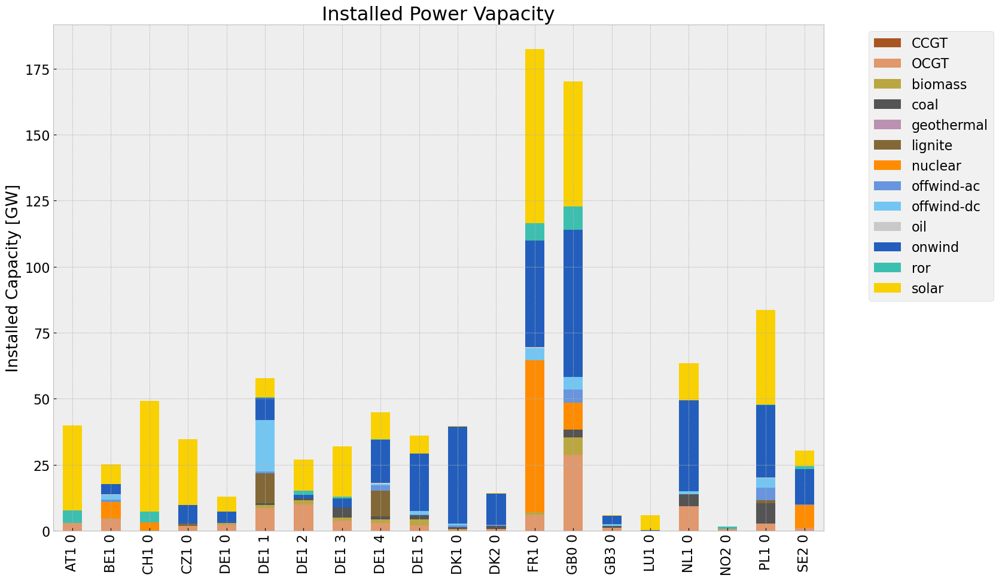

<Figure size 640x480 with 0 Axes>

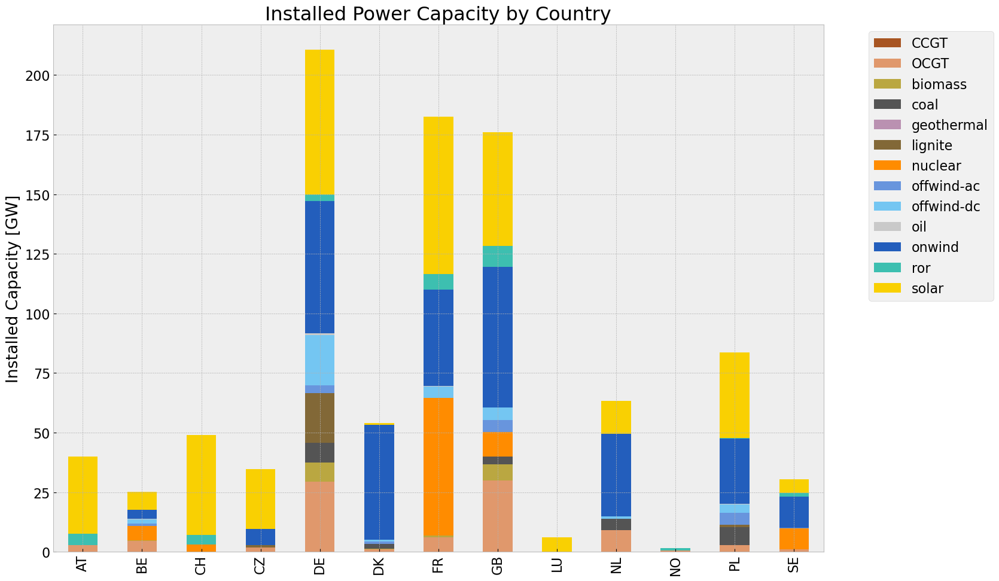

<Figure size 640x480 with 0 Axes>

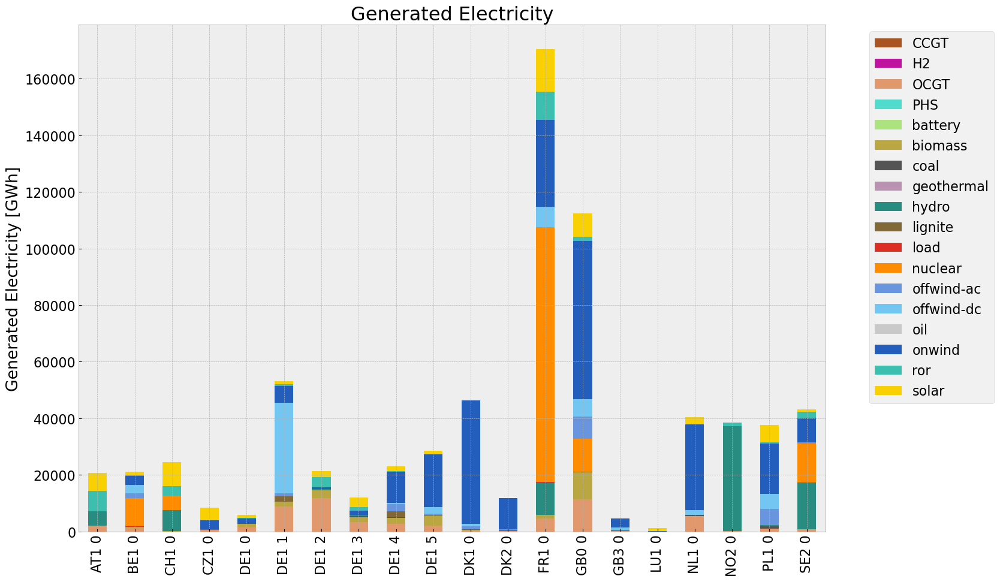

<Figure size 640x480 with 0 Axes>

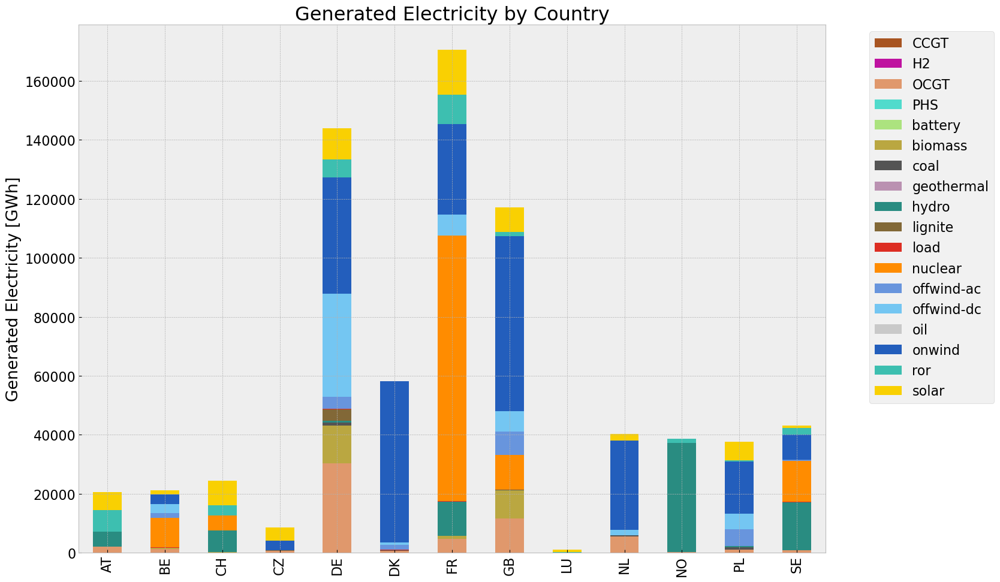

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,5.871573e+07,0.451621,0.1980,2.574220e+07
biomass,2.424905e+07,0.468000,0.0000,0.000000e+00
coal,2.547073e+06,0.329908,0.3361,2.594878e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,4.105473e+06,0.337285,0.4069,4.952838e+06
load,5.817191e+05,1.000000,0.0000,0.000000e+00
nuclear,1.309761e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.095959e+07,1.000000,0.0000,0.000000e+00


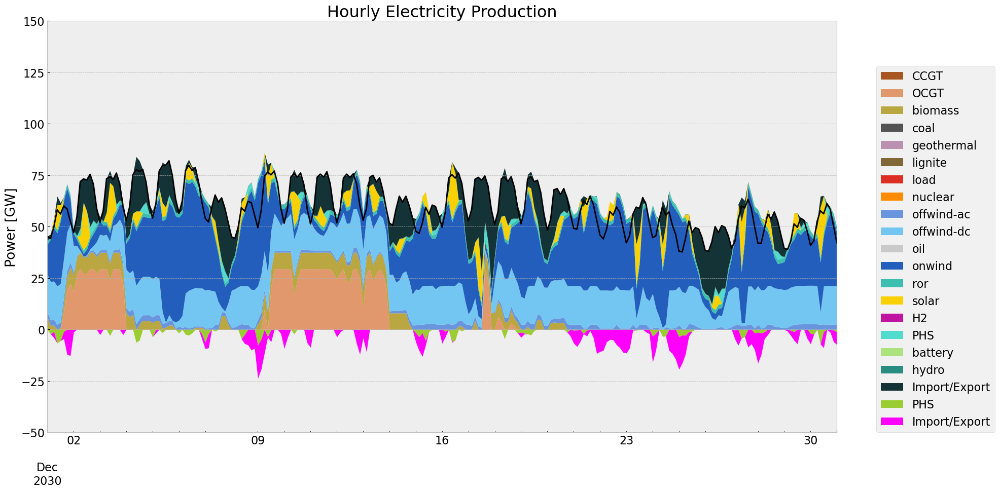

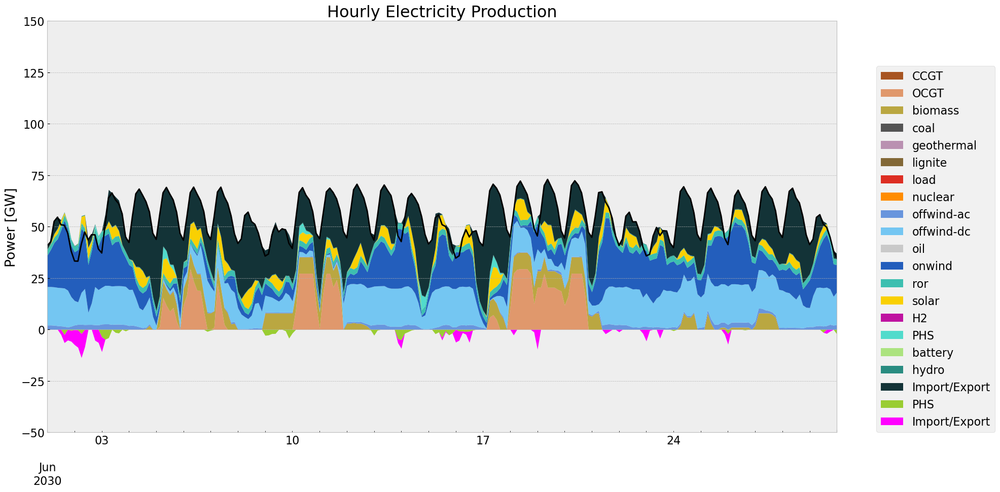

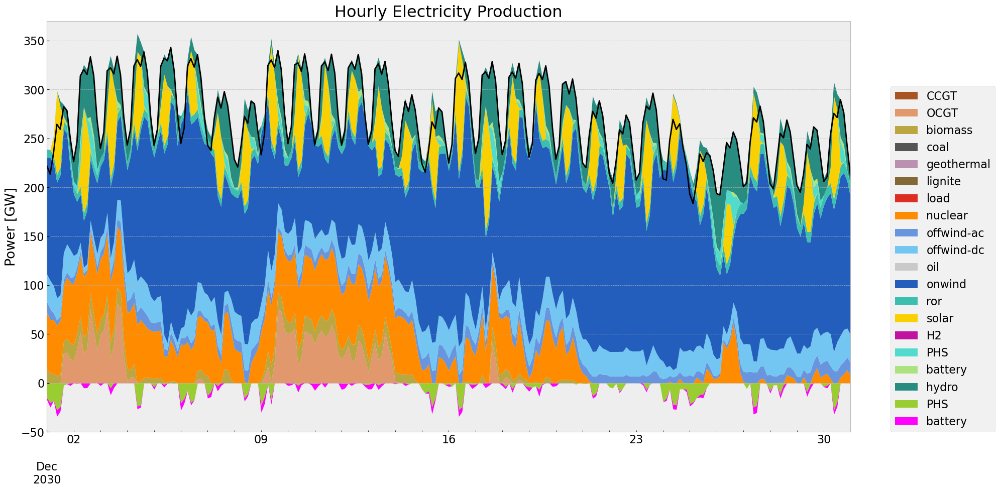

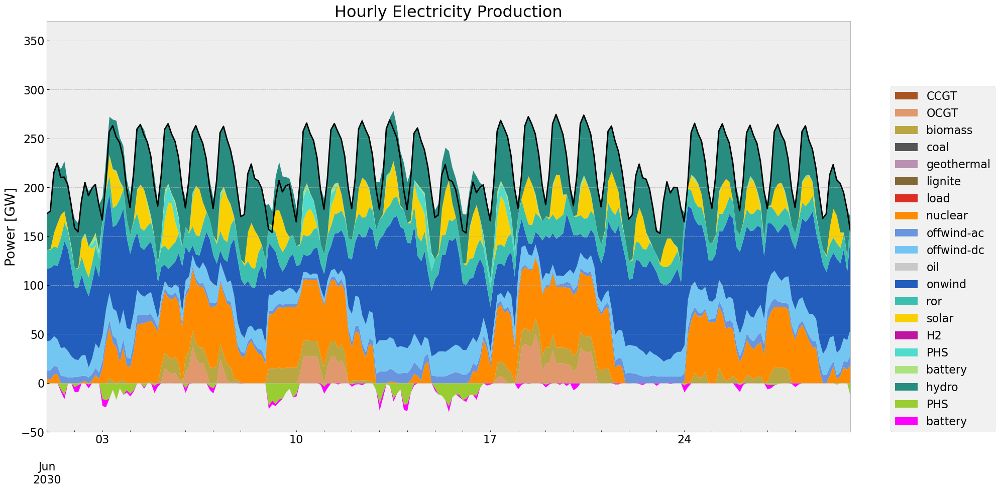

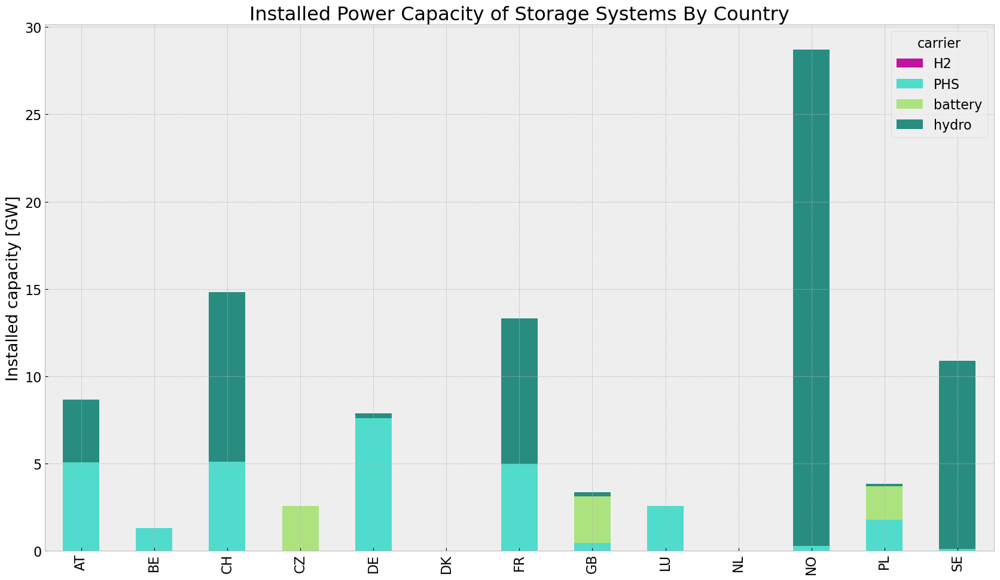

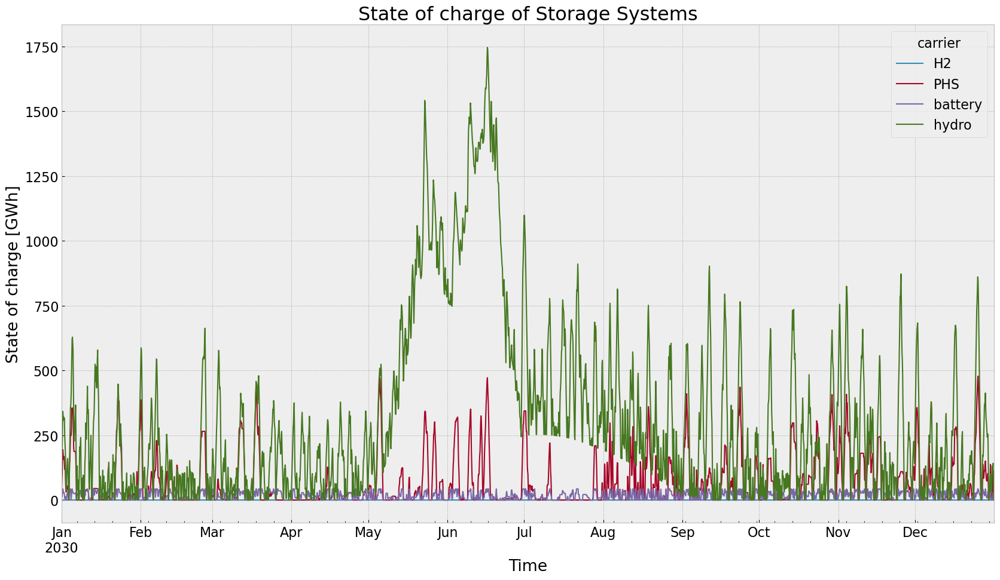

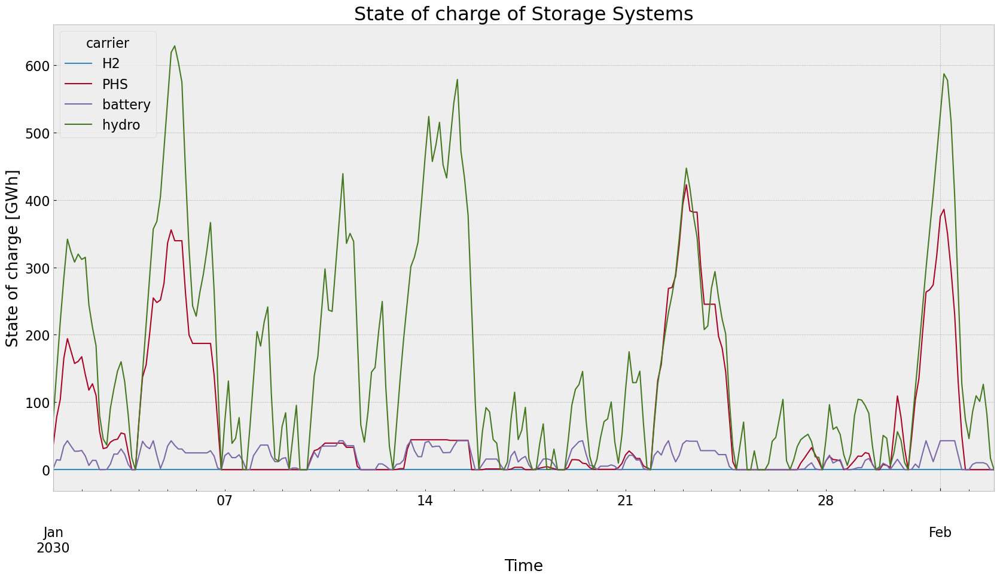

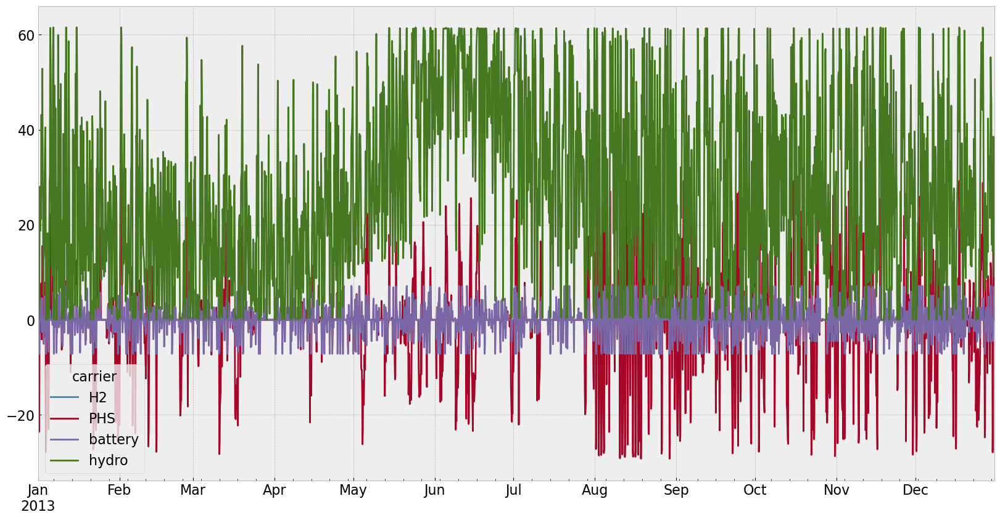

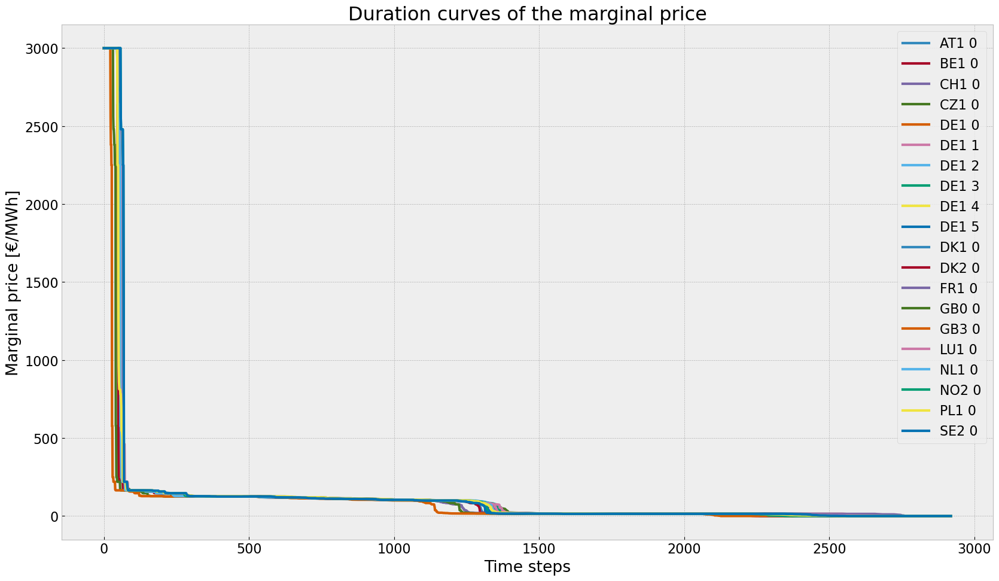

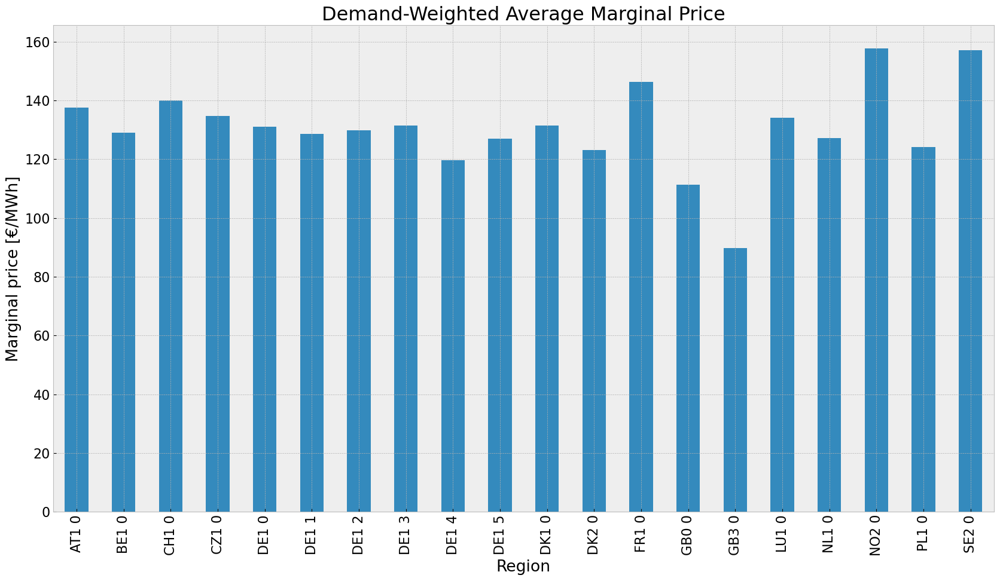

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


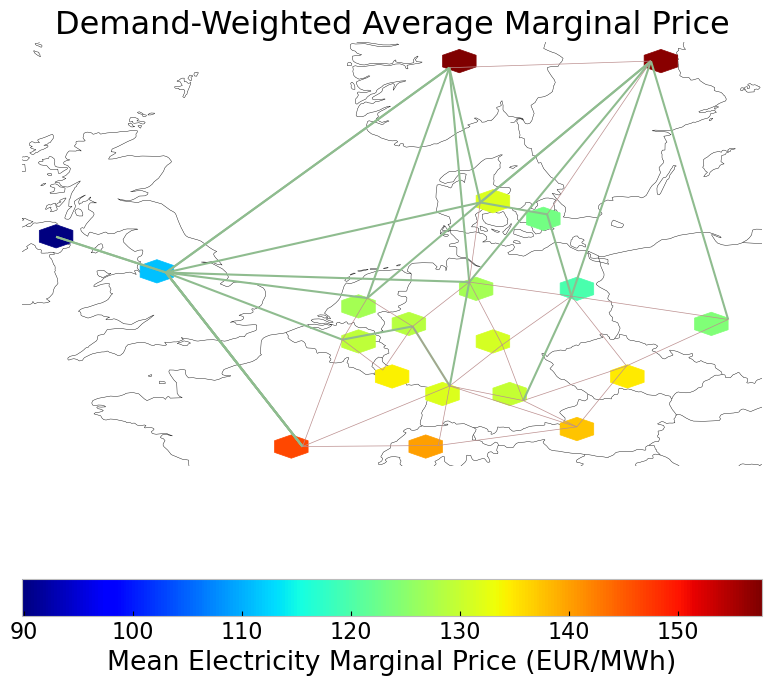

In [105]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-02-02 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [106]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

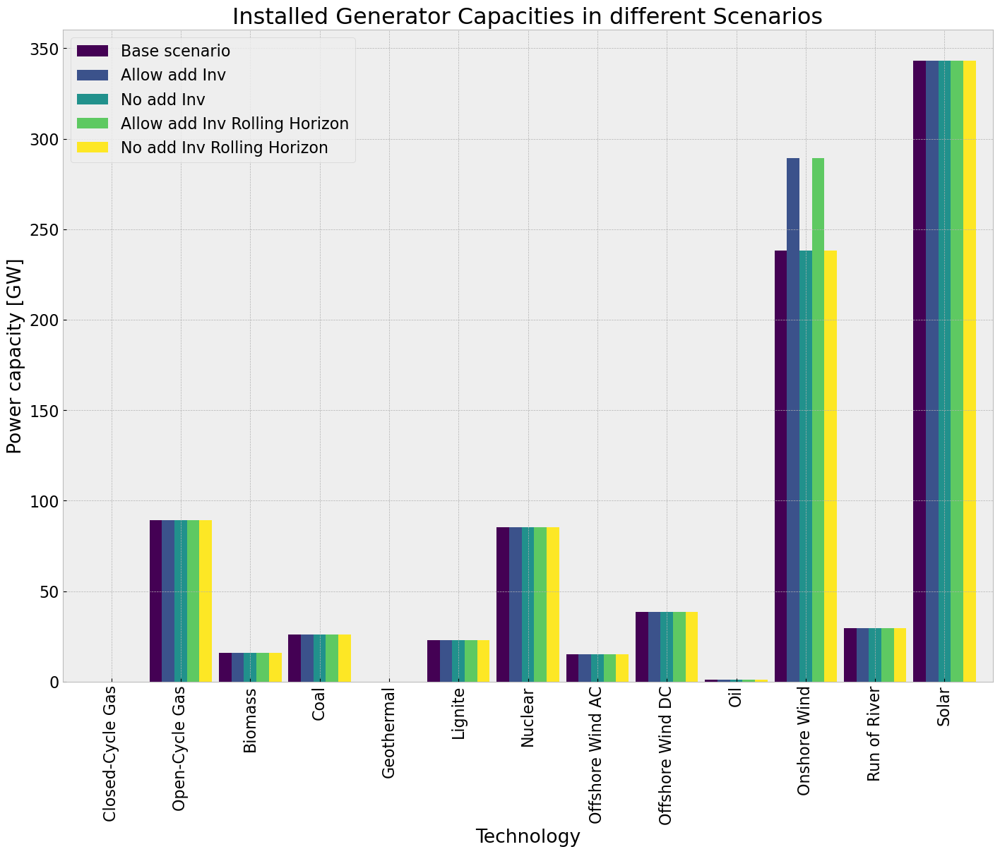

In [107]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


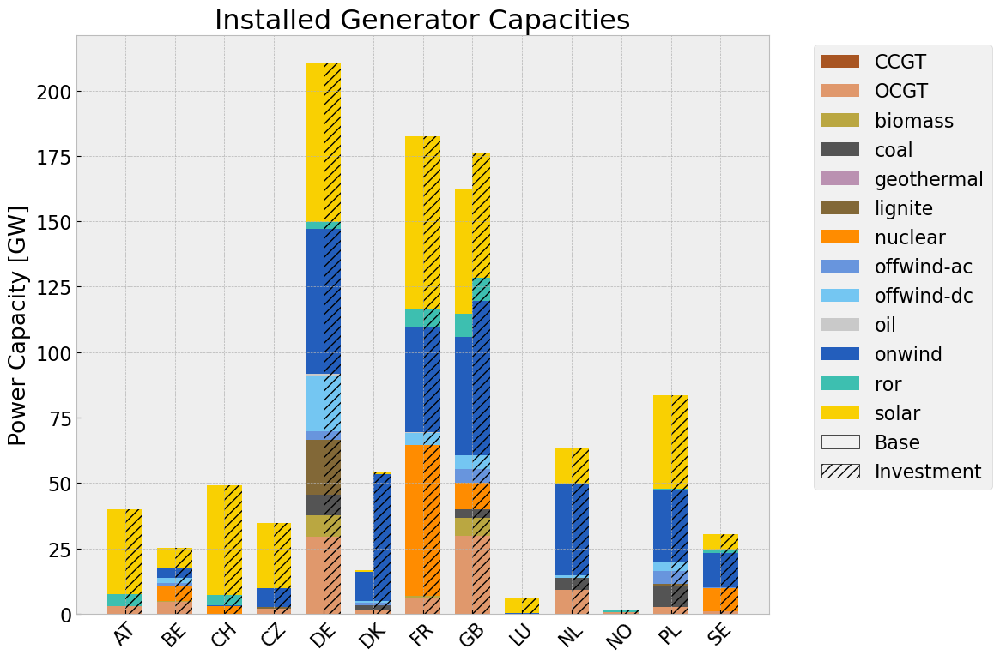

In [108]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

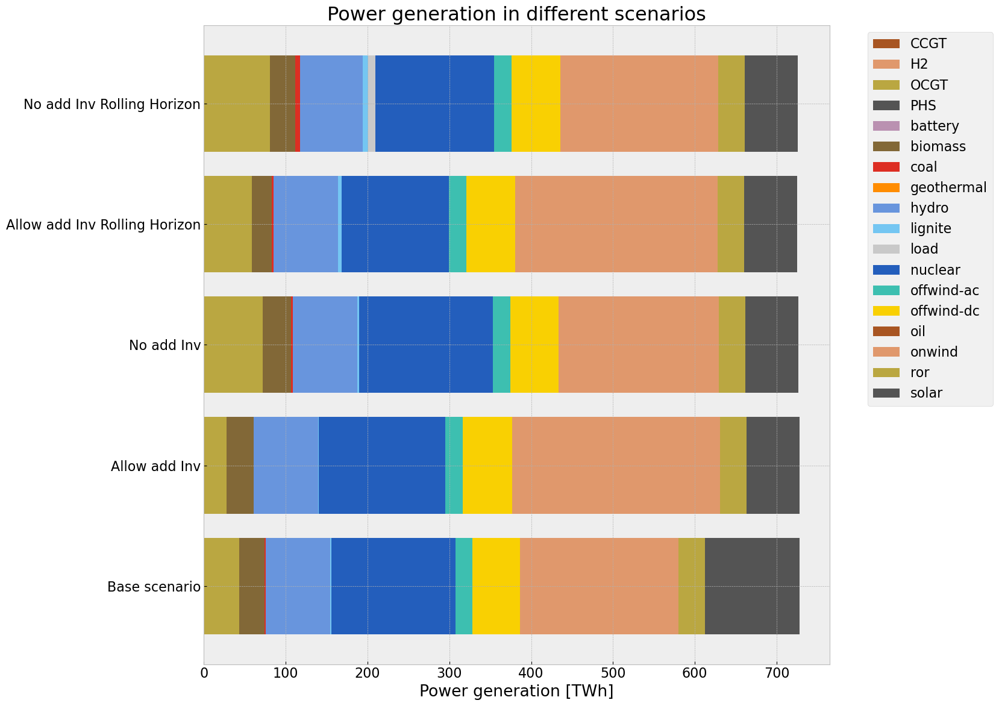

In [109]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

In [110]:
gen_base_country

carrier,CCGT,H2,OCGT,PHS,battery,biomass,coal,geothermal,hydro,lignite,load,nuclear,offwind-ac,offwind-dc,oil,onwind,ror,solar
country,,,,,,,,,,,,,,,,,,
AT,0.0,0.000000e+00,865.913020,0.0,0.000000e+00,0.000000,0.000000,0.0,5159.572357,0.000000,0.0,0.000000,0.000000,0.000000,0.0000,0.000000,7289.373361,11081.348849
BE,0.0,0.000000e+00,964.228580,0.0,0.000000e+00,550.818142,0.000000,0.0,15.561361,0.000000,0.0,10896.408902,1552.588919,2989.766793,0.1586,3276.916266,107.989508,2339.185549
CH,0.0,0.000000e+00,0.000000,0.0,0.000000e+00,202.130398,0.000000,0.0,7392.903573,0.000000,0.0,6594.387467,0.000000,0.000000,0.0000,6.091979,3442.839747,14474.407060
CZ,0.0,0.000000e+00,1346.566258,0.0,0.000000e+00,0.000000,10.455368,0.0,0.000000,94.325523,0.0,0.000000,0.000000,0.000000,0.0000,3259.437699,0.000000,7847.710205
DE,0.0,0.000000e+00,22466.799593,0.0,1.182627e-15,18076.525851,105.900941,0.0,684.373518,1241.305060,0.0,0.000000,4056.063264,33566.237627,0.0000,40059.017877,6073.578830,19302.588478
DK,0.0,0.000000e+00,211.701190,0.0,0.000000e+00,233.939982,22.759697,0.0,0.000000,0.000000,0.0,0.000000,1649.940166,897.453503,0.0000,13096.157670,0.000000,204.423977
FR,0.0,0.000000e+00,2692.681977,0.0,0.000000e+00,1244.916182,0.000000,0.0,11867.601851,0.000000,0.0,99951.028379,0.000000,7024.052927,0.2540,30576.699143,9941.330996,26361.204826
GB,0.0,6.894561e-15,10159.546543,0.0,0.000000e+00,10617.356617,13.811947,0.0,35.717467,0.000000,0.0,13132.799823,7879.077814,6887.799427,0.0000,45407.846498,1527.470592,15297.643987
LU,0.0,0.000000e+00,0.000000,0.0,0.000000e+00,15.525340,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0000,61.341917,71.195324,1819.481971


## Installed Storage Capacities

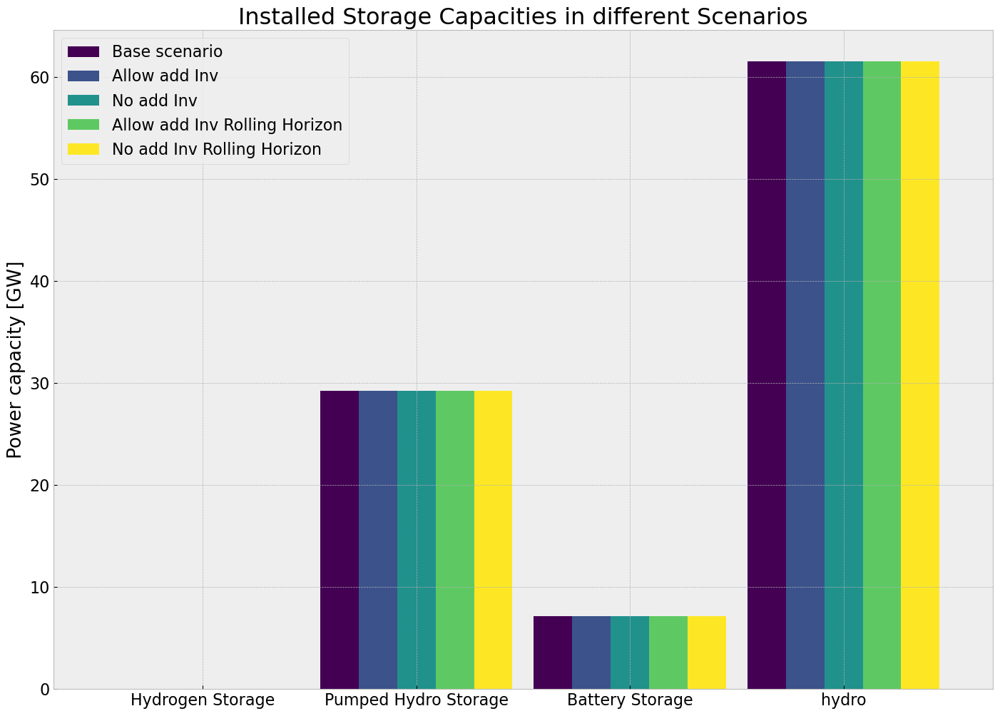

In [111]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

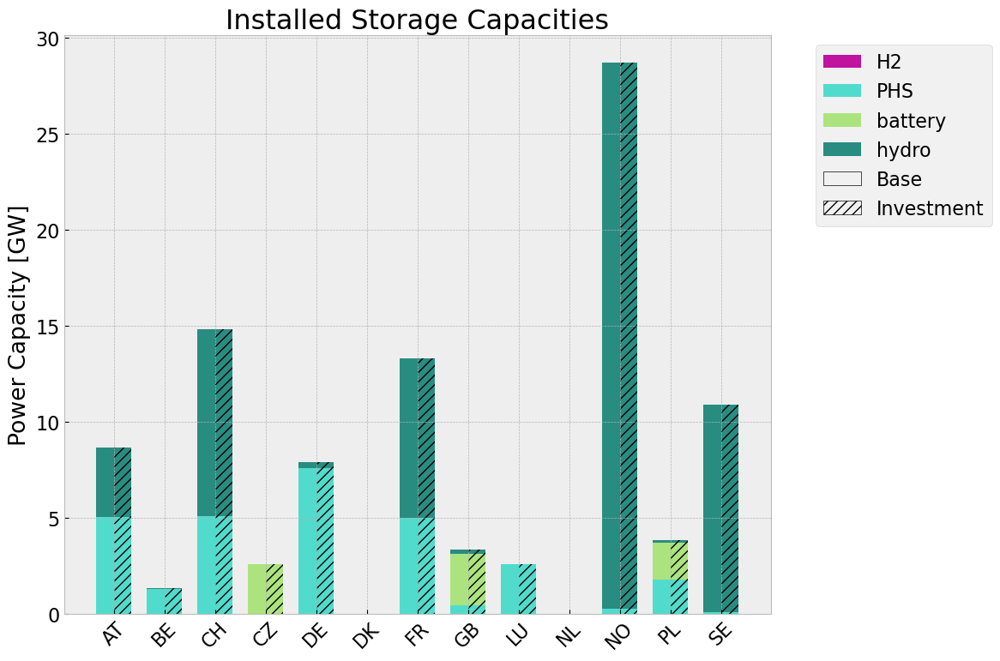

In [112]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [113]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_5624\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


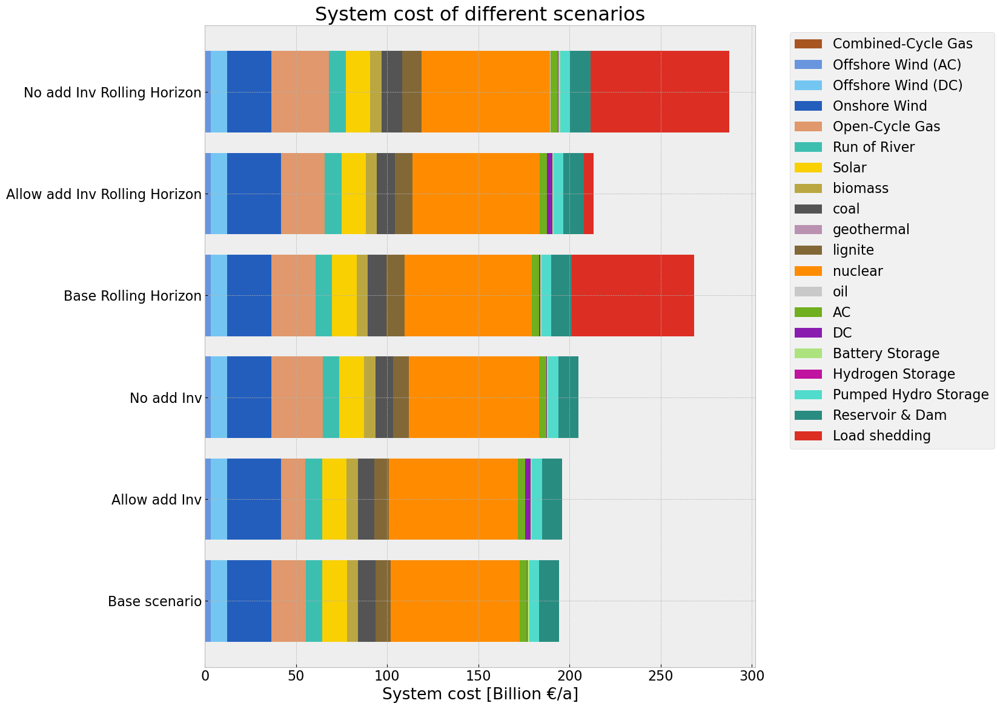

In [114]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [115]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

NameError: name 'comp_curtailment' is not defined

In [ ]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

: 

## Emission

In [ ]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

: 

## Transmission Lines

In [ ]:
models = [n, n1, n2, n3, n4]

: 

In [ ]:
for m in models:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

: 

In [ ]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

: 

In [ ]:
n.lines

: 

In [ ]:
n1.lines

: 

In [ ]:
n1.links

: 

In [ ]:
n.links

: 

# Sensitivity Analysis

In [ ]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

: 

#### Create and Solve Models

In [ ]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

: 

In [ ]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

: 

In [ ]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

: 

### Saved Cost by Investing

In [ ]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

: 

In [ ]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

: 

In [ ]:
addcost_df

: 

In [ ]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



: 

### Built Generator & Storage Capacities

In [ ]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

: 

#### Bar Plot

In [ ]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

: 

In [ ]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

: 

In [ ]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

: 

In [ ]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


: 

### Built Storage Capacities

In [ ]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

: 

In [ ]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

: 

### Transmission Cap

In [ ]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

: 

In [ ]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

: 